### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.6.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

['/device:GPU:0']

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 30;
WINDOW_SIZE = 1;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
selected = ['percent_graduate_deg', 'percent_bachelors', 'percent_associates',
            'percent_highschool', 'percent_less_highschool',
            'percent_commute_public_transport', 'percent_commute_less_30',
            'percent_buildings_less_10_units', 'percent_buildings_10_19_units',
            'percent_buildings_20_49_units', 'percent_buildings_50+_units',
            'percent_commute_30_to_59', 'percent_commute_60_to_89',
            'percent_commute_90_more', 'percent_new_city', 'percent_new_unit',
            'percent_units_owner_occupied', 'median_building_age',
            'income_per_capita', 'poverty_rate', 'total_pop',
            'percent_workforce_unemployed', 'percent_work_from_home', 'median_age',
            'percent_female', 'gini_index', 'percent_not_us_citizen',
            'bs_total_systems'];

In [7]:
selected_index = [];
column_name = list(multi_data.columns);
for i in range(len(column_name)):
    if column_name[i] in selected: selected_index.append(i);

In [8]:
# FEATURES = multi_data.shape[1] - 1;
FEATURES = len(selected_index);

In [9]:
# for x, y in dataset_train:
#     print(np.array(x).shape, np.array(y).shape)

### Utility functions

In [10]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    series_selected = series[:, [0]+selected_index];
    dataset = tf.data.Dataset.from_tensor_slices(series_selected); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1, 1:], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [11]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [12]:
def NN_model(dataset, termination, test = None):
    class myCallbacks(tf.keras.callbacks.Callback):
        def on_epoch_end(self, epoch, logs={}):
            mse = logs.get("mse");
            if(mse < termination):
                print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
                self.model.stop_training = True;
            
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,WINDOW_SIZE,FEATURES))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [13]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, selected_index]))

    results = [float(x[-1][0]) for x in forecast];
    actual = list(series_transformed[WINDOW_SIZE:, 0]);
    
    return results, actual; #, pure_forecast;

In [14]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, termination=0, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train, termination);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    # results, actual, pure_forecast = NN_forecast(model, series_transformed);
    results, actual = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    # MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        # plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_pure,\
        np.array(results[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0050 in round 89 and stopped training



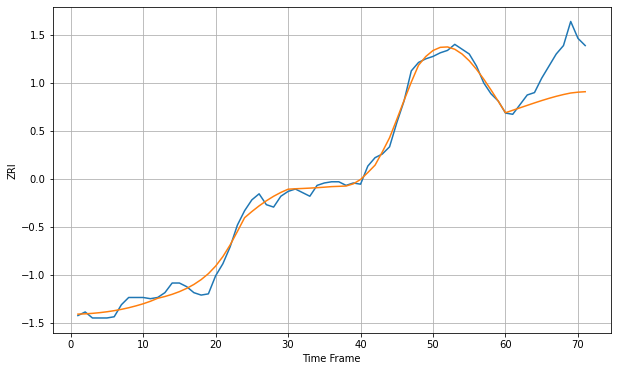

Wall time: 7.53 s
1013 5.6101694398341175 30.40719913439459 [1099.29000686 1101.31699977 1103.36265929 1105.39223906 1107.42169099
 1109.38058827 1111.21983947 1112.902097   1114.39052186 1115.64309006
 1116.32790919 1116.71476051]

Got an mse at 0.0050 in round 83 and stopped training



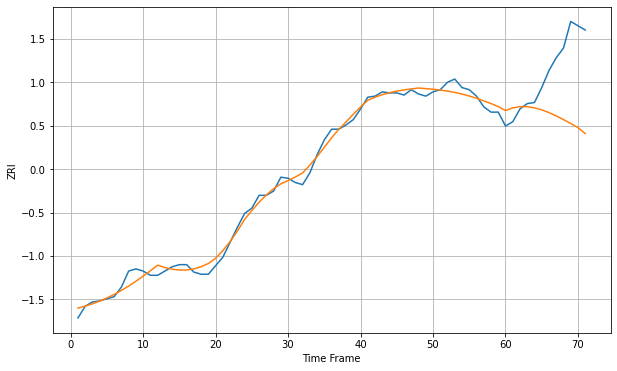

Wall time: 6.84 s
1020 5.710061092494363 55.96183635951479 [1129.51282008 1131.91120655 1133.19472816 1133.06598493 1132.02823337
 1130.13762313 1127.55269911 1124.47020106 1121.03222724 1117.33893353
 1113.46972194 1107.84714589]

Got an mse at 0.0050 in round 340 and stopped training



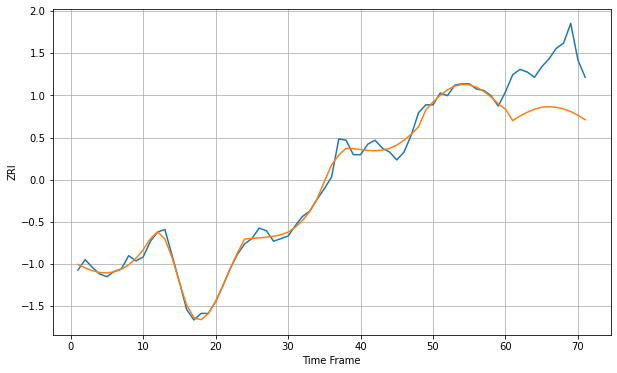

Wall time: 12.6 s
1040 4.517384408596219 39.07533987026368 [1098.63882838 1090.00738526 1093.45900104 1096.33550386 1098.65636187
 1100.14396299 1100.59764645 1100.1119159  1098.84522778 1096.84743583
 1094.08157837 1090.60853495]

Got an mse at 0.0050 in round 299 and stopped training



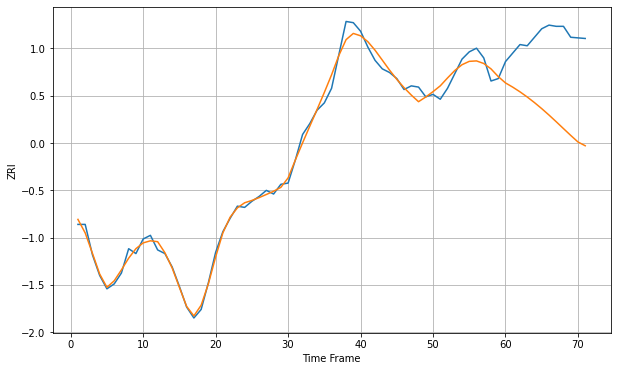

Wall time: 11.6 s
1085 5.470372491121111 65.81316584966046 [1154.41820056 1150.94737548 1147.09137986 1142.84828722 1138.22168324
 1133.26803069 1127.99630742 1122.48390862 1116.84947301 1111.2441936
 1105.82845017 1102.72084963]

Got an mse at 0.0050 in round 277 and stopped training



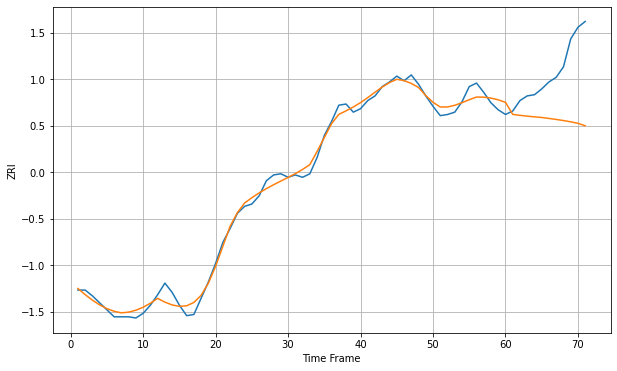

Wall time: 10.9 s
1104 5.611672951739824 46.497224307458666 [1123.44658149 1113.09541672 1112.27154131 1111.55351996 1110.9638572
 1110.42917318 1109.60060872 1108.73722689 1107.7827571  1106.6852812
 1105.39683089 1103.29033235]

Got an mse at 0.0050 in round 138 and stopped training



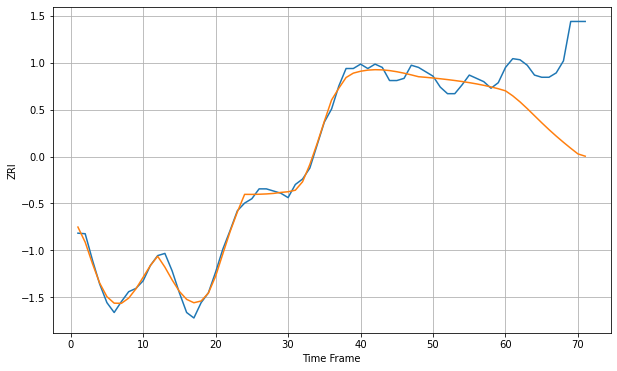

Wall time: 7.83 s
1108 6.020557458942693 71.98803623141734 [1176.61089662 1172.02680083 1166.52431326 1160.36334736 1153.89330414
 1147.41458106 1141.1583117  1135.21447897 1129.55706745 1124.13108199
 1118.93454118 1116.85064187]

Got an mse at 0.0050 in round 271 and stopped training



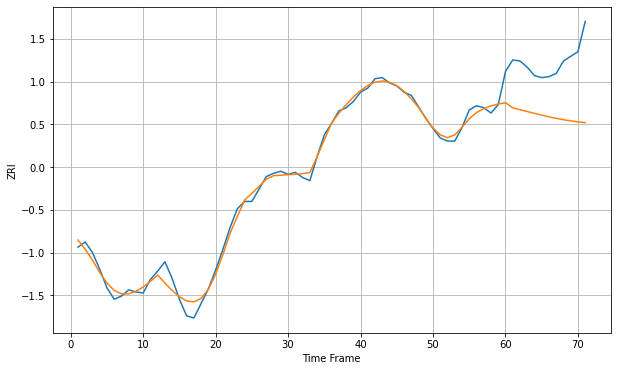

Wall time: 10.6 s
1109 5.768012405144352 53.26699898397475 [1158.94194394 1153.95777321 1152.21974969 1150.4368062  1148.66473709
 1146.95414027 1145.34847319 1143.88217609 1142.57912668 1141.45186358
 1140.50190501 1139.72119503]

Got an mse at 0.0050 in round 205 and stopped training



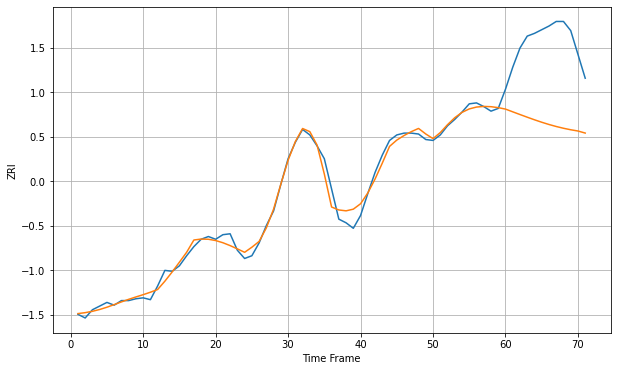

Wall time: 9.55 s
1420 6.817152813392024 89.3634395860517 [1230.24579593 1227.26001908 1224.30356066 1221.39053331 1218.56102885
 1215.8813708  1213.42012428 1211.22239301 1209.30482341 1207.66702725
 1206.30055248 1204.04809351]

Got an mse at 0.0050 in round 141 and stopped training



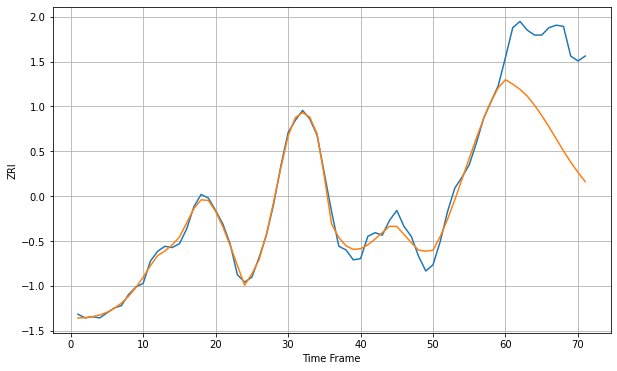

Wall time: 8.62 s
1440 5.090946133133189 74.52351726023723 [1196.87449478 1193.23693127 1189.07163307 1183.59750375 1176.24672309
 1167.90296703 1158.70035313 1148.98654839 1139.23855528 1130.16851138
 1121.83099683 1114.36397302]

Got an mse at 0.0050 in round 176 and stopped training



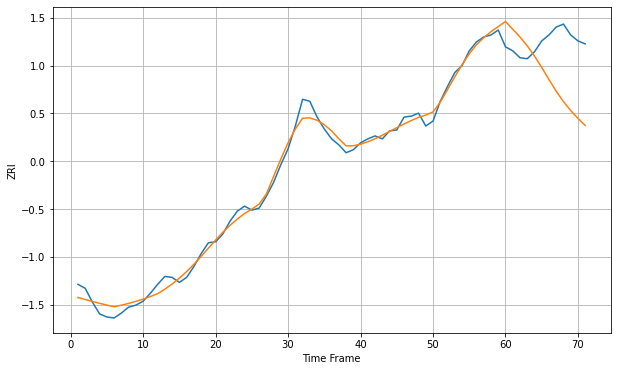

Wall time: 8.73 s
1453 6.792132813729932 52.91595658861875 [1344.65621766 1336.81586451 1329.00314882 1320.05472686 1309.70995183
 1298.17336182 1285.96448446 1274.19877832 1263.68625042 1254.60058566
 1246.69061134 1239.61246041]

Got an mse at 0.0050 in round 425 and stopped training



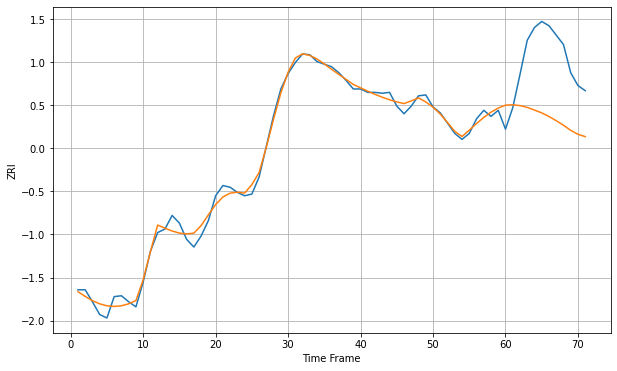

Wall time: 14.2 s
1545 7.094718113318468 76.38378988844755 [1529.05568169 1529.46010506 1528.55054312 1526.43211695 1523.29384537
 1520.0283451  1515.75994471 1510.91823865 1505.52605806 1499.58337516
 1494.93721064 1492.25598639]

Got an mse at 0.0050 in round 172 and stopped training



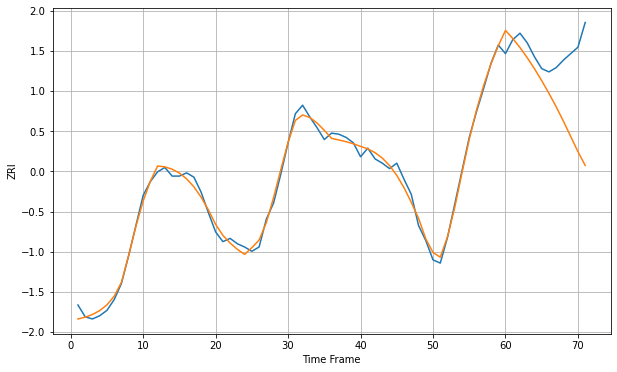

Wall time: 8.54 s
1550 5.232819178325087 57.165978267161194 [1254.60343574 1247.11365147 1238.62380516 1229.17594054 1218.86232568
 1207.7843     1195.98757837 1183.41709341 1169.98140008 1155.83488516
 1141.73368874 1128.87428419]

Got an mse at 0.0050 in round 144 and stopped training



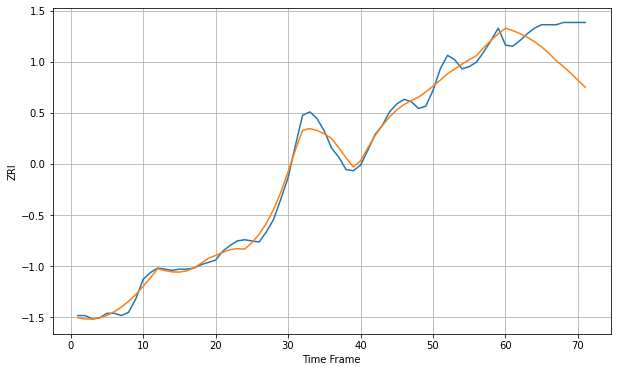

Wall time: 7.85 s
1602 6.337945812820501 31.67849725181217 [1404.95368316 1402.81631795 1400.17229439 1396.93755702 1393.01803795
 1388.31561666 1382.74312293 1376.25412274 1371.00168153 1365.18962404
 1358.97471348 1352.80580646]

Got an mse at 0.0050 in round 83 and stopped training



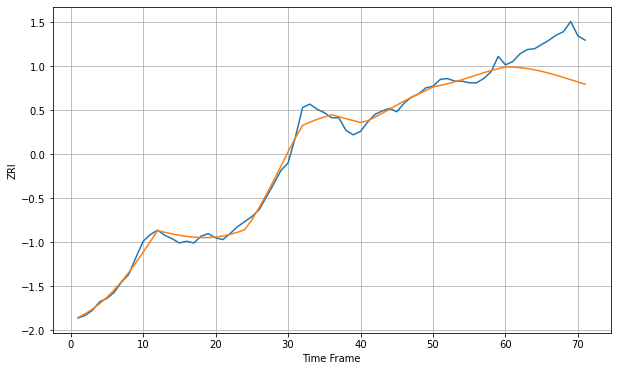

Wall time: 6.55 s
1603 7.2843469428102186 40.081395605631045 [1298.67050976 1298.45124517 1297.79642241 1296.72442282 1295.25954177
 1293.4348588  1291.2949145  1288.89616331 1286.3031774  1283.66544457
 1280.98545258 1278.27655985]

Got an mse at 0.0050 in round 116 and stopped training



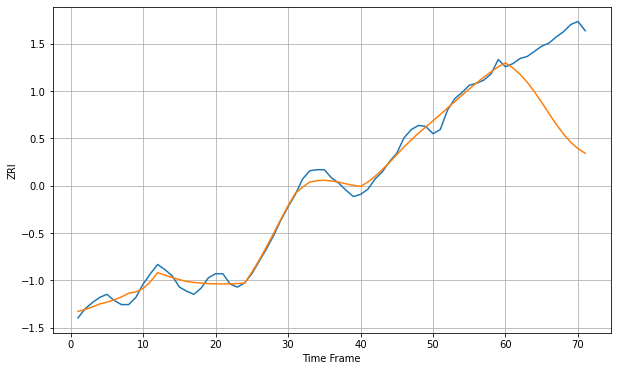

Wall time: 7.29 s
1604 6.482440900677453 76.1779065269584 [1347.76138822 1342.92711185 1336.75862209 1329.01044599 1319.66905773
 1309.34338172 1298.60476861 1288.16086503 1278.69951679 1270.72661831
 1264.48624991 1259.98372458]

Got an mse at 0.0049 in round 47 and stopped training



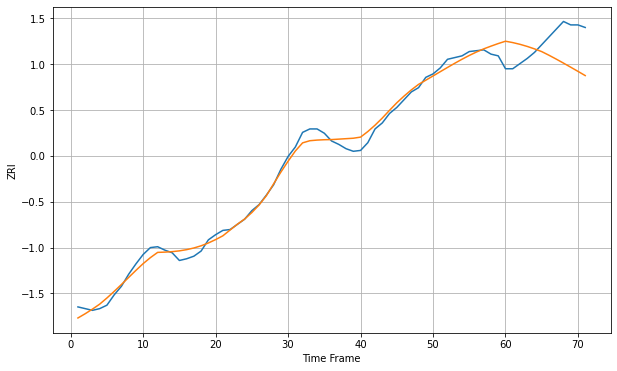

Wall time: 5.76 s
1605 7.38899865377793 35.60126853221422 [1331.02109833 1329.43721487 1327.41569458 1324.96300298 1322.11525381
 1318.93612625 1314.71268701 1310.22490921 1305.56813821 1300.80091188
 1295.96078209 1291.05940954]

Got an mse at 0.0050 in round 53 and stopped training



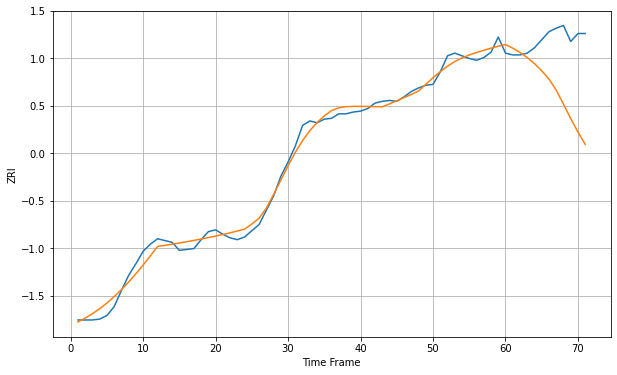

Wall time: 5.86 s
1610 7.448100877512046 65.96032422836619 [1329.64014733 1325.62585713 1320.77044351 1315.04310867 1308.23886704
 1300.19721403 1290.86856186 1278.60725342 1262.74440566 1246.75749396
 1231.53311925 1217.77804571]


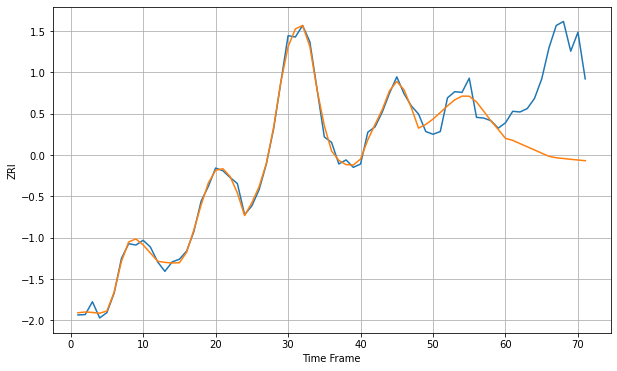

Wall time: 16.1 s
1702 9.998458480855346 131.3689395784588 [2253.8291972  2250.93781411 2246.16501485 2241.45915737 2236.80076186
 2231.9952617  2227.33069043 2225.19900027 2224.07839872 2222.92141596
 2221.88199528 2220.82250688]

Got an mse at 0.0050 in round 197 and stopped training



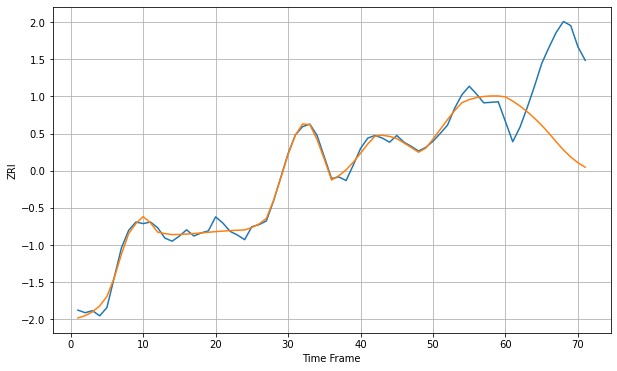

Wall time: 9.41 s
1752 10.089592408581117 162.9348965589931 [2076.42306877 2068.33779682 2058.82332003 2047.80641328 2035.32506858
 2021.5203229  2006.22498181 1989.72432481 1974.11227128 1960.51086161
 1949.48086079 1940.74185099]

Got an mse at 0.0050 in round 281 and stopped training



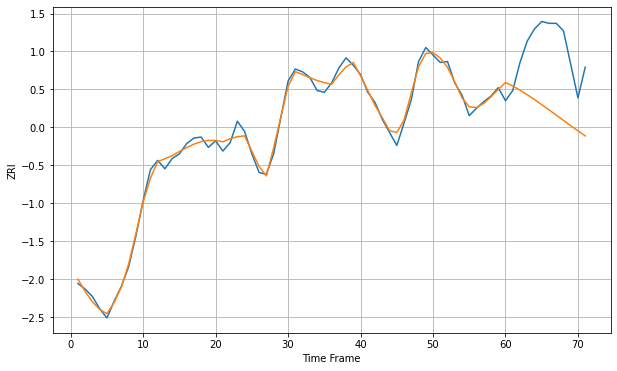

Wall time: 11.3 s
1757 5.708616805340344 68.82703107396658 [1461.55131735 1457.75746223 1453.33438968 1448.43735203 1443.21628731
 1437.78501193 1432.21965284 1426.57294937 1420.89073078 1415.22637144
 1409.65259191 1404.2682923 ]


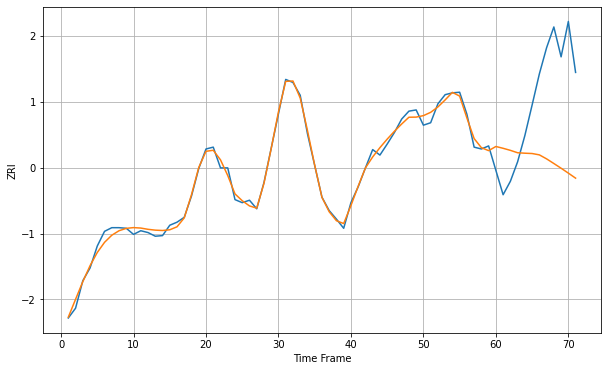

Wall time: 16.2 s
1760 7.8951430039981405 142.3936341899543 [2294.06091348 2291.11077038 2287.75490596 2283.80162909 2283.07685592
 2282.54963199 2280.35280331 2273.77663824 2266.17360957 2258.44809422
 2250.4350246  2242.17928078]

Got an mse at 0.0049 in round 332 and stopped training



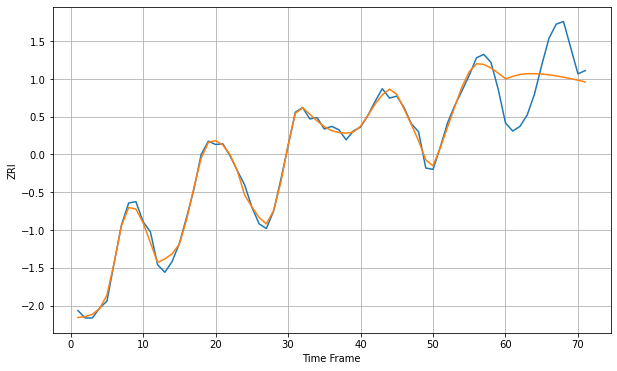

Wall time: 12.4 s
1801 7.827302624707985 57.701835095774136 [2268.69907442 2272.25421071 2275.24987063 2276.25004383 2276.35141666
 2275.80208718 2274.67581656 2273.09137752 2271.1658144  2268.98605017
 2266.60295805 2264.03654019]

Got an mse at 0.0050 in round 432 and stopped training



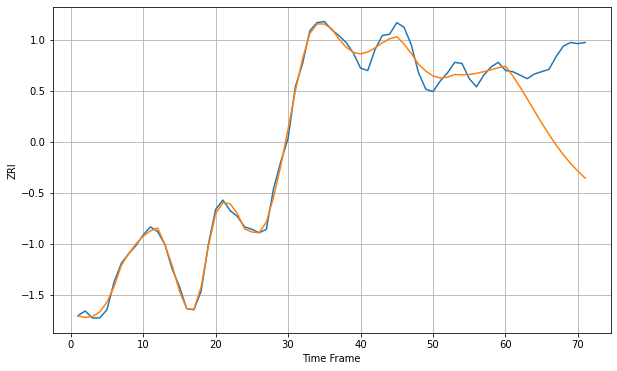

Wall time: 14.6 s
1830 6.13558334648615 69.02555998754792 [1629.71590119 1621.42000788 1611.95988693 1601.74831436 1591.26515725
 1580.98506419 1571.28533159 1562.00757537 1553.65172341 1546.26013278
 1539.69449669 1533.80040945]

Got an mse at 0.0050 in round 208 and stopped training



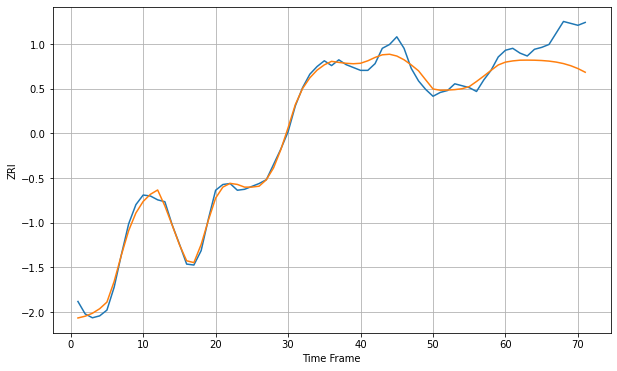

Wall time: 9.77 s
1832 6.525510633500591 29.651532583629272 [1574.61761755 1575.86401463 1576.6216235  1576.69895864 1576.5932091
 1576.27422228 1575.66149381 1574.64105425 1573.08440367 1570.86511182
 1567.87644328 1564.05445979]

Got an mse at 0.0050 in round 373 and stopped training



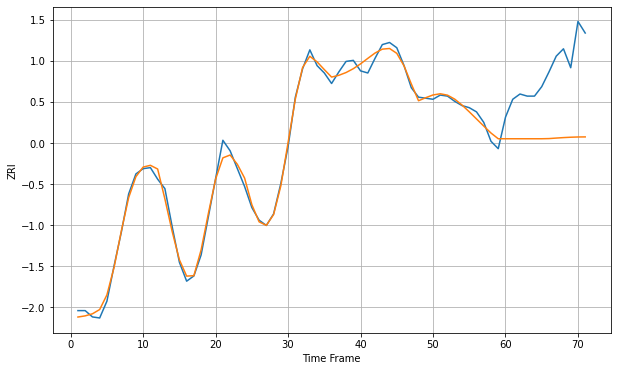

Wall time: 13.3 s
1841 5.501115663332461 66.333416481339 [1571.45589363 1571.45589363 1571.45589363 1571.45589363 1571.45589363
 1571.45589363 1571.6118264  1572.10383893 1572.54615922 1572.90155768
 1573.13338106 1573.20943784]

Got an mse at 0.0050 in round 396 and stopped training



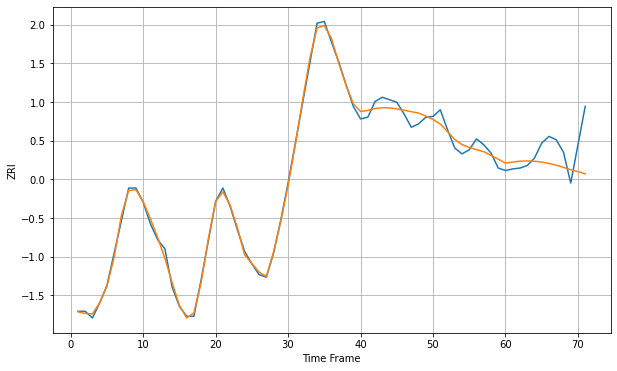

Wall time: 13.8 s
1843 6.544730784098042 30.206562067640768 [1680.963066   1682.23026335 1683.22786248 1683.54780729 1683.17634353
 1682.15426136 1680.54836197 1678.42592589 1675.84669226 1673.02095167
 1670.71221675 1668.07076136]

Got an mse at 0.0049 in round 226 and stopped training



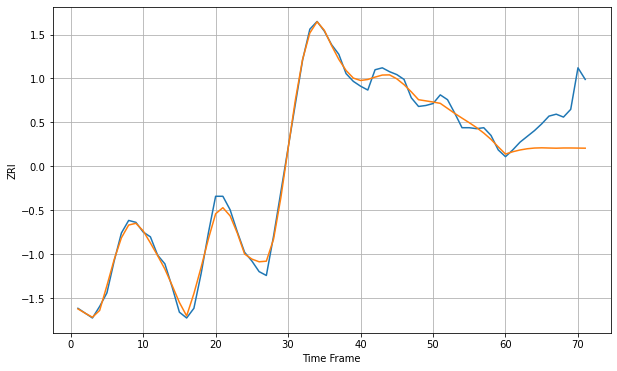

Wall time: 9.97 s
1844 6.338383557619272 38.85040887606541 [1669.72545268 1672.09806768 1673.93246289 1675.20953837 1675.94242705
 1676.17405289 1675.96816355 1675.7863435  1676.0078258  1676.00853405
 1675.89803972 1675.79420698]

Got an mse at 0.0050 in round 352 and stopped training



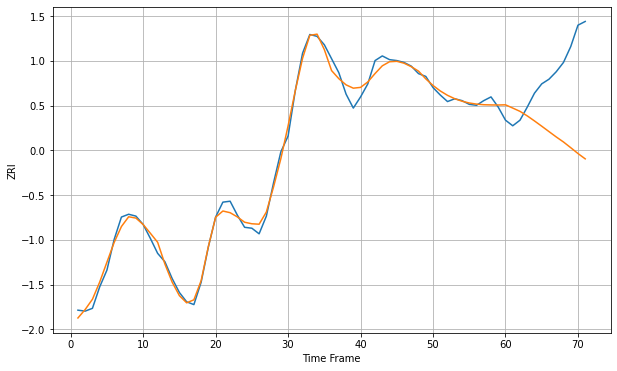

Wall time: 12.8 s
1845 6.732781907574969 77.2657749739982 [1810.5003836  1807.01801619 1803.48788047 1798.63395786 1793.19640227
 1787.53616124 1781.76481433 1776.01757744 1770.60341949 1764.49025234
 1758.22134233 1752.47624221]

Got an mse at 0.0050 in round 248 and stopped training



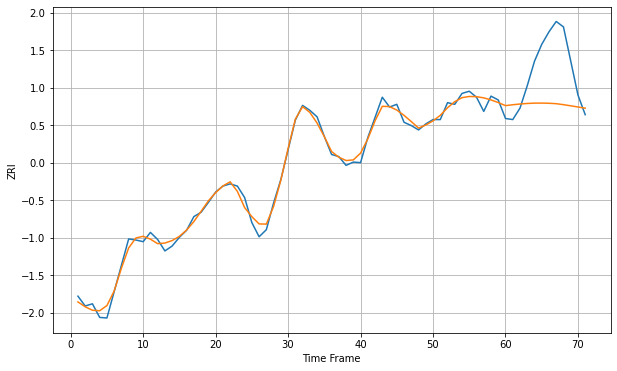

Wall time: 10.5 s
1850 9.643587247091704 85.44352224436497 [1988.59291932 1990.20329819 1991.55826606 1992.55821096 1993.12752683
 1993.23867354 1992.91673983 1992.15129006 1990.32510202 1988.26429846
 1986.09369414 1983.92246727]

Got an mse at 0.0049 in round 352 and stopped training



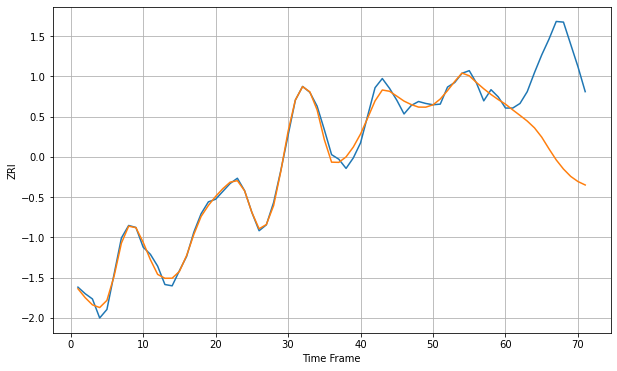

Wall time: 12.9 s
1851 8.578455100622673 141.17681360228647 [1990.94483584 1982.19177802 1973.81620487 1965.18479605 1954.80872389
 1940.64560062 1922.87245545 1905.96069145 1892.03762896 1880.78984563
 1872.98020636 1867.73007364]

Got an mse at 0.0050 in round 267 and stopped training



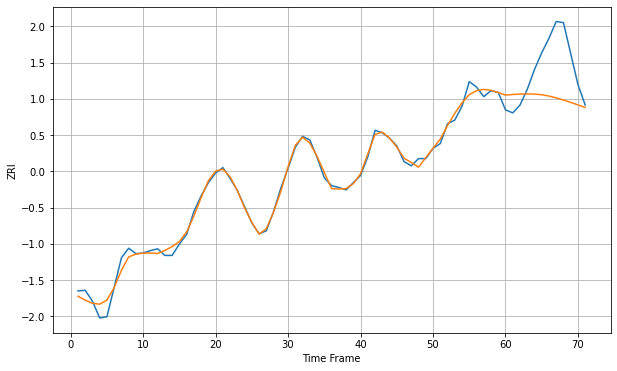

Wall time: 11 s
1852 8.460965414692717 69.57362591994197 [1989.61504627 1990.5619507  1991.28100482 1991.52920721 1991.22713171
 1990.19177702 1987.99531606 1985.01268323 1981.35710239 1977.42396209
 1973.25847606 1968.89760339]


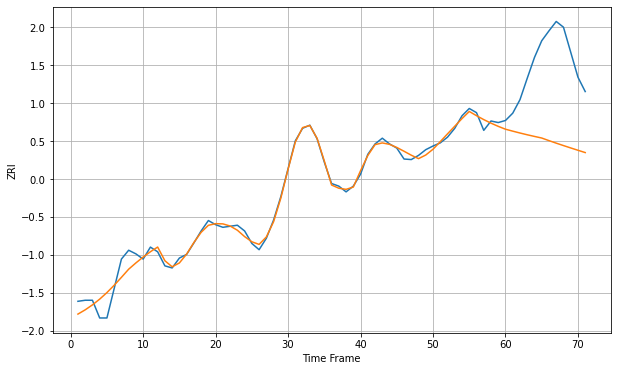

Wall time: 16.1 s
1854 12.873346456384569 156.20548107270957 [1995.22992732 1991.51354559 1987.9411424  1984.55670813 1981.38311269
 1978.32706057 1973.30957854 1968.490773   1963.82964398 1959.28583019
 1954.82325575 1950.41231471]

Got an mse at 0.0050 in round 262 and stopped training



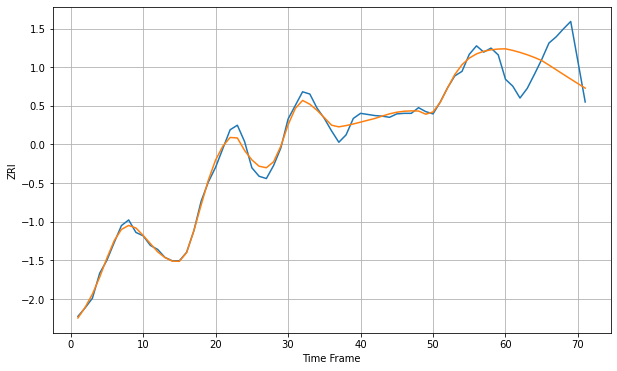

Wall time: 10.5 s
1876 9.55804875321639 58.79702097811456 [2204.78413478 2201.9346403  2198.43704285 2194.28746278 2189.51189403
 2184.06065241 2176.07785157 2167.85930249 2159.59447453 2151.40959014
 2143.36126323 2135.45104734]

Got an mse at 0.0050 in round 301 and stopped training



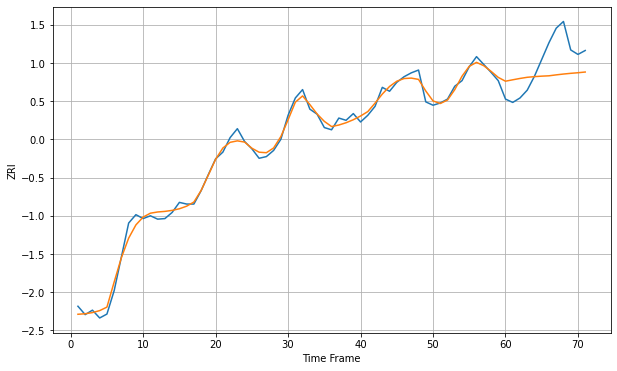

Wall time: 11.3 s
1880 9.618823353772068 49.16849900473315 [2209.02306551 2211.53968403 2213.95845826 2216.02062739 2217.19090572
 2218.0628631  2218.69554436 2220.36770706 2221.84851088 2223.11851663
 2224.17578645 2225.46101313]

Got an mse at 0.0050 in round 224 and stopped training



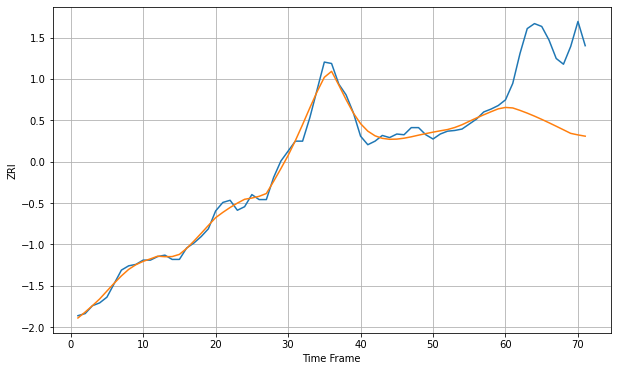

Wall time: 9.61 s
1902 8.170347966478367 109.17531513624584 [1751.31461632 1750.61614449 1747.19238177 1743.33957878 1739.10947935
 1734.57641896 1729.82139329 1724.92014698 1719.93617723 1714.9167983
 1712.78285268 1710.97498581]

Got an mse at 0.0050 in round 354 and stopped training



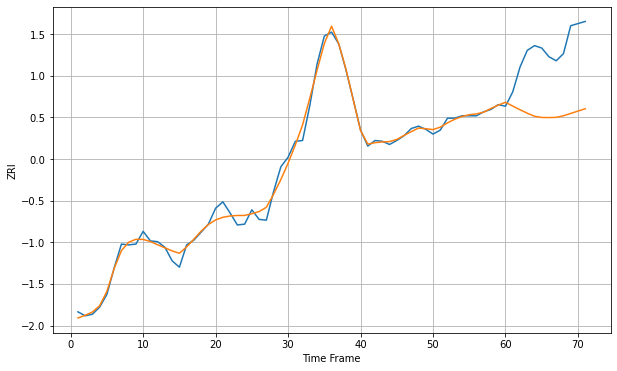

Wall time: 12.4 s
1905 7.357707911347174 80.59067369675388 [1760.96131626 1756.16166407 1751.54857074 1747.25724615 1743.40886765
 1741.87403377 1741.75037247 1742.01029017 1743.99670084 1746.94002474
 1749.87763911 1752.81725209]

Got an mse at 0.0050 in round 320 and stopped training



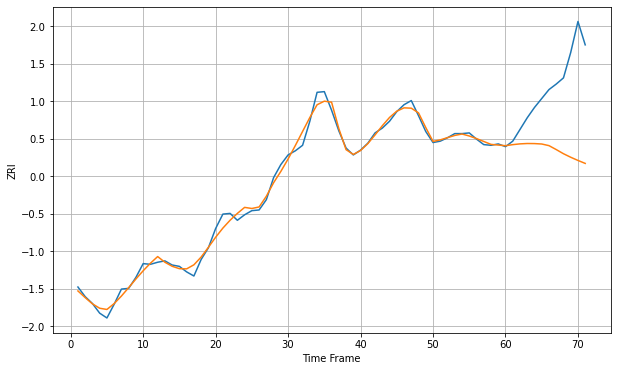

Wall time: 11.7 s
1915 7.6406365809373575 104.31544281706762 [1819.42295321 1820.94333872 1822.06759608 1822.59839802 1822.48552506
 1821.87510007 1819.50285694 1813.7914453  1807.75492    1802.62139416
 1797.98130995 1793.67935312]


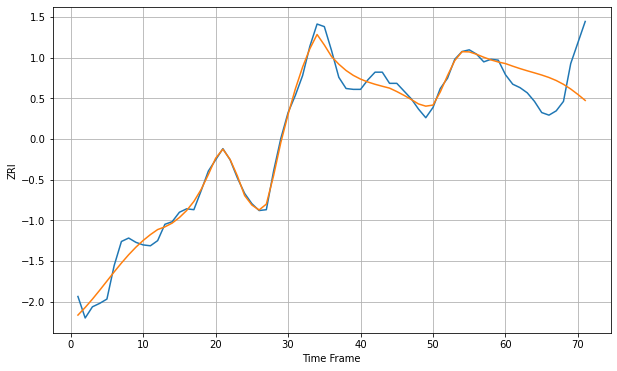

Wall time: 15.6 s
1930 10.007990435677817 42.12919623191621 [1779.98736449 1776.98199048 1774.17371335 1771.61164219 1769.18789835
 1766.67924908 1763.80748281 1760.28283039 1755.85463358 1750.39862218
 1744.02594175 1737.12487861]

Got an mse at 0.0050 in round 274 and stopped training



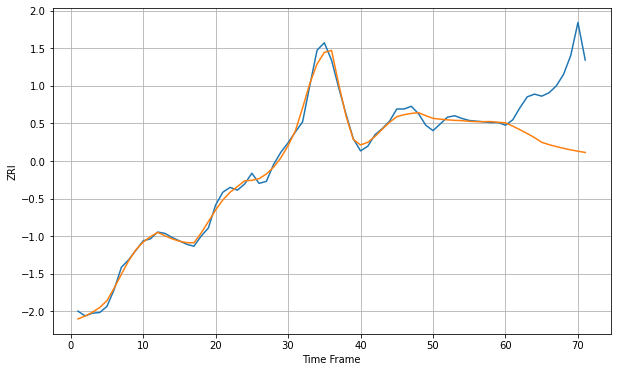

Wall time: 10.7 s
1960 7.806715700306002 97.09300235250987 [1797.55670287 1792.66474943 1787.3773805  1781.72199274 1775.70399236
 1768.73582123 1765.32435156 1762.44094846 1759.86374378 1757.57948527
 1755.55353805 1753.74522619]

Got an mse at 0.0050 in round 430 and stopped training



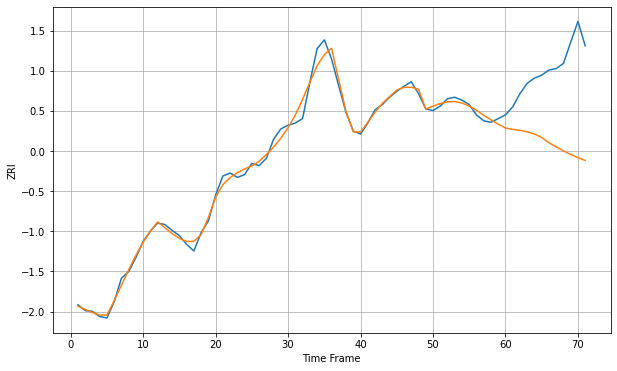

Wall time: 14.2 s
1970 7.685526343157366 107.32363341740208 [1819.1978159  1817.23098879 1816.0911342  1814.00264265 1811.08622775
 1806.29689819 1799.18039096 1793.46607633 1788.07618263 1783.20574398
 1778.87996598 1775.11716802]

Got an mse at 0.0050 in round 244 and stopped training



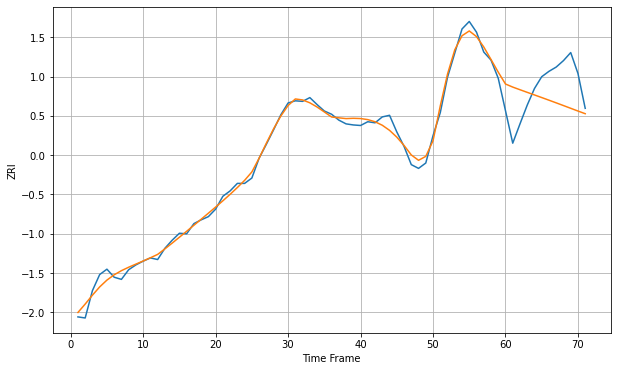

Wall time: 10 s
2026 10.28317263674699 64.49823460368071 [2248.34794879 2242.62125801 2237.68192349 2232.80644168 2227.95464321
 2223.08559779 2218.16761793 2213.18460238 2208.13850537 2203.04864047
 2197.94883731 2192.98687501]

Got an mse at 0.0050 in round 184 and stopped training



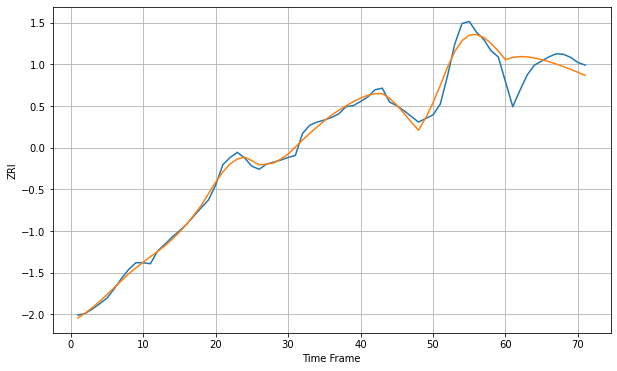

Wall time: 8.72 s
2062 11.418986243134825 39.95350812575678 [2180.46184388 2184.98806929 2186.60846075 2186.01890267 2183.87269251
 2180.64809557 2176.65984173 2172.10369418 2167.09579737 2161.70081374
 2155.95149393 2149.86305684]

Got an mse at 0.0050 in round 194 and stopped training



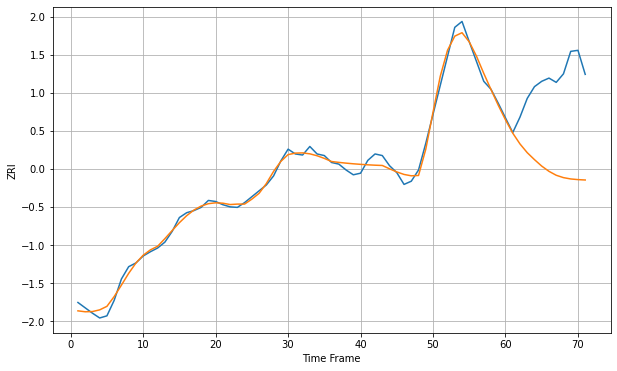

Wall time: 9.05 s
2072 10.008501908596283 160.69171041688332 [1926.88043357 1901.97988365 1881.73005262 1865.40795403 1852.35993893
 1840.25943418 1830.48098827 1823.1221482  1818.687292   1816.22264478
 1814.99131791 1814.26271507]

Got an mse at 0.0050 in round 284 and stopped training



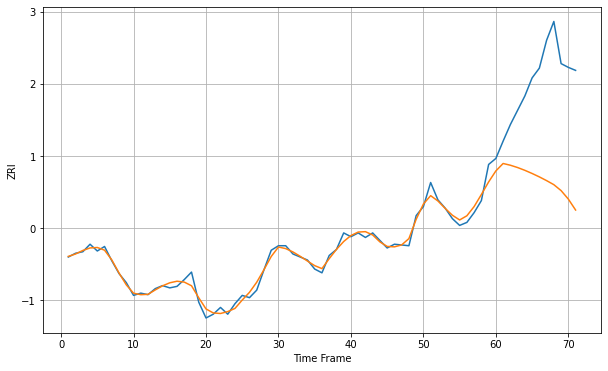

Wall time: 10.9 s
2111 6.730467705995579 139.04822960159427 [2837.41356253 2847.27844338 2844.96800851 2841.89361353 2838.18899398
 2834.00948234 2829.457802   2824.50247066 2819.12436993 2811.24685544
 2799.96615236 2785.4486314 ]

Got an mse at 0.0050 in round 453 and stopped training



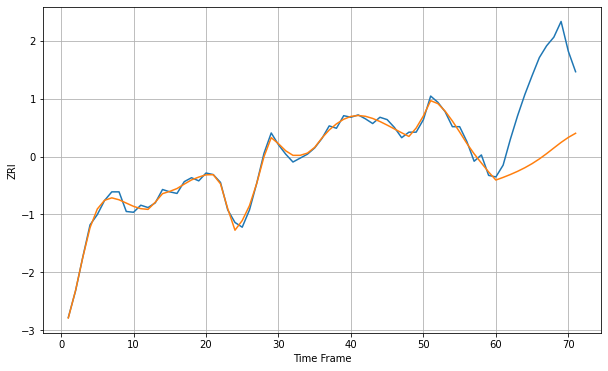

Wall time: 14.6 s
2113 5.187028425512257 102.42393771606179 [2590.03677377 2593.40310616 2597.08162601 2601.15428399 2605.73200246
 2610.94875225 2616.92269715 2623.65225986 2630.86453705 2637.97832513
 2644.34847522 2649.59652615]


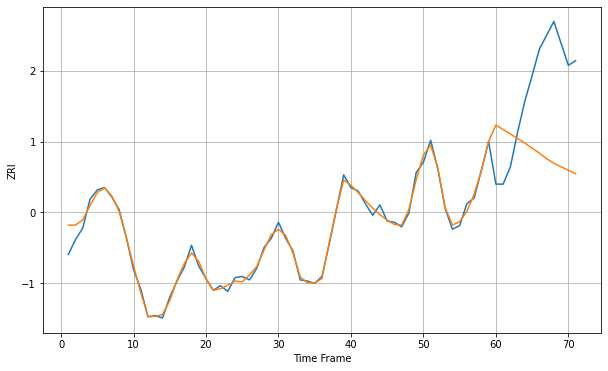

Wall time: 15.6 s
2114 5.048656081180794 79.03460432486972 [2809.12234639 2805.38708078 2801.52182539 2797.55856293 2793.47715734
 2789.17162722 2784.83936269 2780.06812674 2776.12764061 2773.0115605
 2770.01364976 2767.08093463]

Got an mse at 0.0049 in round 401 and stopped training



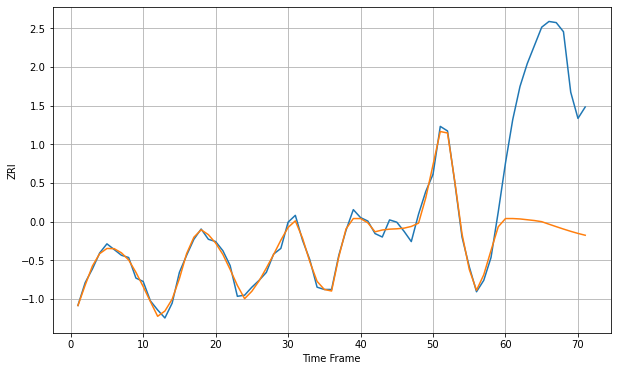

Wall time: 13.5 s
2115 4.734725004447902 137.2599670923498 [2904.18132496 2904.18132496 2903.83792111 2903.13663379 2902.43070565
 2901.42827139 2899.23886774 2897.07773557 2894.97636038 2892.97733183
 2891.13996949 2889.53786836]

Got an mse at 0.0050 in round 332 and stopped training



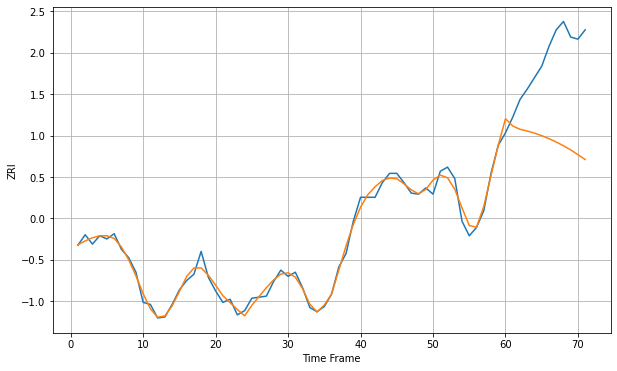

Wall time: 12 s
2116 5.611267867413169 83.37538373392398 [2835.52993153 2828.53370572 2825.32849732 2823.71710328 2821.68448984
 2819.22048851 2816.36953253 2813.13023499 2809.50992806 2805.58122552
 2800.91723325 2796.28925641]

Got an mse at 0.0050 in round 419 and stopped training



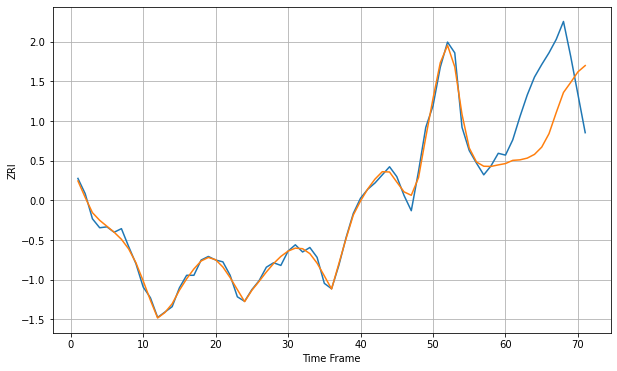

Wall time: 13.9 s
2118 6.214303902886902 65.79192379945331 [2943.58150269 2947.13348517 2947.72614952 2949.63666194 2953.80650038
 2961.90831148 2976.82479163 3000.39730434 3022.8091351  3034.07305313
 3045.85586446 3052.82198511]

Got an mse at 0.0049 in round 283 and stopped training



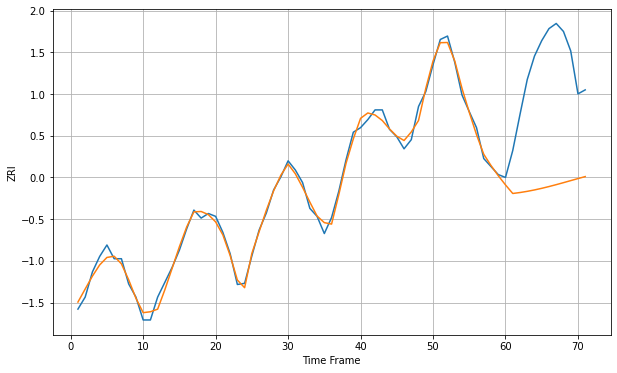

Wall time: 10.9 s
2119 10.160708913470478 205.1644932014718 [2769.97093365 2754.99027288 2756.64032559 2758.71933246 2761.18585878
 2763.99294755 2767.08733447 2770.40874452 2773.88945558 2777.45427867
 2781.02107204 2784.50187119]

Got an mse at 0.0050 in round 471 and stopped training



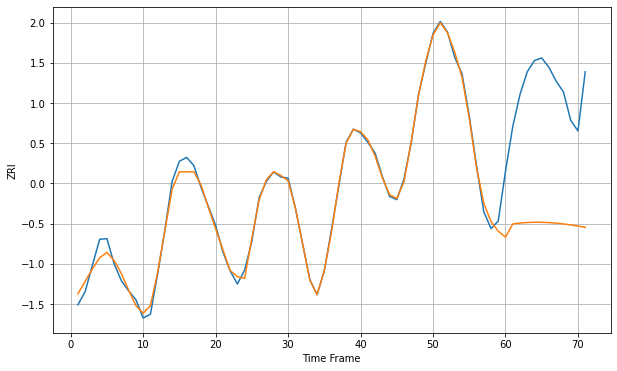

Wall time: 15.1 s
2120 8.964816319850966 211.12767340464492 [3076.32819008 3097.35585871 3098.80621572 3099.70814262 3100.08579066
 3099.99348219 3099.48684855 3098.6124567  3097.40412892 3095.88109516
 3094.04733324 3091.89309637]

Got an mse at 0.0050 in round 425 and stopped training



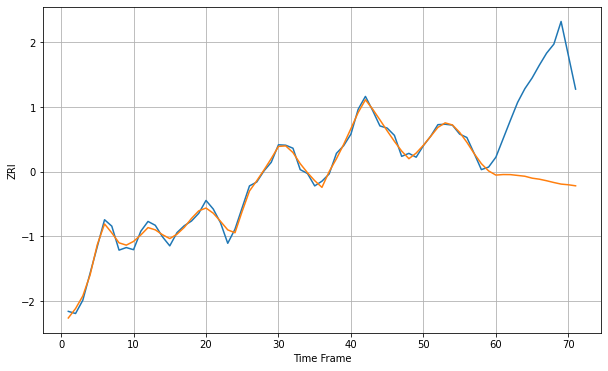

Wall time: 14 s
2121 10.57534912128642 241.7117513822127 [2370.25236677 2371.5009321  2371.34935303 2369.44987781 2367.54736457
 2363.07466147 2360.67613854 2357.0419738  2352.90345456 2349.22019508
 2347.65466827 2345.19908532]

Got an mse at 0.0050 in round 491 and stopped training



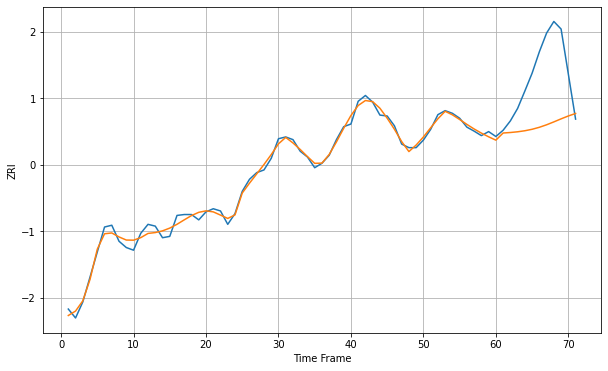

Wall time: 15.4 s
2122 10.491682644854196 128.64162742275542 [2399.79211494 2415.84227123 2416.95765201 2418.5693959  2420.90616033
 2424.20652487 2428.65555843 2434.26779794 2440.76650329 2447.58239672
 2454.0468371  2459.6568265 ]

Got an mse at 0.0050 in round 431 and stopped training



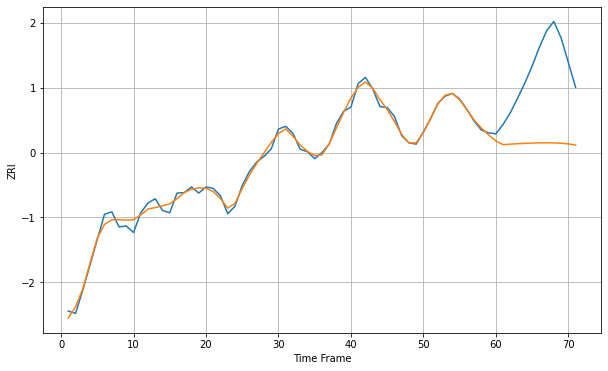

Wall time: 14 s
2124 9.729496578032093 163.07485908406005 [2291.95395867 2283.81906818 2285.02352518 2285.97416716 2286.71169793
 2287.28835103 2287.7142054  2287.91769518 2287.75199205 2287.03434584
 2285.59237614 2283.06630047]

Got an mse at 0.0050 in round 445 and stopped training



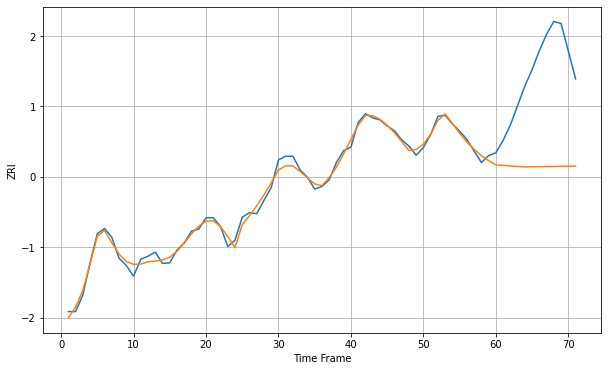

Wall time: 14.6 s
2125 9.63816538387359 191.29046262171042 [2480.36290161 2479.22782731 2478.10346886 2477.0051802  2476.2471967
 2476.46631372 2476.68827315 2476.91335502 2477.13947391 2477.36271252
 2477.57792042 2477.77935264]

Got an mse at 0.0050 in round 168 and stopped training



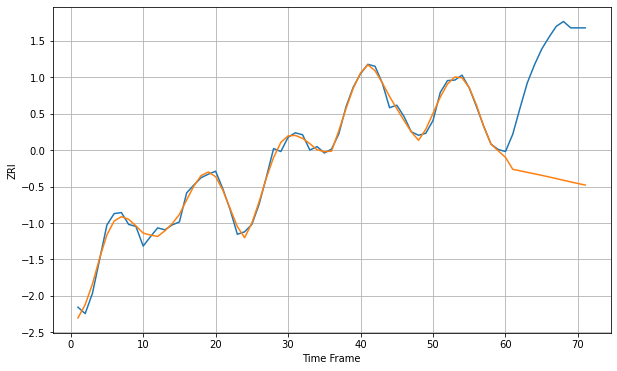

Wall time: 8.42 s
2126 10.416295410369015 249.6788213031457 [2275.20412297 2250.87339793 2247.80607782 2244.77148088 2241.73121624
 2238.62018495 2235.39550855 2232.06399606 2228.67855342 2225.31538994
 2222.04888986 2218.9347577 ]

Got an mse at 0.0050 in round 400 and stopped training



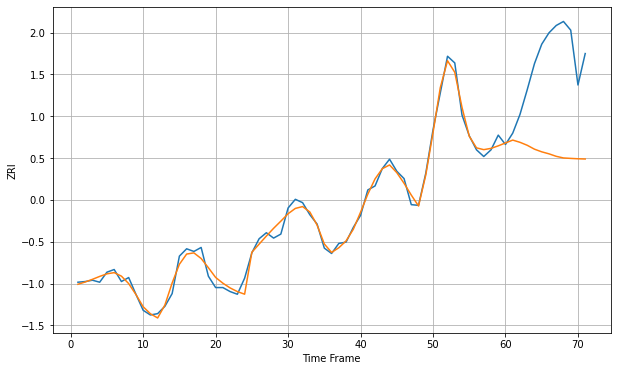

Wall time: 13.4 s
2127 8.791419701425953 140.73015864795835 [2863.2966797  2867.57629969 2864.25019868 2859.7988486  2853.96498704
 2850.0120498  2847.02551371 2843.29088838 2840.85265746 2840.19241809
 2839.64372565 2839.29259395]

Got an mse at 0.0050 in round 117 and stopped training



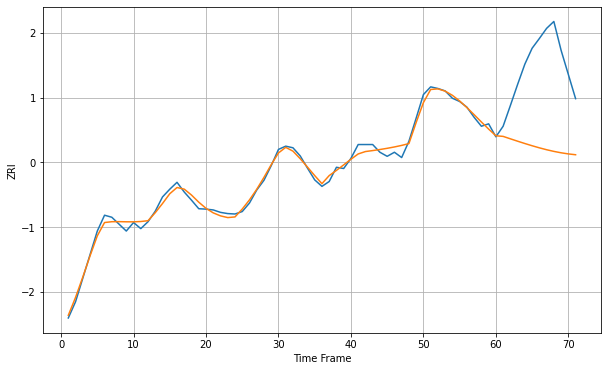

Wall time: 7.23 s
2128 11.145921682142141 205.68495473446285 [2462.59294752 2461.06859921 2455.07886858 2449.20993762 2443.50225561
 2438.03174307 2432.90269296 2428.23140313 2424.12672097 2420.67338769
 2417.92156332 2415.88320351]


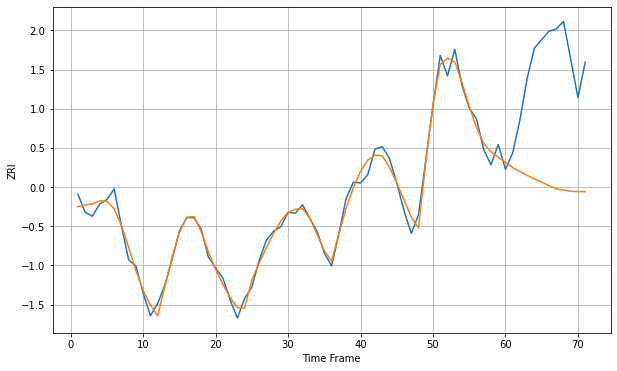

Wall time: 15.5 s
2129 10.881465437252578 158.1251587330722 [2785.2597053  2778.28189442 2772.91343524 2767.93756257 2763.28616523
 2758.84194484 2754.51873306 2750.28777431 2748.52739999 2746.96353025
 2746.405456   2746.405456  ]

Got an mse at 0.0050 in round 355 and stopped training



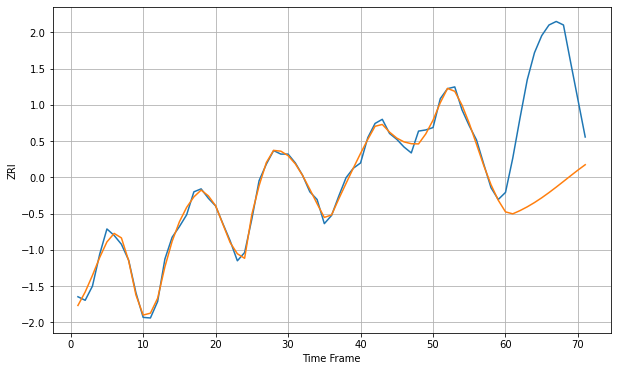

Wall time: 12.4 s
2130 8.66700192178926 205.0784193672959 [2587.99584838 2584.6476539  2590.12862339 2596.5225589  2603.79933423
 2611.89282907 2620.68059988 2629.98998086 2639.62405156 2649.35232024
 2658.89829544 2667.98327839]

Got an mse at 0.0050 in round 280 and stopped training



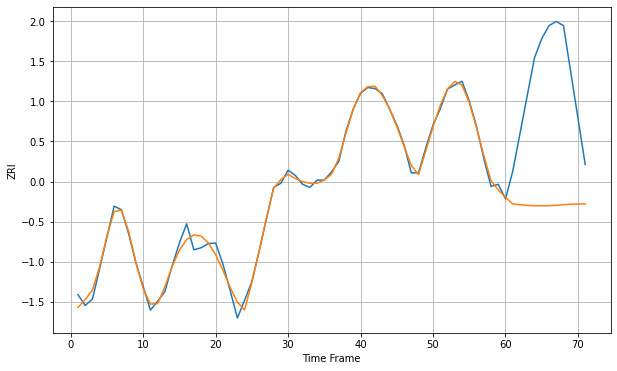

Wall time: 10.7 s
2131 10.841261834840537 243.5981285931731 [2369.9173583  2357.29950071 2355.63956765 2354.46946827 2353.78840327
 2353.59124244 2353.8675298  2354.59993423 2355.76245029 2356.73333035
 2356.93972862 2357.33176143]

Got an mse at 0.0050 in round 219 and stopped training



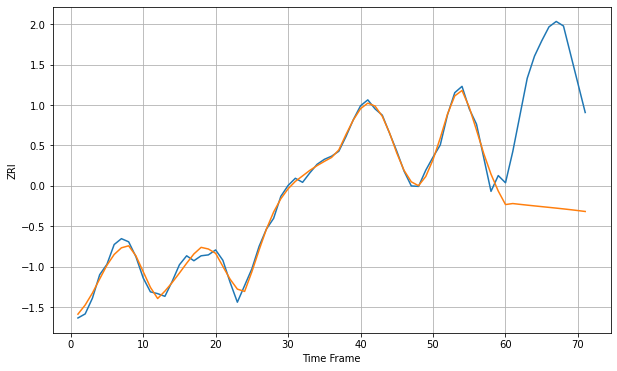

Wall time: 9.27 s
2132 12.602703225700273 305.85109898659186 [2324.70382614 2326.92706113 2325.1275223  2323.39717364 2321.72249476
 2320.08188383 2318.44686891 2316.78507113 2315.06434747 2313.25754227
 2311.34771415 2309.33410952]

Got an mse at 0.0050 in round 319 and stopped training



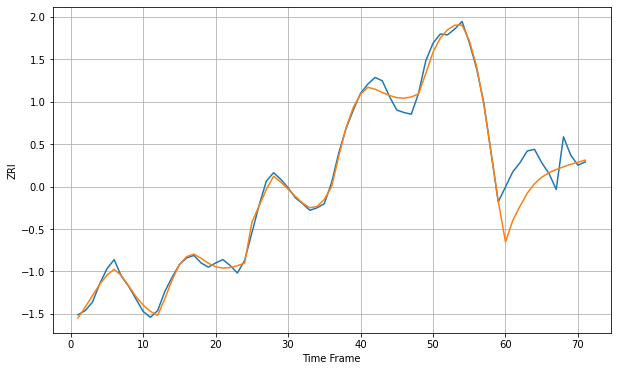

Wall time: 12.1 s
2134 7.114060000992848 37.61811810126252 [2536.14660288 2561.78426206 2578.95184225 2594.40443012 2605.88296424
 2613.64275168 2618.93213302 2622.86316198 2626.12797871 2629.03214107
 2631.64375065 2634.0572824 ]

Got an mse at 0.0050 in round 265 and stopped training



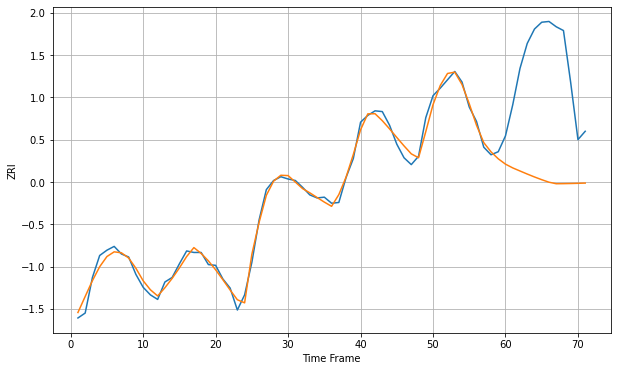

Wall time: 10.8 s
2135 7.845862721616387 156.08211631924036 [2710.58655042 2705.64492801 2701.57251071 2697.54640156 2693.68756946
 2690.07891382 2686.76809056 2684.7522937  2684.87051161 2685.05637066
 2685.30142198 2685.59489496]

Got an mse at 0.0050 in round 241 and stopped training



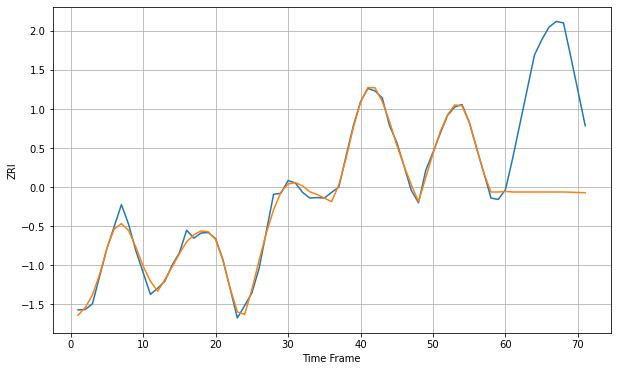

Wall time: 10.3 s
2136 11.636981503472814 256.7962820648389 [2364.04993554 2362.79905217 2362.79905217 2362.79905217 2362.79905217
 2362.79905217 2362.79905217 2362.79905217 2362.79905217 2362.37353691
 2361.83526258 2361.31680038]

Got an mse at 0.0050 in round 174 and stopped training



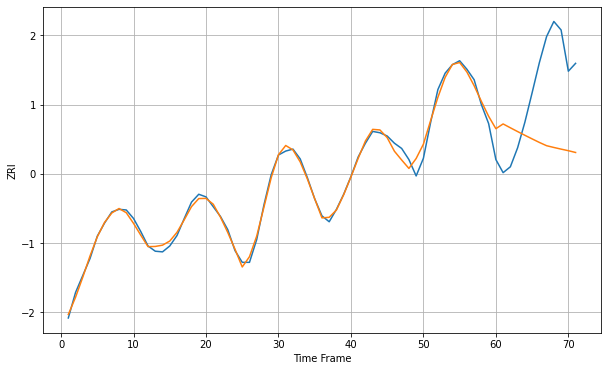

Wall time: 8.77 s
2138 7.421120171247806 116.6973394174584 [2568.19019097 2575.43808818 2569.55828002 2563.78355984 2558.136112
 2552.61132175 2547.19206565 2542.19130993 2539.50418578 2536.96672567
 2534.55961573 2531.83869398]


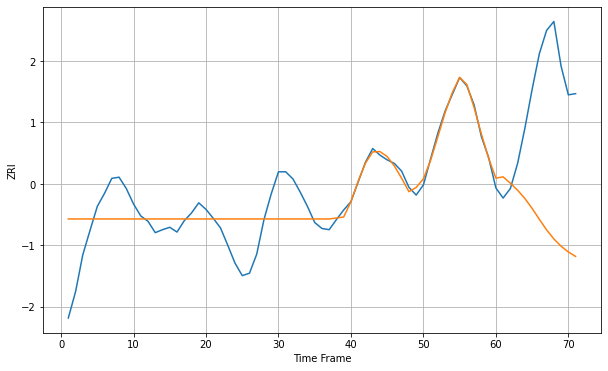

Wall time: 16.1 s
2139 44.181972141079164 226.15531695027306 [2598.45896525 2600.56487028 2589.93810236 2578.14693276 2564.2565643
 2547.71545783 2529.39082021 2511.65275213 2496.46950533 2484.25980026
 2474.64610407 2467.21877755]

Got an mse at 0.0050 in round 276 and stopped training



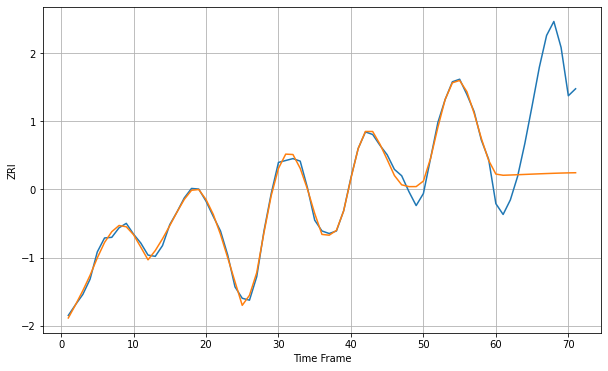

Wall time: 10.9 s
2140 7.5522107785496955 137.09957586851297 [2558.61460801 2556.74812345 2557.15027341 2557.60222666 2558.0766927
 2558.5531902  2559.01743351 2559.4586356  2559.86635503 2560.22776419
 2560.52515358 2560.73259665]

Got an mse at 0.0050 in round 226 and stopped training



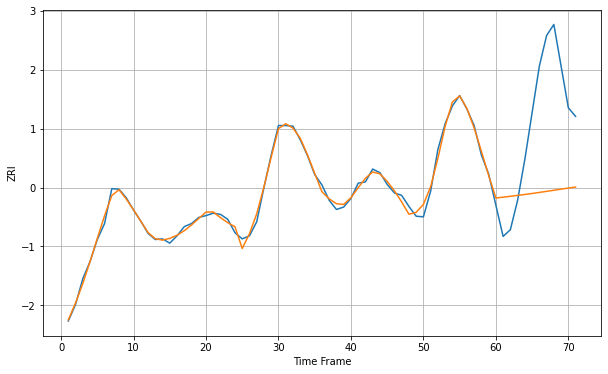

Wall time: 10.2 s
2141 6.716212290717107 152.5425720805113 [2524.75495635 2526.1117793  2527.52275346 2528.99194067 2530.52765309
 2532.13789772 2533.82511471 2535.58138727 2537.3853615  2539.20163394
 2540.98267343 2542.67294414]

Got an mse at 0.0050 in round 425 and stopped training



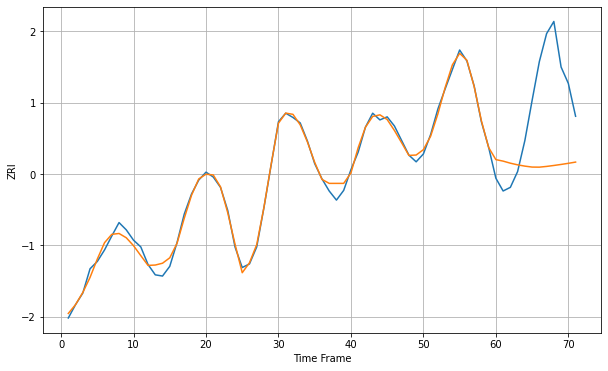

Wall time: 14.5 s
2143 8.255809620670943 129.63500155850286 [2454.62366894 2452.1534997  2448.75965    2446.03208243 2443.92100111
 2442.3576201  2442.22725982 2443.43580399 2444.98914403 2446.69263773
 2448.53761334 2450.55419608]

Got an mse at 0.0049 in round 271 and stopped training



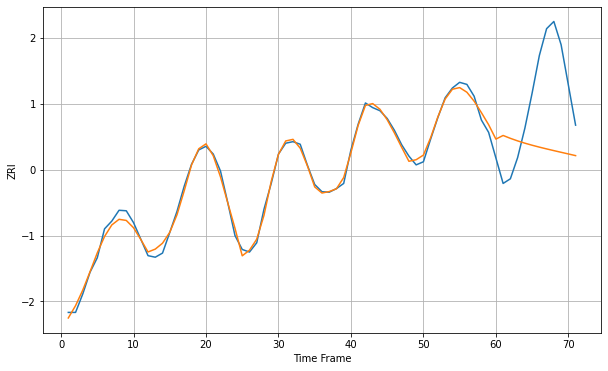

Wall time: 11.2 s
2144 8.8929209837571 141.9091551619623 [2581.94926755 2588.98442977 2583.43111724 2578.48880289 2574.07058082
 2570.07489009 2566.39884738 2562.94686785 2559.63544167 2556.39527404
 2553.17184058 2549.9251057 ]

Got an mse at 0.0050 in round 486 and stopped training



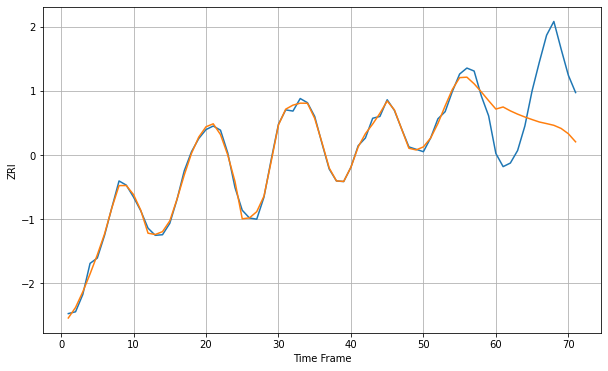

Wall time: 15.5 s
2145 7.5080223905070875 102.32747546269302 [2414.3679839  2417.85730659 2411.33169289 2405.84893147 2401.08227204
 2396.77141529 2392.70959829 2390.01338168 2387.16486984 2381.9504257
 2373.07716201 2359.5497    ]

Got an mse at 0.0049 in round 358 and stopped training



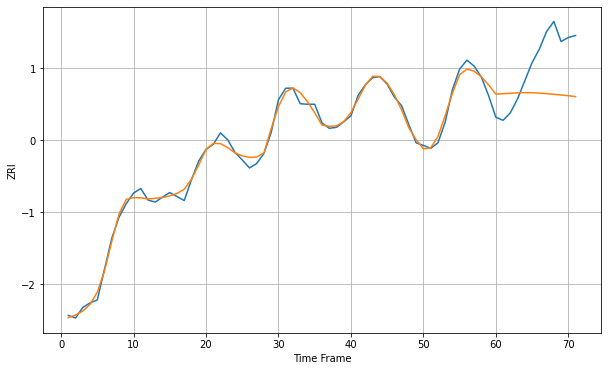

Wall time: 12.4 s
2148 9.99184755995229 88.75922932736437 [2242.13700239 2242.89783684 2243.87913175 2244.72552318 2245.12759517
 2244.93423884 2244.18537317 2243.06484708 2241.77840977 2240.42506789
 2238.97107617 2237.33170174]

Got an mse at 0.0050 in round 282 and stopped training



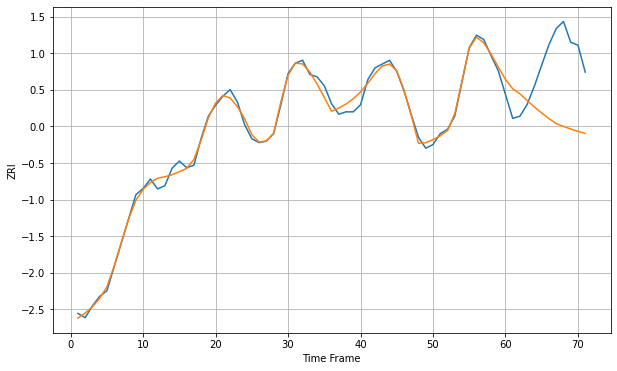

Wall time: 11.1 s
2149 10.856664239240715 134.53283922672745 [2283.42493967 2263.58232629 2253.1260438  2238.73974511 2225.03586928
 2212.46918165 2200.60825482 2190.17340248 2184.08748965 2178.63893049
 2173.79288173 2169.43672355]

Got an mse at 0.0050 in round 305 and stopped training



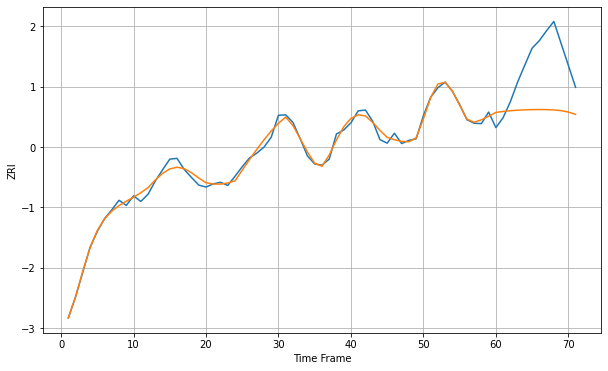

Wall time: 11.3 s
2150 10.614078391129828 131.75253232224736 [2417.13616409 2419.51750251 2421.34219325 2422.66060333 2423.54793267
 2424.07944377 2424.29028194 2424.11567189 2423.32283106 2421.47486748
 2417.98086968 2412.25218104]

Got an mse at 0.0050 in round 315 and stopped training



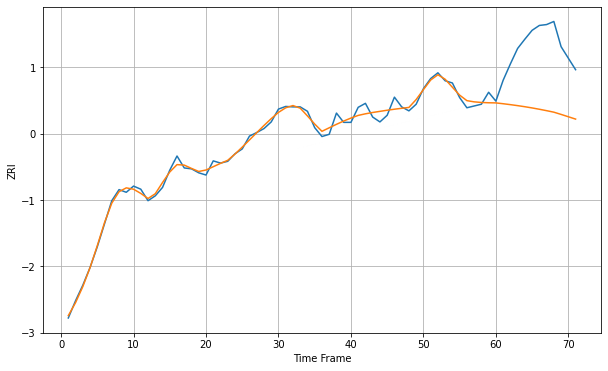

Wall time: 11.5 s
2151 10.554769486254127 144.66296569215524 [2356.98402123 2355.11085763 2353.05554142 2350.80418703 2348.33645774
 2345.62465121 2342.63542465 2339.4227177  2336.02732893 2330.97037141
 2325.70127901 2320.40695933]

Got an mse at 0.0050 in round 316 and stopped training



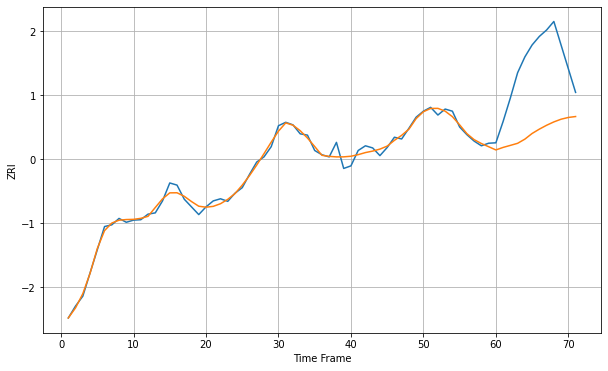

Wall time: 11.6 s
2152 10.561354400547767 163.7793956420481 [2426.31259242 2432.21674437 2436.96385062 2441.81089387 2451.54979007
 2464.82882732 2475.00959197 2484.04893466 2491.89482277 2498.23069038
 2502.33009014 2504.47982877]

Got an mse at 0.0050 in round 341 and stopped training



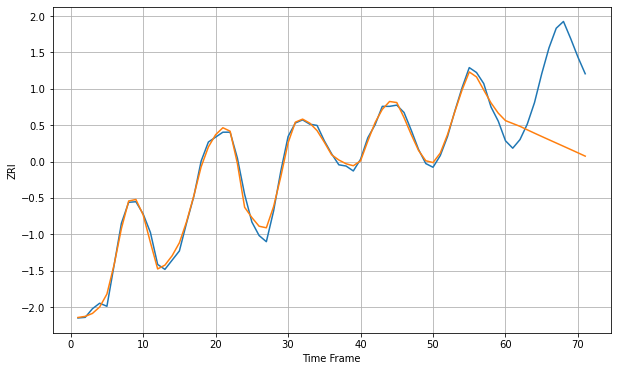

Wall time: 12 s
2155 8.234680569147468 125.46823076922391 [2379.80096017 2375.13674745 2370.54465619 2364.90366036 2359.42297602
 2354.04770355 2348.73253498 2343.44141953 2338.14677416 2332.82850327
 2327.47299274 2322.07216672]

Got an mse at 0.0049 in round 249 and stopped training



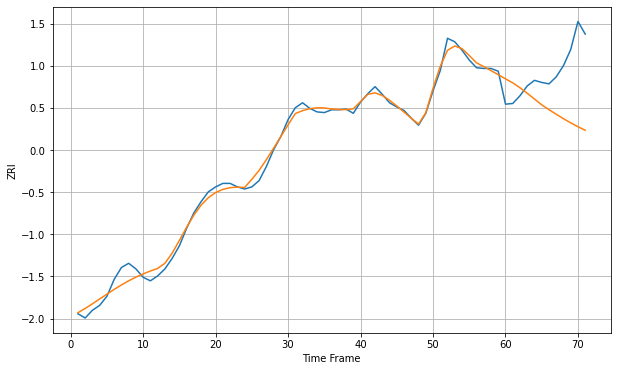

Wall time: 10.4 s
2169 8.409472013006804 74.3888520097119 [2016.1430109  2010.39130719 2003.43588656 1995.5415573  1987.32646993
 1979.0033548  1972.197232   1965.59471311 1959.29548674 1953.36877866
 1947.85600062 1942.77692005]

Got an mse at 0.0050 in round 264 and stopped training



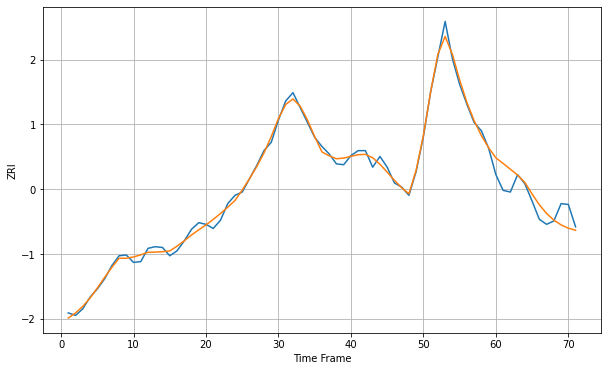

Wall time: 10.4 s
2170 5.496018515157338 18.909720940808292 [1927.32935184 1920.546074   1913.57048098 1906.45634924 1897.58766357
 1883.62437331 1870.63959356 1860.05682923 1852.06569283 1846.31112877
 1842.34938036 1839.81362409]

Got an mse at 0.0049 in round 349 and stopped training



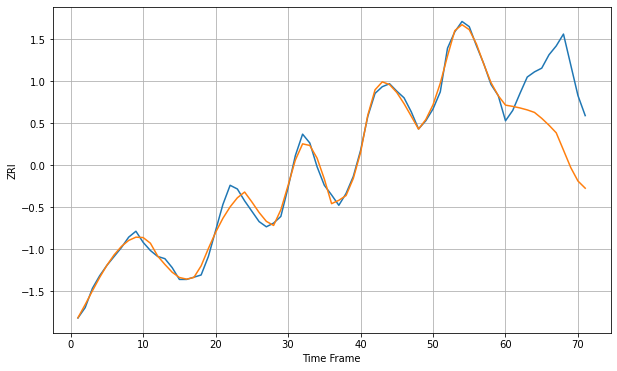

Wall time: 12.3 s
2171 7.931211948501035 91.15269416483011 [2187.13022507 2185.42051231 2183.33281685 2180.70068799 2177.30137972
 2169.30945725 2160.05417605 2149.79679922 2126.46529029 2103.00858466
 2084.74297708 2075.08038428]

Got an mse at 0.0050 in round 337 and stopped training



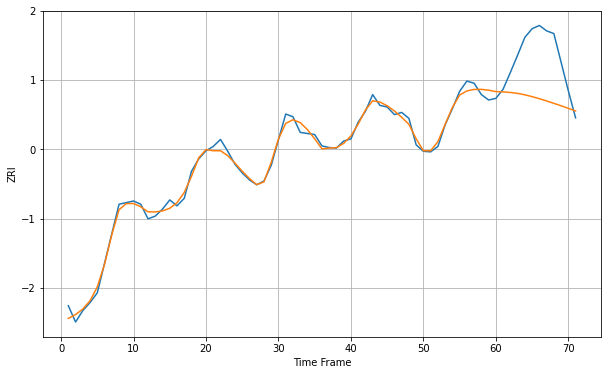

Wall time: 12 s
2176 9.033597358400332 88.19136147826056 [2279.55857595 2279.00366186 2277.91308747 2276.28312315 2273.59920204
 2270.22647202 2266.40502784 2262.23571089 2257.83337472 2253.31454072
 2248.56296038 2243.74357013]

Got an mse at 0.0050 in round 134 and stopped training



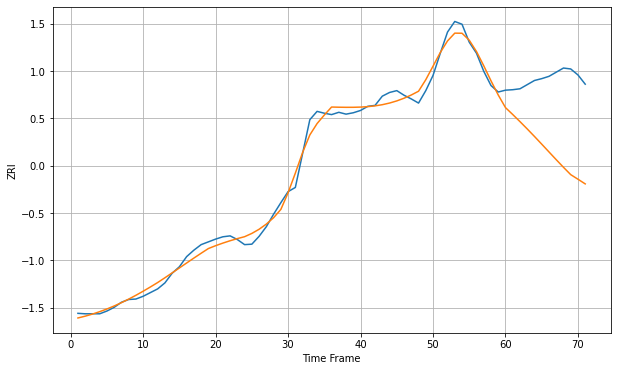

Wall time: 7.67 s
2184 14.366483892710846 161.57315159507021 [2157.14360908 2142.1712179  2126.76406049 2110.89393442 2094.57858515
 2077.90484521 2061.0435366  2044.22630073 2027.71673845 2011.77892064
 2001.86809405 1991.7265062 ]


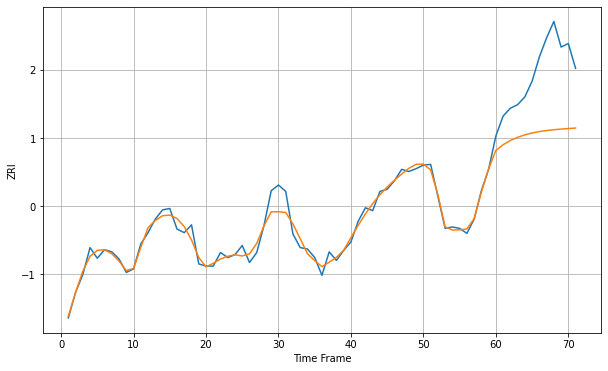

Wall time: 15.9 s
2210 10.499864067525126 91.36855707801752 [2903.71718924 2911.62192812 2917.57206328 2922.09801639 2925.55456039
 2928.18398338 2930.16660969 2931.65188482 2932.77309168 2933.65095264
 2934.39150516 2935.08216215]

Got an mse at 0.0050 in round 282 and stopped training



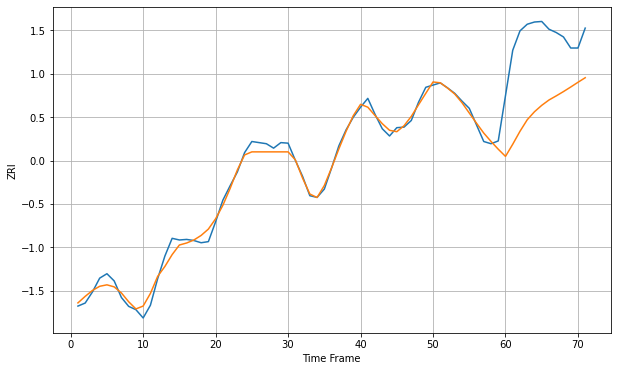

Wall time: 11 s
2215 10.940733536609253 132.00125267860008 [2343.10042976 2365.10084714 2388.47499471 2409.32358094 2423.82693415
 2435.3778971  2445.04670318 2452.48376638 2460.2561238  2468.50279944
 2477.04441551 2485.30175336]

Got an mse at 0.0050 in round 267 and stopped training



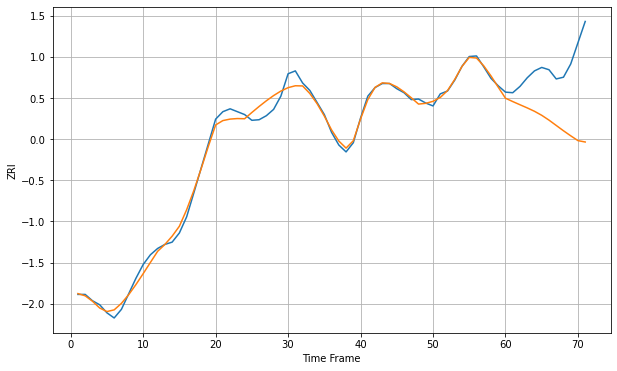

Wall time: 10.8 s
2301 10.084022817849736 103.11016642034495 [1644.44106629 1638.61037087 1633.06057807 1627.57919926 1621.67033033
 1614.6891586  1606.32225959 1597.05148621 1587.7893556  1579.00629017
 1570.63800313 1568.23296312]

Got an mse at 0.0050 in round 155 and stopped training



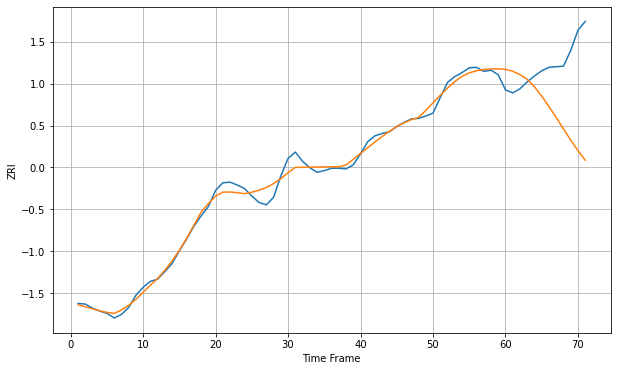

Wall time: 8.21 s
2302 10.167315844926838 113.11586493996062 [1736.53030446 1733.28439165 1727.34254727 1719.30506738 1706.42818934
 1690.3092641  1672.46529774 1653.40767334 1633.85435536 1614.62192496
 1596.44727372 1579.86527593]

Got an mse at 0.0049 in round 163 and stopped training



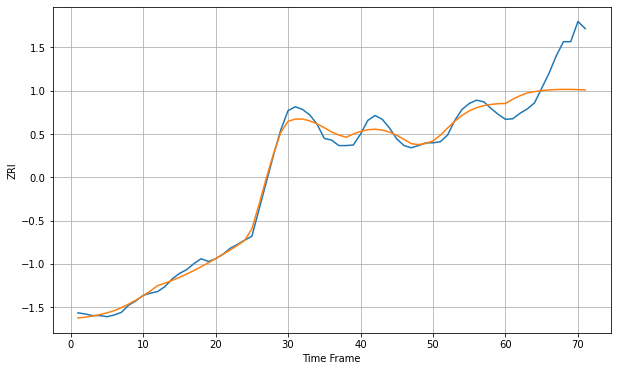

Wall time: 8.17 s
2360 11.055468486215572 66.15572148496297 [1797.96561601 1805.77566431 1812.17867297 1817.18383665 1819.70563397
 1821.53640709 1822.76452877 1823.47516804 1823.75416646 1823.68533199
 1823.34463585 1822.79437045]


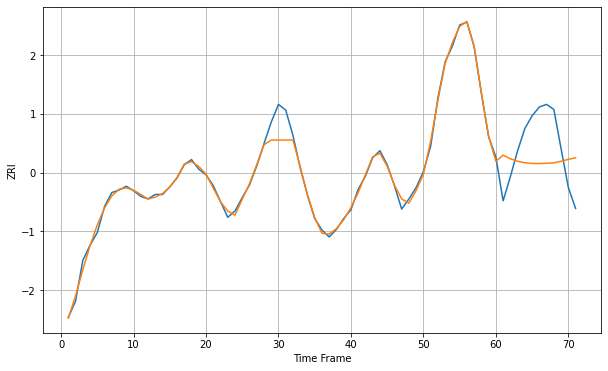

Wall time: 15.9 s
2445 11.286468637807996 62.75784052889954 [2783.19347775 2793.00349817 2787.25247726 2783.32203848 2780.97005696
 2779.89114897 2779.74165009 2780.18108324 2780.87814113 2783.37636206
 2786.30180454 2788.92600598]

Got an mse at 0.0049 in round 176 and stopped training



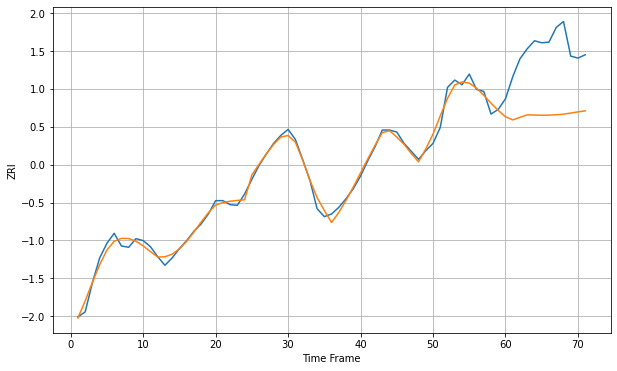

Wall time: 8.67 s
2446 7.916084901214751 98.41158736008394 [2885.98647357 2881.17256928 2885.10144838 2888.86650518 2888.48380552
 2888.27327293 2888.40049752 2888.93246148 2889.81903825 2891.50430695
 2893.26741374 2894.82496079]

Got an mse at 0.0050 in round 385 and stopped training



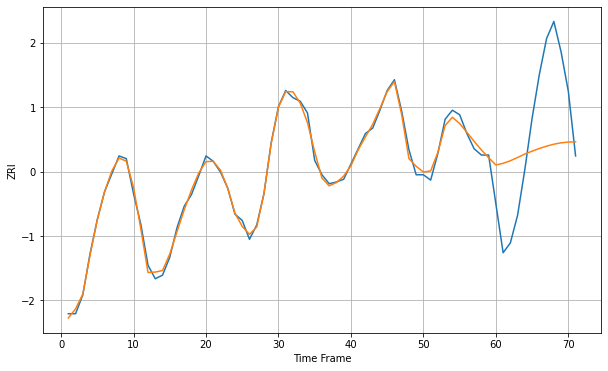

Wall time: 13.1 s
2451 5.008300143993138 81.51284772775868 [2422.91595171 2424.77621696 2427.6297041  2431.24009413 2435.17220921
 2438.31317135 2441.28662892 2443.92715167 2446.07509832 2447.6110701
 2448.48386488 2448.71894634]

Got an mse at 0.0050 in round 272 and stopped training



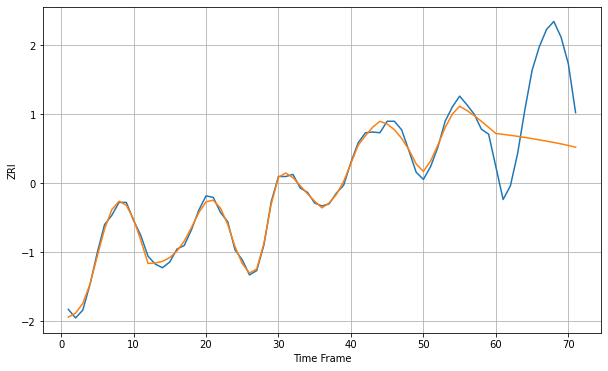

Wall time: 10.5 s
2453 6.692236163351321 105.40101785308012 [2418.93837079 2417.72145988 2416.42201823 2415.01876179 2413.48925818
 2411.83263108 2410.08309271 2408.28105137 2406.42213982 2404.45028633
 2402.30013591 2399.94214878]

Got an mse at 0.0050 in round 216 and stopped training



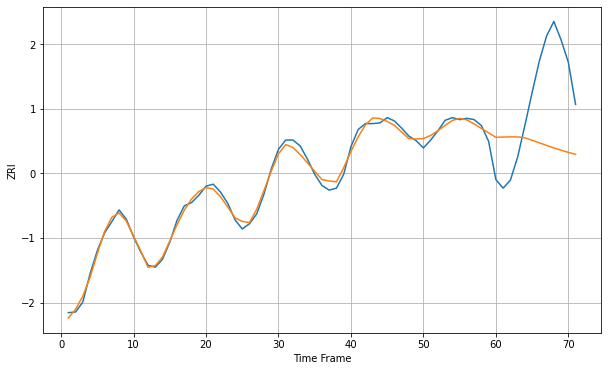

Wall time: 9.57 s
2458 6.839108388936713 113.02338753086156 [2553.08530015 2553.57597647 2553.83318195 2553.75187246 2552.36235841
 2548.62824532 2544.76856736 2540.89350864 2537.12661276 2533.57001196
 2530.27980335 2527.26141975]

Got an mse at 0.0050 in round 379 and stopped training



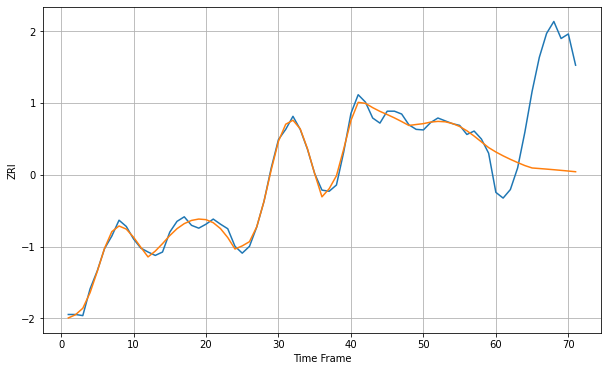

Wall time: 13 s
2460 8.904661152985344 169.87185359508075 [2620.13420614 2613.36594406 2607.21032321 2601.54018492 2596.22387753
 2592.00351863 2591.02804281 2590.00150283 2588.92121351 2587.78661114
 2586.60158088 2585.37730014]

Got an mse at 0.0050 in round 332 and stopped training



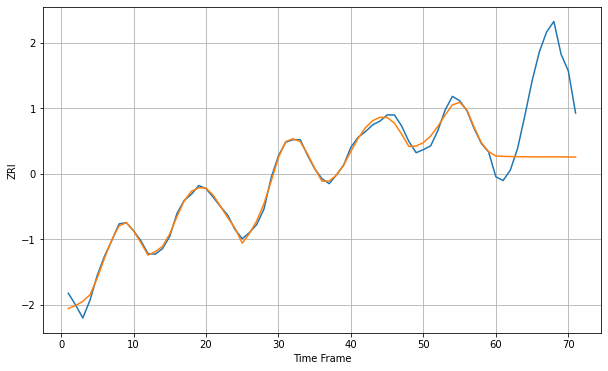

Wall time: 11.9 s
2472 7.437121530352488 126.47100018487471 [2384.67391829 2384.16101444 2383.80018172 2383.55693122 2383.39580743
 2383.27771203 2383.24688812 2383.29753546 2383.30739667 2383.26201785
 2383.152775   2382.97523102]

Got an mse at 0.0050 in round 248 and stopped training



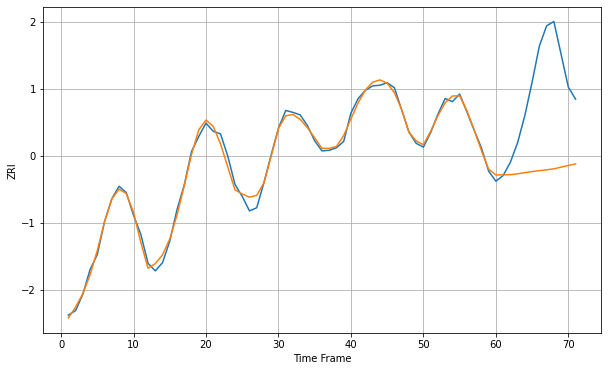

Wall time: 9.96 s
2474 7.456243851354478 139.75312046270133 [2348.86583113 2349.1052019  2349.47651105 2350.6715861  2352.56399923
 2354.25385717 2355.73450163 2357.07836151 2358.5752565  2361.3218506
 2363.94063192 2366.42372169]

Got an mse at 0.0050 in round 327 and stopped training



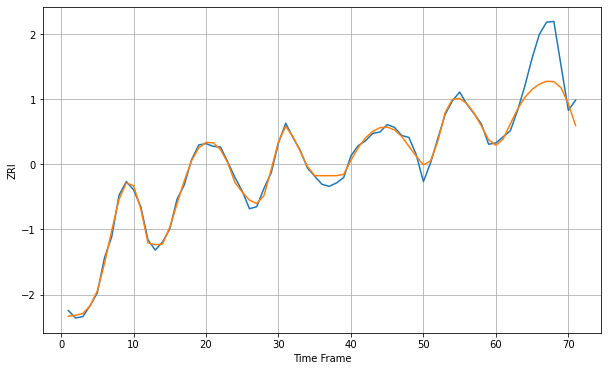

Wall time: 12 s
2476 6.736506756340307 46.45834050476339 [2278.49061502 2287.67692928 2310.1487307  2331.94850412 2349.05204443
 2360.92895908 2368.64807093 2372.7980086  2372.3421649  2363.24540276
 2339.48079476 2307.77831553]

Got an mse at 0.0050 in round 331 and stopped training



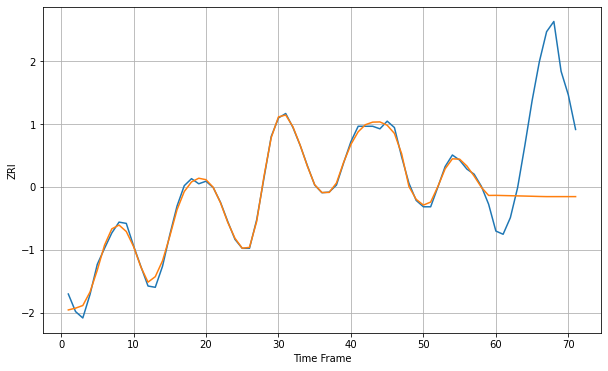

Wall time: 11.9 s
2478 6.903051432803952 157.52727863545095 [2454.87626375 2454.59924875 2454.3267433  2454.05191195 2453.76748104
 2453.46625438 2453.14164732 2452.91113883 2452.91113883 2452.91113883
 2452.91113883 2452.91113883]


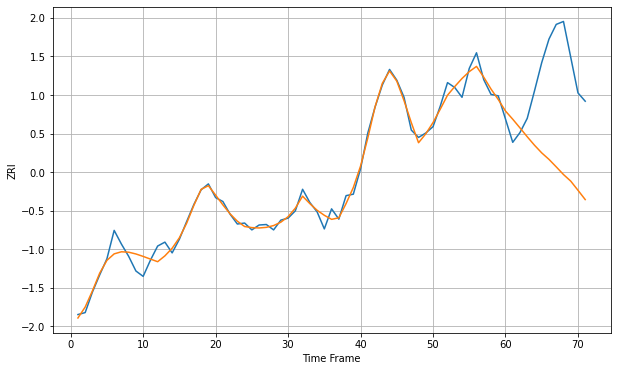

Wall time: 15.4 s
2494 15.275618665533806 190.96597146661244 [2811.93894085 2795.20063281 2777.43735927 2759.35175793 2742.07432143
 2726.37655985 2713.13007186 2697.83729416 2682.18293526 2668.71337654
 2650.05159285 2630.99185906]


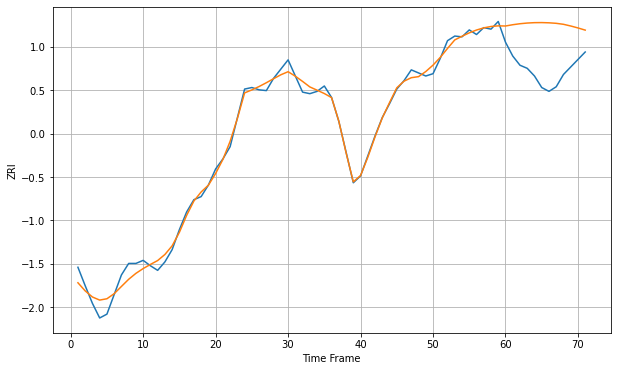

Wall time: 15.8 s
2703 8.414449364844304 61.146063924618105 [1451.09011845 1452.75475103 1454.052003   1454.95033383 1455.44277196
 1455.53687267 1455.24597736 1454.58401659 1453.30601495 1451.10238612
 1448.57318303 1445.73657821]

Got an mse at 0.0050 in round 188 and stopped training



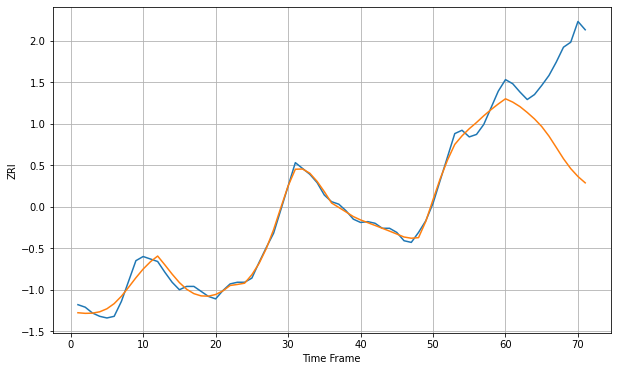

Wall time: 8.87 s
2721 7.0370334256083344 104.37382034349517 [1081.91055986 1077.90199186 1072.46842463 1065.43346566 1057.66718691
 1048.48451596 1036.94096029 1023.43025439 1009.75293462  997.85742275
  988.31487838  980.70602546]

Got an mse at 0.0049 in round 98 and stopped training



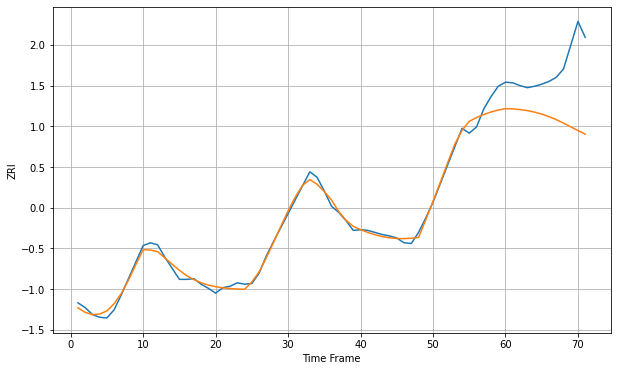

Wall time: 6.85 s
2723 8.154853714110185 81.50589996528373 [1142.56163563 1142.23561763 1141.27425013 1139.74586459 1137.56225163
 1134.6805109  1131.05563383 1126.67865575 1121.64828661 1116.22877374
 1110.7852424  1105.60631505]

Got an mse at 0.0050 in round 263 and stopped training



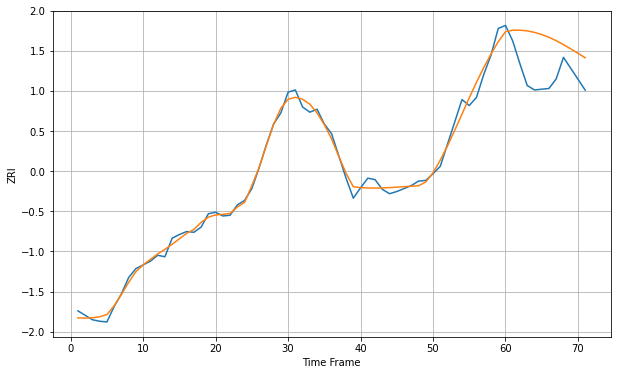

Wall time: 10.3 s
2740 7.632422657642131 50.663559070208436 [1294.55391617 1296.53630946 1296.70008382 1295.69525256 1293.68203325
 1290.80231095 1287.02808941 1282.39241726 1277.16868779 1271.49156287
 1265.50869791 1259.37449558]

Got an mse at 0.0050 in round 82 and stopped training



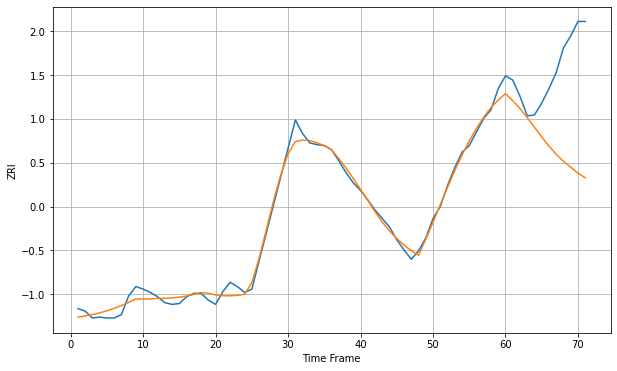

Wall time: 6.64 s
2746 7.258696445201549 101.7791589626984 [1127.05074057 1118.91945294 1109.43266729 1098.81128822 1087.50219973
 1076.13976535 1065.37306542 1055.69189129 1047.35907349 1040.4373024
 1033.58198058 1028.03796168]

Got an mse at 0.0050 in round 446 and stopped training



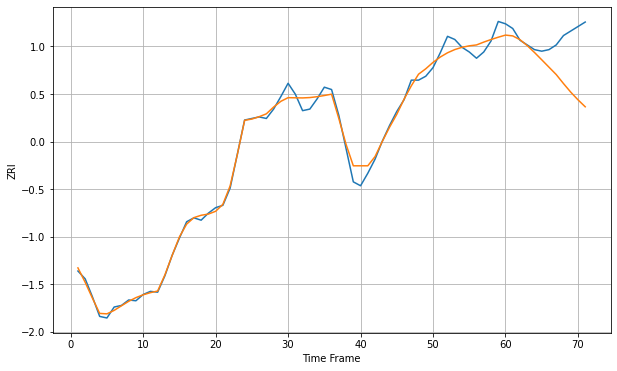

Wall time: 14.4 s
2780 8.564860927470102 52.21803130559742 [1401.58575034 1400.54205804 1395.70495742 1388.12941779 1379.33980918
 1370.01276518 1360.57138219 1351.13757666 1339.64531569 1328.69190641
 1318.88868102 1309.94057863]


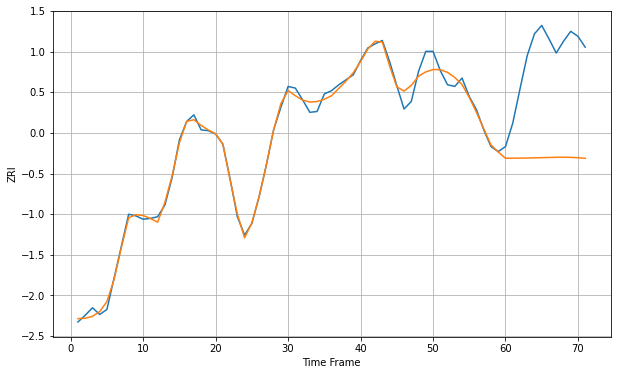

Wall time: 15.3 s
2840 7.5522348437384705 125.02601988600524 [1801.01905228 1801.09437114 1801.17685082 1801.29646122 1801.51022416
 1801.73455074 1801.91824103 1802.19401414 1802.26647709 1802.08828758
 1801.64713342 1800.95501047]

Got an mse at 0.0050 in round 184 and stopped training



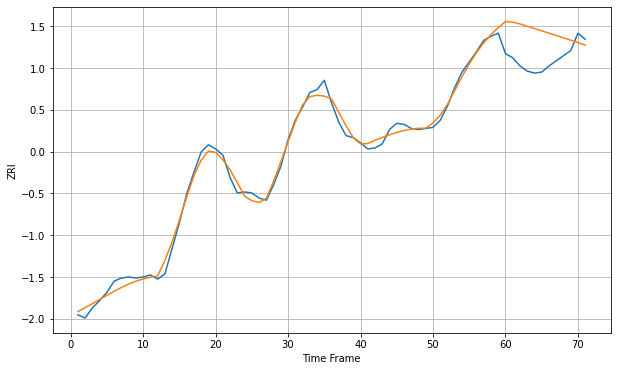

Wall time: 8.92 s
2860 5.72451457429412 30.902650721241415 [1231.42315004 1230.69392918 1229.03030961 1226.76762033 1224.48590339
 1222.22626807 1219.99119188 1217.7579951  1215.48947529 1213.14362809
 1210.89234883 1208.32404018]

Got an mse at 0.0050 in round 266 and stopped training



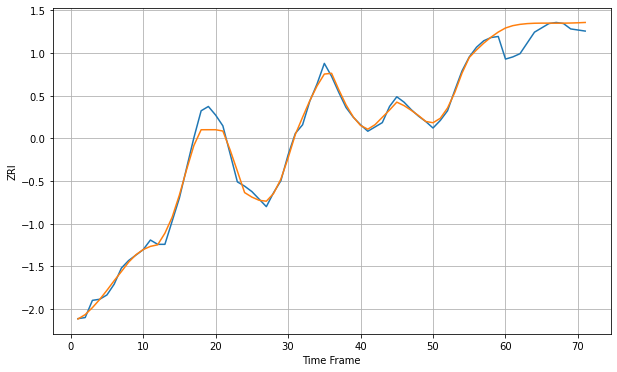

Wall time: 10.5 s
2861 5.569480430676915 15.724337177674512 [1204.86556099 1207.03406844 1208.23616576 1208.93720117 1209.27612295
 1209.37919823 1209.3647055  1209.33503546 1209.36228364 1209.48173974
 1209.6986114  1210.00055076]

Got an mse at 0.0050 in round 306 and stopped training



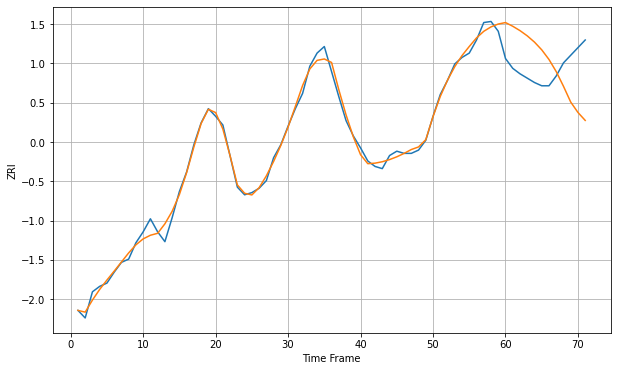

Wall time: 11.3 s
2863 5.0648659577908 40.822339322516825 [1232.99219355 1229.60794489 1225.59935175 1220.81825578 1215.05129938
 1207.97699147 1199.13229139 1188.00898462 1174.55565145 1160.0594362
 1150.50687643 1143.23257687]


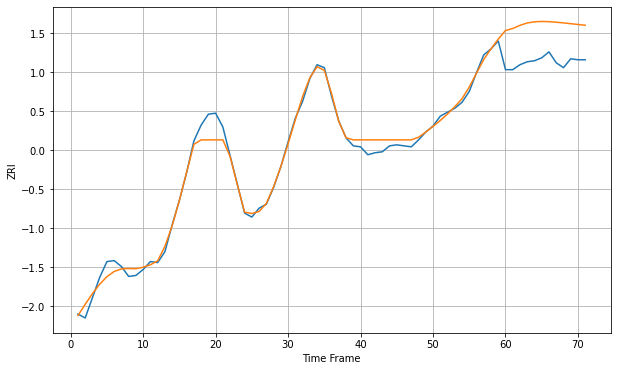

Wall time: 15.4 s
2864 7.72738200128415 38.44636066935443 [1298.59168264 1300.61617614 1303.83521895 1306.22375917 1307.39007798
 1307.7260944  1307.52358863 1306.99198623 1306.27826519 1305.48389445
 1304.67737151 1303.90267654]

Got an mse at 0.0048 in round 345 and stopped training



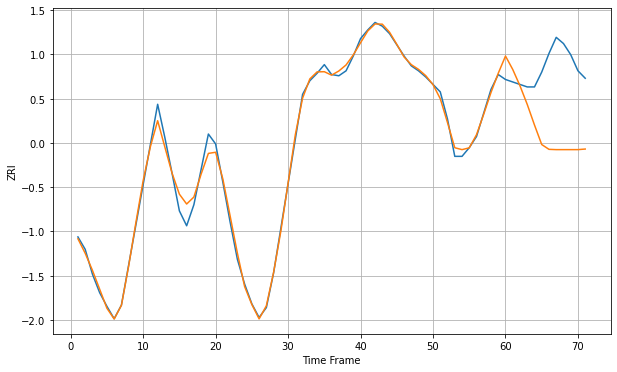

Wall time: 12.5 s
2891 4.919779786401024 57.5177323548759 [1222.91470594 1212.08615152 1198.8851129  1183.90908678 1167.28087339
 1151.52354674 1147.65745626 1147.42191194 1147.42191194 1147.42191194
 1147.42191194 1147.8967985 ]


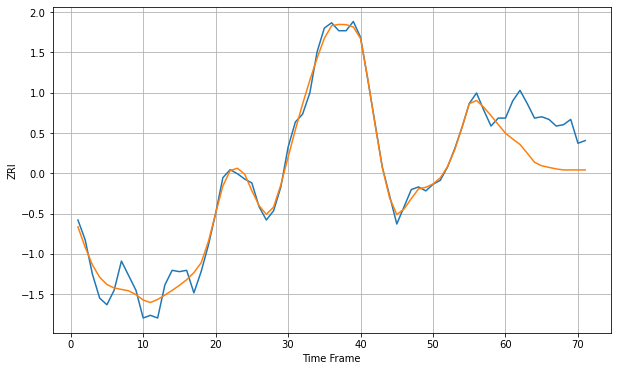

Wall time: 15.5 s
2893 7.3229151781967925 32.15484935744952 [1220.55741242 1216.17140589 1212.10296777 1205.52247564 1198.65743117
 1195.96344493 1194.75584882 1193.60919146 1192.83458949 1192.83458949
 1192.83458949 1192.83458949]

Got an mse at 0.0050 in round 222 and stopped training



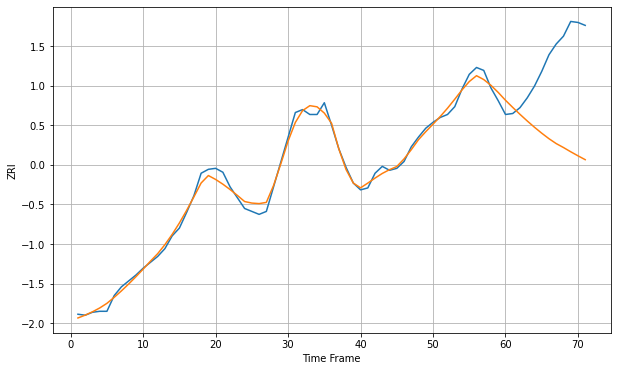

Wall time: 9.37 s
2895 5.6343906672380015 87.70810006840513 [1082.50660287 1075.20569043 1068.14898827 1061.38134131 1054.95130506
 1048.902092   1043.26045877 1038.27176393 1034.2523066  1029.91798738
 1025.80525036 1021.84647675]

Got an mse at 0.0050 in round 179 and stopped training



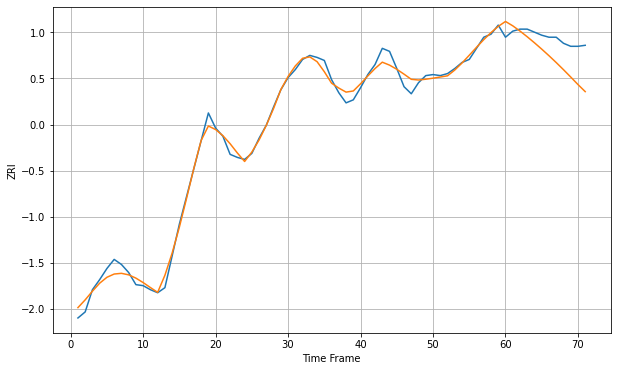

Wall time: 8.74 s
2904 6.362217664381762 23.70291790963047 [1254.60052745 1250.29514293 1245.09548012 1239.44477895 1233.45723384
 1227.19970302 1220.68925879 1213.91550559 1206.87236691 1199.58831401
 1192.15067797 1185.13489343]

Got an mse at 0.0050 in round 471 and stopped training



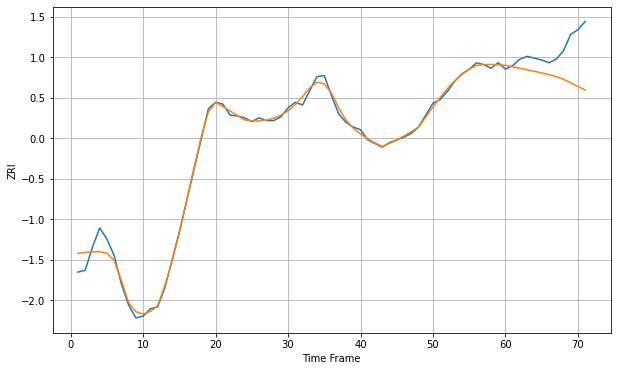

Wall time: 14.9 s
2905 6.224061826093562 34.67680952275992 [1274.12153261 1272.44974189 1270.87324655 1269.30304865 1267.66480479
 1265.91369329 1264.04124734 1261.88959421 1259.01243825 1255.06762183
 1251.15016692 1247.38562239]

Got an mse at 0.0049 in round 66 and stopped training



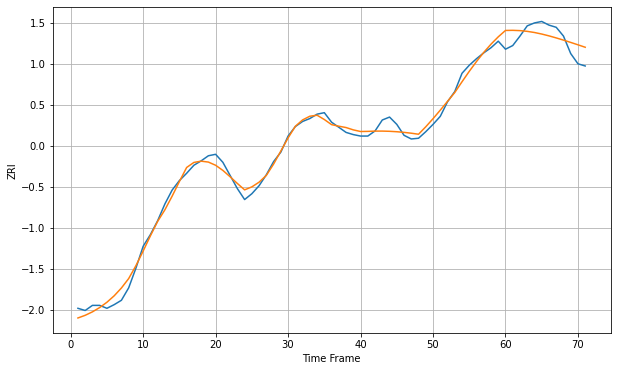

Wall time: 5.99 s
2906 7.798134684318207 17.573728457840676 [1576.69103553 1576.8594625  1576.45675751 1575.45065692 1573.86387447
 1571.76737446 1569.26247064 1566.45670396 1563.44195009 1560.28265018
 1557.01676048 1553.66597626]

Got an mse at 0.0050 in round 400 and stopped training



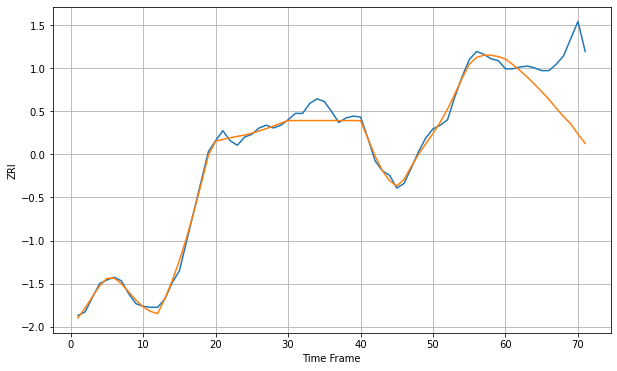

Wall time: 13.6 s
2907 6.654681672902266 59.983668120553 [1262.77032372 1256.74447304 1250.12683915 1242.89576652 1235.06384707
 1226.77801665 1218.38851665 1208.72852533 1199.59477574 1191.5163835
 1180.18500802 1169.969897  ]

Got an mse at 0.0050 in round 140 and stopped training



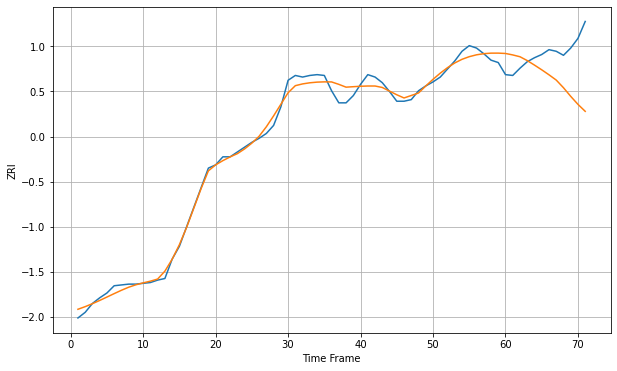

Wall time: 7.77 s
2908 7.880772094891409 48.81661018725339 [1287.2700448  1285.47402246 1283.21389323 1278.44765782 1272.83944732
 1266.98799023 1260.81574054 1254.27378335 1244.76439467 1234.04404457
 1224.11461526 1215.46284916]

Got an mse at 0.0050 in round 220 and stopped training



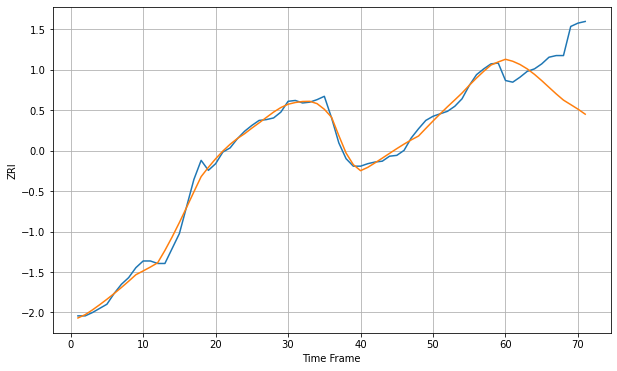

Wall time: 9.36 s
2909 6.841862123113541 57.905368114977314 [1259.52682589 1257.15306716 1253.26948477 1247.95990811 1241.38565414
 1233.85259522 1225.83518473 1217.87893428 1210.42731747 1205.03163414
 1199.57017841 1193.52068406]


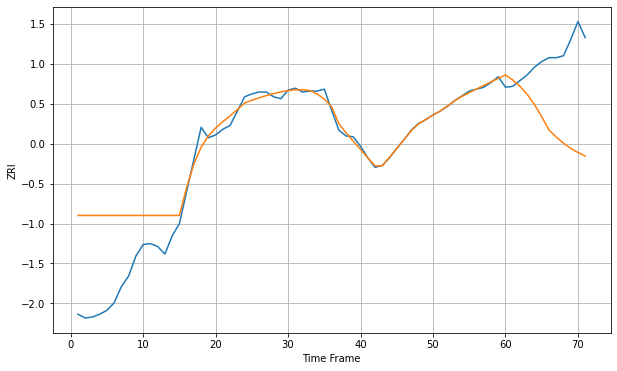

Wall time: 16.6 s
2910 36.86952430154989 78.50301384141949 [1217.9007298  1212.6211903  1205.94031699 1197.47720005 1186.87057592
 1174.12674543 1160.11015656 1152.82409795 1146.33503535 1140.92514599
 1136.50394261 1132.87959145]

Got an mse at 0.0050 in round 187 and stopped training



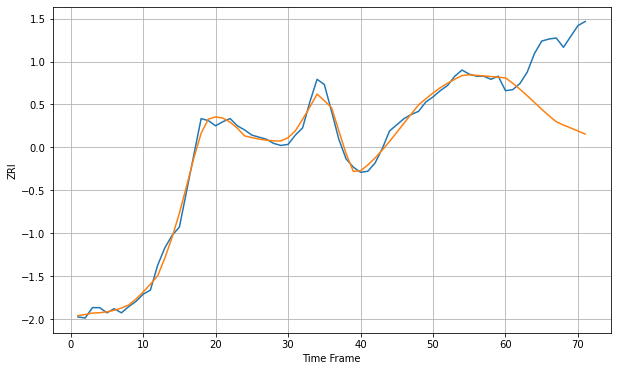

Wall time: 9.2 s
2914 5.844904577411802 67.84605849282556 [1264.39508125 1259.19248085 1253.36575629 1247.11770622 1240.59322167
 1233.98848109 1227.76367495 1221.97106495 1218.67734175 1215.93380963
 1212.94126421 1210.02926585]

Got an mse at 0.0050 in round 378 and stopped training



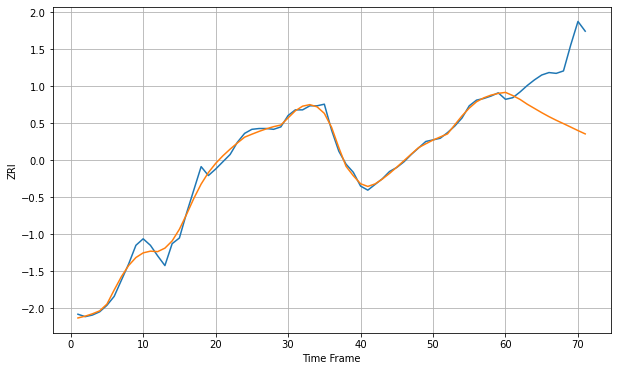

Wall time: 13.1 s
2920 6.4112383960864685 70.11573721431962 [1237.54726526 1233.6577614  1228.92711412 1222.97775276 1217.77435969
 1212.54964428 1207.64653809 1203.16218192 1199.03646717 1194.77421781
 1190.46976796 1186.35544828]

Got an mse at 0.0050 in round 228 and stopped training



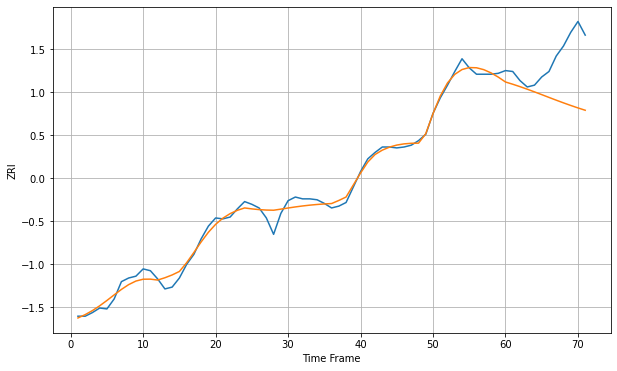

Wall time: 10.3 s
3038 6.671708520214312 50.1749680848535 [1353.46033497 1351.0002943  1348.35252646 1345.54327618 1342.60378827
 1339.57455215 1336.51128819 1333.47752428 1330.52470478 1327.68242238
 1324.96700197 1322.39592088]

Got an mse at 0.0050 in round 157 and stopped training



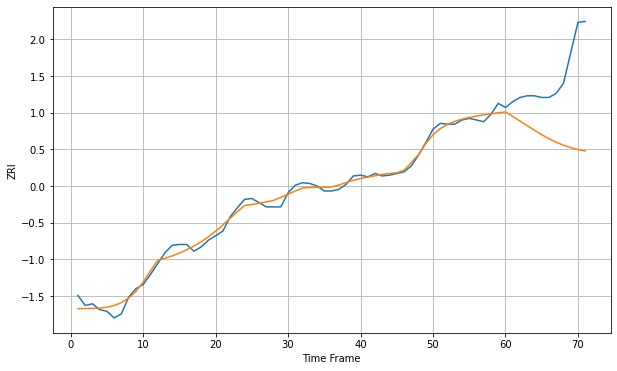

Wall time: 8.51 s
3060 6.176138637313065 80.42781331133486 [1430.74362365 1425.28806058 1419.75992042 1414.21186811 1408.71252722
 1403.4357375  1398.61082788 1394.40122178 1390.8582667  1387.96124544
 1385.66670094 1383.92986218]

Got an mse at 0.0049 in round 62 and stopped training



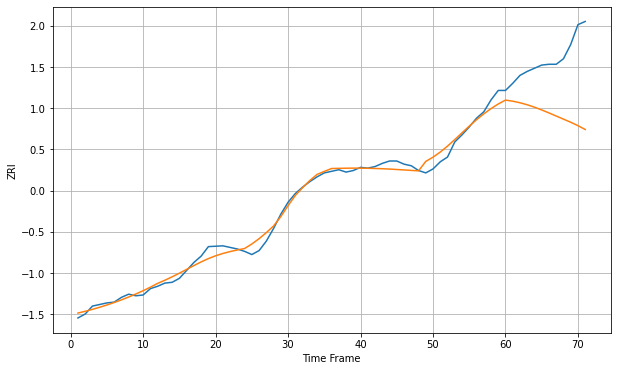

Wall time: 6.18 s
3102 7.17187868912553 75.00589220249609 [1291.82601034 1290.42775766 1288.46175147 1285.92663659 1282.8662497
 1279.38216079 1275.61624012 1271.71346254 1267.78379046 1263.89185505
 1259.57497791 1254.73343158]

Got an mse at 0.0050 in round 88 and stopped training



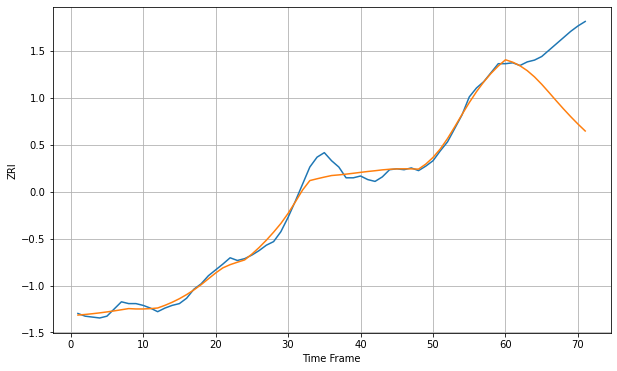

Wall time: 7 s
3103 7.2263731871509895 64.36408651382422 [1284.37571818 1281.67239631 1277.68980874 1272.26535293 1265.32996311
 1257.07334528 1248.01320434 1238.759267   1229.71056065 1221.0367155
 1212.81400159 1205.09934937]

Got an mse at 0.0049 in round 42 and stopped training



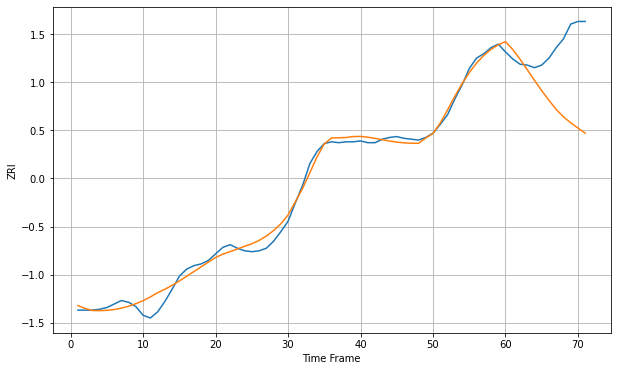

Wall time: 5.8 s
3104 7.572147253043529 71.25119529478081 [1300.84106193 1291.87147508 1280.81392088 1268.74534125 1256.46607731
 1244.63671079 1233.5284499  1223.08021553 1214.58782597 1207.84783778
 1201.76833805 1195.89883445]


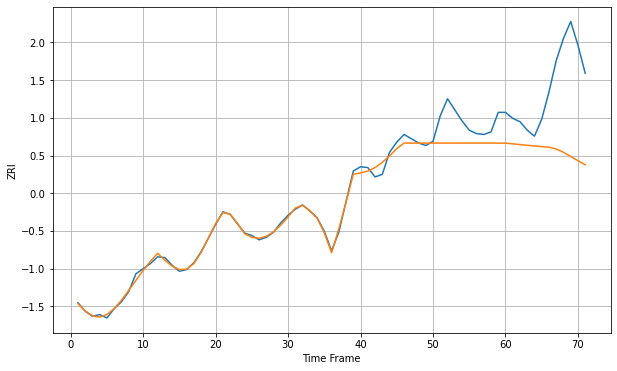

Wall time: 15.8 s
3301 12.159682897719685 87.92794402749635 [1274.77538977 1273.95221918 1273.09650901 1272.23450736 1271.41062858
 1270.66305136 1270.00762316 1267.89110845 1264.03262671 1259.07894395
 1254.10118745 1249.26388963]

Got an mse at 0.0050 in round 75 and stopped training



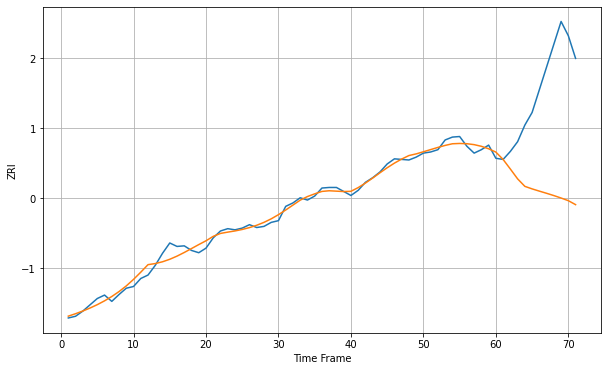

Wall time: 6.72 s
3820 8.616660833781175 188.85817355299017 [1371.78628645 1358.89289571 1342.17760181 1325.0239513  1311.92520369
 1307.52156004 1303.59823961 1299.80035235 1295.83477734 1291.54698099
 1286.90194411 1279.9830677 ]

Got an mse at 0.0050 in round 362 and stopped training



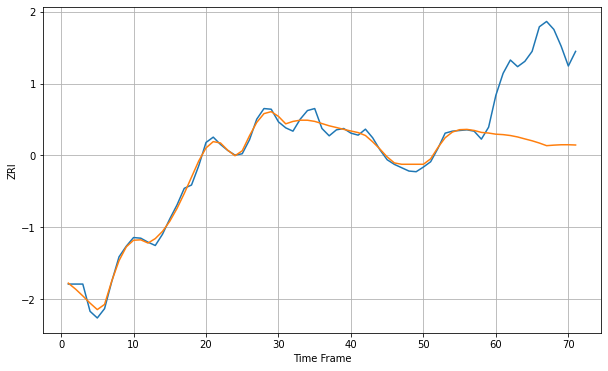

Wall time: 13.1 s
4101 7.57138000921431 135.20500811602517 [1667.43977478 1666.79569191 1665.42744858 1663.27371776 1660.33799046
 1657.51382265 1654.13485807 1650.17176725 1650.97708778 1651.54344213
 1651.579498   1651.17697843]

Got an mse at 0.0050 in round 348 and stopped training



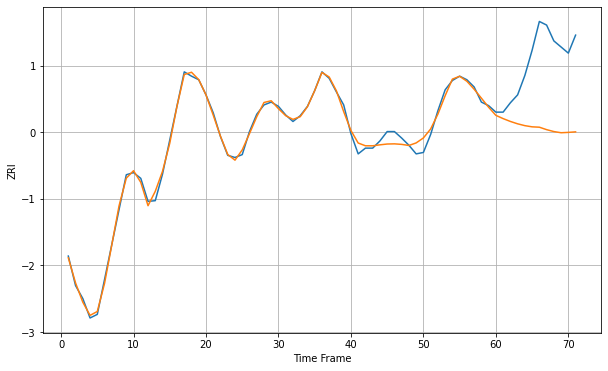

Wall time: 12.6 s
4102 6.506269171836506 100.63695237765977 [1637.54820335 1633.02421056 1629.08067797 1625.78074122 1623.23060327
 1621.59546034 1621.07777199 1617.68334921 1615.02091588 1613.3877506
 1613.86909939 1614.59861174]

Got an mse at 0.0050 in round 326 and stopped training



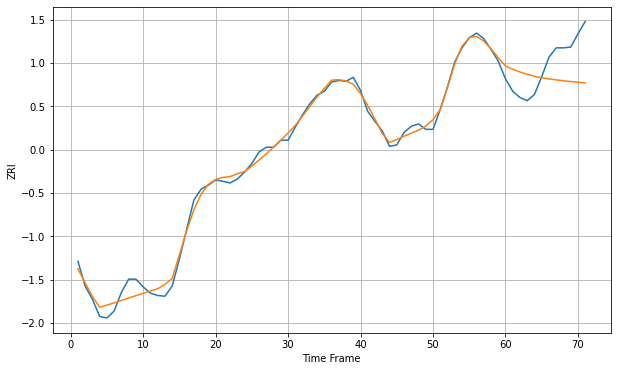

Wall time: 12.5 s
4103 7.835754399682425 41.096951518047845 [1587.66421853 1583.45203643 1579.88175724 1576.8781575  1574.3677406
 1572.46683631 1571.00307416 1569.72954517 1568.61145846 1567.61414322
 1566.70066592 1565.83069367]


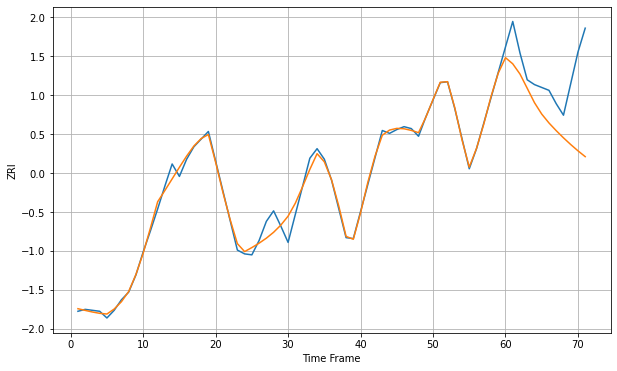

Wall time: 16.2 s
4210 6.599058910429822 57.05301712412768 [1075.13857339 1068.70899306 1058.01043853 1043.12481949 1028.08419864
 1016.17181087 1006.86756341  998.81581425  991.35311127  984.32827358
  977.75715565  971.66533477]


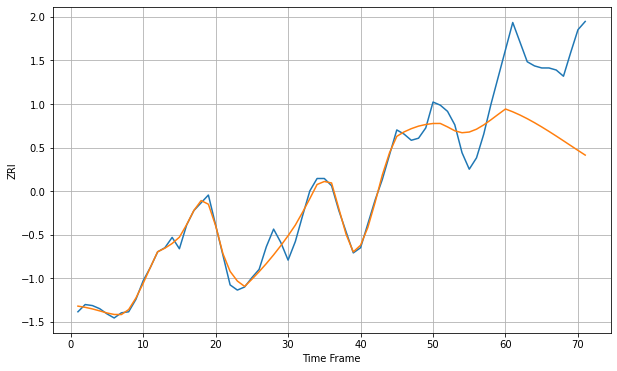

Wall time: 15.8 s
4240 11.527665481061701 79.22600179072032 [1014.28142268 1011.56765891 1008.42289273 1004.893422   1001.03708481
  996.91396616  992.58061468  988.08986442  983.49413492  978.84897665
  974.2147066   969.65528641]

Got an mse at 0.0050 in round 244 and stopped training



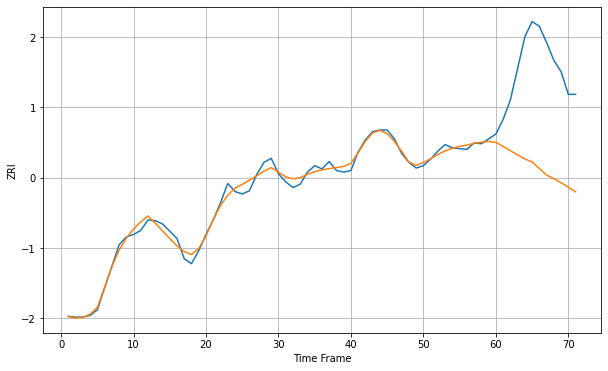

Wall time: 10.5 s
4401 6.1065009555939085 127.38360263265409 [1117.74693624 1112.79336347 1107.46622395 1102.16798713 1097.24854299
 1093.54433416 1085.40008622 1077.35095988 1072.87461431 1067.96008566
 1062.38992458 1056.62398586]


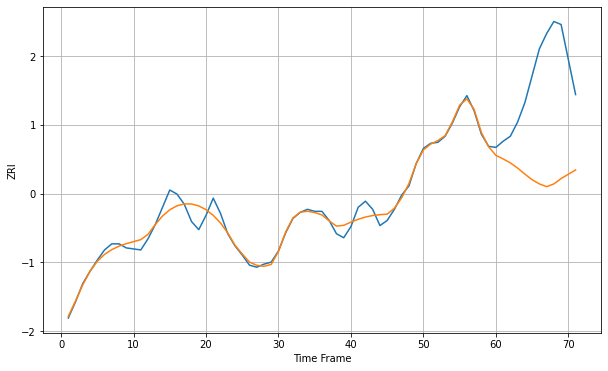

Wall time: 15.9 s
4901 7.093772398741799 102.3920385697049 [864.15994805 860.62954223 856.67710871 851.64629531 845.69707688
 840.12715561 836.03421772 833.33514463 835.98301607 841.29537856
 845.53607266 849.74753853]

Got an mse at 0.0050 in round 356 and stopped training



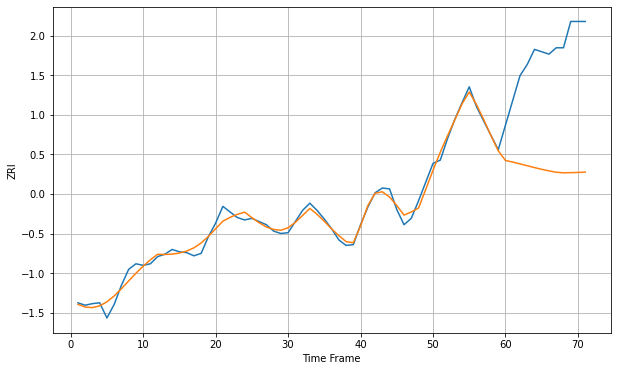

Wall time: 12.6 s
4937 6.963592680026128 146.66428974048065 [971.60023547 969.59399274 967.37055877 965.02118785 962.68315506
 960.49355074 958.54516772 956.87170626 956.11078642 956.32065099
 956.58160406 956.93245917]

Got an mse at 0.0050 in round 344 and stopped training



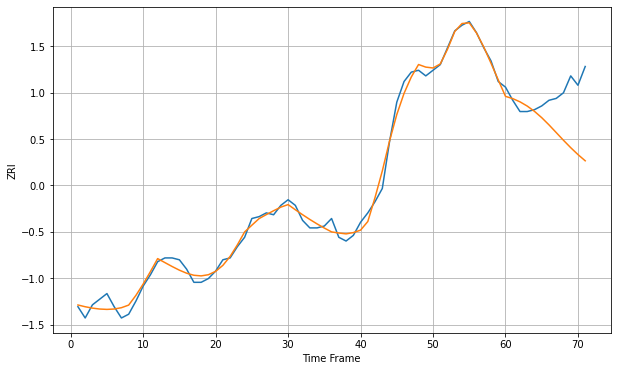

Wall time: 12.7 s
6010 3.488899641230177 23.442279968750622 [1058.08942078 1056.88666481 1055.17270864 1052.91940785 1050.10276999
 1046.73287909 1042.9012758  1038.80227581 1034.69005352 1030.74604288
 1027.07641459 1023.7587748 ]

Got an mse at 0.0050 in round 336 and stopped training



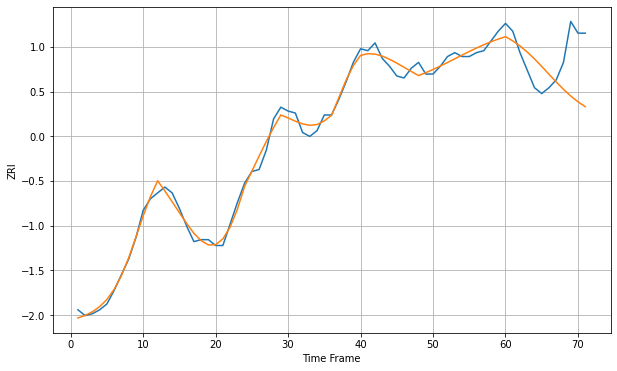

Wall time: 12.4 s
6040 3.2331607762515095 20.30421811235687 [1193.22385269 1191.04126676 1188.41557368 1185.31135617 1181.76810574
 1177.90811439 1173.89481067 1169.94183534 1166.17176124 1162.74390063
 1159.7687516  1157.28950195]

Got an mse at 0.0050 in round 414 and stopped training



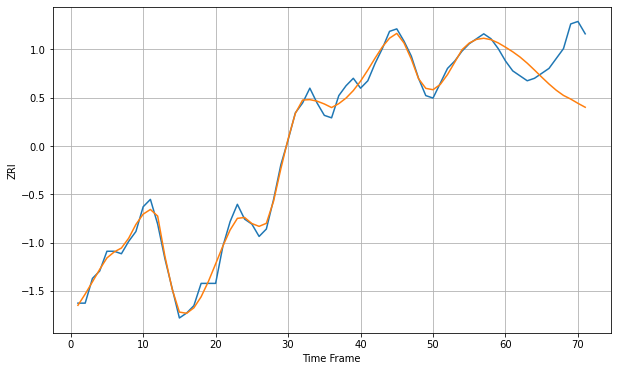

Wall time: 14 s
6051 2.7551759653721253 17.515164749982592 [1106.59215334 1104.72608325 1102.61339709 1100.11535012 1097.33951394
 1094.46646726 1091.69482736 1089.17693944 1087.06825043 1085.59345196
 1083.8669296  1082.27870172]

Got an mse at 0.0050 in round 297 and stopped training



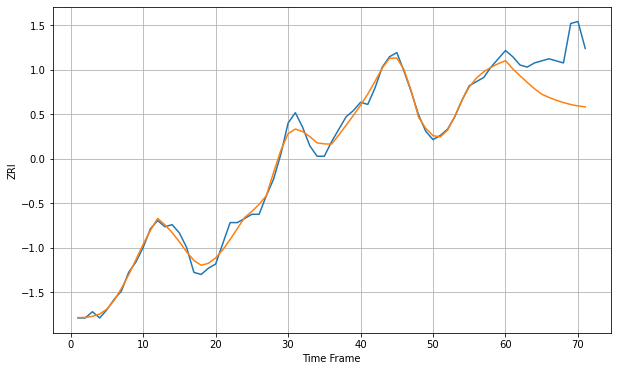

Wall time: 11.7 s
6053 3.0147736032857617 21.615520035275093 [1161.11617158 1157.1695492  1153.81814988 1150.61804365 1147.56038911
 1144.93153456 1143.36850275 1142.00965575 1140.86684547 1139.94645878
 1139.2539359  1138.79762597]

Got an mse at 0.0050 in round 335 and stopped training



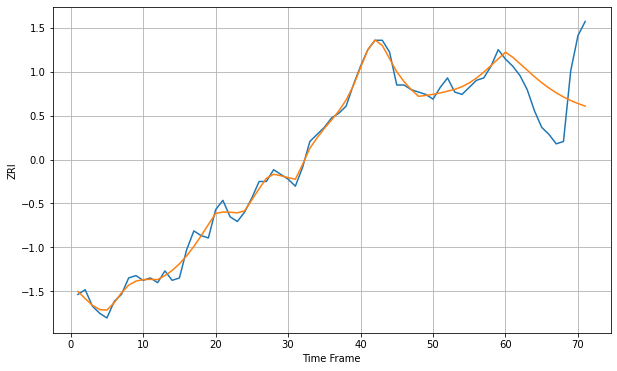

Wall time: 12.3 s
6082 2.628595676089866 18.69002776714912 [1235.93069115 1233.78388359 1231.04912894 1228.28985663 1225.53603397
 1222.97937831 1220.69811862 1218.68618772 1216.92771425 1215.40825127
 1214.11476535 1213.032007  ]

Got an mse at 0.0050 in round 370 and stopped training



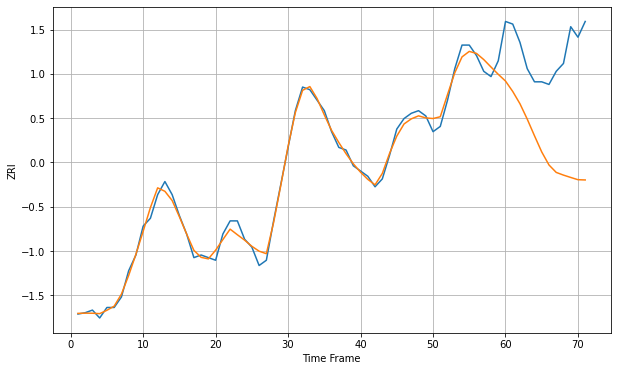

Wall time: 13 s
6106 2.3694972472467195 38.03811414066225 [1106.28857771 1102.31724703 1097.61611092 1091.78368856 1085.4365156
 1079.26927589 1074.31037859 1071.47297964 1070.44704265 1069.55448439
 1068.69718316 1068.59981696]

Got an mse at 0.0050 in round 343 and stopped training



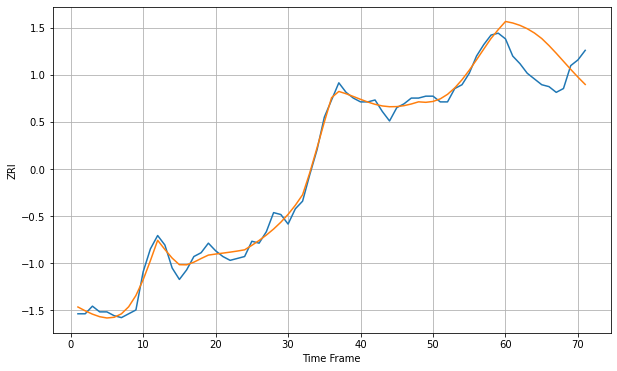

Wall time: 12.7 s
6108 3.478352222226306 18.228313584527292 [1217.13238652 1216.33677319 1215.0848102  1213.33768912 1211.06776089
 1208.19651976 1204.51601732 1200.48532253 1196.26890014 1192.04533868
 1187.97010129 1184.14032295]

Got an mse at 0.0050 in round 466 and stopped training



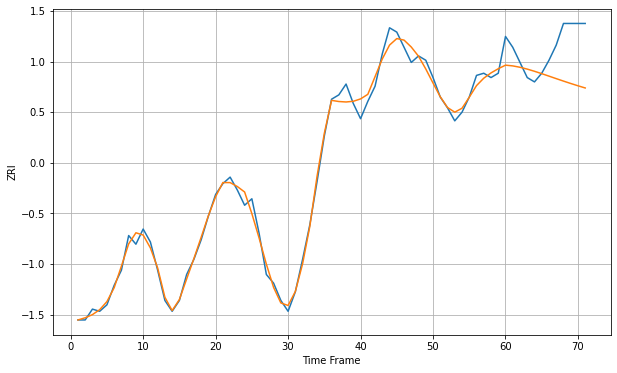

Wall time: 15.2 s
6112 3.295252921717654 17.75712821456319 [1139.73096418 1139.39360215 1138.76193379 1137.90927506 1136.90403624
 1135.80578256 1134.66238343 1133.50967954 1132.37288424 1131.26863317
 1130.20706978 1129.19369707]

Got an mse at 0.0050 in round 251 and stopped training



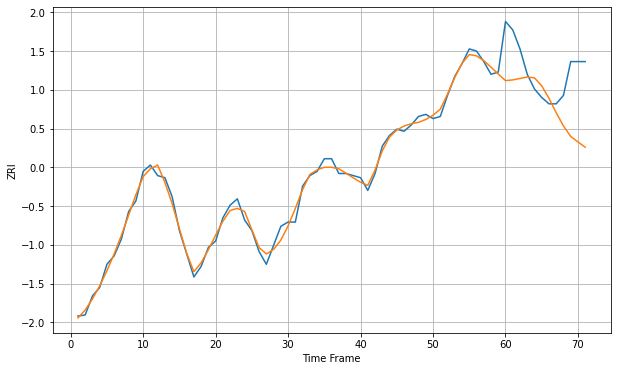

Wall time: 10.7 s
6114 2.569679916153374 22.706762721657327 [1110.98896397 1111.32285734 1111.99564186 1112.70928781 1112.2698862
 1108.50895571 1102.61098864 1095.74171484 1089.50793714 1084.5343304
 1081.93132748 1079.45343801]

Got an mse at 0.0050 in round 440 and stopped training



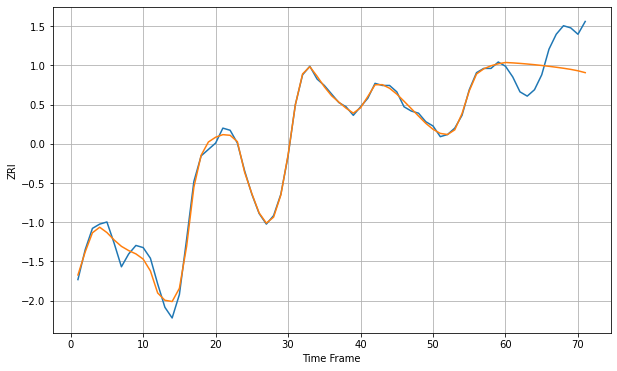

Wall time: 14.7 s
6119 2.5849308382699503 14.594465072356353 [1382.76665069 1382.58095668 1382.34160009 1382.05571681 1381.72976314
 1381.36840481 1380.97338683 1380.5425413  1380.06902772 1379.54062324
 1378.8767097  1378.00562443]


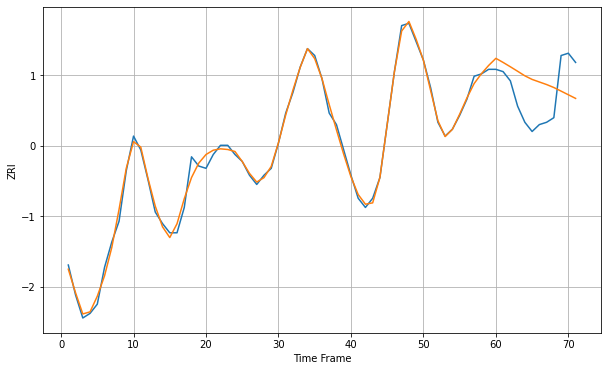

Wall time: 15.8 s
6320 2.2831501031018524 15.320768147573522 [1068.77266017 1066.99717713 1065.10841685 1063.16182739 1061.18384722
 1059.61906766 1058.50465299 1057.39076844 1056.09882548 1054.53093132
 1052.95399652 1051.37492963]

Got an mse at 0.0050 in round 451 and stopped training



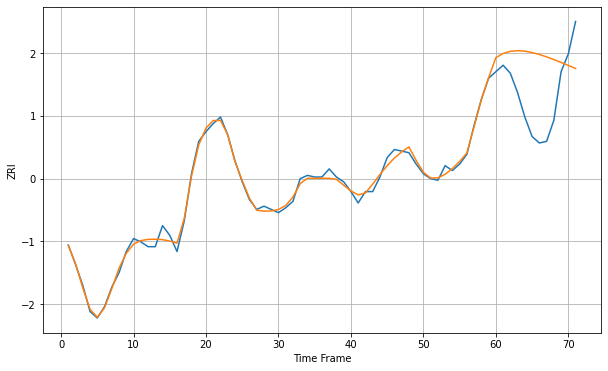

Wall time: 15.1 s
6360 2.72643288896122 33.37145966526833 [1118.69082947 1121.25677863 1122.59073287 1122.97902049 1122.66452873
 1121.83348632 1120.62664271 1119.15200926 1117.49328969 1115.71464226
 1113.86369992 1111.97421985]

Got an mse at 0.0050 in round 318 and stopped training



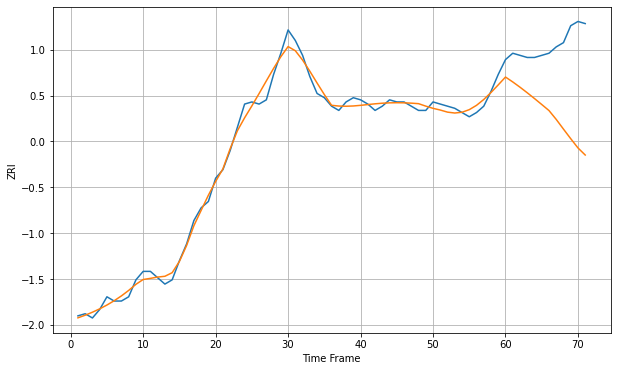

Wall time: 12 s
6401 3.0512034182817893 35.94320976221175 [1226.75489145 1224.45132055 1221.96560293 1219.33991986 1216.60623422
 1213.7960834  1210.94222096 1206.75519161 1202.17360242 1197.6531401
 1193.29412221 1189.94367242]


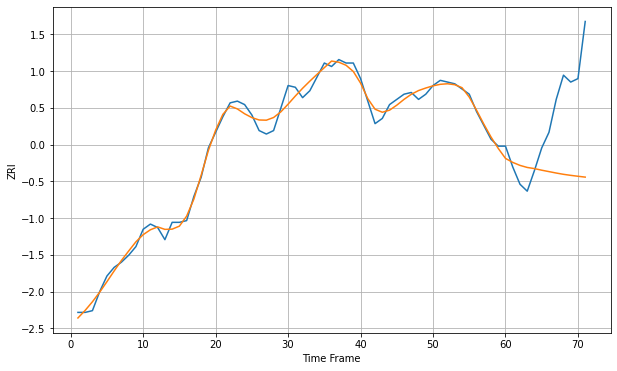

Wall time: 16.4 s
6405 3.684775413362766 41.124508435260275 [1290.91635906 1288.61567924 1286.88587265 1285.69886958 1285.02790866
 1284.10934163 1283.29501366 1282.47226734 1281.73157857 1281.13655098
 1280.6123455  1280.11306881]

Got an mse at 0.0050 in round 182 and stopped training



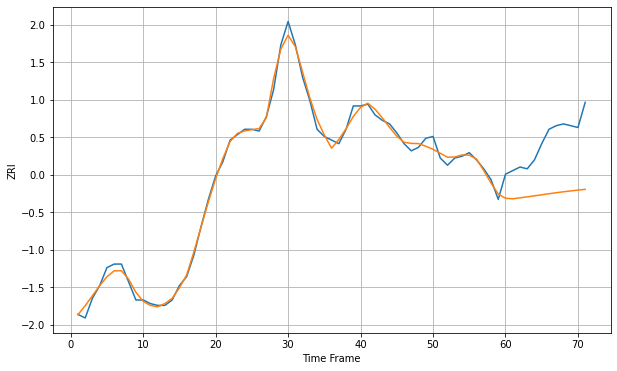

Wall time: 8.97 s
6418 2.919752052927825 30.486305711282526 [1194.60559805 1194.31804555 1194.85256042 1195.41079387 1195.97895394
 1196.55440242 1197.1339733  1197.70088607 1198.22274519 1198.68648992
 1199.18494416 1199.57360107]

Got an mse at 0.0050 in round 355 and stopped training



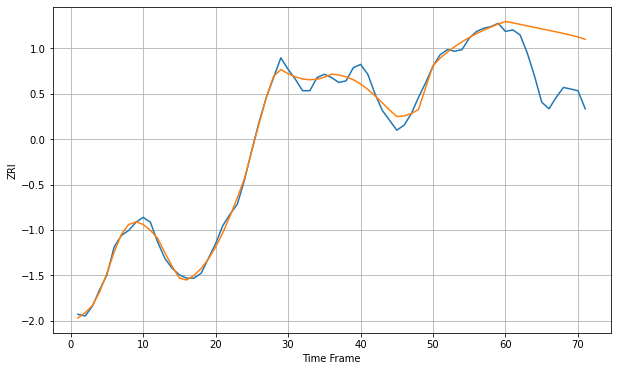

Wall time: 12.7 s
6450 3.887084246467791 31.74451191757521 [1167.10809768 1166.27352506 1165.3562406  1164.42573401 1163.51019123
 1162.6096197  1161.70823549 1160.78443653 1159.81805299 1158.79379978
 1157.70119153 1156.25183455]


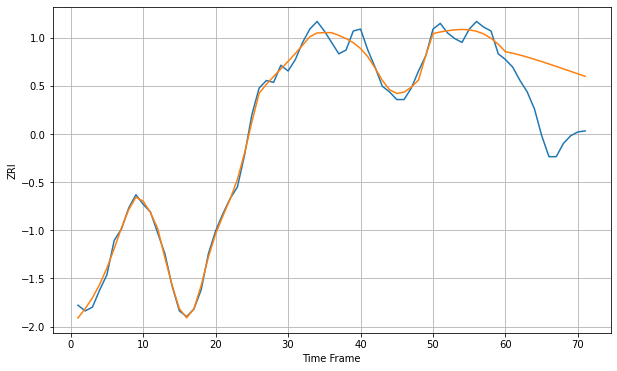

Wall time: 16.2 s
6451 3.7544674037119483 31.389256519955833 [1141.09375144 1140.30674143 1139.36360787 1138.30128056 1137.15118586
 1135.93816405 1134.68152512 1133.39683206 1132.09708023 1130.79259821
 1129.48998283 1128.1910926 ]

Got an mse at 0.0050 in round 472 and stopped training



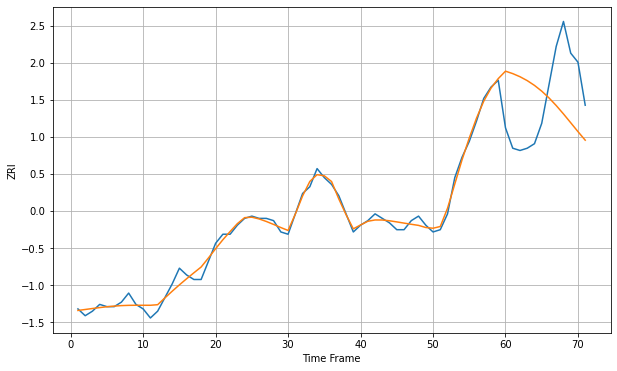

Wall time: 15.7 s
6457 2.3123528446449995 27.45040474875328 [1257.03974049 1255.96001419 1254.58280715 1252.86222154 1250.75133786
 1248.21236756 1245.23391718 1241.84994557 1238.14760146 1234.25606364
 1230.33116285 1226.55097409]

Got an mse at 0.0050 in round 275 and stopped training



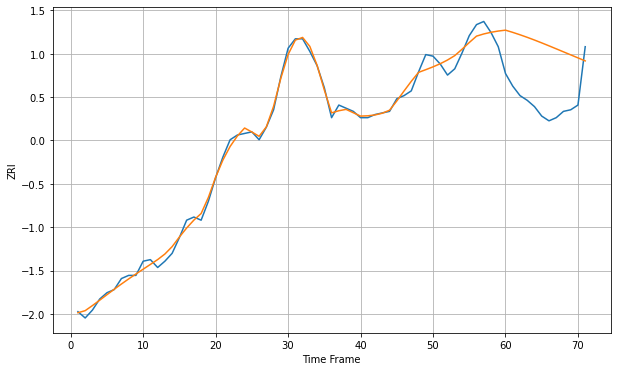

Wall time: 11.1 s
6460 3.8773784205469073 37.32320586925825 [1464.48851816 1463.08210187 1461.5655606  1459.94094426 1458.21837553
 1456.4150862  1454.55296747 1452.6549     1450.74067253 1448.82376943
 1446.91014295 1444.99921308]


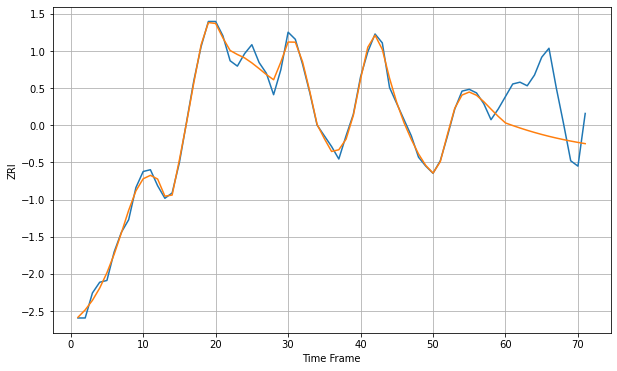

Wall time: 16.1 s
6484 3.2860527069575514 27.144424740260828 [1418.18484421 1416.73168101 1415.35795173 1414.06692328 1412.860247
 1411.73793581 1410.69835205 1409.73833904 1408.85351585 1408.03867633
 1407.2882059  1406.5964437 ]


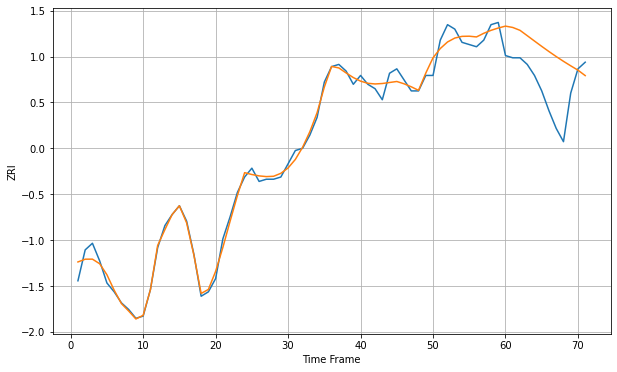

Wall time: 16.1 s
6489 3.2208050525355416 19.65407585190869 [1261.34451733 1260.73858019 1259.44074508 1257.02119244 1254.58247153
 1252.16993877 1249.81985282 1247.55841841 1245.40295326 1243.36412808
 1241.39366612 1238.93083372]

Got an mse at 0.0050 in round 373 and stopped training



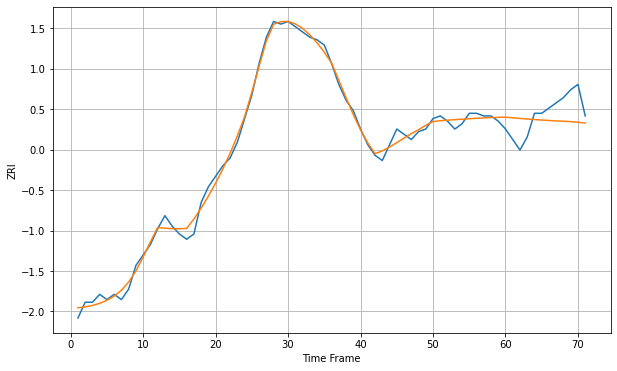

Wall time: 13.2 s
6492 2.171000496607348 8.205744260075315 [1217.53766227 1217.28423183 1217.04646056 1216.8253832  1216.62144038
 1216.43433573 1216.26320667 1216.10692957 1215.96435902 1215.83444774
 1215.58590115 1215.26368916]

Got an mse at 0.0050 in round 273 and stopped training



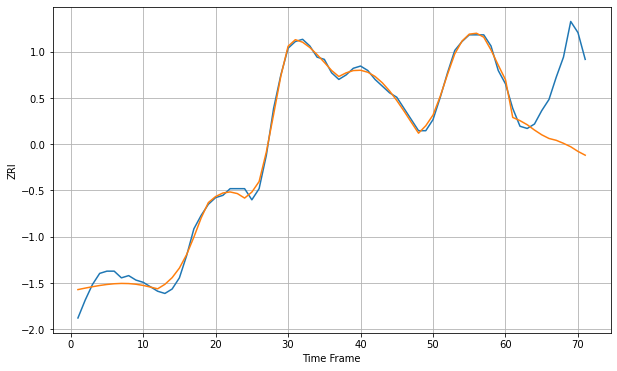

Wall time: 11 s
6511 2.911747077497896 29.721094298671918 [1258.8558174  1241.95605213 1240.50798457 1238.67959769 1236.29246308
 1234.16345545 1232.51683532 1231.69174463 1230.34713849 1228.79604797
 1226.72187127 1225.01225759]

Got an mse at 0.0050 in round 398 and stopped training



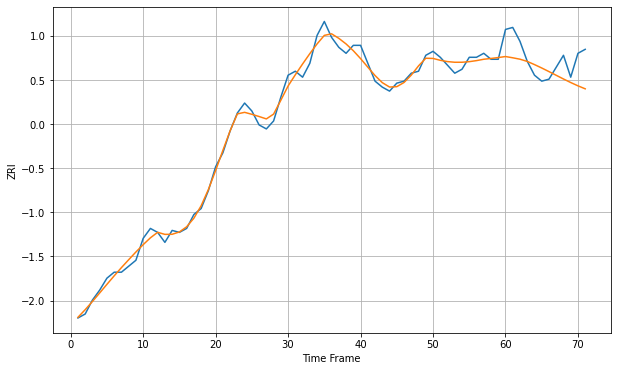

Wall time: 13.9 s
6512 3.1287432820747405 10.846451510294365 [1316.37411978 1315.74903806 1315.03802712 1313.92224331 1312.33179465
 1310.61832021 1308.80765091 1306.94748533 1305.09682035 1303.31518866
 1301.65410608 1300.15224834]

Got an mse at 0.0050 in round 337 and stopped training



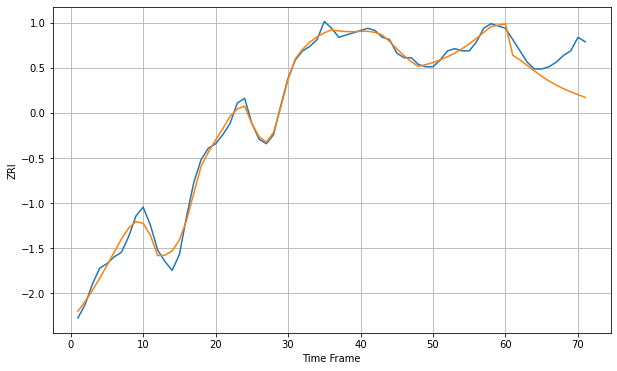

Wall time: 12.6 s
6513 2.8046441720140813 12.943954327605805 [1252.85681711 1239.07980169 1236.98289156 1234.59795843 1232.14474517
 1229.80351628 1227.70217264 1225.87775734 1224.29858852 1222.90806901
 1221.65407805 1220.46074518]

Got an mse at 0.0050 in round 296 and stopped training



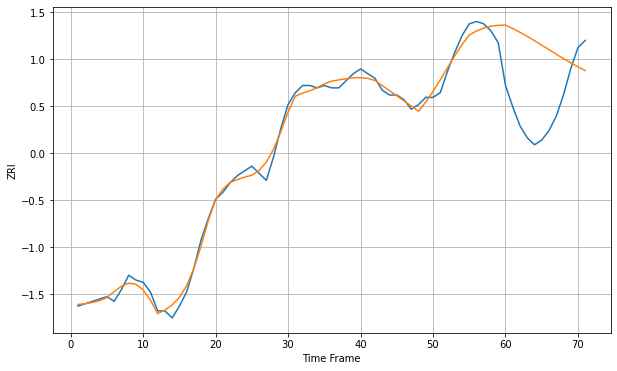

Wall time: 11.5 s
6515 2.7894563597385837 30.226474774959026 [1247.45341321 1246.02064211 1244.42989572 1242.70978461 1240.89186081
 1239.01070562 1237.1028705  1235.2047528  1233.34996082 1231.56695799
 1229.87763361 1228.29702243]

Got an mse at 0.0050 in round 423 and stopped training



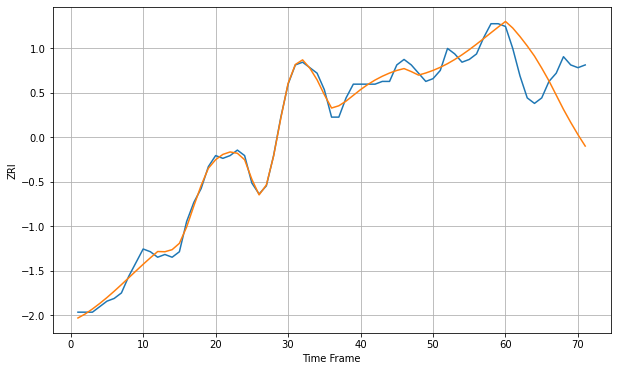

Wall time: 14.4 s
6516 2.283730553450853 16.760304680613352 [1273.82355651 1271.4396476  1268.33342719 1264.91322017 1261.2116361
 1256.85190997 1252.19590867 1247.01802346 1241.8349765  1237.08738798
 1232.61309265 1228.4711735 ]

Got an mse at 0.0050 in round 276 and stopped training



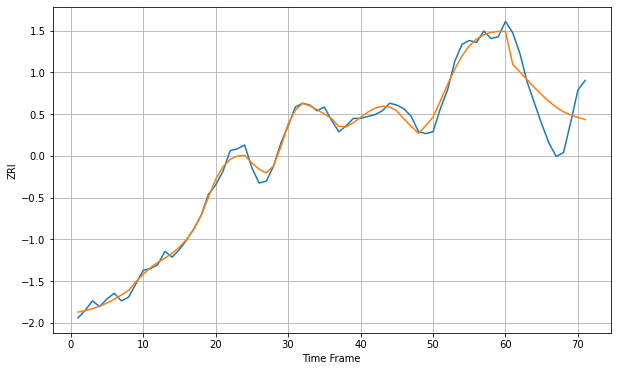

Wall time: 11.1 s
6519 3.096220989306535 15.706527587492 [1288.6903602  1271.43838209 1267.40170597 1263.28192196 1259.23247122
 1255.40203933 1251.89193611 1248.87414286 1246.45683025 1244.8881369
 1243.52739844 1242.37486559]


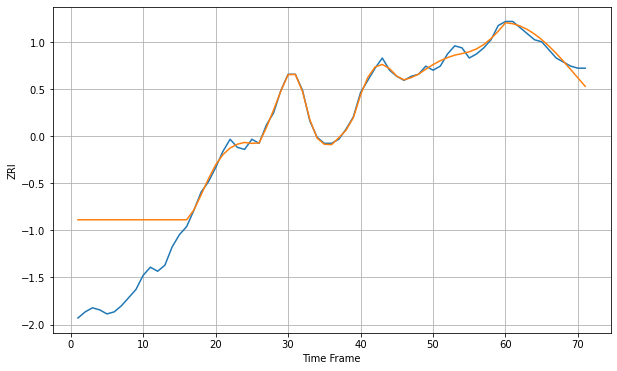

Wall time: 15.9 s
6604 18.27920662064421 3.2998561822595156 [1355.3680842  1354.8990254  1353.79127755 1352.08327499 1349.8211268
 1347.05984795 1343.85878685 1340.28116921 1336.40387618 1332.32705782
 1328.16986707 1324.05248072]

Got an mse at 0.0050 in round 300 and stopped training



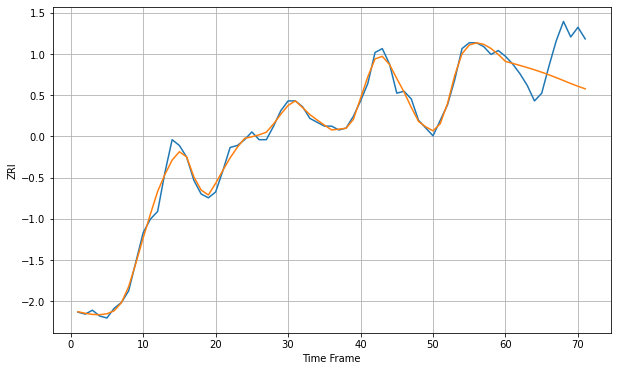

Wall time: 11.6 s
6605 2.9822069820357533 18.16929784601099 [1406.37737834 1405.36222985 1404.31342933 1403.21714311 1402.05513952
 1400.80712947 1399.45963144 1398.01770185 1396.51304707 1395.00246316
 1393.55657807 1392.2460158 ]

Got an mse at 0.0050 in round 253 and stopped training



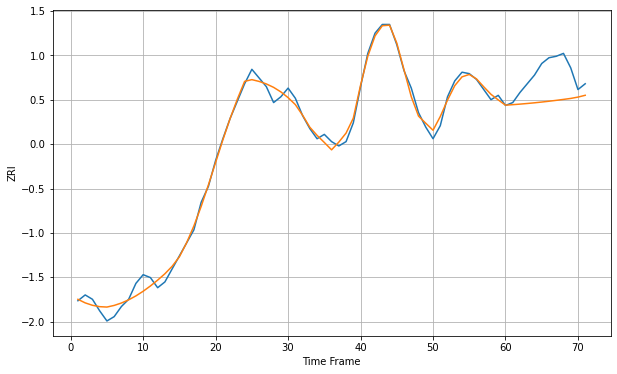

Wall time: 10.5 s
6606 4.3143177851043735 19.81579491447844 [1411.1987516  1411.54652952 1411.9344419  1412.36449952 1412.83884339
 1413.35910181 1413.92551206 1414.53597643 1415.18529131 1415.86479559
 1416.78467165 1418.03976017]

Got an mse at 0.0050 in round 263 and stopped training



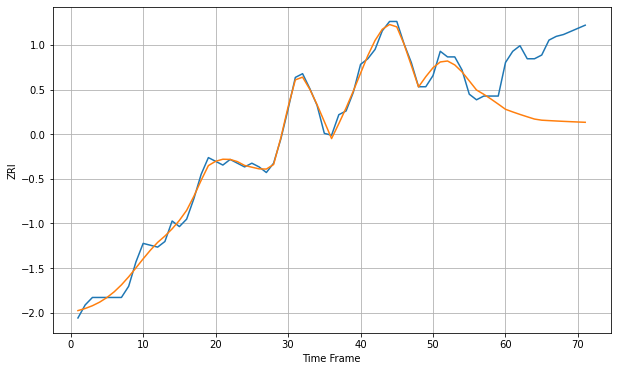

Wall time: 10.7 s
6607 3.3742468286232135 40.77133677772377 [1301.90509885 1300.48292188 1299.14600428 1297.88673386 1296.66565196
 1296.06119181 1295.83780546 1295.63018448 1295.43765266 1295.2586124
 1295.09110631 1294.93314676]

Got an mse at 0.0050 in round 321 and stopped training



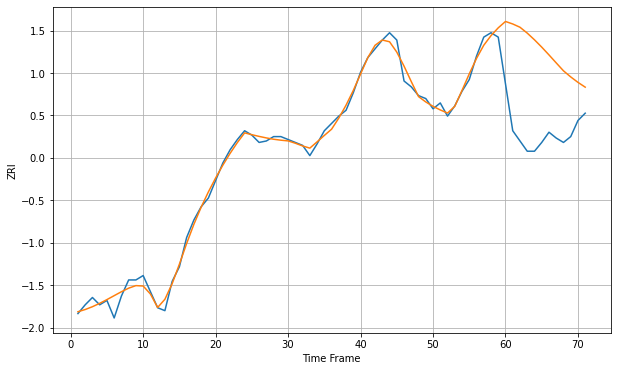

Wall time: 12.1 s
6608 4.081190249845349 57.917154928855034 [1383.70692113 1381.98772335 1379.75330043 1375.74566498 1371.156867
 1366.15655891 1360.84325261 1355.37402779 1349.96736296 1345.80196504
 1342.07545623 1338.79766745]

Got an mse at 0.0050 in round 145 and stopped training



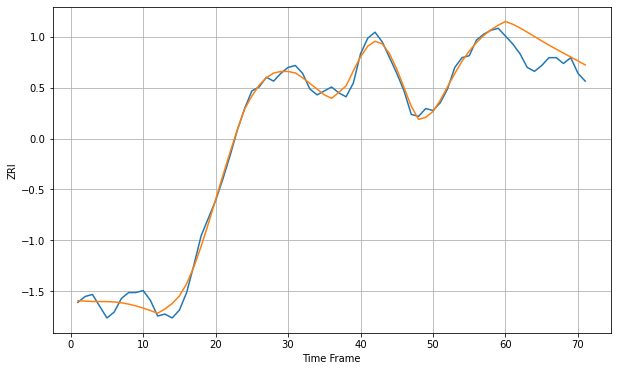

Wall time: 8.1 s
6610 3.654392735658658 10.51426596674552 [1335.48984175 1334.07082938 1332.17182821 1330.01871314 1327.77849681
 1325.55602897 1323.40355166 1321.33309297 1319.32670627 1317.34635059
 1315.34564178 1313.28469319]


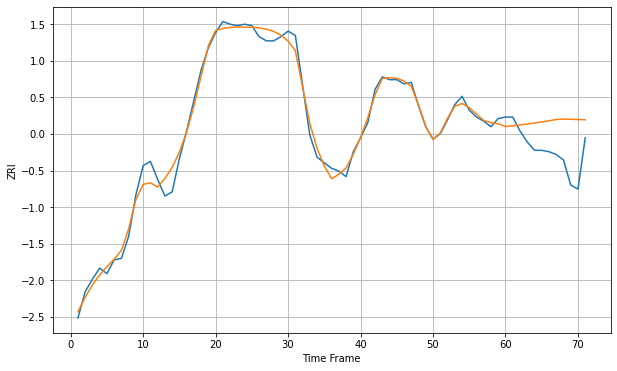

Wall time: 16.1 s
6614 5.622304930990432 25.87450021340814 [1477.13005685 1477.68213893 1478.33621368 1478.99438287 1479.71572373
 1480.50223166 1481.3394866  1482.21498614 1482.57721289 1482.41156215
 1482.22753471 1482.02829494]

Got an mse at 0.0049 in round 171 and stopped training



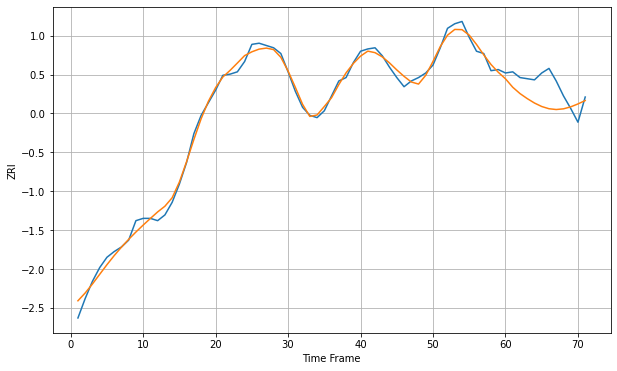

Wall time: 8.64 s
6615 4.73992792728417 18.773691278863353 [1464.90913671 1457.53428714 1452.01218111 1447.61901629 1443.74863317
 1440.71403722 1438.77040753 1438.08105426 1438.68519311 1440.42448126
 1442.97122642 1445.93075989]

Got an mse at 0.0050 in round 368 and stopped training



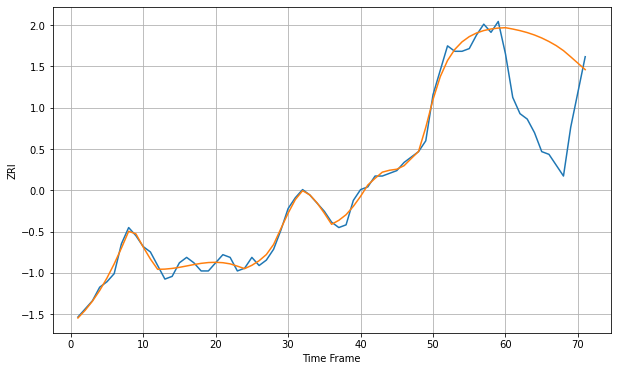

Wall time: 13.1 s
6704 2.143366643449542 32.09415483734764 [986.7030001  986.20831329 985.62056011 984.90006522 984.00722566
 982.9135895  981.60642193 980.08963884 978.24415161 975.95718219
 973.60015301 971.24004502]

Got an mse at 0.0049 in round 317 and stopped training



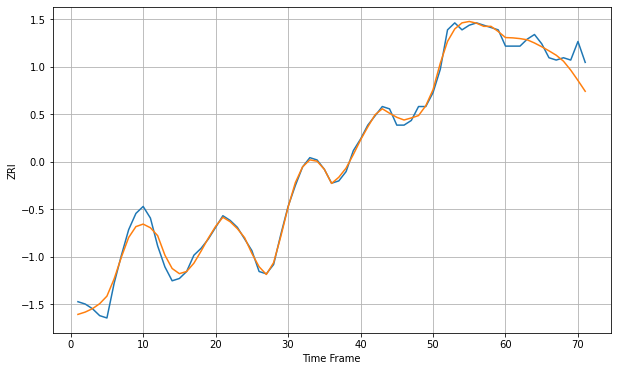

Wall time: 11.9 s
6705 2.8509837875465514 6.595062590044116 [1009.68488318 1009.55239378 1009.23574385 1008.71673947 1007.34887126
 1005.73557575 1003.97376272 1002.08362043  999.52333154  995.67792357
  991.22294279  986.56033462]

Got an mse at 0.0050 in round 297 and stopped training



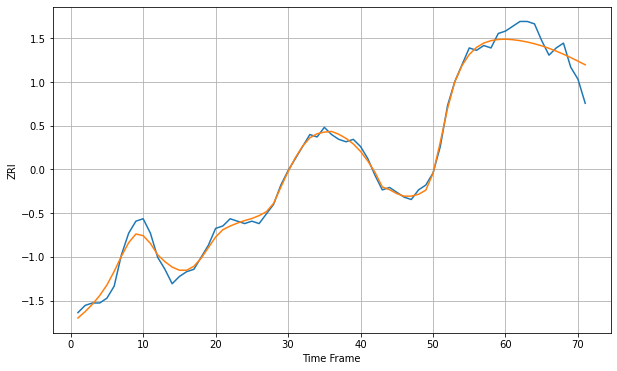

Wall time: 11.6 s
6708 2.5350256366209627 7.136036203572123 [1010.6426792  1010.42392519 1010.02595431 1009.4609555  1008.73741429
 1007.86159675 1006.83945098 1005.67877692 1004.39163883 1002.99659667
 1001.51978429  999.99384622]

Got an mse at 0.0050 in round 404 and stopped training



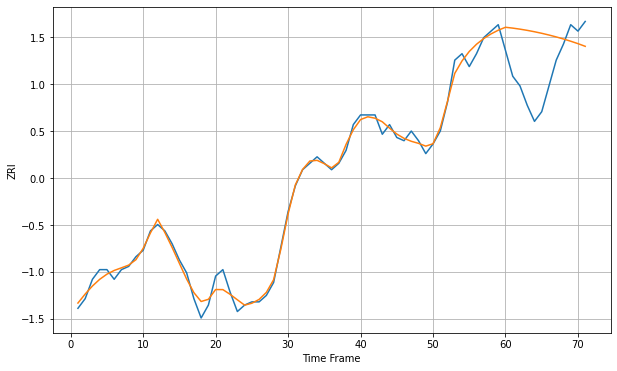

Wall time: 13.9 s
6710 2.0479868389787144 15.532718534807508 [923.20079586 922.93628439 922.61533153 922.23949712 921.8100211
 921.32771245 920.79286424 920.20523109 919.5641165  918.86862269
 918.11810798 917.2893194 ]

Got an mse at 0.0050 in round 325 and stopped training



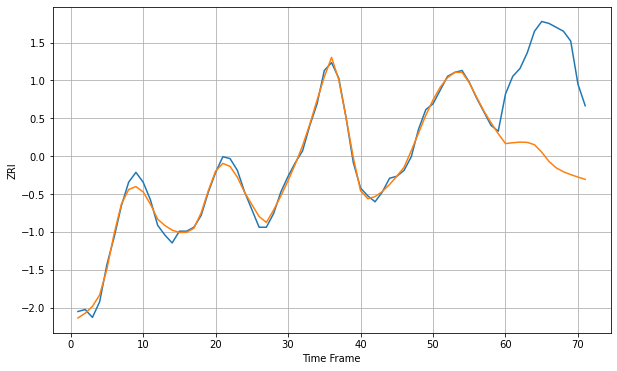

Wall time: 12.1 s
6770 2.7058132456223682 55.24840274732844 [1105.68018624 1106.124209   1106.436441   1106.31402711 1105.11310316
 1101.2983755  1096.58513241 1093.30779615 1091.30236603 1089.84787431
 1088.59398611 1087.43508961]


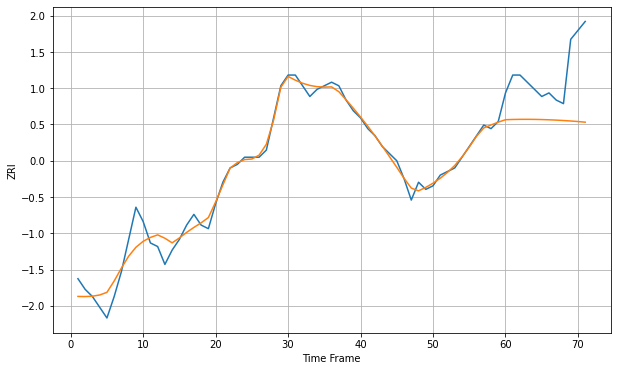

Wall time: 16 s
6790 2.7246003300385455 14.89931493096351 [864.50215159 864.56617842 864.60047607 864.60688569 864.58720549
 864.54297079 864.47535556 864.38521084 864.27321404 864.14008075
 863.98678769 863.80717341]


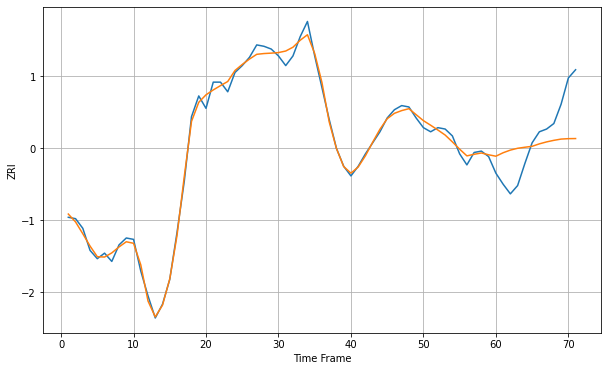

Wall time: 16.1 s
6810 3.970360279281346 25.708882917872877 [1648.30572439 1650.8038539  1652.72899361 1654.04541037 1654.80094915
 1655.46213375 1657.24774328 1658.67149151 1659.80905602 1660.71401046
 1661.02178875 1661.09689001]


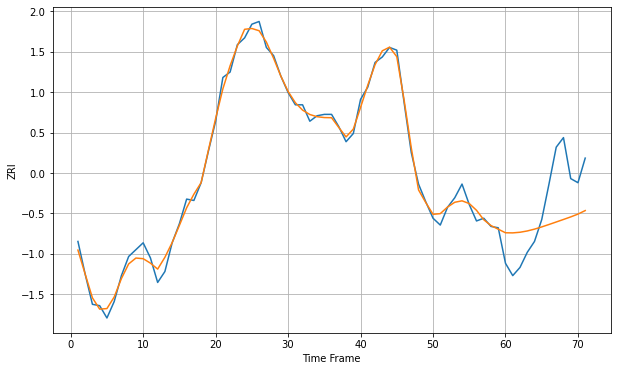

Wall time: 16.1 s
6824 4.7353005750679396 32.59127400902617 [1834.35267404 1834.27719882 1834.73212963 1835.6732134  1837.01729389
 1838.6400636  1840.4115909  1842.24227882 1844.09589283 1845.97117593
 1848.02428332 1850.59852475]


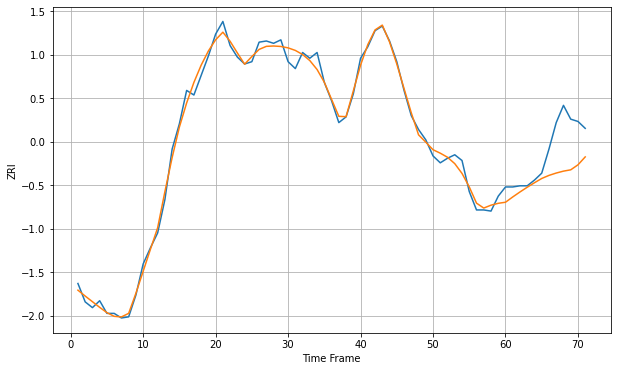

Wall time: 16 s
6825 5.897625583734076 28.902066324893834 [1630.70324415 1635.3133765  1639.65542263 1643.77161853 1647.68477768
 1651.3828362  1654.06441987 1656.10466012 1657.76848213 1658.90493902
 1663.25236227 1670.15259907]


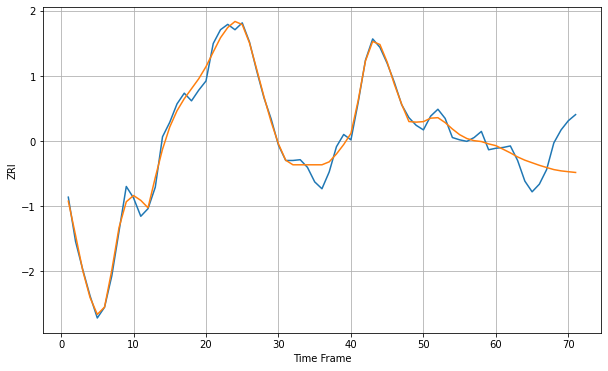

Wall time: 16 s
6830 9.857559729388859 37.85987996661176 [2316.38839713 2311.68402704 2306.94217464 2301.6133029  2297.38466736
 2294.01952462 2290.68225841 2287.80610734 2285.08158557 2283.3845449
 2282.31938302 2281.31932444]

Got an mse at 0.0050 in round 264 and stopped training



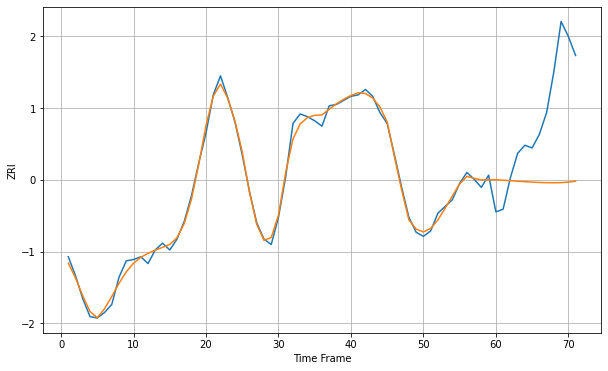

Wall time: 10.8 s
6851 3.693596441728406 62.85487607483441 [1814.7205849  1814.298728   1813.90512103 1813.53795852 1813.19870931
 1812.89456437 1812.64102002 1812.46474664 1812.40657024 1812.52322831
 1812.88376585 1813.55224707]

Got an mse at 0.0050 in round 282 and stopped training



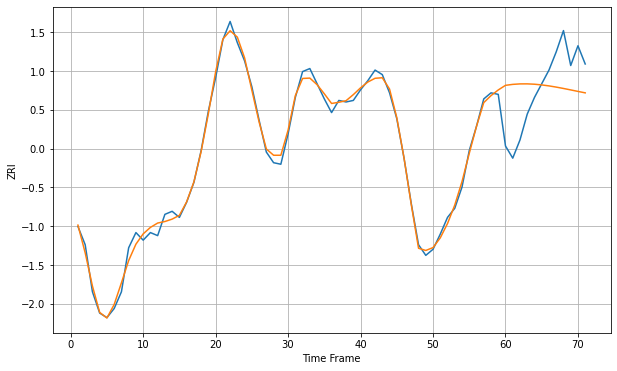

Wall time: 11.1 s
6854 3.5836847487317116 28.005966346996214 [1837.94539646 1838.57927103 1838.89088855 1838.91379415 1838.67963914
 1838.22178813 1837.57676982 1836.78436781 1835.88683247 1834.92746432
 1833.94876295 1832.99040137]

Got an mse at 0.0050 in round 453 and stopped training



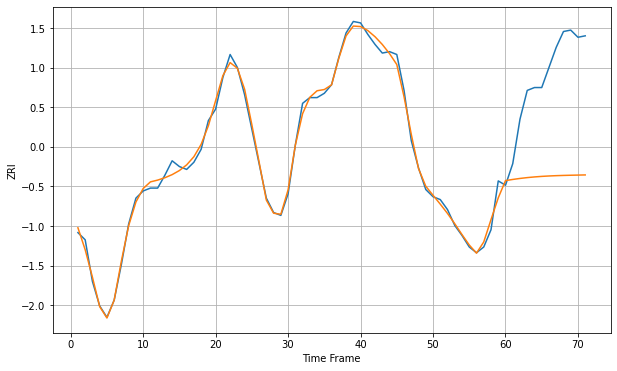

Wall time: 15 s
6855 3.8737121356369575 74.01684886103217 [1801.21493465 1802.01738951 1802.71620365 1803.29940998 1803.77144643
 1804.14436333 1804.43292857 1804.65252443 1804.81874008 1804.94772439
 1805.05666309 1805.16394013]


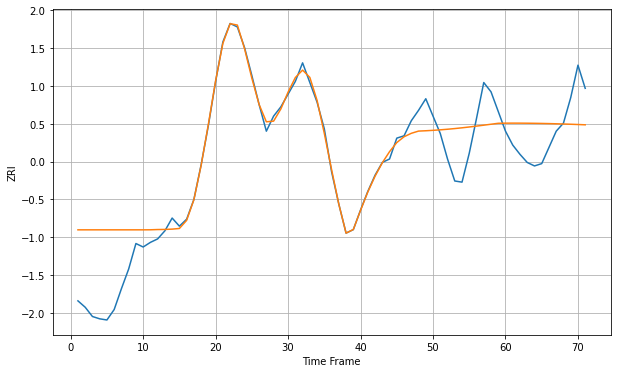

Wall time: 16.1 s
6902 27.37344251963516 28.059351595142402 [2108.91786809 2108.941708   2108.9279718  2108.87927145 2108.79824805
 2108.68744723 2108.54919971 2108.3855334  2108.19812357 2107.98827667
 2107.75693967 2107.50472585]

Got an mse at 0.0050 in round 347 and stopped training



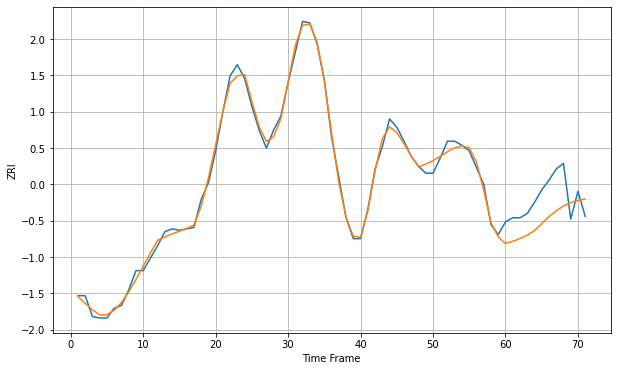

Wall time: 12.7 s
6906 3.6742436963405556 20.092052065480974 [1900.49460162 1902.08568037 1904.05840068 1906.44041459 1909.82685892
 1914.75399089 1919.81598616 1923.99353276 1927.46621632 1929.8166112
 1931.37760053 1932.48228113]

Got an mse at 0.0050 in round 61 and stopped training



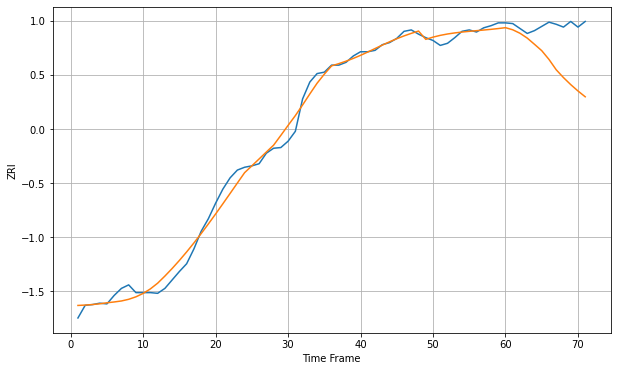

Wall time: 6.23 s
7002 10.76347354965949 58.866689449361836 [1827.18625101 1824.19088837 1819.2476016  1812.40006138 1803.57814608
 1794.5432962  1782.10015336 1767.39947406 1756.33081642 1746.35266318
 1737.31370142 1729.0558668 ]

Got an mse at 0.0049 in round 119 and stopped training



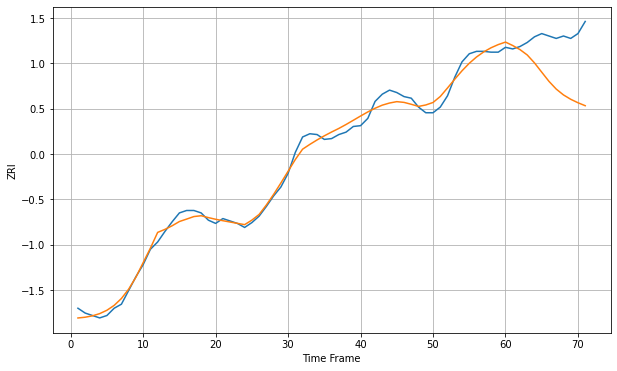

Wall time: 7.49 s
7003 7.826886961851975 57.67877078953382 [1653.46568891 1649.19941584 1644.16757131 1637.52364235 1627.70574909
 1616.23050614 1604.85421683 1595.30292898 1588.07209709 1582.66526149
 1578.38433337 1574.70962304]

Got an mse at 0.0050 in round 372 and stopped training



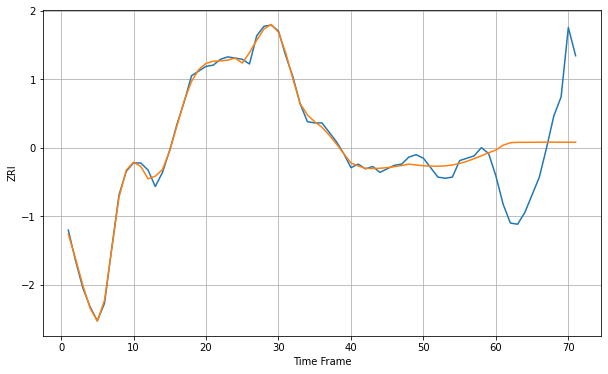

Wall time: 13.2 s
7030 4.077298249282831 54.56982727043207 [2522.93083846 2527.02663252 2529.17225168 2529.49409459 2529.51403753
 2529.53550857 2529.58292808 2529.67519093 2529.65431214 2529.59762636
 2529.57970045 2529.60547842]

Got an mse at 0.0050 in round 174 and stopped training



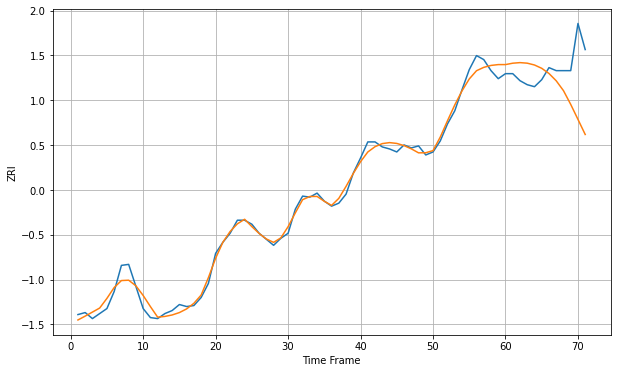

Wall time: 8.77 s
7055 6.288811281222456 40.33388022958496 [1745.03940043 1746.4107515  1746.99479041 1746.44552523 1744.63015579
 1741.31352975 1736.1677557  1728.8793745  1719.07169806 1705.36097338
 1690.44692694 1675.40311849]

Got an mse at 0.0049 in round 198 and stopped training



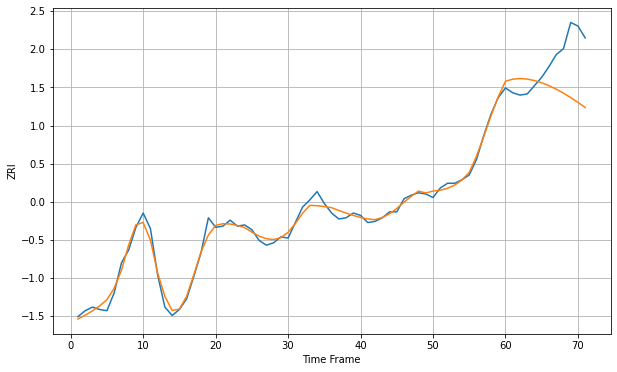

Wall time: 9.28 s
7093 4.440761206027293 34.81779495711106 [1993.67101121 1995.39250136 1995.91568946 1995.46206899 1994.22177619
 1992.3403476  1989.91552044 1987.00723132 1983.65924127 1979.92391435
 1975.87277353 1971.58429813]

Got an mse at 0.0050 in round 76 and stopped training



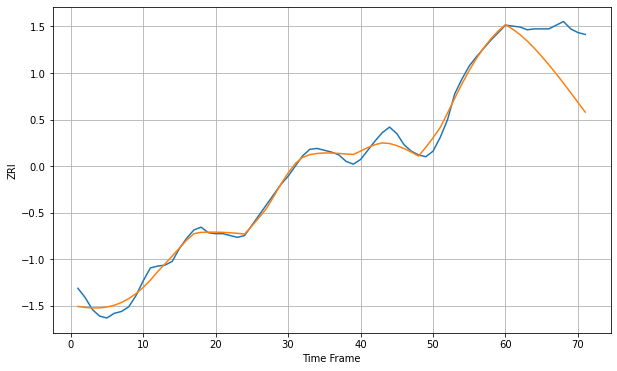

Wall time: 6.56 s
7109 7.0535569084416165 48.05184543666764 [1619.57137804 1614.6766065  1608.83058552 1601.90402345 1593.92605145
 1585.27956098 1576.11210277 1566.49789654 1556.47086597 1546.10523274
 1535.58042054 1525.17606558]

Got an mse at 0.0048 in round 55 and stopped training



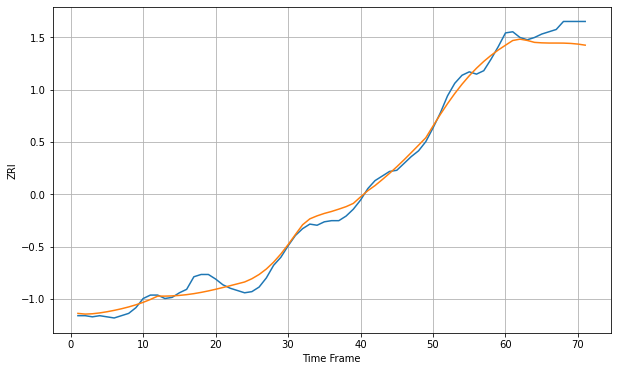

Wall time: 6.11 s
7111 6.1924585963912575 13.022448078371454 [1432.26591756 1436.36391341 1437.55699434 1436.43059152 1434.74136825
 1434.32706686 1434.14957157 1434.14133357 1434.09274361 1433.82313102
 1433.23399966 1432.30041456]

Got an mse at 0.0050 in round 85 and stopped training



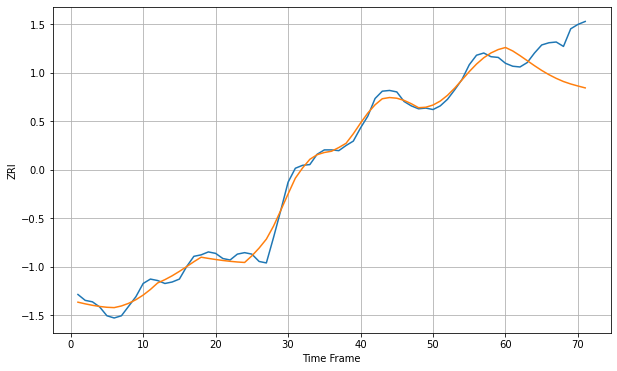

Wall time: 6.74 s
7201 9.303395258812667 50.14424213853204 [1761.54208328 1756.81589959 1750.44550147 1743.5992148  1736.7353777
 1730.26964    1724.48105088 1719.46640688 1715.16758165 1711.82218671
 1709.06144489 1706.48153771]

Got an mse at 0.0050 in round 171 and stopped training



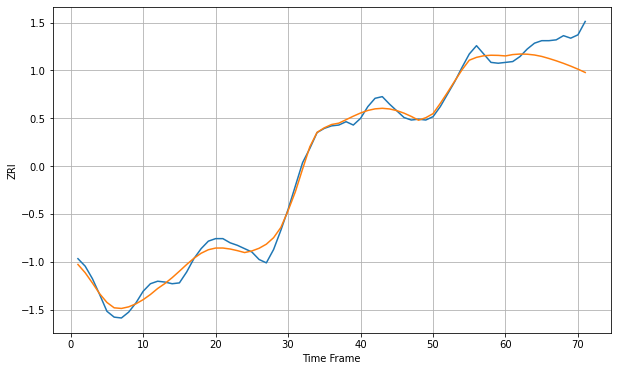

Wall time: 8.74 s
7202 8.050286687174694 28.069614826629294 [1701.73801784 1703.36243584 1704.01045216 1703.78857711 1702.8561343
 1701.14471258 1698.66271667 1695.90269795 1692.86506856 1689.53447747
 1685.89393918 1681.93373008]

Got an mse at 0.0050 in round 73 and stopped training



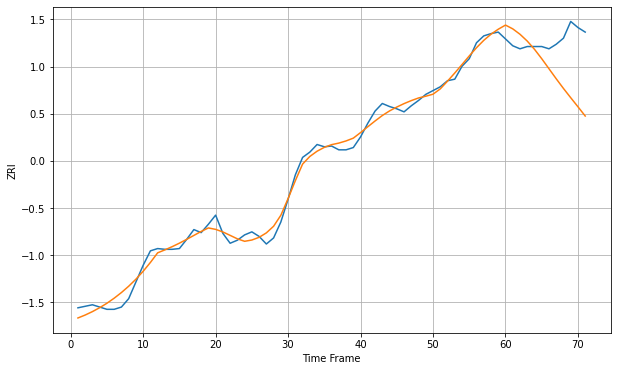

Wall time: 6.48 s
7206 8.73259928838174 59.04010869815774 [1739.23274375 1734.27810197 1727.15233014 1718.19517974 1707.35333274
 1694.96058838 1681.75151806 1668.53465652 1655.7811919  1643.61651852
 1631.66569879 1619.51279436]

Got an mse at 0.0050 in round 232 and stopped training



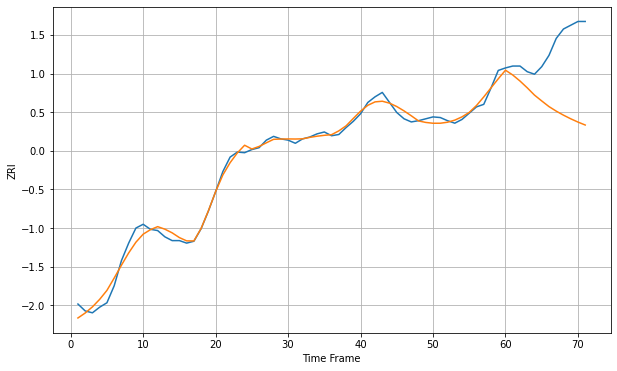

Wall time: 10.1 s
7302 8.641349302133161 99.78695410452909 [2507.36630295 2499.74141844 2490.14924203 2479.33155071 2467.72284928
 2458.42798091 2449.43054929 2442.20056742 2435.79221536 2429.99834656
 2424.7799809  2420.08027907]

Got an mse at 0.0050 in round 177 and stopped training



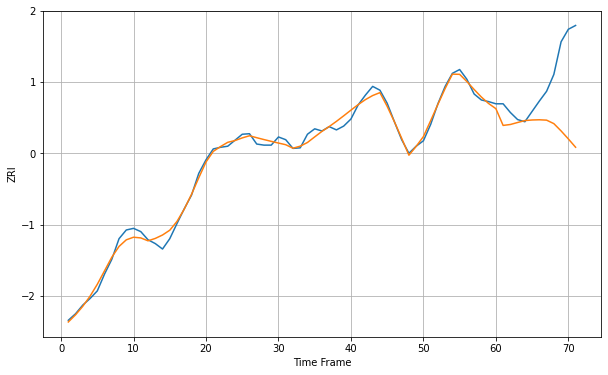

Wall time: 8.87 s
7960 9.187094587540315 104.97903596673832 [2212.04720156 2181.22956318 2182.95572309 2186.61062417 2190.13486283
 2191.22158357 2191.61000323 2190.91796814 2184.53289526 2171.0904149
 2156.41757266 2141.10197419]

Got an mse at 0.0050 in round 321 and stopped training



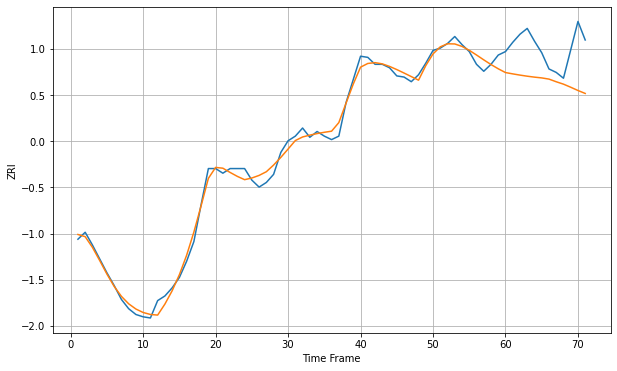

Wall time: 12.1 s
8901 5.600138674782059 32.08011389234876 [1727.88573911 1726.74737049 1725.68941511 1724.7448061  1723.93411478
 1723.2680546  1722.23753915 1719.94406172 1717.87476343 1715.21211946
 1712.39824707 1709.85074186]

Got an mse at 0.0050 in round 473 and stopped training



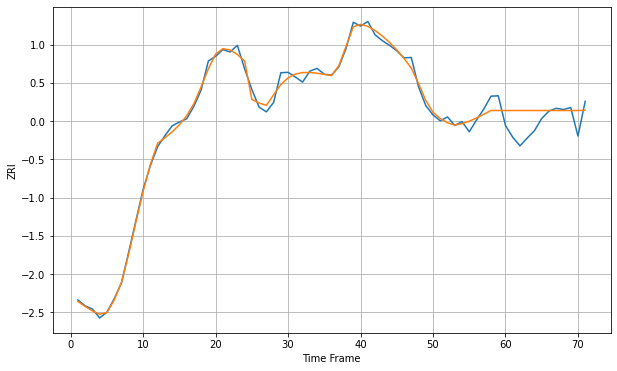

Wall time: 15.4 s
10001 13.777592369692108 47.622628824412274 [3693.35481319 3693.35481319 3693.35481319 3693.35481319 3693.35481319
 3693.35481319 3693.35481319 3693.35481319 3693.35481319 3693.35481319
 3693.35481319 3693.85530909]


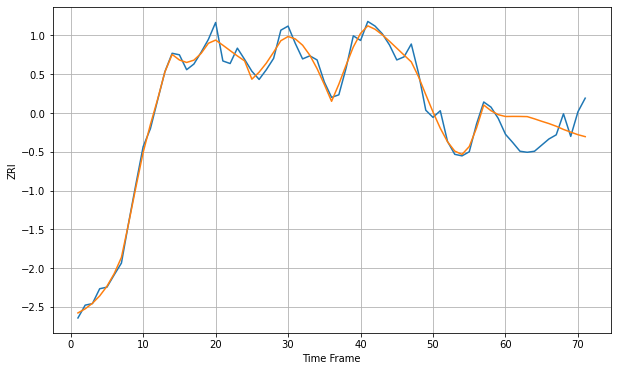

Wall time: 16.1 s
10002 14.554785917059851 49.316788850591436 [3475.72523398 3475.92579896 3475.84959515 3475.53430323 3471.1692076
 3466.39295952 3461.9345903  3456.73028312 3450.51265073 3445.32108026
 3440.25466372 3436.47746555]


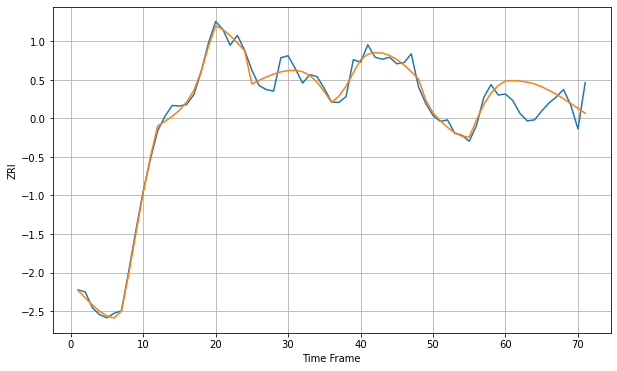

Wall time: 16.1 s
10003 14.255572891256582 47.251995678027754 [3689.47080836 3690.08032046 3689.1161931  3686.90811352 3683.40903919
 3677.56816754 3670.51261177 3662.50928374 3653.63941598 3644.1612151
 3634.37260372 3624.07983753]

Got an mse at 0.0050 in round 380 and stopped training



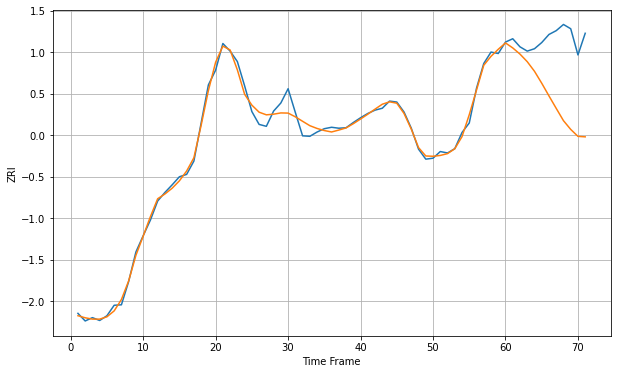

Wall time: 13.4 s
10005 12.251941623404912 134.24419394459386 [3699.16479041 3688.70326636 3675.72901539 3659.8126748  3639.62251495
 3614.52966649 3587.82712102 3561.67278389 3535.85107786 3517.48621573
 3502.8751933  3501.87728131]


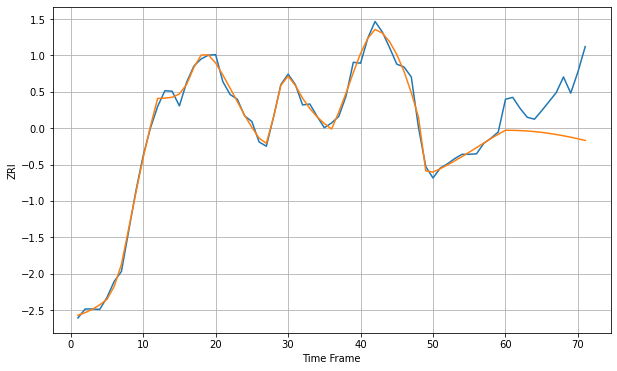

Wall time: 16 s
10009 11.337188057827426 95.84639573908781 [3674.7189917  3674.52563541 3674.03762651 3673.1660613  3671.88450513
 3670.20309338 3668.14761774 3665.74716636 3663.0290998  3660.01918859
 3656.74495599 3653.24045217]

Got an mse at 0.0050 in round 340 and stopped training



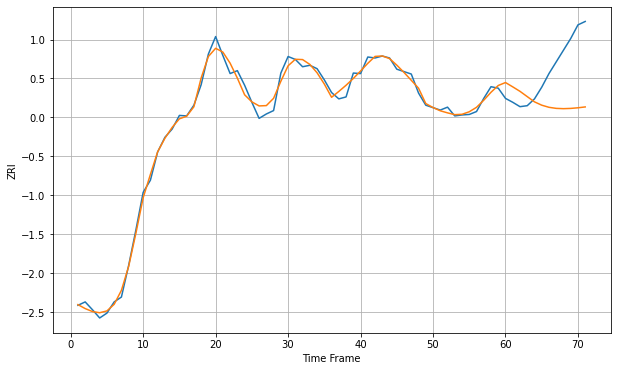

Wall time: 12.5 s
10010 11.249664486180533 97.29034725043932 [3691.53882819 3682.6822694  3673.48670667 3662.65733791 3651.89919829
 3645.05637351 3640.69437691 3638.49300346 3637.90323946 3638.42549872
 3639.69292379 3641.4590848 ]

Got an mse at 0.0050 in round 222 and stopped training



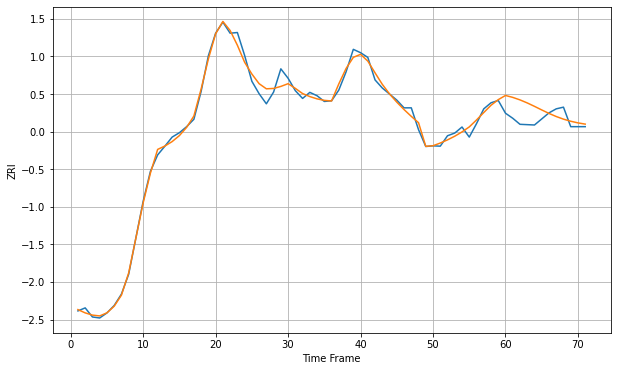

Wall time: 9.85 s
10011 15.737627648235074 42.935361275222206 [3839.81155507 3834.10372199 3826.63929267 3817.60825507 3807.42335917
 3796.76004362 3786.43798983 3777.17312788 3769.37536523 3763.12241393
 3758.26832576 3754.57233357]


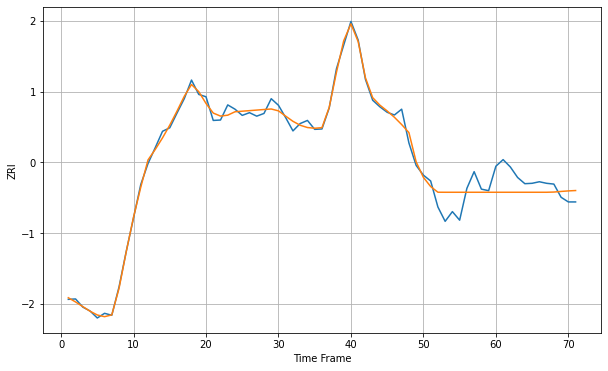

Wall time: 16 s
10012 20.825996989751793 42.67809055405547 [3504.9216517  3504.9216517  3504.9216517  3504.9216517  3504.9216517
 3504.9216517  3504.9216517  3504.9216517  3505.4504939  3507.04809666
 3508.39576328 3509.36409293]


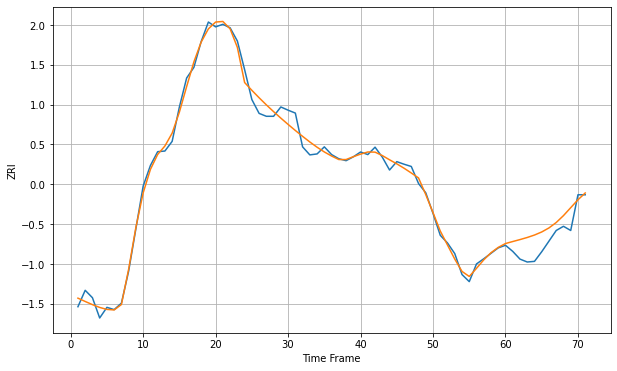

Wall time: 16 s
10013 21.264026252763127 49.70452306330595 [4447.46488641 4453.64678597 4459.72569983 4466.2442109  4473.85638139
 4483.41226655 4496.00839839 4512.80354252 4534.24257533 4558.92010066
 4583.45991765 4604.61540695]

Got an mse at 0.0050 in round 217 and stopped training



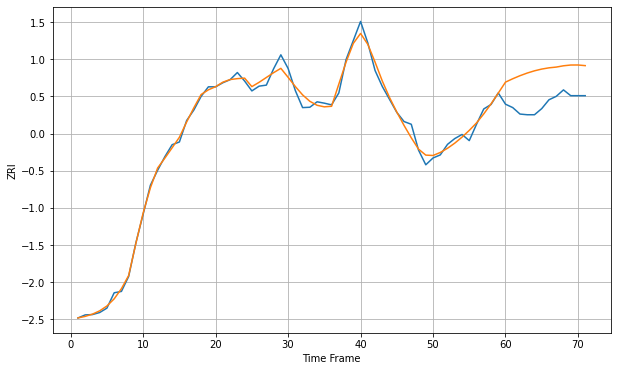

Wall time: 9.79 s
10014 15.287162314924002 97.65975580066271 [3894.80352796 3904.72221831 3913.67903758 3921.49493815 3928.0235521
 3933.15584657 3936.82109113 3938.98516129 3942.78933332 3945.03724089
 3945.15886061 3943.25333163]

Got an mse at 0.0050 in round 231 and stopped training



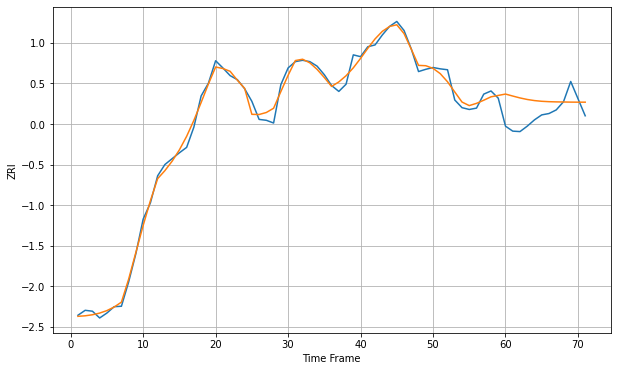

Wall time: 10.3 s
10016 12.603790597861757 47.39869367662978 [3586.14607209 3581.74475746 3577.5608488  3574.14568169 3571.69098943
 3570.12587798 3569.24953806 3568.81377726 3568.57369202 3568.30581208
 3568.16886371 3568.16895704]

Got an mse at 0.0050 in round 462 and stopped training



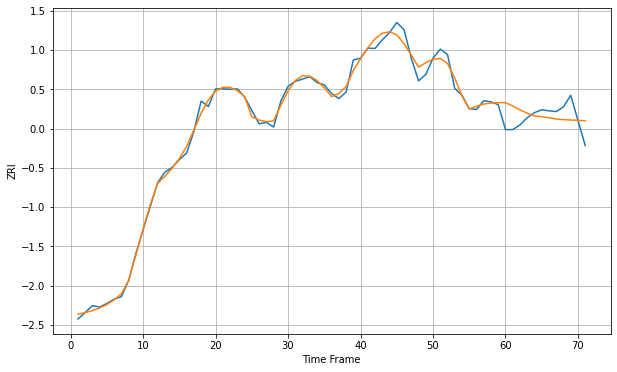

Wall time: 14.6 s
10017 15.28309611292569 44.36976448064407 [3518.7932043  3509.2767466  3498.78640416 3489.4727741  3482.00686684
 3479.72113188 3476.91643411 3473.37895357 3471.43399526 3470.71233092
 3469.71882831 3468.53616349]

Got an mse at 0.0050 in round 326 and stopped training



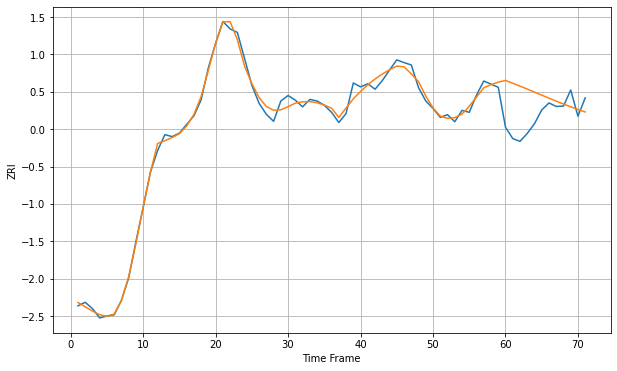

Wall time: 11.7 s
10018 13.458483058056439 80.9955157857351 [3708.48168203 3701.36445925 3693.96169934 3686.36735018 3678.6519716
 3670.89433255 3663.17742433 3655.58452848 3648.19581927 3641.08570463
 3634.32089595 3627.9590966 ]

Got an mse at 0.0050 in round 264 and stopped training



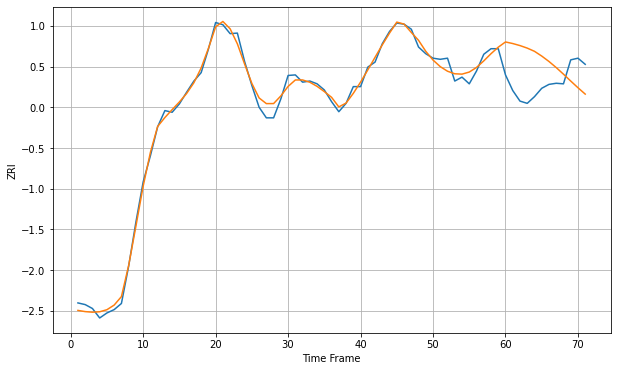

Wall time: 10.3 s
10019 10.249923914127987 64.65953812106133 [3659.11393126 3656.26671071 3652.61601894 3648.07068295 3642.3108021
 3633.7961076  3624.07285176 3613.15946852 3601.30335565 3589.01675891
 3576.99847845 3565.58166822]

Got an mse at 0.0050 in round 220 and stopped training



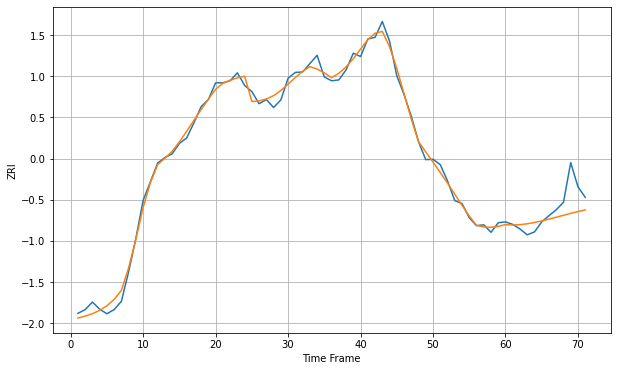

Wall time: 9.41 s
10021 13.861869219377999 42.75475579427854 [3110.51992741 3109.4503336  3110.33206028 3112.46683608 3115.54801302
 3119.38911265 3123.69592009 3128.2281196  3132.84499367 3137.47967156
 3141.62730689 3145.63336583]

Got an mse at 0.0050 in round 221 and stopped training



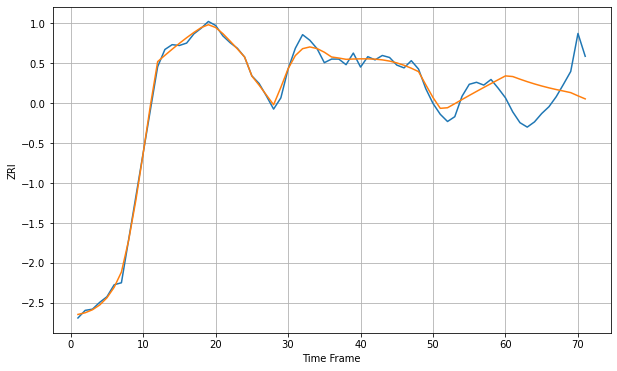

Wall time: 9.45 s
10022 14.055552361356858 86.8516187456741 [4006.98593459 4005.35139829 3998.74889837 3992.56803819 3986.89140854
 3981.73640784 3977.07772599 3972.87114604 3969.09369383 3965.14874411
 3957.15902982 3949.53521886]


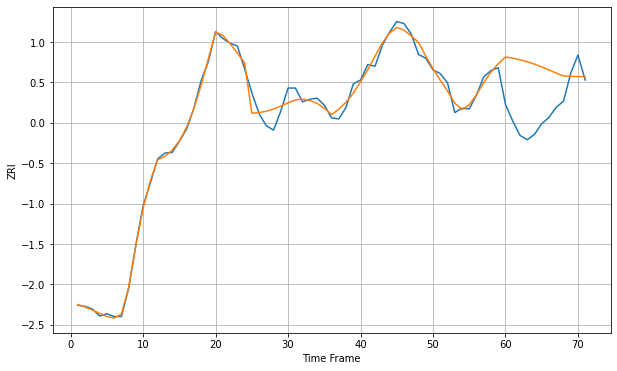

Wall time: 15.7 s
10023 12.348410871255222 95.00227949896582 [3604.28566024 3602.06210536 3599.13115502 3595.40314529 3590.86066544
 3585.61845524 3579.94707641 3574.21162295 3568.57156106 3567.86355542
 3567.61948544 3567.22261629]


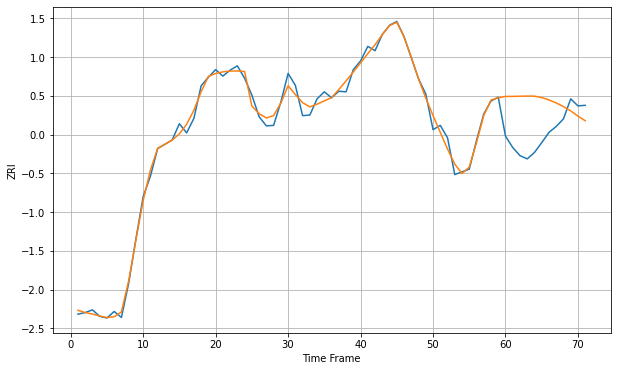

Wall time: 15.6 s
10024 11.127267354189915 73.76048865707511 [3451.47798152 3451.50713039 3451.84878524 3452.10592238 3451.97946788
 3449.21844874 3444.98603817 3439.43949793 3432.7105312  3424.55616774
 3415.07868238 3406.54830144]


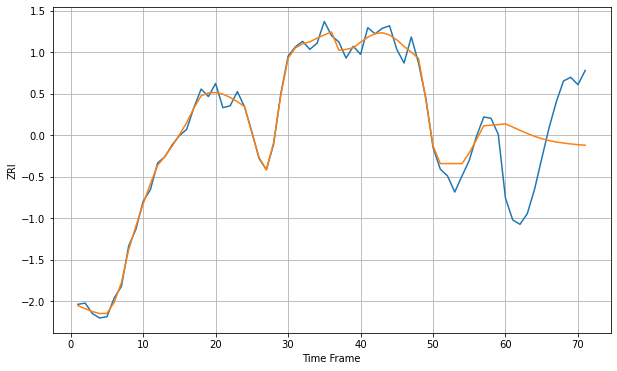

Wall time: 15.7 s
10025 12.501942153011793 106.01348514698125 [3628.95283965 3623.73916808 3618.51697396 3613.47309771 3608.88497863
 3605.0285014  3602.02006593 3599.74753045 3597.98821889 3596.56458484
 3595.39551084 3594.46641302]


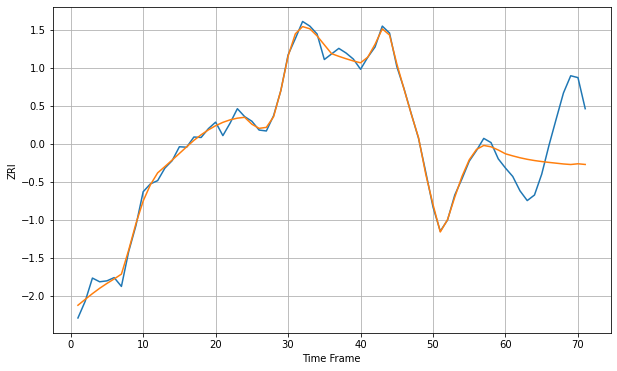

Wall time: 15.5 s
10027 11.776101525768512 108.6112260996412 [2990.78916504 2986.31940649 2982.27884167 2978.9539059  2976.26955893
 2974.09808104 2972.26878882 2970.59003632 2968.88656986 2967.72236918
 2969.30941914 2967.84690884]

Got an mse at 0.0050 in round 333 and stopped training



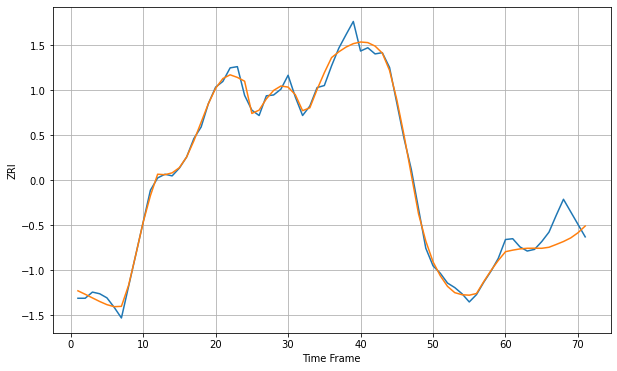

Wall time: 11.9 s
10028 15.434878952673754 44.830008256727105 [3019.40393381 3023.18673272 3026.18664523 3027.72167417 3027.8732679
 3027.65398822 3030.17884466 3037.02196297 3044.1852892  3052.95783455
 3065.45591399 3081.94321118]


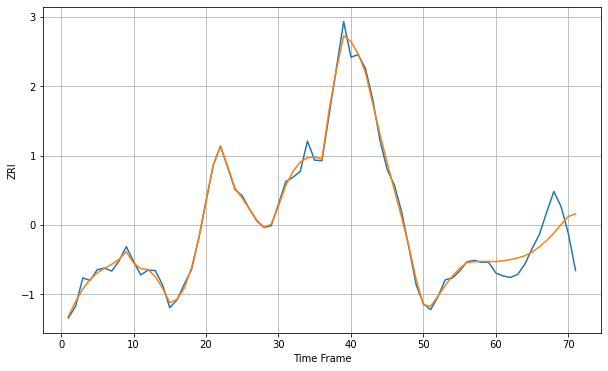

Wall time: 15.5 s
10029 10.436182814384253 51.317210596973375 [2790.40809653 2792.10903132 2794.51932401 2797.90852954 2802.33392146
 2809.94392201 2820.74246287 2833.54593904 2848.84293418 2866.34306869
 2882.83385428 2888.20797639]


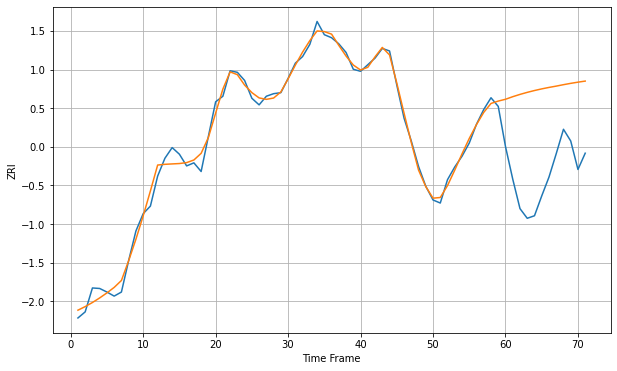

Wall time: 15.5 s
10031 12.826586991369862 175.69501710277265 [2798.01530296 2803.08899248 2807.59068934 2811.61339039 2815.21628465
 2818.43852059 2821.31285772 2823.87450884 2826.71252549 2829.31848349
 2831.65190972 2833.77157296]

Got an mse at 0.0050 in round 340 and stopped training



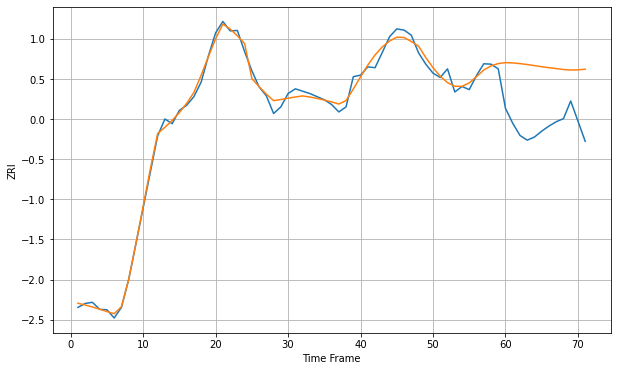

Wall time: 12 s
10036 14.422711834272965 153.33987802010282 [3602.91511787 3602.12636307 3600.41873834 3598.02698655 3595.27245597
 3592.48793161 3589.96519208 3587.73066584 3585.29946514 3584.03306867
 3584.50158155 3585.93183622]

Got an mse at 0.0050 in round 345 and stopped training



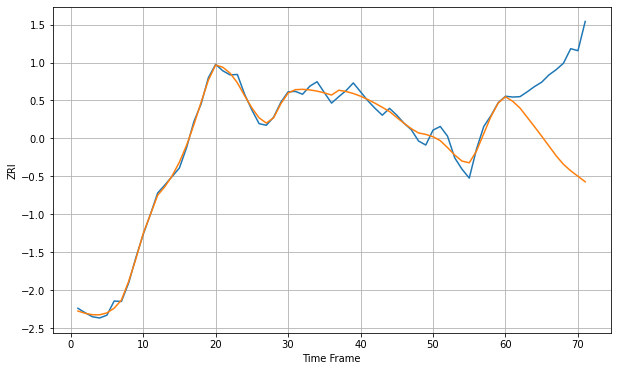

Wall time: 12.1 s
10038 13.221952411235884 208.08365372977096 [3888.72664264 3877.43622841 3860.74081472 3837.62897396 3814.55210639
 3790.77958618 3766.49156163 3742.18632219 3721.06025299 3705.08971913
 3691.43317896 3677.90447604]

Got an mse at 0.0050 in round 424 and stopped training



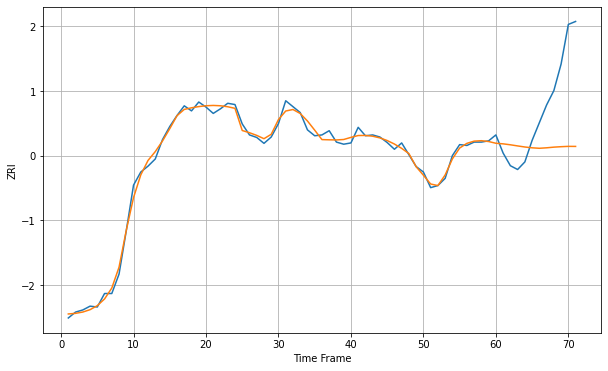

Wall time: 13.8 s
10065 10.806172495214161 144.2504809617654 [3952.24327632 3950.84020088 3948.60580077 3945.91922309 3943.36358521
 3941.44942465 3940.32629987 3941.45189268 3943.02276202 3944.08832855
 3944.86987324 3944.75016919]

Got an mse at 0.0050 in round 263 and stopped training



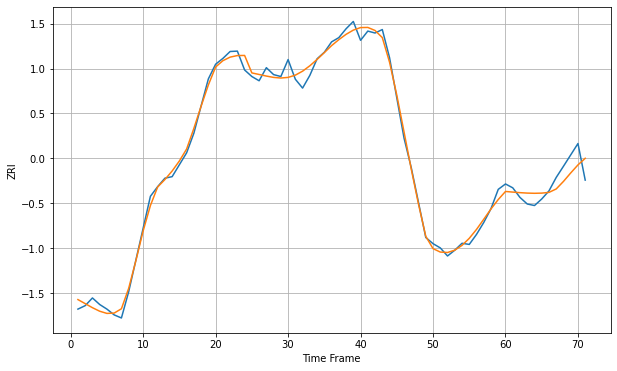

Wall time: 10.4 s
10075 16.450551019908954 33.73021886558079 [3049.53335106 3047.91056639 3046.43900156 3045.31289284 3044.78508241
 3045.23030559 3047.13844069 3056.06917631 3075.6271343  3097.63187585
 3118.4736407  3135.66937132]

Got an mse at 0.0050 in round 343 and stopped training



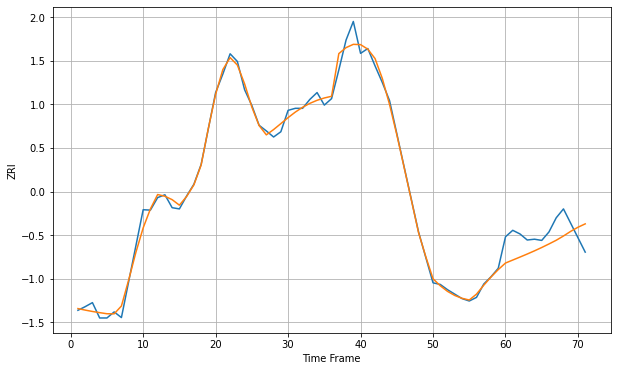

Wall time: 12.3 s
10128 15.184284180524802 49.74198069901554 [2854.01890187 2861.39324972 2868.77870216 2876.32682457 2884.18064074
 2892.46732073 2901.23882073 2910.38179348 2920.94302376 2932.46939701
 2942.58583984 2950.9577897 ]

Got an mse at 0.0050 in round 183 and stopped training



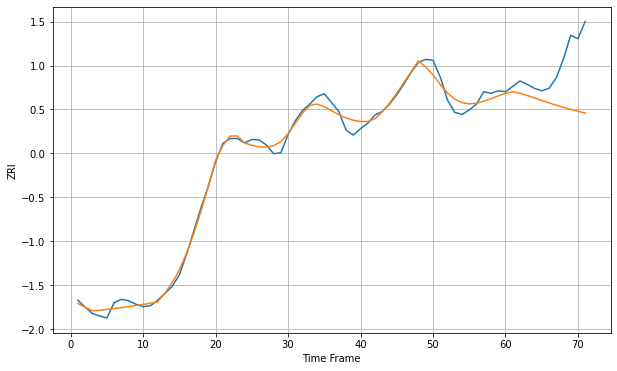

Wall time: 8.64 s
10302 12.57798541905997 88.91760668754333 [1863.79307605 1866.93483976 1863.94266679 1859.50194975 1854.59125264
 1849.52265592 1844.53721186 1839.78066495 1835.31764418 1831.16817673
 1827.34386091 1823.86763829]

Got an mse at 0.0050 in round 189 and stopped training



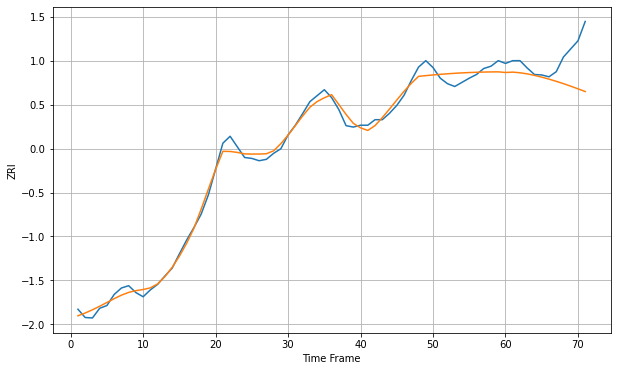

Wall time: 8.76 s
10303 13.427659025405957 62.00566274493447 [2045.35498559 2046.1193044  2044.75372984 2042.37426631 2039.11557024
 2035.28557732 2030.96604735 2026.22322614 2021.11121533 2015.67737174
 2009.96788621 2004.03193132]

Got an mse at 0.0050 in round 118 and stopped training



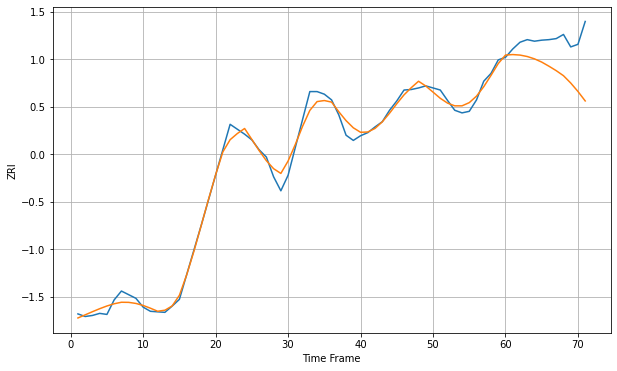

Wall time: 7.21 s
10304 12.77949299140733 67.05303628295579 [1937.34081245 1938.27183931 1937.30059984 1934.52849481 1930.00965193
 1923.77009051 1915.81952534 1907.28342573 1897.59100792 1883.50833521
 1867.19973025 1849.00239556]

Got an mse at 0.0049 in round 231 and stopped training



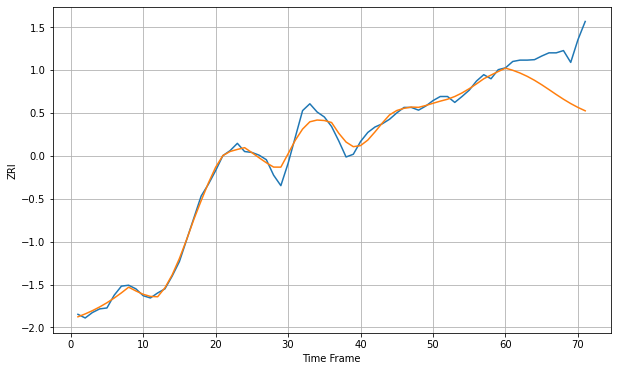

Wall time: 9.67 s
10305 13.195753642534546 93.03774375620873 [1946.32470443 1941.6708956  1935.65768293 1928.29405835 1919.62932064
 1909.81699791 1899.21671025 1888.40495754 1878.00377438 1868.45819019
 1859.96340343 1852.54163568]

Got an mse at 0.0050 in round 346 and stopped training



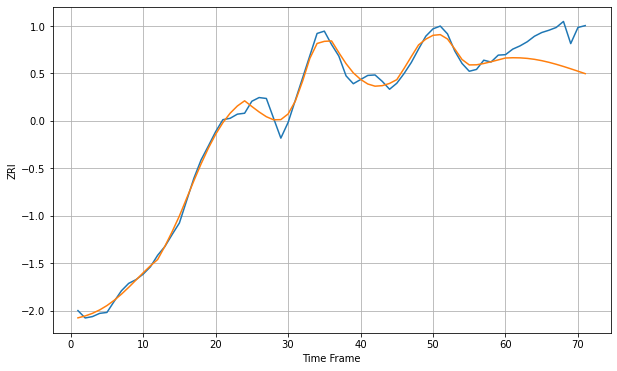

Wall time: 12.1 s
10306 14.490465292591953 65.94541388619578 [1906.75141052 1907.33227738 1907.07357231 1905.92800069 1903.89004406
 1901.0061561  1897.37366739 1893.12614747 1888.41121755 1883.37231862
 1878.14300872 1872.85270705]

Got an mse at 0.0050 in round 152 and stopped training



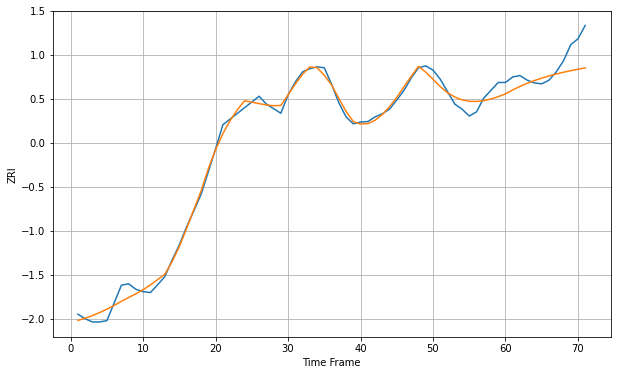

Wall time: 7.99 s
10310 13.463441087694592 39.79456367369977 [1912.18865064 1920.89906047 1928.48852022 1935.20029392 1941.16565875
 1946.46982903 1951.1875148  1955.39592825 1959.17496625 1962.60223555
 1965.74766646 1968.66990942]

Got an mse at 0.0050 in round 260 and stopped training



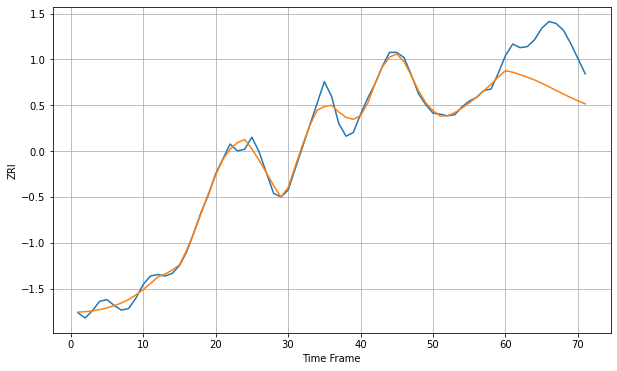

Wall time: 10.3 s
10312 12.28944880188945 88.4023945405537 [1777.9815333  1775.12744754 1770.51848743 1765.77167412 1760.33020812
 1754.04997944 1747.26619204 1740.28505753 1733.36747055 1726.71570302
 1720.46568712 1714.69113522]

Got an mse at 0.0050 in round 233 and stopped training



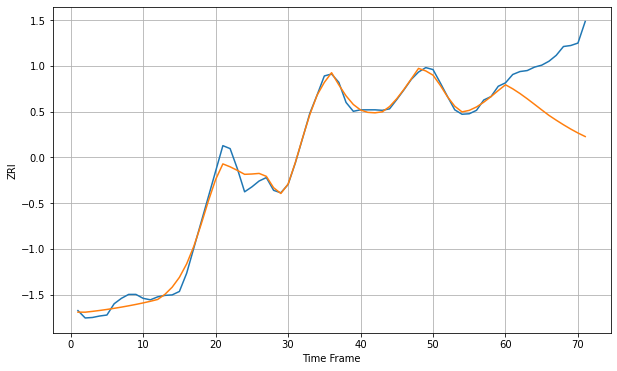

Wall time: 9.71 s
10314 13.076592640105765 126.72872719152456 [1856.01796848 1847.7972129  1838.17521834 1827.51486561 1816.26034779
 1804.85409197 1793.68330897 1783.92792586 1774.60061653 1765.83998834
 1757.78944023 1750.57729699]

Got an mse at 0.0047 in round 48 and stopped training



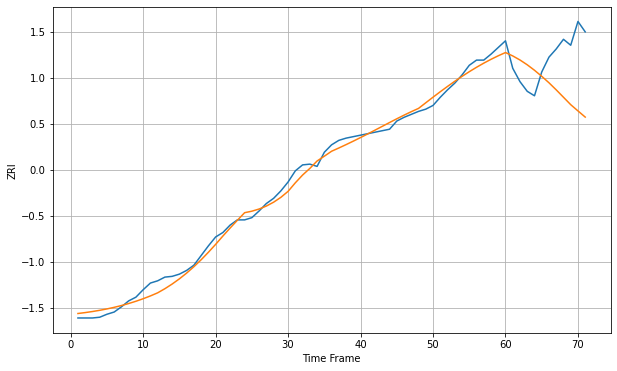

Wall time: 5.71 s
10453 8.098371585769922 63.37859565052305 [1671.1754349  1666.6269313  1661.14171809 1654.69354849 1647.33362184
 1639.19945375 1630.48371336 1620.95109911 1611.01737484 1601.02507586
 1592.62572463 1584.32405723]

Got an mse at 0.0050 in round 51 and stopped training



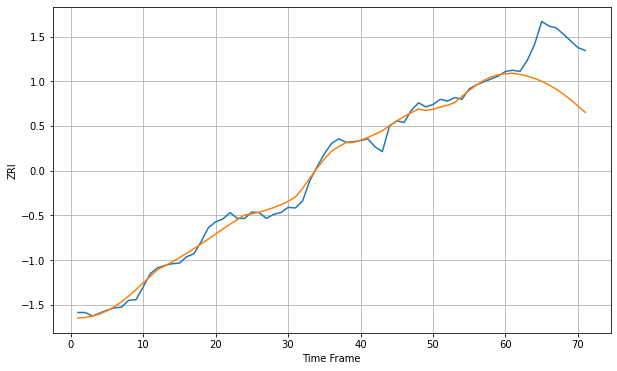

Wall time: 5.78 s
10455 10.776796249326285 80.86231618627959 [1886.95469715 1887.90482073 1885.94985634 1882.96651456 1879.02217732
 1874.0175552  1867.85079964 1860.44900684 1851.81661174 1842.08845115
 1831.55982054 1820.66278504]

Got an mse at 0.0050 in round 61 and stopped training



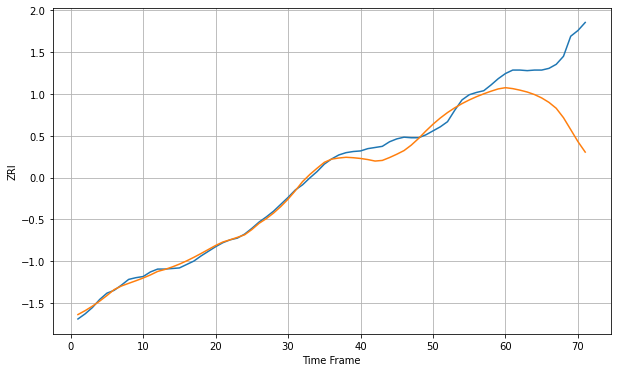

Wall time: 6.02 s
10456 10.094247656541182 109.72146569010455 [1763.26832443 1761.64648549 1758.9639203  1755.7089281  1751.29759702
 1745.37888439 1737.63980913 1727.36458177 1710.97633333 1690.17400742
 1669.1992914  1650.99152148]


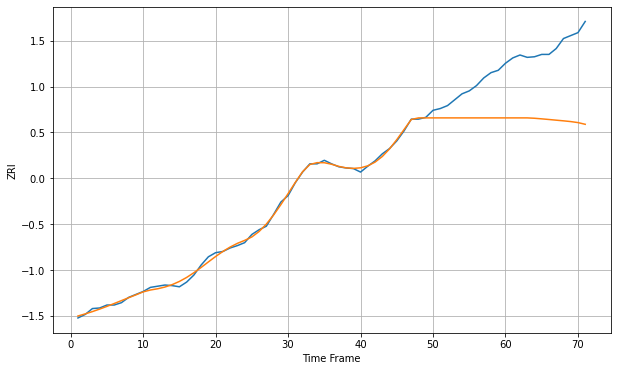

Wall time: 15.5 s
10457 21.118639735283146 124.46317303217555 [1771.09661257 1771.09661257 1771.09661257 1771.09661257 1770.47470523
 1769.46356701 1768.36376116 1767.21131763 1766.08879664 1764.8359653
 1763.11155838 1760.21549611]

Got an mse at 0.0049 in round 46 and stopped training



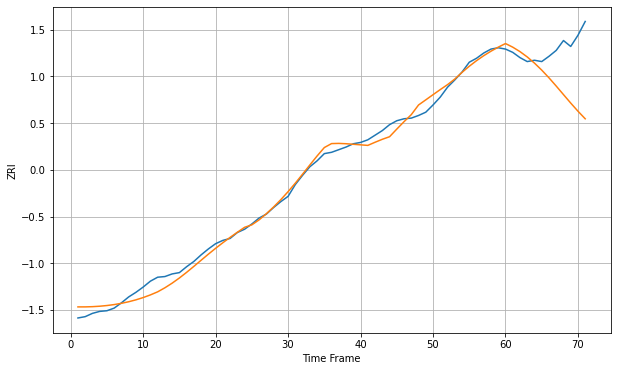

Wall time: 5.65 s
10458 9.68656980482207 67.0199743774084 [1765.40443725 1759.90447812 1753.12396508 1745.03822636 1735.64649286
 1725.00505029 1713.26911367 1700.72355106 1687.77460348 1674.88984702
 1662.5082108  1650.9634111 ]

Got an mse at 0.0049 in round 33 and stopped training



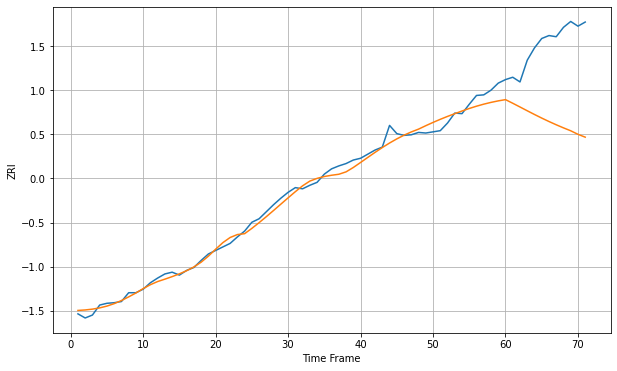

Wall time: 5.42 s
10459 10.310017117183412 136.57951714350256 [1795.86350847 1789.70701197 1783.3339226  1776.90830267 1770.57673206
 1764.45094575 1758.59950508 1753.04962754 1747.79652409 1742.81587621
 1736.81924673 1731.95429165]

Got an mse at 0.0050 in round 43 and stopped training



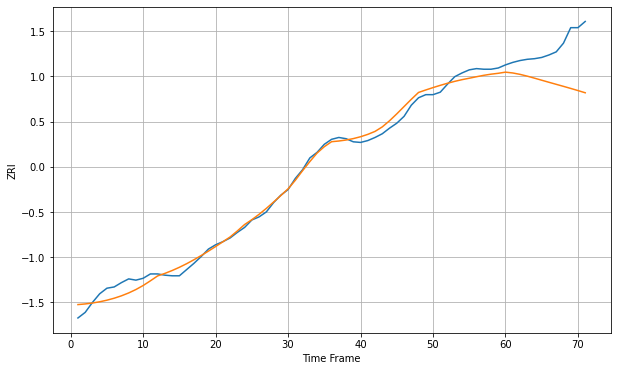

Wall time: 5.58 s
10460 9.983353034188815 62.32356679973834 [1797.28943704 1795.97107948 1793.72390207 1790.84528852 1787.61547747
 1784.26855965 1780.94143125 1777.66156748 1774.38524349 1771.04973854
 1767.60870402 1764.04487605]

Got an mse at 0.0040 in round 39 and stopped training



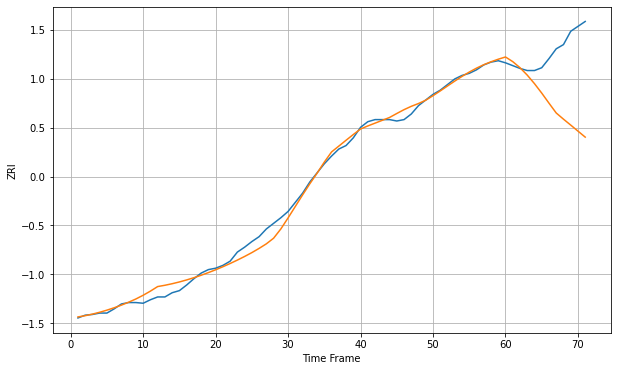

Wall time: 5.52 s
10461 8.304197210765336 88.03577888082211 [1843.3297343  1836.70577373 1828.03067803 1817.46414682 1805.27814699
 1791.81335485 1777.46012564 1763.43146233 1754.62225333 1746.17496724
 1737.57315228 1729.00903247]

Got an mse at 0.0046 in round 52 and stopped training



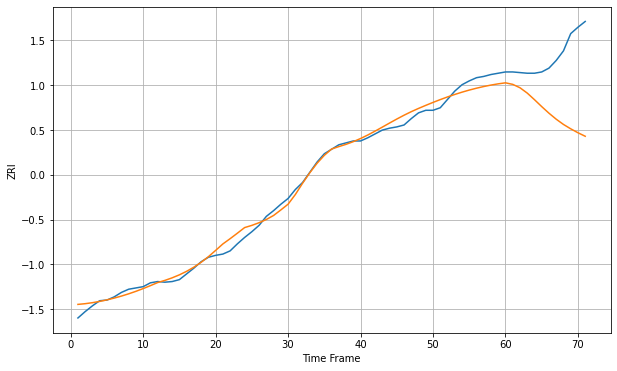

Wall time: 5.77 s
10462 9.248128917931464 98.0227794938669 [1792.97063306 1790.56537299 1785.24997963 1776.92143323 1766.58311119
 1755.74177113 1745.42370947 1736.04300059 1727.84460289 1720.9922766
 1714.85371551 1709.36102942]

Got an mse at 0.0050 in round 440 and stopped training



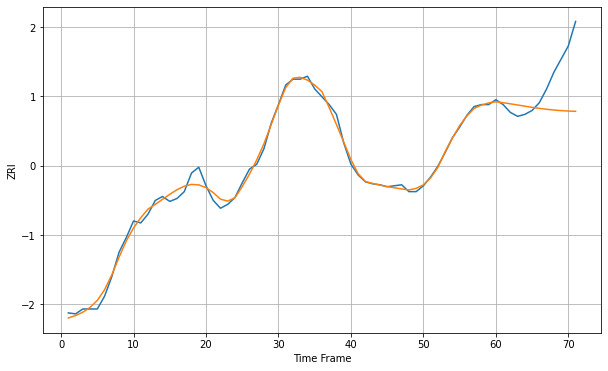

Wall time: 14.2 s
10463 5.000910460729093 38.624789101015075 [1797.88963228 1796.92080691 1795.79507677 1794.58351942 1793.36011227
 1792.19139413 1791.12924223 1790.20817441 1789.4463894  1788.84861518
 1788.40907546 1788.11379417]

Got an mse at 0.0050 in round 55 and stopped training



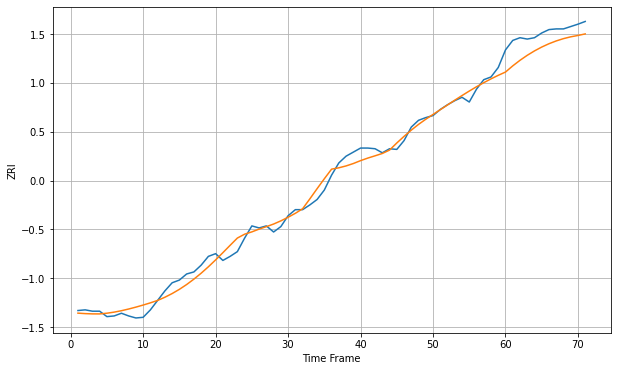

Wall time: 5.86 s
10465 10.087223739373782 23.788167707102776 [1897.27519731 1906.39314225 1914.62764737 1921.9952104  1928.51700108
 1934.2158237  1939.11620097 1943.24524225 1946.63333685 1949.31474439
 1951.32833625 1953.62829124]

Got an mse at 0.0048 in round 36 and stopped training



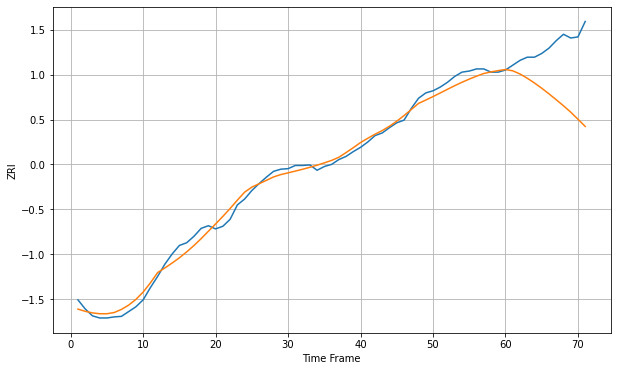

Wall time: 5.47 s
10466 11.178094849336677 103.44243833597207 [1893.90012774 1891.46492931 1885.53701946 1877.57419072 1868.61278691
 1858.78499653 1848.26796984 1837.25067609 1825.89679301 1813.96721167
 1800.65545471 1787.16564578]


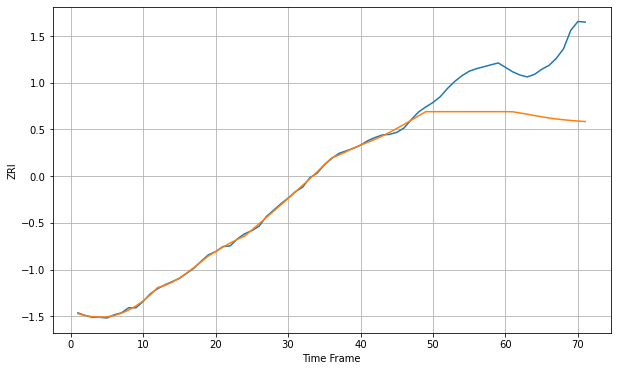

Wall time: 15.5 s
10467 23.518699215536856 100.91665946065187 [1719.53630201 1719.37246729 1717.5361508  1715.56933439 1713.42739559
 1711.45804671 1709.70135012 1708.16944475 1706.85479472 1705.74178018
 1704.81365261 1704.05379714]

Got an mse at 0.0049 in round 62 and stopped training



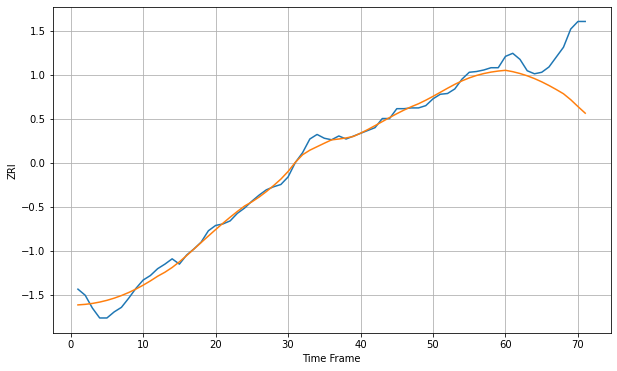

Wall time: 6.01 s
10468 8.103044123202407 60.27500762277878 [1542.58132916 1540.78569783 1538.37756483 1535.33846557 1531.66877045
 1527.39266875 1522.56513625 1517.27894893 1511.66443705 1503.82892854
 1494.78552965 1486.07026712]

Got an mse at 0.0050 in round 41 and stopped training



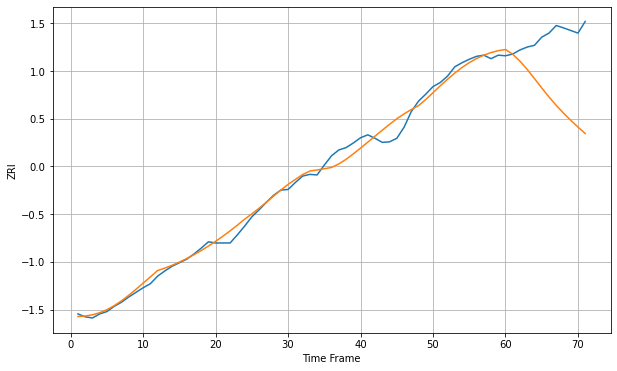

Wall time: 5.56 s
10469 11.47280909139296 112.70401167375327 [1910.7734902  1902.62148506 1890.6661841  1876.47845718 1860.76971355
 1844.65034232 1829.12048771 1814.68236727 1801.38971881 1789.08336981
 1777.41560953 1766.20757129]

Got an mse at 0.0049 in round 71 and stopped training



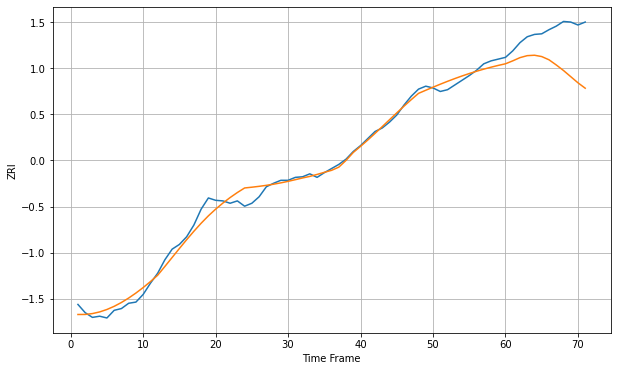

Wall time: 6.19 s
10470 10.874358996745226 64.31874374800672 [1863.06938898 1868.04382994 1873.52375516 1876.89015404 1877.59883905
 1875.32847497 1869.86760813 1861.1277539  1851.67714413 1841.21101156
 1830.7378672  1821.54826115]

Got an mse at 0.0050 in round 129 and stopped training



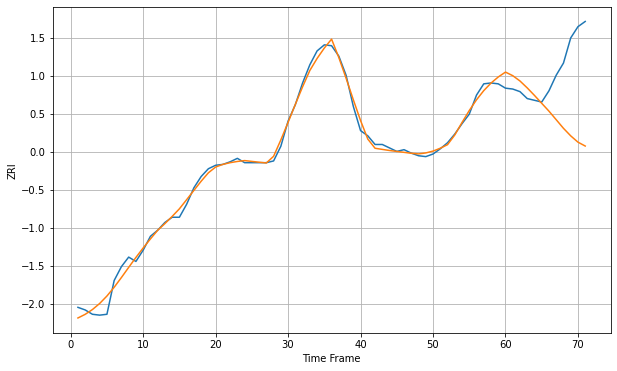

Wall time: 7.52 s
10471 6.1647978747977765 71.31182227647788 [1868.55203977 1864.42842658 1858.28068965 1850.30282639 1841.61652015
 1832.51243773 1823.45086088 1813.57021336 1803.64959563 1794.95828371
 1787.67637994 1783.21029668]

Got an mse at 0.0049 in round 42 and stopped training



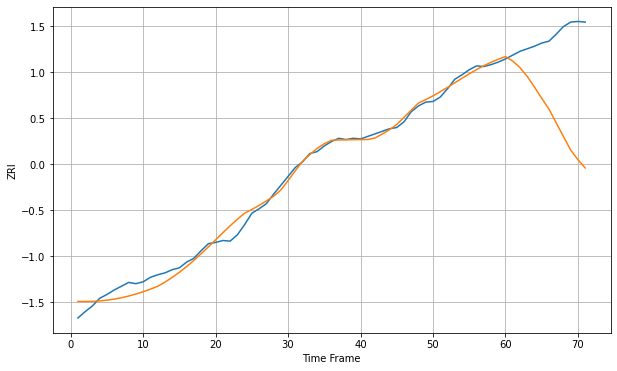

Wall time: 5.58 s
10472 10.306242377962628 134.2292613841412 [1830.73468697 1823.55598351 1813.30406725 1799.413894   1782.62302513
 1764.96618696 1747.88718899 1726.32658781 1704.70536427 1683.55159236
 1668.17393428 1655.25016664]

Got an mse at 0.0050 in round 57 and stopped training



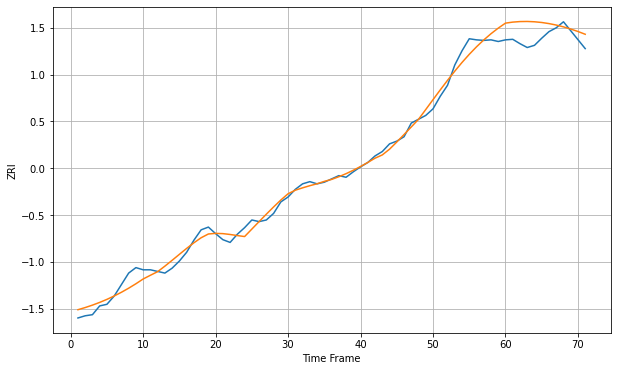

Wall time: 5.93 s
10473 12.007670616064992 28.48210440056587 [2068.55591384 2070.39429509 2071.38822481 2071.58059241 2071.00860017
 2069.70529445 2067.70115226 2065.02541116 2061.70708305 2057.77572109
 2053.26206649 2048.19870777]


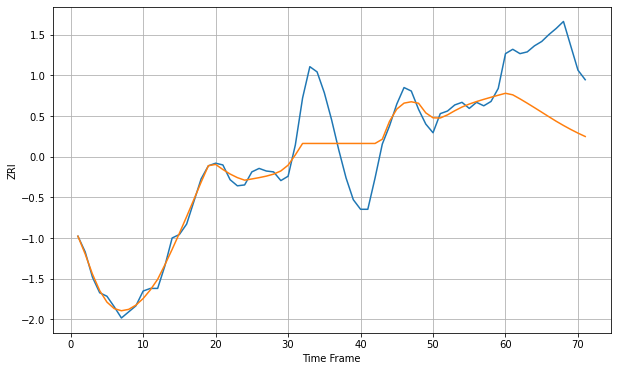

Wall time: 15.6 s
10528 27.028381919459232 79.63094311357216 [2481.39922392 2479.63627752 2474.98621322 2470.01613192 2464.8728271
 2459.63410421 2454.38705526 2449.22167388 2444.39530334 2439.8437185
 2435.60037018 2431.72060052]


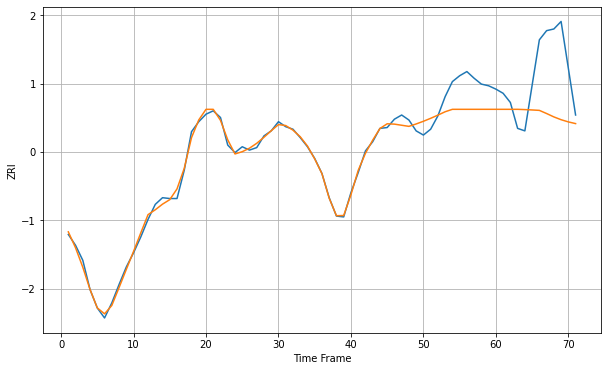

Wall time: 15.5 s
10543 12.790469985058339 64.0181386702065 [2404.81587067 2404.81587067 2404.81587067 2404.81587067 2404.49227988
 2404.05160819 2403.55116129 2399.77595147 2395.74108669 2392.38814247
 2389.75285734 2387.72125475]

Got an mse at 0.0050 in round 90 and stopped training



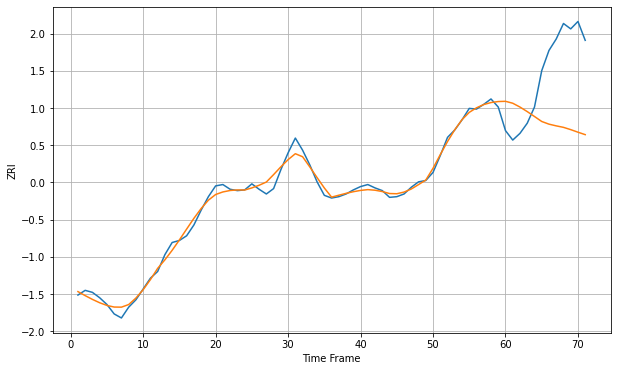

Wall time: 6.62 s
10562 7.729786836889155 105.61917415217083 [2119.5204921  2116.65737847 2110.96678711 2104.25094798 2096.97629599
 2089.58612793 2085.60612262 2083.07662798 2080.87804404 2077.4852045
 2073.68251237 2070.04718414]

Got an mse at 0.0050 in round 334 and stopped training



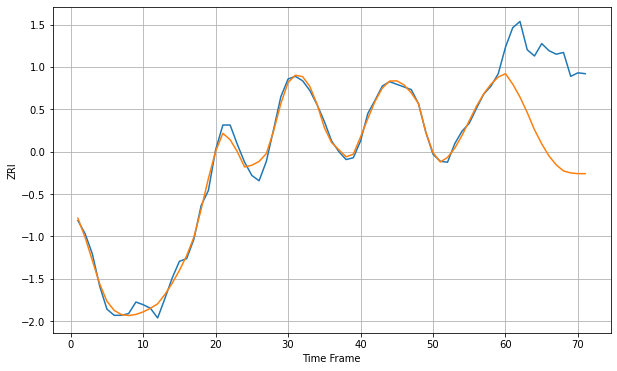

Wall time: 11.9 s
10573 6.722528052615882 101.00193421721856 [2261.98861081 2250.1576221  2235.59333334 2218.09195893 2198.66518087
 2182.67964298 2169.04490236 2159.06369469 2152.10299563 2149.88702987
 2149.05415788 2149.06367771]

Got an mse at 0.0050 in round 37 and stopped training



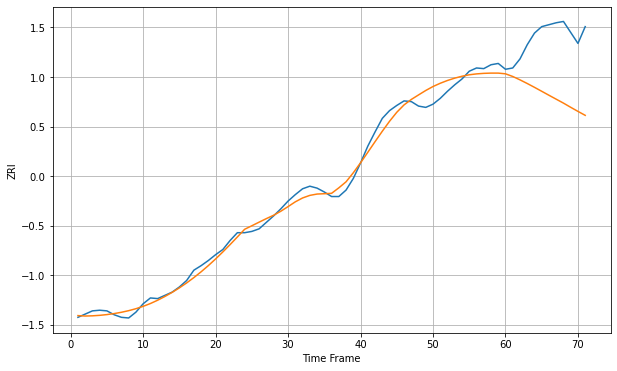

Wall time: 5.47 s
10701 10.670172666415285 94.52712199951308 [2029.96803941 2025.82839782 2020.6095029  2014.96905841 2009.02519708
 2002.90991238 1996.75139945 1990.65999584 1984.59349046 1978.10244515
 1971.78945739 1965.67116081]

Got an mse at 0.0050 in round 158 and stopped training



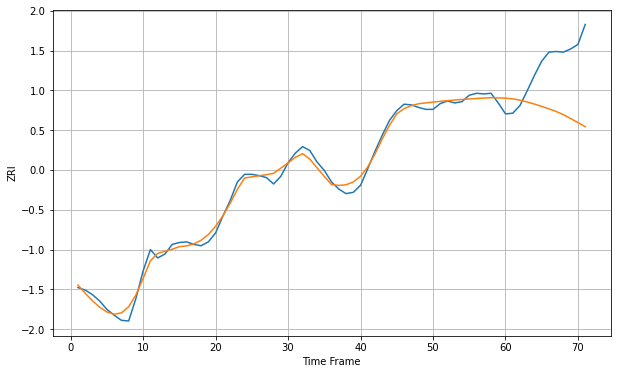

Wall time: 8.07 s
10703 8.682909416200676 84.75673236329392 [2128.41000873 2127.34528049 2125.33576828 2122.43624745 2119.18988456
 2115.6274652  2111.77012342 2107.62182366 2102.72975181 2096.65787647
 2090.40891195 2083.99317939]


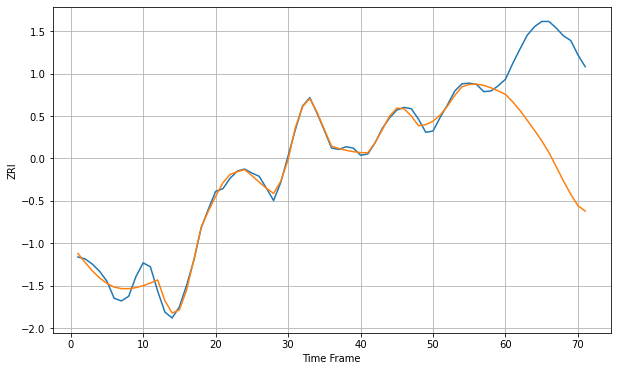

Wall time: 15.4 s
10704 9.471102317526123 177.31980885280953 [2172.7988496  2161.41645861 2148.34904963 2133.35562701 2118.02012783
 2102.04808448 2084.13321288 2062.61672502 2040.86464486 2020.70044454
 2003.12539764 1994.94076755]

Got an mse at 0.0049 in round 192 and stopped training



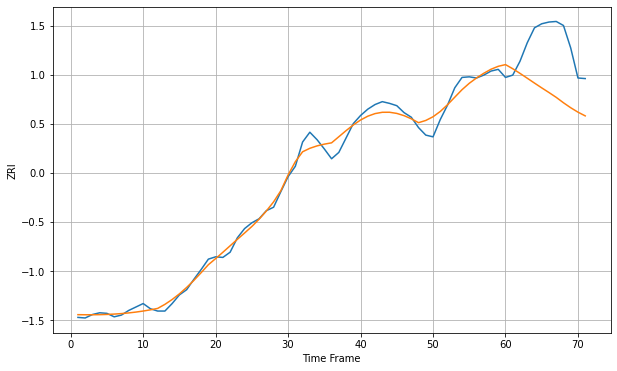

Wall time: 8.89 s
10705 11.913133620714673 88.95117171635782 [2013.20306721 2006.04843041 1998.03072363 1989.63464381 1981.1770629
 1972.86396781 1964.80580839 1956.43797596 1947.05891791 1938.43182724
 1930.79723572 1924.32787958]

Got an mse at 0.0050 in round 102 and stopped training



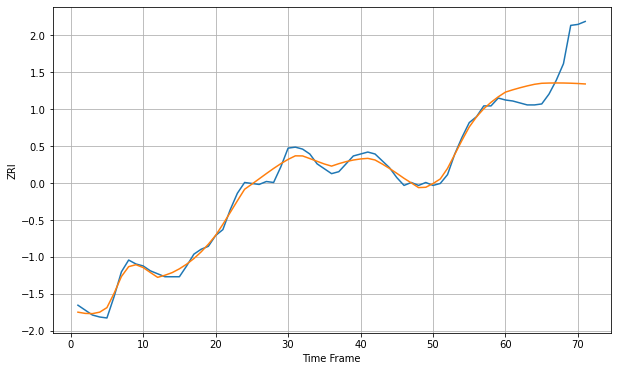

Wall time: 6.91 s
10940 5.3058254952347434 33.364346656663606 [1441.06387047 1443.37902124 1445.47938982 1447.35988701 1449.01465715
 1450.04139939 1450.27917622 1450.36689941 1450.31043055 1450.11694435
 1449.79448083 1449.35156401]

Got an mse at 0.0050 in round 151 and stopped training



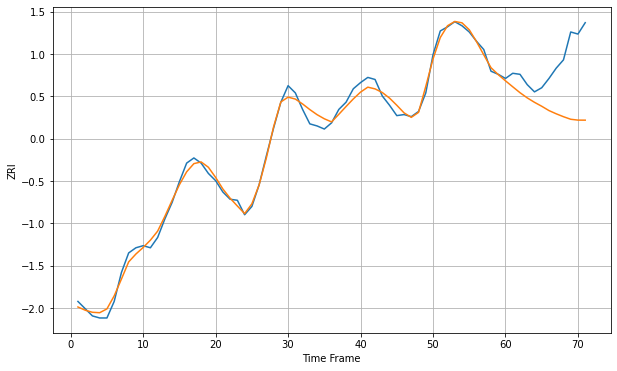

Wall time: 7.97 s
10960 5.744668605729643 50.03713634604954 [1851.68570715 1845.91283751 1840.20046355 1835.17652307 1830.87876091
 1827.05817671 1822.88138921 1819.7554889  1816.94664838 1814.46864631
 1813.64427768 1813.59769916]

Got an mse at 0.0050 in round 280 and stopped training



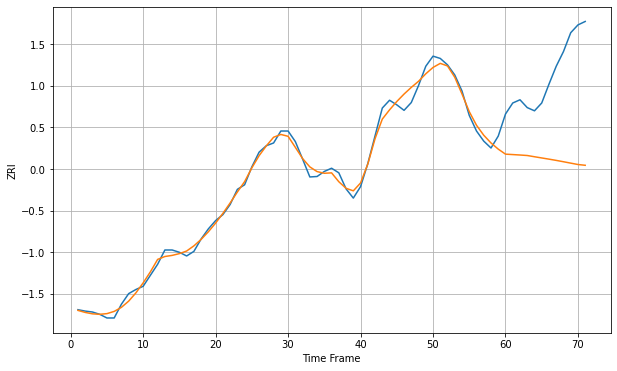

Wall time: 10.7 s
10977 12.73507918462829 197.2896623957513 [2019.65690427 2018.72250922 2017.77244025 2016.68642682 2013.98515326
 2011.37781984 2008.76944884 2006.04028576 2003.12139366 2000.07657228
 1997.09538477 1995.40243521]

Got an mse at 0.0050 in round 167 and stopped training



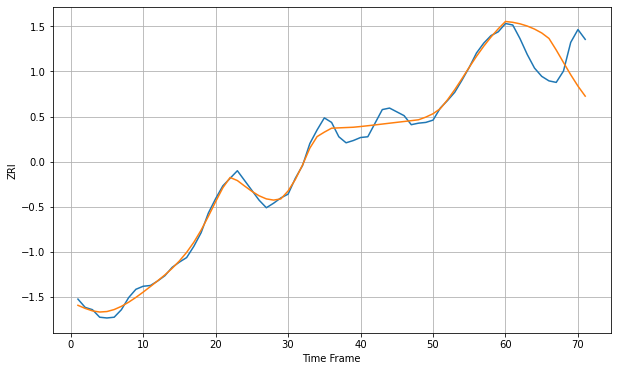

Wall time: 8.3 s
11001 8.418804761621852 46.57119116838892 [2203.6936141  2202.56578434 2200.57945389 2197.63891714 2193.63526985
 2188.45652837 2181.22002965 2165.90357358 2149.37928583 2133.13320249
 2118.06357017 2104.79949738]


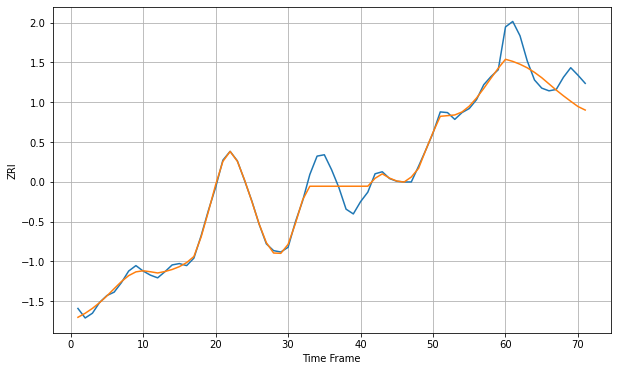

Wall time: 15.5 s
11003 12.57279196911462 35.214492739431336 [2237.39292209 2234.30956337 2230.10032948 2224.86116231 2218.16542032
 2210.30302399 2201.21793056 2192.12555469 2183.65228737 2175.64160954
 2167.93434009 2162.74272912]

Got an mse at 0.0050 in round 321 and stopped training



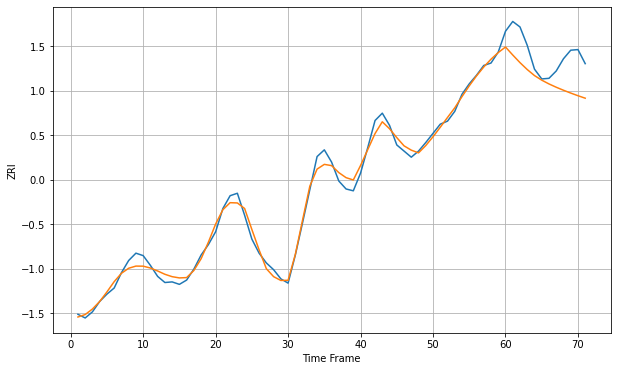

Wall time: 11.7 s
11010 10.226226000783212 46.55255138757572 [2407.21085154 2394.14423554 2381.66403094 2370.36613464 2360.51621384
 2353.01945301 2346.82659217 2341.4144257  2336.49331746 2331.89500225
 2327.56005274 2323.48535026]

Got an mse at 0.0049 in round 58 and stopped training



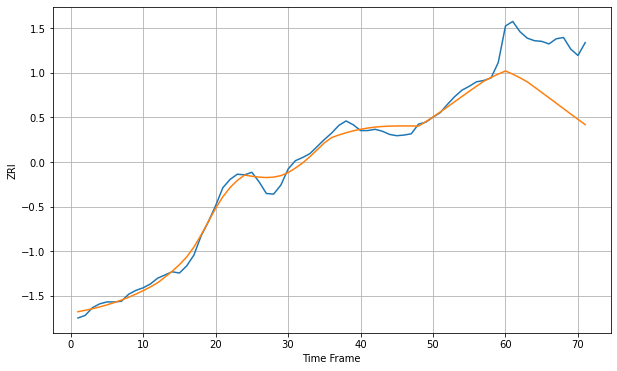

Wall time: 5.92 s
11050 9.609913677539089 90.74039952076397 [2589.85646951 2584.92452143 2579.23577457 2572.93300651 2564.76449074
 2556.39960001 2548.07251658 2539.71242063 2531.28532645 2522.83281477
 2514.45932703 2506.29085723]


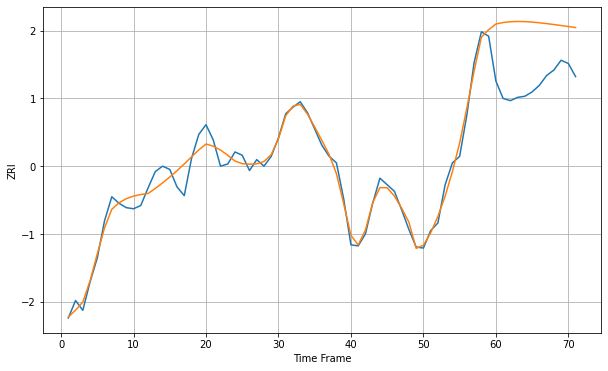

Wall time: 15.5 s
11101 8.427409893620458 56.142039533891364 [2540.1565588  2541.52559043 2542.26041217 2542.49599522 2542.35122758
 2541.92617584 2541.30220482 2540.54332728 2539.69791285 2538.80031521
 2537.8721904  2536.92338128]


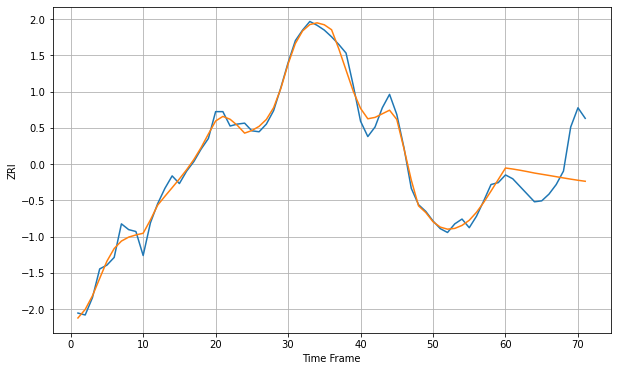

Wall time: 15.4 s
11102 7.777997577591902 36.655181686292565 [2195.23301301 2194.16765461 2192.90216881 2191.48831494 2189.96947761
 2188.72009245 2187.4728116  2186.17567924 2184.87727489 2183.62393541
 2182.45539995 2181.40225035]

Got an mse at 0.0050 in round 475 and stopped training



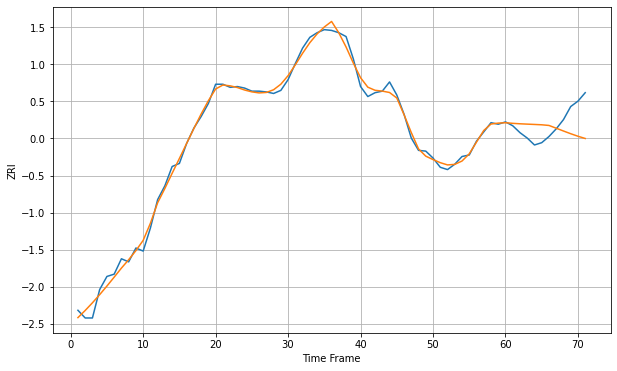

Wall time: 15 s
11103 6.775266785891117 27.43833488033081 [2152.95068929 2152.14394444 2151.56566786 2151.11365146 2150.70232179
 2150.25107826 2149.39831189 2145.80754649 2142.17418906 2138.64418771
 2135.35923826 2132.44343228]


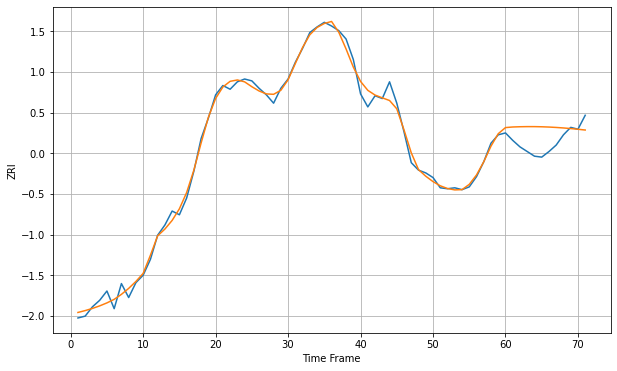

Wall time: 15.5 s
11104 6.425412625341951 20.13019177717719 [2109.76358597 2110.40840404 2110.66988305 2110.79994811 2110.78827664
 2110.63248039 2110.33648521 2109.90877128 2109.36090859 2108.7063899
 2107.95974307 2107.13589096]

Got an mse at 0.0050 in round 383 and stopped training



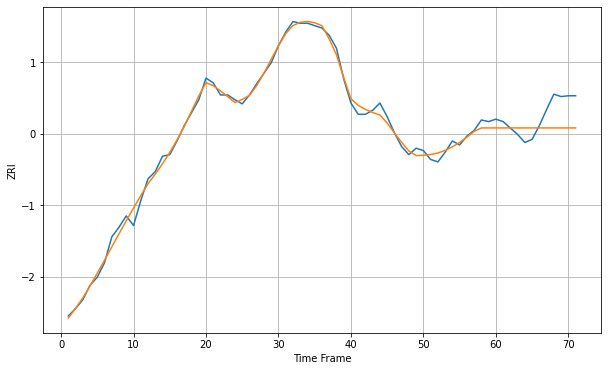

Wall time: 13 s
11105 6.252138152782918 25.407496320000874 [2176.13776299 2176.13776299 2176.13776299 2176.13776299 2176.13776299
 2176.13776299 2176.13776299 2176.13776299 2176.13776299 2176.13776299
 2176.13776299 2176.13776299]


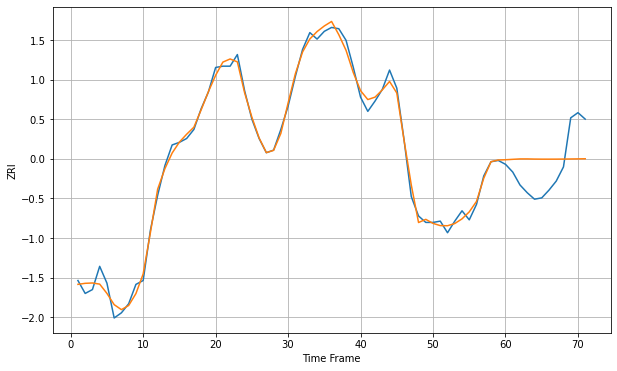

Wall time: 15.4 s
11106 4.893581894953595 24.508373828886448 [2137.53504334 2137.86702698 2138.17639489 2138.18661233 2138.06377274
 2138.00515169 2137.99458208 2138.01927614 2138.06938754 2138.1374159
 2138.21764136 2138.305659  ]


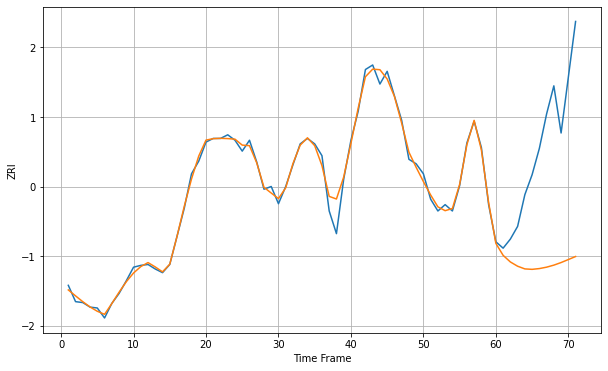

Wall time: 15.4 s
11201 7.092855411962822 139.4858127351568 [2837.25747262 2824.08622863 2816.77838598 2812.076262   2809.11329762
 2808.63655239 2809.47807563 2811.03482976 2813.27036764 2816.12969814
 2819.42991379 2822.77451118]


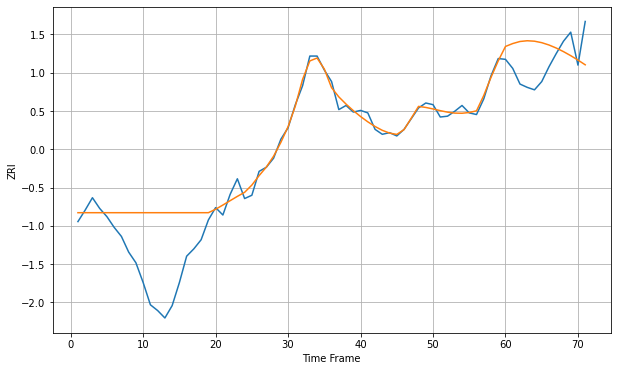

Wall time: 15.5 s
11203 38.0479271422926 37.93873230251198 [2172.68554911 2176.19146589 2178.6918513  2179.58453447 2179.04251657
 2177.2557938  2174.4258945  2170.74810879 2166.39055916 2161.48348461
 2156.12350144 2150.38754703]

Got an mse at 0.0050 in round 80 and stopped training



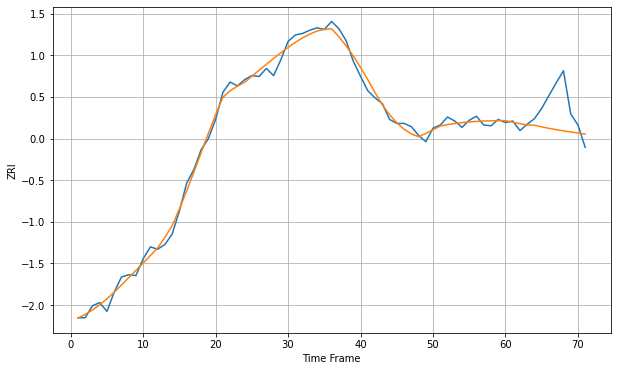

Wall time: 6.41 s
11204 7.350105899221321 32.16975174461556 [2000.54982383 1998.52817683 1996.69095831 1995.07625003 1994.66565377
 1992.64311619 1990.82817423 1989.18876044 1987.68819126 1986.29010696
 1984.96133672 1983.62504645]


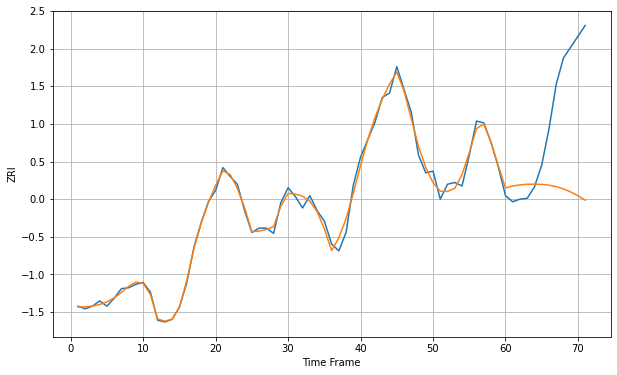

Wall time: 15.5 s
11205 6.260024531595613 108.55454237798979 [2793.81430253 2795.97290188 2797.29365353 2797.95431809 2798.12603485
 2797.82937936 2796.93309625 2795.25575036 2792.68254389 2789.22036523
 2784.93735083 2779.82749224]


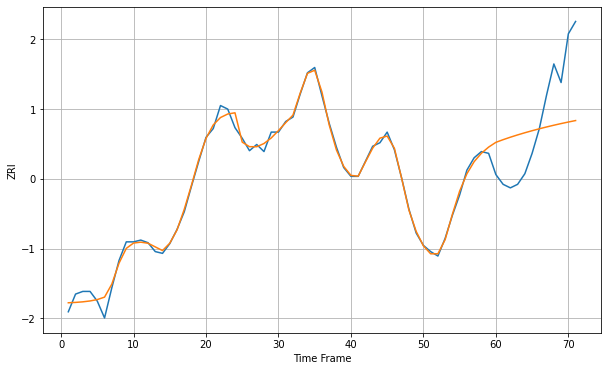

Wall time: 15.4 s
11206 5.9270787278469355 60.39231283762996 [2578.43034512 2581.44998555 2584.23510613 2586.83165159 2589.27016084
 2591.57139887 2593.74968365 2595.81491172 2597.7738584  2599.63107169
 2601.38952933 2603.05114534]

Got an mse at 0.0050 in round 224 and stopped training



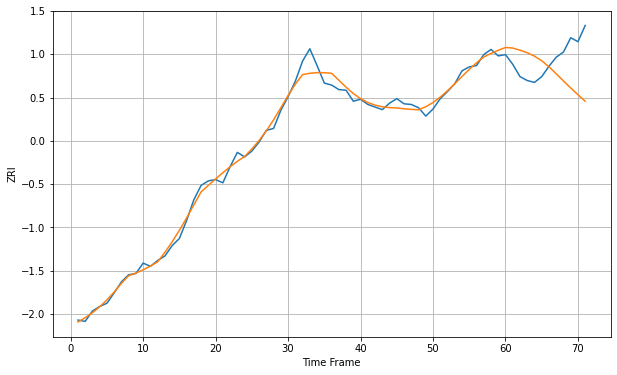

Wall time: 9.6 s
11207 9.424044965025576 54.4634643094641 [2272.98752418 2272.1337061  2268.79569307 2264.95363626 2259.56342815
 2252.44935977 2243.24035112 2232.30286887 2221.33843733 2210.51491239
 2199.99320729 2189.9286351 ]

Got an mse at 0.0049 in round 149 and stopped training



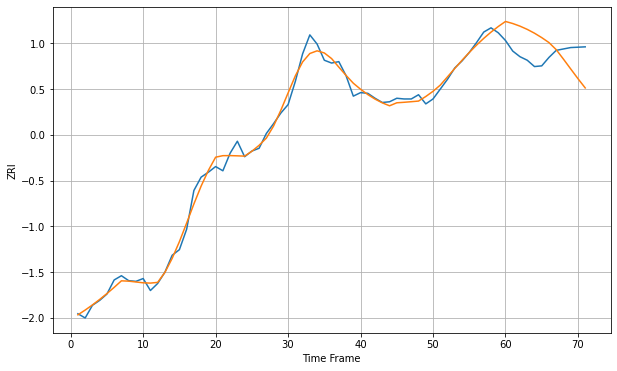

Wall time: 7.86 s
11208 9.095831223384286 37.52367651179215 [2279.04257803 2276.12603672 2272.38677661 2267.80780251 2262.37834682
 2256.10906146 2249.05554156 2238.98918662 2225.5089375  2211.60848514
 2197.82733485 2184.64255911]

Got an mse at 0.0050 in round 164 and stopped training



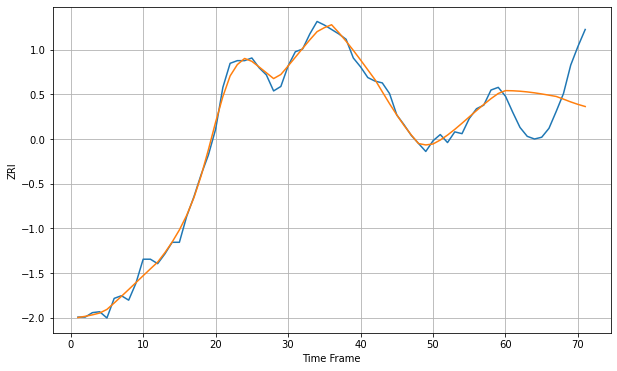

Wall time: 8.2 s
11209 7.043224694520101 45.60326515863066 [2088.34414582 2088.15914436 2087.66940066 2086.88770019 2085.84516667
 2084.59471834 2083.20977496 2081.77549032 2078.77457573 2075.64903053
 2072.87569757 2070.4898124 ]

Got an mse at 0.0050 in round 156 and stopped training



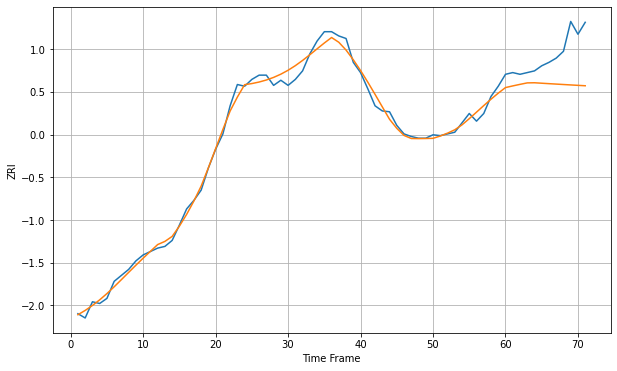

Wall time: 8.05 s
11210 7.0633381889240985 39.95117281867509 [1944.42108439 1946.35084432 1948.17446397 1949.90473606 1950.05796921
 1949.52162077 1949.00499732 1948.49979024 1948.00139649 1947.50881352
 1947.02297228 1946.54472395]


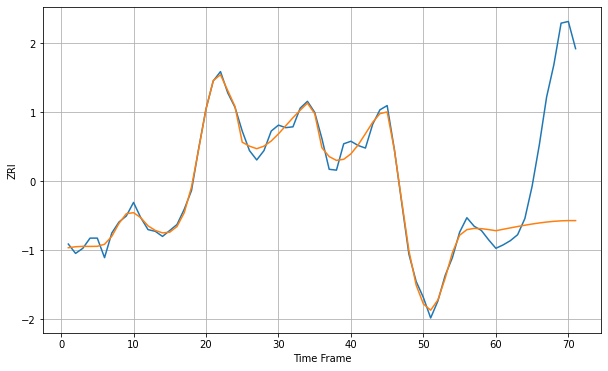

Wall time: 15.4 s
11211 7.768931855609186 134.5425168783857 [2726.71700859 2728.39108852 2730.03880849 2731.64034568 2733.16645037
 2734.58069366 2735.84337205 2736.91505537 2737.75855662 2738.3395731
 2738.62753399 2738.59882225]

Got an mse at 0.0050 in round 337 and stopped training



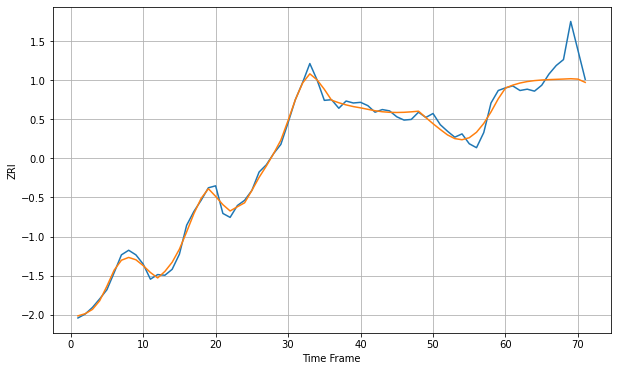

Wall time: 12 s
11212 8.37014012031021 30.945420575724363 [2158.72678062 2163.15024363 2166.36493922 2168.58583006 2170.03743052
 2170.95030475 2171.53628052 2171.97294278 2172.39884781 2172.90479388
 2172.30604803 2167.3637451 ]

Got an mse at 0.0050 in round 311 and stopped training



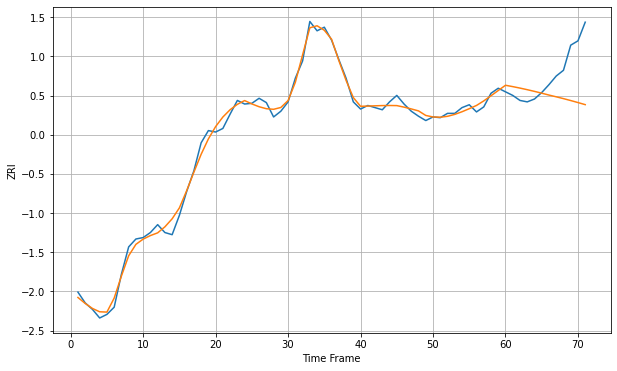

Wall time: 11.4 s
11213 7.6524405100305595 50.057689628381596 [2313.12417176 2311.25059524 2309.19983696 2306.98208442 2304.61184829
 2302.10634816 2299.48337869 2297.05608402 2294.52345529 2291.84905358
 2289.04983177 2286.14476819]

Got an mse at 0.0050 in round 273 and stopped training



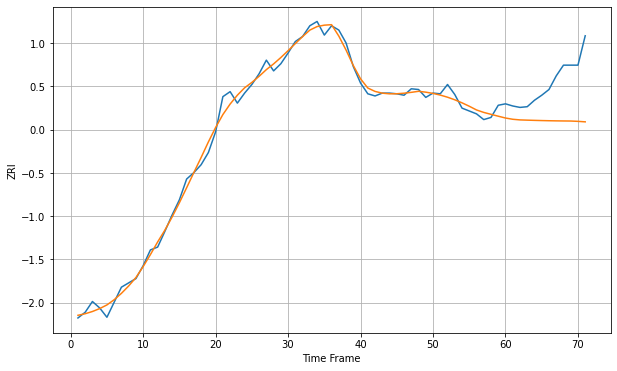

Wall time: 10.6 s
11214 8.51153934177902 59.18205258944519 [2060.18489876 2058.43633736 2057.55539391 2057.21442788 2056.90510859
 2056.63323866 2056.40351658 2056.21860263 2056.07892161 2055.9829599
 2055.52727012 2054.8454575 ]


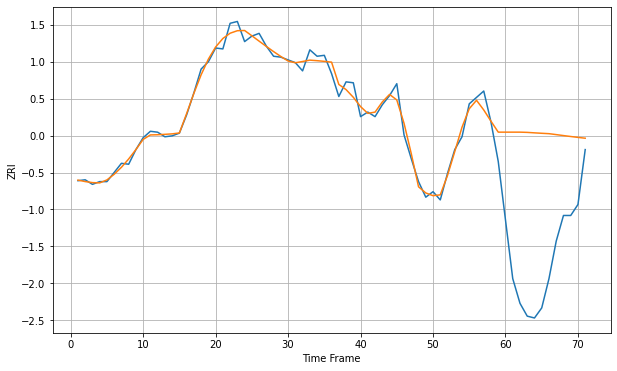

Wall time: 15.5 s
11215 8.328079576778256 143.38610923018302 [2582.05689278 2582.05689278 2582.05689278 2581.80182962 2581.28411857
 2580.81696599 2580.38753289 2579.35939281 2578.3110009  2577.29630978
 2576.3305092  2575.42573176]


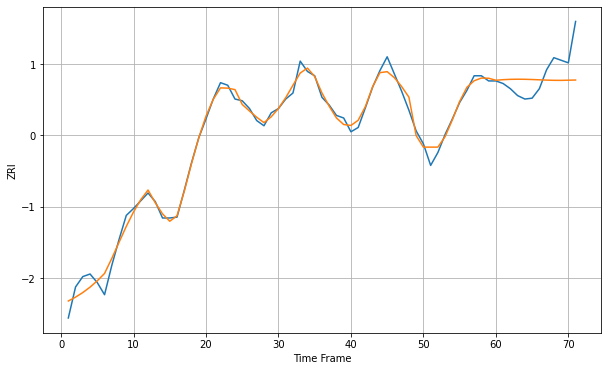

Wall time: 15.4 s
11216 8.207645688494845 25.821398057960465 [2506.80540516 2507.46316201 2507.85946594 2507.99928664 2507.9124839
 2507.65478877 2507.30563917 2506.96115077 2506.72073207 2506.67065969
 2506.87101355 2507.05605425]


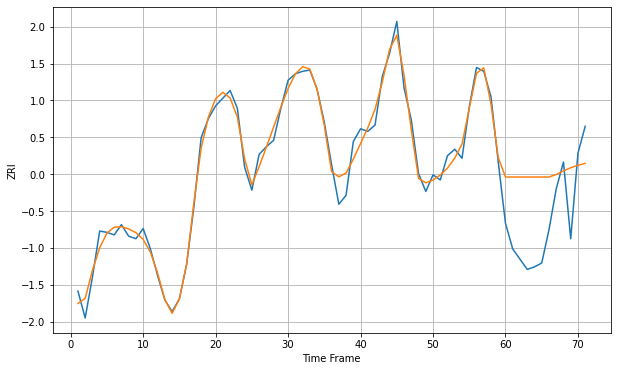

Wall time: 15.6 s
11217 7.401479267948336 49.33724699268753 [2827.28450054 2827.28450054 2827.28450054 2827.28450054 2827.28450054
 2827.28450054 2827.28450054 2829.26213901 2832.11614369 2834.55528525
 2836.50967655 2837.91895706]

Got an mse at 0.0050 in round 318 and stopped training



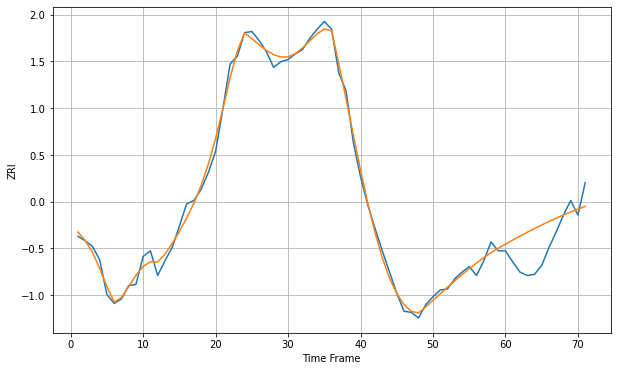

Wall time: 11.5 s
11218 5.88296309151859 24.490928714059123 [2040.98680811 2044.62380679 2048.16613595 2051.60207969 2054.92614631
 2058.1353878  2061.22716847 2064.19822192 2067.04462138 2069.7622636
 2072.34753576 2074.79793653]

Got an mse at 0.0050 in round 214 and stopped training



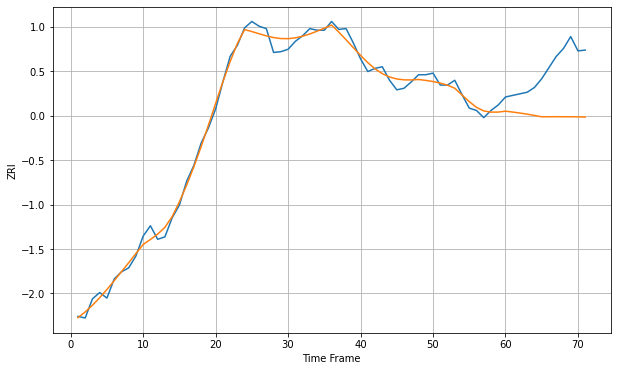

Wall time: 9.29 s
11219 7.880854471498871 62.4201355214964 [2093.13308518 2092.02167142 2090.78382891 2089.36305086 2087.76540304
 2086.07801094 2086.14666356 2086.17257674 2086.15377969 2086.1157065
 2086.03859219 2085.72484115]

Got an mse at 0.0050 in round 227 and stopped training



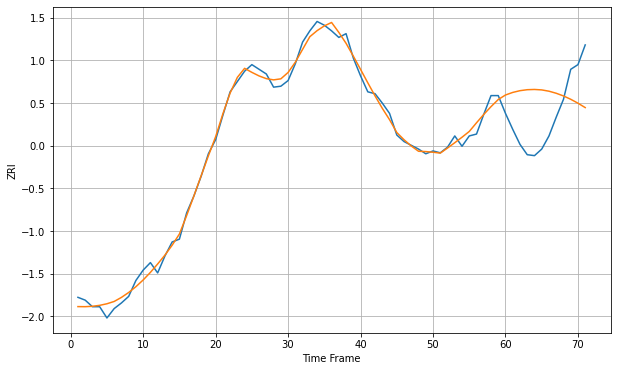

Wall time: 9.58 s
11220 6.39135656686276 49.217758157986125 [2084.63610401 2087.37738441 2089.23917601 2090.27592081 2090.53662948
 2090.05483288 2088.67485551 2086.48507445 2083.61567342 2080.07131761
 2075.89580489 2071.207459  ]


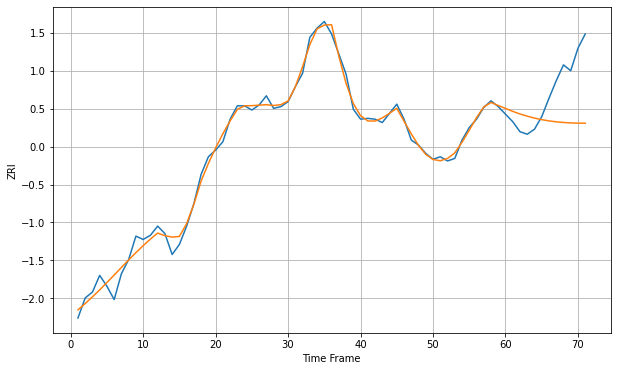

Wall time: 15.5 s
11221 7.821324340994968 52.1038899959671 [2441.90906616 2438.35803236 2435.25135654 2432.57680778 2430.31559121
 2428.45070995 2426.96635889 2425.84169152 2425.04534829 2424.53478508
 2424.25995086 2424.16851436]


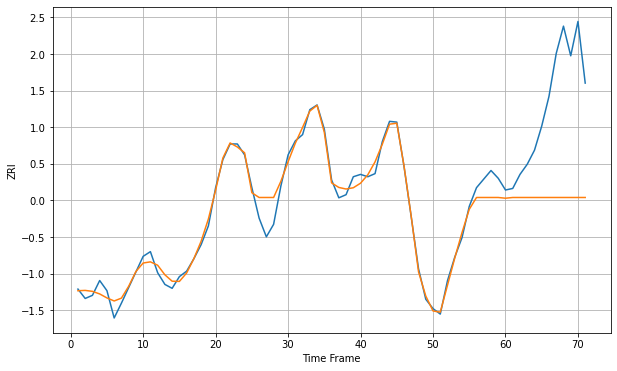

Wall time: 15.5 s
11222 12.999741007374707 135.21894280877297 [2704.48203803 2705.4196592  2705.4196592  2705.4196592  2705.4196592
 2705.4196592  2705.4196592  2705.4196592  2705.4196592  2705.4196592
 2705.4196592  2705.4196592 ]

Got an mse at 0.0050 in round 186 and stopped training



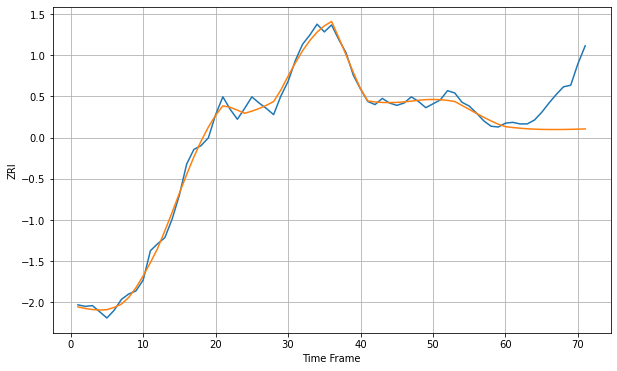

Wall time: 8.71 s
11223 7.488632929380506 49.168637671308765 [2002.46077614 2001.3240622  2000.41582082 1999.72490396 1999.23407152
 1998.92209062 1998.76569232 1998.7411674  1998.82553506 1998.99731544
 1999.23698129 1999.52717225]

Got an mse at 0.0050 in round 162 and stopped training



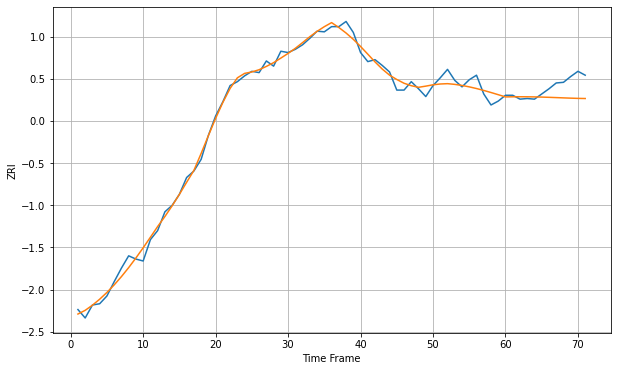

Wall time: 8.2 s
11224 9.177321814586517 21.395849442056846 [2107.45824028 2107.65318202 2107.71537619 2107.65128366 2107.47140032
 2107.19038157 2106.82782243 2106.40923733 2105.96724262 2105.54376084
 2105.19376669 2104.98749275]

Got an mse at 0.0050 in round 402 and stopped training



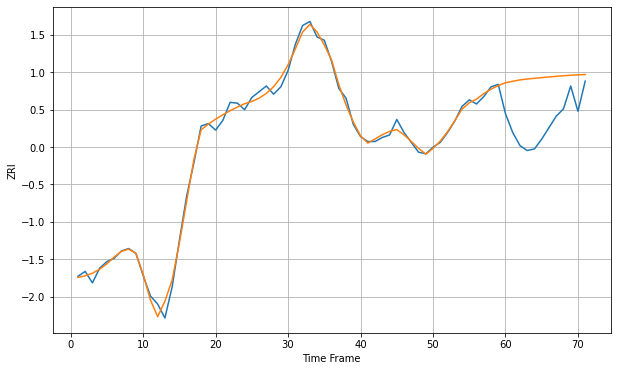

Wall time: 13.5 s
11225 6.451161175565408 59.70658241388742 [2315.0328764  2316.77523147 2318.4639172  2319.5263296  2320.44521027
 2321.26261914 2322.07478469 2322.85265748 2323.56482061 2324.18022443
 2324.67060892 2325.01239914]

Got an mse at 0.0050 in round 425 and stopped training



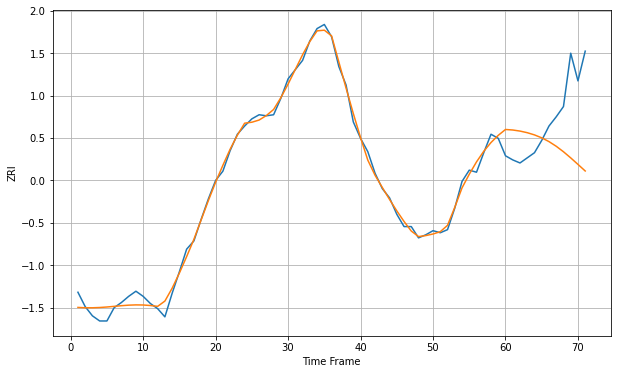

Wall time: 13.9 s
11226 5.820959530590561 55.57119273173357 [2050.64583953 2050.13490756 2049.0885626  2047.51591744 2045.35786753
 2042.50160378 2038.83073248 2034.29106448 2028.940112   2022.95804958
 2016.6129073  2010.19138214]

Got an mse at 0.0050 in round 208 and stopped training



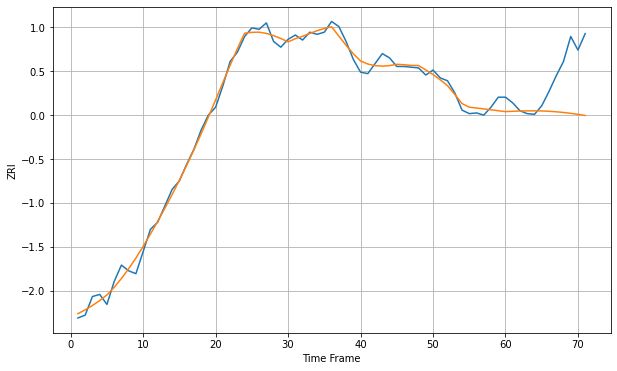

Wall time: 9.17 s
11228 8.65821115391583 59.04072500204106 [2090.82588172 2091.30705025 2091.67246176 2091.89039004 2091.92421715
 2091.73688892 2091.29835007 2090.59314201 2089.62517034 2088.41821857
 2087.01261077 2085.45937706]

Got an mse at 0.0050 in round 210 and stopped training



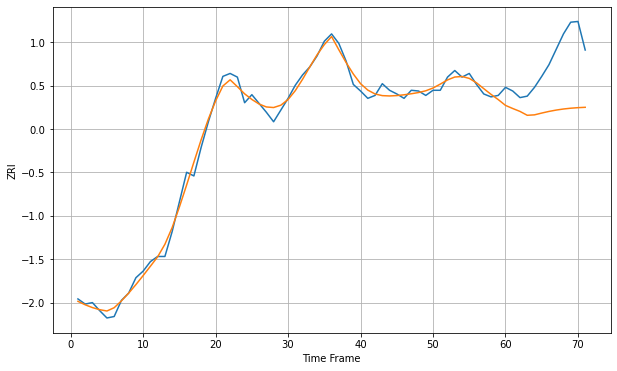

Wall time: 9.28 s
11229 8.30784440253318 71.54173598962248 [2052.35610589 2048.10395528 2044.13911035 2038.84986215 2039.44361402
 2041.88956461 2044.12371422 2045.98613064 2047.44207536 2048.5129951
 2049.25427851 2049.75464798]


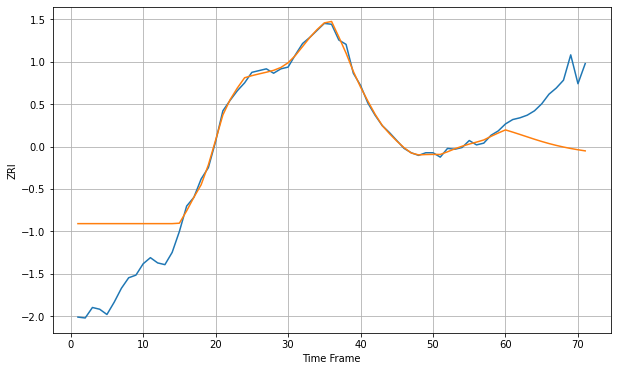

Wall time: 15.5 s
11230 37.511917792013726 60.98017738221635 [1963.15249787 1960.60900707 1957.93315143 1955.20034692 1952.47787654
 1949.90651242 1947.54537277 1945.42700392 1943.5547906  1941.90844886
 1940.45422608 1939.15455106]


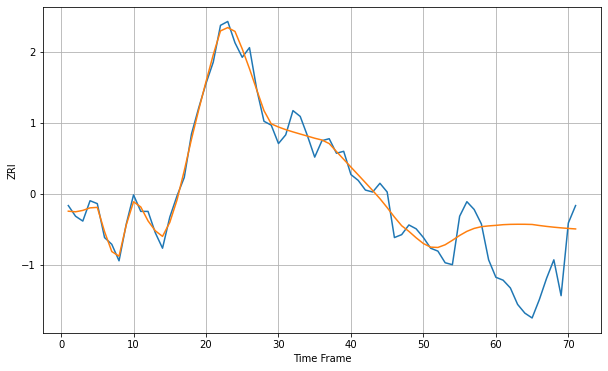

Wall time: 15.5 s
11231 12.121210478684802 64.78751129784278 [2759.57399579 2760.27975928 2760.6131374  2760.71527928 2760.68922488
 2760.49971954 2759.43369116 2758.49721651 2757.69080396 2757.00072974
 2756.40686204 2755.88801977]

Got an mse at 0.0050 in round 328 and stopped training



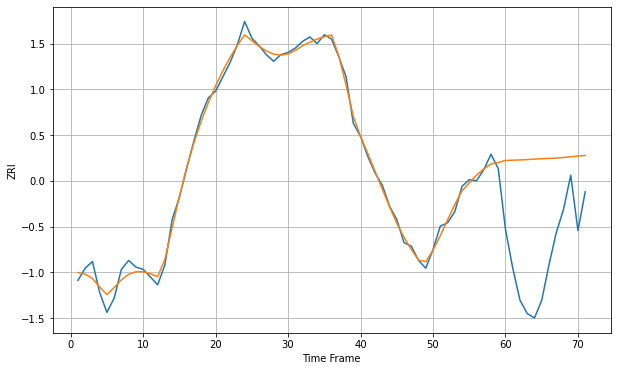

Wall time: 11.9 s
11232 5.804057837481057 94.77891726443362 [2149.42644734 2149.6164117  2149.84644409 2150.16578673 2150.5788454
 2150.96569631 2151.20181624 2151.45912888 2152.11665661 2152.74963553
 2153.34405416 2153.89342053]

Got an mse at 0.0050 in round 196 and stopped training



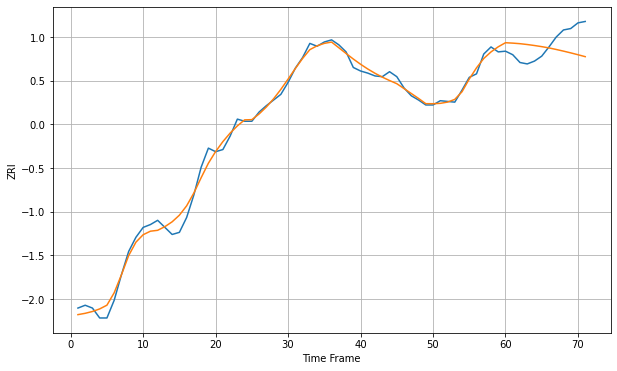

Wall time: 8.95 s
11233 8.671411945390782 28.020820505523375 [2324.96217601 2324.38905774 2323.59540005 2322.41574659 2321.01479585
 2319.41044153 2317.61152844 2315.42567505 2313.08963504 2310.60970223
 2307.9960321  2305.26663414]

Got an mse at 0.0050 in round 84 and stopped training



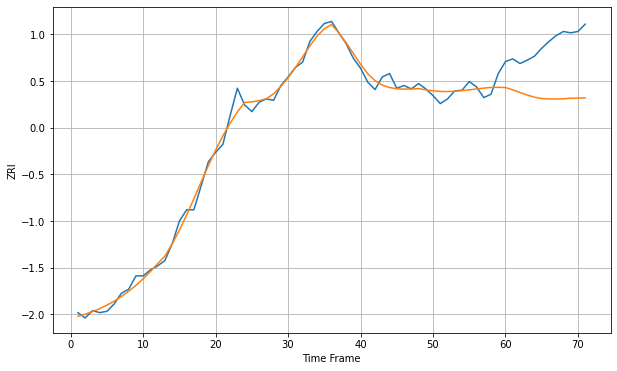

Wall time: 6.57 s
11234 9.86284985315828 79.60878356158803 [2059.13519111 2055.61461939 2051.6639426  2047.86567637 2044.56486882
 2042.60688904 2041.97902685 2041.84610175 2042.21051834 2043.08031449
 2043.14897031 2043.71246074]

Got an mse at 0.0050 in round 192 and stopped training



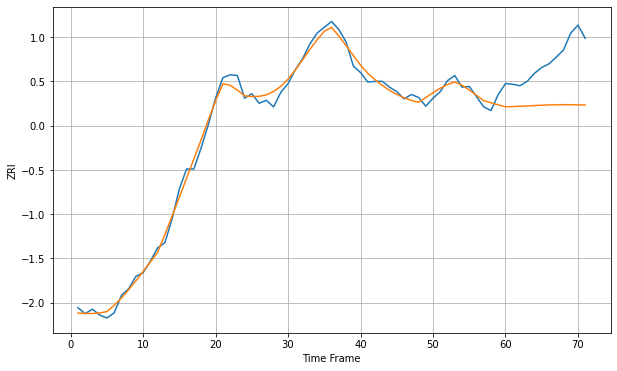

Wall time: 8.87 s
11235 8.514226132757056 65.42898113471723 [2080.20226074 2080.427434   2080.84554494 2081.36214084 2081.88938605
 2082.35816873 2082.72195483 2082.9553052  2083.04989747 2083.00998151
 2082.84826559 2082.58258624]

Got an mse at 0.0050 in round 361 and stopped training



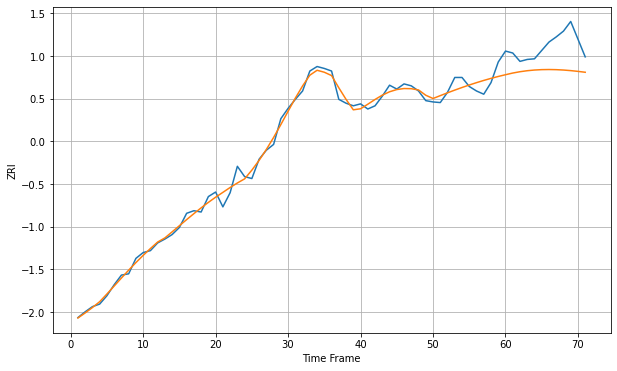

Wall time: 12.5 s
11236 9.366060895209003 41.87792107495946 [2103.27263582 2105.87280108 2107.93658169 2109.4886404  2110.55553357
 2111.16471115 2111.34482704 2111.12692757 2110.54600601 2109.64235366
 2108.46215658 2107.08992055]


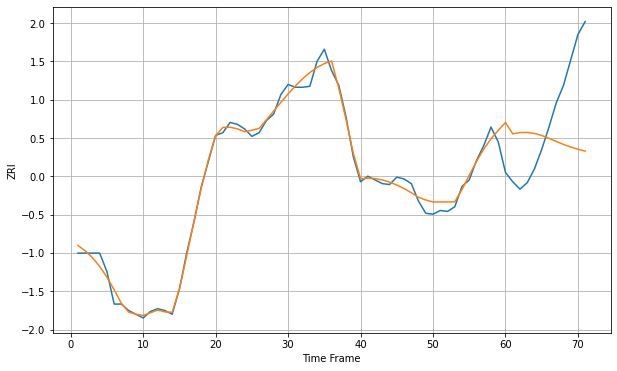

Wall time: 15.5 s
11237 7.099769040833487 72.81916375938668 [2470.9503093  2458.70146467 2460.0729633  2460.25998676 2459.18963974
 2456.95735472 2453.90160716 2450.52963081 2447.30169084 2444.46995924
 2442.0868098  2440.10038792]


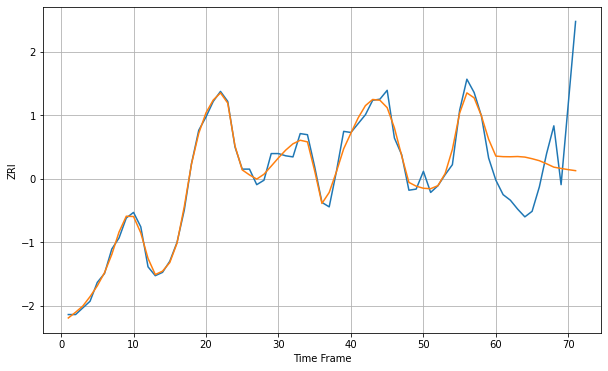

Wall time: 15.5 s
11238 6.538289352521241 53.58454333732232 [2724.71462453 2724.21953609 2724.13029951 2724.34850848 2723.84163047
 2722.36732516 2720.58772904 2717.81262689 2714.7740635  2713.598591
 2712.53429908 2711.60532634]

Got an mse at 0.0050 in round 211 and stopped training



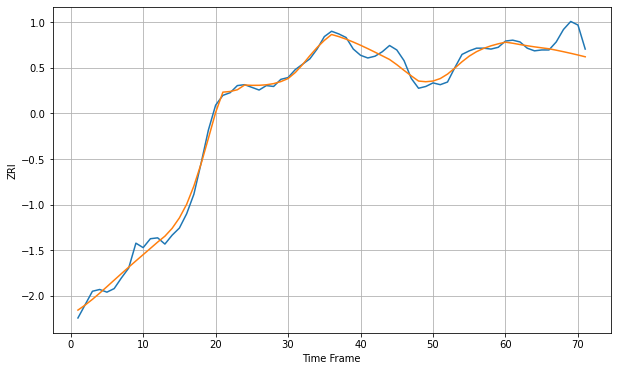

Wall time: 9.37 s
11354 7.208049499802631 16.46554590584502 [2122.7381169  2121.55505704 2120.0632688  2118.71856731 2117.49770271
 2116.37553428 2115.33156628 2113.73890996 2112.03383043 2110.23791612
 2108.33867359 2106.33045953]

Got an mse at 0.0050 in round 224 and stopped training



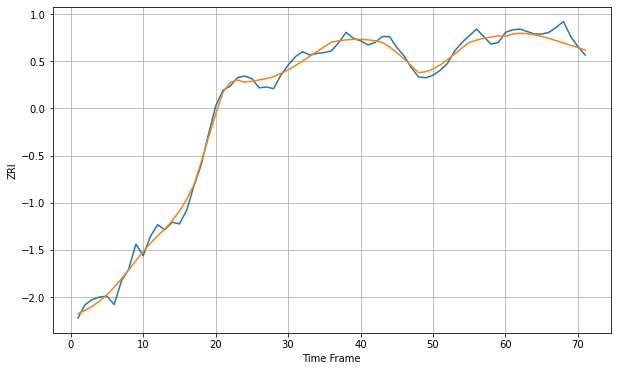

Wall time: 9.56 s
11355 7.9126249478708965 9.960749090828605 [2182.34508698 2185.04471026 2185.93251325 2185.50158597 2184.15061637
 2182.17789428 2179.79923021 2177.16932141 2174.3996636  2171.5716928
 2168.74577076 2165.96712276]

Got an mse at 0.0050 in round 183 and stopped training



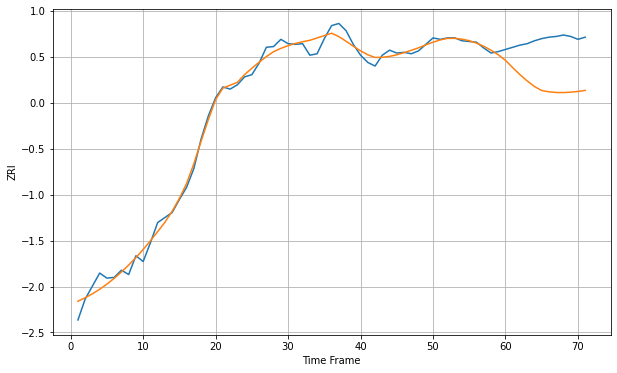

Wall time: 8.68 s
11356 8.992962702686816 64.13424218333427 [2186.82802486 2176.64659662 2167.02811197 2158.26966466 2150.62755832
 2144.99727457 2143.24397134 2142.3644532  2142.23710648 2142.73527734
 2143.74516458 2145.17484102]

Got an mse at 0.0050 in round 189 and stopped training



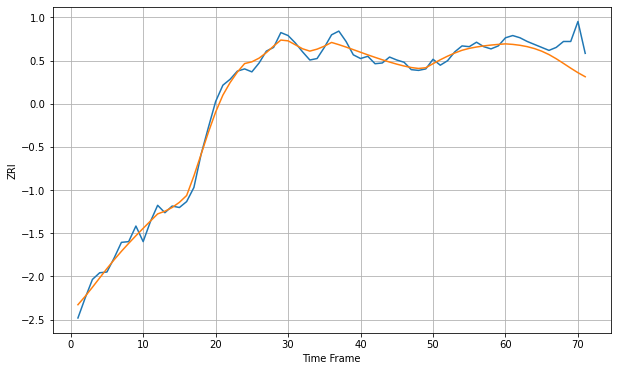

Wall time: 8.78 s
11357 8.180888055698697 26.8133644660972 [2224.76547904 2224.07170437 2222.85758606 2221.01708248 2218.41534978
 2214.89712483 2210.32917677 2204.7040276  2198.42623054 2192.00783715
 2185.89029603 2180.43721451]

Got an mse at 0.0050 in round 197 and stopped training



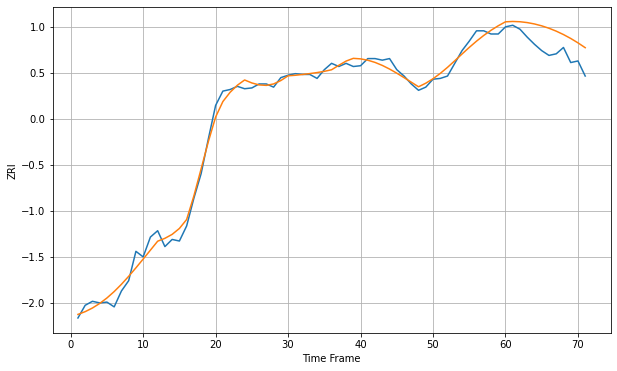

Wall time: 8.93 s
11358 8.119752131151346 24.319821420599403 [2225.35963564 2225.78786224 2225.43562256 2224.36949261 2222.63513126
 2220.25630379 2217.23994257 2213.58425538 2209.28779028 2204.35836958
 2198.8212495  2192.72568819]

Got an mse at 0.0050 in round 135 and stopped training



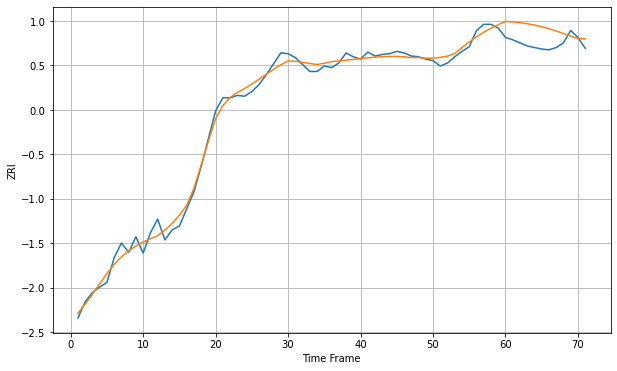

Wall time: 7.61 s
11360 8.076776019683912 21.803693371667592 [2294.69686997 2294.11489228 2293.16323891 2291.81507685 2290.05173244
 2287.86892165 2285.28550098 2282.35165224 2279.14938742 2275.77854925
 2272.85150432 2272.18378922]

Got an mse at 0.0050 in round 68 and stopped training



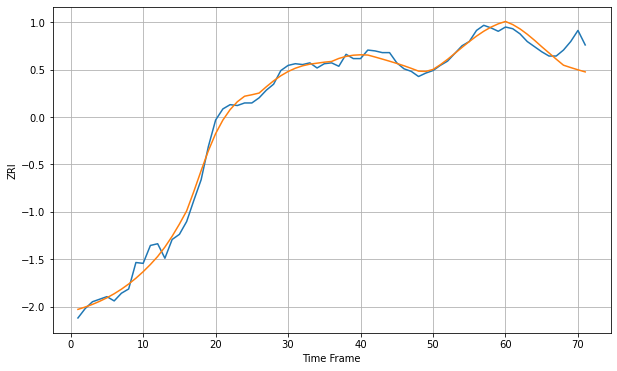

Wall time: 6.13 s
11361 7.822023684783941 19.719543697755057 [2215.50812164 2211.86533248 2206.82066968 2200.55479528 2193.49997887
 2185.92416101 2178.65673926 2171.32977152 2164.26882982 2161.48317197
 2158.84423413 2156.39273152]

Got an mse at 0.0050 in round 159 and stopped training



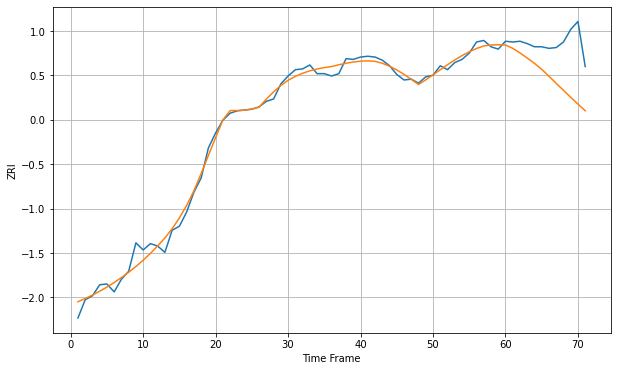

Wall time: 8.17 s
11364 7.9202497796564595 50.305034183631435 [2247.15468221 2243.05976347 2237.16485852 2230.77262353 2224.00040995
 2216.44117282 2207.6314476  2198.7296744  2189.85619719 2181.09166422
 2172.48395637 2164.06273149]

Got an mse at 0.0050 in round 166 and stopped training



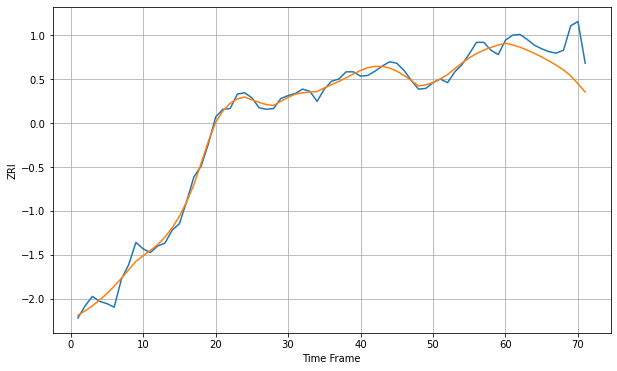

Wall time: 8.27 s
11365 8.603106698331732 36.697791748937874 [2235.81765151 2233.27941806 2230.21706613 2226.16656615 2221.61116462
 2216.60970932 2211.15442283 2205.19480166 2198.65883614 2190.39809624
 2179.36460398 2167.82287718]

Got an mse at 0.0050 in round 191 and stopped training



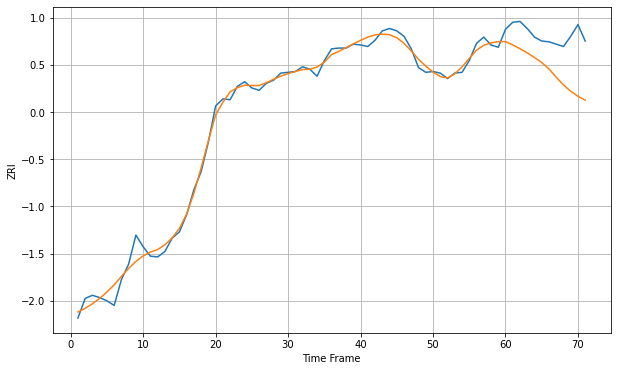

Wall time: 8.82 s
11366 8.504368005401075 49.26652298098696 [2211.25047352 2207.01696227 2202.21377918 2196.8398718  2190.90595383
 2184.46837115 2176.33447205 2165.68476439 2155.92281083 2147.78087594
 2141.37564098 2136.55665862]

Got an mse at 0.0049 in round 96 and stopped training



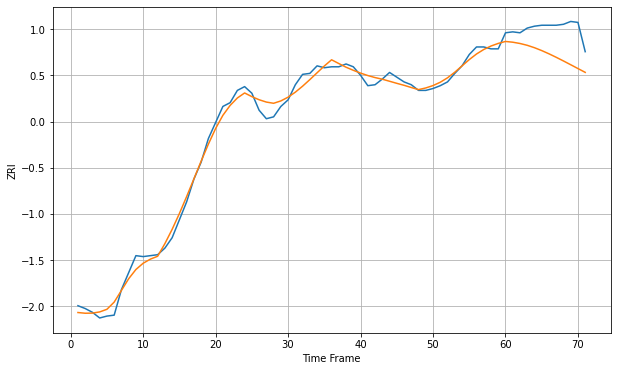

Wall time: 6.75 s
11367 6.845368823512291 29.509550329556056 [2069.82480773 2069.04187998 2067.67947174 2065.75411851 2063.20586959
 2060.16007264 2056.74645688 2053.05201359 2049.16608203 2045.16944996
 2041.1284655  2037.09576506]

Got an mse at 0.0049 in round 73 and stopped training



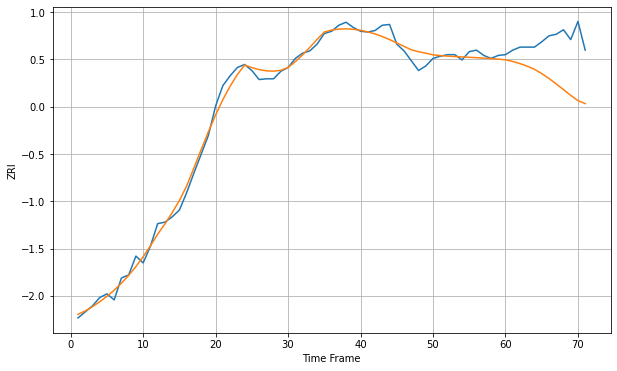

Wall time: 6.27 s
11368 8.755969755929227 57.25568051022737 [2206.28388843 2203.99177388 2201.17070517 2197.73219811 2193.57356173
 2187.92172236 2181.44491377 2174.26825722 2166.65182268 2159.07143302
 2152.04308601 2148.14757648]

Got an mse at 0.0050 in round 121 and stopped training



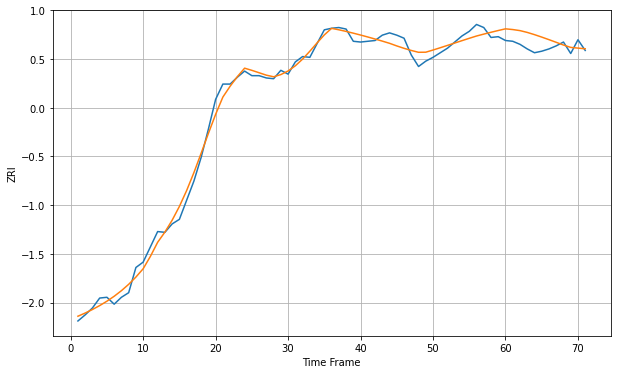

Wall time: 7.26 s
11369 8.980307990997792 14.526516256647687 [2260.27559131 2259.35066377 2257.9512338  2255.60790227 2252.68142451
 2249.48178267 2246.1104317  2242.63369737 2239.07993931 2235.99921084
 2235.07230878 2234.19379603]

Got an mse at 0.0050 in round 338 and stopped training



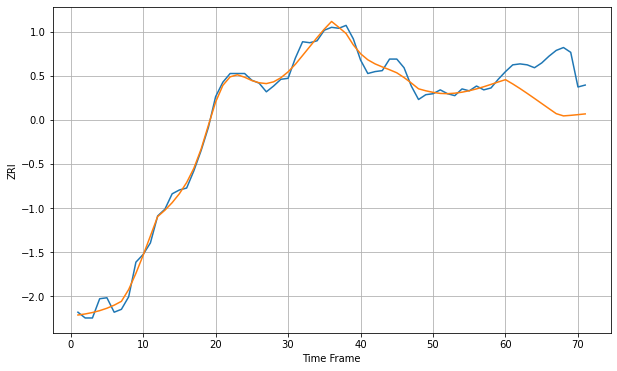

Wall time: 11.9 s
11370 6.450870963838125 43.91208187890427 [2153.60877293 2149.16828874 2144.3846651  2139.32083685 2134.10413092
 2128.81560808 2123.523887   2118.28718743 2115.95846548 2116.54015668
 2117.26255921 2118.03130932]

Got an mse at 0.0050 in round 212 and stopped training



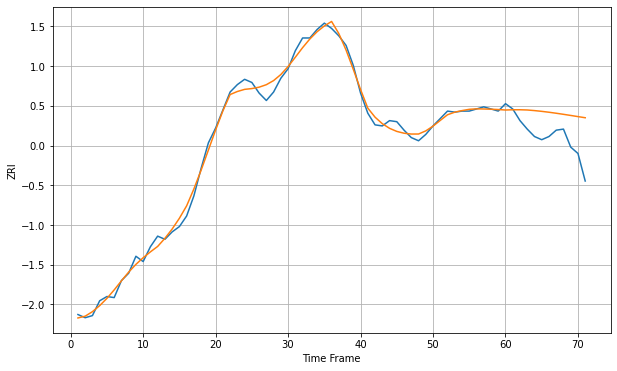

Wall time: 9.3 s
11372 5.284591336839525 26.500939353701526 [1984.01495665 1984.24020491 1984.26030741 1984.04051994 1983.47006697
 1982.75121289 1981.90941522 1980.96856812 1979.95230498 1978.88656278
 1977.80096068 1976.72634915]

Got an mse at 0.0050 in round 270 and stopped training



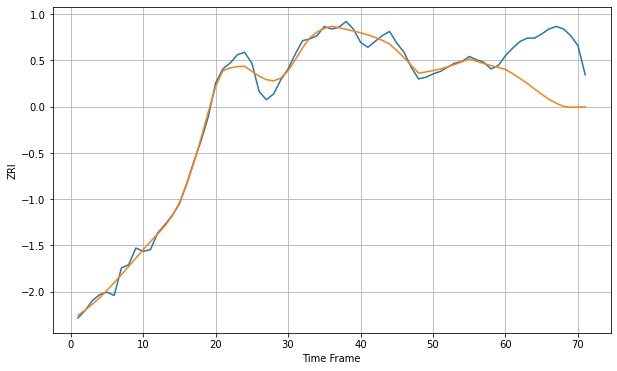

Wall time: 10.5 s
11373 7.832638128070629 66.90333254246191 [2145.43242837 2140.20960358 2134.6378117  2128.56037831 2122.03897294
 2115.49264685 2109.59424718 2104.78357778 2101.02099221 2100.10552189
 2100.22354011 2100.38943474]

Got an mse at 0.0050 in round 192 and stopped training



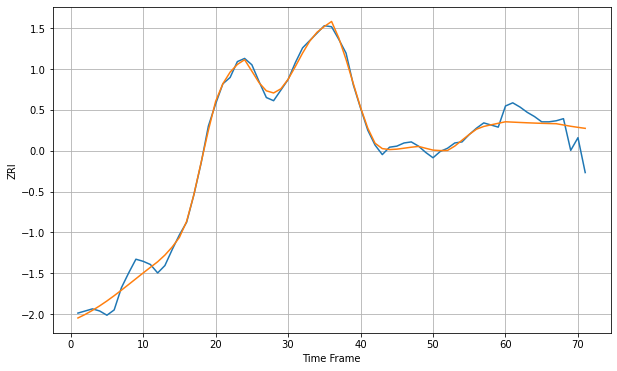

Wall time: 8.84 s
11374 5.435043229990906 16.634511859708102 [2002.06380318 2001.73159198 2001.4053887  2001.10106045 2000.82918221
 2000.59467871 2000.39701592 2000.2308354  1999.02510794 1997.81268292
 1996.78616712 1995.83884288]

Got an mse at 0.0049 in round 171 and stopped training



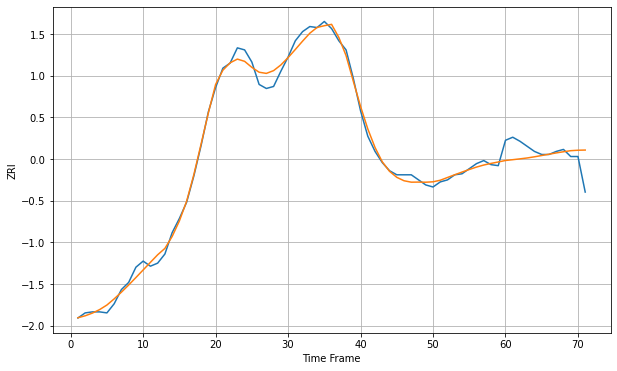

Wall time: 8.45 s
11375 5.716857048523337 16.161157780729273 [1988.09181691 1988.87620286 1989.69880258 1990.58074359 1991.71986577
 1992.99568146 1994.28455295 1995.53470269 1996.69978069 1997.74798853
 1998.20217691 1998.36125394]

Got an mse at 0.0050 in round 204 and stopped training



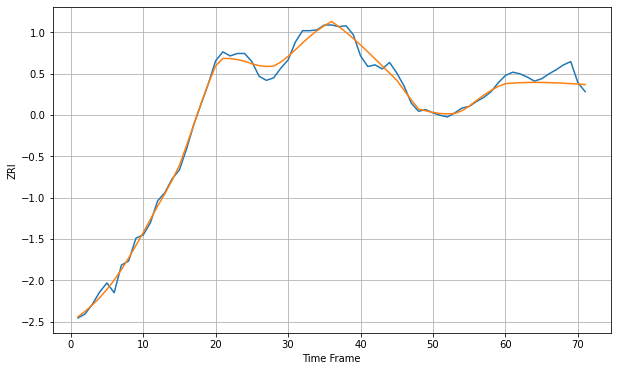

Wall time: 9.11 s
11377 7.168790189240509 13.425193539079439 [2131.95784148 2132.60836916 2133.08697418 2133.3735331  2133.4719529
 2133.40263105 2133.19293412 2132.86985467 2132.45598598 2131.96844979
 2131.41961961 2130.81845059]

Got an mse at 0.0050 in round 266 and stopped training



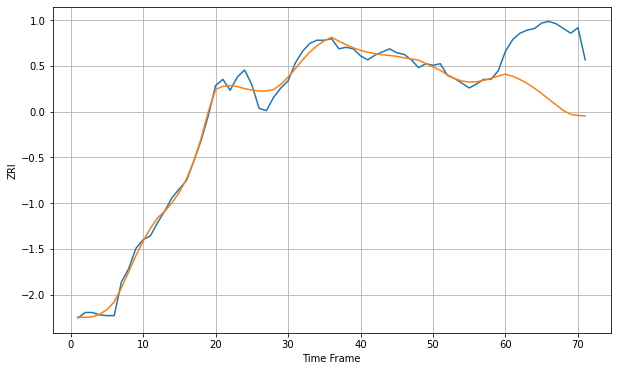

Wall time: 10.5 s
11378 8.245531710577135 84.35960000309551 [2131.65626233 2128.89788845 2124.79463933 2119.77316377 2113.64685434
 2106.75091925 2099.3778556  2092.26248275 2085.13763437 2080.13655975
 2078.92422853 2078.21411337]

Got an mse at 0.0050 in round 283 and stopped training



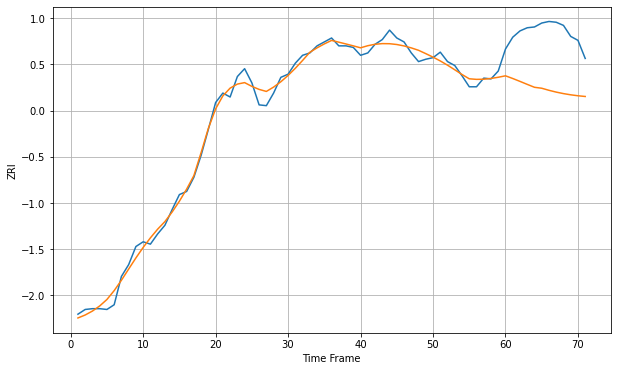

Wall time: 10.9 s
11379 8.261181127219677 71.76130589584957 [2113.92588428 2110.52432911 2106.84043933 2103.05997943 2099.34644646
 2098.15269671 2095.50950136 2093.22645788 2091.32351867 2089.78693397
 2088.58349585 2087.66765682]


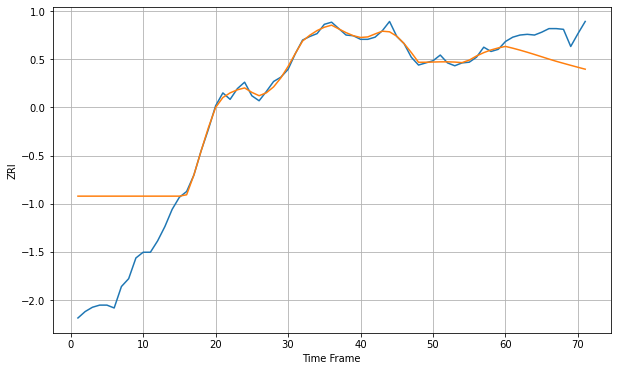

Wall time: 15.4 s
11385 59.16456776944974 37.456064162554156 [2165.07197016 2162.61707746 2159.88293296 2156.92867059 2153.81569157
 2150.60498961 2147.35301247 2144.25780808 2141.41095371 2138.6132655
 2135.8767273  2133.20441644]

Got an mse at 0.0050 in round 125 and stopped training



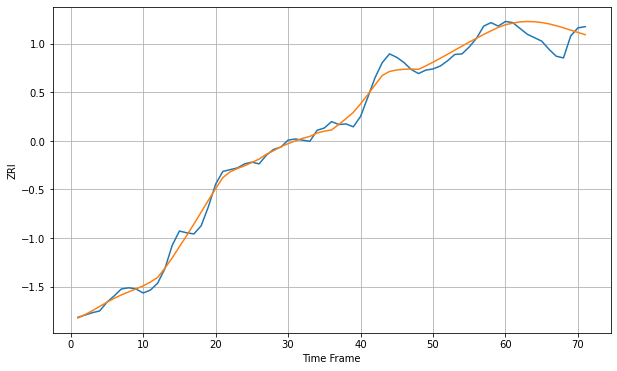

Wall time: 7.4 s
11412 11.789407381163802 29.137390571029027 [2209.36072614 2212.13571522 2214.29356095 2214.90291694 2214.52896745
 2213.14880646 2210.81968298 2207.69417362 2204.00788716 2200.0357869
 2196.03305649 2192.18769482]

Got an mse at 0.0050 in round 75 and stopped training



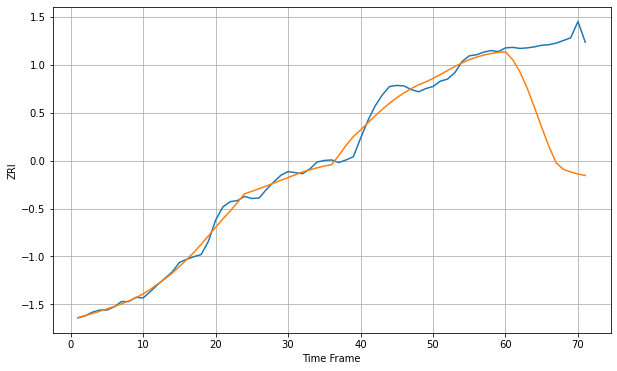

Wall time: 6.34 s
11413 12.7629418562624 183.77125386317192 [2233.53608034 2218.54296119 2195.39186565 2164.59615403 2128.21629891
 2090.54539637 2054.13965474 2023.43145365 2010.98992626 2006.17622305
 2002.39965134 1999.60810039]

Got an mse at 0.0050 in round 66 and stopped training



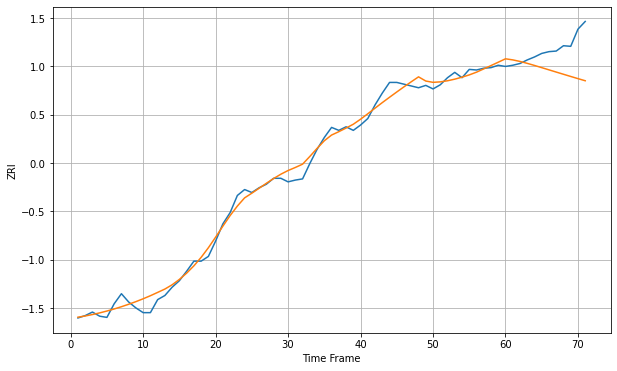

Wall time: 5.96 s
11414 11.381204984322919 45.84403473428389 [2204.91473044 2203.0973111  2200.45183388 2197.23349616 2193.68074245
 2189.97885385 2186.23814479 2182.50147052 2178.77802761 2175.07804113
 2171.4230284  2167.83324621]

Got an mse at 0.0050 in round 88 and stopped training



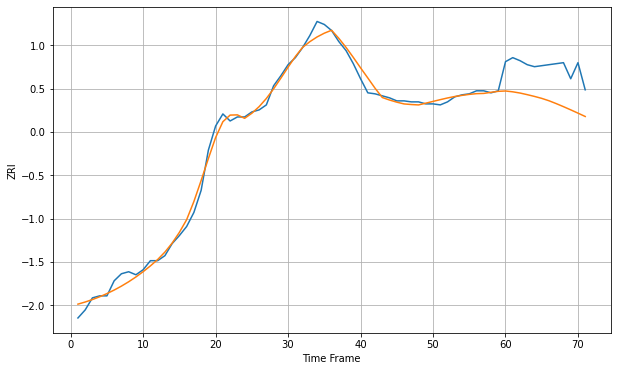

Wall time: 6.67 s
11415 6.061999508315544 35.14954984968106 [1920.8336652  1920.0070157  1918.79830333 1917.18021454 1915.42455958
 1913.48537603 1911.10880567 1908.27720144 1905.24222197 1902.06850952
 1898.79869035 1895.46953487]

Got an mse at 0.0050 in round 81 and stopped training



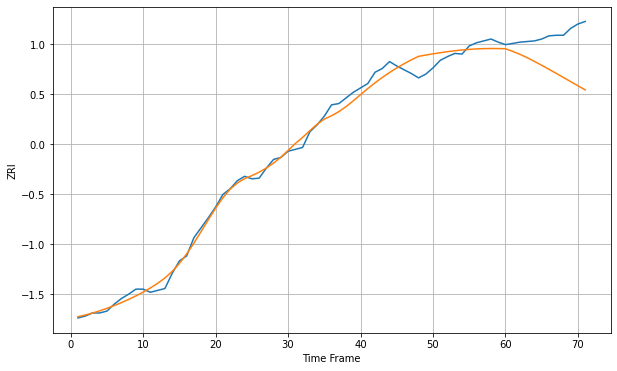

Wall time: 6.46 s
11416 11.165019695207464 60.571604635231914 [2167.49988924 2163.23266878 2158.53545997 2153.15559988 2147.22110682
 2141.06106046 2134.70780905 2128.20613888 2121.61069253 2114.98160103
 2108.38010627 2101.86539542]

Got an mse at 0.0048 in round 42 and stopped training



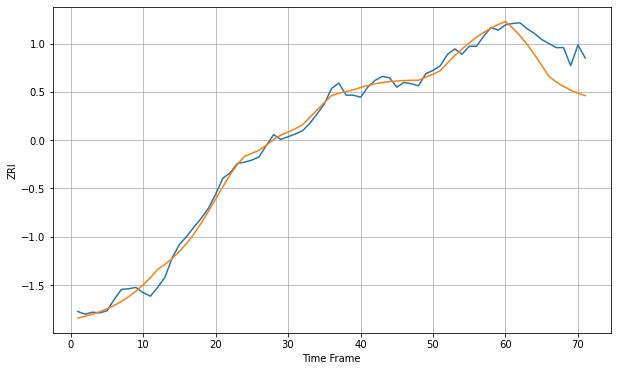

Wall time: 5.57 s
11417 9.858572140128809 42.396524509283665 [2129.00372361 2119.17877131 2107.67387001 2094.43440007 2079.56898201
 2063.48707349 2046.81773658 2038.68888362 2032.1633014  2026.47535169
 2021.80050053 2018.33596515]

Got an mse at 0.0050 in round 70 and stopped training



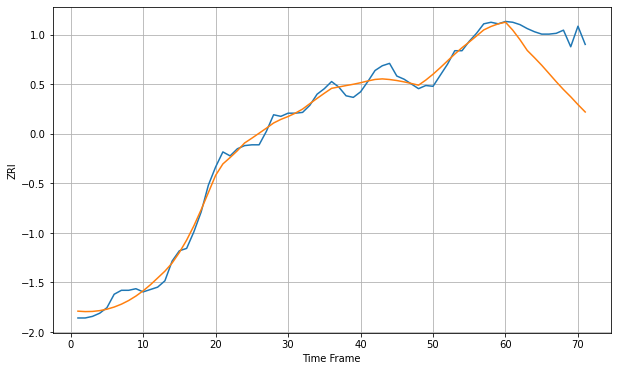

Wall time: 6.31 s
11418 8.786739974765174 55.42129916073143 [2080.08725753 2070.03440512 2057.91765218 2044.37939487 2035.18561424
 2025.58957957 2015.24120099 2004.80840772 1994.88624022 1985.73993715
 1975.8553676  1966.51795504]

Got an mse at 0.0050 in round 78 and stopped training



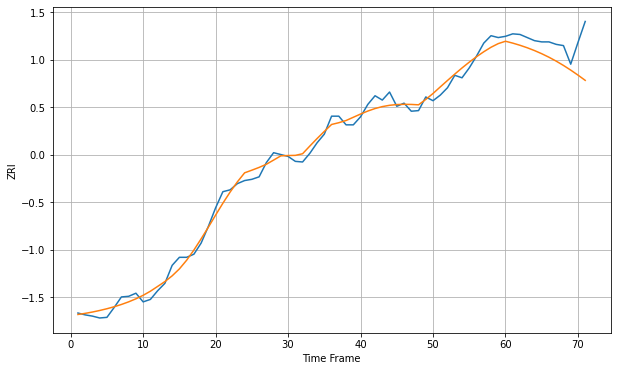

Wall time: 6.34 s
11419 10.764069311795865 36.25605671250572 [2176.04147928 2173.02412577 2169.52888554 2165.52933339 2160.99578062
 2155.89674859 2150.20258571 2143.89176708 2136.95990882 2129.43048127
 2121.36465666 2112.86629188]

Got an mse at 0.0050 in round 35 and stopped training



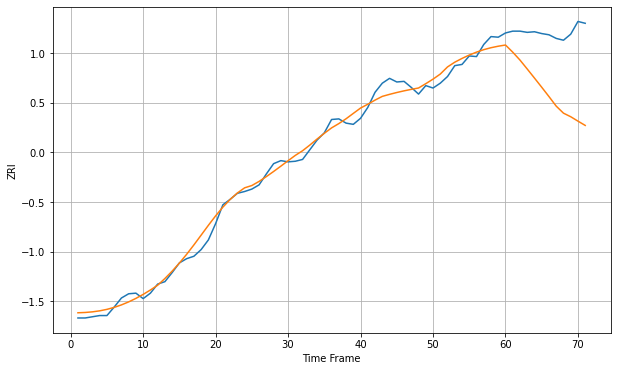

Wall time: 5.42 s
11420 11.521516620262217 105.29110838428639 [2161.06823773 2149.24530831 2136.18125023 2121.42206463 2106.42069864
 2091.27395081 2075.85680507 2060.06202723 2048.4688626  2042.55646835
 2035.2741972  2028.19863303]

Got an mse at 0.0049 in round 73 and stopped training



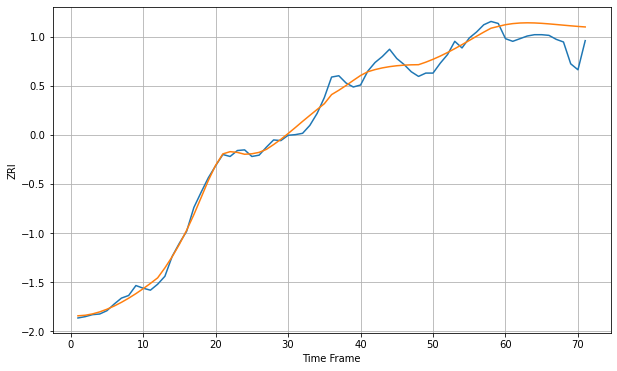

Wall time: 6.26 s
11421 10.280949563310305 31.881524669632952 [2154.1436652  2155.76141054 2156.67332226 2156.9681835  2156.76003945
 2156.17694575 2155.34783153 2154.38905074 2153.39305551 2152.42173635
 2151.50579564 2150.7133174 ]

Got an mse at 0.0050 in round 104 and stopped training



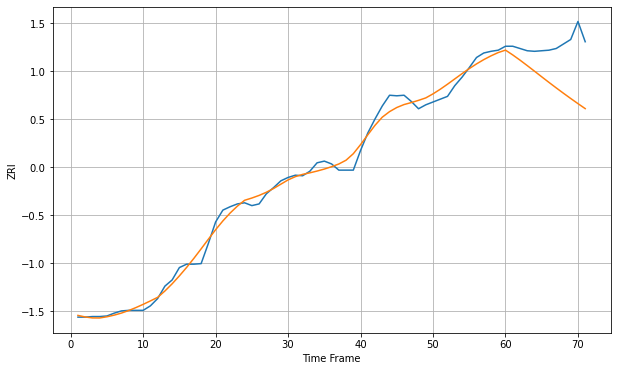

Wall time: 6.94 s
11422 12.01464053554695 74.71992904653919 [2222.11311805 2213.57566369 2204.34600241 2194.65526663 2184.71024258
 2174.70123129 2164.78223546 2155.04385701 2145.51545576 2136.19677888
 2127.09152959 2118.22448983]

Got an mse at 0.0050 in round 128 and stopped training



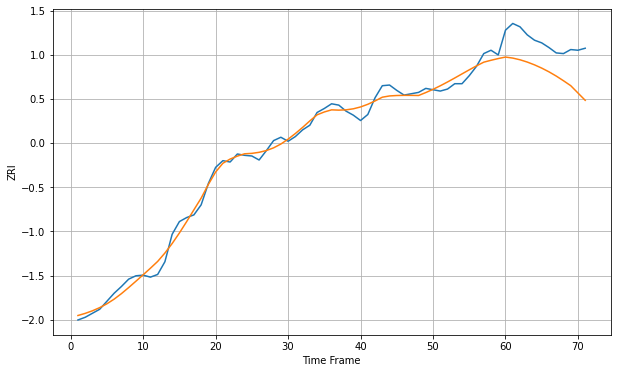

Wall time: 7.48 s
11423 9.263162535889789 48.604042080504904 [2065.817814   2064.286964   2061.75013491 2058.34130877 2054.16808151
 2049.29368056 2043.72672474 2037.42886977 2030.42866143 2023.07587457
 2012.10822935 2001.18331239]

Got an mse at 0.0050 in round 264 and stopped training



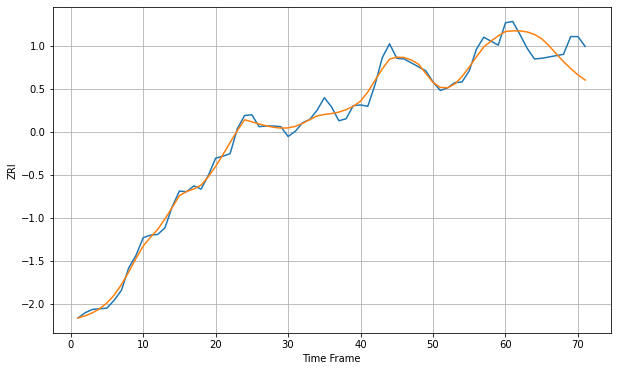

Wall time: 10.4 s
11426 9.2150990408971 31.7510622762574 [2150.80109423 2151.76159088 2151.65841164 2150.04141847 2146.24916761
 2139.64586322 2129.27847059 2116.82466326 2104.9909714  2094.3676404
 2084.84505082 2076.81093269]

Got an mse at 0.0050 in round 219 and stopped training



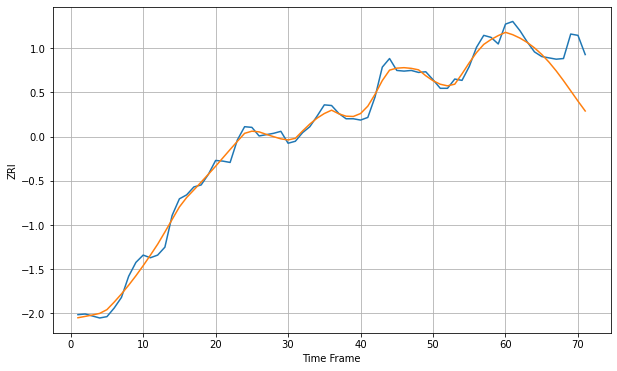

Wall time: 9.24 s
11427 9.416646599889326 47.16214224546447 [2166.54591273 2162.99314038 2157.84419214 2151.25745678 2143.0919456
 2133.21853543 2121.57920142 2108.27853369 2093.64625536 2078.2185317
 2062.66971119 2047.73193366]

Got an mse at 0.0050 in round 310 and stopped training



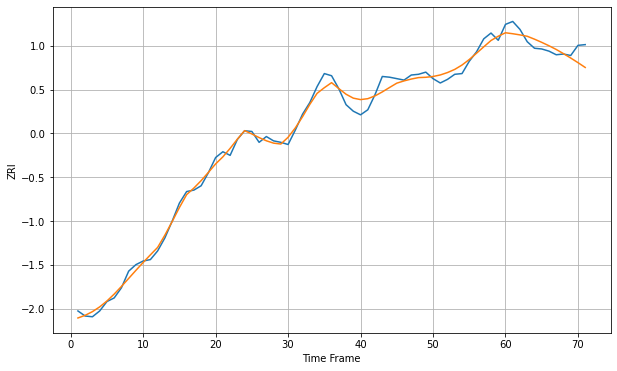

Wall time: 11.5 s
11428 8.510072569374143 14.33283055298063 [2069.38840692 2068.04539599 2066.43797191 2064.54033332 2060.53306613
 2056.14856774 2051.43209903 2046.32843076 2040.54432286 2034.47119834
 2028.10751237 2021.44820024]

Got an mse at 0.0050 in round 162 and stopped training



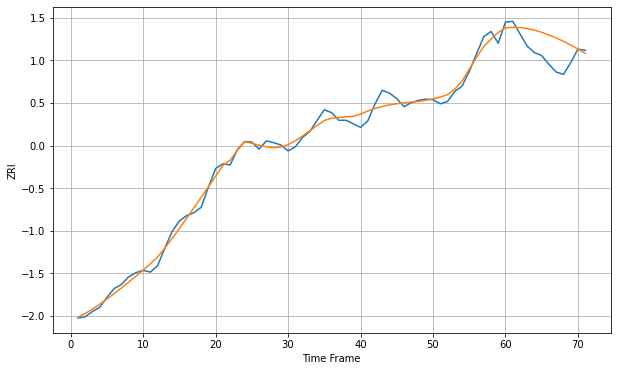

Wall time: 8.22 s
11429 10.214041269454704 34.40311547093939 [2149.04911493 2150.00590952 2149.63906551 2148.02178746 2145.28254508
 2141.58735744 2137.10432457 2131.96453823 2126.24164866 2119.96700325
 2113.17786668 2105.97270155]

Got an mse at 0.0049 in round 52 and stopped training



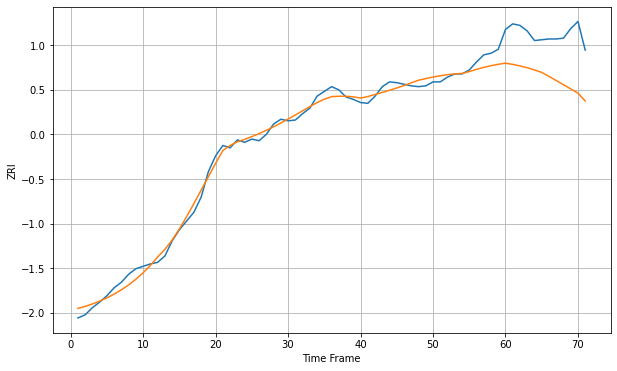

Wall time: 5.83 s
11432 7.745810021125669 56.67764409823441 [1973.54536017 1972.02129749 1970.11289502 1967.78813579 1965.02327737
 1961.90344286 1956.9269684  1951.65776033 1946.40122135 1941.2202429
 1935.84908574 1925.91689368]

Got an mse at 0.0049 in round 80 and stopped training



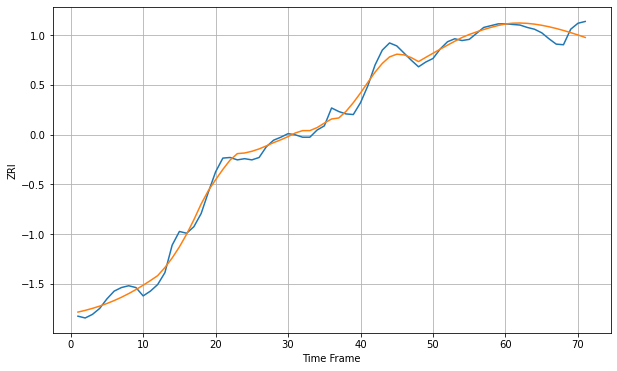

Wall time: 6.43 s
11433 11.674162929775662 16.062037985787736 [2207.80716897 2209.10846203 2209.39955493 2208.83083336 2207.53041386
 2205.60463639 2203.14364202 2200.22544875 2196.9179257  2193.27998526
 2189.3629404  2185.21224955]

Got an mse at 0.0050 in round 53 and stopped training



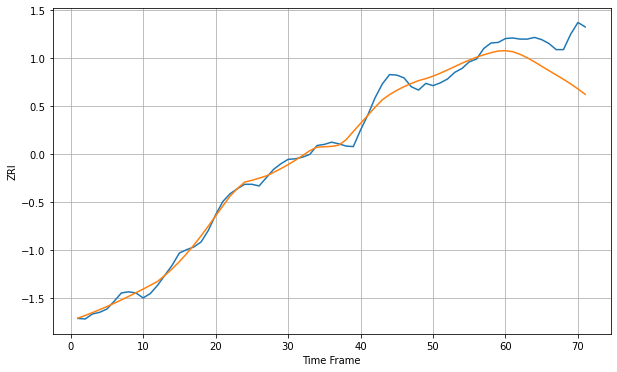

Wall time: 5.81 s
11434 12.131878910405398 65.72189084273029 [2173.12553366 2171.21413621 2166.53031066 2160.32104888 2152.90494386
 2144.96907364 2137.05852427 2129.30489517 2121.45643116 2113.13272035
 2104.08552413 2094.37130859]

Got an mse at 0.0047 in round 38 and stopped training



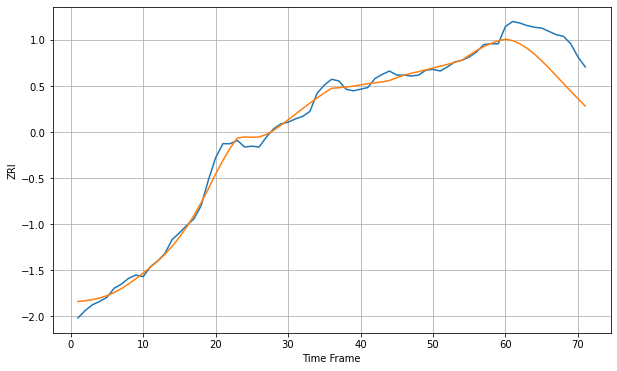

Wall time: 5.49 s
11435 7.39134275461935 41.438968306855955 [1996.6109577  1994.73668659 1990.91856136 1985.38507406 1978.42528282
 1970.3619528  1961.53169908 1952.26348161 1942.85466074 1933.55603627
 1924.50880492 1915.68834733]

Got an mse at 0.0050 in round 168 and stopped training



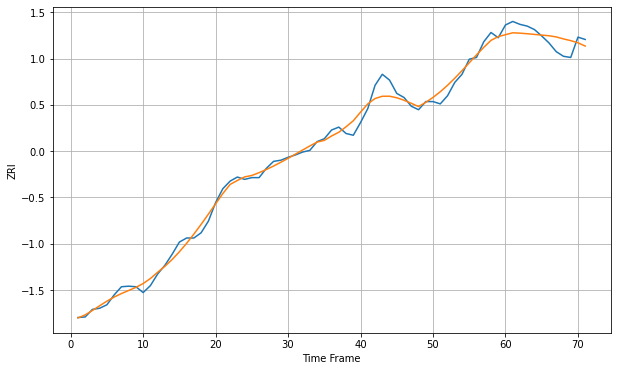

Wall time: 8.31 s
11436 11.167902901164338 18.013600275892095 [2123.2510006  2126.48045016 2125.8693308  2124.85215757 2123.71232785
 2122.56242676 2121.38166189 2119.39653588 2115.9365048  2112.98325149
 2109.25272336 2103.6033356 ]

Got an mse at 0.0050 in round 92 and stopped training



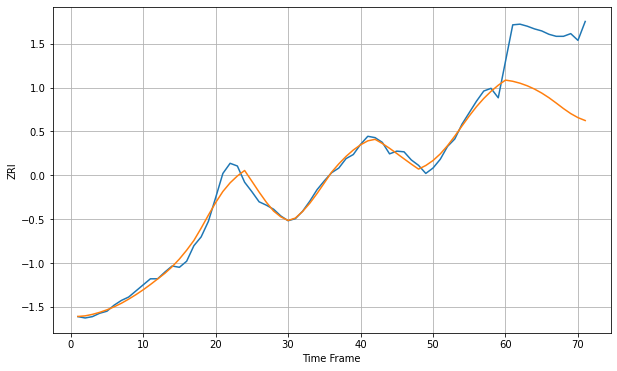

Wall time: 6.71 s
11542 9.140370067574699 99.25136356662532 [2372.18220845 2370.44470531 2367.61335262 2363.77033272 2358.91485994
 2353.00399536 2346.07070446 2338.20366705 2330.05006054 2322.62392664
 2316.62066639 2312.31288521]


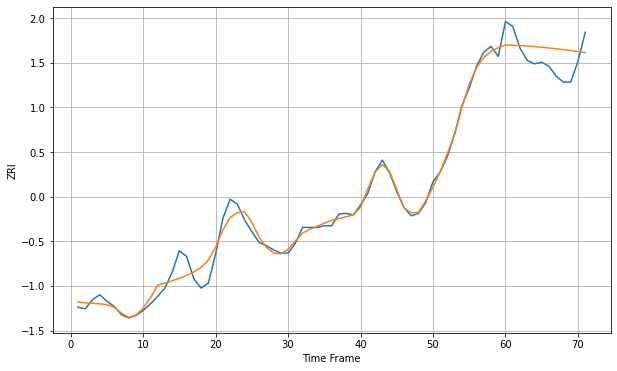

Wall time: 15.6 s
11550 9.574220462020119 25.285369147038395 [2259.55342647 2259.36361777 2258.96108826 2258.40603667 2257.72866838
 2256.94468691 2256.06695303 2255.10572566 2254.06886232 2252.96200822
 2251.78879023 2250.55102052]

Got an mse at 0.0050 in round 105 and stopped training



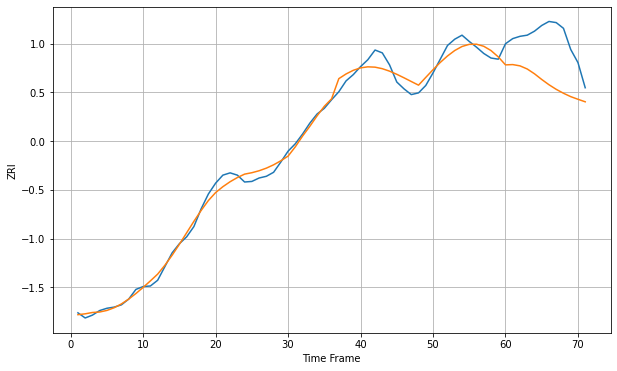

Wall time: 6.97 s
11561 11.965518796871574 78.78630787042792 [2462.03064798 2462.52610672 2460.27969037 2454.81475621 2446.40397332
 2436.45470699 2427.24817114 2419.19493886 2412.34214389 2406.42761898
 2401.81578359 2397.37873494]

Got an mse at 0.0050 in round 256 and stopped training



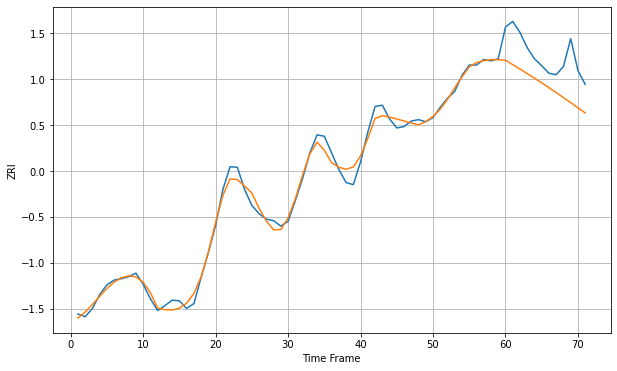

Wall time: 10 s
11563 9.326662262503573 48.37920657044313 [2288.96899019 2282.61876256 2276.1615801  2269.61823999 2262.95977285
 2256.15695587 2249.19975249 2242.09648234 2234.86693784 2227.53728373
 2220.13944101 2212.71441493]

Got an mse at 0.0050 in round 277 and stopped training



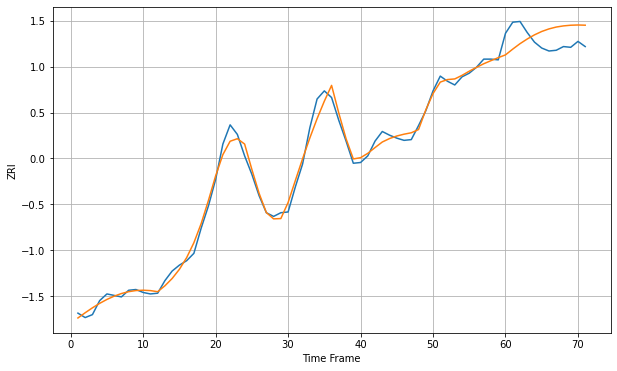

Wall time: 10.8 s
11580 8.72965964274287 26.86413839124137 [2214.76799853 2222.5621943  2229.90145607 2236.26092182 2241.86840798
 2246.4447184  2249.93278607 2252.44892801 2253.99562336 2254.90306871
 2255.23157621 2254.93642529]

Got an mse at 0.0050 in round 305 and stopped training



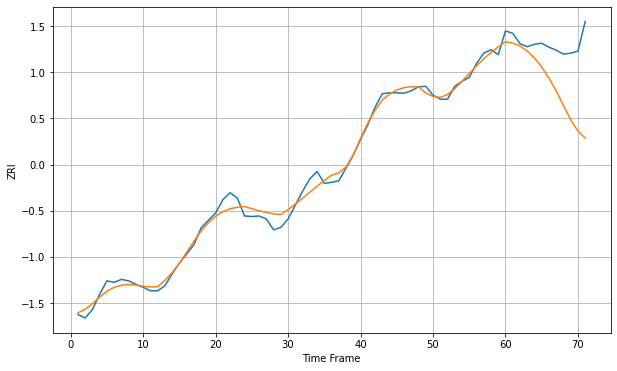

Wall time: 11.2 s
11590 13.130585467504927 102.20059099059247 [2588.01627596 2585.45364797 2579.41047278 2569.42369815 2555.24422511
 2536.86242136 2514.4060393  2488.24758754 2459.48761542 2430.04810405
 2407.36762187 2393.47051133]

Got an mse at 0.0050 in round 73 and stopped training



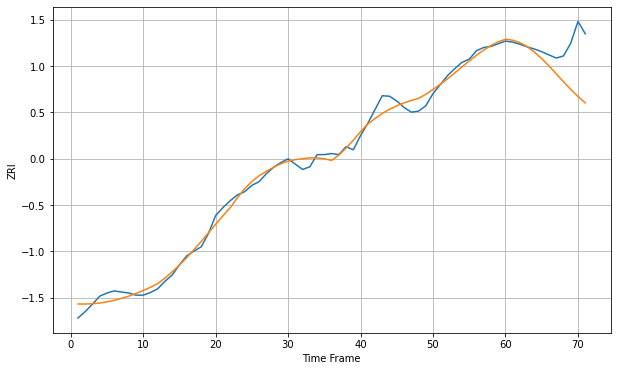

Wall time: 6.28 s
11691 12.189121738675459 63.599238550856334 [2216.55917135 2214.60600313 2210.02026125 2202.60238173 2192.19395772
 2179.90426873 2166.06210457 2151.28256621 2136.33429538 2121.92652892
 2108.56544405 2096.52931938]

Got an mse at 0.0050 in round 101 and stopped training



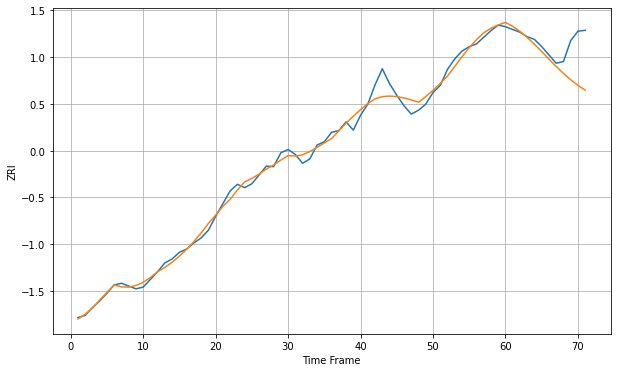

Wall time: 6.87 s
11692 11.893455344355992 47.54356530498558 [2215.73533345 2208.61657196 2199.47162918 2188.56236657 2176.25968958
 2163.04022887 2149.46407873 2136.11784958 2123.53016669 2112.0927061
 2102.02171505 2093.36827128]

Got an mse at 0.0050 in round 135 and stopped training



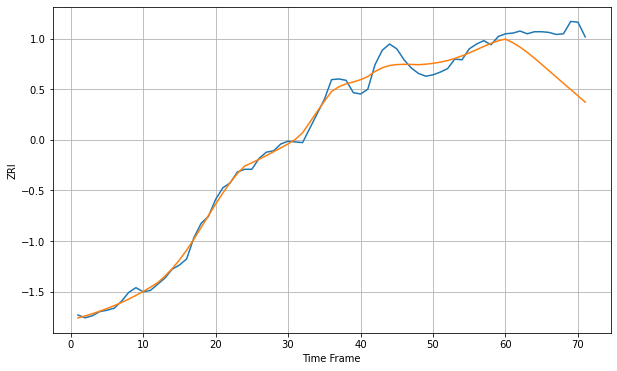

Wall time: 7.65 s
11694 10.394161363300054 63.31509755667929 [2151.22573321 2146.06538325 2139.55054371 2131.85520397 2123.3005958
 2114.27302897 2105.05014816 2095.82137038 2086.66284086 2077.55102216
 2068.40519731 2059.14378195]

Got an mse at 0.0050 in round 237 and stopped training



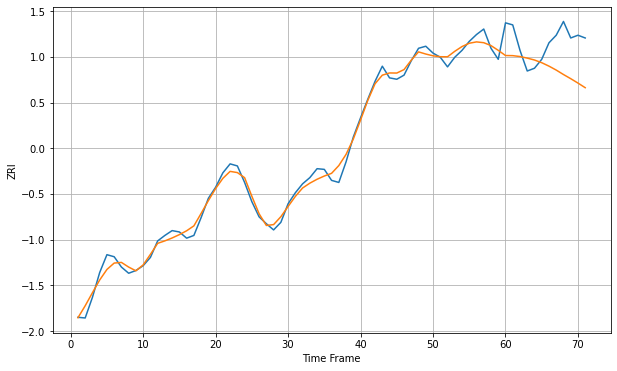

Wall time: 9.84 s
11758 9.359589413707356 48.375194660086876 [2414.49582032 2414.31702286 2413.01585912 2410.74728349 2407.96192225
 2404.04349889 2399.06024385 2393.33742864 2386.87549146 2380.82962547
 2374.44817895 2367.72631171]

Got an mse at 0.0050 in round 382 and stopped training



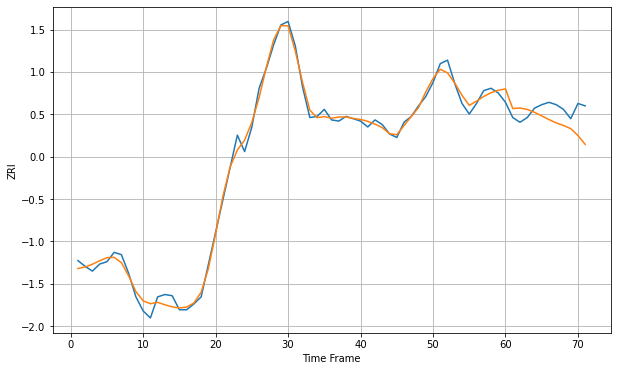

Wall time: 13 s
12047 5.080572141469076 15.91491421120989 [1142.46862174 1125.68859139 1126.18947447 1124.92207629 1122.47729377
 1119.42941999 1116.26376278 1113.47869932 1111.26303451 1108.54728527
 1102.65413754 1095.10243082]

Got an mse at 0.0050 in round 348 and stopped training



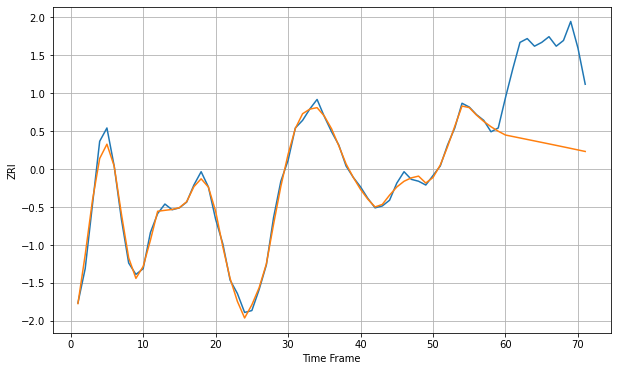

Wall time: 12.2 s
12180 2.80103086388456 49.8590444971851 [998.28600612 997.51499917 996.7415776  995.96692677 995.19059259
 994.41207577 993.63086978 992.84594678 992.05569299 991.25868876
 990.4552671  989.64958816]

Got an mse at 0.0050 in round 240 and stopped training



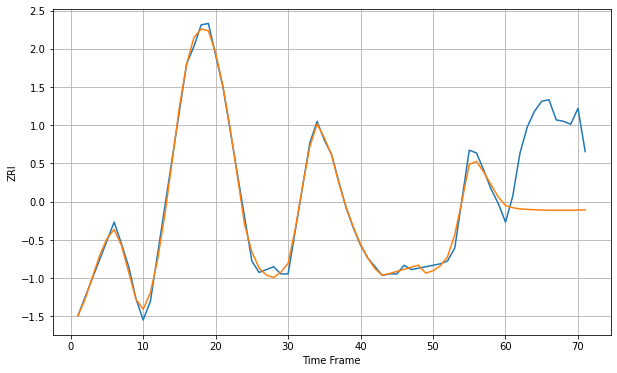

Wall time: 9.85 s
12182 3.724019827271356 57.18152603500782 [990.51303193 988.99399739 988.14951431 987.81407727 987.55820202
 987.37603774 987.26114499 987.20672542 987.20584822 987.25162951
 987.33734054 987.45644237]

Got an mse at 0.0050 in round 210 and stopped training



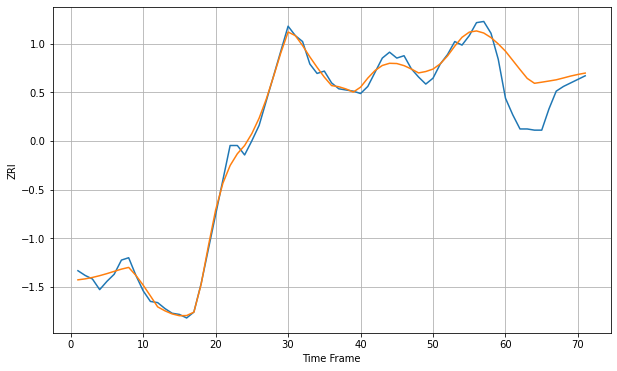

Wall time: 9.1 s
12189 5.7843655639382225 31.68547392726319 [1135.80087141 1128.06672889 1120.32210756 1112.79895711 1108.65723751
 1109.5970777  1110.58569816 1111.61481475 1113.17829009 1114.7989024
 1116.15589535 1117.31027543]

Got an mse at 0.0050 in round 439 and stopped training



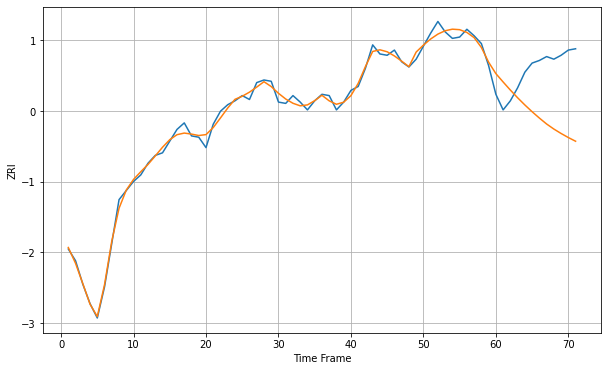

Wall time: 14.3 s
12202 3.8198724870390013 44.348021036967104 [1096.89935709 1090.46721046 1084.24327848 1078.33860242 1072.79434119
 1067.60310193 1062.73623731 1058.1677521  1054.2787023  1050.86541908
 1047.74042977 1044.90166643]

Got an mse at 0.0050 in round 230 and stopped training



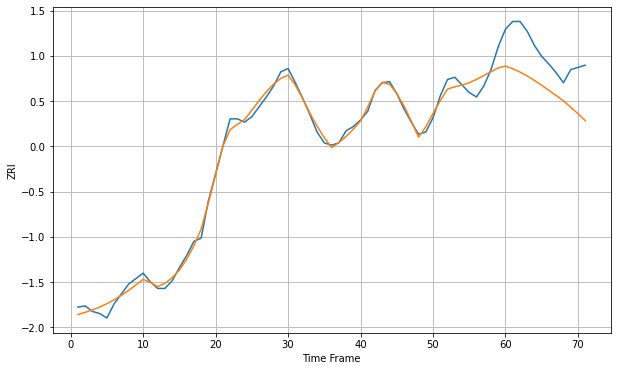

Wall time: 9.69 s
12203 5.811468650600191 35.76482265829869 [1280.20229809 1277.77734796 1274.73867524 1271.13340802 1267.0577195
 1262.63313871 1257.98527136 1253.23064674 1248.47071152 1242.5717127
 1236.76183464 1230.37768452]

Got an mse at 0.0050 in round 116 and stopped training



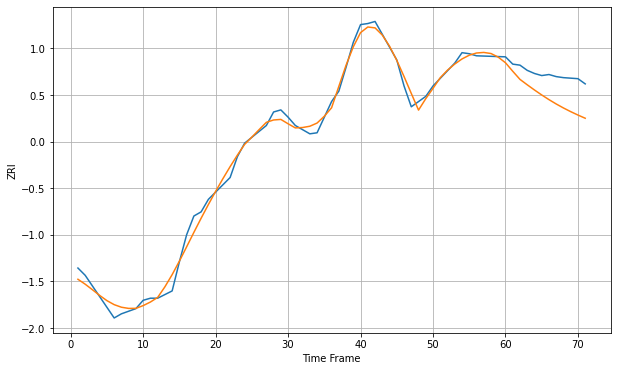

Wall time: 7.18 s
12206 6.26185913662293 23.332413994450135 [1231.30378872 1223.13508365 1215.31775031 1210.12702021 1205.11980606
 1200.34739822 1195.85833874 1191.68755861 1187.84554171 1184.31343398
 1181.0455724  1177.97656716]

Got an mse at 0.0050 in round 232 and stopped training



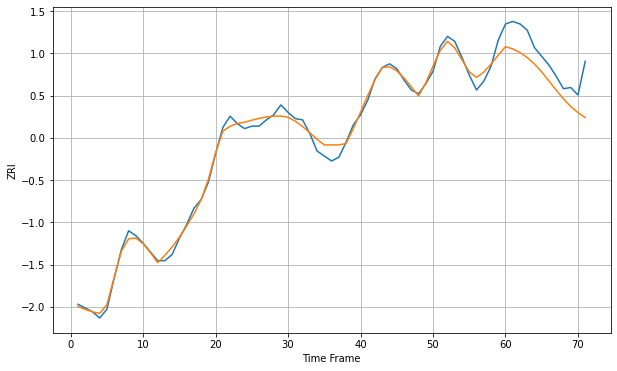

Wall time: 9.77 s
12208 4.747665186861702 20.379072680057455 [1278.74579442 1276.96691371 1274.08343063 1270.03388461 1264.8165038
 1258.44427123 1251.21182701 1243.83575327 1236.86006931 1230.75682387
 1225.82165041 1221.85512441]

Got an mse at 0.0050 in round 397 and stopped training



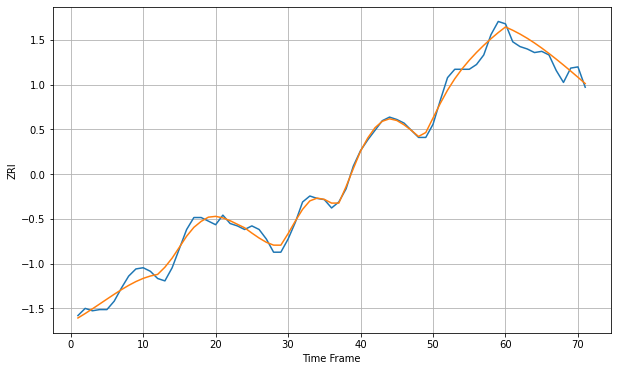

Wall time: 13.3 s
12209 5.275317482050472 7.93298072402936 [1192.4046545  1189.64244842 1186.48180377 1182.92912703 1179.00835399
 1174.7591932  1170.23202917 1165.480739   1160.55513498 1155.49457445
 1150.32399682 1145.05364002]

Got an mse at 0.0049 in round 377 and stopped training



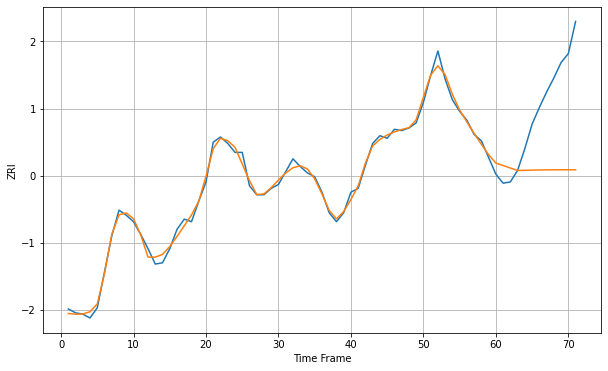

Wall time: 13 s
12210 3.6420633023963673 58.91323616426175 [1049.67505686 1047.74704611 1045.82373179 1043.92592033 1044.00754948
 1044.18174872 1044.30806107 1044.39369407 1044.44493595 1044.46630274
 1044.46044705 1044.42880962]


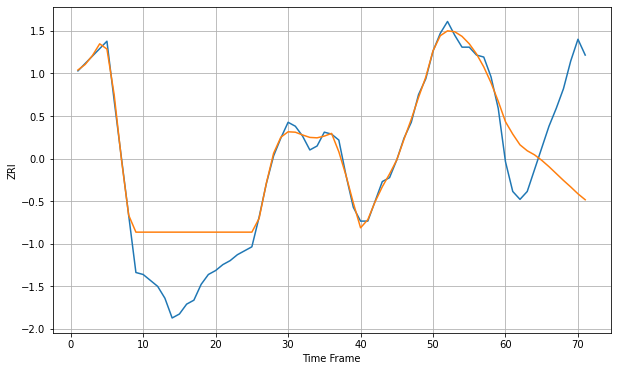

Wall time: 15.5 s
12303 14.285734857619124 42.544028693399405 [1013.24954364 1007.02348974 1001.59449091  998.59635413  996.53286041
  993.7571159   990.54899703  987.06683897  983.58696045  980.29477323
  976.80835955  973.80951686]

Got an mse at 0.0050 in round 453 and stopped training



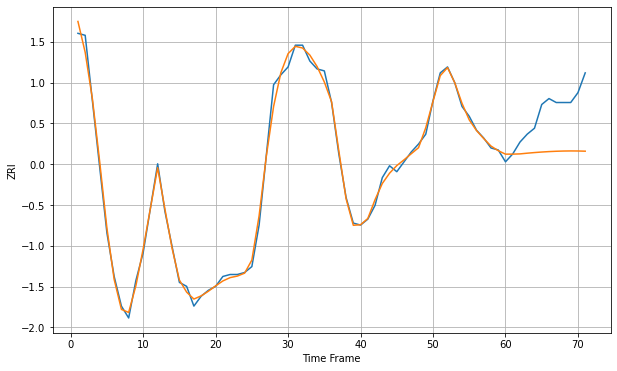

Wall time: 14.5 s
12304 2.9131276176874157 22.071256030254613 [1019.87821207 1019.88722345 1020.00862601 1020.366555   1020.6818637
 1020.9516594  1021.17270456 1021.3412172  1021.45259454 1021.50108386
 1021.47941164 1021.37834709]


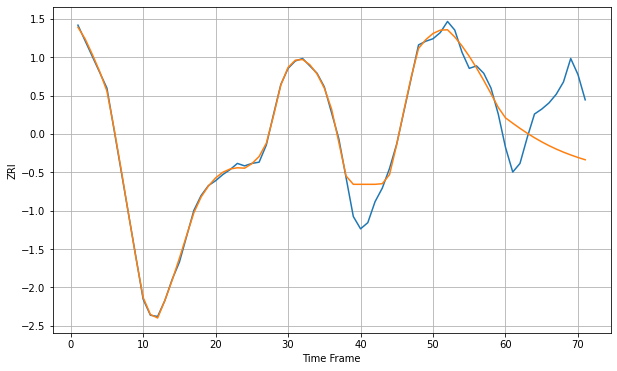

Wall time: 15.4 s
12306 7.819664882972175 44.16518099172653 [1060.89429029 1056.55458567 1052.38507166 1048.45778076 1044.80895137
 1041.45320058 1038.39253514 1035.61975068 1033.11791001 1030.86021421
 1028.81329932 1026.94256438]


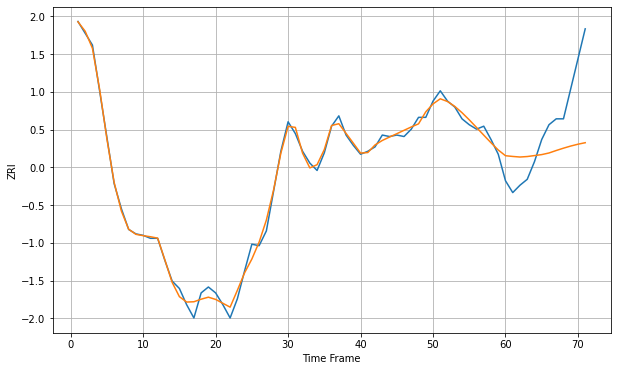

Wall time: 15.5 s
12307 3.6427575037684674 33.72759465385056 [952.99144029 952.49577247 952.10770015 952.43523236 953.08481658
 953.75448126 954.84397096 956.52789797 958.10329975 959.54547496
 960.78788004 961.80859112]


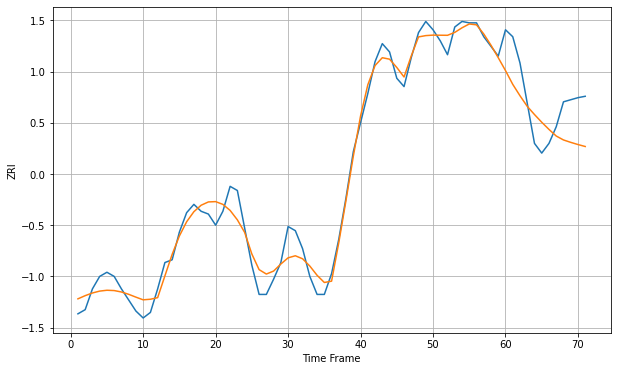

Wall time: 15.3 s
12401 9.196695075046579 25.573909533501297 [1412.54781052 1402.61840688 1394.38534052 1386.73675151 1380.82725115
 1375.2639265  1370.08966969 1365.32046442 1362.48404227 1360.75088059
 1359.17759874 1357.75730703]

Got an mse at 0.0050 in round 54 and stopped training



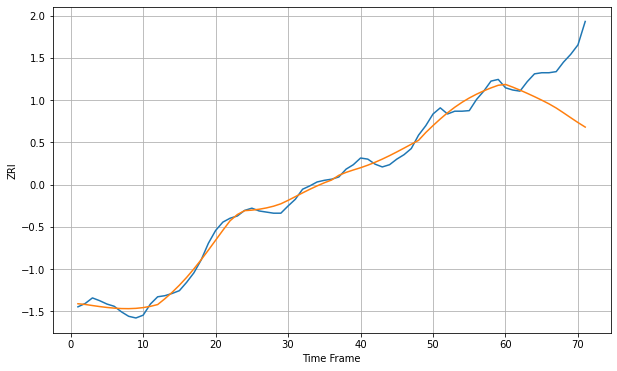

Wall time: 5.94 s
12508 10.637426468041244 85.86978903787809 [1589.03240267 1584.18308459 1578.799274   1573.06797323 1567.08118008
 1560.81123556 1554.1845969  1546.69736485 1538.13923305 1529.31729142
 1520.65816296 1512.50186241]

Got an mse at 0.0050 in round 283 and stopped training



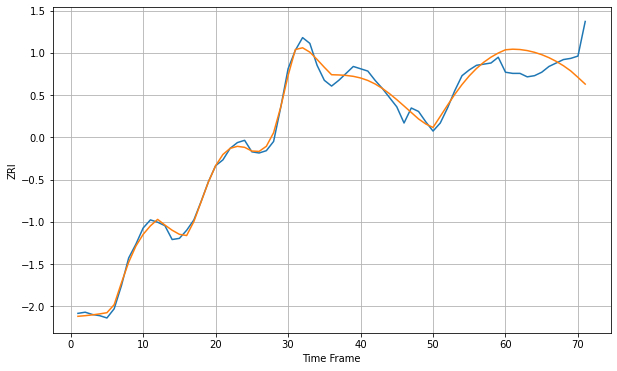

Wall time: 10.8 s
12550 5.141635139255046 22.17718473046922 [1421.46514837 1421.97126053 1421.68130684 1420.76140517 1419.27077639
 1417.22559476 1414.61268246 1411.4099525  1407.61450574 1403.14187295
 1397.53256485 1391.71525223]

Got an mse at 0.0050 in round 128 and stopped training



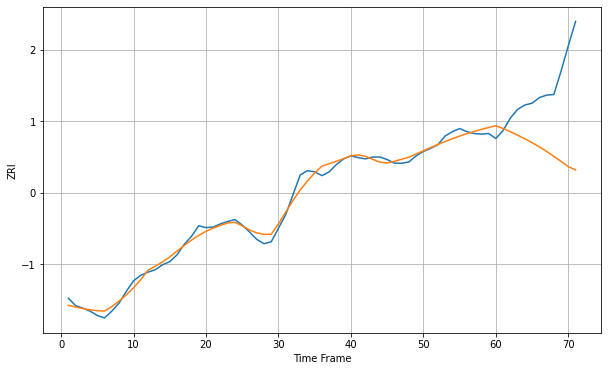

Wall time: 7.44 s
12590 8.09361332157195 112.2890672071034 [1510.50872639 1506.10167347 1500.9470527  1495.31196066 1489.36721025
 1483.11405713 1476.41073166 1469.09509235 1461.11035723 1452.91931797
 1444.50816458 1439.30709516]

Got an mse at 0.0050 in round 268 and stopped training



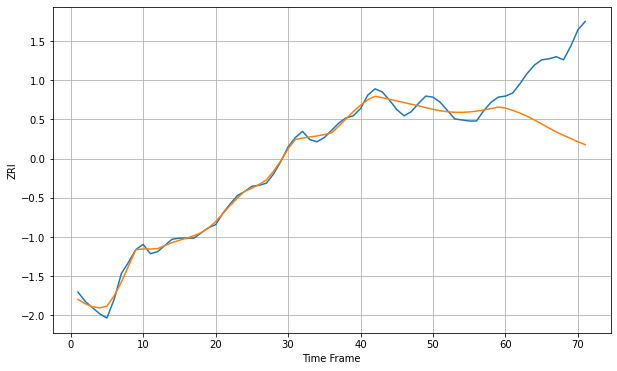

Wall time: 10.4 s
12601 5.317610471526889 69.69885041390452 [1235.45992213 1233.27454543 1230.63462947 1227.5270733  1223.98286964
 1220.13437598 1216.21211103 1212.4844389  1209.17569123 1206.16888171
 1202.90556347 1200.16570415]

Got an mse at 0.0049 in round 217 and stopped training



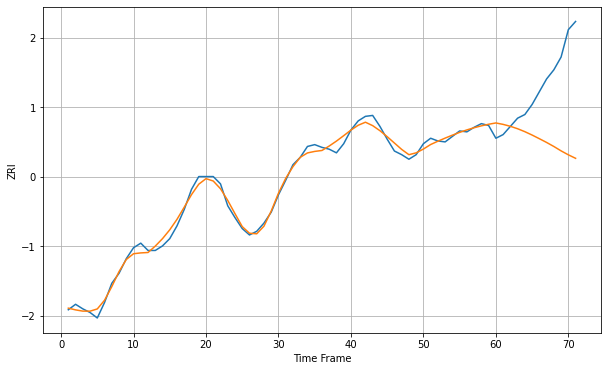

Wall time: 9.4 s
12603 5.32113444355795 75.53541514176018 [1406.76377415 1405.19077539 1403.0890843  1400.41815145 1397.19214024
 1393.49911695 1389.49803962 1385.38660256 1380.96871124 1376.15257492
 1371.83339555 1368.00422317]

Got an mse at 0.0050 in round 323 and stopped training



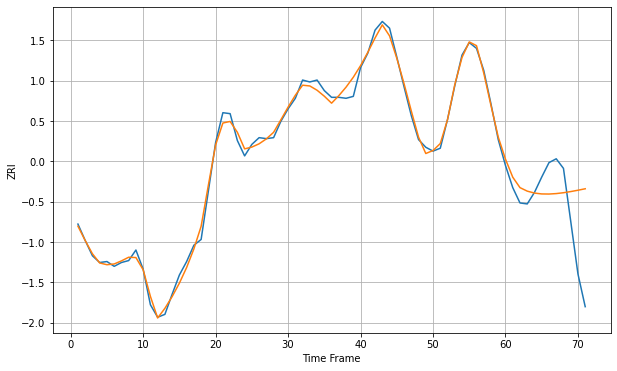

Wall time: 11.7 s
12866 5.885515829605719 47.93290185491897 [1690.57982894 1671.85348478 1660.96519922 1657.31738274 1655.30140083
 1654.39965507 1654.29234629 1654.7651303  1655.66185053 1656.86075653
 1658.26211589 1659.78160634]


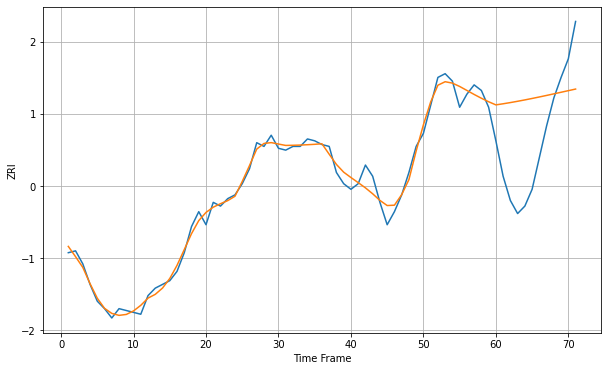

Wall time: 15.5 s
13203 4.099478608496389 37.50100004033348 [905.26692536 905.86013188 906.50667444 907.20133787 907.93835141
 908.7115461  909.51452438 910.34082077 911.18404124 912.03797687
 912.89669236 913.75459259]


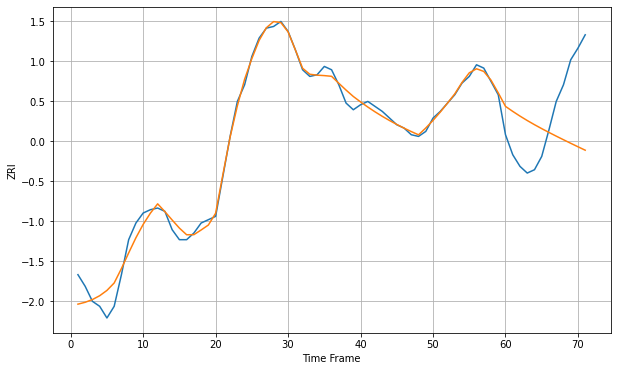

Wall time: 15.5 s
13204 5.0750639388838055 36.772897477946096 [896.02459215 893.02061161 890.18821521 887.53429659 885.0363083
 882.66171565 880.3795739  878.16502475 876.00015133 873.87349735
 871.77922259 869.71616901]

Got an mse at 0.0050 in round 412 and stopped training



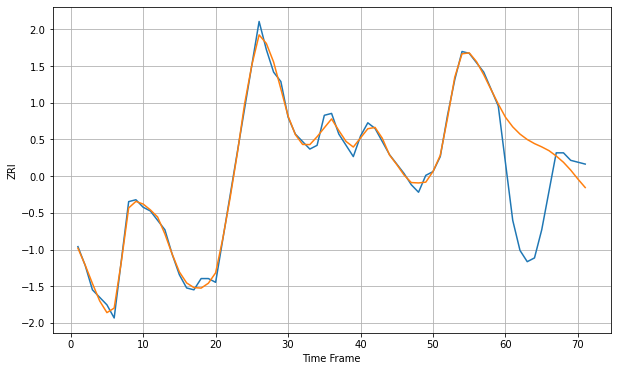

Wall time: 13.7 s
13205 2.7544982153860653 38.280110371390265 [927.93963383 922.83426614 918.98023493 916.09976787 913.91656986
 912.17347878 910.16117831 907.29775464 903.95831784 899.78517966
 894.99394499 890.50311294]

Got an mse at 0.0050 in round 473 and stopped training



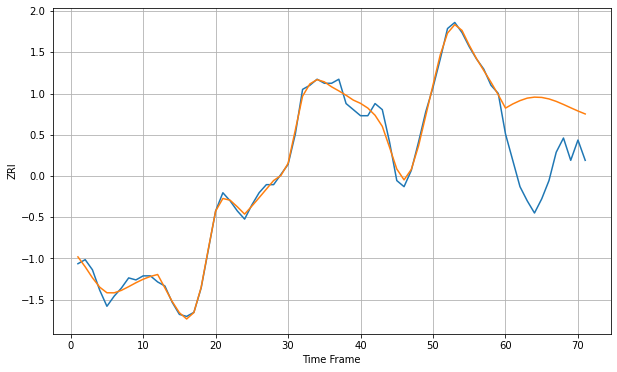

Wall time: 14.7 s
13206 2.86163213856072 35.35604510827826 [895.75705124 897.79035499 899.44609422 900.67923145 901.16688102
 901.0211997  900.28509505 899.07063947 897.55237866 895.91929005
 894.3255348  892.8667263 ]

Got an mse at 0.0050 in round 326 and stopped training



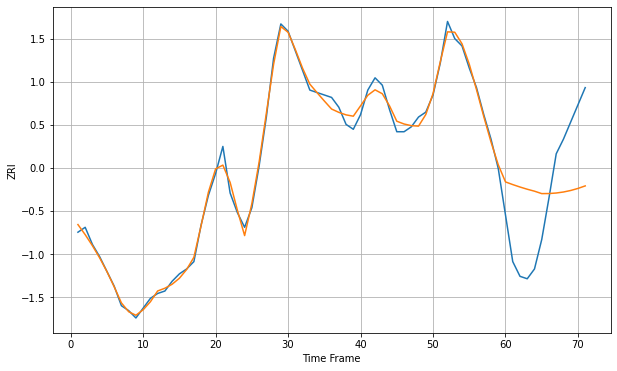

Wall time: 11.9 s
13208 2.471256680587733 28.098565915303197 [871.5231941  870.43467915 869.44130312 868.53723537 867.73882734
 866.74909181 866.78348737 866.99480177 867.40603652 868.02959215
 868.86481438 869.89618184]


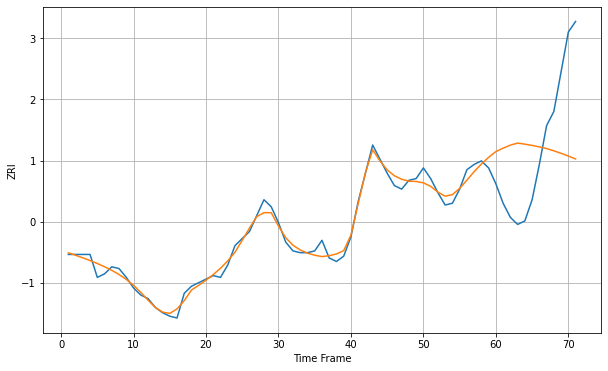

Wall time: 15.4 s
13440 3.5454094585845297 42.670495524337184 [760.25432085 762.21538489 763.9337101  765.08025104 764.48487571
 763.77347353 762.94113958 761.98087788 760.70863864 759.28985994
 757.74423617 756.10098495]

Got an mse at 0.0050 in round 382 and stopped training



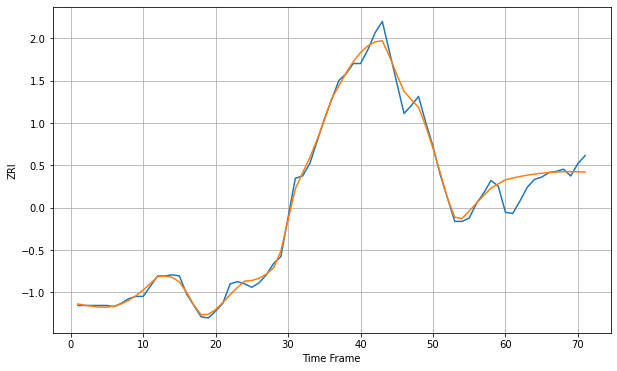

Wall time: 13 s
13501 5.23555798048165 14.977120836879102 [838.67952643 840.19991941 841.53429241 842.6838256  843.65105657
 844.43774409 845.04471098 845.47271966 845.72351558 845.80060184
 845.70969113 845.45889612]

Got an mse at 0.0050 in round 186 and stopped training



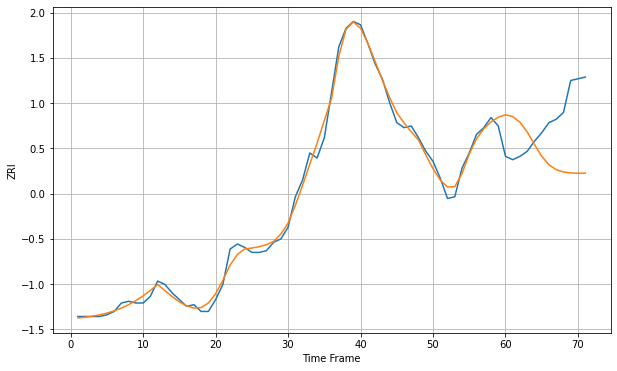

Wall time: 8.75 s
13502 3.7724866903060748 34.34987470595132 [829.67424959 828.54239356 825.19114095 819.39899104 812.00625127
 804.99921085 799.97431295 797.08776773 795.69559595 795.14296519
 794.99777778 795.01625506]


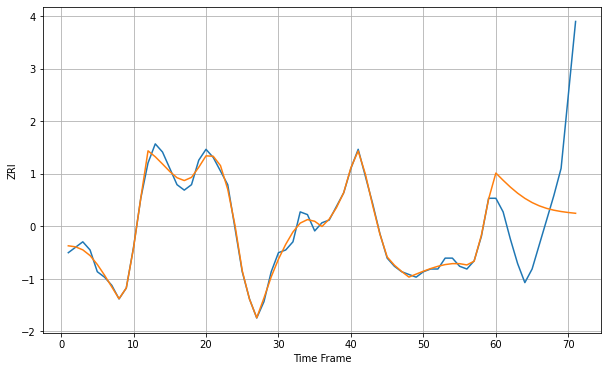

Wall time: 15.4 s
13601 1.929160282859116 29.090340680736652 [859.27883575 856.62078242 854.11474967 851.87909912 849.97755993
 848.42702931 847.21112821 846.29212988 845.61862915 845.13172223
 844.77151909 844.48330857]


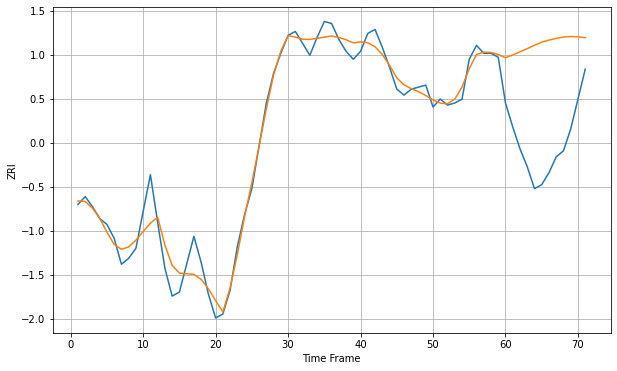

Wall time: 15.5 s
13760 6.514732674313049 52.18499425400443 [894.77881946 896.194218   897.73326585 899.35971049 901.02089708
 902.61998255 903.63356925 904.50217575 905.17919433 905.42310614
 905.29889244 904.83421417]

Got an mse at 0.0050 in round 403 and stopped training



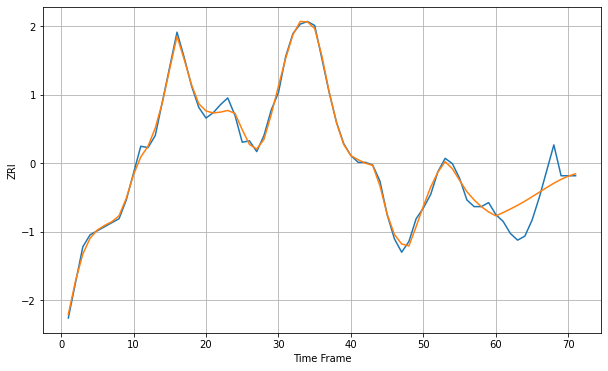

Wall time: 13.4 s
13903 3.574290440066905 15.86719054277908 [825.07996032 827.56968131 830.18478879 832.99247194 836.05029004
 839.34494116 842.77588596 846.19275453 849.43015188 852.32126009
 854.70966205 856.49135375]

Got an mse at 0.0050 in round 430 and stopped training



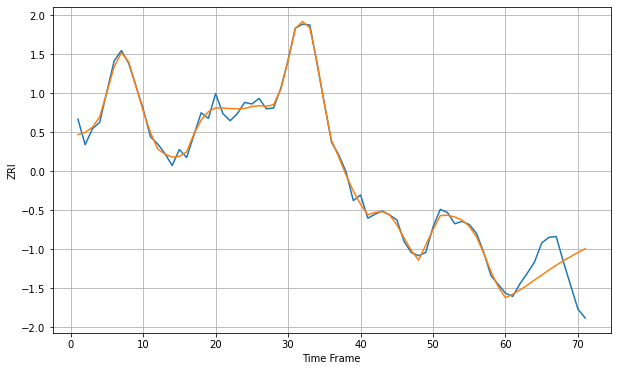

Wall time: 14.1 s
14020 6.86650355815306 40.13207375312171 [1193.41078552 1197.81663385 1203.10574973 1209.11517711 1215.47417004
 1221.75920939 1228.05792678 1234.09454133 1239.69400077 1244.96580999
 1250.00249337 1254.82039895]

Got an mse at 0.0050 in round 351 and stopped training



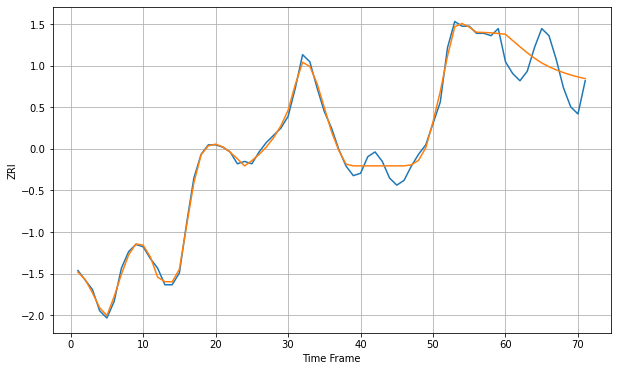

Wall time: 12.1 s
14043 2.459349591255459 11.112042141162064 [968.58616124 965.92461358 963.31367117 960.82474767 958.52552978
 956.51108736 954.92609486 953.57950379 952.43603624 951.45651937
 950.61301725 949.89658953]


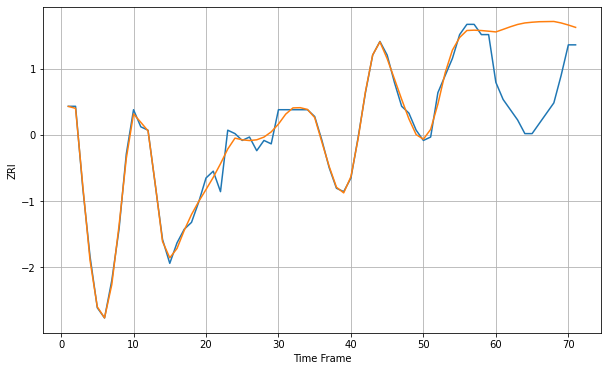

Wall time: 16.8 s
14150 1.9457167937695043 23.4514311121195 [898.78415455 899.52983803 900.29515044 900.97233588 901.41605457
 901.62700037 901.77395272 901.81148587 901.84817351 901.41250352
 900.80823528 900.11879343]

Got an mse at 0.0050 in round 398 and stopped training



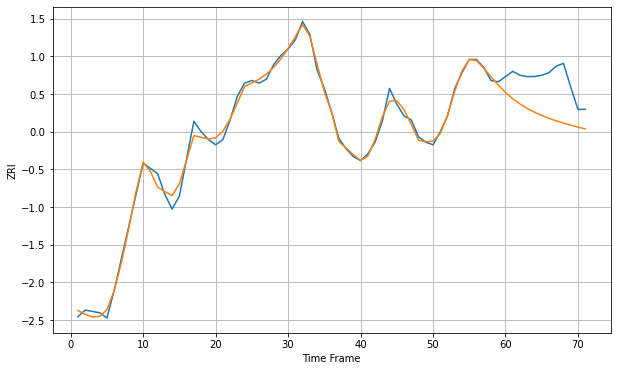

Wall time: 14.1 s
14201 4.007712704687364 28.284612247555717 [927.90097777 923.12276393 919.11119402 915.73054491 912.85092407
 910.36416725 908.185661   906.2507237  904.51007946 902.92600024
 901.46938369 900.11762372]


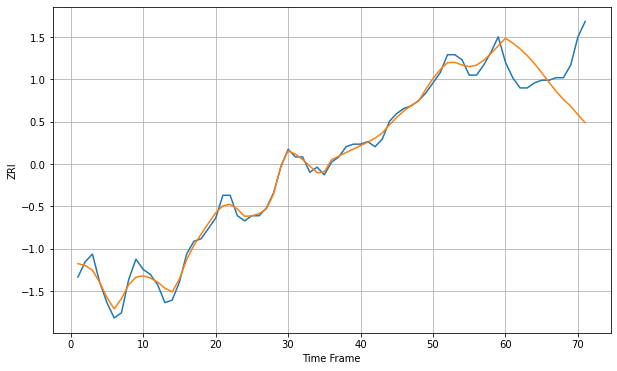

Wall time: 16.3 s
14206 2.6093292903335543 17.309478940015197 [817.43605494 815.56404671 813.31670189 810.63472285 807.48748828
 803.93950979 800.20996118 796.6270575  793.4672728  790.84080561
 787.46237543 784.40849488]

Got an mse at 0.0050 in round 252 and stopped training



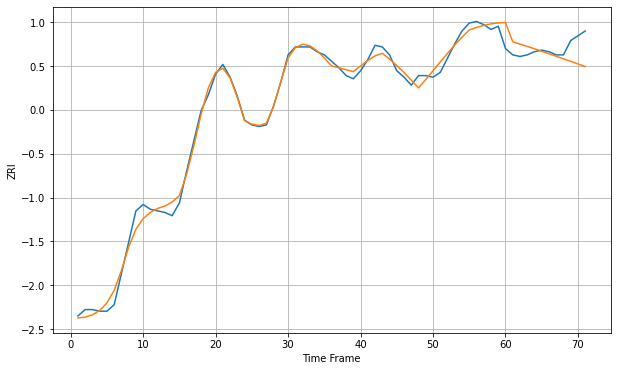

Wall time: 10.7 s
14207 3.8802056274422942 10.8809361205008 [829.39606654 817.2334576  815.81448449 814.343022   812.8337886
 811.29567814 809.73324049 808.14884655 806.54508344 804.92672804
 803.30169486 801.68078576]

Got an mse at 0.0050 in round 241 and stopped training



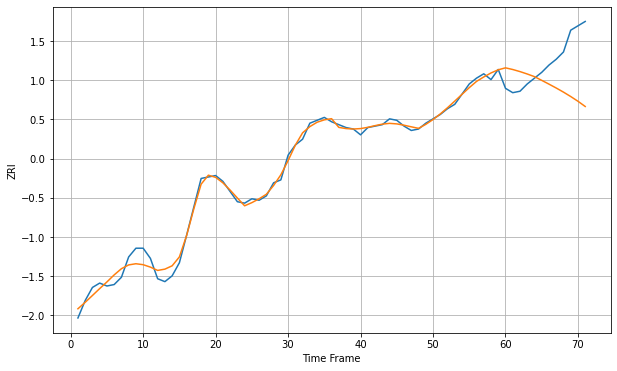

Wall time: 10.4 s
14208 3.787863200082868 29.210628727222925 [818.09716972 816.94526684 815.51125248 813.8590483  812.03151396
 809.48090419 806.88315226 804.2093106  801.38654839 798.35390842
 795.09783769 791.50728771]


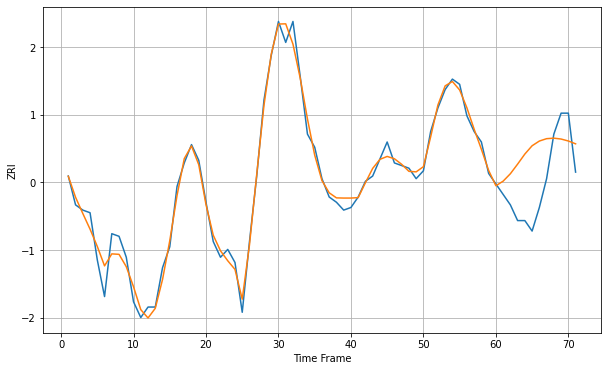

Wall time: 16.2 s
14209 3.6814680580082237 17.182109660753035 [1040.30148471 1042.04495719 1044.8812146  1048.55075824 1052.40411284
 1055.56139373 1057.35794321 1058.26565222 1058.46270524 1058.12392676
 1057.3758218  1056.30318279]


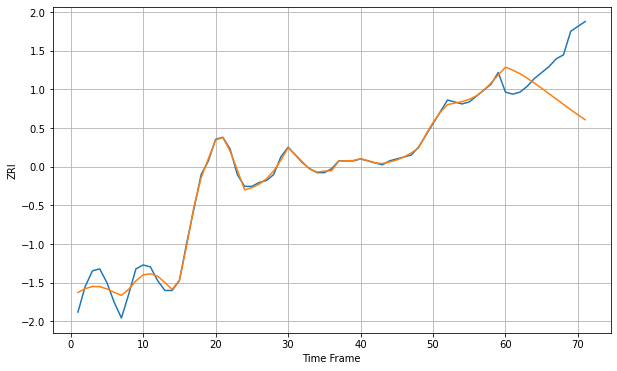

Wall time: 16.1 s
14210 3.0760763415096735 25.60150278767252 [800.71392675 799.19673922 797.41569836 795.09728904 792.58565802
 789.94773054 787.23334857 784.49005383 781.75880829 779.07190732
 776.45330925 773.92031909]


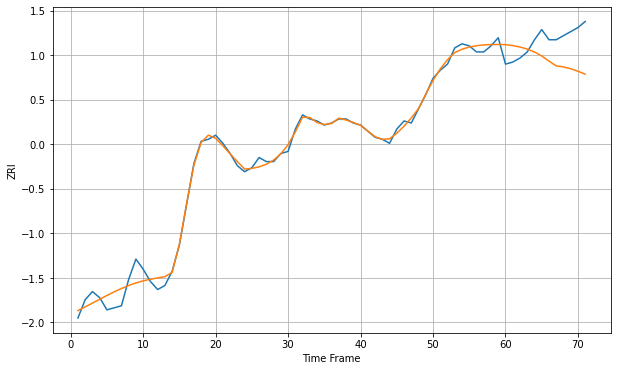

Wall time: 16.3 s
14211 3.1984324566014557 14.078573894011956 [793.59045826 793.11941215 792.41398652 791.39721567 789.96680474
 788.00971243 785.45753844 783.14696569 782.61728327 781.71851847
 780.48481862 779.037043  ]


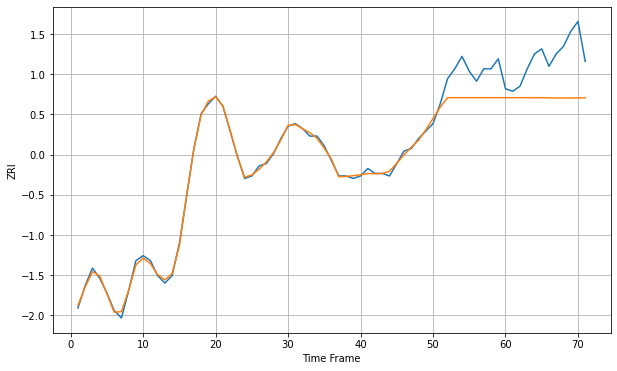

Wall time: 16.2 s
14212 4.474086011723527 17.419981270800204 [770.41475873 770.41475873 770.41475873 770.41475873 770.41475873
 770.39097788 770.32227751 770.28799024 770.28047411 770.29256062
 770.31824234 770.35286483]

Got an mse at 0.0050 in round 332 and stopped training



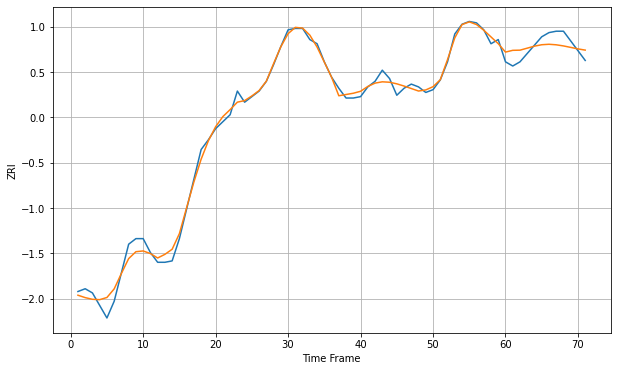

Wall time: 12.1 s
14213 4.576526931272387 7.357361857977092 [871.99920349 873.26748848 873.38483765 874.82346687 876.27487662
 877.28530088 877.61672499 877.23747147 876.42820574 875.37230603
 874.29948702 873.42043326]


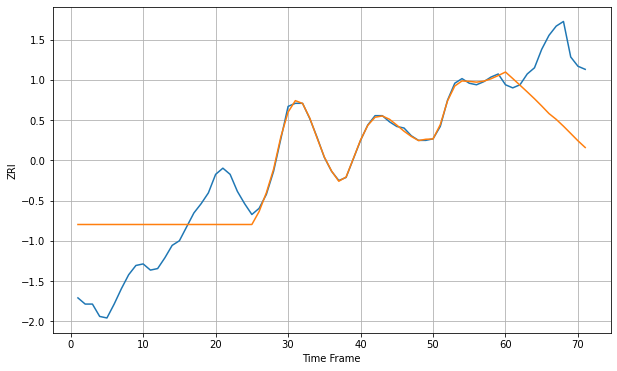

Wall time: 16.8 s
14214 22.112446082953525 40.97407879275965 [928.25846399 924.04946273 919.73898345 915.39098172 910.95930451
 906.26381664 901.36685082 897.60798316 893.18233313 888.47811074
 883.72408359 879.37826322]

Got an mse at 0.0050 in round 204 and stopped training



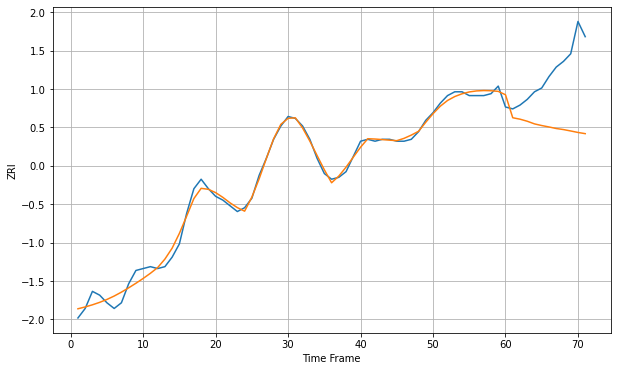

Wall time: 9.45 s
14215 2.846224998847212 31.120437264958387 [780.4381763  768.34391717 767.59125223 766.51067777 765.11107086
 764.24123204 763.49752457 762.68477994 762.12588525 761.38597609
 760.60790829 759.97677799]

Got an mse at 0.0050 in round 238 and stopped training



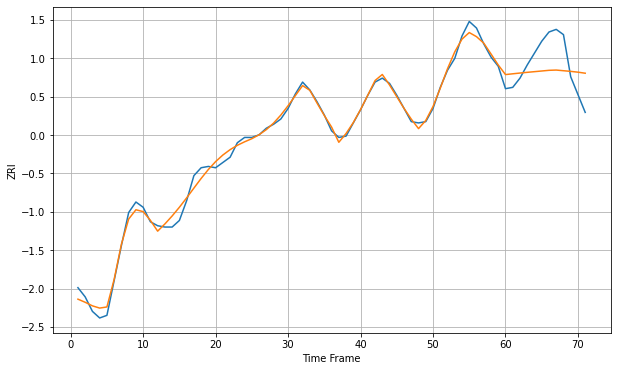

Wall time: 10.2 s
14216 4.0790034243025906 19.820210862080938 [1036.69865158 1037.2862882  1037.86054994 1038.40156137 1038.91153405
 1039.41474785 1039.92838964 1040.11964946 1039.6220299  1039.12565772
 1038.52452005 1037.72931592]

Got an mse at 0.0050 in round 341 and stopped training



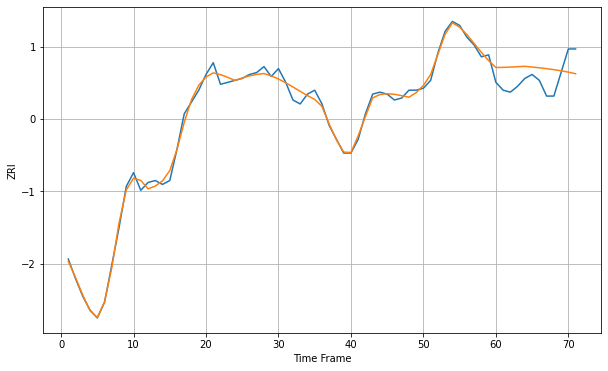

Wall time: 12.4 s
14217 2.5965780848265876 10.0964691185594 [891.54722196 891.63472267 891.77044014 891.94672544 892.15294112
 891.80934755 891.40308663 890.96099908 890.46632622 889.89201602
 889.20536313 888.375202  ]

Got an mse at 0.0050 in round 439 and stopped training



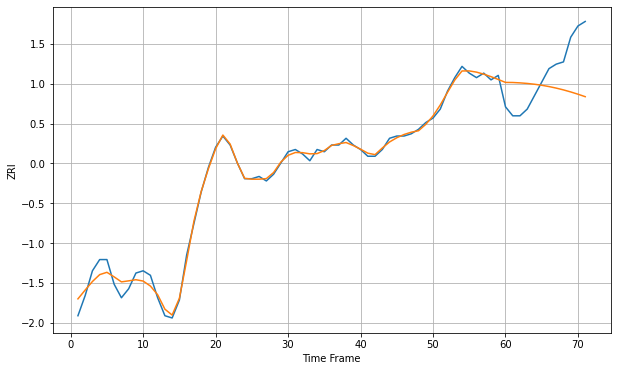

Wall time: 14.6 s
14218 2.4854624070508162 17.5159621532639 [825.86468664 825.82980134 825.6623121  825.40836928 825.05589733
 824.59588754 824.02292838 823.3353519  822.53496762 821.62651214
 820.61714793 819.51649975]


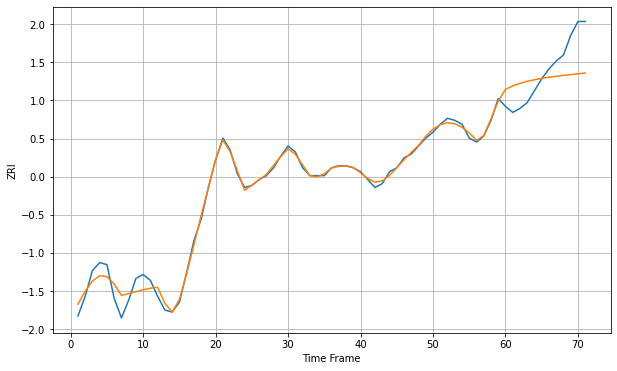

Wall time: 15.8 s
14220 3.0743452524078445 14.489341578068279 [816.69313985 818.39035729 819.70075359 820.71263686 821.51953966
 822.19734553 822.80016321 823.27743096 823.70575397 824.12030419
 824.53127111 824.94617548]


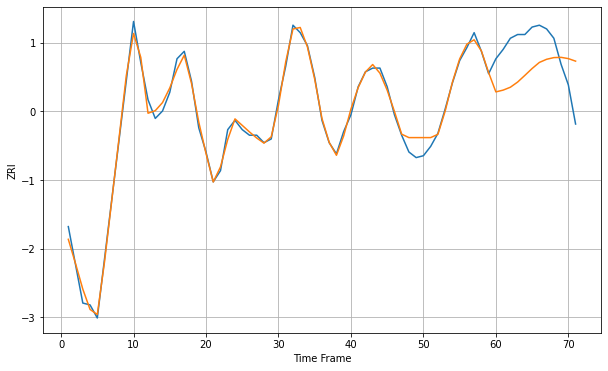

Wall time: 16.1 s
14221 3.525479736539258 20.872231911617813 [1128.23086205 1129.1818462  1130.73202925 1133.50248198 1137.08525551
 1140.76425415 1144.03018157 1145.71832936 1146.62082271 1146.75798723
 1146.08664098 1144.72006612]

Got an mse at 0.0050 in round 281 and stopped training



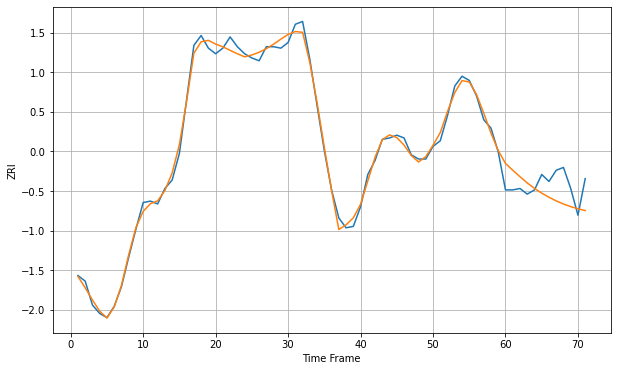

Wall time: 11.3 s
14222 3.961535828141222 15.40518892659011 [1076.86323314 1072.03633817 1067.39190023 1062.96665029 1059.0892115
 1055.70124358 1052.74633345 1050.1797726  1047.97044978 1046.09708755
 1044.54303807 1043.29242809]


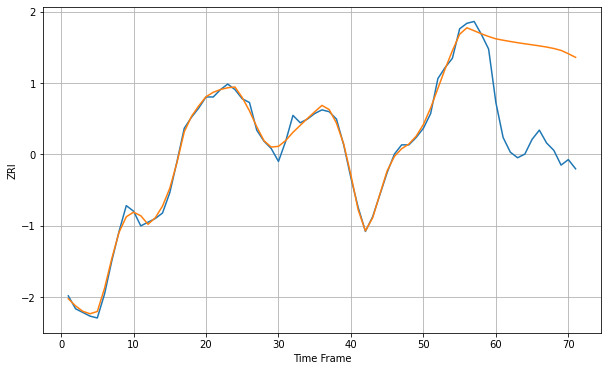

Wall time: 16.2 s
14224 2.877373779350468 55.10383100404004 [983.57002445 982.8211772  982.11753197 981.47059773 980.87789173
 980.31803937 979.74839809 979.10739816 978.32279952 977.2905265
 975.48730575 973.52121612]

Got an mse at 0.0050 in round 360 and stopped training



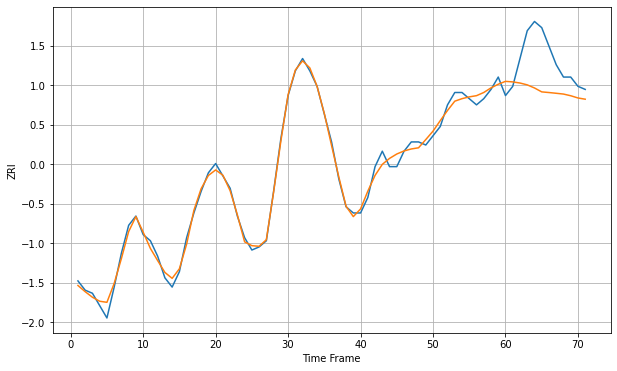

Wall time: 12.4 s
14225 1.7941470881454338 11.873127579721208 [863.61081222 863.43463035 863.06921078 862.47292614 861.46894641
 860.20014568 859.98944196 859.74971527 859.49459488 858.95218278
 858.23143651 857.83015219]


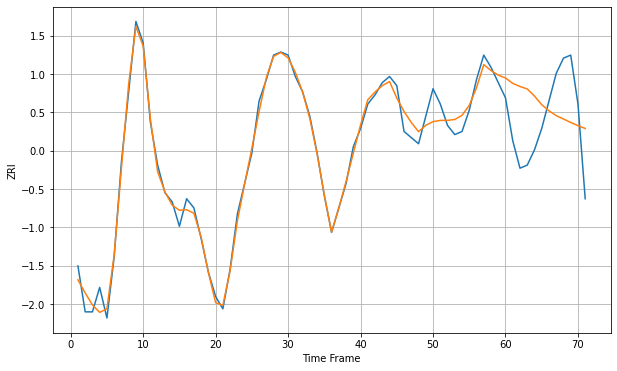

Wall time: 16.4 s
14228 3.138028632416571 17.70391164014296 [1099.4996898  1097.74340623 1096.72809108 1095.92861306 1093.59594585
 1090.77884628 1088.7655448  1087.20314121 1086.08643026 1084.96561244
 1083.92290702 1082.99263989]

Got an mse at 0.0050 in round 409 and stopped training



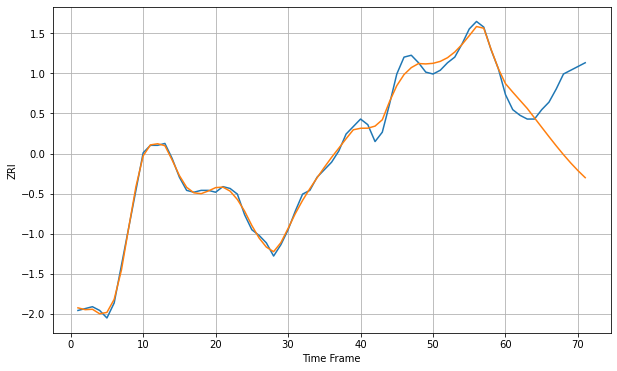

Wall time: 14.2 s
14301 3.006206671430831 32.49783754100446 [645.84298566 641.34487661 636.98361062 632.65371098 627.63438458
 622.61252562 617.62053644 612.73043841 608.03304088 603.61052538
 599.51576788 595.76613928]


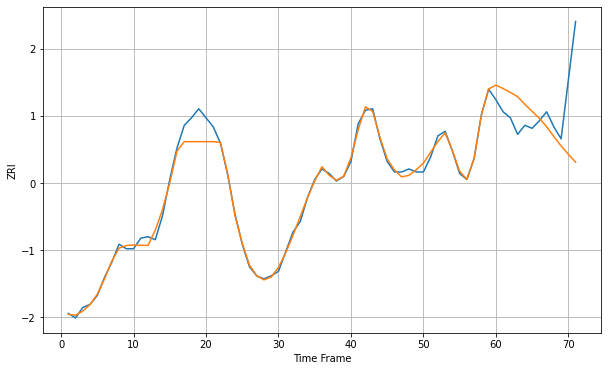

Wall time: 16.4 s
14607 5.047238286635108 32.78371368295063 [1088.71899129 1086.41160619 1083.83782515 1081.04522736 1075.91967443
 1071.31880826 1066.68867333 1061.07791356 1054.4998997  1048.31295369
 1042.74960542 1037.5039189 ]

Got an mse at 0.0050 in round 402 and stopped training



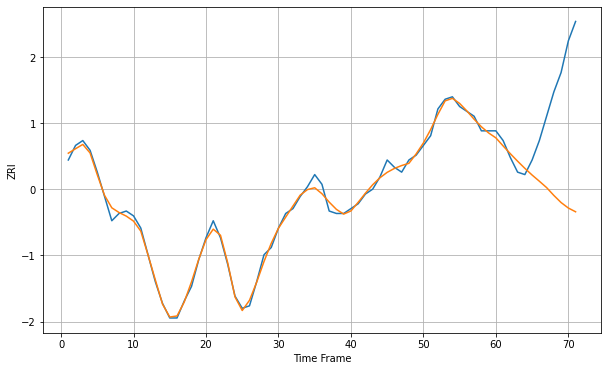

Wall time: 14.2 s
14609 1.9136810329187353 37.36988400493772 [829.11399263 825.79319112 822.57880148 819.49975628 816.56846028
 813.80904257 811.2689519  808.6477853  805.42631349 802.49035715
 800.23771054 798.69482285]


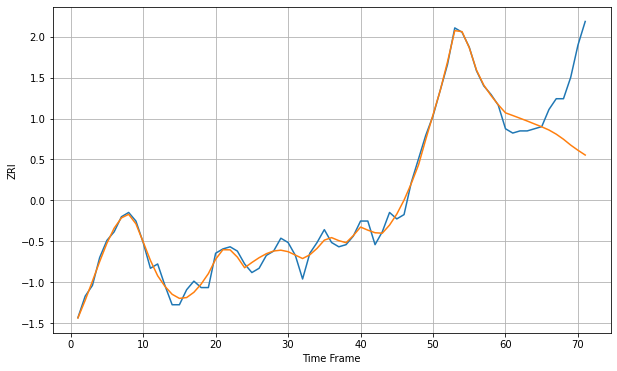

Wall time: 16.3 s
14611 3.168972073764041 26.10836776425405 [875.41487153 874.1783491  872.90498335 871.61223583 870.24216006
 868.91249602 867.41502779 865.49062458 863.12372781 860.38280719
 857.98188497 855.76212645]

Got an mse at 0.0050 in round 287 and stopped training



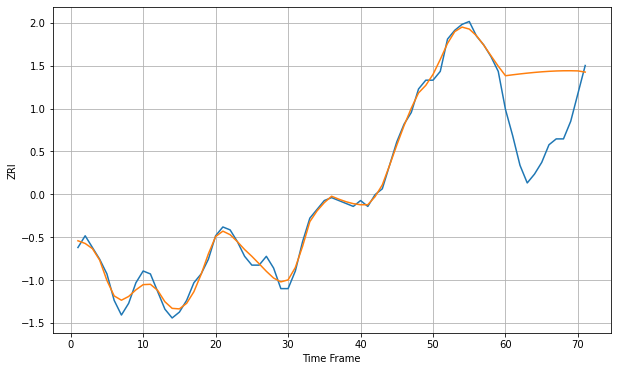

Wall time: 11.4 s
14613 2.0509307240639654 24.40196612811519 [771.51180602 771.83431241 772.12954224 772.39915318 772.64046487
 772.84814447 773.01570378 773.13653886 773.20446324 773.21387479
 773.15977742 772.75397655]

Got an mse at 0.0050 in round 271 and stopped training



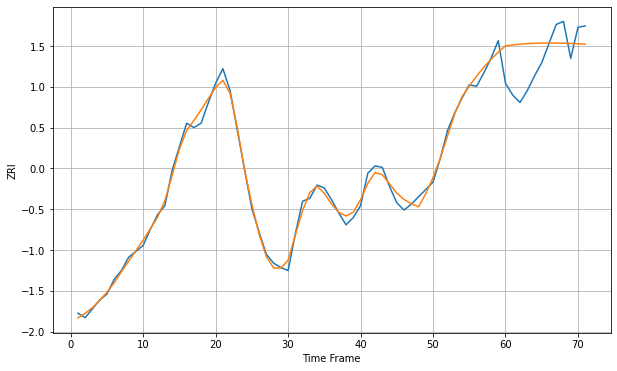

Wall time: 11 s
14620 3.896481442131716 22.022007683171744 [1100.42753057 1101.06094012 1101.55775227 1101.92929421 1102.18587644
 1102.33715634 1102.39246281 1102.361021   1102.2520322  1102.07459333
 1101.8374807  1101.5488623 ]

Got an mse at 0.0050 in round 284 and stopped training



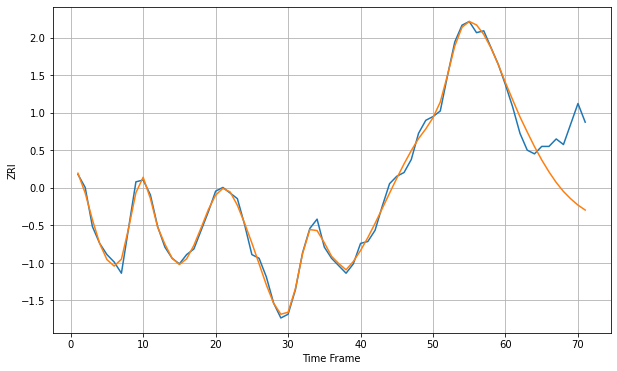

Wall time: 11.3 s
14621 2.827198716098338 26.48200109099059 [820.14708955 810.8870835  801.83112993 793.72963871 785.89709752
 778.76216203 772.35952368 766.65551112 761.82713777 757.90256379
 754.53436905 751.88426099]

Got an mse at 0.0050 in round 218 and stopped training



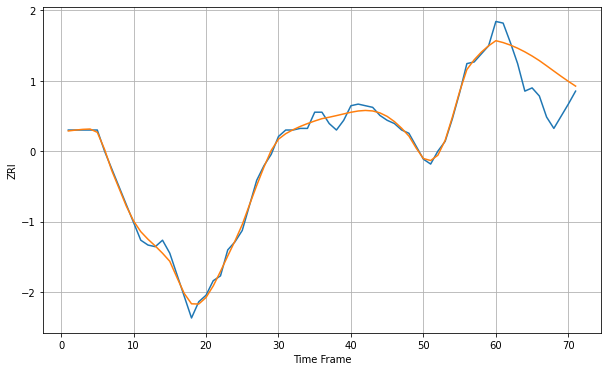

Wall time: 9.76 s
14701 3.062934791584834 20.20518747896788 [675.13570324 673.97670143 672.42022159 670.49801375 668.23970477
 665.68044467 662.83023374 659.64745278 656.39147123 653.1647896
 650.0505782  647.10412796]

Got an mse at 0.0050 in round 364 and stopped training



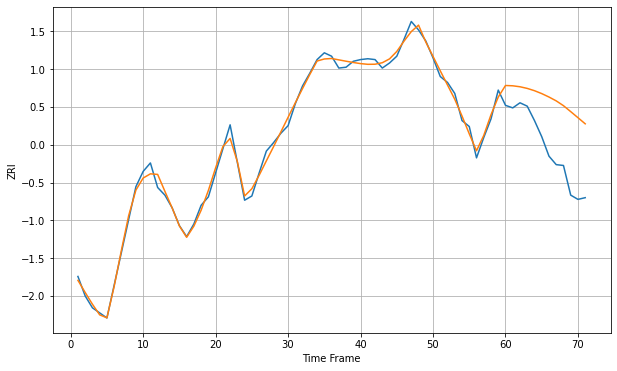

Wall time: 13.1 s
14850 6.271673763185598 63.23693217263251 [1568.42101751 1568.0634443  1566.91628775 1564.97986502 1562.27496887
 1558.85322012 1554.80250919 1550.25037264 1544.58721425 1537.56416424
 1530.41562119 1523.19107536]

Got an mse at 0.0050 in round 126 and stopped training



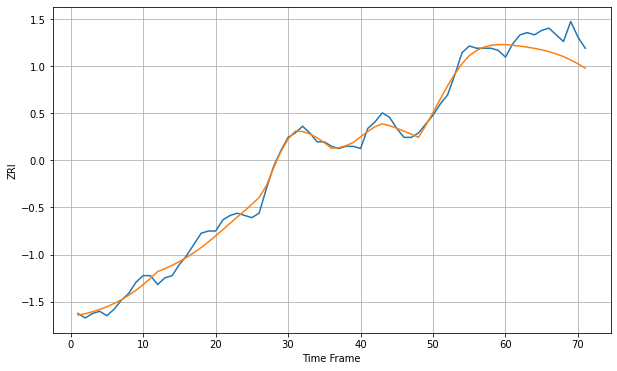

Wall time: 7.9 s
15202 2.975462642935257 8.965545916718614 [838.64759425 838.32532101 837.93699119 837.47940955 836.93510913
 836.27354722 835.45768279 834.45155206 833.2248812  831.75490036
 830.02756338 828.03985136]

Got an mse at 0.0050 in round 231 and stopped training



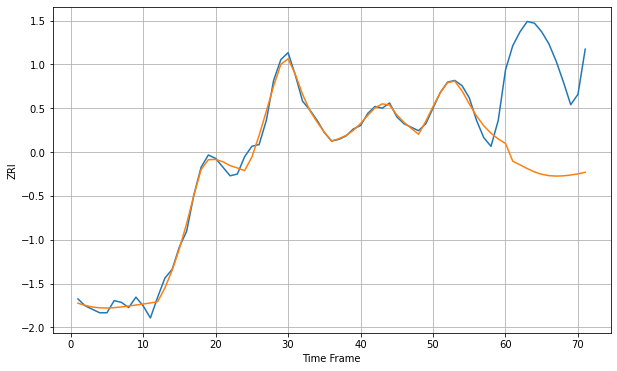

Wall time: 10.2 s
15206 3.5518594835262913 67.86109825493682 [1051.64938719 1041.45324195 1039.32120211 1037.14649231 1035.23238247
 1033.84839849 1033.07334398 1032.82525765 1032.97679668 1033.42644418
 1034.11275163 1035.00380508]


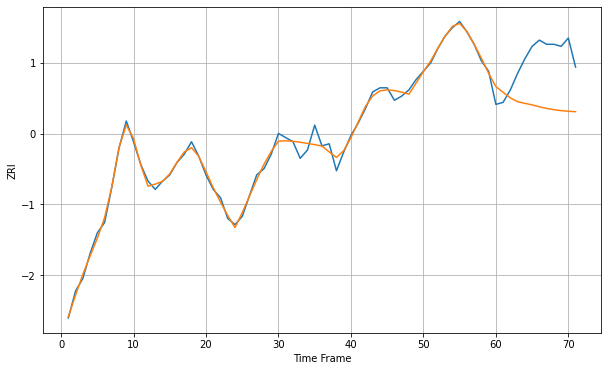

Wall time: 16.3 s
15210 2.452437547860088 24.520364446766013 [870.5882692  867.83620613 865.11965705 863.31280766 862.51340757
 861.7760504  860.84645602 860.06102071 859.4500712  858.99930235
 858.6874051  858.49001902]

Got an mse at 0.0050 in round 297 and stopped training



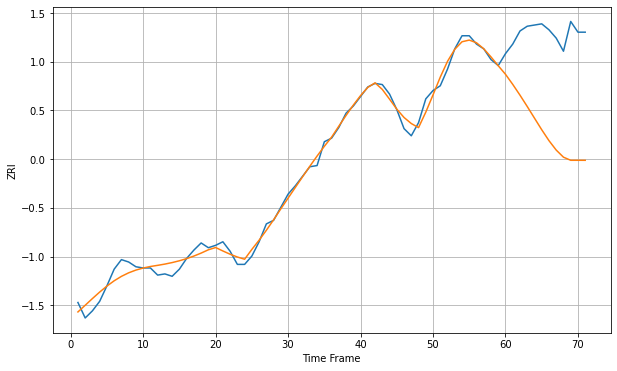

Wall time: 11.7 s
15212 5.7626218011088195 84.20261680767841 [945.62820244 937.15121483 928.10378466 918.59036229 908.80232682
 899.06577736 889.90631934 881.98913446 876.02472094 873.42183712
 873.42429894 873.40660257]

Got an mse at 0.0050 in round 117 and stopped training



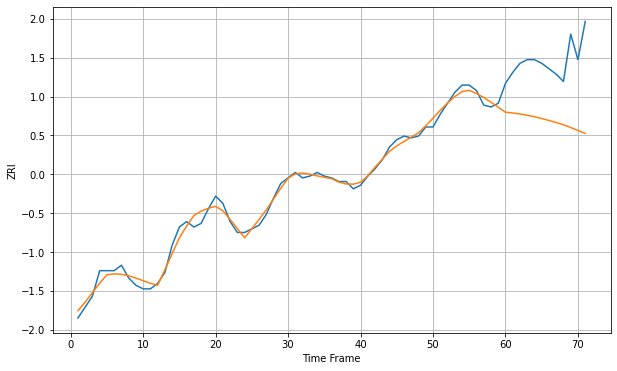

Wall time: 7.67 s
15216 3.000000076162569 34.623374513378025 [896.09284555 895.70194448 895.15323781 894.45424487 893.61496783
 892.64902849 891.57507852 890.41724366 889.20391936 887.70224724
 886.053717   884.42675967]


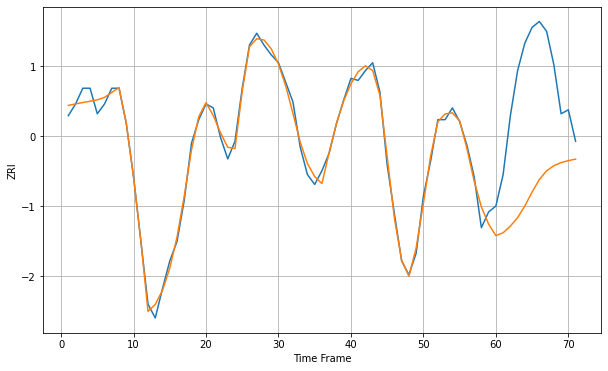

Wall time: 16.4 s
15217 3.6681418257966536 57.25231490848818 [1168.95315703 1170.38377482 1173.79802987 1178.09099286 1184.04522108
 1191.12681724 1197.52994888 1201.92576014 1204.56048857 1206.11950045
 1207.12937256 1207.8979736 ]

Got an mse at 0.0050 in round 403 and stopped training



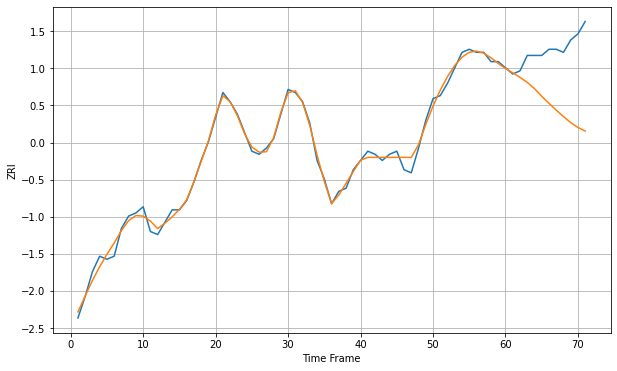

Wall time: 14.3 s
15221 1.6876379376960013 19.131541828191825 [897.7827193  896.38123334 894.91277148 893.27667041 891.26577674
 888.76812883 886.5104228  884.29682044 882.19189247 880.2385327
 878.67417555 877.52705957]


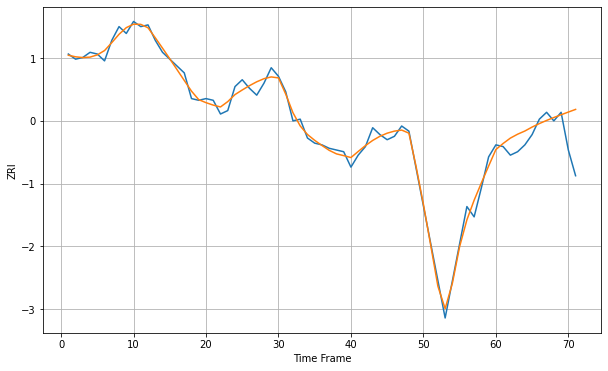

Wall time: 16.2 s
16365 3.621427391286541 13.906698211424795 [853.26737265 856.80899359 859.94621639 862.22077362 864.07775009
 866.39050848 868.42254981 870.25486349 871.95287554 873.56775251
 875.13804934 876.69081871]

Got an mse at 0.0049 in round 152 and stopped training



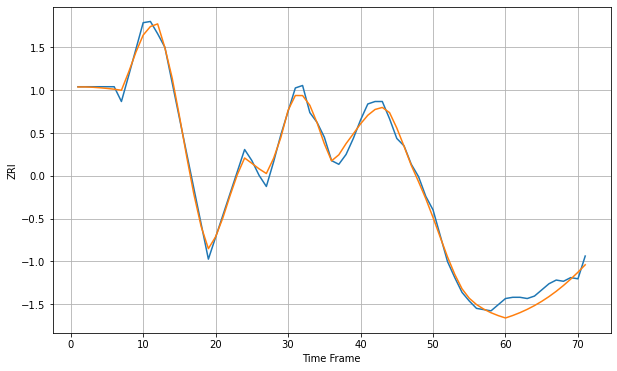

Wall time: 8.26 s
16502 4.852349967400141 9.707680091497872 [631.20831726 633.21368991 635.54342711 638.22106577 641.27097023
 644.71588813 648.57546378 652.86531919 657.59574843 662.76911615
 668.37570611 674.3885778 ]

Got an mse at 0.0050 in round 254 and stopped training



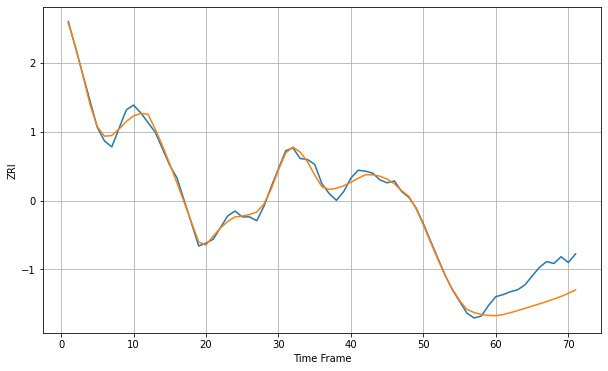

Wall time: 10.7 s
16503 4.9846618296136 31.29141160287941 [586.38955736 587.43972313 589.44603004 591.61565604 593.87377819
 596.16951436 598.49173229 600.876225   603.40178042 606.17514387
 609.30440861 612.86062012]


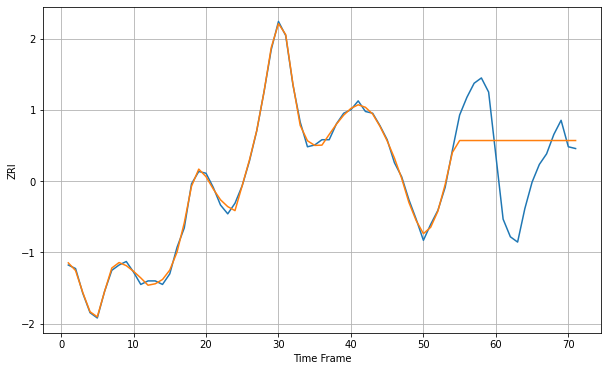

Wall time: 16.2 s
17013 8.303959333550836 30.00005505875064 [997.54360338 997.54360338 997.54360338 997.54360338 997.54360338
 997.54360338 997.54360338 997.54360338 997.54360338 997.54360338
 997.54360338 997.54360338]

Got an mse at 0.0050 in round 117 and stopped training



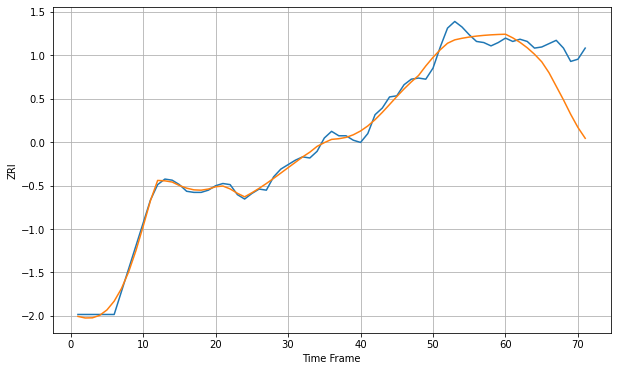

Wall time: 7.66 s
17022 5.5090814413576545 38.19634571571954 [892.50781675 889.24407189 885.19288756 880.30033536 874.49150119
 867.66226976 857.85862678 845.63335121 833.37618292 820.29465824
 808.46144173 798.7291483 ]


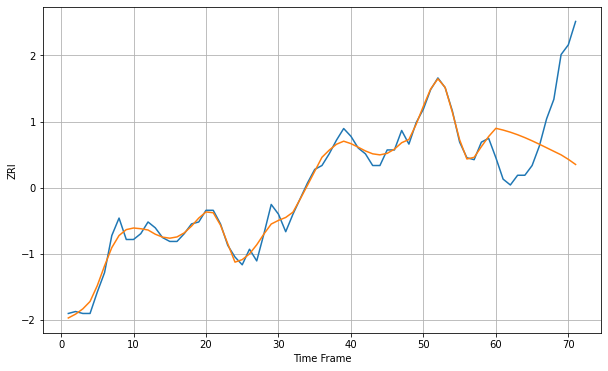

Wall time: 16.3 s
17401 3.618974866301002 35.36988698926396 [825.11423299 824.21594431 823.11410582 821.81225801 820.32694026
 818.68872204 816.93969958 815.12748712 813.2976469  811.48743161
 809.1703135  806.54500137]

Got an mse at 0.0050 in round 475 and stopped training



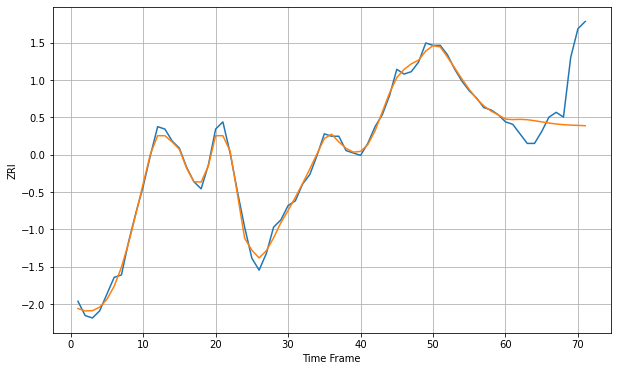

Wall time: 15.7 s
17404 2.196820256387388 19.641065654793866 [858.16826231 857.96784414 858.07782837 857.91693699 857.49363367
 857.00391273 856.5237841  856.1214857  855.8298152  855.64675931
 855.54956698 855.38292959]

Got an mse at 0.0050 in round 295 and stopped training



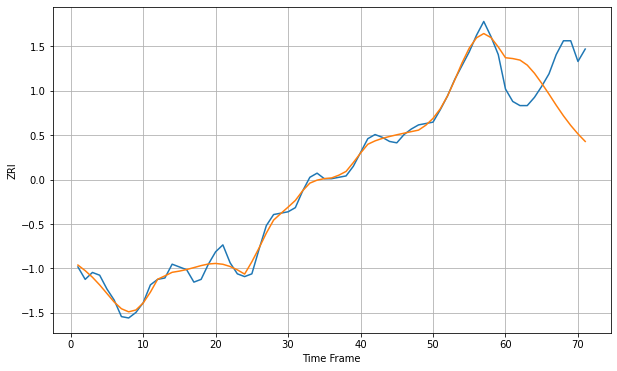

Wall time: 11.7 s
17512 4.519957991324327 40.09042732984194 [1034.70048305 1034.10288309 1032.99176885 1029.36747881 1023.41609961
 1016.13809719 1008.33334983 1000.23891909  992.56672337  985.62291021
  979.44474059  974.01688465]

Got an mse at 0.0049 in round 345 and stopped training



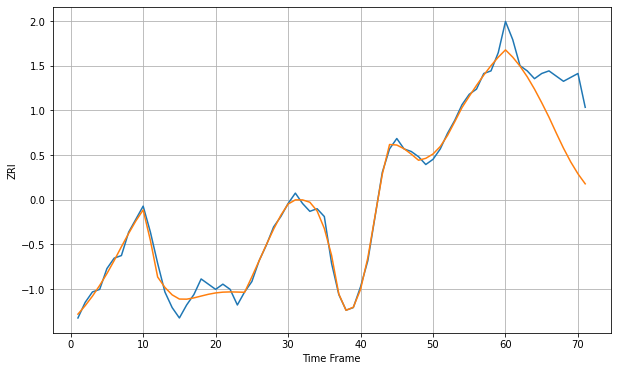

Wall time: 12.7 s
17522 2.406745914741846 20.77255334357119 [859.07519099 856.26639964 852.82729724 848.73075913 844.00160967
 838.75100726 833.19545433 827.13867264 821.2940528  816.00577348
 811.41828183 807.58147414]

Got an mse at 0.0050 in round 310 and stopped training



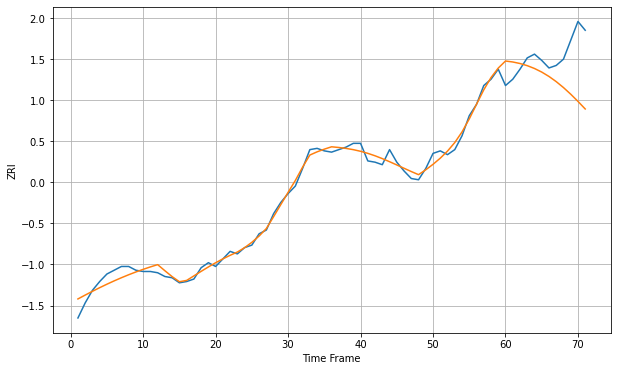

Wall time: 12.3 s
17543 4.612454925452913 30.794363117352393 [1124.5205906  1123.75305299 1122.54263784 1120.83428258 1118.57436382
 1115.71731912 1112.23299218 1108.11460359 1103.38657519 1098.11054493
 1092.38731833 1086.35275525]

Got an mse at 0.0050 in round 207 and stopped training



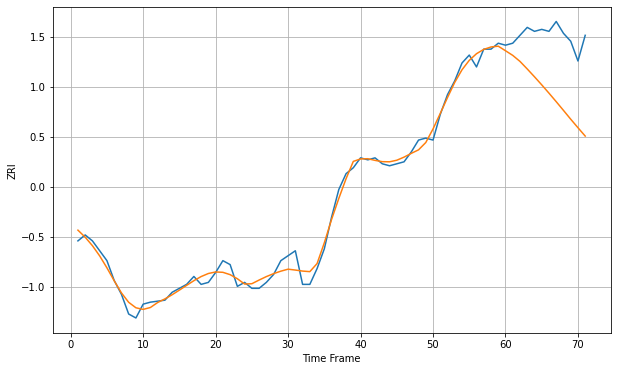

Wall time: 9.44 s
17552 3.550880485100021 30.847676771599087 [977.1905838  974.83938078 971.79160944 967.96909665 964.0106266
 959.92810094 955.72650523 951.41433675 947.01137946 942.55286316
 938.24821584 934.01764023]

Got an mse at 0.0050 in round 147 and stopped training



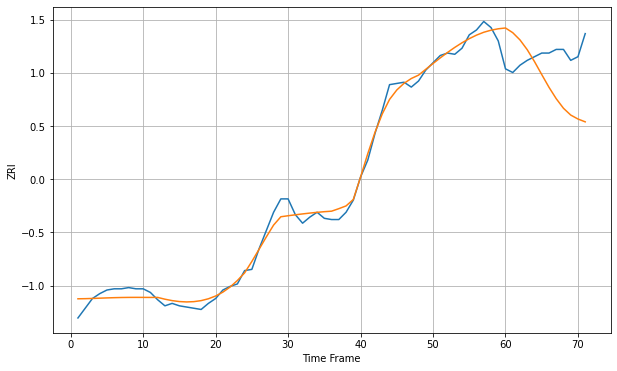

Wall time: 8.15 s
17602 6.158895102666865 38.46142732436417 [1102.62706541 1098.76983115 1092.81168841 1084.76029429 1074.9901191
 1064.33047197 1053.85221159 1044.4463714  1036.56959794 1030.98654115
 1027.73117647 1025.39509334]

Got an mse at 0.0049 in round 76 and stopped training



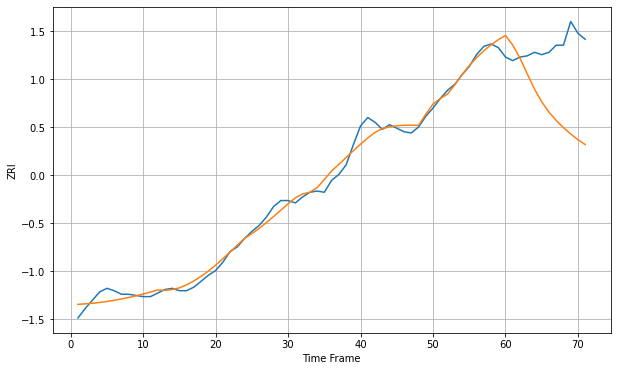

Wall time: 6.5 s
17603 5.664042380231649 57.44812633669777 [1154.23093194 1146.07004812 1135.05532333 1121.88618868 1109.00654673
 1098.21451316 1089.59551223 1082.53657641 1076.49969517 1071.15061336
 1066.29907538 1062.19525989]

Got an mse at 0.0050 in round 280 and stopped training



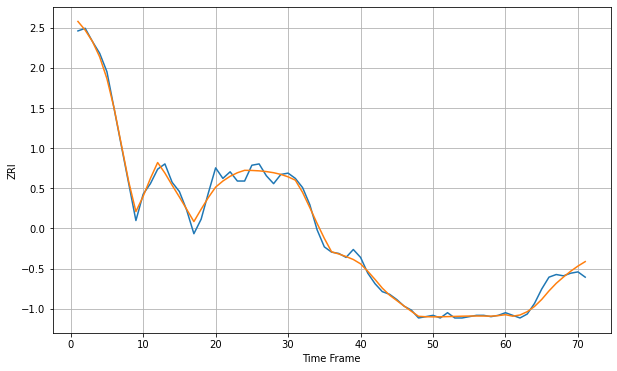

Wall time: 11 s
17701 4.275668354822001 5.736564843571215 [765.49116487 764.35343413 765.27522626 767.779041   771.7306641
 777.0860205  783.54726942 789.30676786 794.10134724 798.52064266
 802.41895721 805.80571211]

Got an mse at 0.0049 in round 93 and stopped training



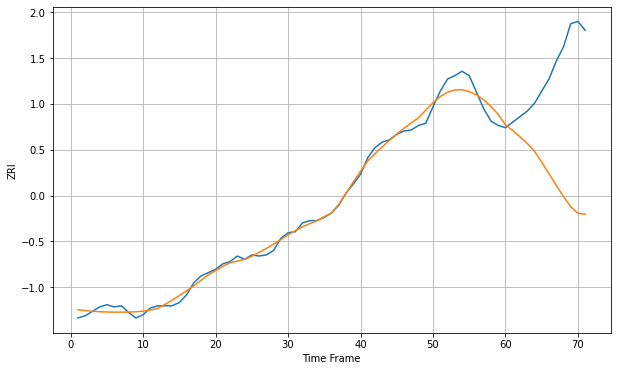

Wall time: 6.9 s
18018 5.769733738650677 104.26195530657526 [1089.48267875 1084.50339435 1078.72657007 1072.69496021 1065.74931568
 1055.80462166 1045.3912161  1034.93633536 1024.86935926 1015.5992264
 1009.55149719 1008.83528866]

Got an mse at 0.0050 in round 129 and stopped training



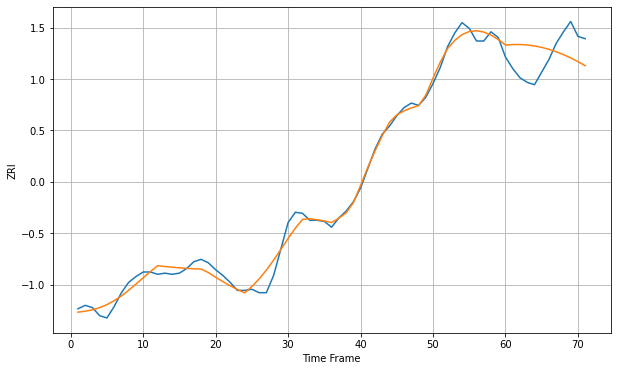

Wall time: 7.73 s
18042 6.2942185518255584 23.461106834974792 [1140.50763058 1140.90453779 1140.95783927 1140.53037434 1139.6961334
 1138.44513332 1136.76973957 1134.67205795 1132.1653083  1129.27443507
 1126.03539056 1122.49276818]

Got an mse at 0.0050 in round 205 and stopped training



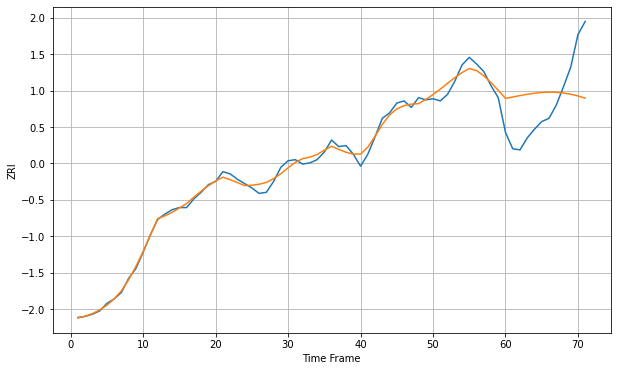

Wall time: 9.22 s
18102 4.707322882760873 39.45168578454687 [1088.31424035 1089.61498269 1090.89913851 1092.0836719  1093.06998254
 1093.75765931 1094.05891964 1093.90928362 1093.27321054 1092.14563926
 1090.55015369 1088.53402317]


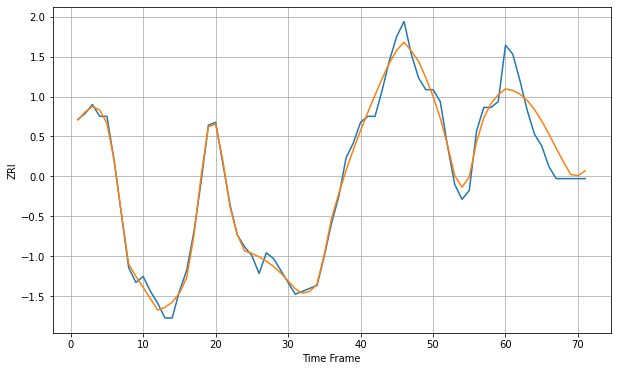

Wall time: 15.7 s
18232 2.877084593275373 8.199037259790035 [788.27160621 787.71419547 786.4840016  784.35378471 781.29519165
 777.435159   772.98560499 768.25275817 763.60407238 759.41198938
 758.98111309 760.65617224]

Got an mse at 0.0050 in round 297 and stopped training



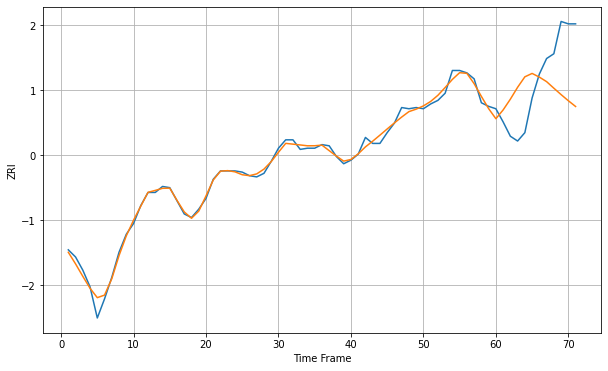

Wall time: 11.3 s
18951 3.8018826006116706 40.43260243016809 [1346.65368011 1353.9925931  1363.00823337 1372.95107222 1381.70351301
 1384.54117982 1381.45315212 1377.66665258 1372.17648309 1366.82976691
 1361.70494998 1356.89100842]

Got an mse at 0.0049 in round 89 and stopped training



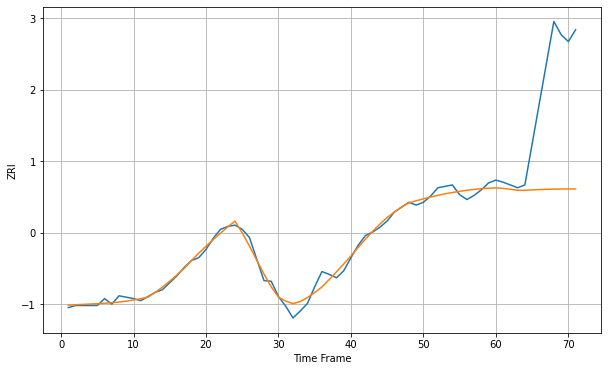

Wall time: 6.6 s
19007 7.210017799830456 147.21193307658822 [1238.75150813 1238.08399358 1236.7926686  1235.35688377 1235.23166801
 1235.86431336 1236.36359663 1236.74192759 1237.00977195 1237.17792935
 1237.2583955  1237.26440028]


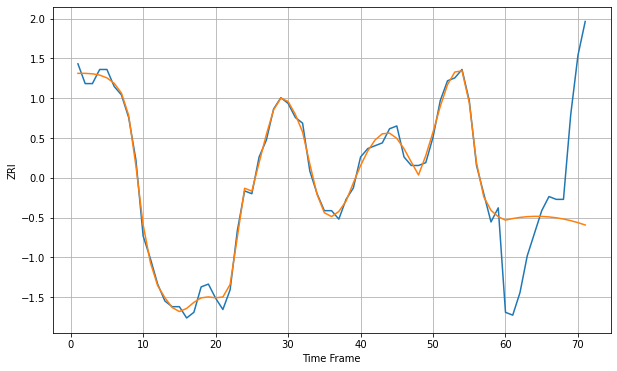

Wall time: 15.7 s
19103 2.357726997245514 33.45863270434787 [1678.65539973 1679.20977814 1679.61804566 1679.87679189 1679.98871966
 1679.95845966 1679.78974083 1679.48440056 1679.04292685 1678.46611698
 1677.75750081 1676.92607271]

Got an mse at 0.0050 in round 362 and stopped training



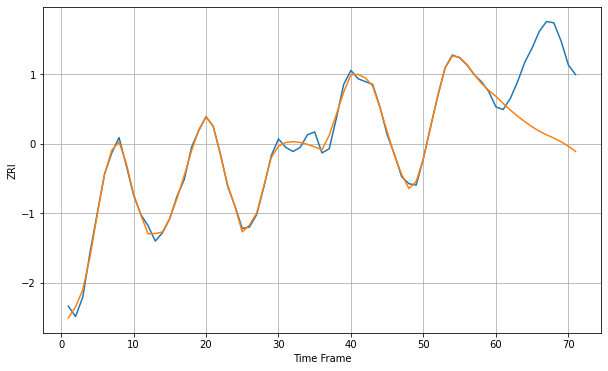

Wall time: 12.7 s
19104 3.4950215431212612 54.620020868305936 [1277.51094188 1272.39136329 1267.65051146 1263.28153388 1259.30543234
 1255.72777178 1252.52778606 1249.93053522 1247.60675194 1245.00237791
 1241.83420917 1238.06134408]

Got an mse at 0.0050 in round 250 and stopped training



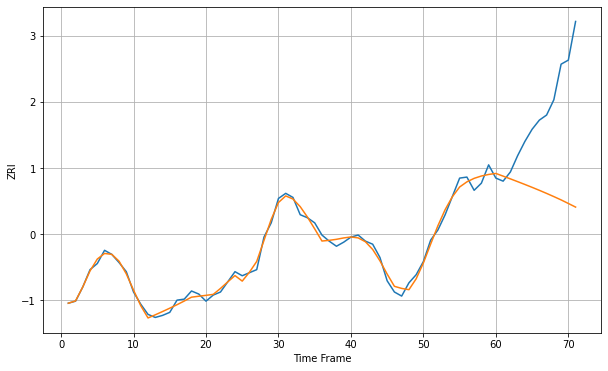

Wall time: 10.2 s
19106 4.5660507679140565 89.68633384762552 [1770.57903587 1767.93603816 1765.24895376 1762.52343569 1759.75064271
 1756.91081446 1753.98193209 1750.94876441 1747.80713438 1744.56296852
 1741.05634026 1737.4982477 ]


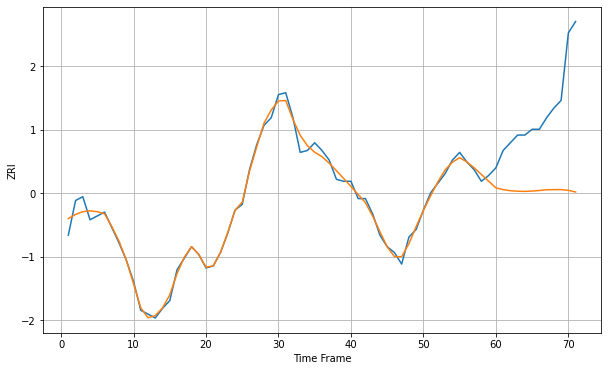

Wall time: 16.1 s
19107 2.9734997504968086 45.40886156602509 [1560.58064981 1559.66414599 1559.10196951 1558.8214035  1558.75082628
 1558.91332255 1559.21651006 1559.60478816 1559.6528513  1559.68644255
 1559.31088653 1558.42706243]

Got an mse at 0.0050 in round 491 and stopped training



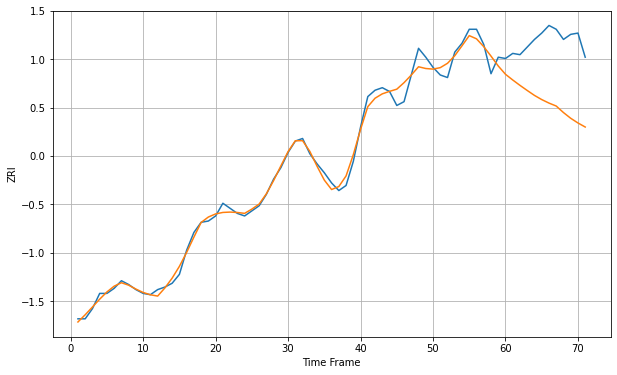

Wall time: 15.5 s
19120 5.370509685357064 50.11528554000212 [975.54776404 971.05720885 966.81693898 962.80108885 958.91459649
 955.63711862 952.88146425 950.55394335 945.41760216 940.90102014
 937.21929095 934.03505016]


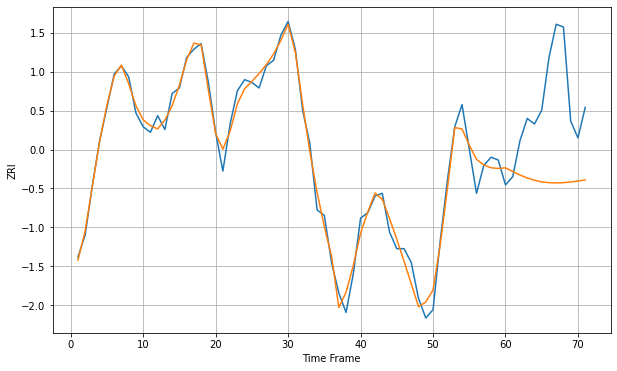

Wall time: 15.9 s
19121 3.926084689011022 31.122810795563332 [1342.17759647 1340.85999102 1339.5927459  1338.51584937 1337.69128678
 1337.13040225 1336.81999673 1336.73290255 1336.83190846 1337.07368901
 1337.41472783 1337.8185203 ]

Got an mse at 0.0050 in round 274 and stopped training



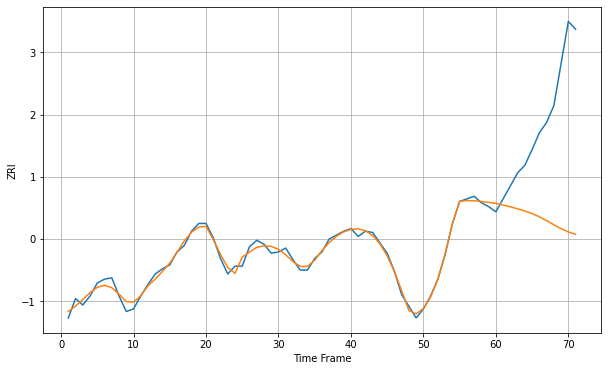

Wall time: 11.4 s
19123 3.3634001073836974 87.06860971474633 [1546.52504958 1545.22073726 1543.82409537 1542.30671963 1540.60064169
 1538.58471599 1536.12349829 1533.19257413 1530.01307979 1526.99553727
 1524.48213793 1522.58418598]


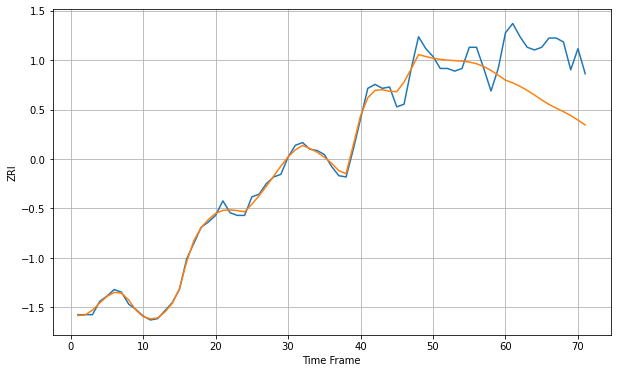

Wall time: 15.6 s
19124 5.3727210867334545 43.014557314564776 [958.16821789 956.12594819 953.51010348 950.41496671 946.97893064
 943.21687925 939.83645555 937.03287995 934.4046888  931.4221582
 927.98008533 924.32080817]

Got an mse at 0.0050 in round 339 and stopped training



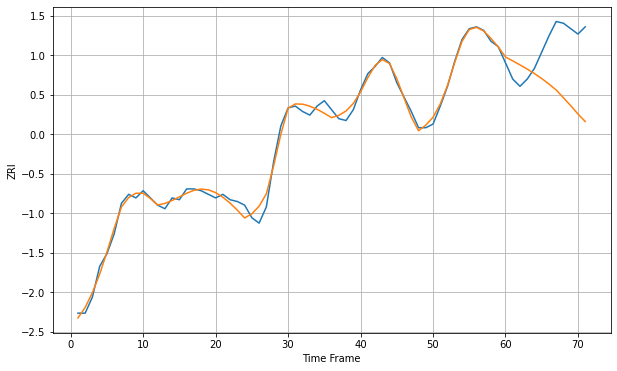

Wall time: 12.1 s
19128 3.085478832270026 30.208905340625687 [1251.28212295 1249.1012565  1246.87954357 1244.55244823 1242.04453683
 1239.28592172 1236.23813819 1232.92495175 1228.62217587 1224.23725024
 1219.57599628 1215.45706537]

Got an mse at 0.0050 in round 302 and stopped training



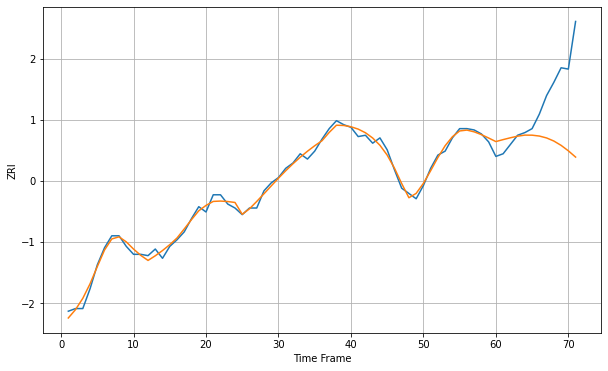

Wall time: 11.5 s
19130 3.2523227403466892 42.16025682614725 [1527.21544543 1528.70380196 1530.08052207 1531.30022057 1532.10084397
 1532.05009606 1531.39128338 1529.95680152 1527.62318073 1524.35227242
 1520.23227108 1515.48974039]

Got an mse at 0.0050 in round 181 and stopped training



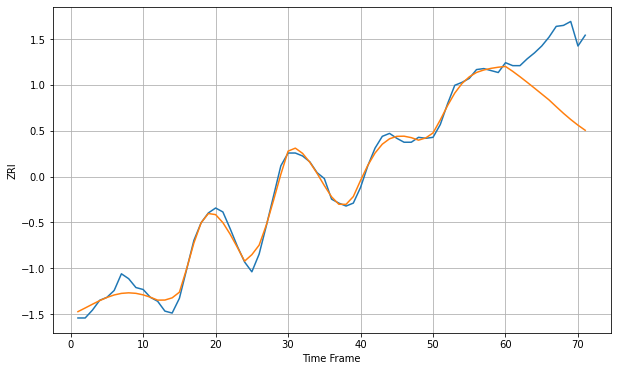

Wall time: 9.11 s
19131 6.5213205679986475 63.94270231420869 [1165.17375508 1160.19181221 1154.70841047 1148.98340248 1143.09270147
 1137.11734254 1131.1336593  1124.21342957 1117.46088088 1111.15088464
 1105.37339668 1100.16607884]

Got an mse at 0.0049 in round 255 and stopped training



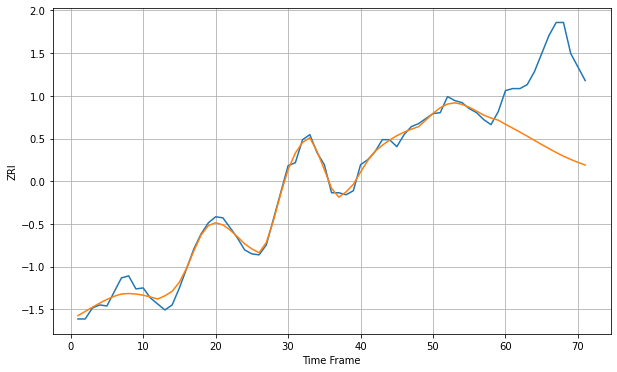

Wall time: 10.6 s
19139 5.964007010655027 88.95993346276404 [1110.35042244 1106.48617043 1102.53681437 1098.46874136 1094.30861768
 1090.13558756 1086.05573233 1082.1723212  1078.564391   1075.27867763
 1072.33242616 1069.72145516]

Got an mse at 0.0050 in round 332 and stopped training



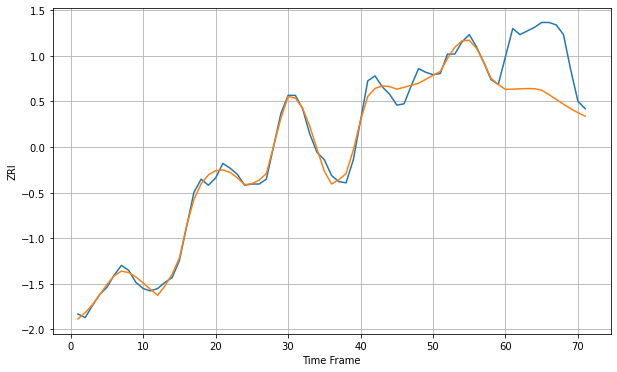

Wall time: 12.1 s
19140 5.2807259457027875 45.492013128632976 [991.88658032 992.11619855 992.37602618 992.56978754 992.45801606
 991.27252963 987.6118838  983.69294508 979.74734791 976.02105582
 972.70414556 969.88890679]

Got an mse at 0.0050 in round 428 and stopped training



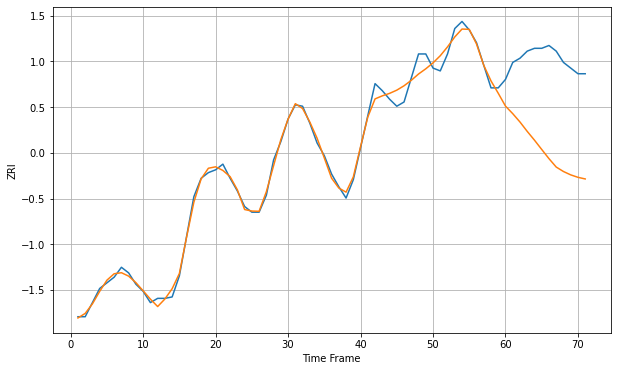

Wall time: 14.2 s
19141 4.567936500894034 65.86067425900866 [956.08150232 950.73255346 944.82211185 938.17947123 931.96047861
 925.38027905 918.88822891 912.94244592 909.78637976 907.40986353
 905.68174155 904.52551483]

Got an mse at 0.0050 in round 234 and stopped training



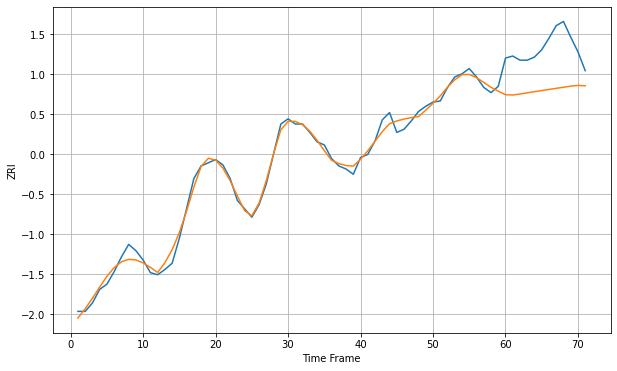

Wall time: 9.97 s
19143 5.330709316886672 41.44908673019778 [1113.00525994 1112.74988515 1113.6901727  1114.79871965 1115.89845301
 1116.98302415 1118.0505203  1119.1025477  1120.14216287 1121.17127268
 1121.88602426 1121.52464981]


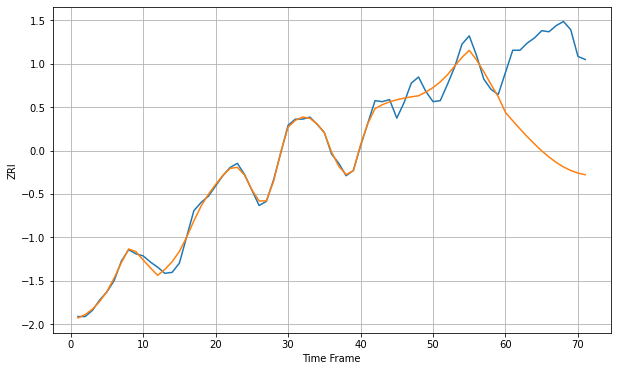

Wall time: 15.7 s
19144 6.5768512604992395 108.56491296890809 [1042.53267796 1034.37759627 1026.51047875 1018.94970244 1011.80234884
 1005.16701961  999.14925866  993.88283414  989.4965505   986.06221246
  983.56897666  981.93515514]


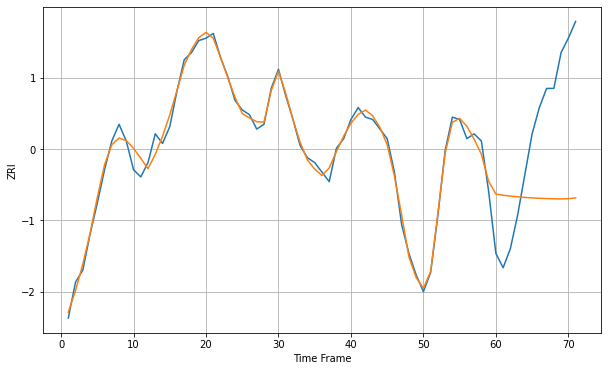

Wall time: 16.1 s
19146 3.0464867186776345 43.0852716298676 [1477.79358927 1477.34305203 1476.96992432 1476.66344219 1476.41439118
 1476.21473514 1476.05724108 1475.93532819 1475.84308262 1475.77530892
 1475.87914583 1476.21528177]


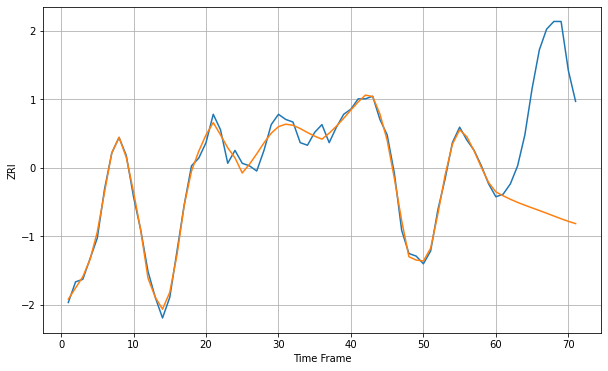

Wall time: 15.8 s
19147 2.534491826974017 49.434988501928 [1422.90743528 1421.39430994 1420.03801395 1418.8290457  1417.7316265
 1416.69560079 1415.67028107 1414.62184655 1413.54886962 1412.48514222
 1411.48531327 1410.60180033]


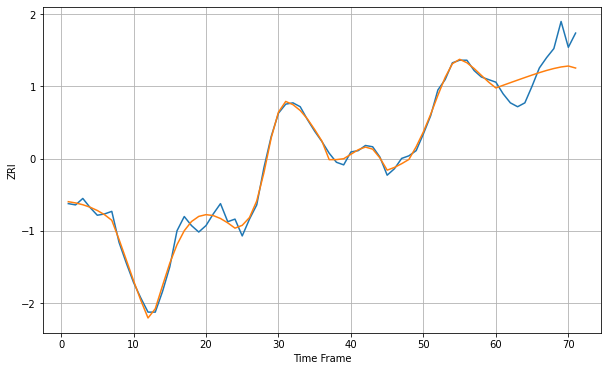

Wall time: 16 s
19148 4.258602971025704 17.606087340617986 [1252.52304013 1254.60124422 1256.62057397 1258.61379905 1260.5881155
 1262.5243811  1264.37887601 1266.08835409 1267.57905704 1268.77927701
 1269.51785994 1267.95575285]

Got an mse at 0.0050 in round 314 and stopped training



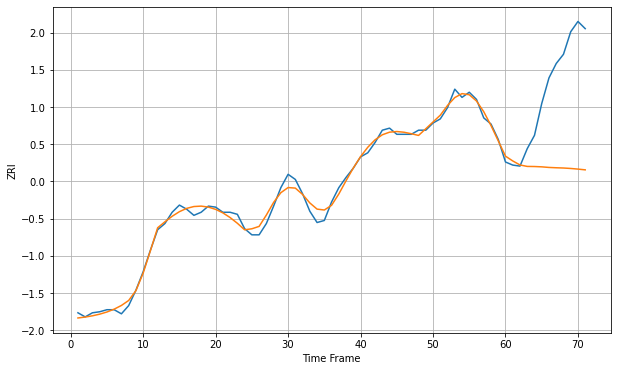

Wall time: 11.7 s
19401 5.085165400802659 87.91740786637416 [1196.6852894  1192.03229375 1188.11240526 1186.69442159 1186.5893733
 1186.27515418 1185.69297778 1185.38320172 1185.13780419 1184.69435188
 1184.08573789 1183.34479623]


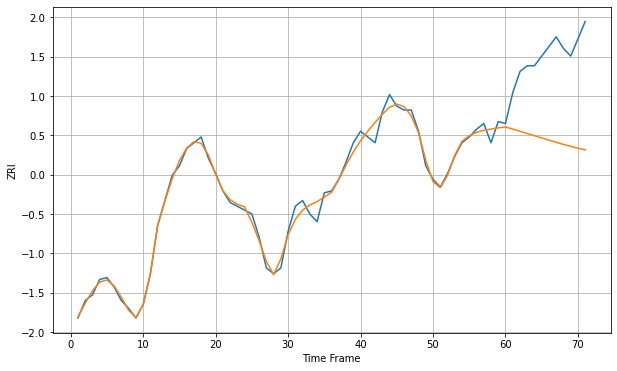

Wall time: 15.7 s
19464 3.262113479994837 44.17852848142712 [1099.17923482 1098.0896078  1096.95682479 1095.80549819 1094.64989251
 1093.49676444 1092.35189764 1091.22685608 1090.14106268 1089.1163626
 1088.16773959 1087.29787615]

Got an mse at 0.0049 in round 401 and stopped training



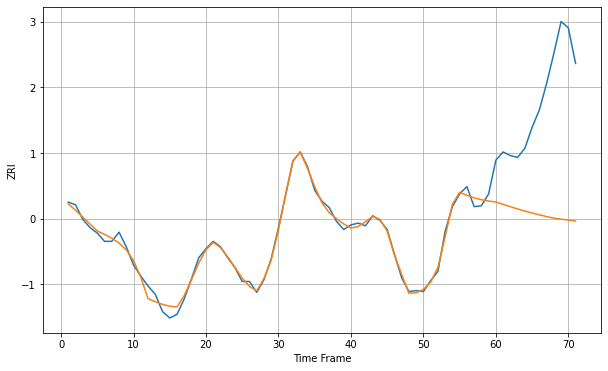

Wall time: 13.4 s
20001 5.051357828198857 133.4038383014206 [2302.10989683 2299.54447441 2296.9800198  2294.51976709 2292.20626319
 2290.04730834 2288.0347334  2286.15553901 2284.48168698 2283.34382357
 2282.26828697 2281.25222379]

Got an mse at 0.0050 in round 267 and stopped training



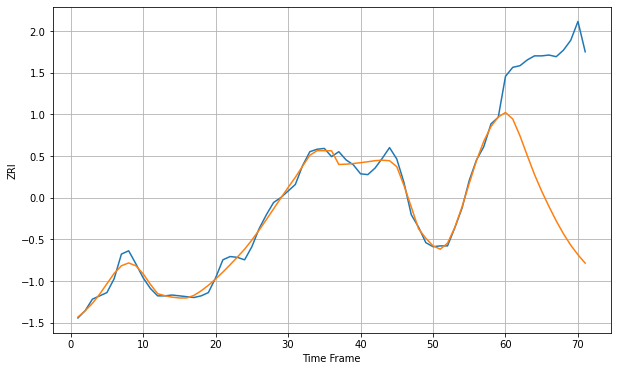

Wall time: 10.7 s
20002 7.152550813602099 184.8538649595401 [2156.87066044 2148.88309546 2128.35586941 2104.40601729 2081.21046787
 2060.72647668 2042.07015881 2024.60107781 2008.75160374 1994.95350035
 1983.14544851 1972.92952609]


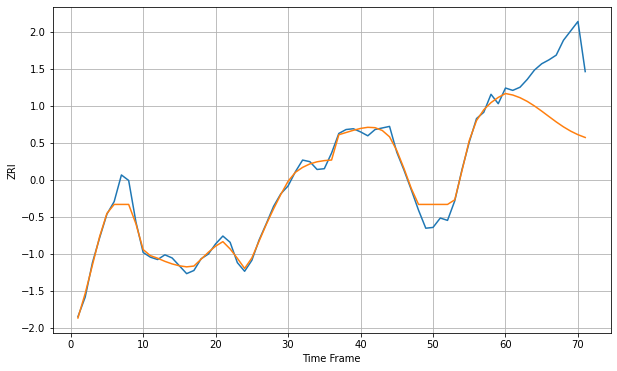

Wall time: 15.6 s
20003 10.416698580999617 79.55721468475156 [2313.97065136 2312.10088366 2308.67360748 2303.94632648 2298.07319751
 2291.49230535 2284.57165895 2277.73663424 2271.41336913 2265.92699044
 2261.41885662 2257.84877841]

Got an mse at 0.0050 in round 357 and stopped training



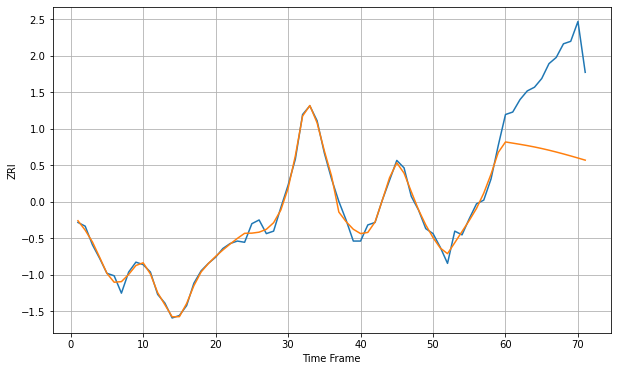

Wall time: 12.7 s
20005 4.1361429486085495 67.13236225347433 [2272.88000852 2271.9285453  2270.9721698  2269.95295845 2268.83112989
 2267.59016986 2266.23259548 2264.77157542 2263.22371572 2261.60512144
 2259.93015166 2258.21127009]


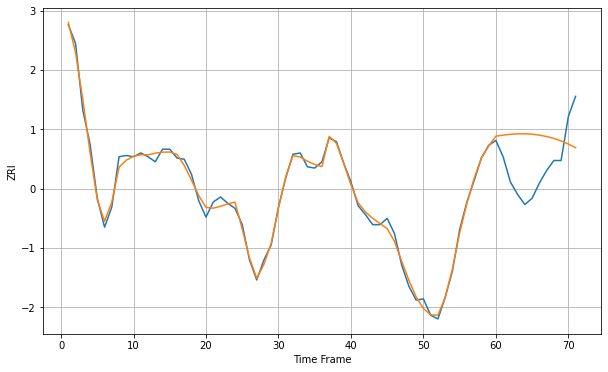

Wall time: 16.1 s
20007 3.9918706080501956 35.004712624007205 [2172.35376185 2173.19881628 2173.84483859 2174.21081375 2174.23917581
 2173.90329893 2173.19122769 2172.08744114 2170.56439923 2168.58617638
 2166.12691195 2163.20492154]

Got an mse at 0.0050 in round 494 and stopped training



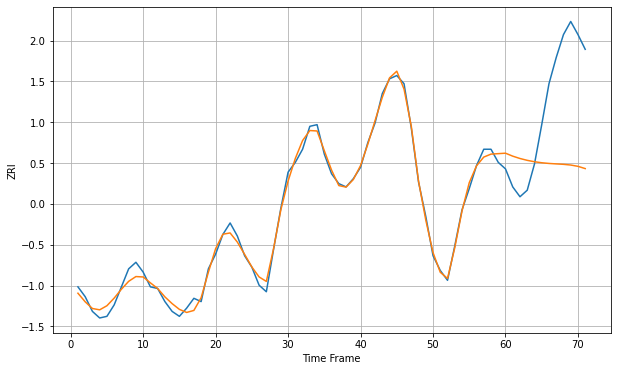

Wall time: 16.3 s
20008 3.500351465709902 53.366193525504215 [2054.58881479 2052.77925484 2051.34653408 2050.22557925 2049.37010156
 2048.74964742 2048.33151639 2048.05154019 2047.78920035 2047.36601812
 2046.57067471 2045.19033421]

Got an mse at 0.0050 in round 379 and stopped training



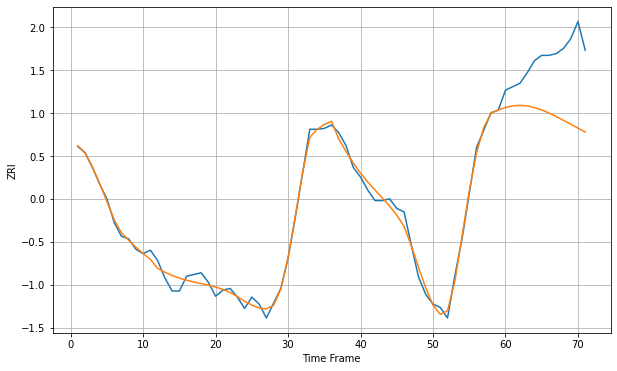

Wall time: 13.7 s
20009 6.936371502419757 70.61615048127261 [2327.1938401  2328.93382654 2329.58526235 2328.93178951 2326.95932855
 2324.2623254  2320.73123019 2316.63810507 2312.27024788 2307.7959284
 2303.33499331 2298.94559085]


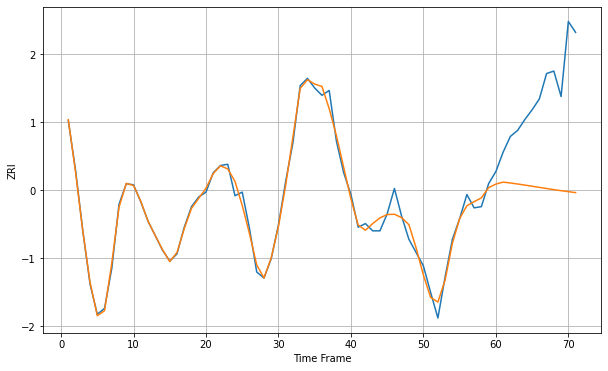

Wall time: 16.4 s
20010 5.8237077835724245 80.84163939789224 [2127.64291692 2129.23925997 2128.54015154 2127.69955915 2126.80072372
 2125.86912412 2124.91017527 2123.94797998 2123.02599106 2122.17126374
 2121.37738219 2120.59388903]

Got an mse at 0.0050 in round 497 and stopped training



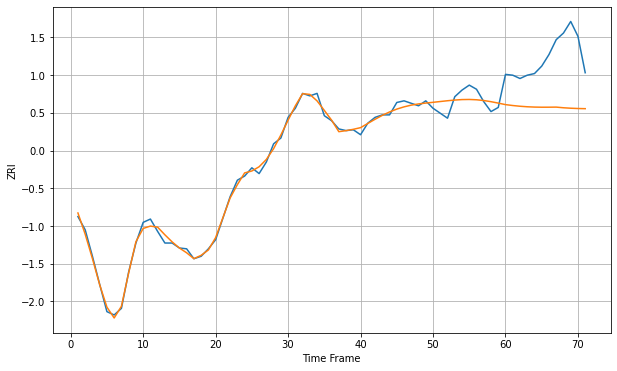

Wall time: 16.2 s
20011 6.441716545797333 63.76320852186317 [1900.423198   1899.32852686 1898.44938532 1897.81982073 1897.44046944
 1897.28203013 1897.29940946 1897.40307869 1896.61011781 1896.06616841
 1895.71756471 1895.52019161]

Got an mse at 0.0050 in round 296 and stopped training



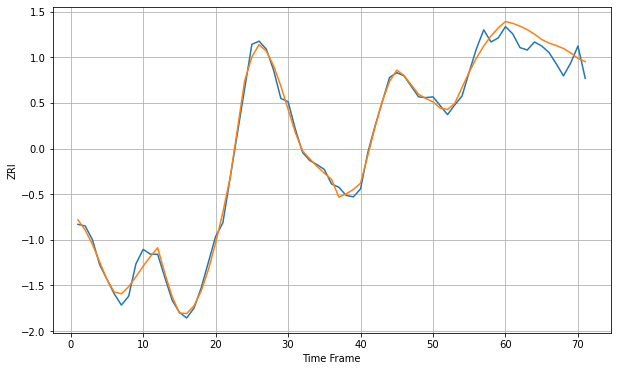

Wall time: 11.6 s
20019 7.963982258288457 18.97995647169134 [1717.39583536 1715.00349527 1711.62386847 1707.20659131 1701.69379305
 1695.02541406 1690.63629197 1687.61908048 1683.88593878 1678.48064262
 1671.67964561 1667.60400986]


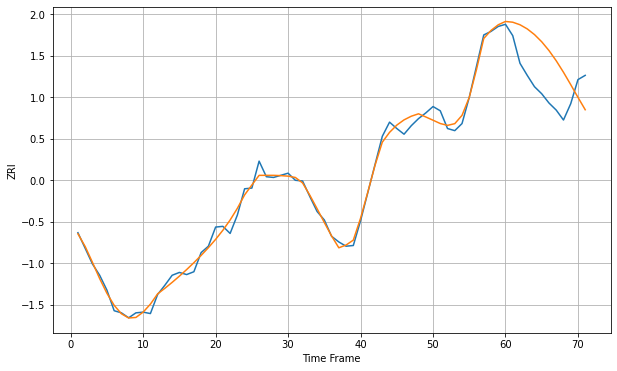

Wall time: 16.1 s
20020 8.417075816347161 55.4983174255225 [1682.01802916 1680.96812173 1677.37451885 1671.52516184 1663.5112079
 1653.33154239 1640.98607127 1626.57167908 1610.37074772 1592.91159333
 1574.97712164 1557.5239905 ]

Got an mse at 0.0050 in round 226 and stopped training



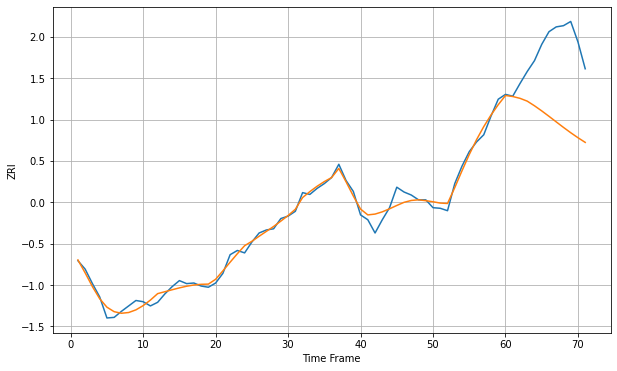

Wall time: 9.8 s
20024 9.627871209915682 118.35810046776461 [2346.16731508 2344.46532003 2341.4606158  2336.79212941 2329.08240224
 2320.61471914 2311.62033314 2302.38447449 2293.22112859 2284.40402212
 2276.10098039 2268.35706535]

Got an mse at 0.0050 in round 383 and stopped training



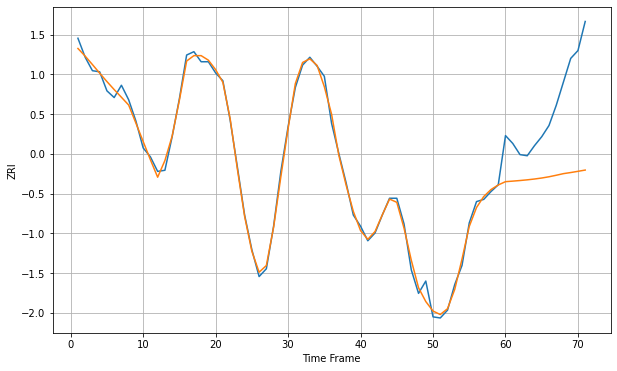

Wall time: 13.8 s
20037 4.993658660819007 69.81981050075579 [2378.82291581 2379.3068189  2379.84316859 2380.45965159 2381.19369422
 2382.08974817 2383.19492464 2384.55275436 2386.00233903 2386.98086182
 2388.06561017 2389.19652243]

Got an mse at 0.0050 in round 95 and stopped training



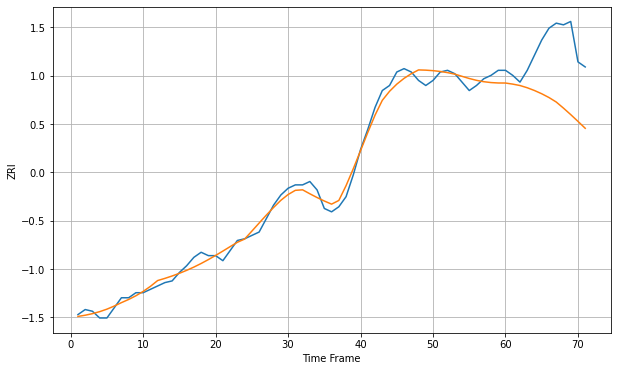

Wall time: 7.01 s
20109 4.036797466620138 33.67841926881092 [1452.45692918 1451.81192819 1450.97446213 1449.65503637 1448.01092763
 1446.08566158 1443.84612736 1441.19185445 1437.56024043 1433.71303449
 1429.70274078 1425.59462619]

Got an mse at 0.0050 in round 348 and stopped training



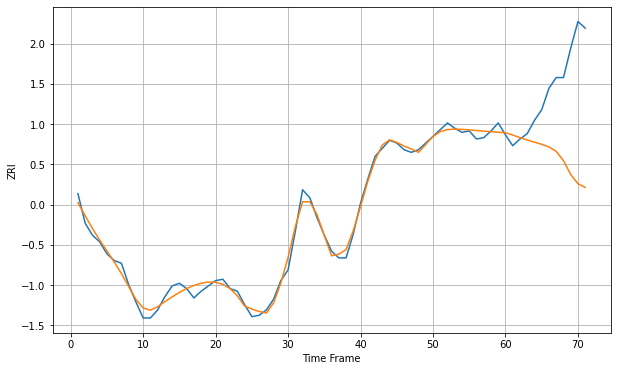

Wall time: 12.8 s
20110 4.23852168312109 63.12517639901986 [1405.74136941 1403.93262677 1402.02904609 1400.23749762 1398.61521299
 1397.01710907 1395.05547861 1391.74257839 1384.77681725 1374.39056753
 1367.53296488 1364.74074388]

Got an mse at 0.0050 in round 221 and stopped training



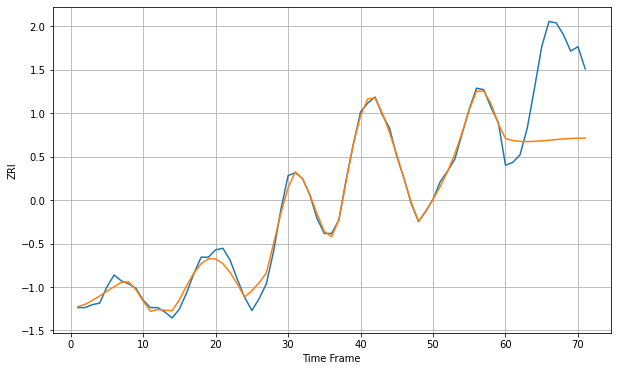

Wall time: 9.91 s
20147 4.085655401231338 52.45384548427556 [1611.01226242 1609.70634246 1609.13826935 1608.99951407 1609.16421679
 1609.47164508 1609.89818642 1610.35537457 1610.77151498 1611.09298833
 1611.28281603 1611.31792377]

Got an mse at 0.0049 in round 190 and stopped training



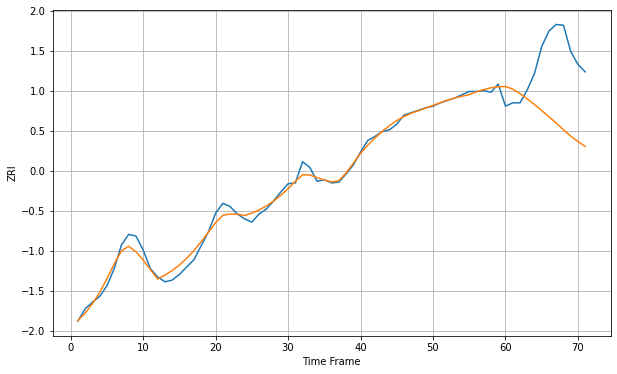

Wall time: 9.2 s
20175 6.827056144287571 80.96684849307701 [1645.10313095 1641.89141353 1636.42033389 1629.9388761  1622.95841133
 1615.61548856 1608.01966015 1600.29921512 1592.01952791 1584.31884888
 1577.65180743 1571.69115982]


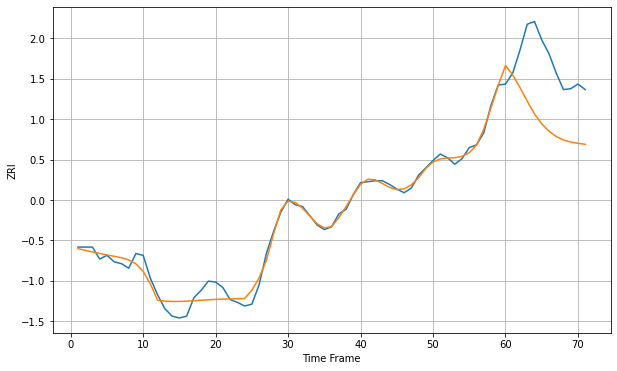

Wall time: 16.4 s
20176 7.575617920398604 66.65199312612118 [1644.21538129 1633.8872613  1620.21677095 1605.30083725 1591.72892595
 1580.84535671 1572.74785391 1567.06734509 1563.32068801 1561.03316518
 1559.69691385 1558.59081699]

Got an mse at 0.0050 in round 385 and stopped training



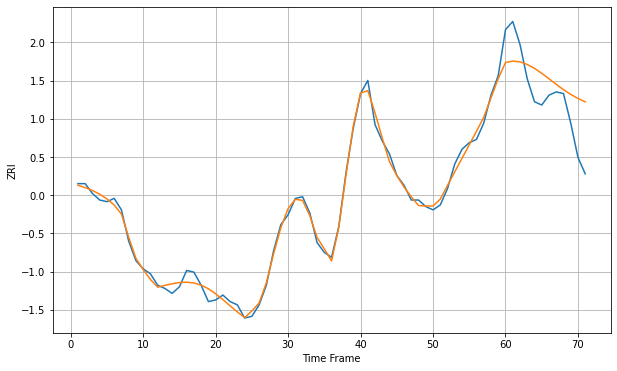

Wall time: 13.4 s
20740 3.287308485970431 21.655117179444158 [1650.92257207 1651.82773725 1651.36411896 1649.75496682 1647.35968119
 1644.36756746 1641.0272663  1637.61534209 1634.37796272 1631.4827077
 1629.00486389 1626.94359628]


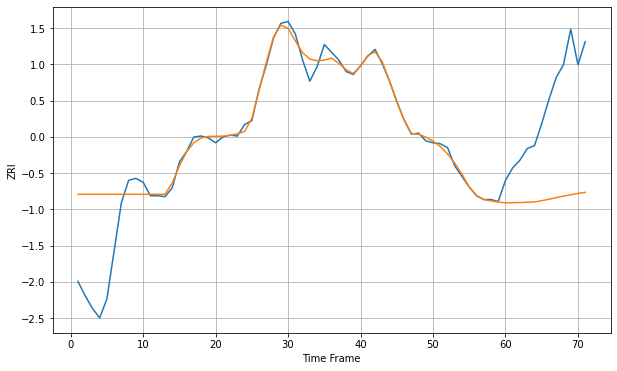

Wall time: 16.1 s
20814 33.72305945106999 105.54208799315116 [1947.5819998  1947.71626938 1947.92919847 1948.21157318 1948.55847431
 1949.76820337 1951.37655285 1952.98961409 1954.55531778 1956.02363126
 1957.38175457 1958.52231667]

Got an mse at 0.0050 in round 248 and stopped training



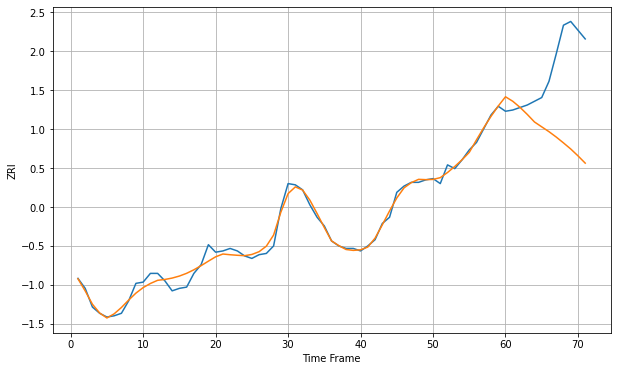

Wall time: 10.5 s
20850 4.395951451624772 62.296964454347616 [1863.6155433  1860.02538987 1855.13964069 1849.50212913 1843.40609328
 1839.50412734 1835.63317741 1831.31993067 1826.62994769 1821.75323778
 1816.25736957 1810.41025997]

Got an mse at 0.0050 in round 404 and stopped training



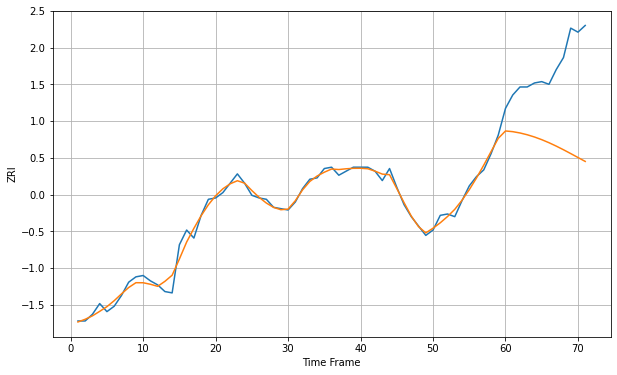

Wall time: 13.6 s
20852 3.874746302237321 61.15363294828821 [1774.09654709 1773.57900382 1772.60285743 1771.26075373 1769.58612332
 1767.5946576  1765.31376095 1762.7832021  1760.05470888 1757.18996541
 1754.25682527 1751.32407466]

Got an mse at 0.0050 in round 312 and stopped training



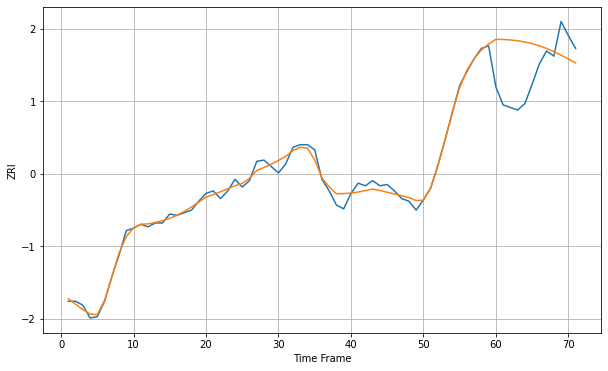

Wall time: 11.7 s
20878 3.970562027942705 34.552959922303785 [1708.06896601 1707.97326018 1707.6142133  1706.97277339 1706.02127437
 1704.72564422 1703.0524063  1700.98252886 1698.53068332 1695.76127585
 1692.78768166 1689.74822129]


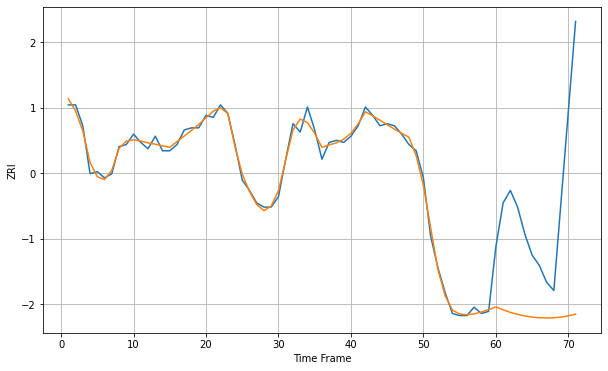

Wall time: 15.7 s
20902 2.536267945574872 61.54895854939598 [1721.17138891 1719.74739869 1718.5455653  1717.56835406 1716.8154427
 1716.28155728 1715.95943816 1715.84535148 1715.94448368 1716.27320683
 1716.85179452 1717.67780222]

Got an mse at 0.0050 in round 457 and stopped training



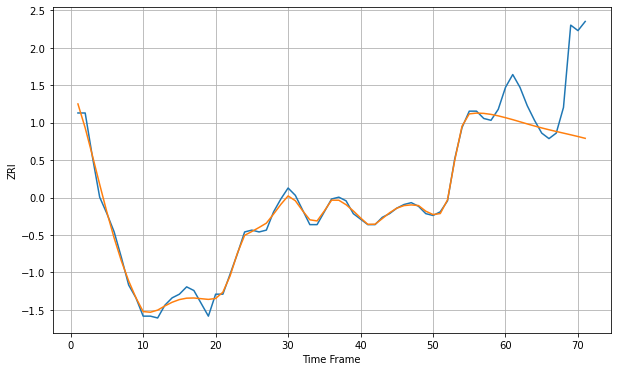

Wall time: 14.9 s
20906 2.859513062990542 32.38837607861025 [1570.42802267 1569.35335058 1568.19567404 1567.02478672 1565.89377905
 1564.83198709 1563.84202216 1562.90503695 1561.99259208 1561.07843626
 1560.14463447 1559.14931545]

Got an mse at 0.0050 in round 204 and stopped training



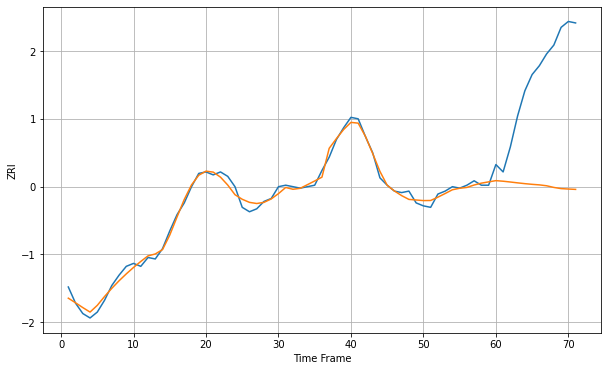

Wall time: 9.09 s
20910 3.228812653598068 78.36518648167227 [1713.08966783 1712.70681262 1712.16594871 1711.58980627 1711.05520907
 1710.59335467 1710.22568136 1709.61999721 1708.49618974 1707.69948288
 1707.412567   1707.16792222]


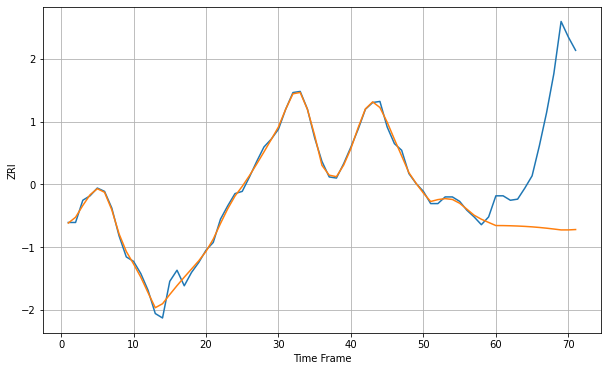

Wall time: 15.9 s
21043 4.082308867016119 105.32774401907957 [1539.2177214  1539.17839142 1539.02806911 1538.7963597  1538.47264837
 1538.04421393 1537.50151032 1536.84589186 1536.09563626 1535.28546633
 1535.29962829 1535.62771556]

Got an mse at 0.0050 in round 216 and stopped training



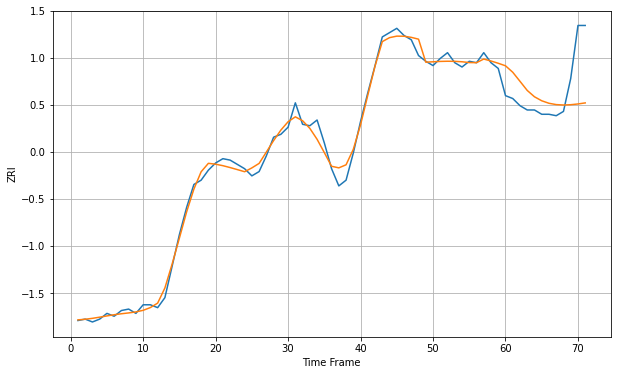

Wall time: 9.5 s
21044 4.622632061988639 25.528965902698907 [1651.84847005 1647.33800022 1641.01054772 1634.63600975 1630.20844043
 1627.42367338 1625.67522169 1624.75419204 1624.47828752 1624.67677684
 1625.20012983 1625.93487358]

Got an mse at 0.0050 in round 331 and stopped training



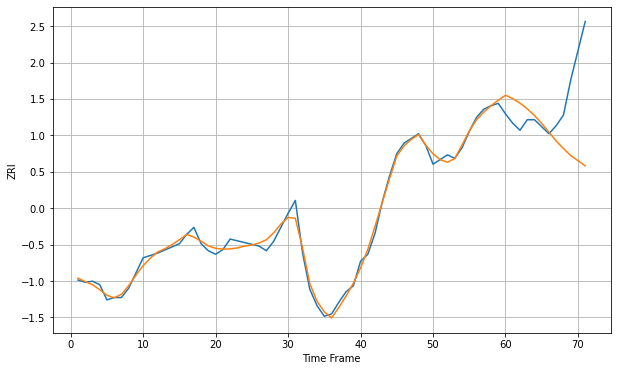

Wall time: 12 s
21046 4.3682774486238065 50.48326848715855 [1660.93260162 1658.05938009 1654.18545452 1649.36837672 1643.64403447
 1636.76546826 1629.37859449 1621.73623809 1615.38852391 1609.38563506
 1604.98385915 1600.59568268]

Got an mse at 0.0050 in round 164 and stopped training



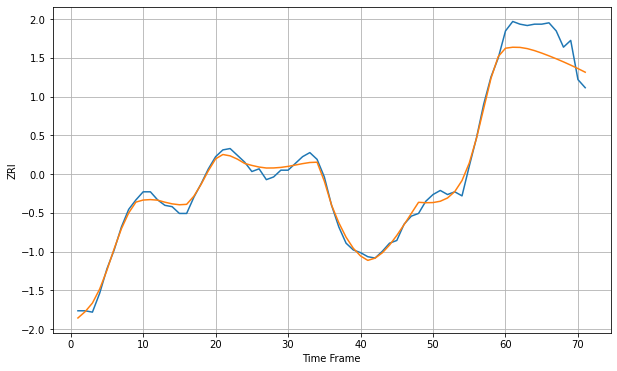

Wall time: 8.36 s
21061 4.018805349257332 17.383649438815933 [1450.21868444 1450.93741042 1450.81920783 1449.92503697 1448.44374707
 1446.6048615  1444.56818298 1442.40081426 1440.11459133 1437.70175729
 1435.15376022 1432.47066488]

Got an mse at 0.0050 in round 171 and stopped training



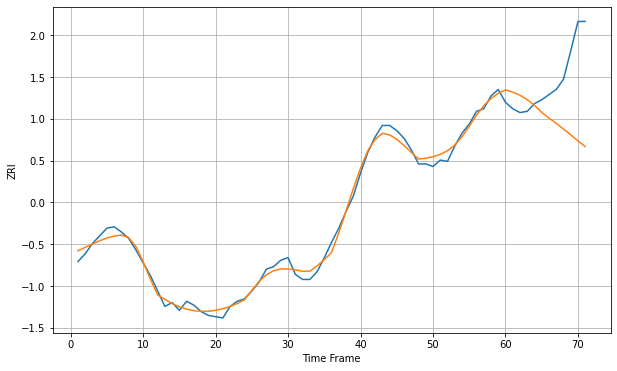

Wall time: 8.48 s
21117 4.558394504985033 46.16840940164722 [1355.69020195 1354.01103866 1351.51401512 1348.10748944 1343.69211784
 1338.20152018 1333.74445335 1329.65428425 1325.20378828 1320.68254684
 1315.93718505 1311.5719934 ]

Got an mse at 0.0050 in round 473 and stopped training



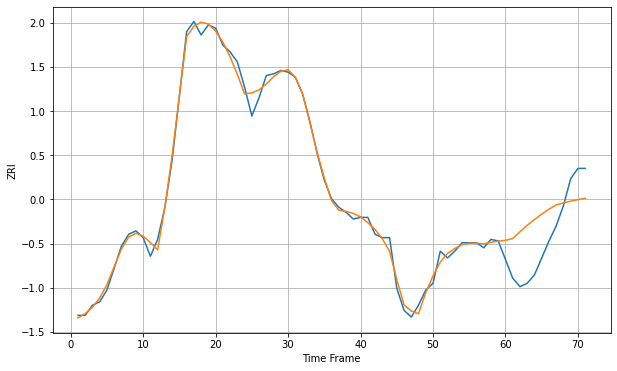

Wall time: 15.1 s
21202 3.6755653290976062 22.380832737370568 [1243.41704196 1244.4965839  1248.51661295 1252.33458259 1255.7616177
 1258.94319424 1261.85621854 1264.40298131 1265.57855914 1266.61336306
 1267.51780142 1268.30427451]


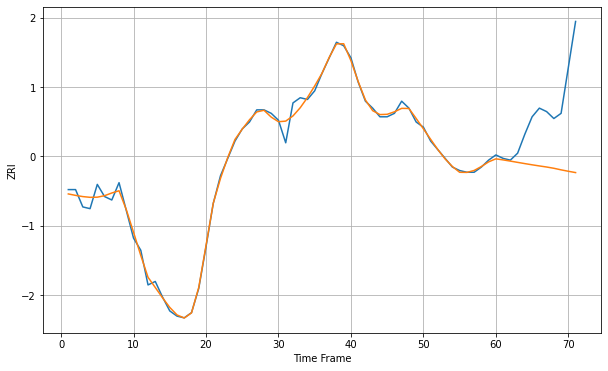

Wall time: 15.5 s
21204 3.0600321004856905 36.86153280345105 [1298.74543477 1298.13083534 1297.43723337 1296.71069066 1295.99096365
 1295.30130441 1294.64860248 1294.02978948 1293.300033   1292.39102077
 1291.5704797  1290.81271292]


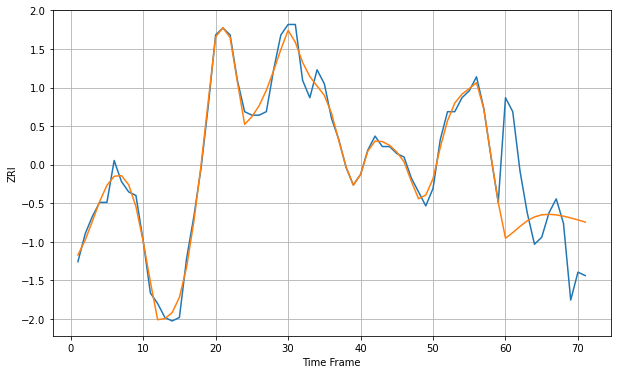

Wall time: 15.8 s
21217 2.626410216527898 18.760423861191377 [1028.73387659 1030.32800919 1032.11086148 1033.70753185 1034.83619017
 1035.43029164 1035.5788612  1035.41161994 1035.03867163 1034.53919586
 1033.96746988 1033.3607966 ]

Got an mse at 0.0050 in round 326 and stopped training



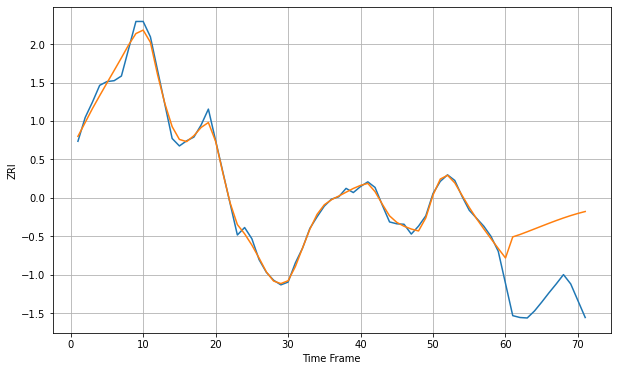

Wall time: 11.9 s
21231 11.531359367328061 162.97887781732774 [1757.71241507 1802.92936778 1808.05219937 1813.94377578 1819.9884097
 1826.08084955 1832.10660775 1837.94911536 1843.4936318  1848.63259505
 1853.27514665 1857.35870883]


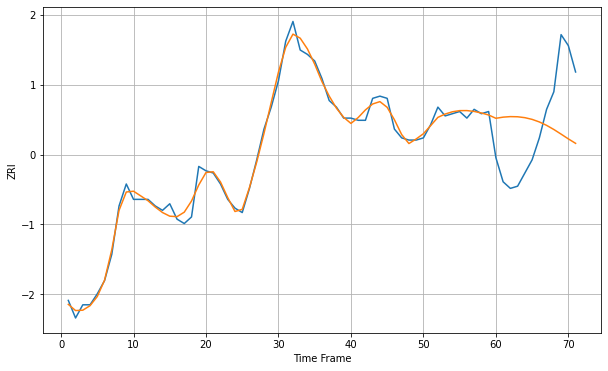

Wall time: 15.7 s
22030 2.872592566114368 28.195895937349732 [1727.91484295 1728.43743796 1728.67842385 1728.60935535 1728.19946711
 1727.41944928 1726.24986121 1724.69677901 1722.81259328 1720.70857799
 1718.53997155 1716.50681859]


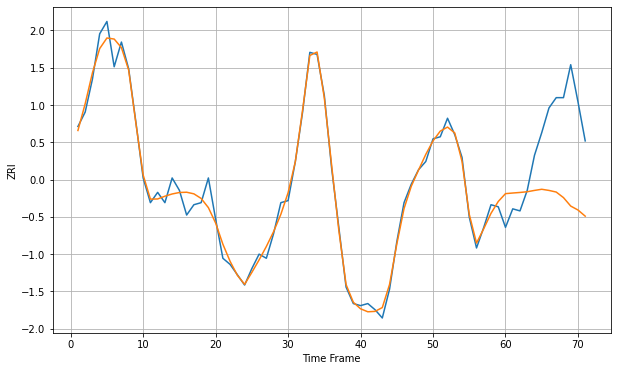

Wall time: 15.8 s
22031 4.269221904158307 36.88944768759501 [1805.38011688 1805.68735492 1805.95842671 1806.30801492 1806.95021412
 1807.50573555 1806.94500524 1806.15582519 1803.45685101 1799.34505925
 1797.43751188 1794.44365724]

Got an mse at 0.0050 in round 243 and stopped training



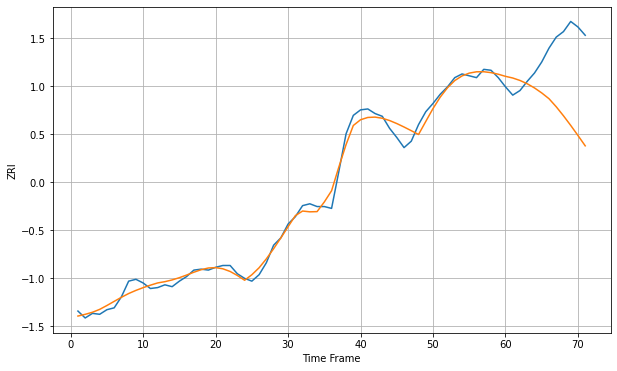

Wall time: 10.1 s
22033 7.319499246521316 70.78475728250012 [1818.40176734 1816.60317821 1813.93335314 1810.33911664 1805.81108247
 1800.38406149 1794.1351205  1785.37243263 1775.56414035 1765.1068736
 1754.17497146 1742.94510746]

Got an mse at 0.0050 in round 412 and stopped training



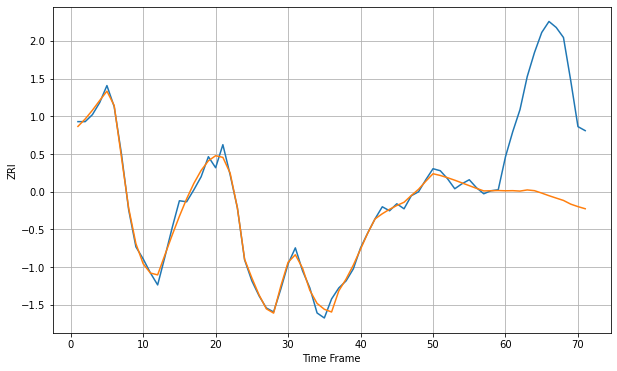

Wall time: 13.6 s
22102 5.304599919850903 123.20855520551498 [2039.96502877 2040.09469129 2039.67160295 2040.81653209 2040.07598107
 2037.66935194 2035.07449236 2032.68372104 2030.33515722 2026.65184497
 2024.16785446 2022.04682174]


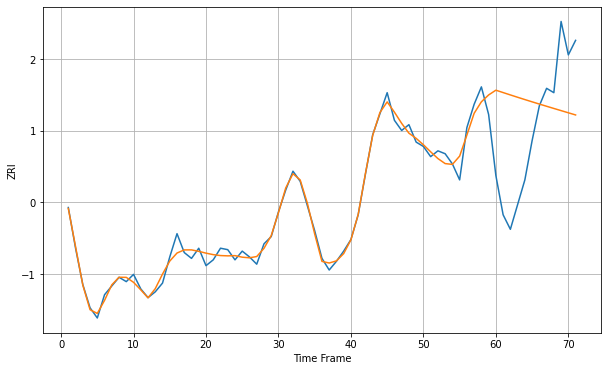

Wall time: 15.7 s
22180 4.908296001871379 55.18139605368425 [1887.71411656 1886.08029591 1884.45495221 1882.84837118 1881.26550701
 1879.70723229 1878.17168103 1876.65529977 1875.15349937 1873.66097807
 1872.17184922 1870.67970066]


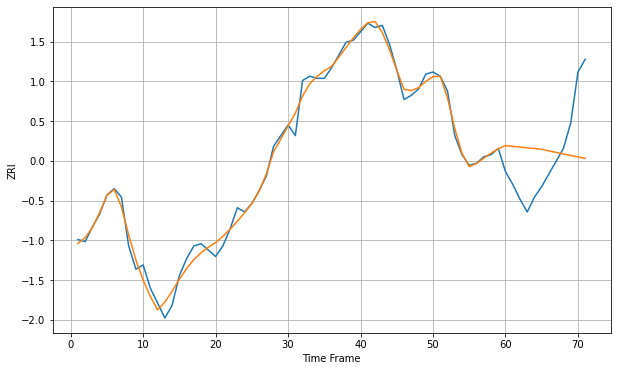

Wall time: 15.6 s
22191 3.560664156069817 24.132101848128055 [1479.30163957 1478.94973166 1478.58756283 1478.24703645 1477.93683735
 1477.53329078 1476.80764323 1476.07470678 1475.35248309 1474.64727231
 1473.95864579 1473.28387225]

Got an mse at 0.0050 in round 50 and stopped training



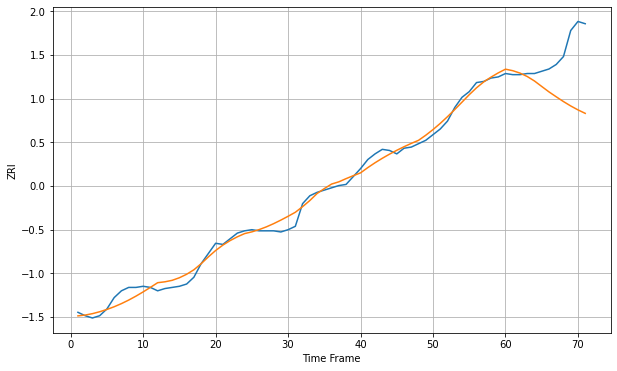

Wall time: 5.84 s
22192 5.402923628522833 40.709660432194504 [1460.84083281 1459.49970661 1457.38469231 1454.36752357 1450.39515166
 1445.56301021 1440.76856258 1436.43562786 1432.2206864  1428.34118212
 1424.87398461 1421.80029687]

Got an mse at 0.0050 in round 376 and stopped training



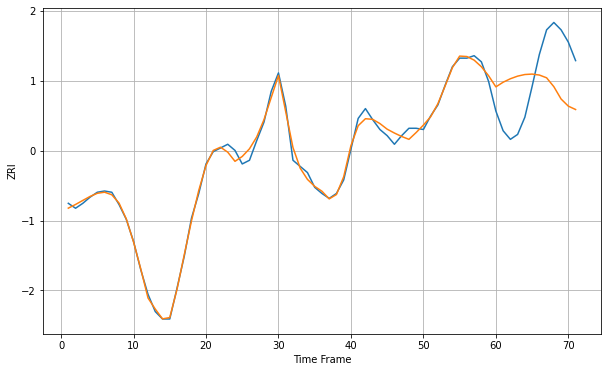

Wall time: 12.9 s
22201 3.984908222093813 40.70824500265723 [2133.66329217 2137.4273165  2140.25017241 2142.37725412 2143.69040185
 2144.04360071 2143.26571119 2141.02587708 2133.80034333 2123.78017484
 2117.9824145  2115.25111543]

Got an mse at 0.0050 in round 131 and stopped training



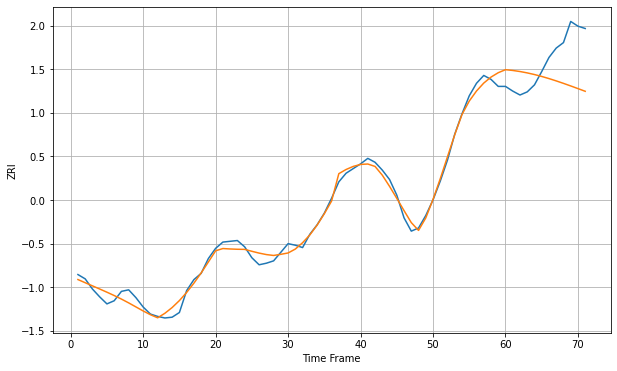

Wall time: 7.65 s
22202 7.831865795065232 48.014598057254275 [2180.3662256  2179.38681327 2178.01180003 2176.25781323 2174.14903536
 2171.71563679 2168.99444172 2166.02997431 2162.87327096 2159.57743189
 2156.19117814 2152.75292456]


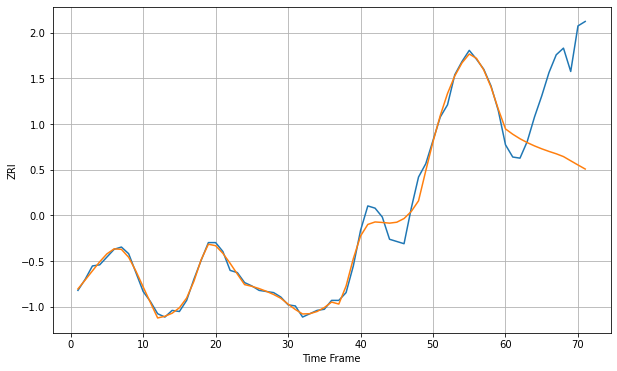

Wall time: 16.1 s
22203 6.412339969179524 74.22709242808554 [2083.30012842 2078.5274911  2074.45734028 2070.99574514 2068.01543414
 2065.40144304 2063.06223441 2060.92906655 2058.40467267 2054.61476925
 2050.86963696 2047.20904727]

Got an mse at 0.0050 in round 376 and stopped training



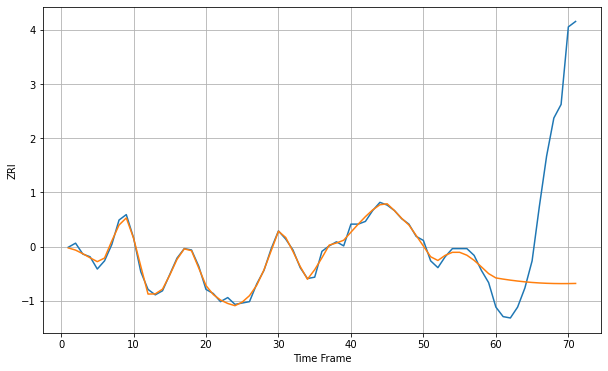

Wall time: 13.2 s
22204 2.7839419640979433 99.7517544790955 [1778.45155698 1777.58199762 1776.81271899 1776.14376051 1775.57652158
 1775.11279294 1774.75328259 1774.49647114 1774.33827578 1774.2724867
 1774.29161703 1774.38778404]


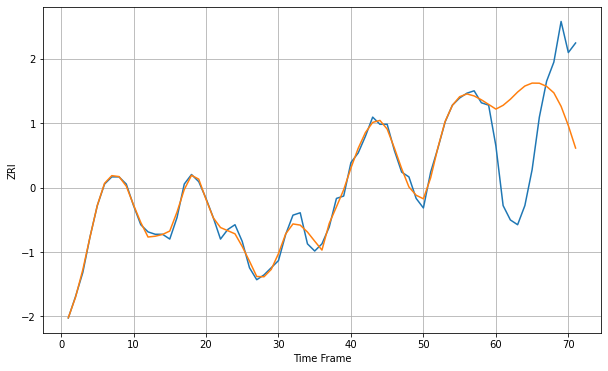

Wall time: 16 s
22206 2.162621195937863 36.42962670569841 [1891.35403652 1892.93654398 1895.46813365 1898.47830526 1901.00074318
 1902.22569882 1902.18016801 1900.85338952 1898.16129538 1892.50136385
 1884.46399659 1875.06113665]


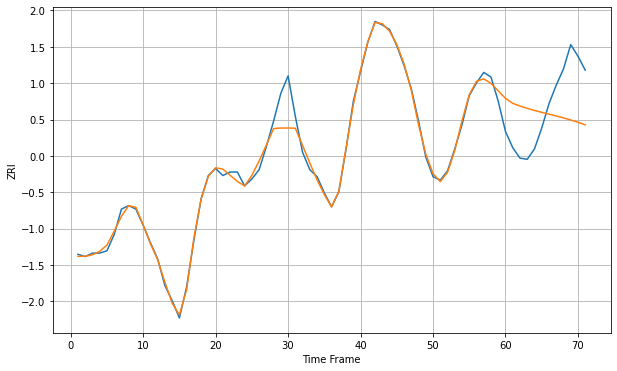

Wall time: 15.6 s
22209 7.856286083153007 40.63916411771419 [2257.59041877 2253.29028753 2251.02038835 2248.99736144 2247.19086911
 2245.54500147 2243.9851527  2242.42142114 2240.76101632 2238.93524151
 2236.93382548 2234.82536085]


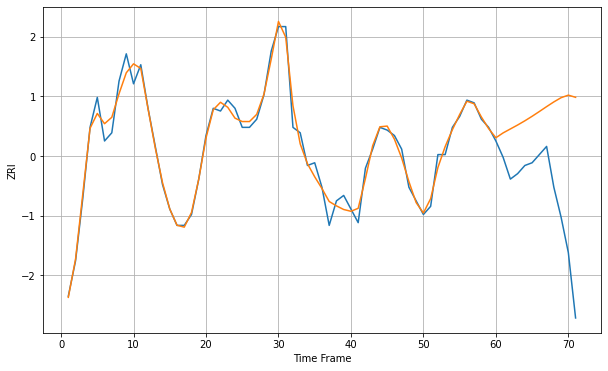

Wall time: 15.6 s
22303 3.263293448863539 34.86231085865262 [1724.18666177 1725.96259905 1727.41389144 1728.86172917 1730.40583633
 1732.0636553  1733.81870232 1735.61071264 1737.34610394 1738.89722549
 1739.83133494 1739.03510043]

Got an mse at 0.0050 in round 324 and stopped training



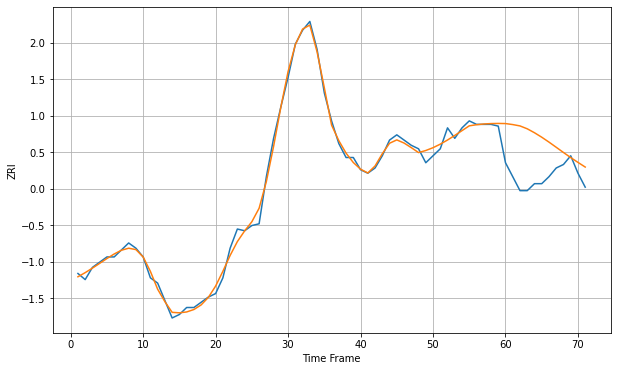

Wall time: 11.8 s
22304 2.9456107793465454 23.00051959096766 [1600.46292709 1599.88483123 1599.10722659 1597.46265999 1595.19946945
 1592.63933744 1589.8284705  1586.86531536 1583.87420909 1580.96417761
 1578.20103199 1575.53500433]


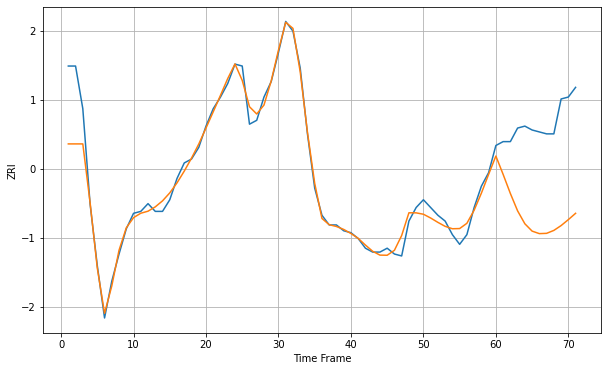

Wall time: 15.6 s
22305 8.493351672639589 48.720304328356214 [1762.55998574 1753.10817606 1743.23752476 1734.2533697  1727.60587322
 1723.82027952 1722.52352337 1722.66990806 1724.18186486 1726.67424505
 1729.74309938 1733.00770672]


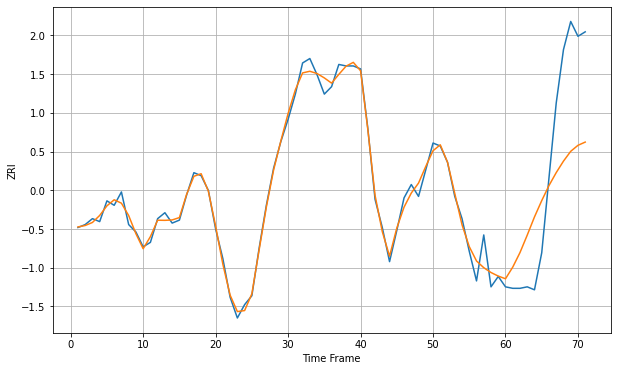

Wall time: 15.4 s
22312 5.200836385589943 51.789700736022596 [1696.44527797 1704.29838672 1714.12338996 1725.89799912 1738.17316463
 1749.15941764 1759.31149645 1768.04875525 1775.7887802  1782.41226003
 1786.45773482 1788.63707401]

Got an mse at 0.0050 in round 138 and stopped training



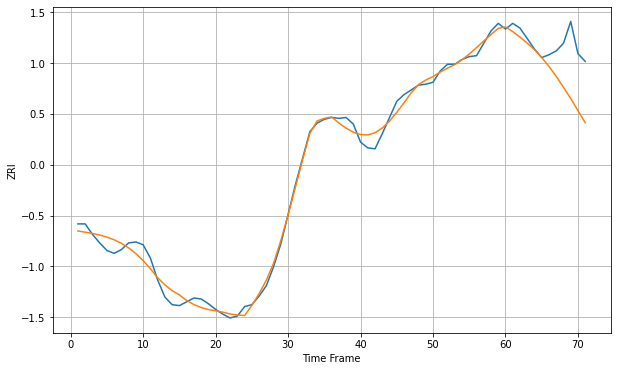

Wall time: 7.8 s
22901 7.518122100411094 38.19448032532985 [1281.30973984 1276.30120596 1270.54603448 1264.18634645 1257.36169938
 1249.04489564 1239.67024301 1229.20762873 1217.738959   1205.95368577
 1193.16347697 1180.55618474]

Got an mse at 0.0050 in round 160 and stopped training



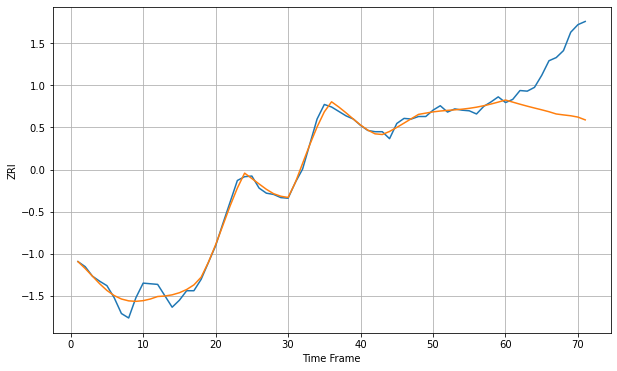

Wall time: 8.29 s
22903 9.33571506858791 87.84534179459851 [1432.03562191 1428.70597057 1425.42086734 1422.29259544 1419.36577385
 1416.54097197 1413.53901335 1409.99408879 1408.51614681 1407.15744751
 1405.05586144 1400.6574745 ]

Got an mse at 0.0050 in round 196 and stopped training



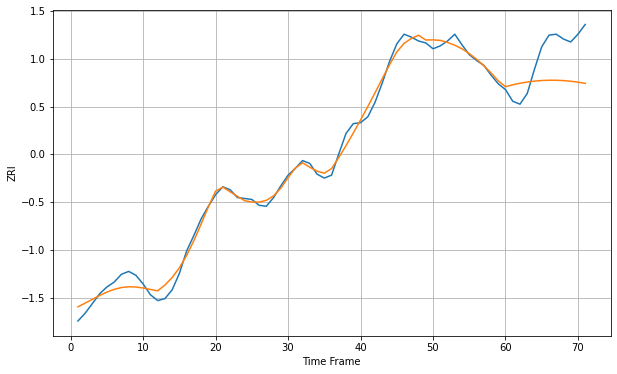

Wall time: 9.49 s
23220 6.893978305353158 36.76212428229632 [1157.99725008 1159.93889686 1161.53864127 1162.80163164 1163.73439029
 1164.3428738  1164.63125283 1164.60199157 1164.25719585 1163.60050206
 1162.6386147  1161.3820367 ]

Got an mse at 0.0049 in round 163 and stopped training



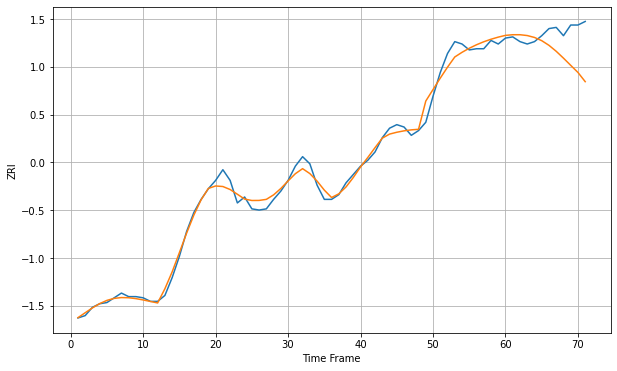

Wall time: 8.45 s
23223 5.632905006449583 23.128150035948632 [1145.27598644 1145.81152133 1145.81749422 1145.12373635 1143.52107146
 1140.80491842 1136.87215648 1131.83980213 1126.06733885 1120.00318542
 1114.00154692 1106.24813497]

Got an mse at 0.0050 in round 179 and stopped training



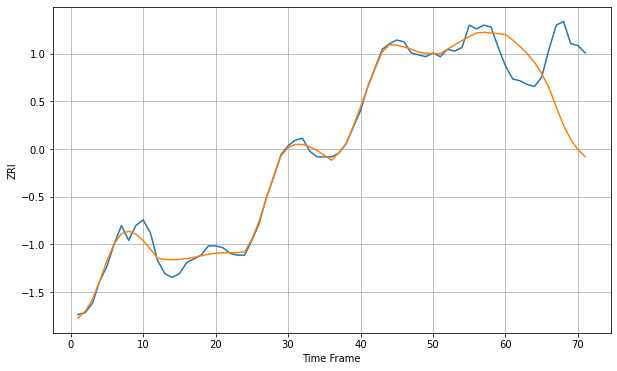

Wall time: 8.91 s
23294 3.619479968750754 36.444126316023045 [1089.93222304 1086.95569469 1083.51830471 1079.55000835 1075.00652255
 1068.92910353 1061.3209561  1050.93708948 1041.1235371  1033.48630845
 1027.90496416 1024.04578806]

Got an mse at 0.0049 in round 365 and stopped training



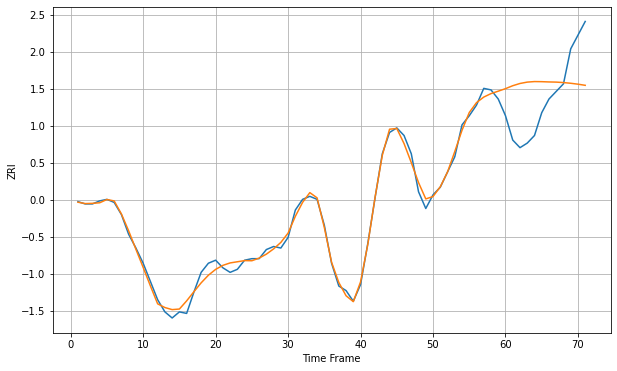

Wall time: 13.1 s
23451 3.402825373739559 29.071210137884457 [1204.81130721 1206.74742731 1208.21948513 1209.11615326 1209.47162789
 1209.40253529 1209.22515701 1209.11709963 1208.81612053 1208.35476941
 1207.74981092 1207.0090355 ]

Got an mse at 0.0050 in round 340 and stopped training



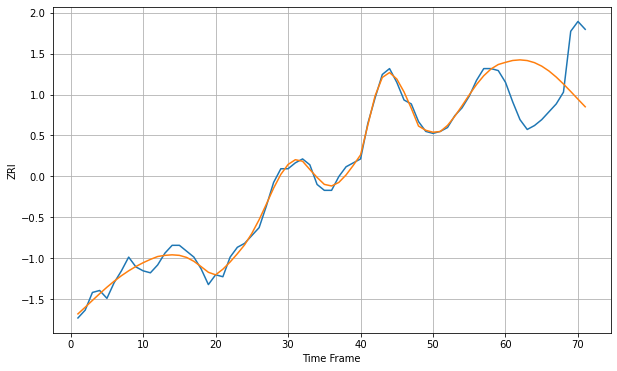

Wall time: 12.1 s
23452 2.9414630310643792 27.651445174155114 [1207.18479542 1208.13475712 1208.44740609 1208.08823332 1207.0255544
 1205.24383426 1202.76763062 1199.68367457 1196.14270574 1192.33018393
 1188.41931562 1184.55684983]


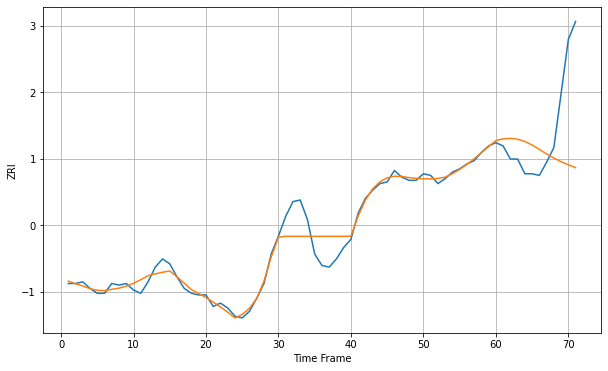

Wall time: 15.9 s
23454 6.5964468784403545 37.52955521716102 [1163.28729783 1164.31081094 1164.62094608 1164.11433744 1162.72913615
 1160.54907173 1157.87153398 1155.10706344 1152.56554313 1150.35545071
 1148.44540294 1146.75958859]

Got an mse at 0.0050 in round 415 and stopped training



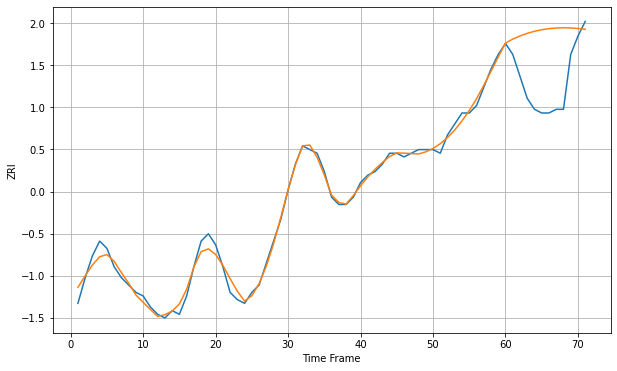

Wall time: 13.9 s
23503 1.6028309860304515 15.82957751892833 [833.10859425 834.17127593 835.0392901  835.75149712 836.31551437
 836.74038067 837.03536097 837.2093203  837.27051013 837.2266426
 837.08513891 836.85342981]

Got an mse at 0.0050 in round 475 and stopped training



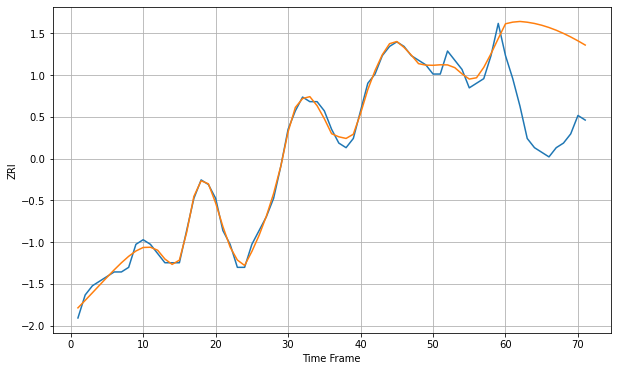

Wall time: 15.2 s
23518 1.273089254031117 21.695390243308342 [830.9233677  831.2774096  831.42449556 831.26350293 830.99055142
 830.60576569 830.11275984 829.5180498  828.83005163 828.05808862
 827.2117206  826.30044269]

Got an mse at 0.0049 in round 265 and stopped training



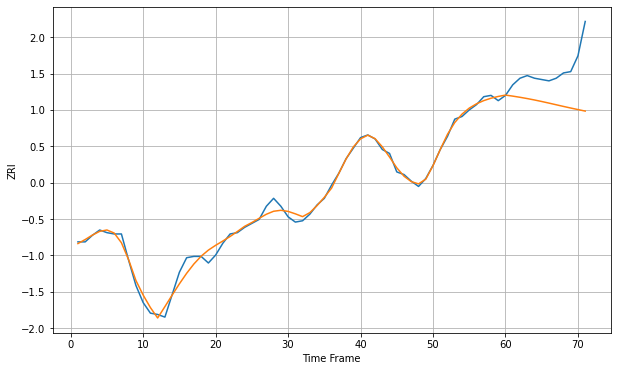

Wall time: 10.5 s
23602 3.8618880316495012 28.137742238613228 [1003.22168453 1002.43224755 1001.55152549 1000.57812344  999.51210621
  998.35972585  997.13873966  995.88108419  994.62753031  993.41197617
  992.24295517  991.09392872]

Got an mse at 0.0050 in round 199 and stopped training



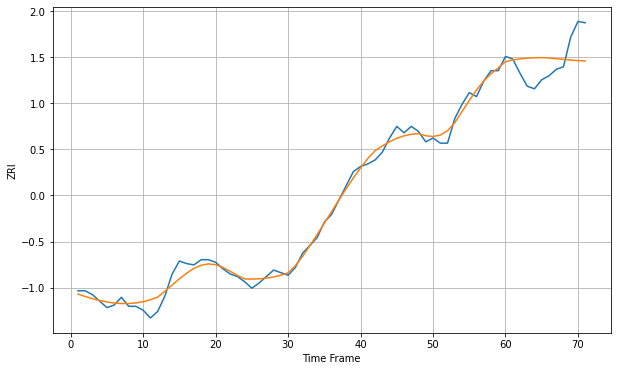

Wall time: 9.14 s
23666 5.011176526677294 17.961730512376626 [1067.99966513 1069.26330904 1070.12106295 1070.65974864 1070.96253544
 1071.10231507 1070.78971074 1070.22128457 1069.69370063 1069.21625819
 1068.78755336 1068.39919846]

Got an mse at 0.0050 in round 447 and stopped training



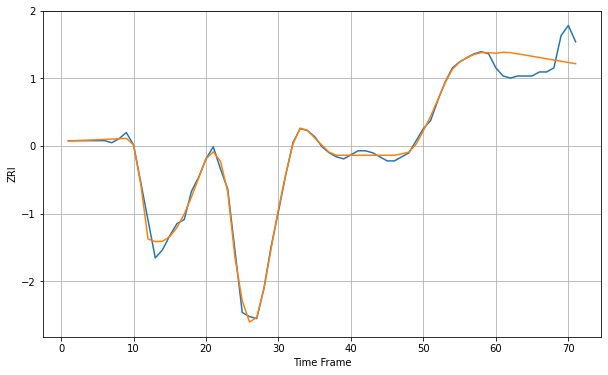

Wall time: 14.3 s
23803 2.3492035835063128 10.78507150752488 [929.24342844 929.74237276 929.54058425 928.96448505 928.37184994
 927.76647353 927.15197572 926.53183995 925.91000196 925.29163656
 924.68367977 924.09480489]

Got an mse at 0.0050 in round 175 and stopped training



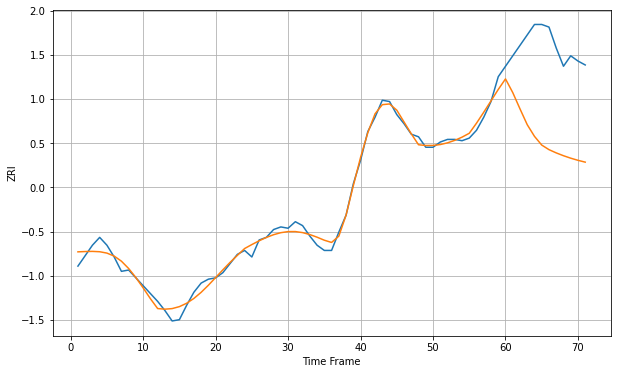

Wall time: 8.76 s
23831 4.7586692539414805 71.43476005332421 [1094.31734036 1083.86137183 1071.38410983 1059.27300317 1050.33308948
 1043.677442   1040.16344214 1037.67782579 1035.51666766 1033.63243567
 1031.99813397 1030.59766778]

Got an mse at 0.0050 in round 482 and stopped training



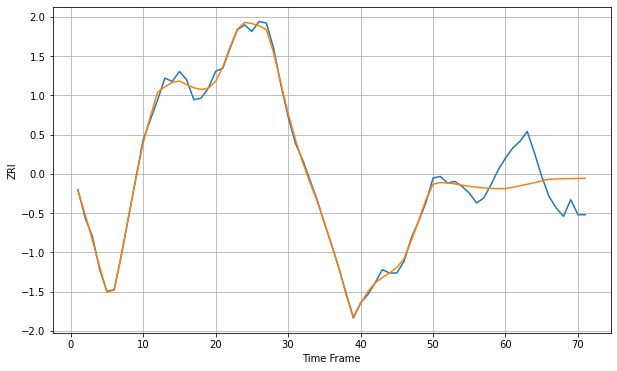

Wall time: 15.6 s
26003 3.3164457004584893 20.340053251795172 [813.61927889 814.47475062 815.34990667 816.28033246 817.25448148
 818.25007568 819.23612141 819.42194243 819.61958347 819.70068542
 819.78290523 819.88022959]


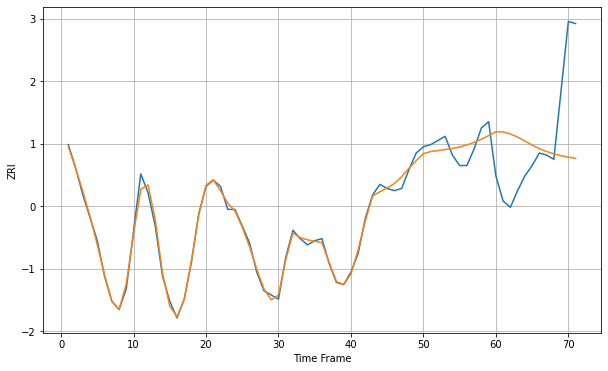

Wall time: 15.8 s
26505 3.121332508733703 33.1631776877023 [959.18319955 959.08487252 958.13313021 956.64392045 954.75474798
 952.80727819 951.10033891 949.71679625 948.60977032 947.71740791
 947.00115205 946.44190815]

Got an mse at 0.0050 in round 113 and stopped training



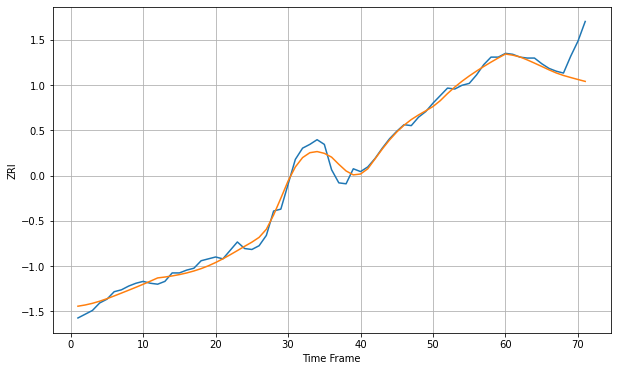

Wall time: 7.29 s
27513 6.752884655904546 22.949416535292535 [1200.2990631  1199.06500034 1197.21347104 1194.04550105 1190.62369656
 1187.06386695 1183.47464406 1180.14153268 1177.44628673 1175.26070534
 1173.15638936 1171.12689276]

Got an mse at 0.0050 in round 132 and stopped training



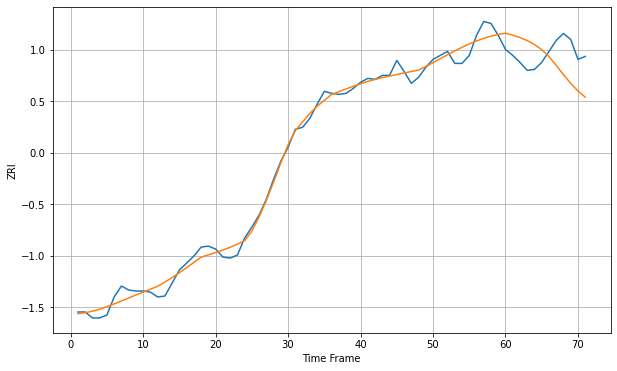

Wall time: 7.77 s
27560 7.279963725985136 28.761834776534716 [1324.21569984 1322.30060168 1319.90324952 1316.84483062 1312.89187456
 1307.79222811 1300.87360755 1291.98675532 1282.71273547 1273.99506048
 1266.43245903 1260.15643024]

Got an mse at 0.0050 in round 165 and stopped training



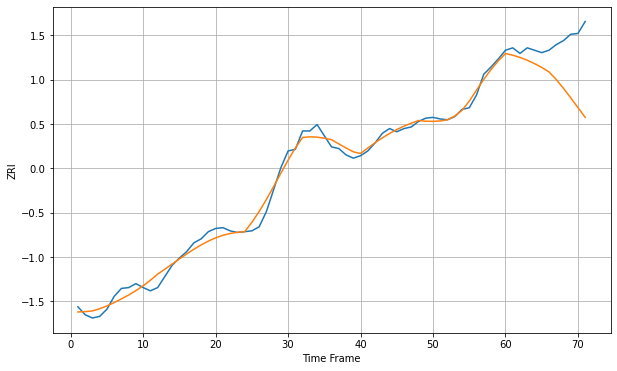

Wall time: 8.29 s
27606 7.788035498124846 55.167178612155354 [1192.88178901 1190.79945199 1188.01296845 1184.48243922 1180.22910732
 1175.49866047 1169.89791546 1160.41557678 1149.34073108 1137.45460796
 1125.19089624 1113.01741216]

Got an mse at 0.0049 in round 140 and stopped training



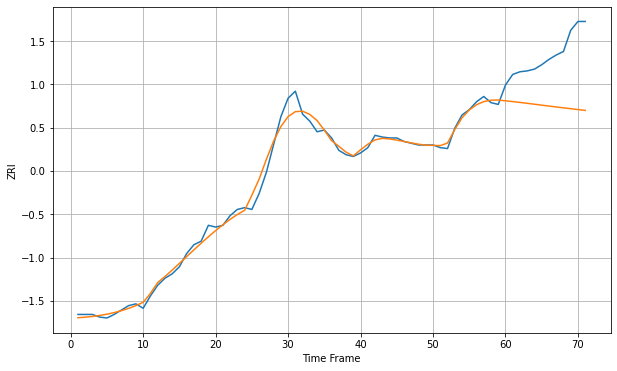

Wall time: 8.12 s
27609 6.869615074709774 61.83087781411562 [1116.06149852 1115.21003899 1114.26157771 1113.25115861 1112.20996682
 1111.1628289  1110.12677594 1109.11077708 1108.11650714 1107.13989095
 1106.17314889 1105.20708697]

Got an mse at 0.0050 in round 80 and stopped training



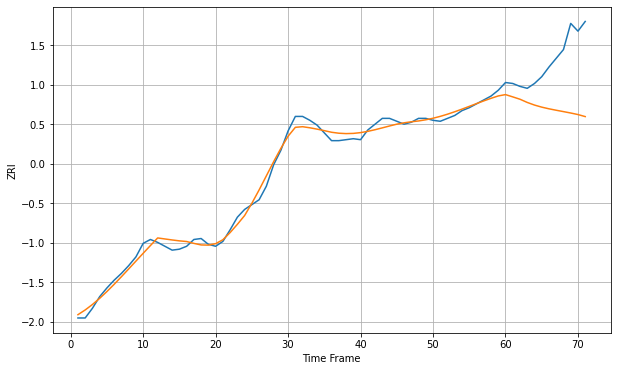

Wall time: 6.7 s
27612 5.730258491542122 55.264568968460836 [1087.52688764 1085.17157671 1082.74036412 1079.4364114  1076.72703342
 1074.58507792 1072.86085643 1071.37564044 1069.96924873 1068.51780144
 1066.93664997 1064.83678527]

Got an mse at 0.0050 in round 158 and stopped training



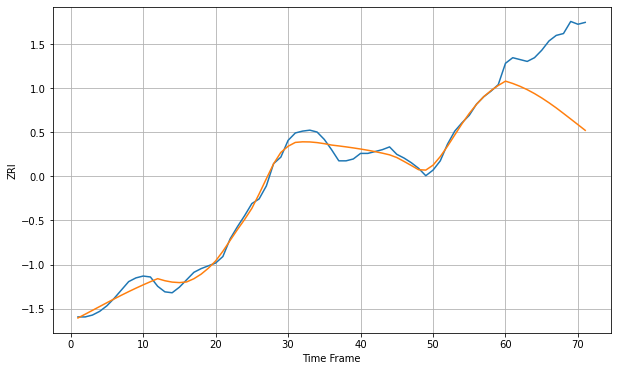

Wall time: 8.34 s
27613 6.6842783346647066 71.3628712744609 [1128.77827918 1126.26003488 1123.20352164 1119.5857903  1115.40015316
 1110.67792133 1105.50511561 1099.97395809 1094.0446061  1088.0134088
 1081.93125157 1075.82872144]

Got an mse at 0.0050 in round 154 and stopped training



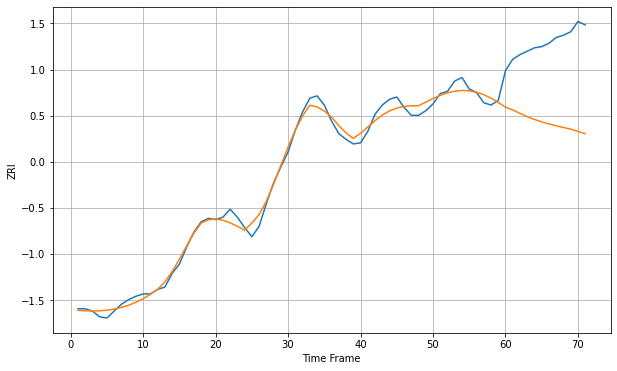

Wall time: 8.16 s
27615 5.655469748290006 70.72601468674074 [1098.08652245 1095.71869774 1092.68762091 1089.87360072 1087.40772092
 1085.28600681 1083.45321281 1081.84202092 1080.39327796 1078.99227044
 1076.91270906 1074.98689618]

Got an mse at 0.0049 in round 215 and stopped training



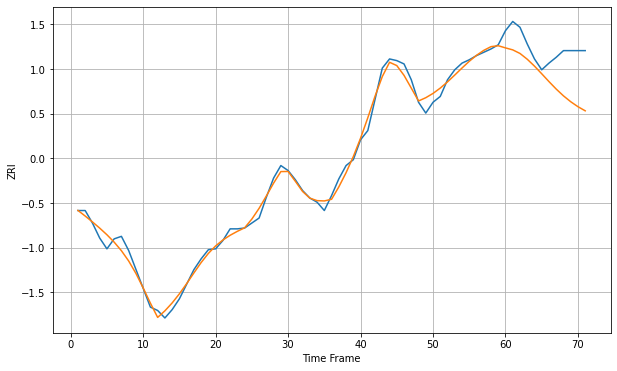

Wall time: 9.51 s
27703 7.499106427225377 42.26792412519178 [1099.27244564 1096.89544219 1092.58215412 1085.6704513  1077.37109023
 1068.19379943 1058.79625069 1049.81049557 1041.68502222 1034.6318538
 1028.67216348 1023.71641251]

Got an mse at 0.0050 in round 401 and stopped training



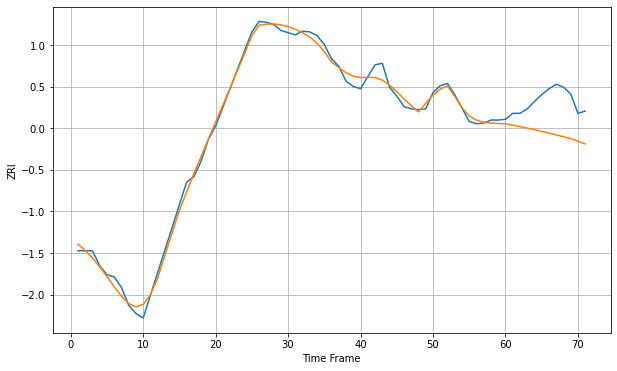

Wall time: 13.4 s
27705 7.85286882430504 45.2243207256864 [1207.06685027 1205.19589322 1203.25185128 1201.22666052 1199.10669642
 1196.88344296 1194.56050931 1192.15518246 1189.69523264 1187.21337542
 1183.68189663 1180.05774346]

Got an mse at 0.0049 in round 147 and stopped training



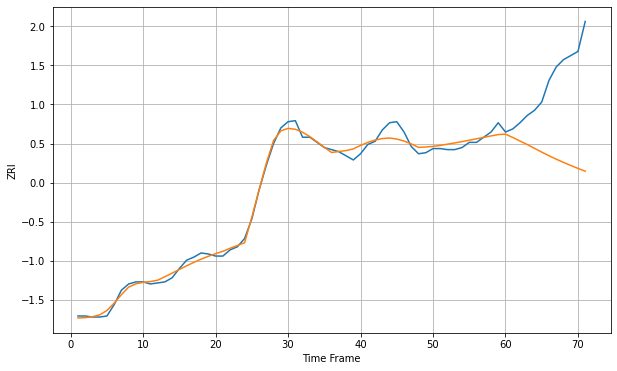

Wall time: 8.27 s
27707 5.288010238168305 78.07060785253482 [1037.99116674 1034.74710317 1031.34090469 1027.89671516 1024.22164272
 1020.57980839 1017.08471155 1013.76732944 1010.62811782 1007.6506491
 1004.81506716 1002.10556252]

Got an mse at 0.0050 in round 122 and stopped training



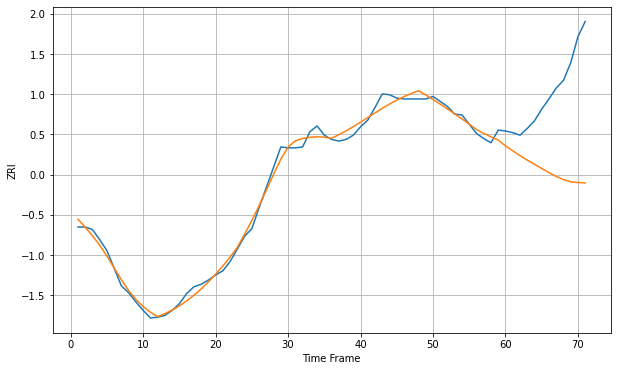

Wall time: 7.83 s
27713 6.7226983149771256 103.93076370700958 [1042.26295559 1036.43232338 1030.77193066 1025.43864069 1020.44076389
 1015.56341141 1010.56299631 1006.0752735  1002.28117672  999.60704568
  998.84709294  998.33386458]

Got an mse at 0.0050 in round 172 and stopped training



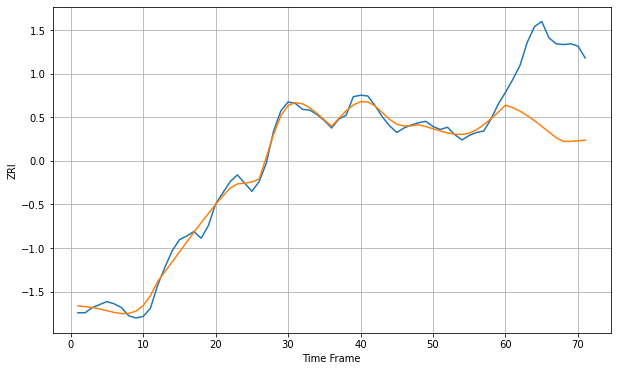

Wall time: 8.52 s
28202 8.232727868749187 109.9729669862313 [1516.64656623 1513.28282676 1508.63309954 1502.65866505 1495.78509092
 1488.30188756 1480.56061758 1472.94213004 1468.08769584 1468.06573533
 1468.83497754 1469.67138783]

Got an mse at 0.0050 in round 150 and stopped training



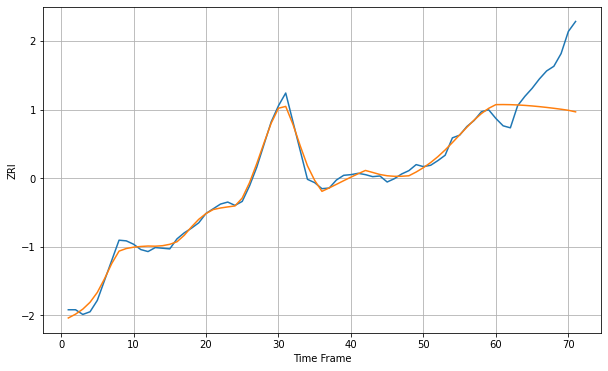

Wall time: 8.14 s
28210 7.171497053568705 65.31693575055219 [1289.67136129 1289.77510214 1289.60451246 1289.18260599 1288.53456183
 1287.68649325 1286.66425298 1285.49239695 1284.19339923 1282.78717417
 1281.20071438 1278.86808146]

Got an mse at 0.0049 in round 140 and stopped training



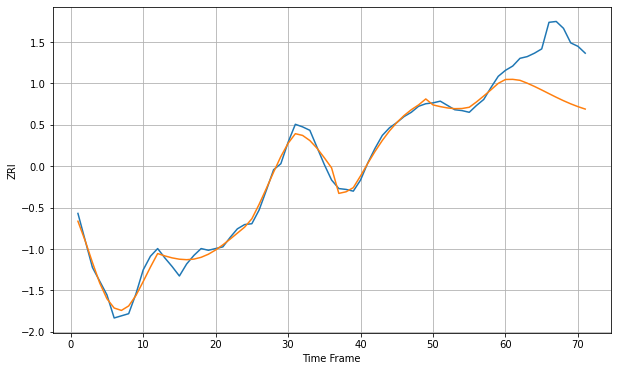

Wall time: 7.83 s
28216 6.7183075985180665 59.11422921211715 [1267.30143141 1267.44792322 1266.31891081 1262.98924356 1259.1749908
 1255.04361632 1250.77671677 1246.55514745 1242.54503723 1238.87322959
 1235.61112535 1232.77470923]

Got an mse at 0.0050 in round 37 and stopped training



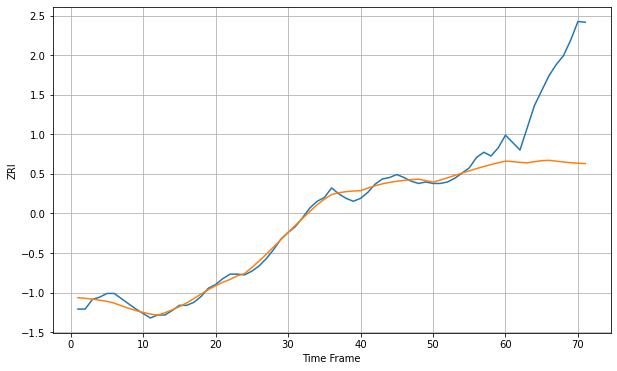

Wall time: 5.36 s
28262 7.328251448541511 118.72632089025896 [1048.11934314 1047.38625528 1046.40867122 1045.74300092 1047.37608458
 1048.68001497 1049.14762085 1048.05360675 1046.85942303 1045.95208304
 1045.26442235 1044.74678661]

Got an mse at 0.0050 in round 295 and stopped training



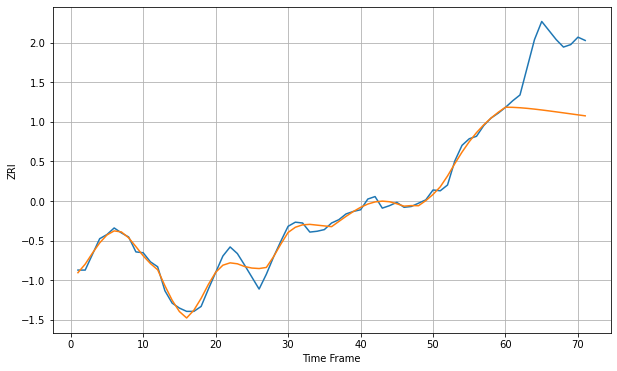

Wall time: 11.4 s
28269 6.740116203612266 75.82318695038441 [1156.20783087 1156.03306727 1155.53961246 1154.80221827 1153.88626293
 1152.84576581 1151.72329812 1150.55106451 1149.35260283 1148.14471718
 1146.93936813 1145.7453161 ]

Got an mse at 0.0050 in round 131 and stopped training



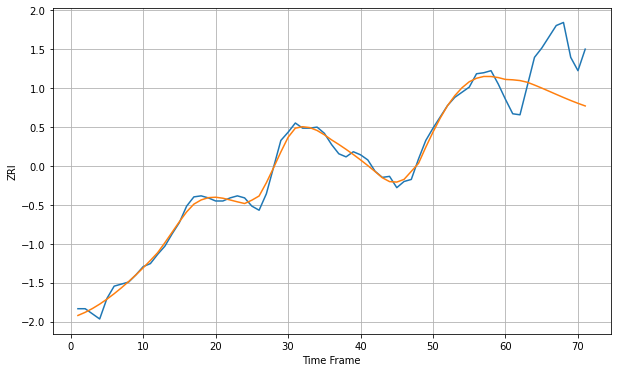

Wall time: 7.77 s
28273 5.33240617556747 44.108046113492414 [1213.46064751 1213.11595692 1212.37016232 1210.75305117 1208.00543172
 1205.06657576 1202.01412977 1198.92688679 1195.88163147 1192.94828773
 1190.18471095 1187.63284263]

Got an mse at 0.0050 in round 187 and stopped training



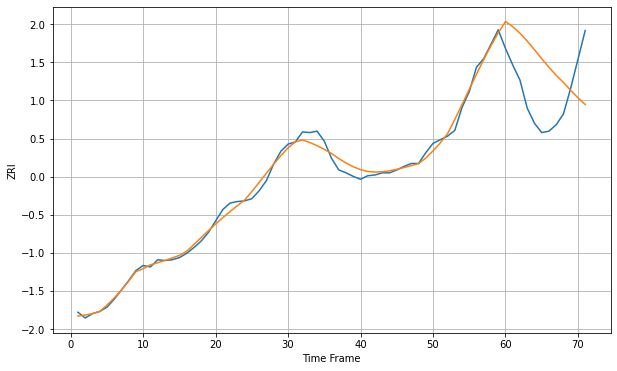

Wall time: 8.93 s
28277 7.416533291546707 74.29724076623145 [1447.6449527  1440.43328972 1431.27707329 1420.3031635  1408.22596872
 1395.80144732 1383.7789873  1372.68634851 1362.74967786 1351.76539084
 1341.42081004 1332.09670376]


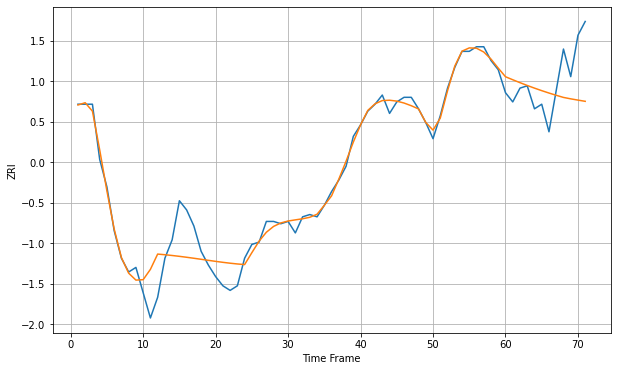

Wall time: 15.7 s
29205 6.795996790612977 16.048986221913733 [826.95188333 825.64362287 824.37407844 823.15631529 821.99718619
 820.89892923 819.8606885  818.87981162 817.95286356 817.3360024
 816.7874439  816.25805397]

Got an mse at 0.0050 in round 235 and stopped training



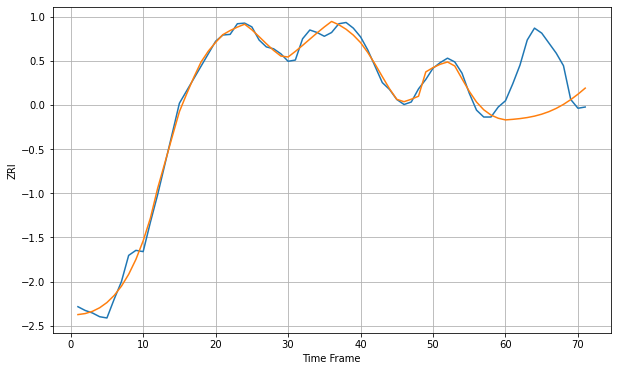

Wall time: 9.92 s
29403 9.917356271622175 85.78008676428792 [1792.40263969 1793.30426222 1794.49492398 1796.1448874  1798.43280941
 1801.53660235 1805.61898964 1810.809589   1817.18675164 1824.76187081
 1833.46822183 1843.15711442]

Got an mse at 0.0050 in round 259 and stopped training



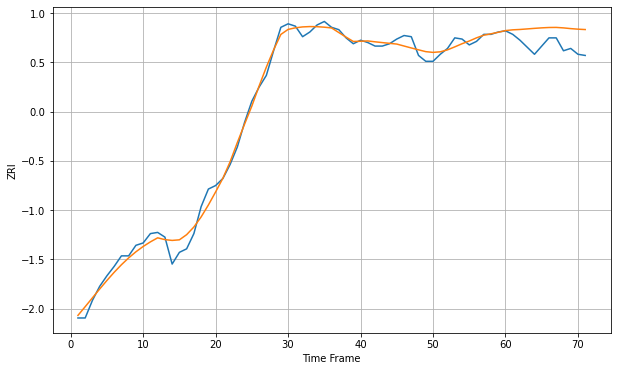

Wall time: 10.3 s
29414 5.911267924646939 15.40499517111539 [1332.22775887 1332.86174019 1333.1729467  1333.64083897 1334.12703603
 1334.55036281 1334.85272784 1334.92264076 1334.52058354 1333.90570939
 1333.42748291 1333.1048813 ]

Got an mse at 0.0050 in round 418 and stopped training



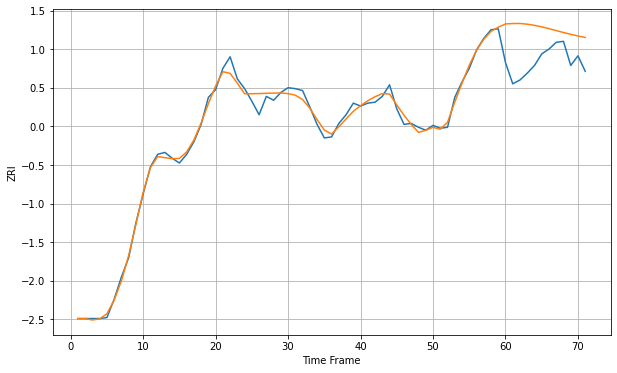

Wall time: 14.1 s
29464 5.601160921916933 38.044616360019795 [1579.03250909 1579.40370023 1579.50250857 1578.74263592 1577.54116902
 1575.98678882 1574.13619804 1572.12759383 1570.1299848  1568.2716979
 1566.56829529 1564.98444599]

Got an mse at 0.0049 in round 105 and stopped training



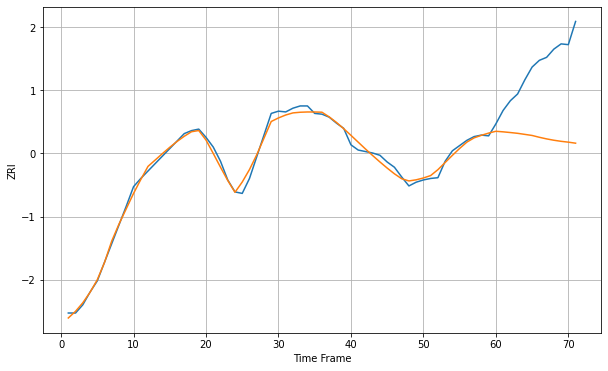

Wall time: 7.08 s
29607 5.832222736331331 98.77204001691352 [1004.1062228  1003.35683647 1002.41291224 1001.37523325  999.94721745
  998.50666552  996.06562845  993.91483166  992.11779339  990.6717156
  989.55334995  988.18173842]

Got an mse at 0.0050 in round 395 and stopped training



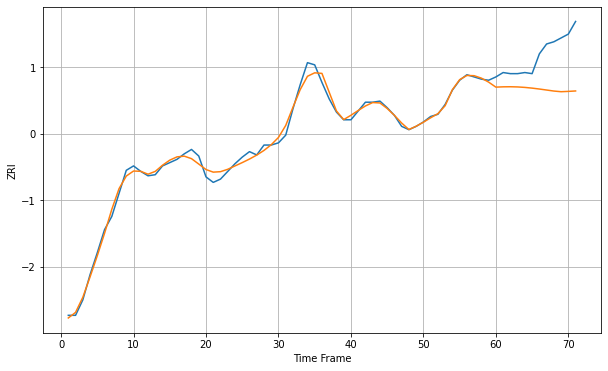

Wall time: 13.6 s
29615 4.255040635689157 35.13053463947018 [994.71627444 994.99579569 995.07301791 994.89908196 994.47106909
 993.81966461 992.99999409 992.08592983 991.15764338 990.55606971
 990.8528263  991.23345507]

Got an mse at 0.0050 in round 251 and stopped training



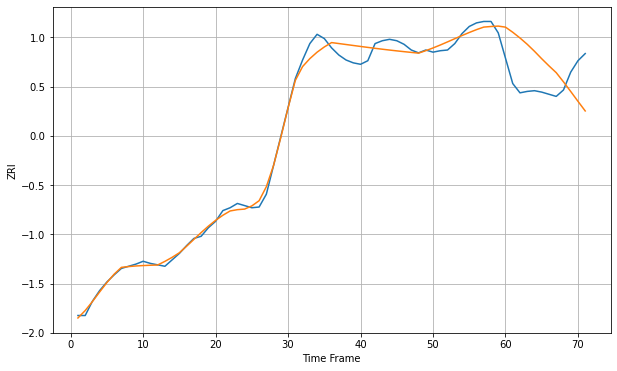

Wall time: 10.5 s
30024 9.741782155884716 54.62563929024534 [1488.04057962 1480.87674648 1472.84792857 1464.00847821 1454.20990537
 1443.7528895  1433.77146788 1424.26748335 1411.41644356 1397.87832804
 1384.12674966 1370.6270865 ]

Got an mse at 0.0050 in round 106 and stopped training



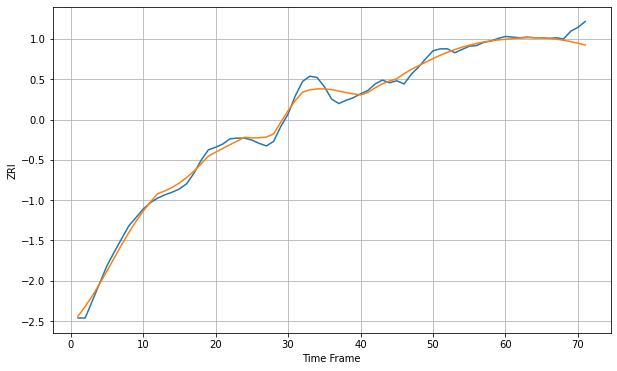

Wall time: 7.22 s
30043 8.695985178461404 13.486778132383163 [1296.64956557 1297.81509007 1298.60263347 1299.05853496 1299.14936299
 1298.83422209 1298.07387381 1296.84404068 1295.15046623 1293.04043569
 1290.60205766 1287.94611842]

Got an mse at 0.0050 in round 92 and stopped training



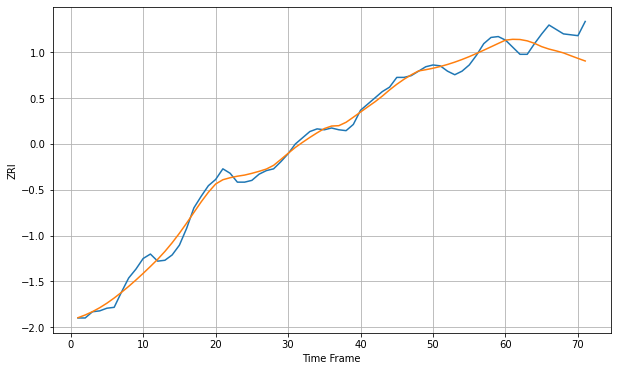

Wall time: 6.67 s
30044 7.264518650676088 21.910510543868703 [1143.97901682 1144.89331395 1144.67877066 1143.15445006 1140.37505596
 1136.61772945 1133.90919087 1131.85811353 1129.57447912 1126.45200557
 1123.41169492 1120.48191257]

Got an mse at 0.0050 in round 257 and stopped training



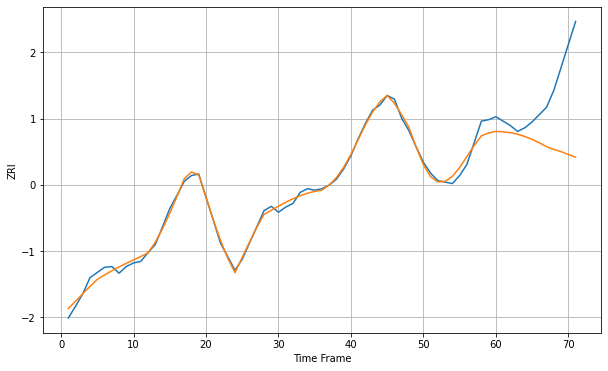

Wall time: 10.5 s
30046 6.33163072031043 82.68886896820214 [1035.02969077 1034.46835531 1033.35250376 1031.16983124 1028.11008952
 1024.2118293  1019.48929206 1014.27083143 1010.4668662  1007.49806438
 1003.6873738   999.93359993]

Got an mse at 0.0049 in round 85 and stopped training



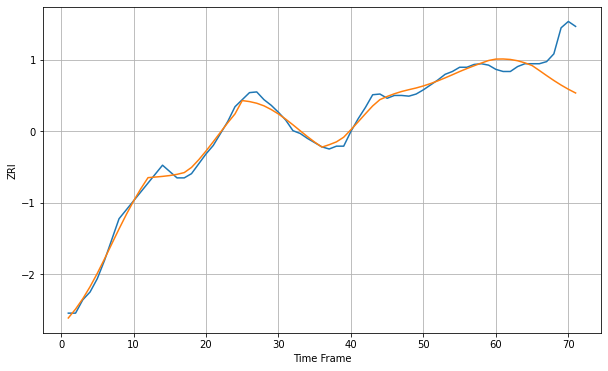

Wall time: 6.85 s
30080 6.9909373522185465 47.95193909595184 [1265.59902872 1265.74841369 1265.05281624 1263.23149884 1260.28058744
 1256.42578625 1249.40249345 1242.20418961 1235.22816437 1228.72857213
 1222.81663074 1217.49752481]

Got an mse at 0.0046 in round 58 and stopped training



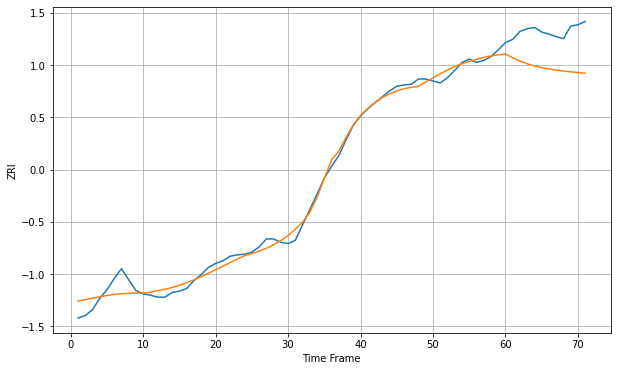

Wall time: 6.36 s
30093 10.62923057389787 54.866501174383394 [1147.73926598 1142.12024403 1137.10673739 1132.93550472 1129.63182226
 1127.06832309 1125.05851703 1123.42698152 1122.04127086 1120.81626796
 1119.70611372 1118.69365736]

Got an mse at 0.0050 in round 174 and stopped training



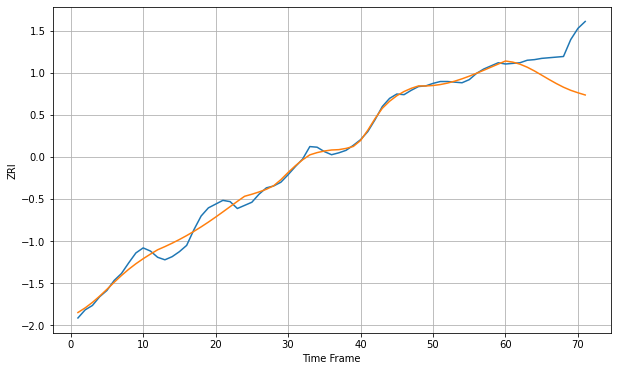

Wall time: 9.05 s
30096 9.483054483822675 55.967133826950224 [1281.78708922 1280.02903373 1276.70942128 1271.87446297 1265.84096289
 1259.13755507 1252.32815594 1245.84249197 1239.91340269 1234.93694822
 1231.00903802 1227.47043427]

Got an mse at 0.0050 in round 55 and stopped training



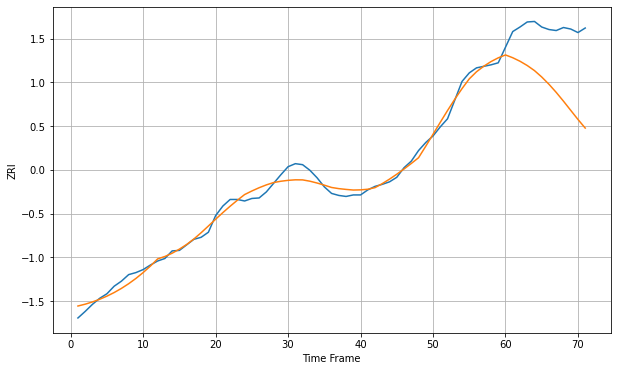

Wall time: 6.2 s
30097 12.192282537534128 121.63927906217089 [1492.61792561 1487.07782462 1480.10624959 1471.63851871 1461.5466737
 1448.85941073 1434.42182017 1418.34539896 1400.93197589 1382.766359
 1364.69049757 1347.57902228]

Got an mse at 0.0050 in round 131 and stopped training



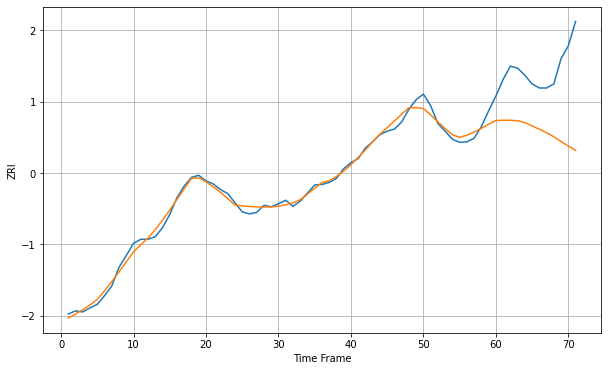

Wall time: 7.65 s
30305 9.865578556420344 129.62839891726387 [1681.86131129 1682.47832223 1682.44906258 1681.48160255 1677.86589721
 1671.38032127 1664.70225981 1657.9485644  1649.89203629 1640.57850502
 1631.65369618 1623.19089889]

Got an mse at 0.0050 in round 127 and stopped training



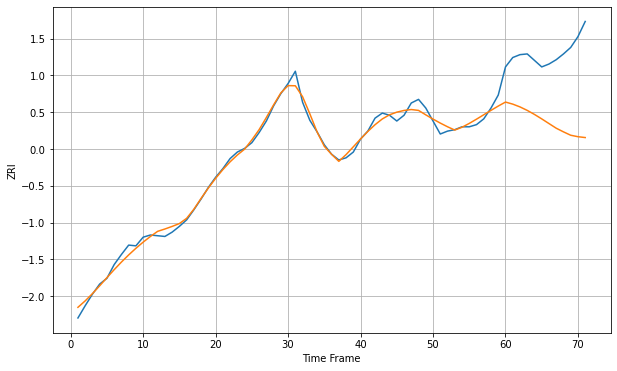

Wall time: 7.86 s
30306 7.152017519562341 98.39142925894157 [1443.27029561 1440.42802751 1436.55277474 1431.73528572 1426.12858926
 1419.95250122 1413.48285253 1407.02606396 1401.97334066 1397.28309062
 1395.27004112 1394.0778899 ]

Got an mse at 0.0050 in round 84 and stopped training



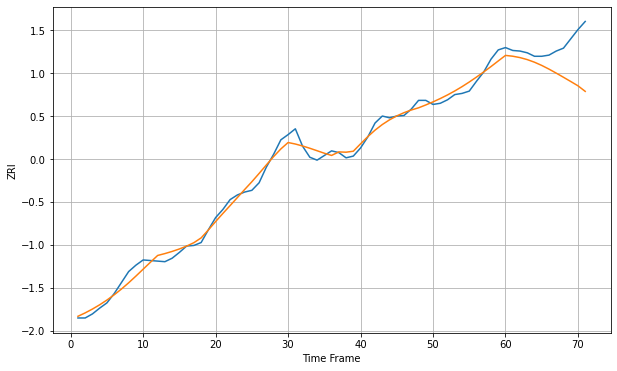

Wall time: 6.81 s
30308 10.354001488512493 53.799806029370664 [1637.48764412 1636.09892419 1633.7309365  1630.29997763 1625.77626481
 1620.23557699 1613.88038856 1606.99054395 1599.82475445 1592.54927151
 1585.14017497 1575.52334052]

Got an mse at 0.0050 in round 65 and stopped training



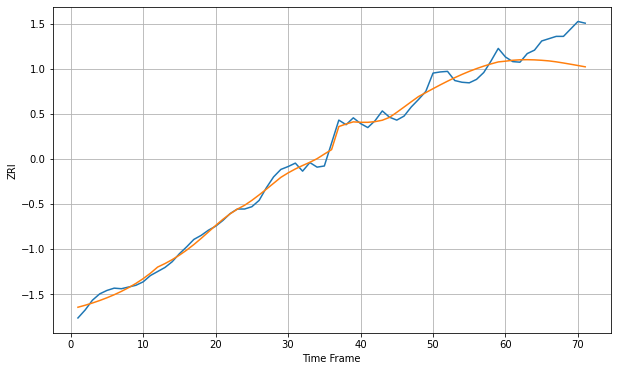

Wall time: 6.49 s
30309 11.04705878364565 43.51193901887401 [1648.76179239 1650.33089912 1651.1625969  1651.35769354 1651.02850865
 1650.28746438 1649.23576382 1647.59802698 1645.58120061 1643.42685641
 1641.19297925 1638.92758561]

Got an mse at 0.0050 in round 274 and stopped training



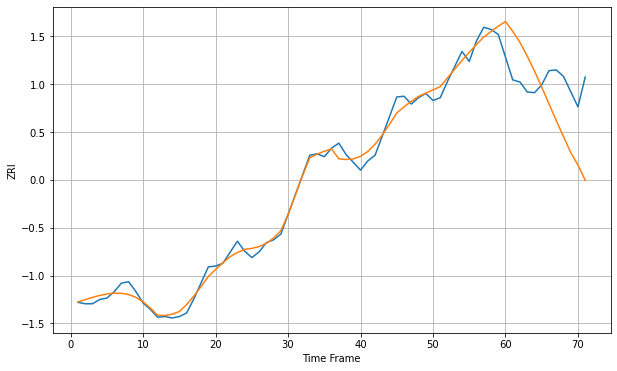

Wall time: 11.1 s
30310 9.464396393057584 72.61266649640044 [1212.22487079 1198.26177546 1182.72782729 1163.39354337 1142.39971678
 1119.86521374 1096.33435573 1072.80770709 1050.42555127 1027.7672516
 1010.17965492  988.85738234]

Got an mse at 0.0049 in round 79 and stopped training



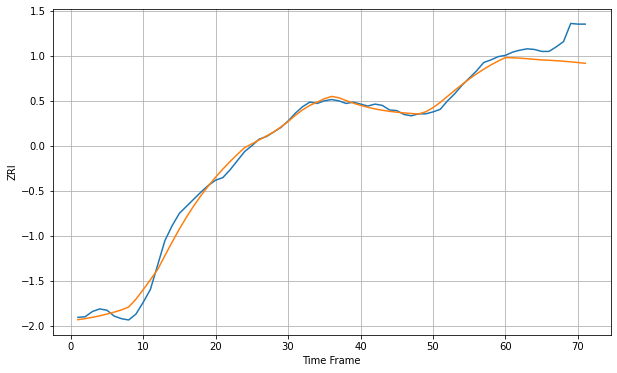

Wall time: 6.84 s
30318 9.610341749285684 32.94230351802805 [1441.53264519 1441.21646311 1440.62085905 1439.81226474 1438.84596251
 1437.96718783 1437.42656117 1436.74178086 1435.92101282 1434.97246319
 1433.90536713 1432.73026915]

Got an mse at 0.0050 in round 172 and stopped training



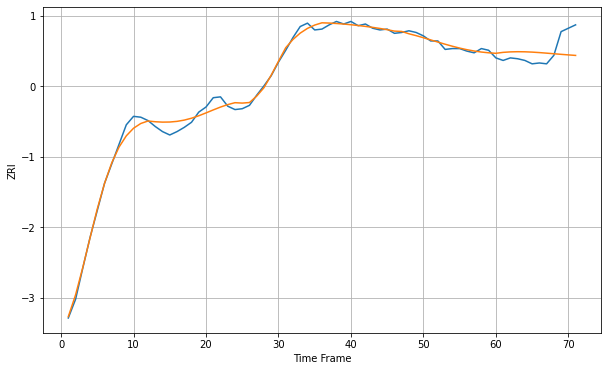

Wall time: 8.62 s
30319 5.838933466644424 17.927820869270963 [1573.42305583 1574.52485124 1575.08887083 1575.29947639 1575.19156933
 1574.82188359 1574.26450058 1573.59917981 1572.89566722 1572.2016688
 1571.54022753 1570.91559673]

Got an mse at 0.0050 in round 96 and stopped training



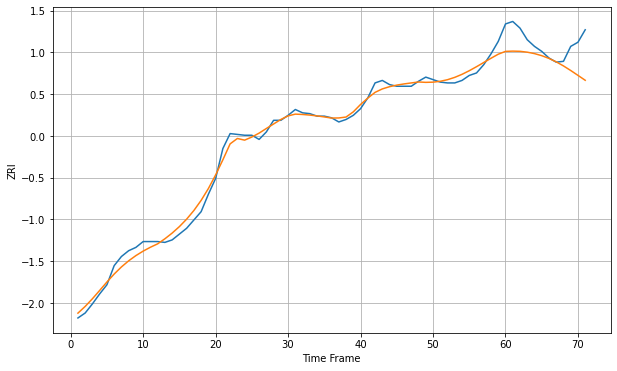

Wall time: 6.97 s
30324 7.0417367981743295 28.339544084634085 [1496.97837001 1497.29544964 1497.05695786 1496.03056747 1494.30089223
 1491.81431001 1488.51140071 1484.37740657 1479.47378202 1473.96206994
 1468.09810848 1462.18414522]

Got an mse at 0.0050 in round 149 and stopped training



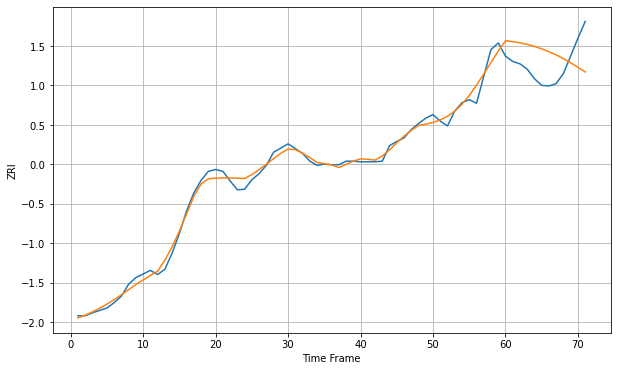

Wall time: 8.34 s
30326 9.276881084239918 47.650137200246846 [1682.73867996 1681.3152372  1679.21507626 1676.483438   1673.15878076
 1669.16617552 1664.36346174 1658.87212762 1652.69113129 1645.84373338
 1638.38847284 1630.45603507]

Got an mse at 0.0050 in round 469 and stopped training



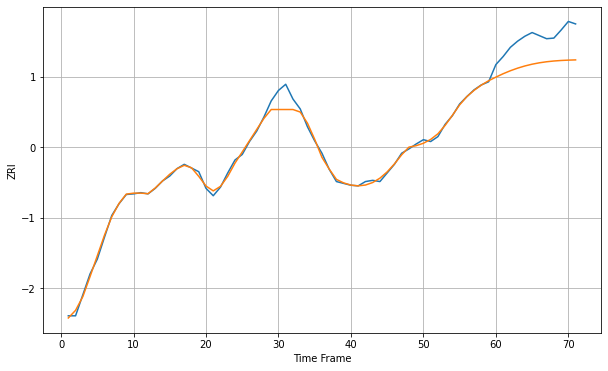

Wall time: 15.3 s
30328 8.046697283220752 44.77659336757941 [1517.60962558 1523.09531255 1527.9619191  1532.17667556 1535.72066805
 1538.60199139 1540.85993485 1542.5611938  1543.79126905 1544.64432438
 1545.21384367 1545.58537081]

Got an mse at 0.0050 in round 54 and stopped training



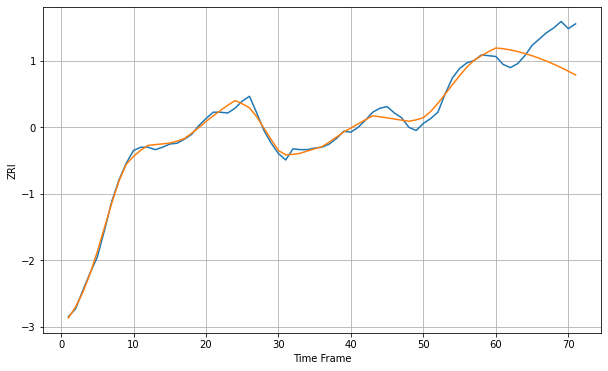

Wall time: 5.95 s
30329 5.842670597887256 36.18813976520412 [1493.71863224 1492.77351582 1491.25896876 1489.24353903 1486.79758615
 1483.96844875 1480.77143882 1477.20612226 1473.28097546 1469.02867605
 1464.50701574 1459.78945809]

Got an mse at 0.0050 in round 282 and stopped training



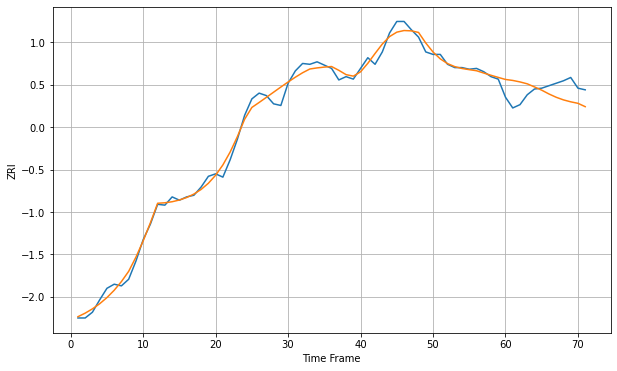

Wall time: 11.1 s
30338 7.256138787616901 20.599749997934993 [1448.5882303  1447.39888085 1445.59138118 1443.29055629 1439.53770488
 1435.57071904 1430.95580345 1426.95386798 1423.78125977 1421.44578283
 1419.6117492  1415.54886319]

Got an mse at 0.0049 in round 105 and stopped training



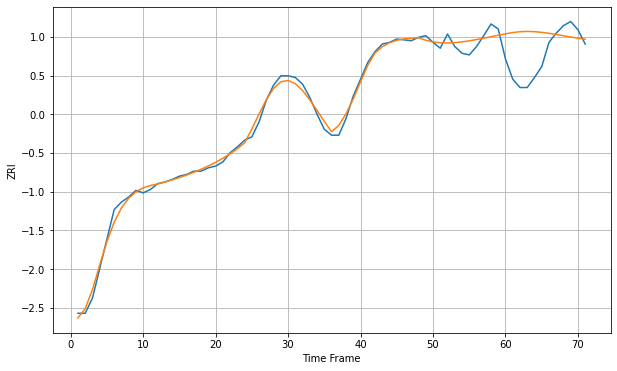

Wall time: 6.92 s
30339 6.378895230545984 39.16477503540658 [1407.159633   1408.78445479 1409.7525818  1410.07727447 1409.80373495
 1409.01560315 1407.83630741 1406.41609849 1404.90553594 1403.42803876
 1402.06370745 1400.84733897]

Got an mse at 0.0050 in round 152 and stopped training



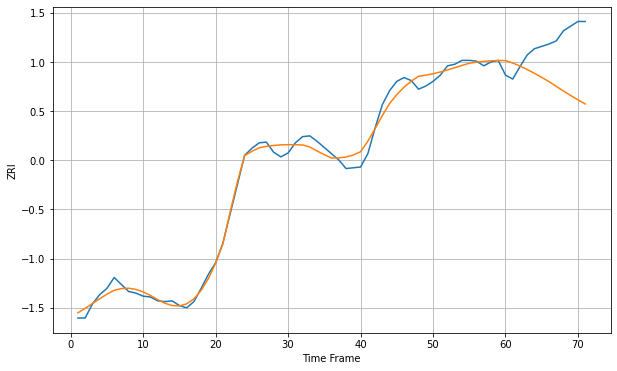

Wall time: 8.31 s
30341 8.889925445545993 61.087868591066716 [1377.71691193 1374.60185541 1370.7256733  1366.2499423  1361.33639504
 1356.13660249 1350.70792869 1344.60451526 1338.62450502 1332.83291721
 1327.27772769 1321.99368595]

Got an mse at 0.0050 in round 207 and stopped training



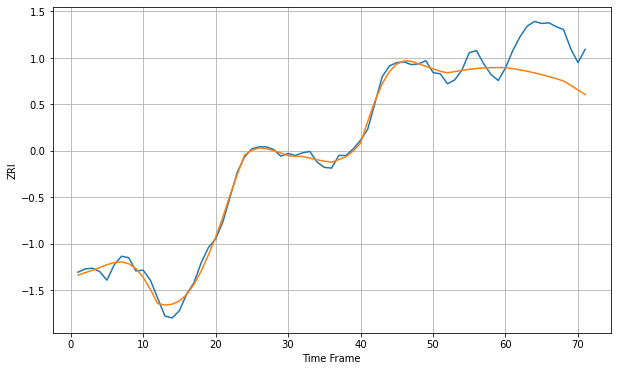

Wall time: 9.46 s
30345 9.830330184737468 63.21900657042692 [1490.40822485 1488.85554262 1487.01747745 1484.90260991 1482.51628697
 1479.86045952 1476.93504842 1473.74103841 1470.28496228 1463.80592497
 1456.82087544 1449.77054192]

Got an mse at 0.0050 in round 85 and stopped training



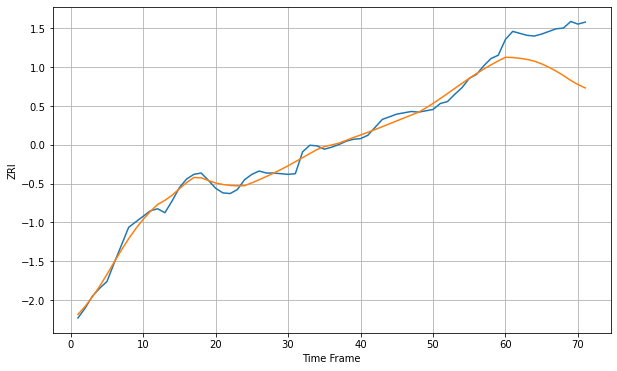

Wall time: 7.01 s
30350 8.24253679618881 62.497528559531624 [1324.92587077 1324.47114524 1323.37140933 1321.560776   1318.97543024
 1314.84547077 1309.79292172 1303.90561577 1297.25348204 1289.95019433
 1283.69323074 1278.56976056]

Got an mse at 0.0050 in round 181 and stopped training



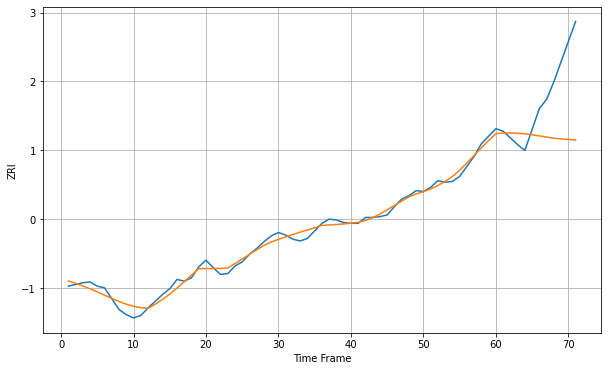

Wall time: 8.85 s
30605 5.788158275706999 64.88105049972357 [895.97987687 896.78173341 896.95151036 896.5871579  895.79941736
 894.70291046 893.40827553 892.01583638 890.60858699 889.77540513
 889.12445387 888.47587779]

Got an mse at 0.0050 in round 232 and stopped training



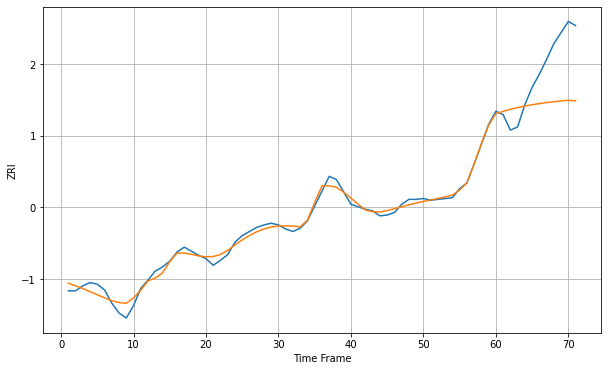

Wall time: 9.92 s
30606 6.122385654324475 54.025937237347044 [968.12074164 970.88074618 973.32164715 975.46757926 977.33631081
 978.94409435 980.31344794 981.48496267 982.53182919 983.56882871
 984.29059258 983.73528494]

Got an mse at 0.0050 in round 273 and stopped training



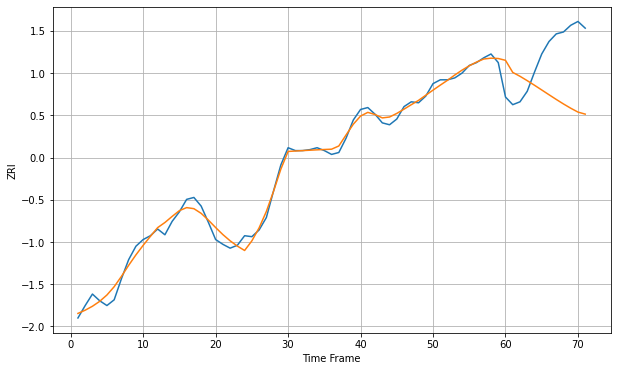

Wall time: 10.9 s
31401 6.214887535664814 59.90495013426123 [1388.38256129 1375.74628497 1371.67747813 1367.11499245 1362.3139681
 1357.38256034 1352.41342933 1347.50221461 1342.75926603 1338.30617335
 1334.25949085 1332.11658345]


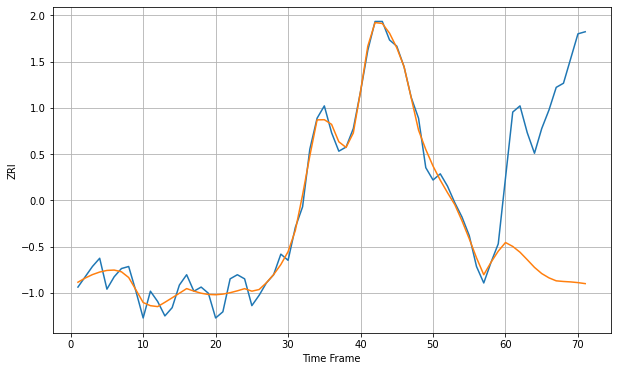

Wall time: 16 s
32204 4.605339535765407 85.73430284207939 [993.64625223 991.74851883 988.94135477 985.30115879 981.56897548
 978.5688204  976.47777574 975.03673588 974.7234828  974.51041717
 974.17121709 973.68611231]

Got an mse at 0.0050 in round 376 and stopped training



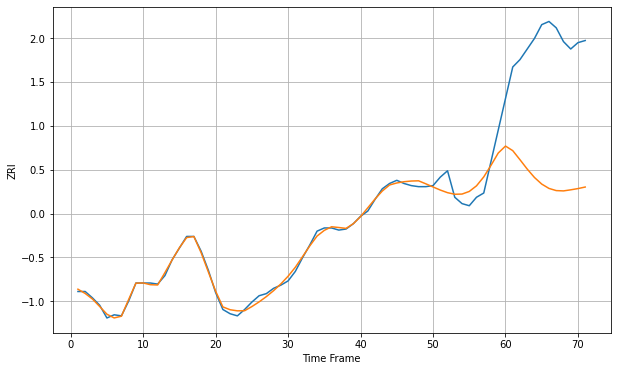

Wall time: 13.2 s
32205 5.816999704812402 127.20270880039465 [940.33569028 936.0120758  927.43256869 918.59073667 910.65087075
 904.43638835 900.33489495 898.29393841 897.99861524 899.01301754
 900.18566024 901.65352127]

Got an mse at 0.0050 in round 153 and stopped training



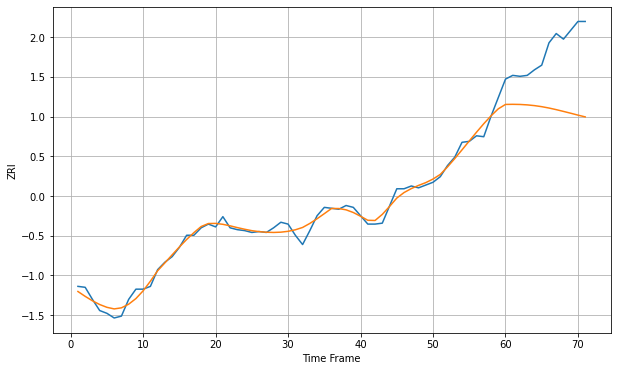

Wall time: 8.28 s
32207 6.004076425742866 66.7335520638503 [994.73749233 994.86228904 994.71165486 994.25397047 993.46343437
 992.32879006 990.86670897 989.13451327 987.23095235 985.27570543
 983.24564358 981.3318556 ]


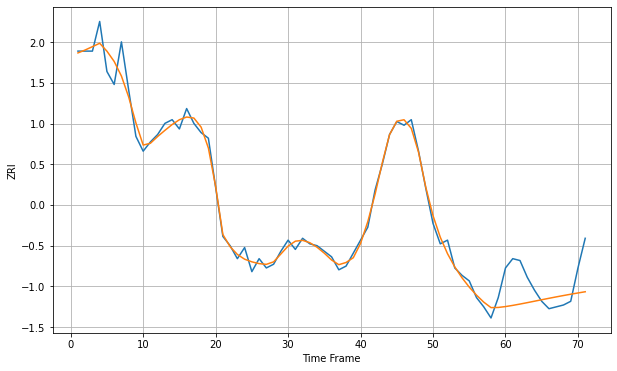

Wall time: 16.2 s
32209 4.7098539565991455 15.712982616653338 [798.15358626 798.79094844 799.5036094  800.2641742  801.04881287
 801.83798344 802.61690093 803.37558523 804.1085113  804.81398212
 805.49334828 806.1501643 ]

Got an mse at 0.0049 in round 62 and stopped training



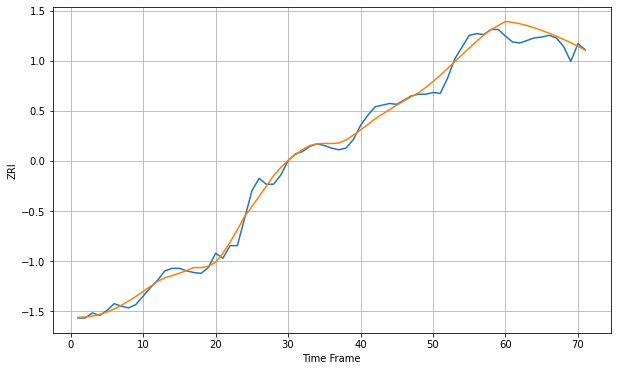

Wall time: 6.48 s
32224 8.311677831805026 14.325212299955634 [1344.51269521 1343.37419588 1341.69421685 1339.51729926 1336.90059346
 1333.90445199 1330.5872483  1327.00538996 1323.21580953 1319.27793827
 1315.07588797 1310.34175136]

Got an mse at 0.0050 in round 81 and stopped training



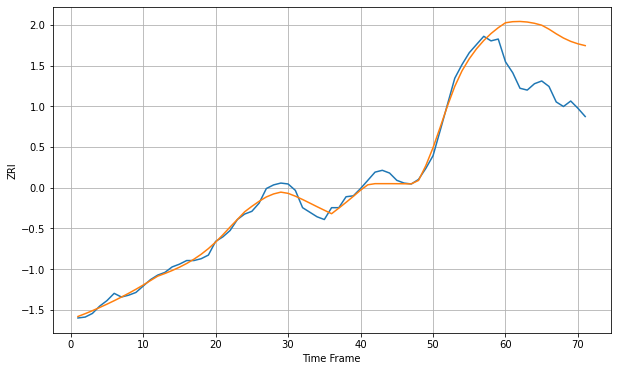

Wall time: 6.54 s
32225 6.256783215214477 67.43895479369887 [1194.86308496 1196.04246376 1196.28646188 1195.67172853 1194.27004064
 1192.16673198 1187.84337966 1182.752256   1178.11822458 1174.44081563
 1171.74921089 1169.7843221 ]

Got an mse at 0.0049 in round 46 and stopped training



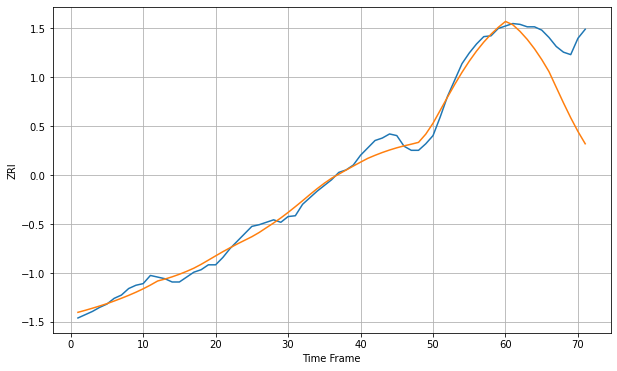

Wall time: 5.96 s
32246 8.20565612468197 63.88995228540368 [1339.54795007 1335.56047273 1327.46798552 1317.62931846 1306.10998047
 1293.01135387 1278.22493629 1259.07521301 1240.01210156 1221.81017473
 1205.02584871 1190.01987648]

Got an mse at 0.0050 in round 77 and stopped training



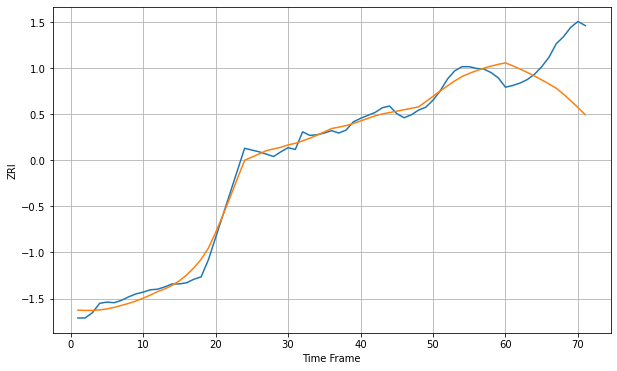

Wall time: 6.55 s
32250 11.016168232055236 82.46424818031107 [1411.45959816 1406.44803929 1401.07024006 1395.25093873 1389.03462322
 1382.45775383 1375.54446255 1368.30268616 1358.22768475 1347.07317751
 1335.39389973 1323.13040333]

Got an mse at 0.0050 in round 214 and stopped training



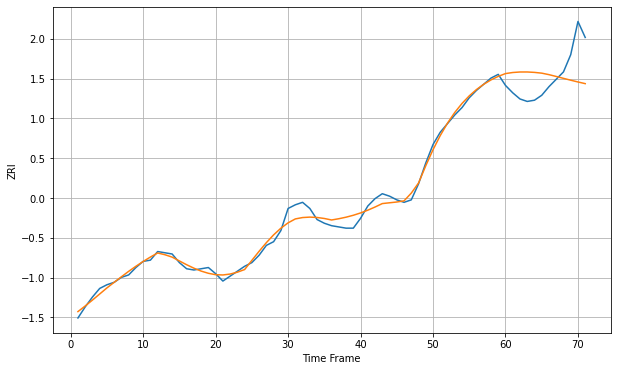

Wall time: 9.53 s
32256 4.544851647157535 23.523025462129507 [1231.64240175 1232.51165494 1232.92876355 1232.94213529 1232.60629487
 1231.98459101 1230.77418167 1229.29021337 1227.76484765 1226.2613302
 1224.82078619 1223.46439762]

Got an mse at 0.0050 in round 53 and stopped training



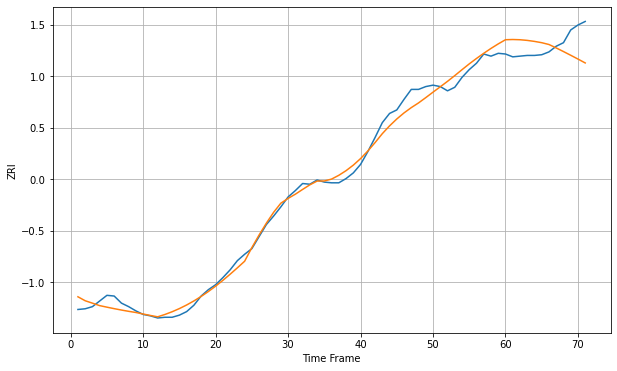

Wall time: 5.92 s
32701 10.01847744352641 28.842021610202288 [1198.1955623  1198.49857847 1198.17445559 1197.25734919 1195.82526817
 1193.99764706 1191.43592153 1186.58683349 1181.48147112 1176.23448307
 1170.87303696 1165.37754932]

Got an mse at 0.0049 in round 34 and stopped training



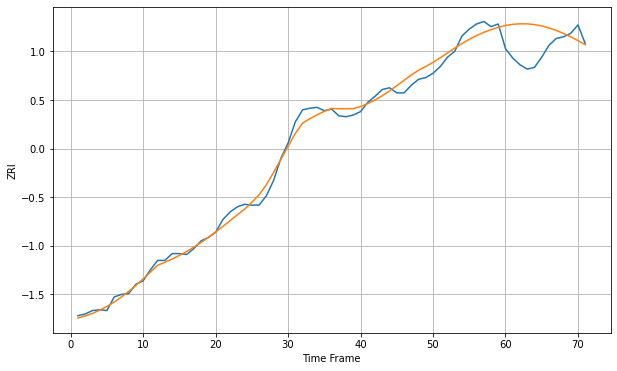

Wall time: 5.52 s
32703 7.768902218999525 31.937031028075616 [1320.35770862 1321.62486969 1322.25514999 1322.16174927 1321.3221982
 1319.73227389 1317.429119   1314.47184828 1310.92315798 1306.89107786
 1302.45873539 1297.70365435]

Got an mse at 0.0049 in round 53 and stopped training



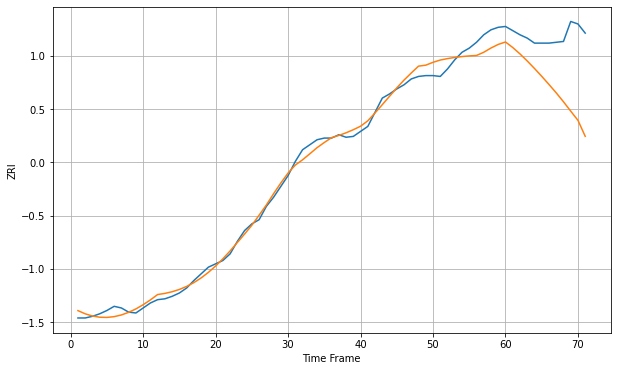

Wall time: 5.85 s
32714 8.579342124068711 68.4800972348415 [1228.36467717 1221.71915584 1214.02936163 1205.56455305 1196.55018492
 1187.12511333 1177.35463428 1167.2870898  1156.60160622 1145.32448816
 1134.28559984 1115.13693274]

Got an mse at 0.0050 in round 229 and stopped training



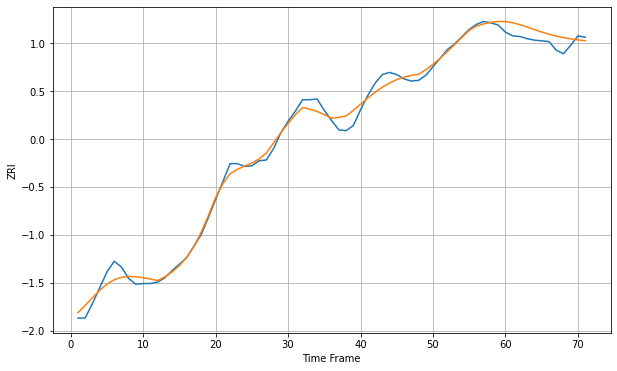

Wall time: 10.3 s
32771 9.392794703901856 14.661089753185793 [1225.92743605 1224.13470375 1221.45119102 1218.16432144 1214.65160801
 1211.2668513  1208.24202275 1205.66433664 1203.51571364 1201.72723049
 1200.24297145 1199.23008195]

Got an mse at 0.0050 in round 165 and stopped training



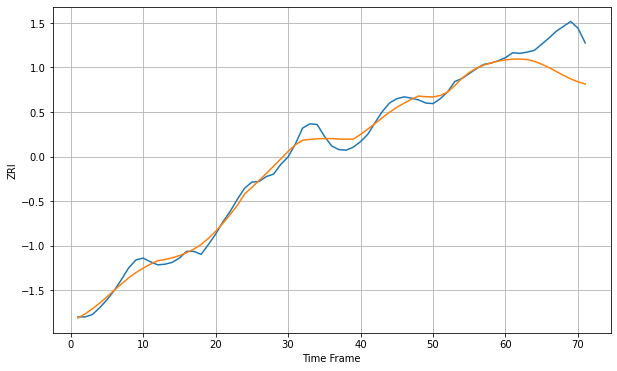

Wall time: 8.43 s
32792 10.223365739363093 54.48200532463749 [1291.38445489 1292.56376803 1292.76279437 1291.91574467 1288.82803844
 1284.38162578 1278.78217075 1272.48705465 1266.13731553 1260.37271785
 1255.63445646 1252.08074695]

Got an mse at 0.0050 in round 171 and stopped training



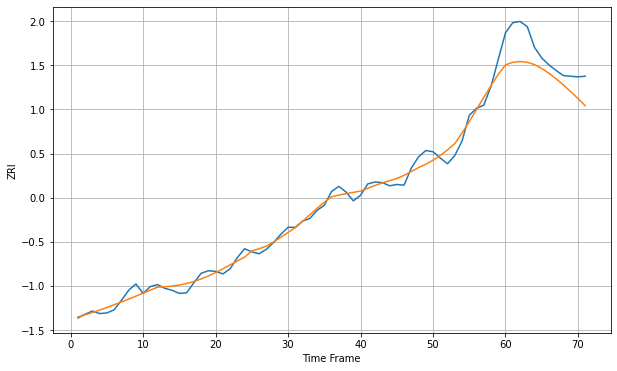

Wall time: 8.56 s
32801 9.883534143594497 40.19606574438848 [1609.10365988 1613.13031477 1614.3257587  1613.20162156 1609.49805799
 1603.30647047 1595.72040506 1586.92387315 1577.13182638 1566.59711288
 1555.57918065 1544.29384313]

Got an mse at 0.0050 in round 245 and stopped training



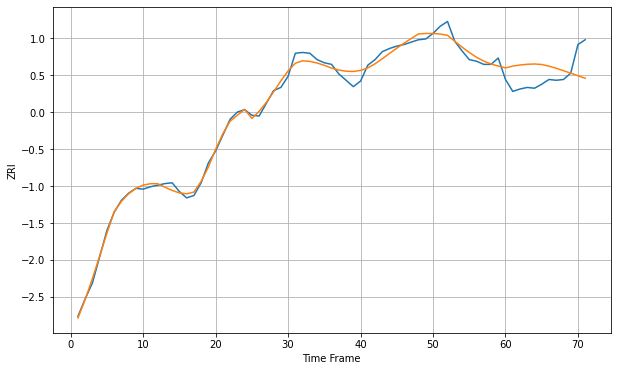

Wall time: 10.2 s
32803 6.554956023470517 27.476972528609558 [1485.55944681 1487.84227347 1489.2137475  1490.10561806 1490.49596727
 1489.83614808 1487.78894328 1485.07287386 1482.08581086 1478.93740477
 1475.71991756 1472.50082054]

Got an mse at 0.0048 in round 31 and stopped training



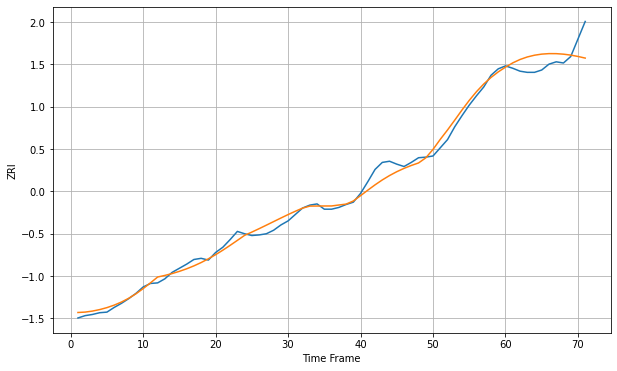

Wall time: 5.46 s
32810 9.860955422406539 26.36083228031549 [1413.88338885 1421.1728588  1426.94770541 1431.27441473 1434.29654502
 1436.16790511 1437.02125163 1436.96390481 1436.08544721 1434.46825885
 1432.19631006 1429.35989447]

Got an mse at 0.0048 in round 51 and stopped training



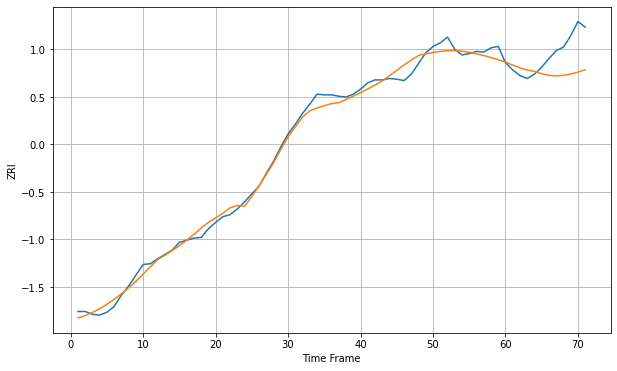

Wall time: 5.74 s
32811 8.980628911830143 35.70365523529578 [1325.96120038 1321.73496135 1317.88510525 1314.86881259 1313.03441142
 1309.64644586 1307.31799643 1306.701444   1307.44648279 1309.274332
 1311.93032433 1315.17562034]

Got an mse at 0.0050 in round 86 and stopped training



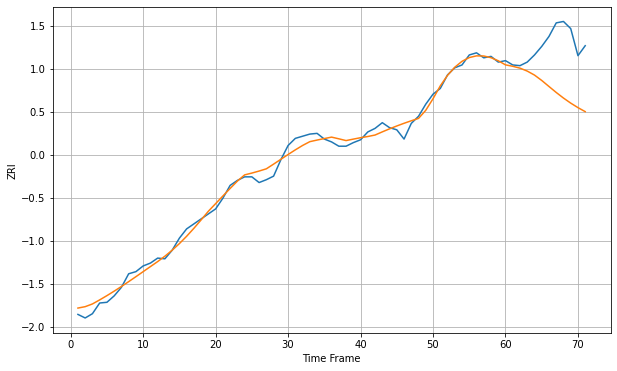

Wall time: 6.73 s
32812 8.399856837081554 67.14314407368572 [1394.12137737 1392.1164468  1389.5095961  1385.38494711 1379.78861106
 1372.23435089 1363.76502491 1355.38602035 1347.54460995 1340.44425508
 1334.11110652 1328.48644851]

Got an mse at 0.0050 in round 44 and stopped training



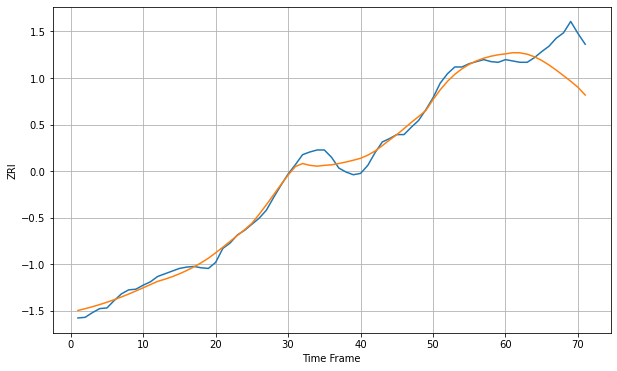

Wall time: 5.73 s
32822 9.70782100599729 48.38387458128786 [1332.6152556  1334.33216228 1334.152073   1332.08096604 1328.22452952
 1322.77907781 1316.02663835 1308.32213037 1300.06490432 1291.65636348
 1282.66317659 1271.08235676]

Got an mse at 0.0049 in round 115 and stopped training



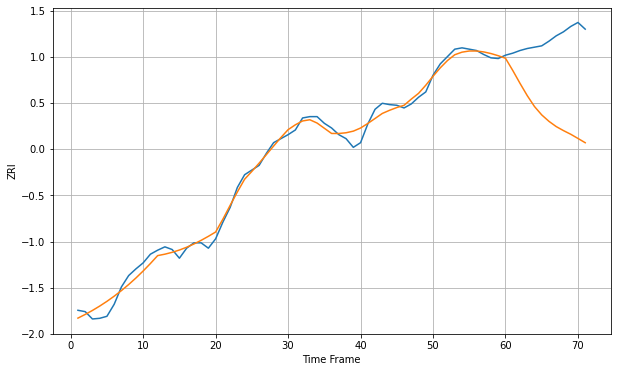

Wall time: 7.43 s
32825 9.655453866656305 117.81824677138302 [1285.40259445 1267.17805597 1247.88713106 1229.47337038 1213.10932252
 1200.56998703 1190.92490319 1183.09382785 1177.07046769 1171.61533953
 1165.34332304 1158.92046063]

Got an mse at 0.0049 in round 58 and stopped training



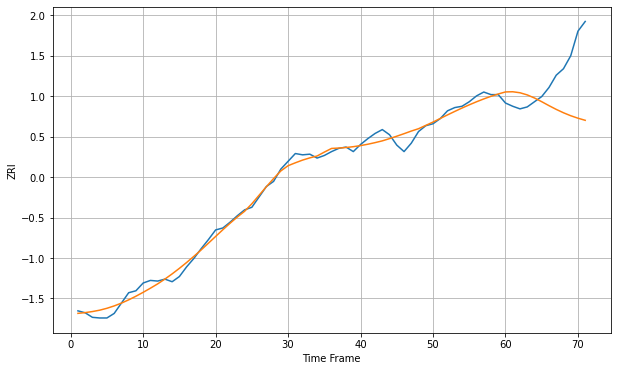

Wall time: 6.09 s
32835 8.70105814311946 70.71883788728636 [1299.1491589  1299.42247413 1297.8678705  1294.550731   1289.77661587
 1284.05532426 1277.96668203 1272.1915643  1266.97688703 1262.39834456
 1258.58157714 1255.31457524]

Got an mse at 0.0050 in round 63 and stopped training



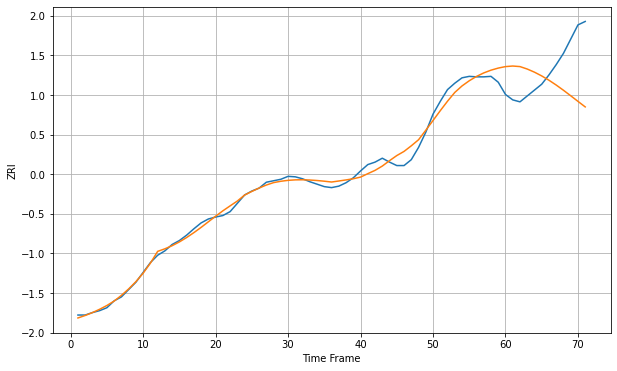

Wall time: 6.17 s
32837 11.271670689828658 88.25706979129278 [1607.91697932 1609.06330845 1607.92920569 1602.9352417  1596.52148057
 1588.85766272 1580.06014605 1570.24794303 1559.6040597  1548.3984227
 1536.96591293 1525.65859046]

Got an mse at 0.0049 in round 24 and stopped training



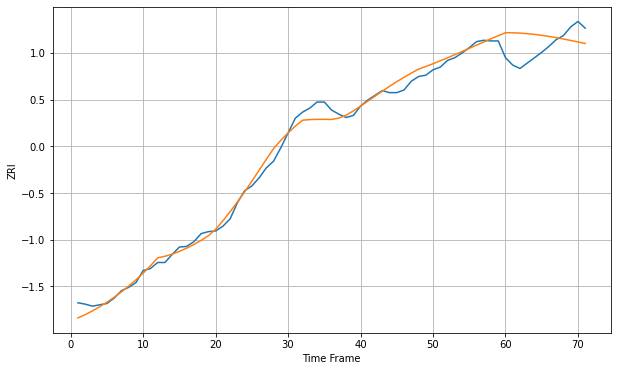

Wall time: 5.11 s
32839 9.994049385531625 32.09983260690343 [1364.24121273 1364.12079714 1363.65089763 1362.85223693 1361.74867685
 1360.36721453 1358.73838227 1356.89649282 1354.87917575 1352.7258667
 1350.47532709 1348.16271437]

Got an mse at 0.0050 in round 83 and stopped training



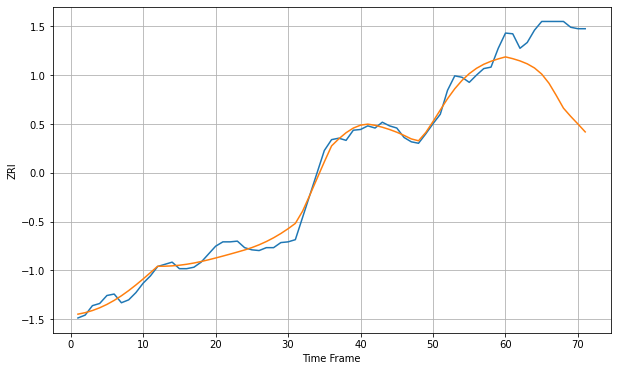

Wall time: 6.64 s
32935 9.460011435924894 89.45782199116448 [1187.14025026 1184.69505366 1181.60734615 1177.54992255 1171.86444703
 1163.39968679 1150.77650087 1134.06599739 1116.42087563 1105.03946556
 1094.5182685  1083.67078223]

Got an mse at 0.0050 in round 267 and stopped training



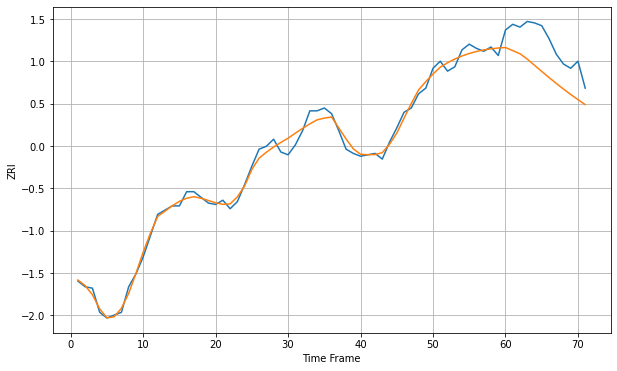

Wall time: 10.6 s
33009 4.201547915876647 22.700924832995735 [1641.64284697 1639.44468384 1637.22350668 1633.48547261 1629.13234705
 1624.785726   1620.51153894 1616.36143008 1612.36873404 1608.54836854
 1604.89992906 1601.41260528]


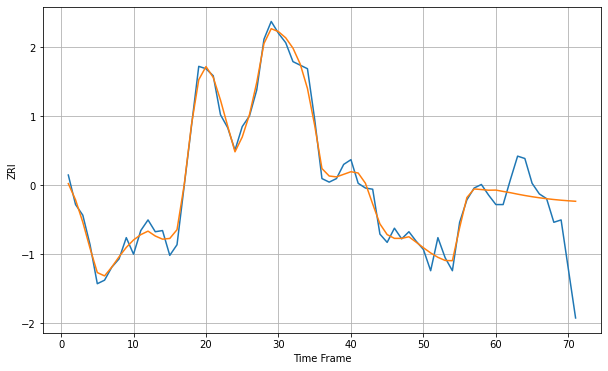

Wall time: 15.8 s
33010 7.440405493814321 36.84355264453674 [1777.26070623 1776.12295389 1775.05501097 1773.80786079 1772.67334261
 1771.65379098 1770.74951983 1769.95832334 1769.27517593 1768.69242472
 1768.20034326 1767.78782558]

Got an mse at 0.0050 in round 303 and stopped training



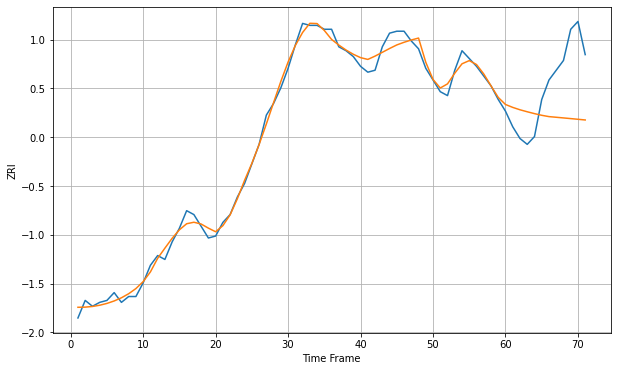

Wall time: 11.4 s
33020 3.5225941452921377 26.37101684581352 [1346.44245875 1344.95000226 1343.72462427 1342.70600696 1341.75265139
 1340.89670595 1340.22548225 1339.89058767 1339.55099084 1339.20617877
 1338.85634135 1338.50121071]

Got an mse at 0.0050 in round 46 and stopped training



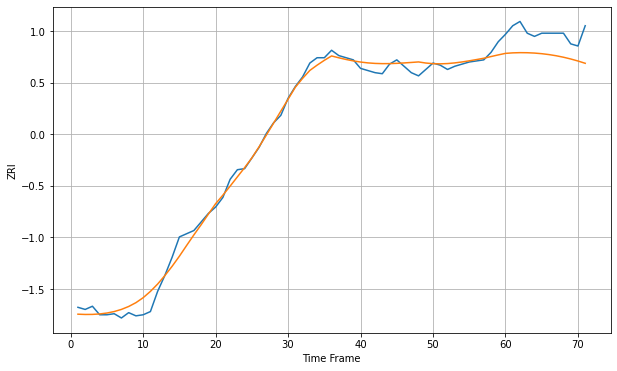

Wall time: 5.79 s
33024 6.684503410419436 21.92598495660218 [1518.07876868 1518.55946287 1518.75703495 1518.68952924 1518.3657847
 1517.78683418 1516.94827065 1515.84393325 1514.46986312 1512.82747145
 1510.92550241 1508.78089389]

Got an mse at 0.0050 in round 210 and stopped training



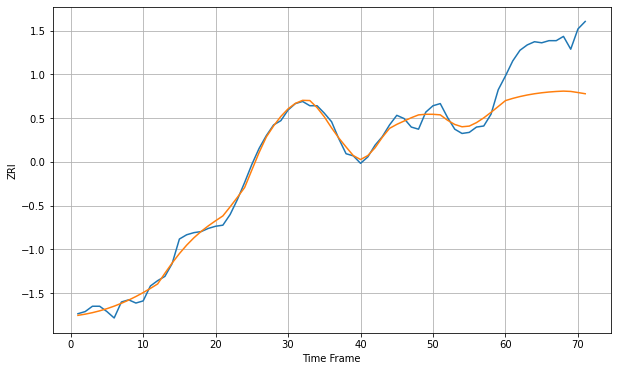

Wall time: 9.19 s
33025 5.754093620233673 47.7548593255997 [1561.81610921 1563.87119347 1565.61201113 1567.05257708 1568.22127614
 1569.14735816 1569.85601872 1570.36780714 1570.69985713 1570.4020114
 1569.36464637 1568.2435856 ]


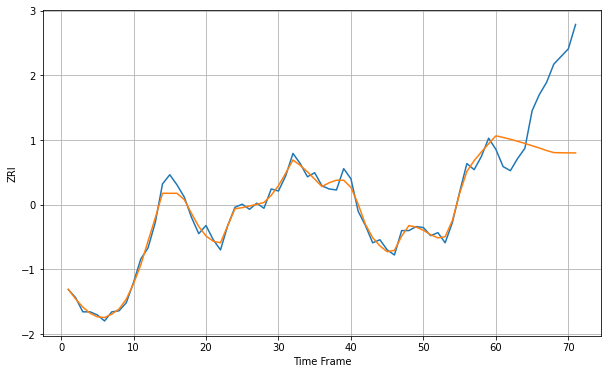

Wall time: 16.1 s
33062 5.673782359951516 66.98955877011264 [1621.31573384 1619.75334583 1617.96320496 1615.97811661 1613.84167279
 1611.60467359 1609.31959475 1606.83126698 1604.81145781 1604.64444037
 1604.53827508 1604.47330946]

Got an mse at 0.0050 in round 64 and stopped training



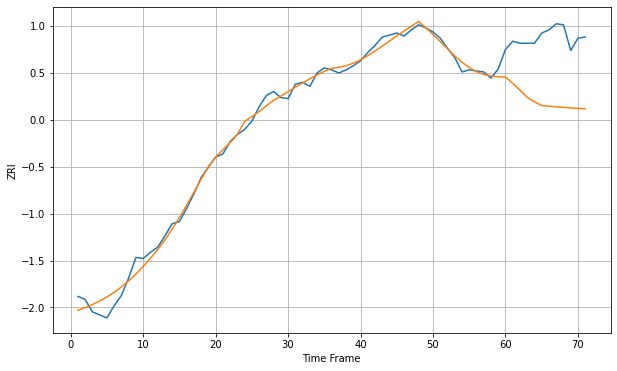

Wall time: 6.28 s
33065 6.438156594543169 62.49972743496343 [1506.9309987  1500.94057888 1494.27325872 1487.23373675 1482.86563455
 1479.26073488 1478.6104158  1478.01672656 1477.46894009 1476.96351909
 1476.48102829 1475.99926854]

Got an mse at 0.0050 in round 294 and stopped training



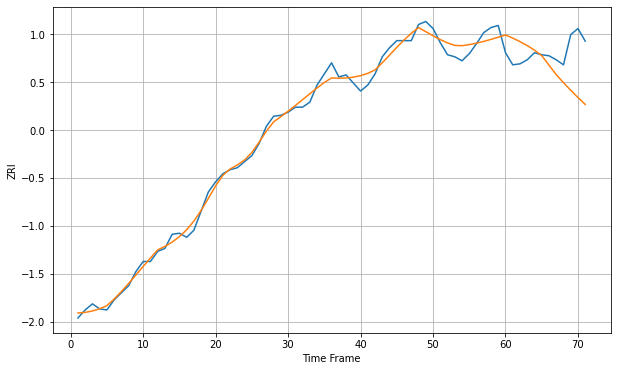

Wall time: 11.5 s
33066 6.695307755031218 34.13857340566808 [1461.63290515 1458.48911472 1454.9871743  1451.13545791 1446.59546317
 1441.11693428 1431.72548709 1422.27811014 1414.34661755 1406.78825085
 1399.58525607 1392.74138645]


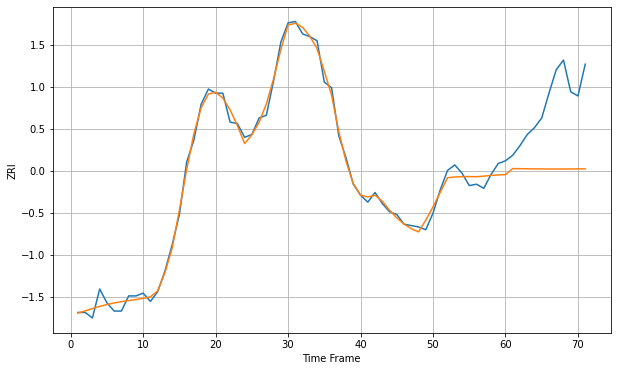

Wall time: 15.9 s
33125 4.630094879939066 49.55859691110709 [1682.94987268 1687.32788918 1687.24555181 1687.16426497 1687.0966545
 1687.04900878 1687.02321793 1687.01860545 1687.03293466 1687.06254258
 1687.10189809 1687.14345784]

Got an mse at 0.0049 in round 87 and stopped training



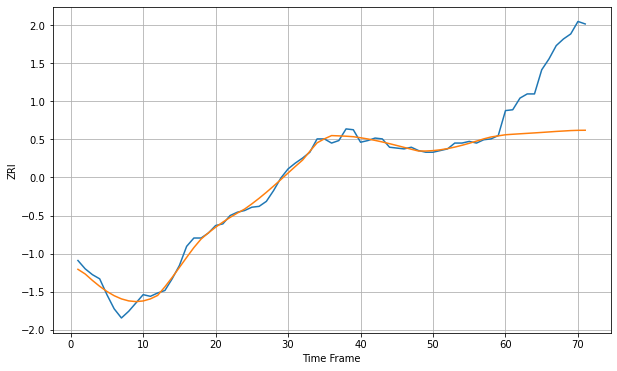

Wall time: 6.59 s
33126 6.365924174639826 87.06846255661915 [1647.9854476  1648.57405998 1649.12746333 1649.66613564 1650.20856627
 1650.76948724 1651.35893316 1651.98178181 1652.47653035 1652.9964993
 1653.29885807 1653.37981926]


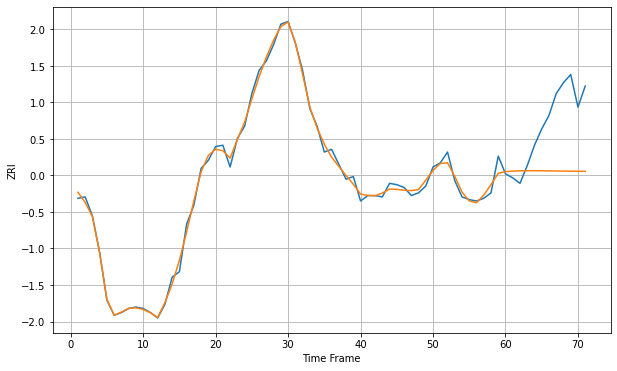

Wall time: 15.9 s
33127 3.786220630039457 42.588516468858934 [1737.60752181 1738.01331133 1738.21666648 1738.2893996  1738.28252507
 1738.2305697  1738.15628319 1738.07423303 1737.99333995 1737.91865166
 1737.85261081 1737.79598252]


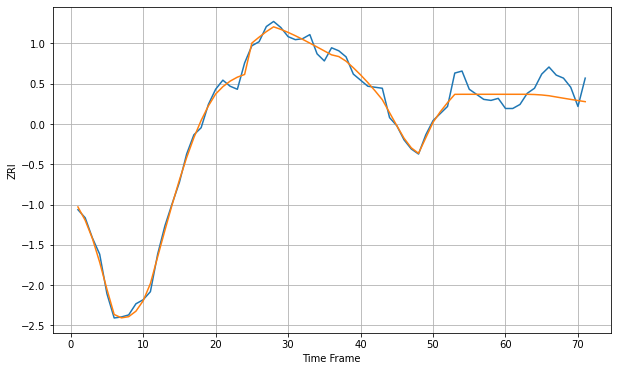

Wall time: 16.3 s
33130 6.480250462694858 16.69648792850451 [1764.03719998 1764.03719998 1764.03719998 1764.03719998 1763.81802362
 1763.36303393 1762.60654401 1761.37905134 1760.17369867 1758.99700772
 1757.85538971 1756.75522479]


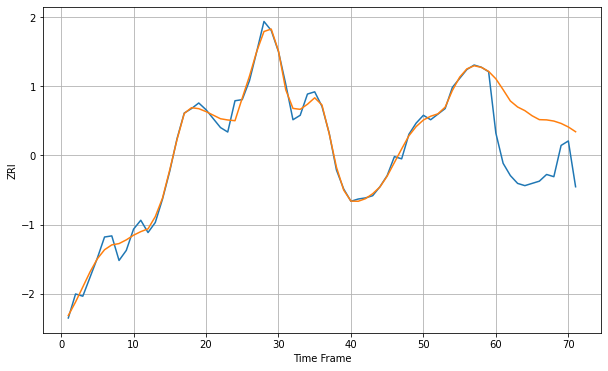

Wall time: 16 s
33131 5.697908318869462 53.936057867972686 [2283.64216416 2273.91072742 2263.80198159 2258.41290327 2255.15333425
 2250.56348906 2247.08237007 2246.87799326 2245.82622639 2243.70322053
 2240.5244373  2236.27171976]


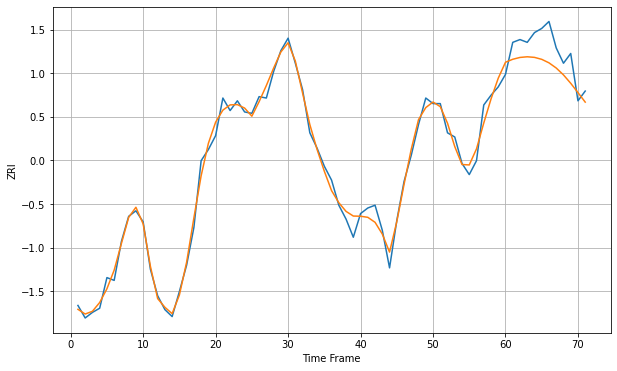

Wall time: 15.9 s
33132 5.716665316695147 15.875545792308559 [2055.71347938 2057.84151477 2059.1557403  2059.62819648 2059.20354035
 2057.79288411 2055.28083786 2051.56068526 2046.6102416  2040.5912554
 2033.89721969 2027.06270341]


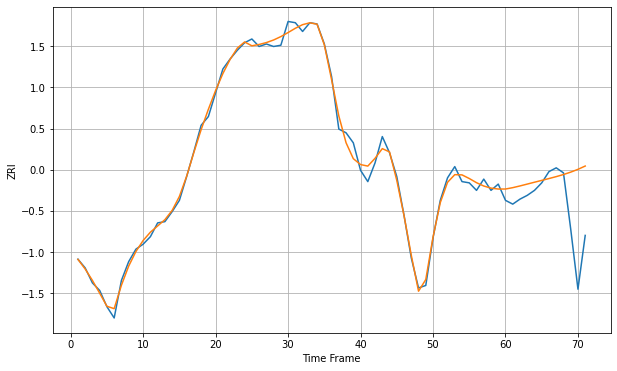

Wall time: 15.7 s
33133 4.676917444469679 35.244140266993796 [1985.06676831 1986.16222989 1987.53432985 1989.01873406 1990.51020505
 1991.97693454 1993.44586467 1994.97979348 1996.65954874 1998.57301179
 2000.80753717 2003.44212905]


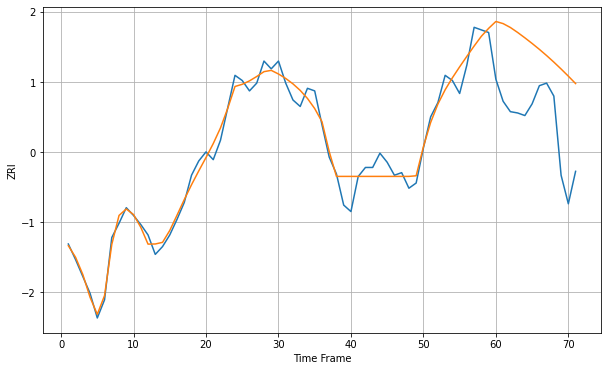

Wall time: 16.1 s
33134 8.539112868844855 59.34190305793298 [2114.5093335  2112.85820087 2109.86999156 2106.05548962 2101.90695983
 2097.57071018 2093.02434554 2088.23077656 2083.17803644 2077.87788493
 2072.3578536  2066.65443984]


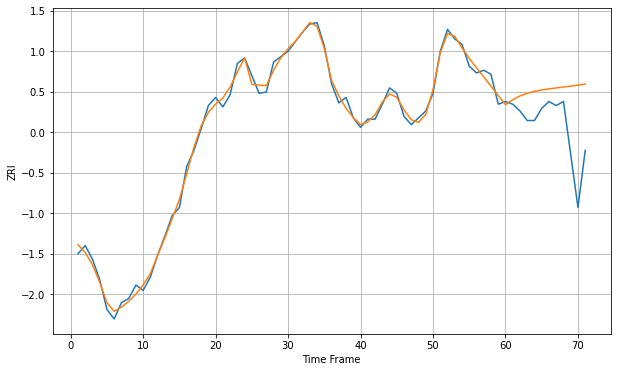

Wall time: 16 s
33135 4.188973439764343 34.84094966703404 [1724.60507094 1728.30460516 1731.07979477 1733.05179433 1734.46915214
 1735.50674106 1736.30065854 1736.97065173 1737.61423483 1738.29082448
 1739.02110668 1739.80044689]


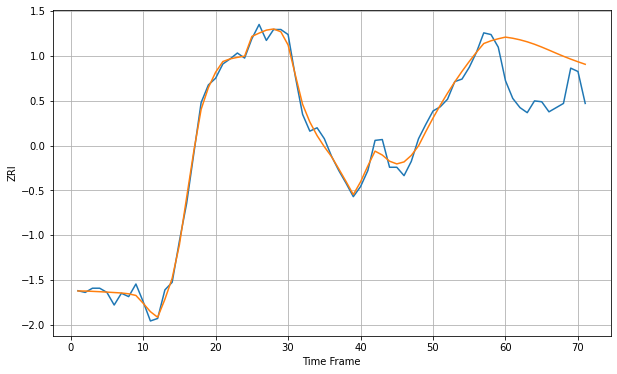

Wall time: 16.1 s
33137 7.732007172934999 61.509244182492466 [2275.94420893 2274.59862608 2272.73220317 2270.33813401 2267.4347916
 2264.09468685 2260.46431076 2256.74625789 2253.13481482 2249.74507459
 2246.58753168 2243.59157295]


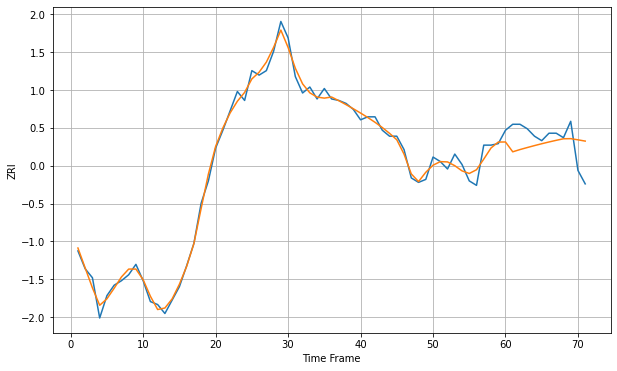

Wall time: 16.1 s
33138 4.194866714515998 13.95026945216524 [1696.11575483 1689.51795164 1691.03147779 1692.38017461 1693.68696107
 1694.93760917 1696.12097686 1697.23160876 1698.27050906 1698.35597022
 1697.56415767 1696.70493841]


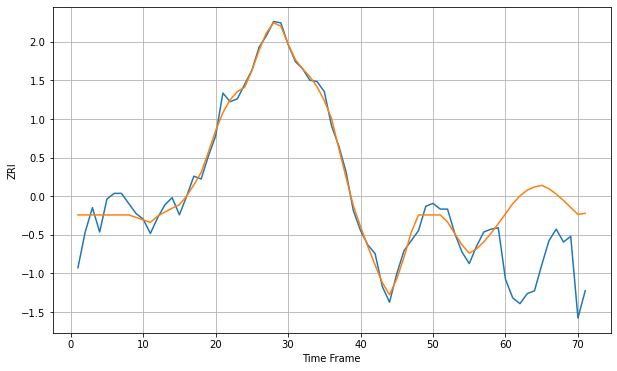

Wall time: 15.8 s
33139 7.7914107552820555 55.49609591683631 [2011.72662754 2018.794103   2024.29829122 2028.18131514 2030.53714745
 2031.5708763  2029.24242795 2025.45810913 2021.07469202 2016.14570385
 2011.27027336 2012.05908179]


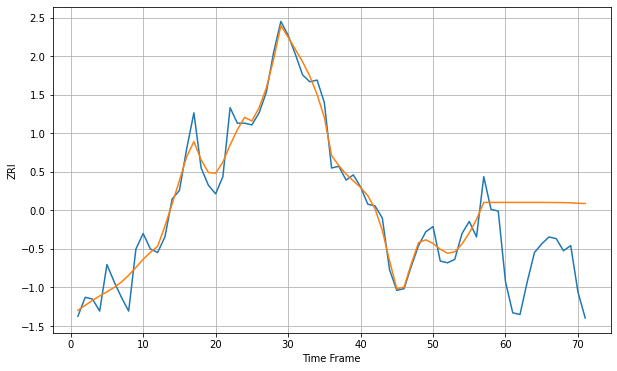

Wall time: 15.7 s
33140 7.7226317940112175 44.052329898529834 [2311.03353056 2311.03353056 2311.03353056 2311.03353056 2311.03353056
 2311.03353056 2310.99308046 2310.95125725 2310.91960627 2310.79710438
 2310.57266826 2310.37840297]

Got an mse at 0.0050 in round 468 and stopped training



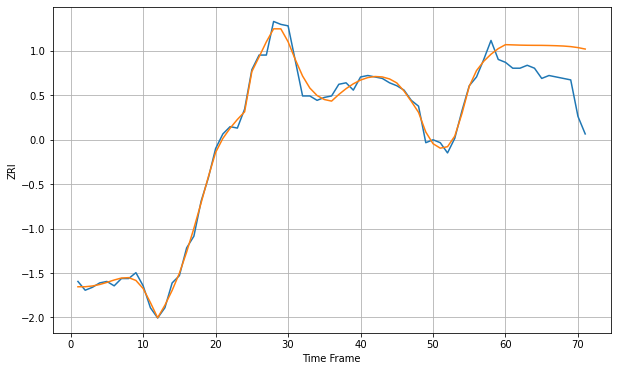

Wall time: 15.2 s
33141 4.264877890566932 27.513517349640438 [1866.12617267 1865.96813299 1865.79991403 1865.70428264 1865.66033905
 1865.63547101 1865.53660611 1865.3927998  1865.17701952 1864.78667491
 1864.1099027  1863.11233209]


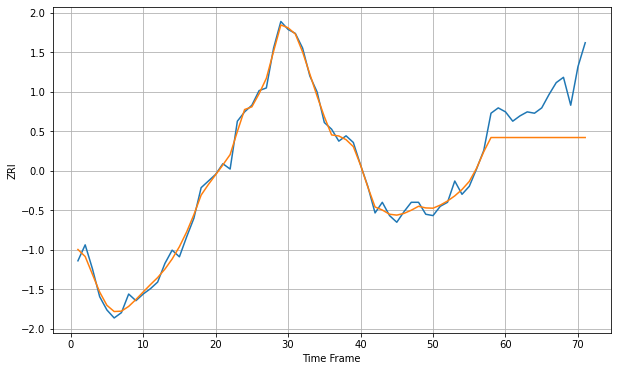

Wall time: 15.8 s
33142 5.853584238256705 35.709380962367426 [1655.71113262 1655.71113262 1655.71113262 1655.71113262 1655.71113262
 1655.71113262 1655.71113262 1655.71113262 1655.71113262 1655.71113262
 1655.71113262 1655.71113262]


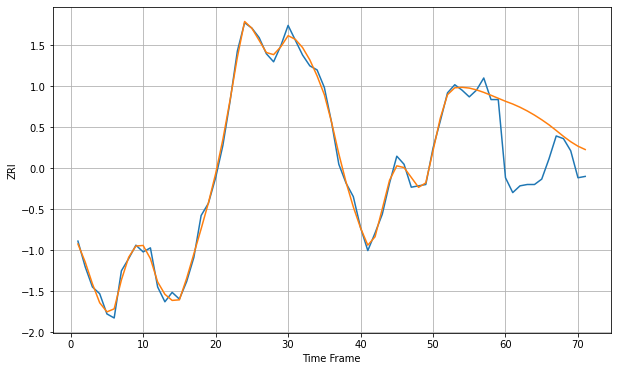

Wall time: 15.8 s
33145 4.405565269693913 40.97542744103082 [2074.7231256  2072.6968068  2070.31202287 2067.56784594 2064.46709126
 2061.02237851 2057.27812366 2053.06225754 2048.70913467 2044.73049881
 2041.4173659  2038.93469534]


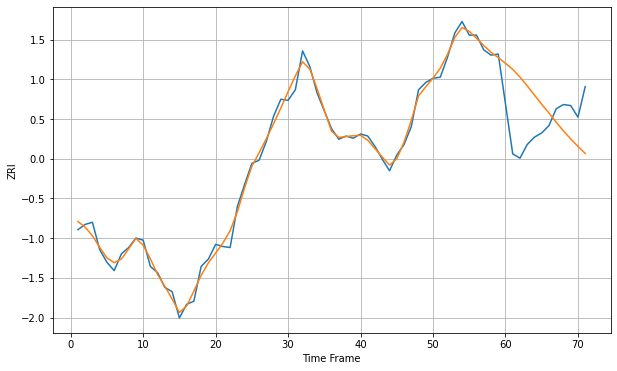

Wall time: 15.8 s
33147 5.762996804262194 46.634459927853385 [1971.17992932 1965.40846913 1958.08480922 1949.7163824  1940.9514015
 1932.2236057  1923.87980787 1915.16753747 1906.92669597 1899.27683731
 1892.15723249 1885.47093685]


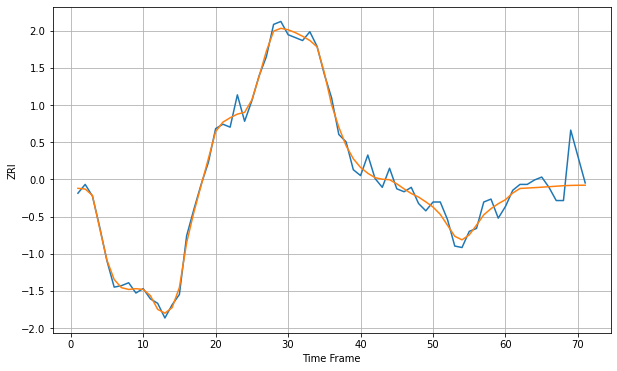

Wall time: 15.7 s
33150 4.9158694936895255 13.284691899980954 [1612.60600766 1617.13097438 1620.22980607 1620.51062646 1620.79207374
 1621.09545463 1621.42333545 1621.76474959 1622.10144881 1622.30864231
 1622.40964294 1622.44039879]


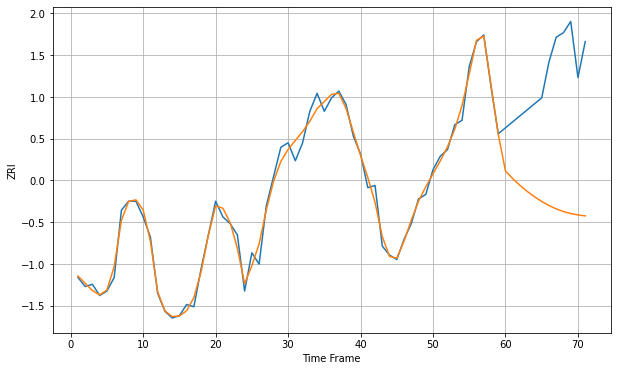

Wall time: 15.8 s
33157 3.4757259438586083 58.06799624221673 [1756.39446316 1753.03691318 1750.02369268 1747.33724409 1744.95807087
 1742.87052282 1741.0708897  1739.56923524 1738.37666971 1737.48576006
 1736.86257319 1736.45490267]


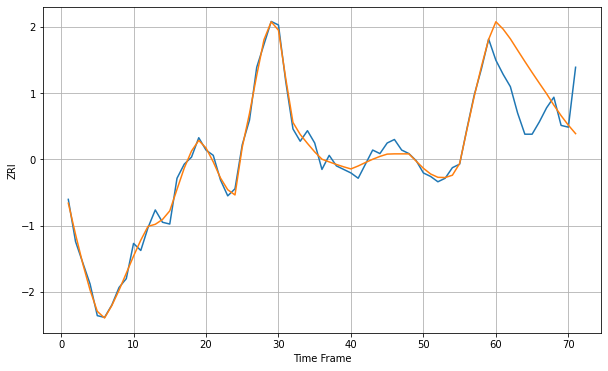

Wall time: 16.4 s
33160 3.6972228884264555 25.97168363789314 [2079.83985965 2075.6670607  2070.14049801 2063.67740144 2057.28878918
 2051.03748546 2044.94476325 2038.96944597 2032.50476469 2026.53770514
 2021.14171733 2016.32470182]


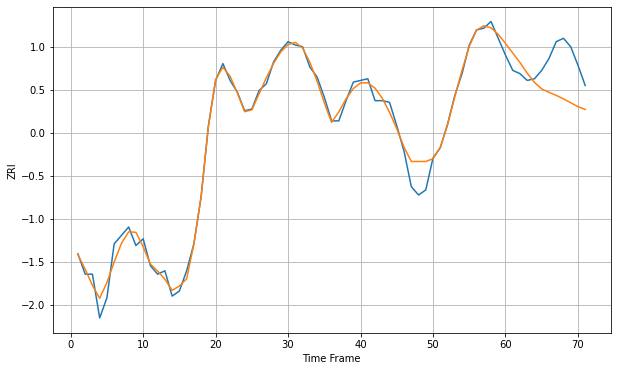

Wall time: 16.5 s
33161 5.400879462406026 20.343594134700556 [1528.95532158 1523.24753083 1517.6237784  1511.33850241 1505.78276483
 1501.95596583 1499.94826751 1498.10772653 1496.06020413 1493.72603163
 1491.44431575 1489.77421335]

Got an mse at 0.0050 in round 144 and stopped training



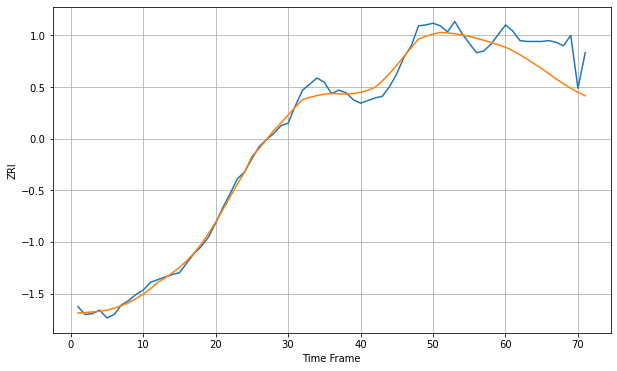

Wall time: 8.08 s
33178 8.354760391952087 35.12177901552032 [2036.36576305 2032.33040699 2027.69430244 2022.58924816 2017.17059063
 2011.61844703 2005.90980619 1999.89246531 1994.29502081 1989.19369256
 1984.61249151 1980.53968094]


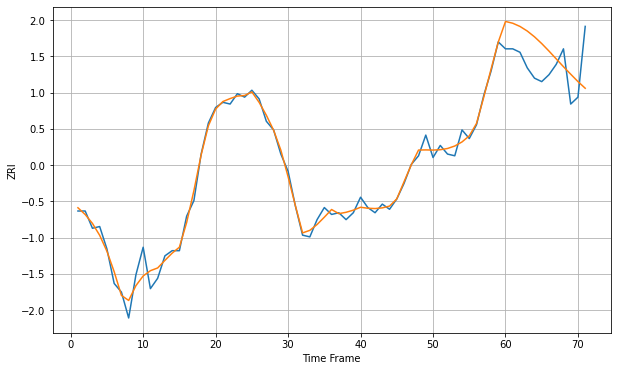

Wall time: 16.2 s
33180 4.326569118010894 18.667230629281033 [2046.86112614 2045.83356375 2043.97530788 2041.32670258 2037.97063984
 2034.03734704 2029.70218177 2025.17003437 2020.64462094 2016.29153111
 2012.01354879 2008.14783354]

Got an mse at 0.0050 in round 139 and stopped training



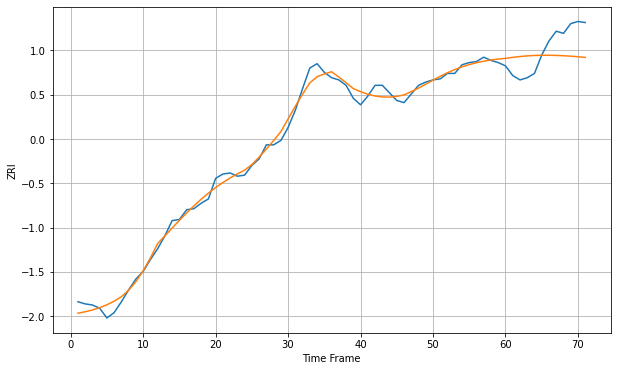

Wall time: 7.97 s
33186 5.764577239228899 21.577229262082355 [1590.87507639 1591.82690815 1592.60798255 1593.19284559 1593.5754047
 1593.76354456 1593.77294482 1593.62247908 1593.33160852 1592.91924208
 1592.40338253 1591.80105315]


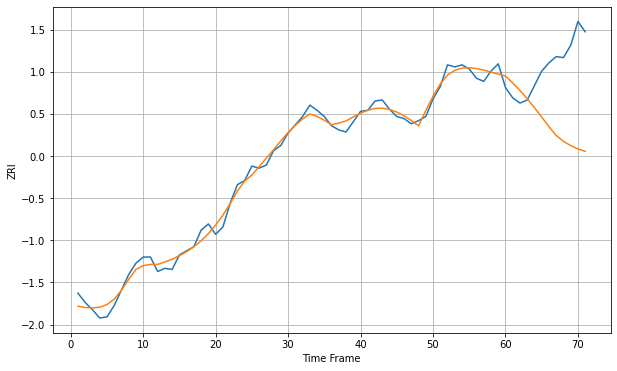

Wall time: 15.7 s
33196 6.363212503948001 69.04658431865268 [1600.11283825 1593.47406046 1586.1958388  1578.25904065 1569.49510773
 1560.43460202 1551.13835411 1542.58701496 1537.05309996 1532.78280954
 1529.61169269 1527.31399102]


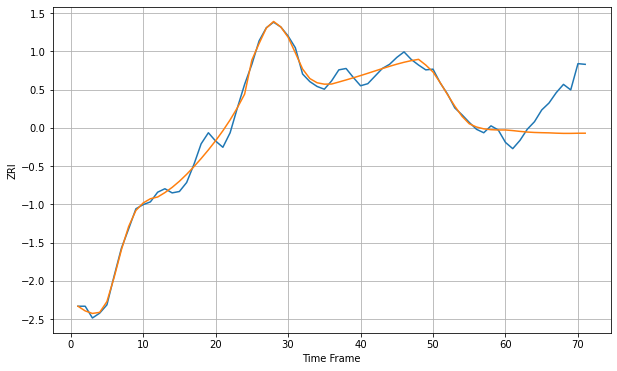

Wall time: 16.1 s
33301 9.009929003285771 55.42280244423659 [1750.03385899 1749.12970441 1747.97117052 1747.03817524 1746.42691491
 1746.09658025 1745.86365679 1745.40803422 1745.10414302 1745.1087325
 1745.30725369 1745.35646668]

Got an mse at 0.0050 in round 116 and stopped training



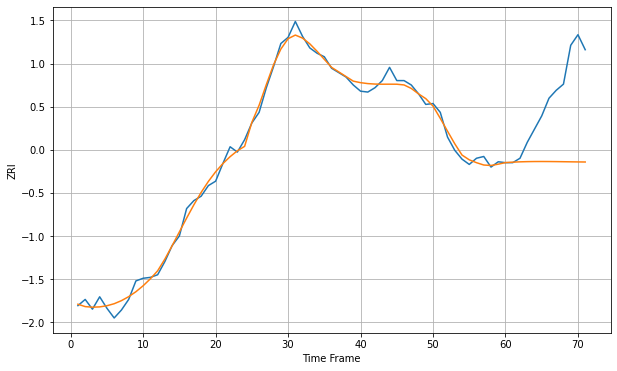

Wall time: 7.4 s
33304 6.862672864631427 80.79718008406728 [1556.05661154 1556.56474123 1556.92809902 1557.16068844 1557.28091454
 1557.30956507 1557.26851656 1557.17986144 1557.06511243 1556.94430771
 1556.83507775 1556.75187338]

Got an mse at 0.0050 in round 303 and stopped training



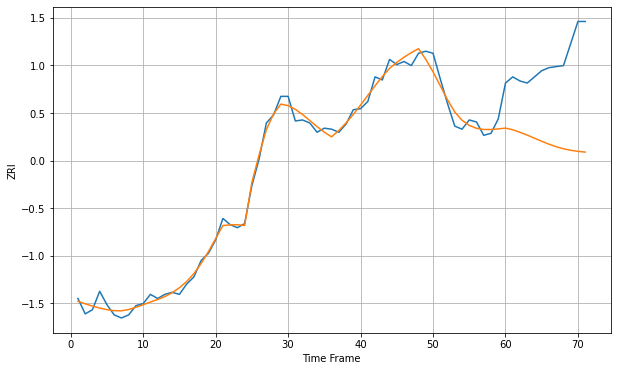

Wall time: 11.6 s
33305 6.539300548742428 81.27995951518518 [1503.05398722 1501.44955652 1498.99477696 1496.21021664 1493.2211294
 1490.20717414 1487.37709946 1484.91573713 1482.9327474  1481.44485663
 1480.3949713  1479.68756585]

Got an mse at 0.0050 in round 83 and stopped training



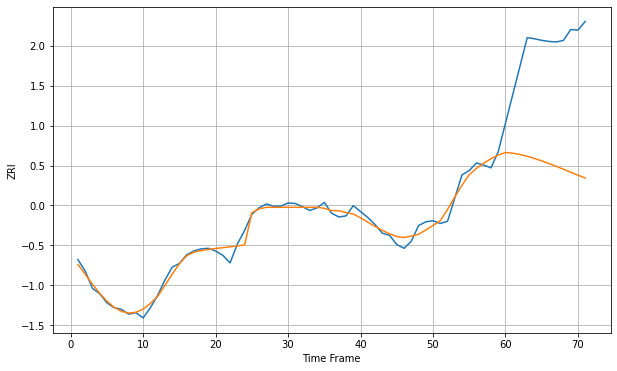

Wall time: 6.72 s
33308 10.36702476674121 219.01025069364903 [1614.44946961 1613.06852823 1610.6690371  1607.39114613 1603.39895941
 1598.85609216 1593.91135637 1588.69505454 1583.32038558 1577.88559515
 1572.47530359 1567.16106221]

Got an mse at 0.0050 in round 151 and stopped training



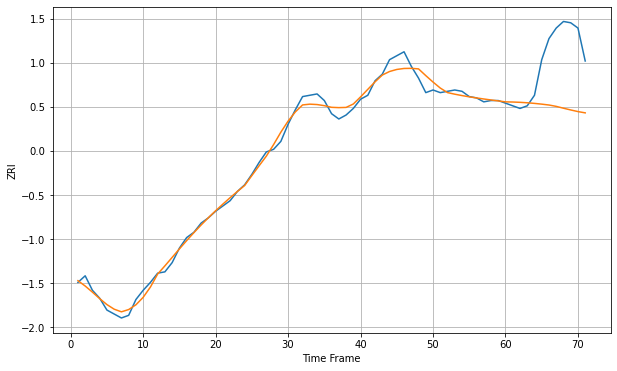

Wall time: 8.3 s
33311 4.707096955305764 42.38796624425588 [1387.98831225 1387.8714366  1387.64313064 1387.29640264 1386.83157852
 1386.25891716 1385.59888566 1384.56522248 1383.17734101 1381.84927922
 1380.61229921 1379.64258592]

Got an mse at 0.0050 in round 207 and stopped training



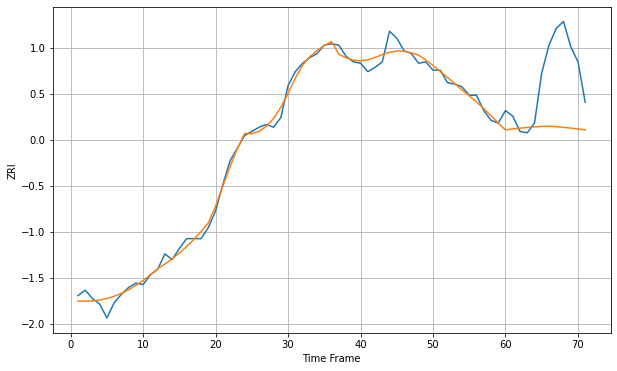

Wall time: 9.17 s
33312 4.649203985863866 42.905477193408785 [1416.0645425  1416.79806355 1417.3517624  1417.82072096 1418.29992418
 1418.60413895 1418.73416376 1418.42763515 1417.95548309 1417.39998471
 1416.79105913 1416.1549215 ]


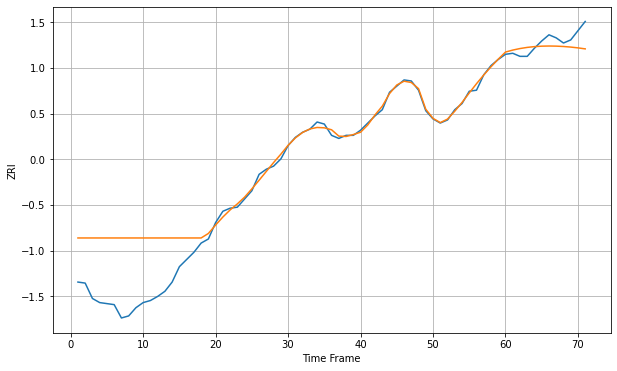

Wall time: 15.9 s
33313 30.047120574797766 10.856964270082925 [1447.18568846 1449.10524402 1450.6089992  1451.72511814 1452.4854574
 1452.92328667 1453.07097654 1452.95779572 1452.60803242 1452.0395951
 1451.26314763 1450.28175464]

Got an mse at 0.0049 in round 49 and stopped training



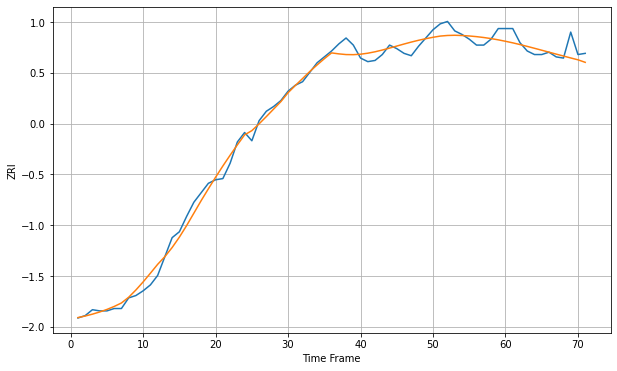

Wall time: 5.86 s
33324 5.966126668183046 8.59584578997756 [1562.22141389 1560.90300015 1559.44853358 1557.90218754 1556.29723896
 1554.65850187 1553.00544456 1551.35440066 1549.71953403 1548.11291702
 1546.54422289 1544.40595091]

Got an mse at 0.0050 in round 48 and stopped training



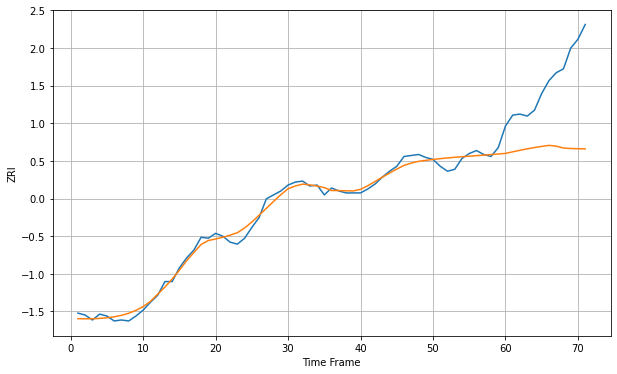

Wall time: 5.84 s
33334 5.33167219859682 73.02408991460759 [1321.10942836 1322.72081092 1324.28441975 1325.73873301 1327.05425296
 1328.22612816 1329.24940453 1328.48854704 1326.53909234 1326.08397553
 1325.85794758 1325.71362348]

Got an mse at 0.0050 in round 301 and stopped training



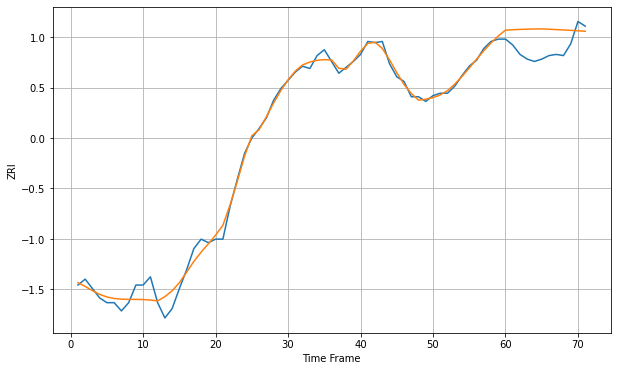

Wall time: 11.3 s
33401 6.048627515860957 19.113053438940316 [1525.65605859 1525.98780288 1526.24915242 1526.44989156 1526.59959172
 1526.70579221 1526.4109931  1526.10237756 1525.78656918 1525.45235576
 1525.08701161 1524.67918711]


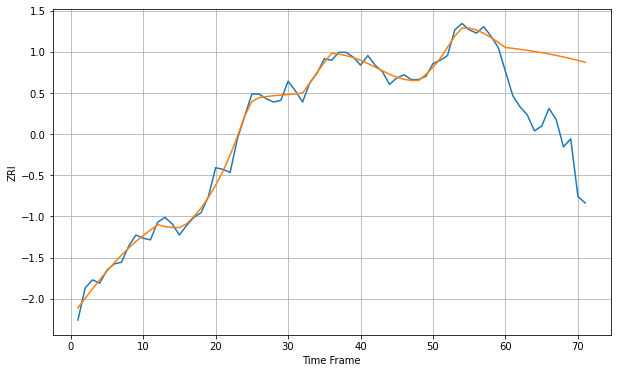

Wall time: 15.3 s
33404 3.8988706036217176 51.54199377454329 [1493.01228271 1492.46708463 1491.87102378 1491.22330275 1490.52217947
 1489.76486032 1488.94741859 1488.06479448 1487.11093897 1486.07916349
 1484.96275007 1483.75585824]

Got an mse at 0.0050 in round 240 and stopped training



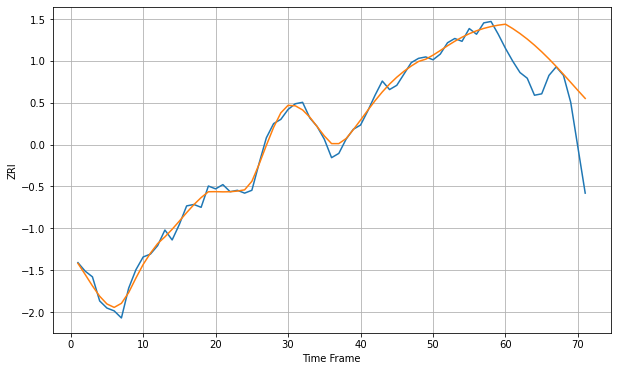

Wall time: 10.2 s
33407 4.155475052367364 30.104109744274872 [1517.07994112 1513.9795671  1510.48678159 1506.58875289 1502.29013441
 1497.61273319 1492.59281356 1487.27973751 1481.73781783 1476.05300693
 1470.34249937 1464.75562878]


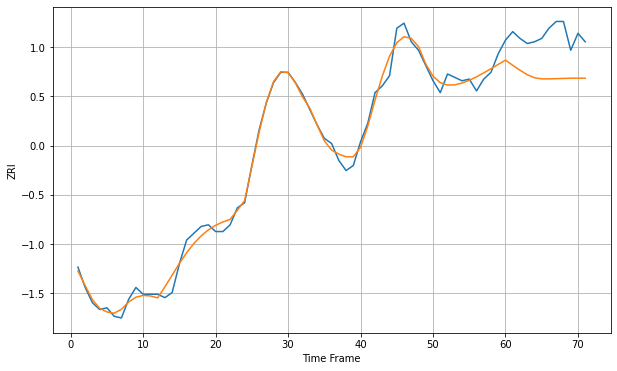

Wall time: 16 s
33413 4.37775126576951 23.881975297915783 [1456.18609209 1453.10798712 1450.22191348 1447.57726034 1445.76994577
 1445.11121314 1445.12320534 1445.24061381 1445.38941382 1445.50669801
 1445.5515626  1445.50623919]

Got an mse at 0.0050 in round 451 and stopped training



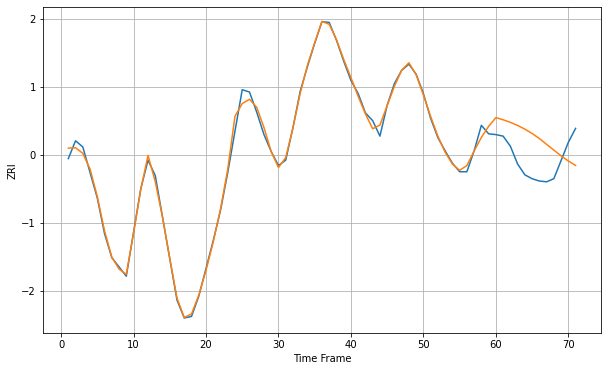

Wall time: 14.7 s
33414 6.181367860062091 41.72134989403746 [1757.90937286 1755.13408086 1751.78918635 1747.85578176 1743.04948681
 1737.40803131 1730.96837691 1723.35369494 1715.925583   1708.50206715
 1701.87157204 1696.1652567 ]

Got an mse at 0.0050 in round 424 and stopped training



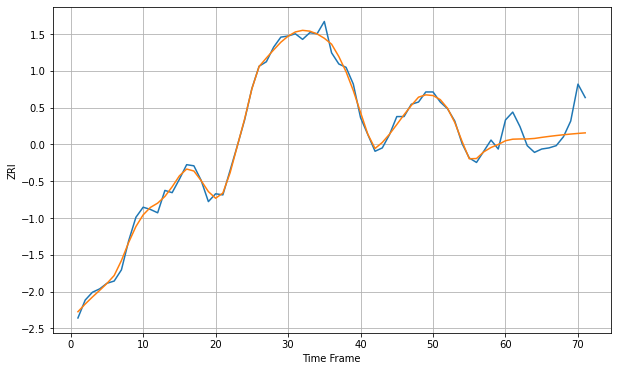

Wall time: 14.2 s
33418 4.643016090882827 19.613588634496107 [1685.4000189  1686.79004876 1686.98282964 1687.00237372 1687.45220972
 1688.40833341 1689.26674196 1690.04208335 1690.7427375  1691.37316788
 1691.93605995 1692.43388881]

Got an mse at 0.0050 in round 254 and stopped training



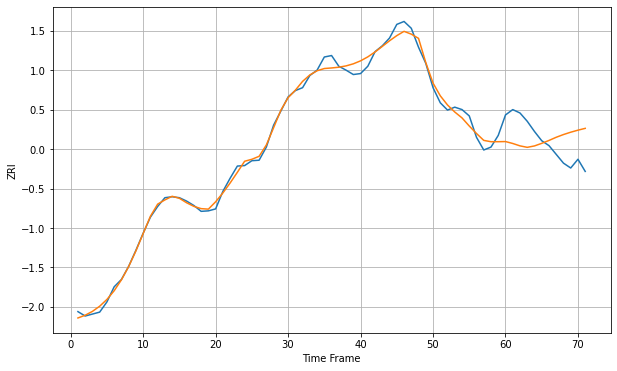

Wall time: 10.2 s
33432 11.397512042281399 56.09217643385406 [1932.34520245 1928.38573335 1923.48028746 1920.47059161 1923.34842166
 1928.67326577 1934.60485587 1941.13881699 1946.72826301 1951.53308442
 1955.71862195 1959.43731177]

Got an mse at 0.0050 in round 397 and stopped training



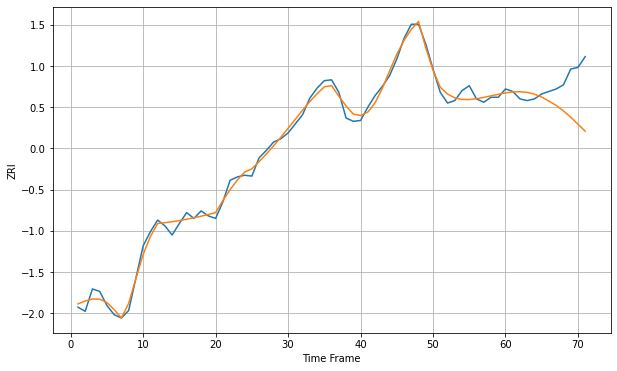

Wall time: 13.9 s
33433 7.009430828224764 38.6175051175948 [1763.29428725 1764.43478999 1764.68679396 1763.8679212  1761.76164414
 1758.15640575 1753.38848335 1748.12787098 1741.55767326 1733.9563899
 1725.66945536 1717.02223352]


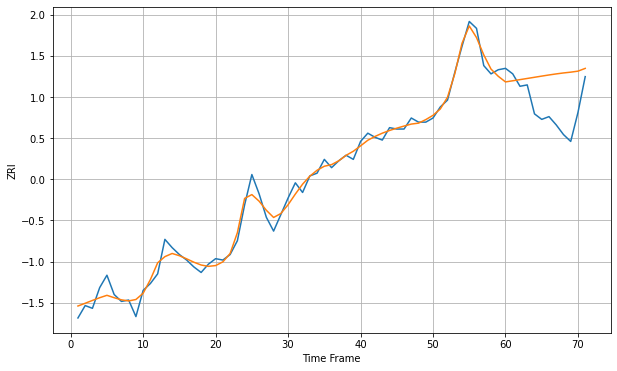

Wall time: 15.7 s
33435 5.423631445647761 28.267274773689092 [1716.16303374 1716.99488784 1717.82863278 1718.67259228 1719.52612253
 1720.3779208  1721.20584066 1721.9796419  1722.66719613 1723.24252832
 1723.9709776  1725.97282483]

Got an mse at 0.0049 in round 162 and stopped training



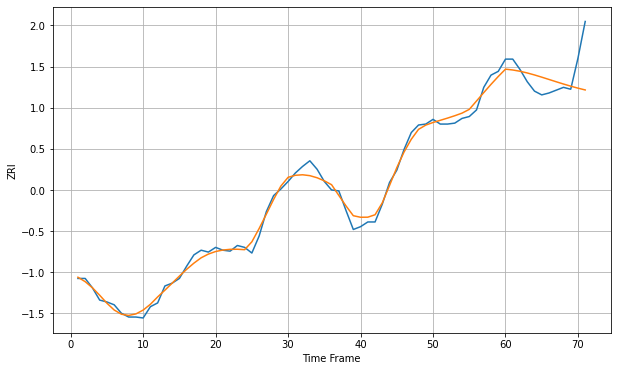

Wall time: 8.36 s
33436 6.039525214054178 25.17550865538596 [1556.34237843 1555.46298241 1554.09580272 1552.30572439 1550.1848267
 1547.84386582 1545.39591252 1542.93842766 1540.54479683 1538.26913035
 1536.15560193 1534.24081593]

Got an mse at 0.0050 in round 326 and stopped training



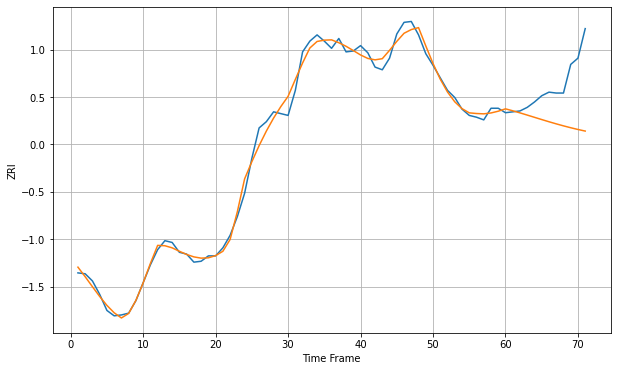

Wall time: 11.9 s
33444 7.483395243089856 49.3314243863908 [1679.34633612 1677.17538497 1674.82697538 1672.37231329 1669.86689415
 1667.36656792 1664.91981836 1662.56434637 1660.32735273 1658.22787317
 1656.27963736 1654.49352372]


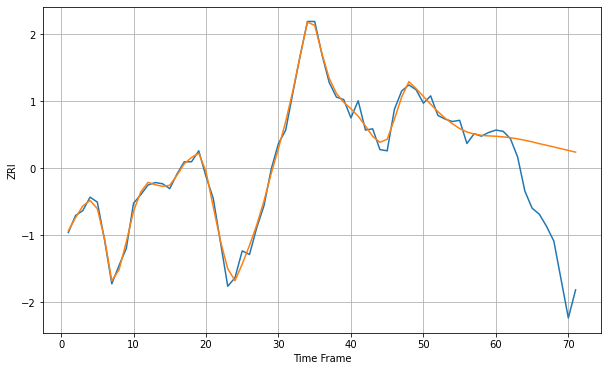

Wall time: 15.6 s
33460 5.0417827950180465 71.74702212493355 [1499.94276658 1499.43012265 1498.74624424 1497.77380458 1496.64365922
 1495.33910212 1493.85156029 1492.52381163 1491.15218539 1489.72199839
 1488.28918192 1486.91524077]

Got an mse at 0.0050 in round 387 and stopped training



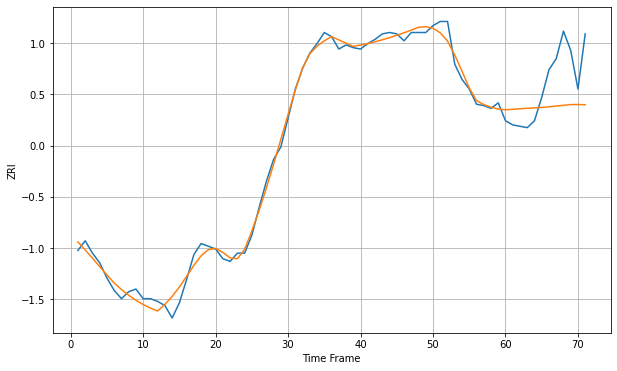

Wall time: 13.4 s
33461 5.226057520472197 28.573540672841293 [1431.94697955 1432.34437543 1432.6979687  1433.0341719  1433.36396623
 1433.68065766 1434.10500837 1434.66575393 1435.21726876 1435.73014693
 1435.77264036 1435.58865706]

Got an mse at 0.0050 in round 167 and stopped training



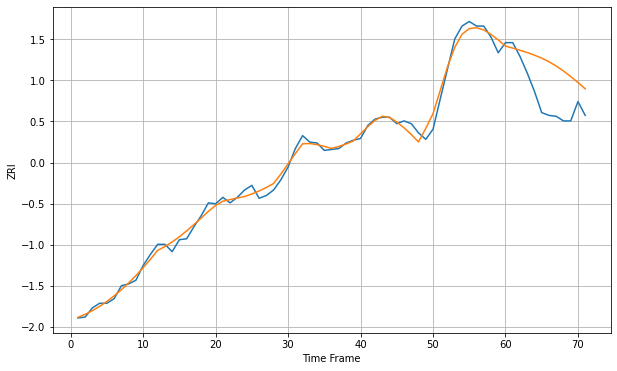

Wall time: 8.48 s
33510 6.249583743061108 39.30946625307813 [1273.23343958 1271.04126287 1268.74037988 1266.24021013 1263.42127561
 1260.13951979 1256.24414433 1251.61777357 1246.23387027 1240.19121913
 1233.67815216 1226.89226333]

Got an mse at 0.0050 in round 187 and stopped training



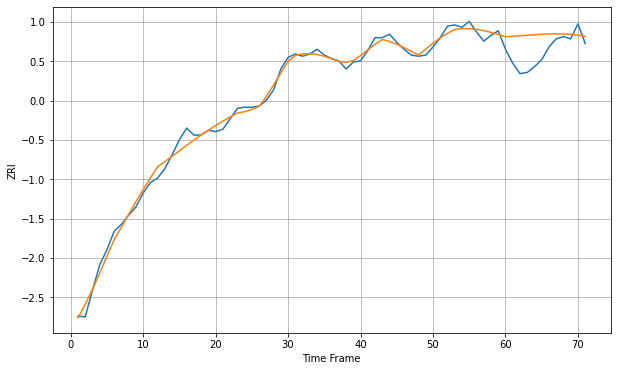

Wall time: 8.92 s
33511 4.7798943680240455 18.917261413813275 [1280.81589391 1281.21935225 1281.64711328 1282.1130649  1282.56804453
 1282.9578528  1283.22752732 1283.32471139 1283.20259619 1282.82312881
 1282.16100574 1281.16198836]

Got an mse at 0.0050 in round 72 and stopped training



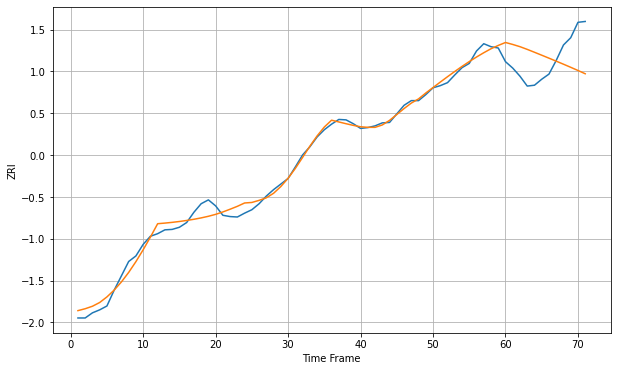

Wall time: 6.71 s
33602 13.665031719455174 71.91362814492524 [1886.86181101 1882.25659209 1877.05267812 1870.75335646 1864.00385085
 1857.13991265 1850.20948643 1843.2097601  1836.10856751 1828.86322542
 1821.43336933 1813.78853953]

Got an mse at 0.0050 in round 220 and stopped training



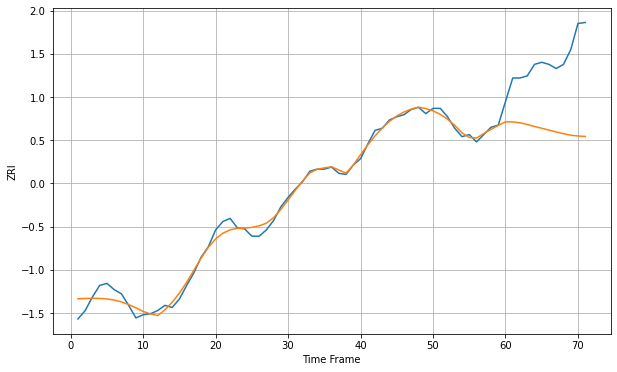

Wall time: 9.97 s
33604 5.800819846937759 68.06362004534314 [1015.17707561 1015.07143695 1014.20801924 1012.65764026 1010.71192506
 1009.05656385 1007.24655271 1005.47094086 1003.83949552 1002.38688247
 1001.64111527 1001.19204447]

Got an mse at 0.0050 in round 70 and stopped training



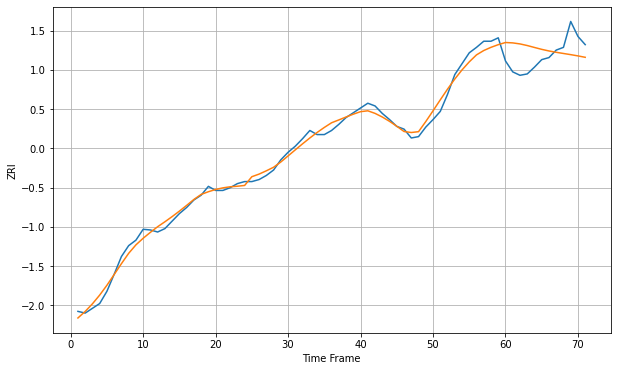

Wall time: 6.63 s
33606 7.9456182959999975 30.52120921658788 [1552.12297499 1551.54725816 1550.04122706 1547.67643379 1544.83545847
 1542.06459714 1539.70135429 1537.74343415 1536.00919793 1534.30116198
 1532.46593721 1530.39530869]

Got an mse at 0.0050 in round 221 and stopped training



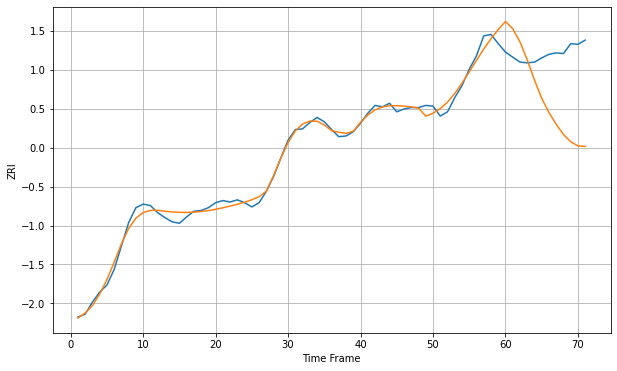

Wall time: 10.1 s
33607 7.729388549929591 91.28207047666088 [1496.25280272 1486.01312699 1467.38665675 1442.23602835 1413.64376528
 1387.9465352  1367.89431066 1351.50418496 1336.99595181 1326.84871572
 1320.96998718 1320.28586998]

Got an mse at 0.0050 in round 252 and stopped training



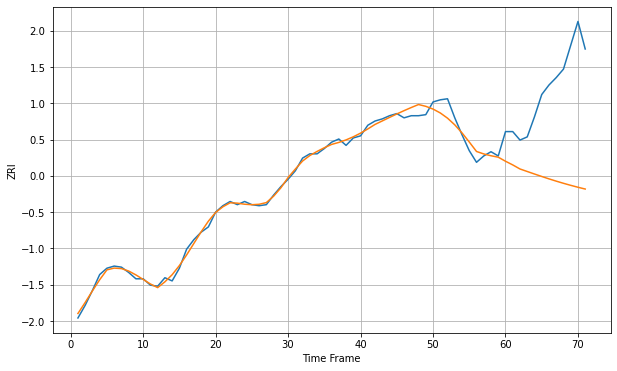

Wall time: 10.8 s
33612 4.823722210583199 91.75590231451136 [974.00802679 970.53385077 966.69724057 964.31727893 961.94341191
 959.61446799 957.36354397 955.21332669 953.17555734 951.25373355
 949.44703307 947.7533732 ]

Got an mse at 0.0050 in round 106 and stopped training



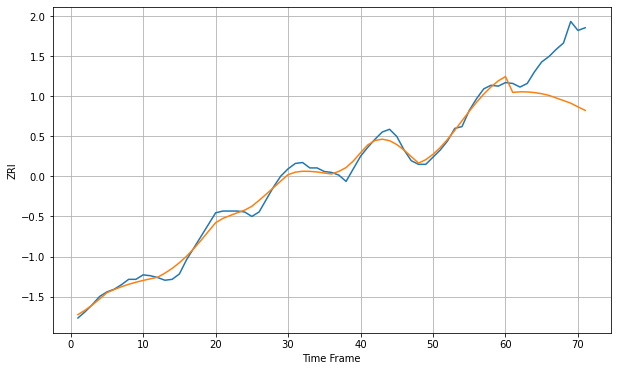

Wall time: 7.44 s
33613 6.240314919183541 53.93731048883203 [1205.68312663 1188.03905722 1188.70070812 1188.60050449 1187.85344317
 1186.60030659 1184.71621061 1181.84999838 1178.98977421 1176.07343048
 1171.92034134 1168.06320037]

Got an mse at 0.0048 in round 38 and stopped training



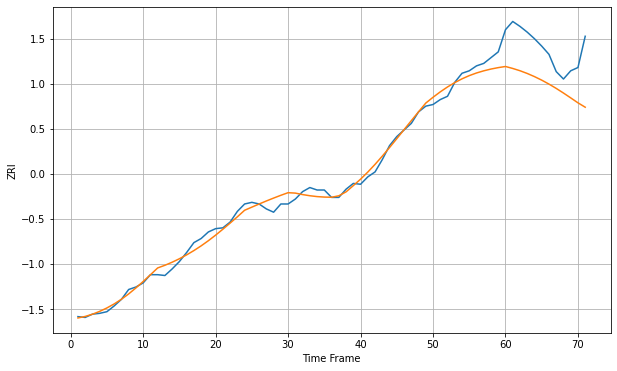

Wall time: 5.66 s
33615 7.344741884361913 47.376900122810504 [1274.23408124 1271.84622593 1269.07280345 1265.75292879 1261.9244852
 1257.6161289  1252.82478251 1247.57729989 1241.94179518 1236.03730675
 1230.03435493 1224.70679708]

Got an mse at 0.0050 in round 286 and stopped training



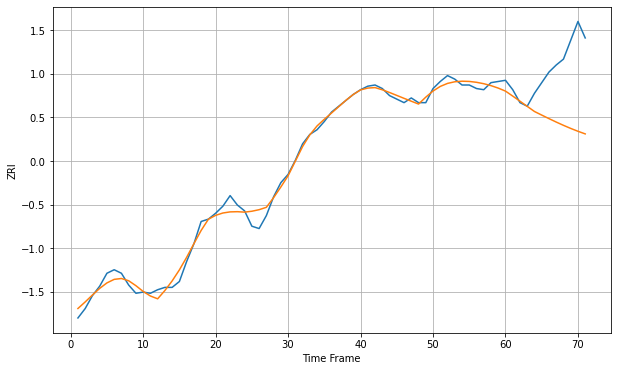

Wall time: 11.5 s
33617 5.205223320009691 49.30699855215094 [1067.80529929 1063.57703547 1059.23977269 1054.83685044 1050.47746328
 1047.43478973 1044.42708468 1041.50664114 1038.71905231 1036.09922958
 1033.66956716 1031.44023703]

Got an mse at 0.0049 in round 134 and stopped training



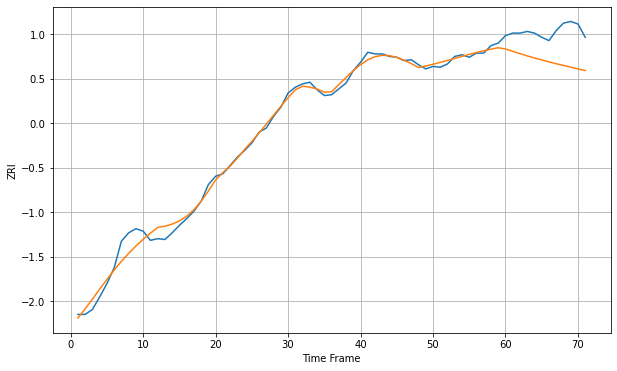

Wall time: 8.01 s
33626 7.482526433670715 36.730412670943515 [1439.92877203 1437.15017761 1434.31188708 1431.6149532  1429.07010102
 1426.76551078 1424.45616304 1422.2072204  1420.21166688 1418.12098818
 1415.97838072 1414.02712998]

Got an mse at 0.0050 in round 216 and stopped training



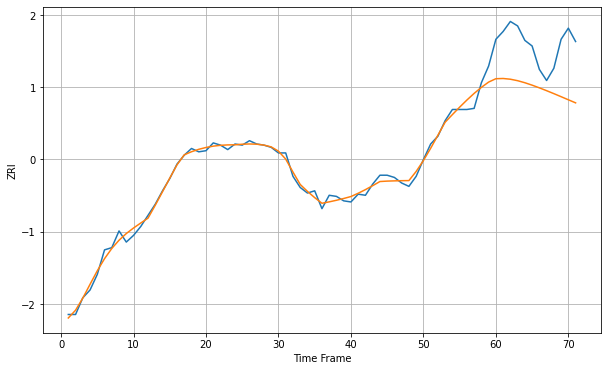

Wall time: 9.93 s
33634 4.574461544098461 42.33655352000531 [1216.60955606 1216.81831619 1216.16625595 1214.84031952 1213.01117915
 1210.82993664 1208.42448184 1205.87469905 1203.21977017 1200.48653966
 1197.71298364 1194.95531576]

Got an mse at 0.0050 in round 60 and stopped training



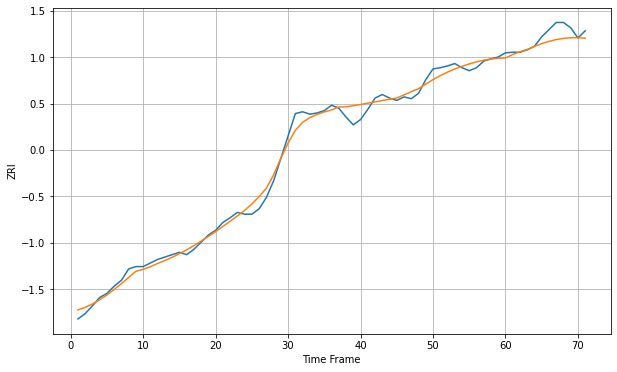

Wall time: 6.2 s
33701 10.886429969594108 14.682198640288709 [1355.40742143 1361.04594678 1365.81890671 1369.67442563 1374.82933764
 1379.49214851 1383.30613538 1386.23507299 1388.246027   1389.31515744
 1389.42947699 1388.5847478 ]

Got an mse at 0.0050 in round 136 and stopped training



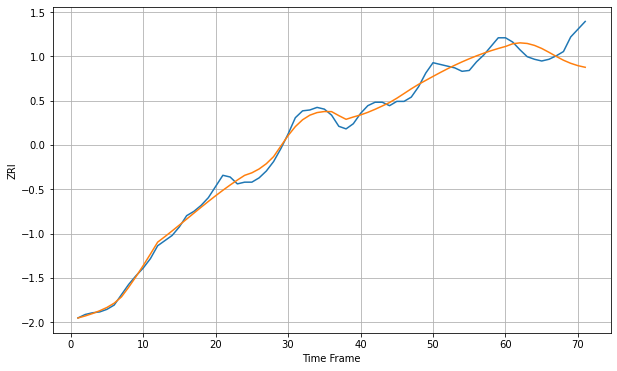

Wall time: 7.79 s
33702 7.253915924388254 23.516970680675648 [1171.9070553  1175.05027011 1176.11231883 1175.40144196 1173.14356009
 1169.58568674 1165.10718877 1160.36283616 1155.89268736 1152.3029542
 1149.56701138 1147.67666909]

Got an mse at 0.0050 in round 134 and stopped training



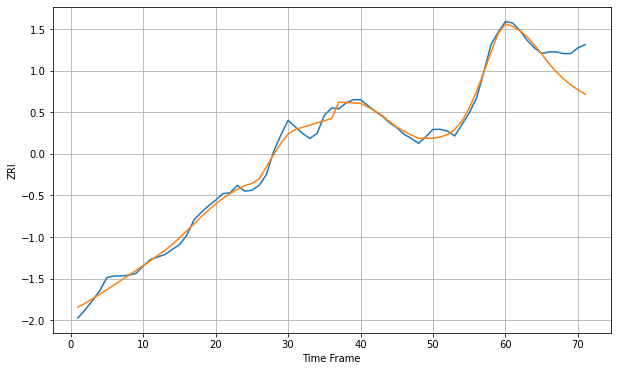

Wall time: 8.01 s
33705 7.093459748570878 28.085510520140495 [1346.19351729 1342.88573393 1337.65341739 1330.17057741 1320.47224807
 1309.28957134 1297.96881067 1287.78571866 1279.3433596  1272.04766475
 1265.88362663 1260.71423418]

Got an mse at 0.0050 in round 132 and stopped training



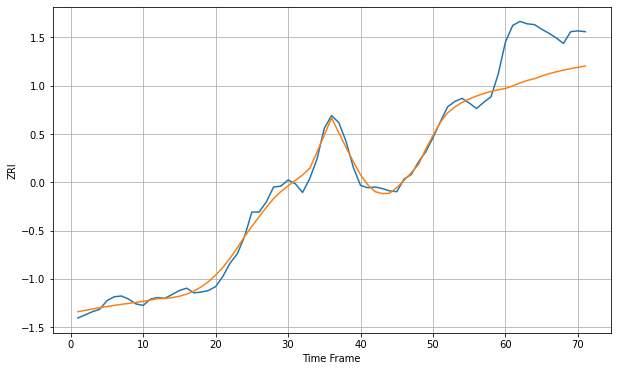

Wall time: 7.7 s
33706 8.642849032958036 58.54167627440301 [1486.51822849 1489.95867422 1493.59371675 1496.76034625 1499.02331604
 1502.42430918 1505.34536144 1507.84238352 1510.00008239 1511.89511531
 1513.59918415 1515.17937927]

Got an mse at 0.0050 in round 45 and stopped training



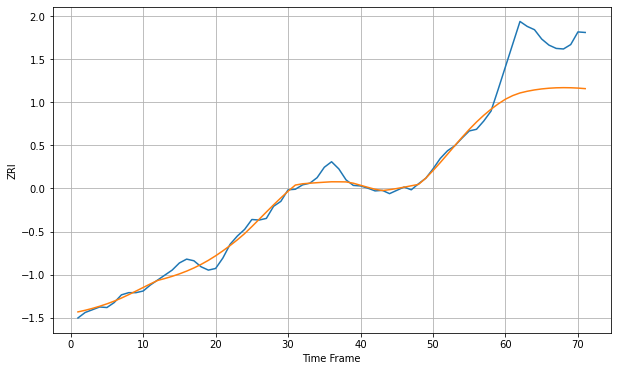

Wall time: 5.87 s
33708 10.938220564256458 94.20221579268753 [1561.78120318 1568.27228936 1573.03691574 1576.12998602 1578.56047057
 1580.38416306 1581.6503928  1582.40131324 1582.67263235 1582.49492882
 1581.89471538 1580.89491184]

Got an mse at 0.0050 in round 253 and stopped training



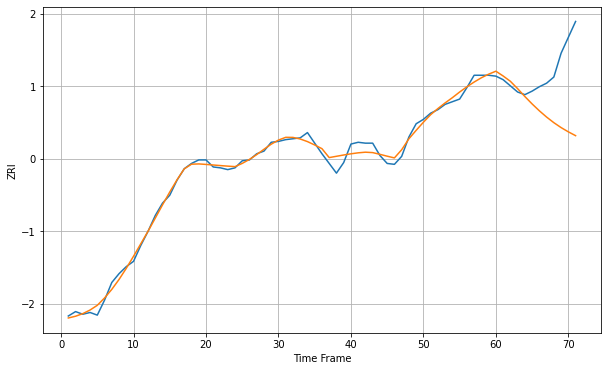

Wall time: 10.3 s
33712 5.781212665610699 58.14743085365987 [1152.60558467 1147.19209346 1141.15427654 1132.8118737  1123.89067675
 1115.48576279 1107.69688458 1100.58993517 1094.22693591 1088.66059821
 1083.82711181 1079.50917769]

Got an mse at 0.0050 in round 170 and stopped training



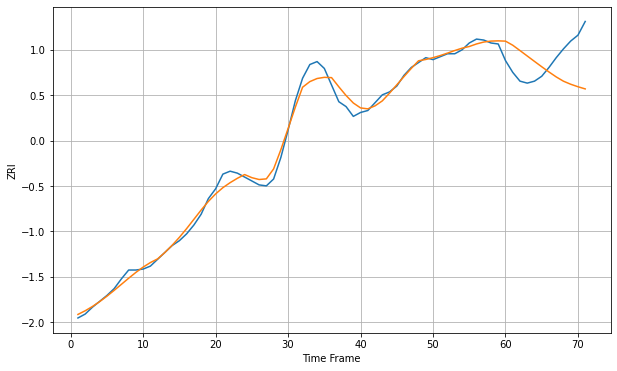

Wall time: 8.62 s
33716 6.4965422284381615 34.62859266338321 [1197.89992491 1193.71975707 1188.25766299 1182.72079594 1177.19051217
 1171.72166545 1166.39107057 1161.32513043 1156.9558057  1153.83960359
 1151.30009122 1149.08013977]

Got an mse at 0.0050 in round 109 and stopped training



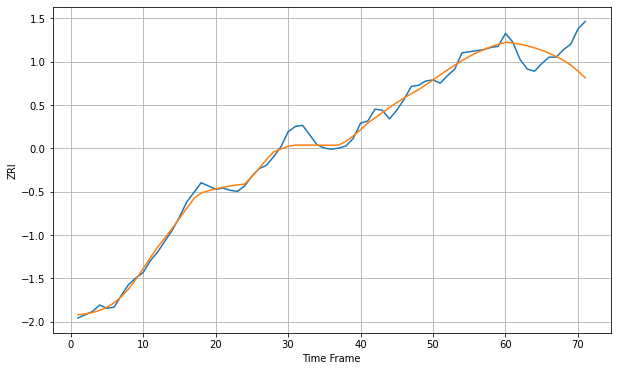

Wall time: 7.51 s
33755 5.635183306784524 22.45644675236293 [1092.79252246 1092.07356593 1090.99529188 1089.53595532 1087.67820608
 1085.41056147 1082.72981469 1079.64389951 1076.17443402 1071.69066557
 1066.14795304 1059.97643803]

Got an mse at 0.0050 in round 166 and stopped training



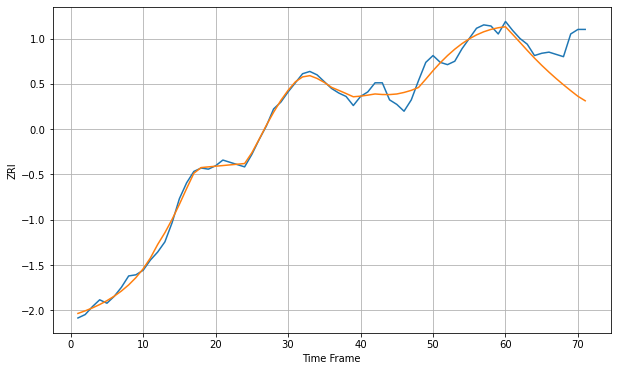

Wall time: 8.58 s
33756 5.62158749836897 30.923686420223902 [1138.32649813 1131.52613558 1124.57108107 1117.54972179 1110.74934246
 1104.37648941 1098.37533809 1092.6871509  1087.27217029 1082.09564665
 1077.105788   1073.17730284]

Got an mse at 0.0049 in round 73 and stopped training



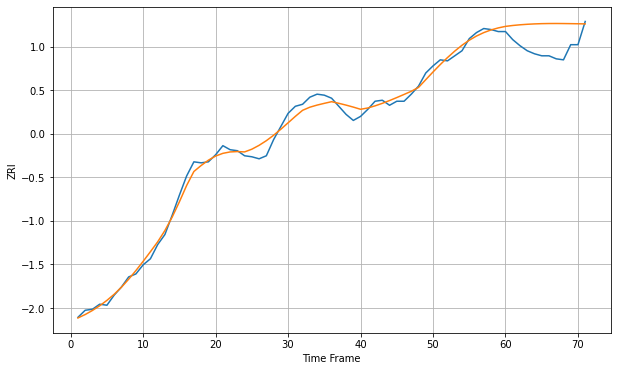

Wall time: 6.54 s
33771 5.977120923728032 25.220960184736178 [1178.12720732 1179.02110151 1179.69878909 1180.21055395 1180.58481745
 1180.83301148 1180.96252882 1180.98782269 1180.93444914 1180.83547024
 1180.72070352 1180.60262572]

Got an mse at 0.0050 in round 201 and stopped training



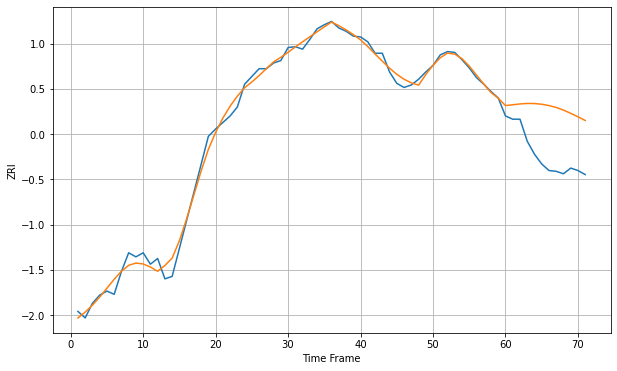

Wall time: 9.32 s
33907 7.812613396249539 60.646419261214845 [1232.72064608 1233.73388808 1234.7471013  1235.34815551 1235.24491417
 1234.35964398 1232.73125993 1230.44207095 1227.16295097 1223.22505165
 1218.96436257 1214.43565658]

Got an mse at 0.0049 in round 148 and stopped training



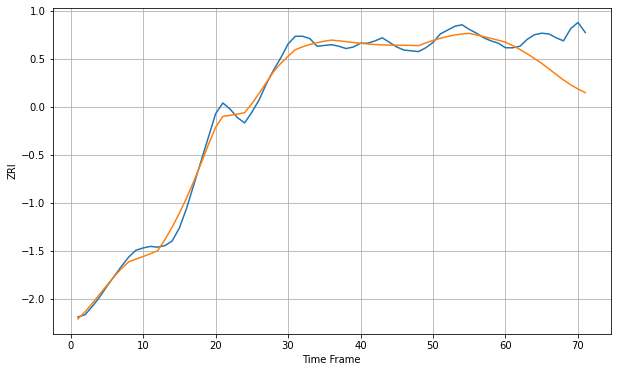

Wall time: 7.92 s
33916 8.7311791308867 49.10629999451477 [1151.26457486 1146.78686379 1141.74682079 1136.11604938 1129.99881517
 1123.65911099 1116.44759635 1109.20417675 1102.02642792 1095.72001389
 1090.28694834 1085.60194737]

Got an mse at 0.0050 in round 130 and stopped training



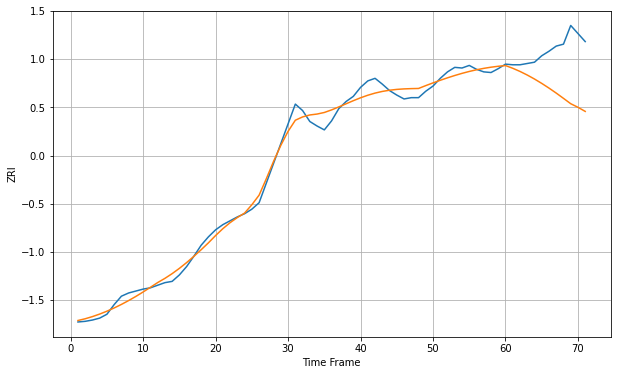

Wall time: 7.9 s
33973 10.51919695927889 69.63961728617005 [1107.80120078 1103.58625852 1098.68036307 1093.10739747 1086.90884564
 1080.13771472 1072.85066335 1065.10019647 1056.92924697 1048.60578958
 1043.04937782 1036.6783056 ]


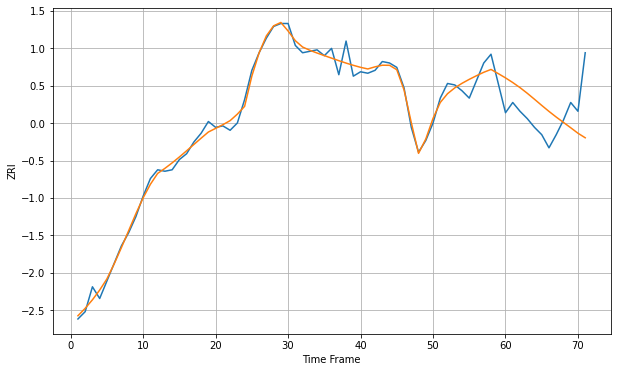

Wall time: 16.1 s
34203 4.8134326052180425 23.726826450633478 [1499.82848175 1496.64832821 1493.17748721 1489.32342083 1485.21226233
 1481.00699637 1476.91006779 1473.041663   1469.37931458 1465.73151083
 1461.98302561 1458.87581224]


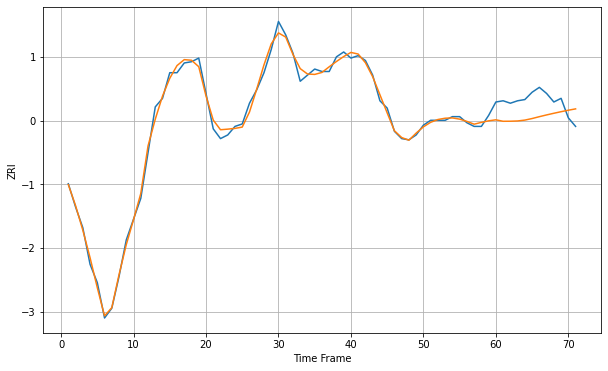

Wall time: 16.2 s
34207 4.068463044294011 15.998566432574606 [1177.40488187 1176.19890978 1176.24610369 1176.46164693 1177.17270656
 1178.44830833 1179.96951621 1181.40915255 1182.76440858 1184.0576152
 1185.2589937  1186.36031442]


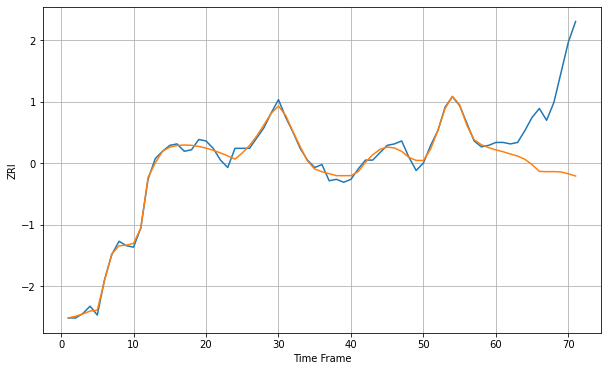

Wall time: 15.8 s
34208 3.0092814253548243 50.27361257088945 [1194.91411342 1193.69981526 1192.14408603 1190.73439273 1188.5831803
 1184.90398705 1180.36716731 1180.17605393 1180.22377578 1179.95479423
 1178.7527729  1177.22428837]

Got an mse at 0.0050 in round 496 and stopped training



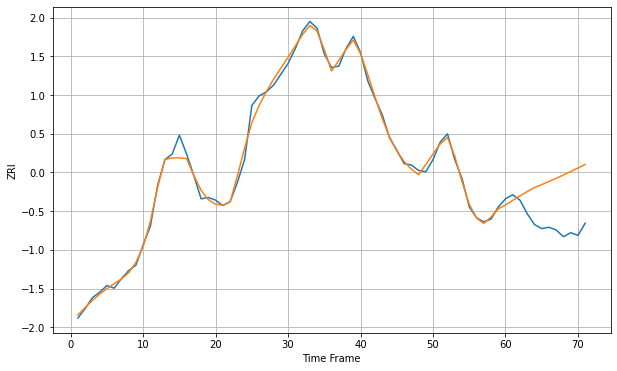

Wall time: 15.7 s
34210 4.031708323129685 33.163314415288816 [1281.38640898 1284.86272753 1288.18056613 1291.35649578 1294.33015052
 1296.50924382 1298.78727024 1301.16588119 1303.63623735 1306.17815994
 1308.76245842 1311.3540671 ]

Got an mse at 0.0050 in round 154 and stopped training



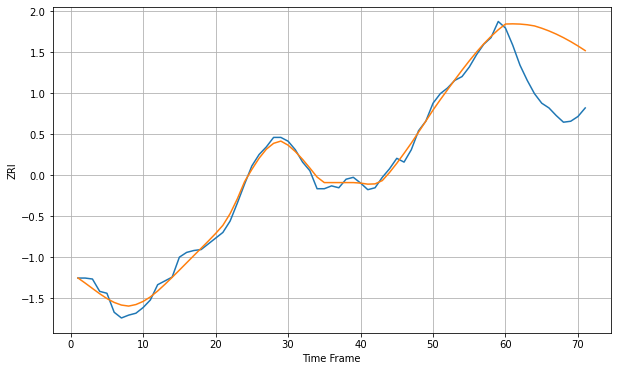

Wall time: 8.54 s
34232 6.053479433927834 67.78531641350915 [1518.30387239 1518.49964832 1518.24592879 1517.54610417 1516.30754659
 1513.898155   1511.03475749 1507.72158219 1503.96981693 1499.79990316
 1495.24289962 1490.34076915]

Got an mse at 0.0050 in round 71 and stopped training



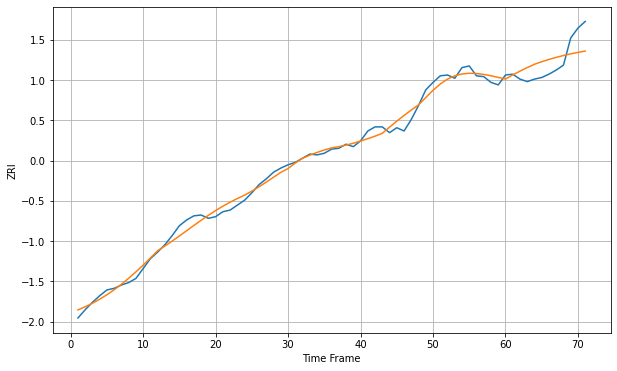

Wall time: 6.48 s
34683 6.86245213541175 19.003945085798282 [1126.04860614 1131.04524891 1135.70186073 1140.02769865 1144.03301235
 1147.13201415 1149.91658868 1152.42141608 1154.66725502 1156.67454423
 1158.46317896 1160.05235653]

Got an mse at 0.0050 in round 163 and stopped training



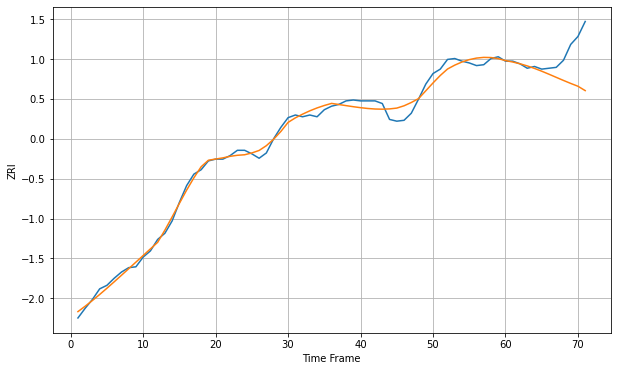

Wall time: 8.41 s
34698 6.371717330162365 31.61330212379647 [1248.6567131  1247.06346391 1245.0581431  1242.63426179 1239.80752492
 1236.63355669 1233.21392417 1229.6818801  1226.17157776 1222.78810963
 1219.57773271 1214.63737279]


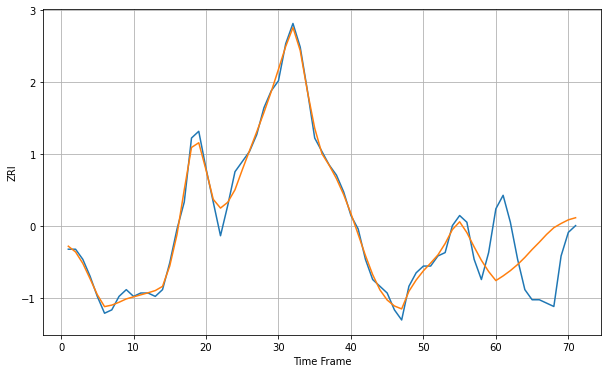

Wall time: 15.6 s
37040 2.3498218240159283 15.589556055511693 [731.69212091 733.07450392 734.64302547 736.45789902 738.57136907
 740.91411547 743.09282392 745.39561894 747.38946128 748.63635264
 749.72208545 750.34249213]


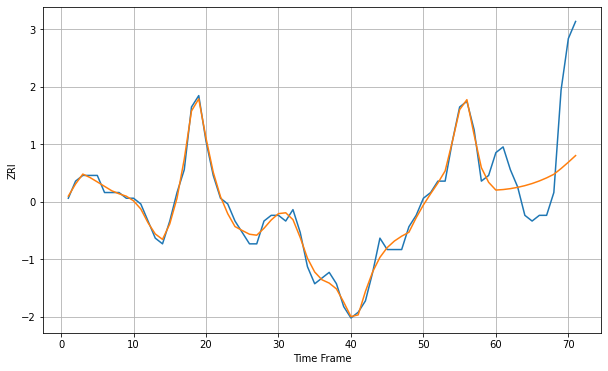

Wall time: 15.5 s
37042 1.1423391347616945 11.120417125249519 [715.43140026 715.52166713 715.68176028 715.90948365 716.20675996
 716.57850647 717.03108125 717.57017332 718.19806899 719.20853264
 720.31420645 721.47896309]

Got an mse at 0.0050 in round 477 and stopped training



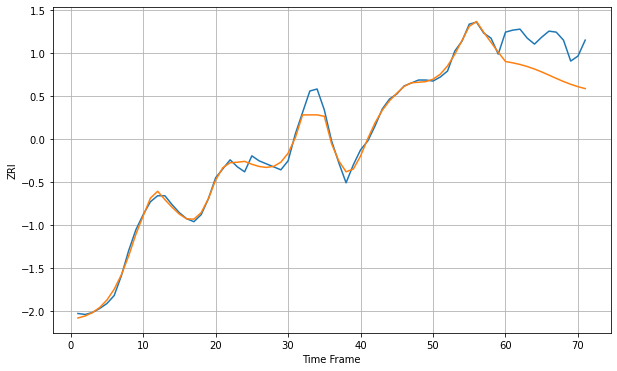

Wall time: 15.4 s
37075 6.066132068371628 35.93786265333129 [1113.56738674 1112.23415746 1110.59581199 1108.54199551 1106.02833547
 1103.10496459 1099.91404399 1096.65607795 1093.53863993 1090.73012908
 1088.33628681 1086.40171583]

Got an mse at 0.0050 in round 318 and stopped training



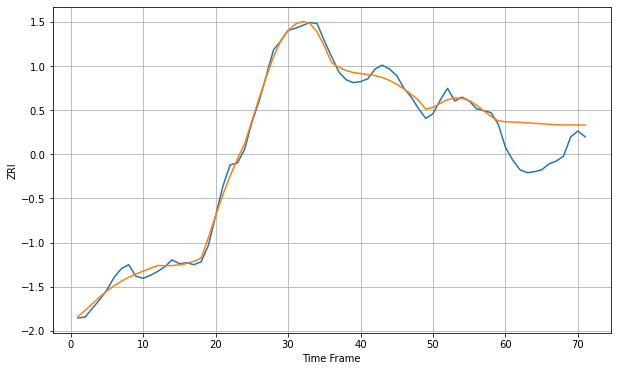

Wall time: 11.9 s
37076 6.4036981041814744 37.10341272277525 [1116.54102369 1116.34778491 1115.95003586 1115.45688646 1114.98255664
 1114.50099918 1113.99722174 1113.46304034 1113.29725503 1113.29903713
 1113.28737368 1113.27212286]

Got an mse at 0.0050 in round 82 and stopped training



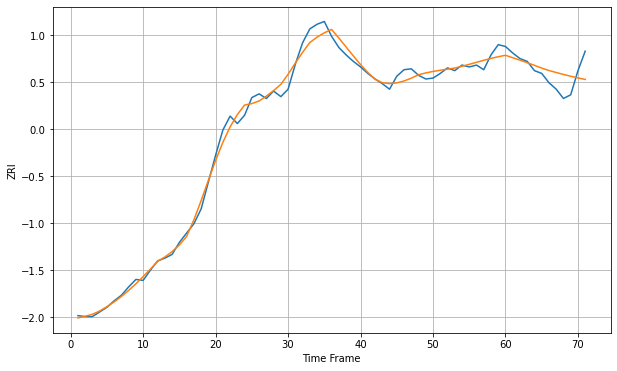

Wall time: 6.81 s
37115 7.130536906415073 15.11753713091989 [1150.55478049 1147.90678331 1145.2933707  1142.55782517 1139.70121797
 1136.71925978 1134.15030567 1131.99205038 1129.92173923 1127.94259114
 1126.16946866 1124.5120564 ]

Got an mse at 0.0050 in round 164 and stopped training



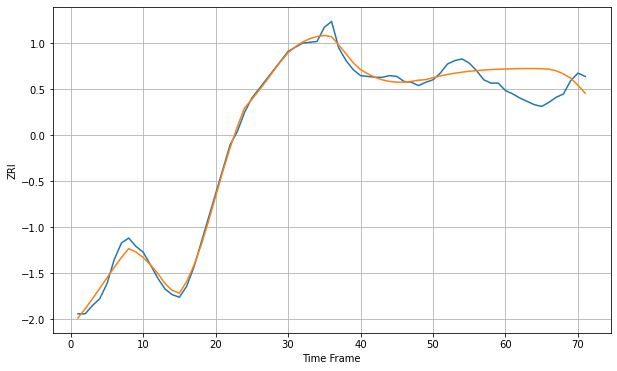

Wall time: 8.46 s
37211 7.762517650373457 31.770918102468887 [1220.92849287 1221.18625238 1221.37795908 1221.47278816 1221.43065302
 1221.20576916 1220.75356863 1218.74112842 1215.00897631 1209.86393119
 1201.50797342 1191.82038761]

Got an mse at 0.0049 in round 175 and stopped training



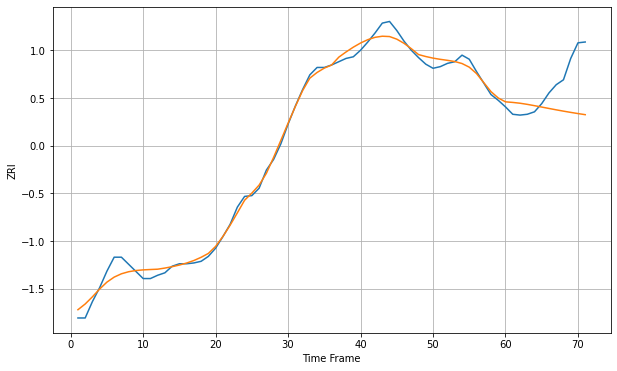

Wall time: 8.79 s
37214 8.10593049378907 43.77008880847881 [1151.14600108 1150.43752136 1149.45977085 1148.08597928 1146.47948521
 1144.78839579 1143.0829082  1141.41466843 1139.81537719 1138.2996887
 1136.86998271 1135.52118055]

Got an mse at 0.0049 in round 112 and stopped training



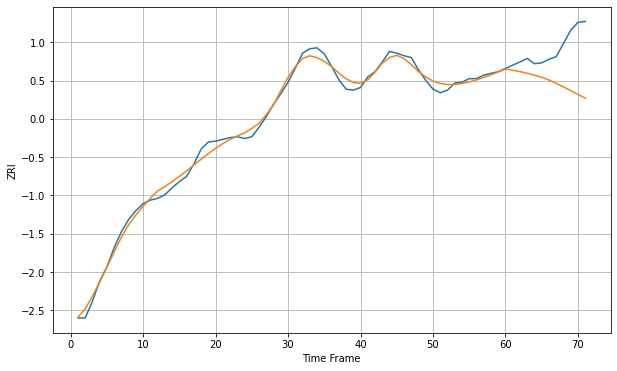

Wall time: 7.26 s
37221 6.055072890813147 44.54080700399462 [1346.85611963 1345.59125122 1343.99736288 1342.10367125 1339.94619686
 1337.5555428  1334.40382591 1330.67912299 1326.59400735 1322.37686718
 1318.1052824  1313.86423685]

Got an mse at 0.0050 in round 272 and stopped training



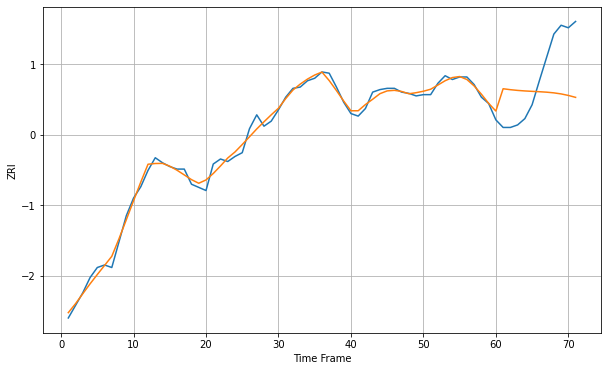

Wall time: 10.8 s
38104 3.925948470423798 36.156751568638576 [792.0132758  809.67881683 808.93379761 808.36034744 807.93597937
 807.61489642 807.3233704  806.96166774 806.41676979 805.58020746
 804.37968172 802.84540777]


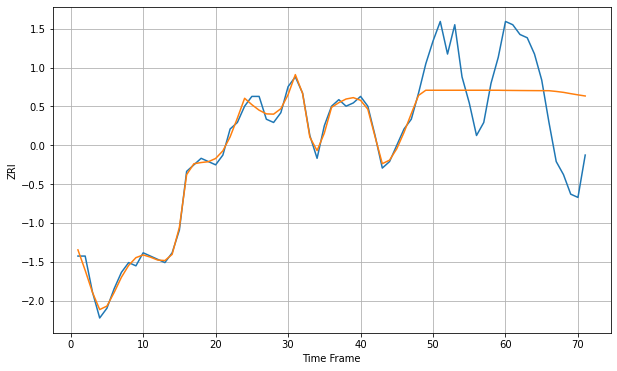

Wall time: 15.9 s
40391 5.572764543745001 20.442671644673123 [811.85257974 811.8299023  811.80948971 811.79177089 811.7767925
 811.76384963 811.75147678 811.52427513 811.24164111 810.84461139
 810.47345902 810.12841503]

Got an mse at 0.0050 in round 285 and stopped training



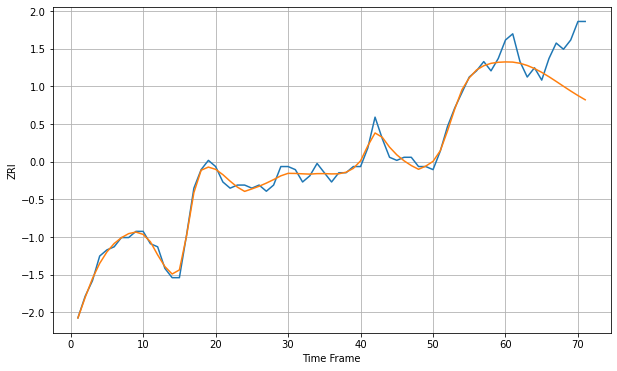

Wall time: 11.2 s
40502 1.714181566885912 12.850371451633206 [812.89475255 812.83890002 812.45310704 811.74602177 810.74918172
 809.5117449  808.0954529  806.56975042 805.00541918 803.46594379
 801.99838518 800.62730915]


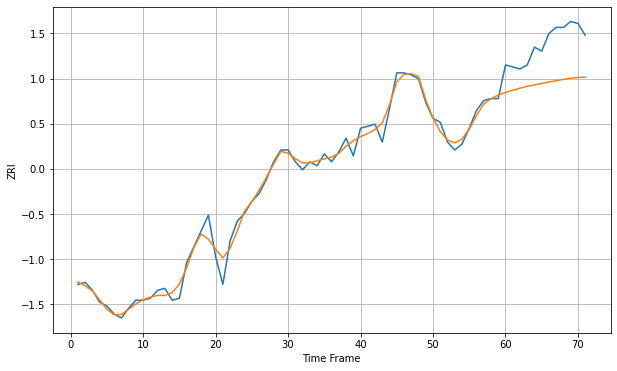

Wall time: 15.6 s
40515 3.735375284330181 20.86196708096449 [891.03755467 892.21480532 893.23576812 894.12924814 894.92701426
 895.65902654 896.35034431 897.01995814 897.68109459 898.34230195
 898.65662826 898.84904065]


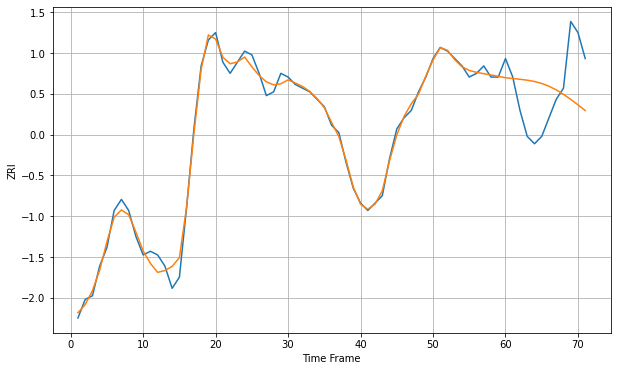

Wall time: 16 s
40517 1.8250590031734417 12.630694108972152 [875.81983946 875.60315004 875.40268266 875.15768956 874.80273634
 874.2752865  873.52829962 872.54457633 871.34398353 869.97603237
 868.50103985 866.97218999]

Got an mse at 0.0050 in round 144 and stopped training



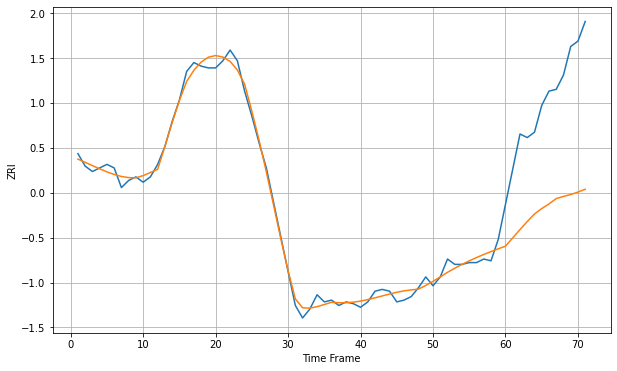

Wall time: 8.01 s
43055 3.54127605293897 63.06405734131108 [637.19210204 641.84958491 646.48214523 650.97599491 655.21961939
 658.25882569 660.83381347 663.84612858 665.04034574 666.11389834
 667.47826237 669.0572628 ]

Got an mse at 0.0050 in round 250 and stopped training



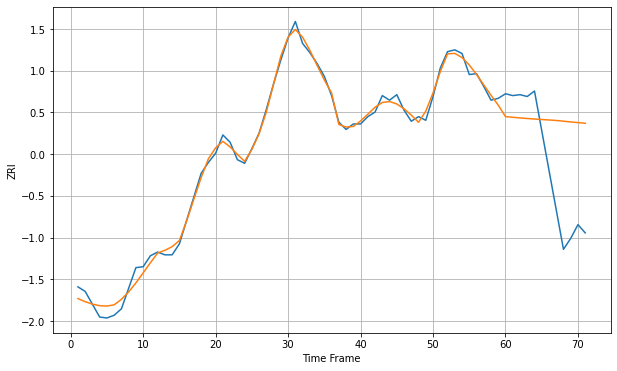

Wall time: 10.4 s
43201 6.411593504577765 80.92630456613091 [1086.02444021 1085.29827485 1084.6100581  1083.9662958  1083.37335303
 1082.83646732 1082.35871217 1081.8228118  1081.00303015 1080.22821047
 1079.49224808 1078.78559733]

Got an mse at 0.0050 in round 274 and stopped training



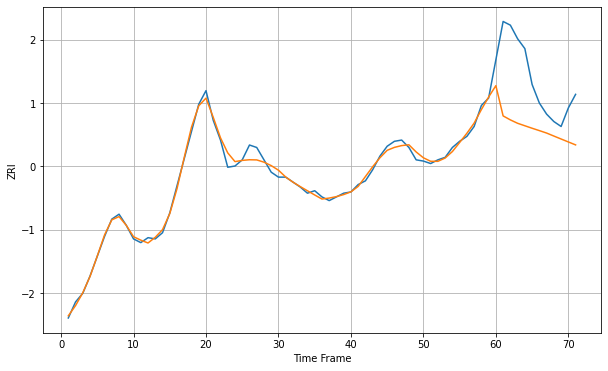

Wall time: 10.6 s
43202 3.606708184356464 46.00668179981668 [950.03605877 925.55586242 922.32865021 919.58448727 917.57411185
 915.57158907 913.6539133  911.68355222 909.25844491 906.86281608
 904.48150748 902.09759225]

Got an mse at 0.0050 in round 154 and stopped training



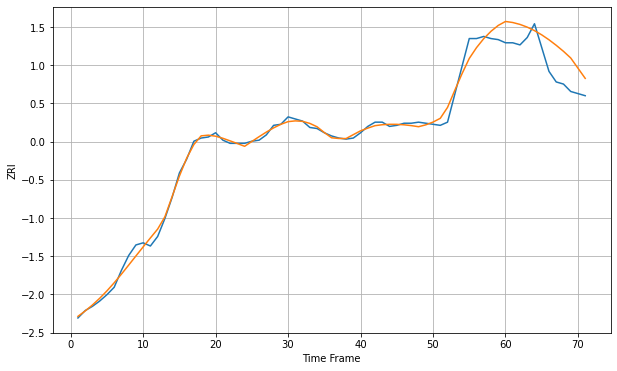

Wall time: 8.24 s
43204 5.075844702456691 22.952285944576985 [989.14742742 988.15552367 986.35855176 983.79199247 980.48939297
 976.48772606 971.83792206 966.6175551  960.93892074 954.64827329
 945.01037915 935.37378942]

Got an mse at 0.0050 in round 298 and stopped training



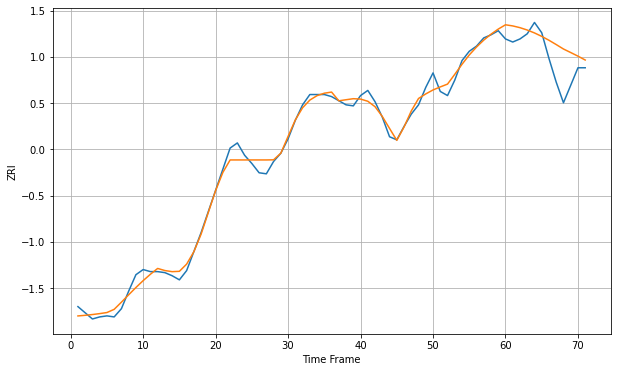

Wall time: 11.4 s
43205 6.325628985453517 22.823368711359162 [907.73891852 906.64637745 904.94081759 902.65713422 899.82653765
 896.48686999 892.69431539 888.53277558 884.21702367 880.7826535
 877.28732861 873.51654595]

Got an mse at 0.0050 in round 156 and stopped training



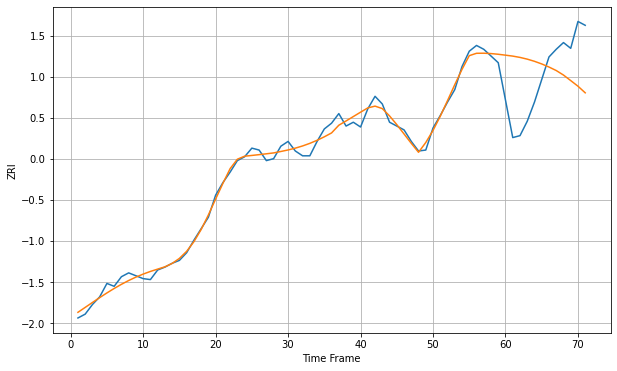

Wall time: 8.3 s
43206 6.018142907059543 53.765432487690674 [996.87367874 995.89779337 994.53775297 992.73905331 990.47131321
 987.72670928 984.51608378 980.86395274 976.15442932 970.38841052
 964.53405525 957.6410448 ]

Got an mse at 0.0050 in round 479 and stopped training



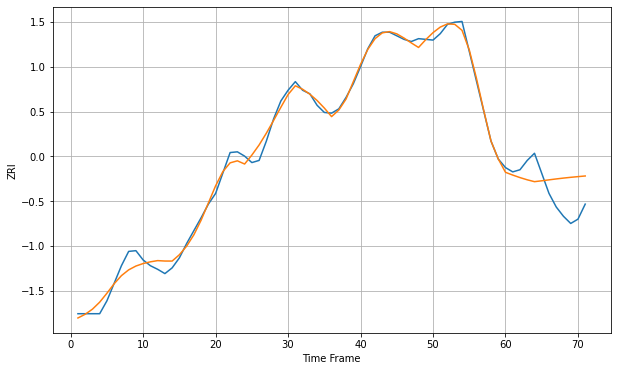

Wall time: 15.4 s
43212 8.81702896179007 37.137815612302084 [1073.41960905 1069.54406491 1066.0356881  1062.94590762 1060.34622237
 1061.56482905 1062.8742042  1064.15987709 1065.34654308 1066.41278441
 1067.37901351 1068.28787471]


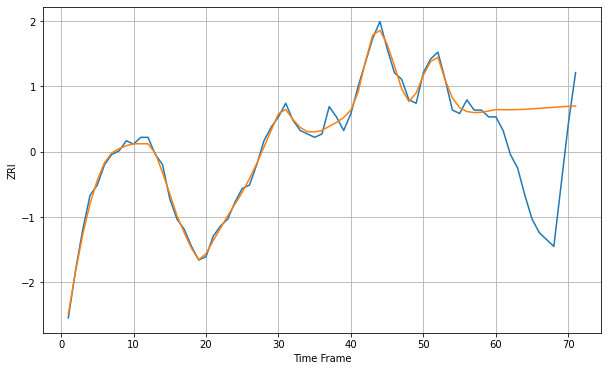

Wall time: 15.5 s
44035 1.7192965429821896 24.720901791981046 [674.14830664 674.10116239 674.09973568 674.14456101 674.23201076
 674.35463789 674.50188783 674.66106898 674.81900145 674.9645588
 675.09122386 675.19837036]


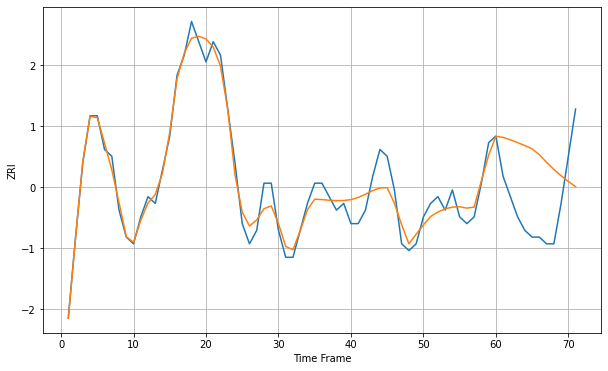

Wall time: 15.8 s
44052 1.9734462574043685 9.735272727817648 [618.95530557 618.80011296 618.43544239 618.02555632 617.57855316
 617.10645237 616.21469511 615.09573332 614.05591915 613.1055917
 612.25229766 611.4976353 ]

Got an mse at 0.0050 in round 443 and stopped training



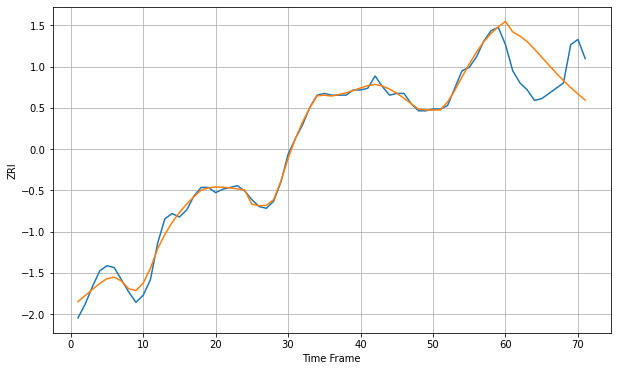

Wall time: 14.5 s
44102 3.3136393463129195 22.553677439413192 [867.33256856 861.3576481  858.9677113  855.72007335 851.41536155
 846.84725205 842.2042038  837.66877543 833.36905235 829.36114317
 825.64463953 822.18921156]


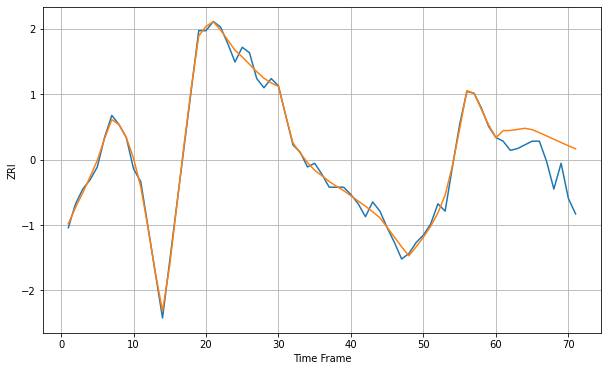

Wall time: 15.8 s
44103 3.0652792561321993 17.112444776340084 [862.91893615 866.68809403 866.82556627 867.4013814  867.98493977
 867.26843093 865.62293542 863.85312385 862.04242065 860.25792065
 858.53235214 856.86743188]

Got an mse at 0.0050 in round 249 and stopped training



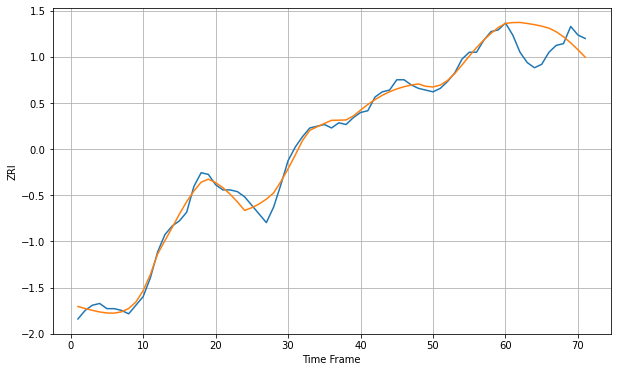

Wall time: 10.1 s
44107 3.7719961257396366 14.555400206359561 [877.75792711 878.24241083 878.30481853 877.72083558 877.03566738
 876.16551857 874.99545646 872.87976099 870.01037718 866.47456166
 862.43162919 858.14553059]

Got an mse at 0.0050 in round 341 and stopped training



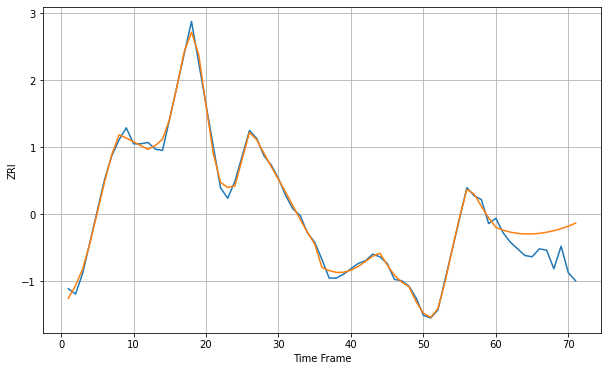

Wall time: 12.4 s
44108 3.5290540680852005 20.85482372014416 [785.16836322 783.02516168 781.53422592 780.61510666 780.19538624
 780.21858876 780.64605187 781.45532258 782.63602667 784.18296539
 786.08592351 788.31691439]


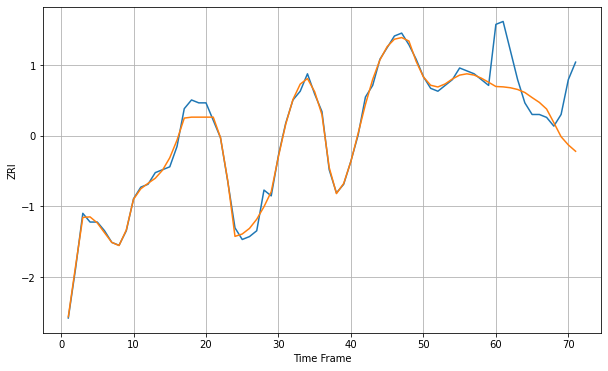

Wall time: 15.7 s
44109 1.9819654995324858 15.041476097218734 [716.62812055 716.50172989 716.19633838 715.60533666 714.56138646
 712.81427672 711.15620153 708.87336511 704.19243865 699.34735207
 696.52724577 694.34814817]

Got an mse at 0.0050 in round 461 and stopped training



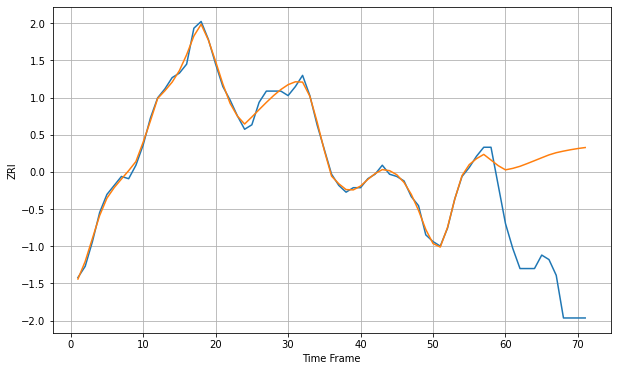

Wall time: 14.9 s
44110 2.327560746400086 56.279883892911094 [733.94055707 734.5980704  735.52190584 736.74384281 738.02795526
 739.32660819 740.59914439 741.57914449 742.28580964 742.90787483
 743.43786564 743.87367659]


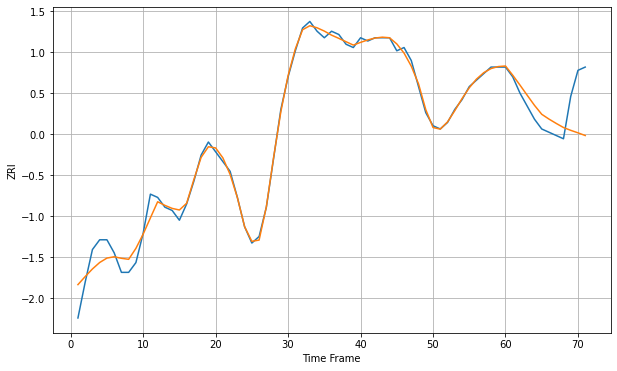

Wall time: 15.9 s
44111 2.5366068282676446 9.199393971531551 [761.33425461 758.50108173 755.46837434 752.33824971 749.25772653
 746.51397112 745.03996144 743.70954113 742.45130132 741.5867722
 740.82162144 739.99515654]


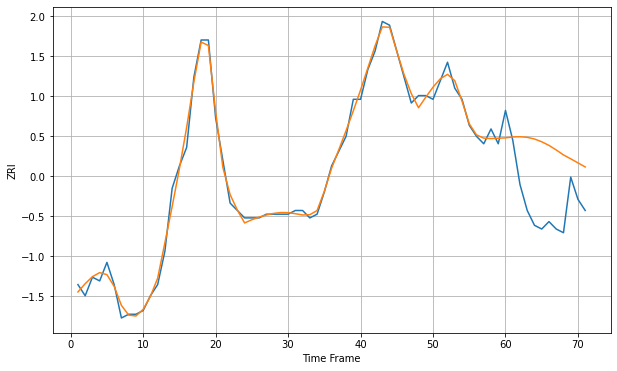

Wall time: 15.6 s
44112 1.870470936707421 16.54807161264902 [684.59100585 684.83965806 684.90511884 684.73789591 684.29205536
 683.53347644 682.56271161 681.33619798 679.99099802 678.94256907
 677.84130828 676.74879134]

Got an mse at 0.0050 in round 356 and stopped training



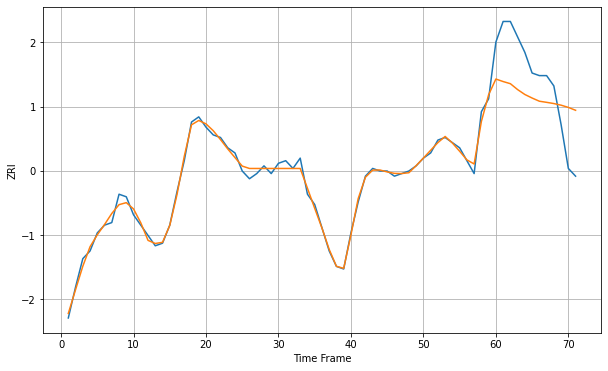

Wall time: 12.7 s
44118 1.754163298774201 17.39429969177783 [968.67264796 967.69922341 966.86555144 964.57994525 962.67670226
 961.3047928  960.06920611 959.63594691 959.16141168 958.52741489
 957.66999109 956.55215045]


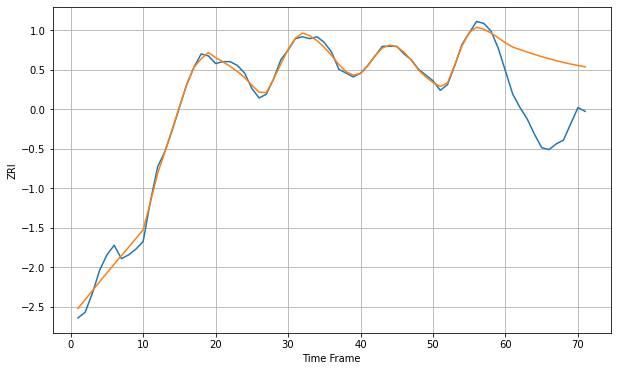

Wall time: 16 s
44120 3.0203782697392247 35.098363045913324 [855.81713085 853.58667283 852.31920955 851.03629192 849.78789099
 848.60693897 847.51006876 846.50207789 845.58128027 844.74373755
 843.98603786 843.30686175]


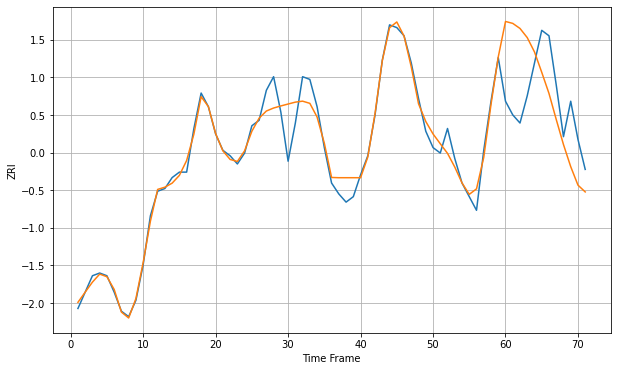

Wall time: 16.3 s
44133 4.726394104818517 21.27835172891131 [1041.24788645 1040.54442745 1038.68596358 1035.33142618 1030.07616682
 1022.61330113 1014.85692896 1005.32735598  996.1185013   988.00333501
  981.2358545   978.73953975]


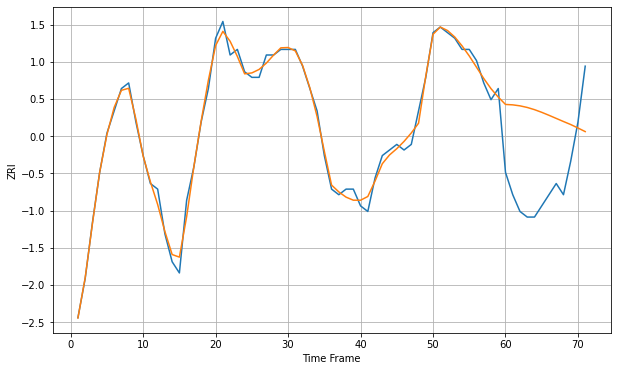

Wall time: 16 s
44646 1.2346449262778216 14.400058541286203 [646.15362568 646.07821512 645.90107516 645.61300582 645.22032706
 644.74278339 644.20998107 643.65343405 643.09747137 642.55622501
 641.93806156 641.29202995]

Got an mse at 0.0050 in round 315 and stopped training



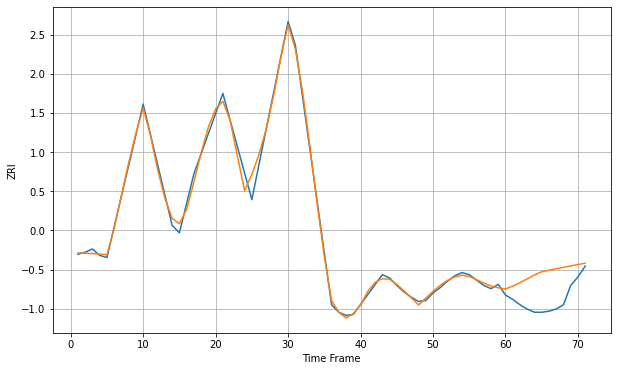

Wall time: 12.2 s
44720 5.143154214721068 26.767203056554074 [682.71544614 685.35420471 688.58590159 692.1620093  695.82738251
 698.73744378 700.19131187 701.58116488 702.90266306 704.18142431
 705.45601406 706.76500886]

Got an mse at 0.0050 in round 192 and stopped training



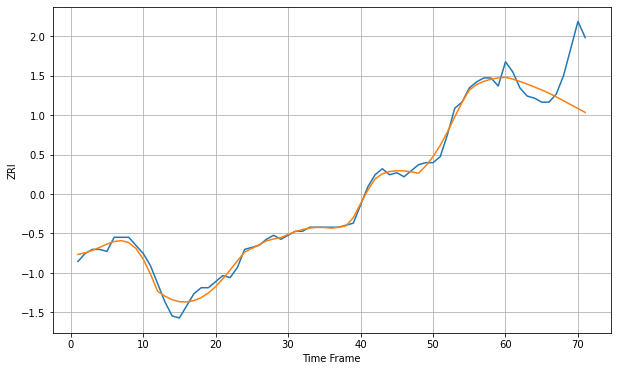

Wall time: 9.22 s
45205 2.745831397099144 19.071972634637497 [682.34838283 681.4391497  680.24854711 678.93749504 677.52768513
 676.03622083 674.43592114 672.60716718 670.71098827 668.77855377
 666.83474237 664.89876855]

Got an mse at 0.0050 in round 119 and stopped training



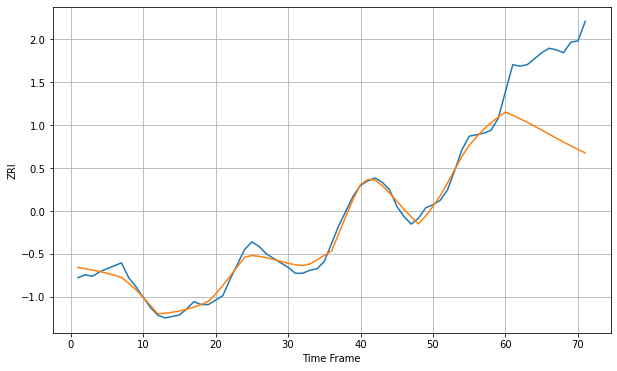

Wall time: 7.55 s
45211 4.049242119934117 55.652008385145194 [774.21207441 772.06096985 769.7539653  767.30576543 764.74294659
 762.10123491 759.42104225 756.74314431 754.10591027 751.54368224
 749.08513315 746.75144678]

Got an mse at 0.0050 in round 113 and stopped training



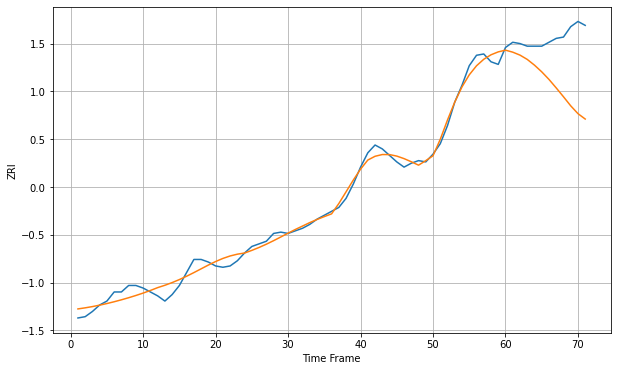

Wall time: 7.57 s
45212 5.181940322647435 39.93532854060854 [858.93023086 857.39640179 855.1230239  851.82654063 847.40513876
 842.27044412 836.43161686 829.89614305 823.10831873 816.13110252
 810.11990535 805.97092066]

Got an mse at 0.0050 in round 421 and stopped training



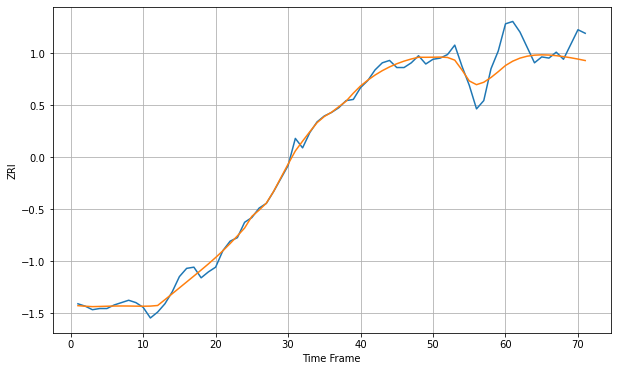

Wall time: 14.4 s
45219 6.173466186342325 18.828878706070142 [ 997.72524029 1001.39497613 1003.97349347 1005.60753409 1006.4762985
 1006.74884906 1006.56732654 1006.04367989 1005.26252275 1004.28629555
 1003.16071535 1001.91948683]


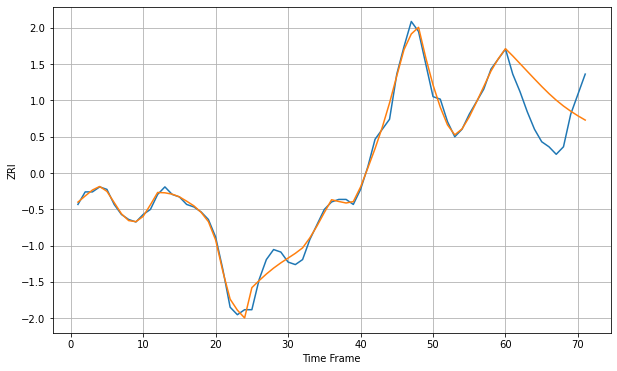

Wall time: 16.1 s
45405 2.642263309114631 15.603045496702306 [624.13515541 621.25574794 618.18953014 615.11959748 612.06501517
 609.06597354 606.2157607  603.6035935  601.26896437 599.19822571
 597.34614817 595.65853554]


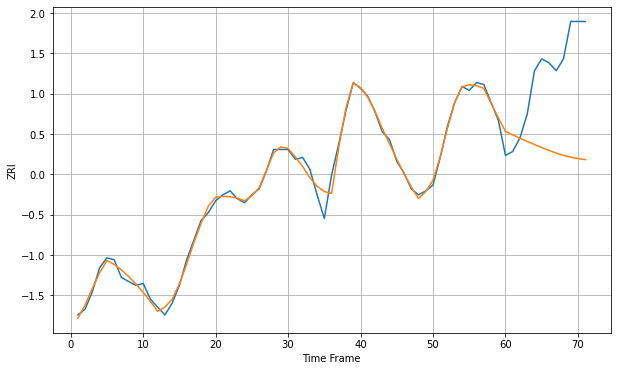

Wall time: 15.6 s
45840 2.923611279226018 45.14874949781499 [802.13782373 800.46748283 798.73890649 797.05486411 795.53525329
 794.00559798 792.53696214 791.21028836 790.07869463 789.15355199
 788.41857894 787.84867724]

Got an mse at 0.0050 in round 439 and stopped training



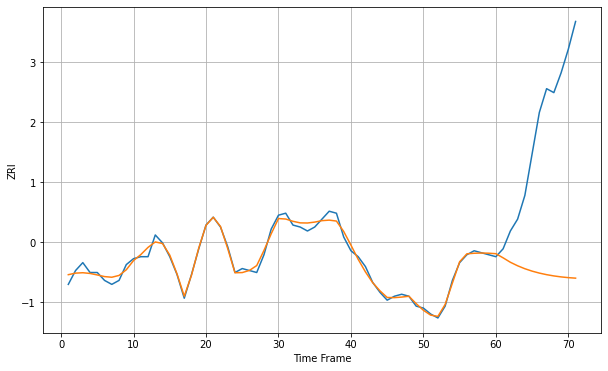

Wall time: 14.7 s
46143 2.131734252880855 76.73622486004083 [878.52055292 876.41820311 874.18316897 872.40486705 870.91559105
 869.69679256 868.70775442 867.90978499 867.27344687 866.77747269
 866.40567549 866.14431907]

Got an mse at 0.0050 in round 447 and stopped training



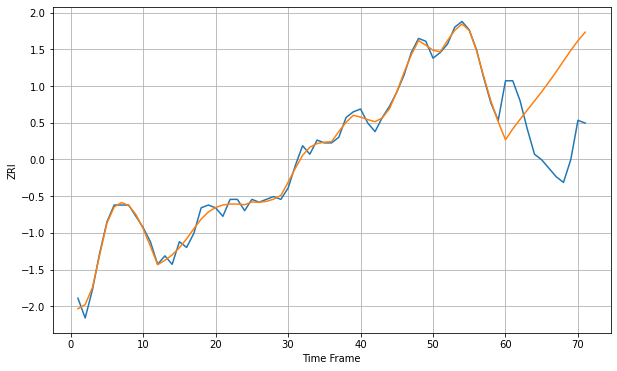

Wall time: 14.5 s
46201 1.8296132013191555 27.769098605606665 [657.1113158  660.92856647 664.32893    667.60417553 670.83859739
 674.13315119 677.5784033  681.21339109 684.98368765 688.72488002
 692.20447618 695.21337599]


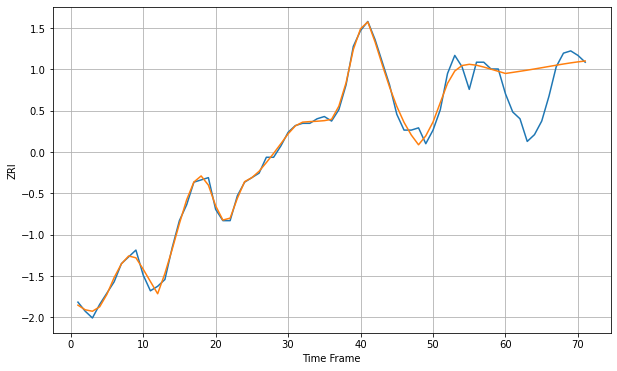

Wall time: 15.9 s
46203 2.721643772286186 16.953258913276645 [775.02920068 775.5014247  775.98562165 776.48971739 777.01642118
 777.56249808 778.1190734  778.67260922 779.20665844 779.70435697
 780.1512048  780.53740856]

Got an mse at 0.0050 in round 470 and stopped training



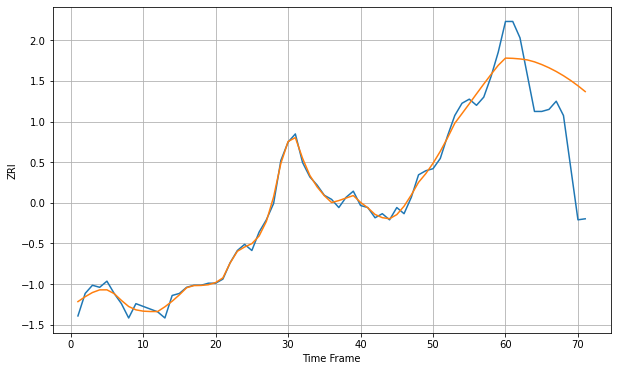

Wall time: 15.3 s
46208 2.7962033118534757 32.800845835851554 [856.08261715 855.96624552 855.67567321 855.21043604 854.25151087
 852.93195311 851.36011909 849.53876984 847.46671165 845.14050983
 842.55723384 839.71798332]

Got an mse at 0.0049 in round 250 and stopped training



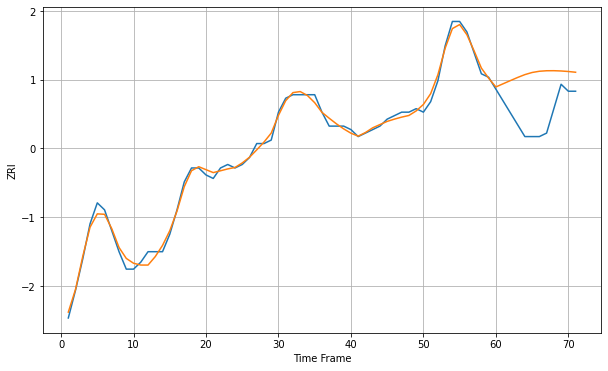

Wall time: 10.6 s
46219 1.3767131034312803 12.286222151866026 [660.22978276 661.14005484 662.04714785 662.94547795 663.76136355
 664.3716582  664.72505892 664.87212937 664.88477518 664.80671191
 664.6558113  664.44447291]

Got an mse at 0.0050 in round 436 and stopped training



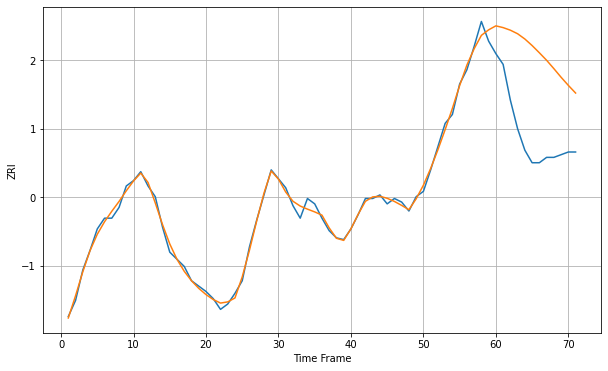

Wall time: 14.4 s
46312 2.688700643516697 47.1900767887834 [921.54537691 920.56854925 919.12013746 917.12785939 914.18774242
 910.53827741 906.49361374 902.29652886 897.62911513 892.79586996
 888.25524578 883.97678207]

Got an mse at 0.0050 in round 315 and stopped training



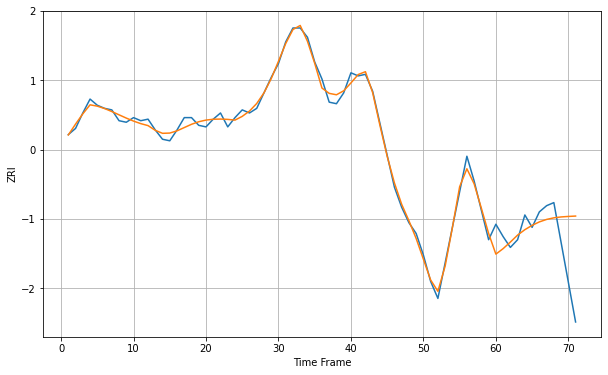

Wall time: 11.6 s
47374 3.1555528246510622 25.076476712972283 [651.65180775 655.21041896 659.46200755 663.98145229 667.4725956
 670.28209179 672.51181368 674.11555056 675.14064645 675.72394372
 676.0474419  676.28994352]

Got an mse at 0.0049 in round 257 and stopped training



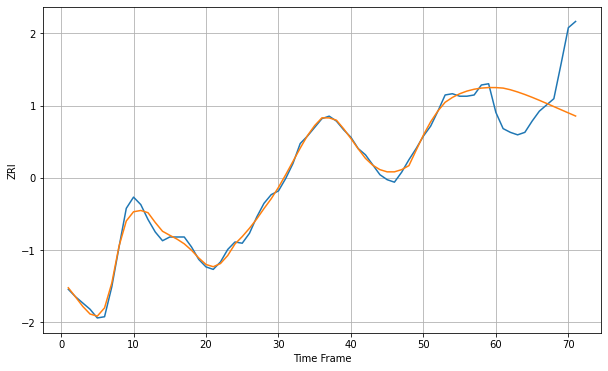

Wall time: 10.5 s
47401 4.043730055022305 37.64952538964611 [1333.92585656 1333.52492315 1332.19551584 1330.40807643 1328.3717039
 1326.12264474 1323.71599008 1321.21535181 1318.67630375 1316.13515975
 1313.6094773  1311.10631744]

Got an mse at 0.0050 in round 294 and stopped training



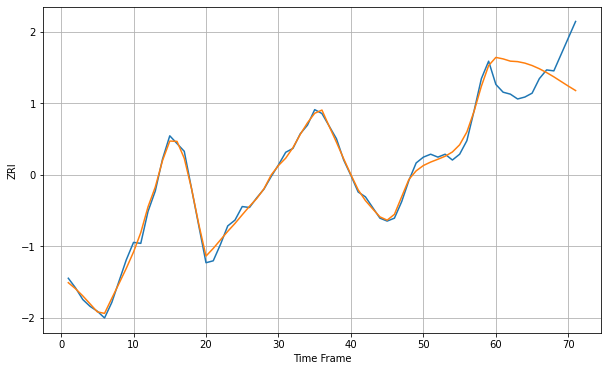

Wall time: 11.2 s
47408 5.149551628479257 35.507966586903116 [1421.91372224 1420.3734299  1418.04765771 1417.55475731 1416.01972719
 1413.51994103 1410.20498709 1406.26339519 1401.85277151 1397.05082505
 1392.28527193 1387.71557441]

Got an mse at 0.0050 in round 375 and stopped training



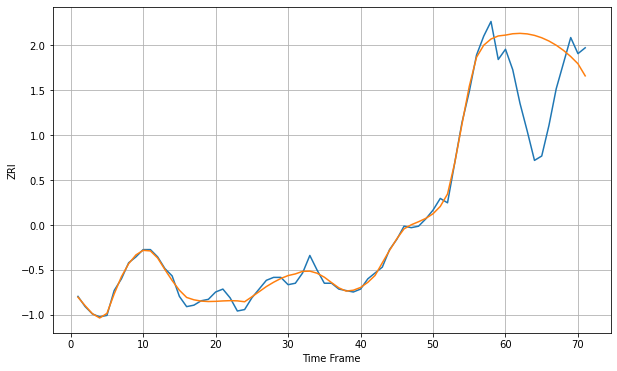

Wall time: 13 s
48186 4.327161551593105 46.65694873585641 [1006.68047348 1007.59466759 1007.86793725 1007.49479939 1006.48616371
 1004.85642487 1002.61291589  999.74776959  996.23305346  992.02403184
  987.08163734  978.80067276]


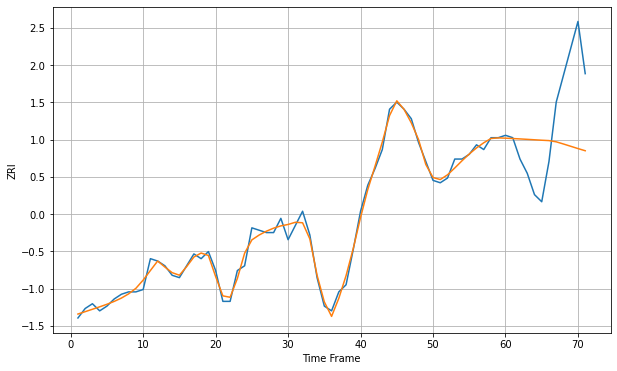

Wall time: 15.6 s
48195 2.391124468121949 26.322687694524976 [858.80125362 858.64506352 858.48657839 858.3091825  858.11973327
 857.93688968 857.77842977 857.26228251 856.3413646  855.38193821
 854.42119275 853.50136941]

Got an mse at 0.0050 in round 184 and stopped training



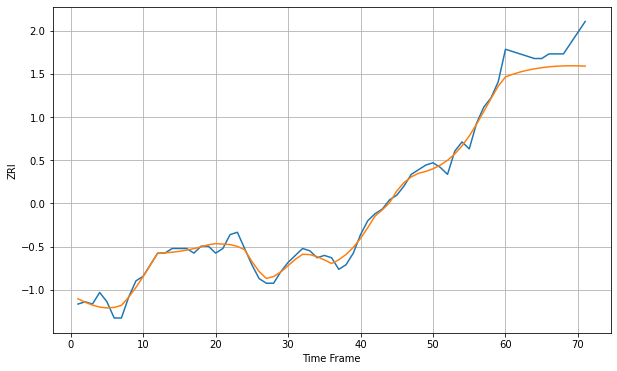

Wall time: 8.9 s
48235 2.6193481552954525 9.732602118484909 [746.07032566 747.19294591 748.15877891 748.94783758 749.56296034
 750.048913   750.41431505 750.66745464 750.81632007 750.86863678
 750.8318901  750.71333204]

Got an mse at 0.0050 in round 294 and stopped training



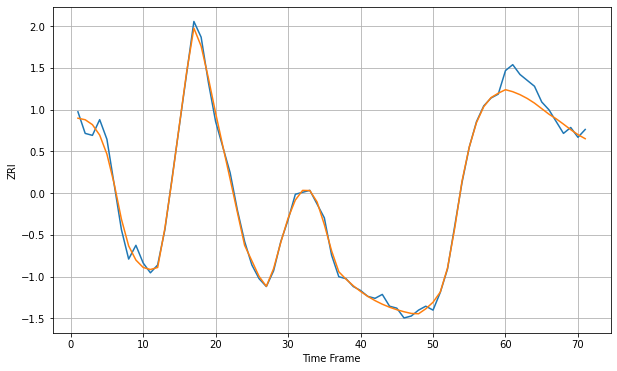

Wall time: 11.2 s
52001 2.986199912369018 7.156161400156124 [762.25448526 761.23368172 759.72772903 757.78642977 755.42005939
 752.59678262 749.77009122 747.42005749 744.7143162  741.91064646
 739.36709449 737.29202733]

Got an mse at 0.0050 in round 493 and stopped training



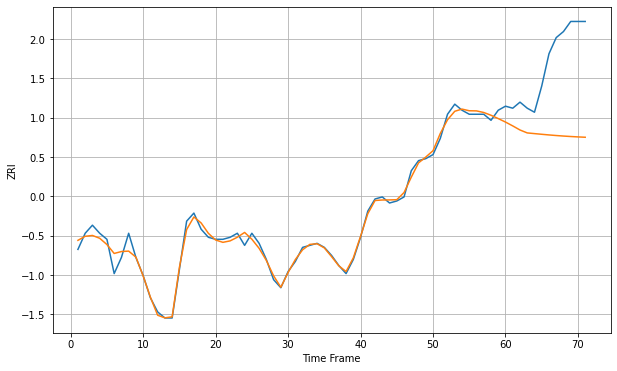

Wall time: 15.6 s
53140 2.7464551970875606 38.35250030437364 [846.12811705 844.21773247 842.19587188 840.74622484 840.40342813
 840.06587223 839.74559923 839.45172525 839.19011794 838.96290522
 838.76715915 838.59273626]

Got an mse at 0.0049 in round 486 and stopped training



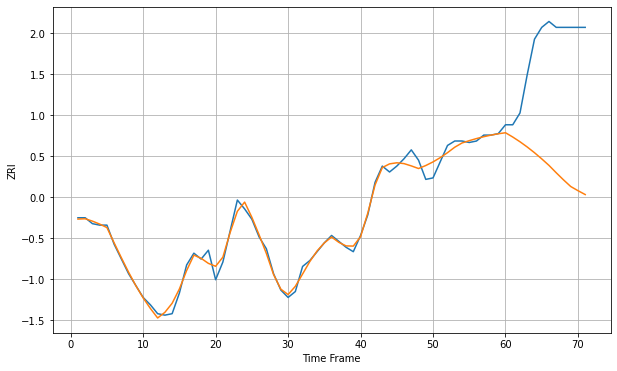

Wall time: 15.5 s
53143 3.8934696799441726 83.33301540032348 [866.59814404 863.70059532 860.4844525  856.94249028 853.07397095
 848.90007531 844.47788011 839.48479949 834.69387445 830.17152217
 827.35029665 824.71968721]

Got an mse at 0.0049 in round 499 and stopped training



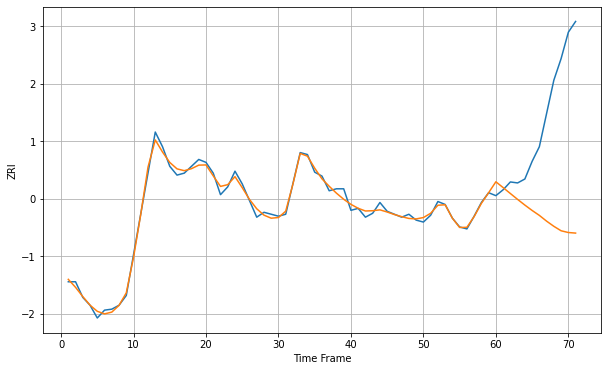

Wall time: 15.4 s
53202 4.1051209181911155 116.47057292638355 [1135.16785399 1129.23437059 1123.17715618 1117.16666146 1111.35982956
 1105.8830292  1100.82823197 1094.93971955 1089.66338303 1085.10895069
 1083.32561357 1082.74453021]


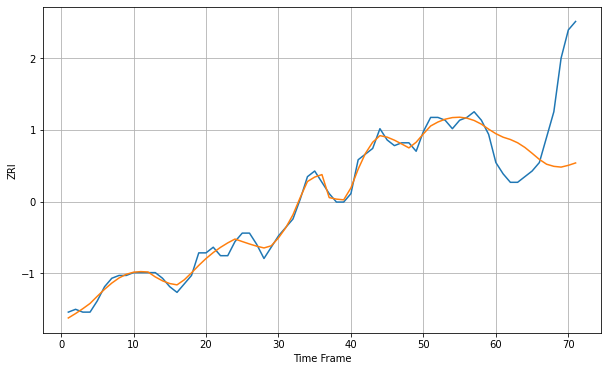

Wall time: 15.8 s
53204 2.042148288870891 25.20038717114992 [708.229766   706.98953479 706.17168925 705.01629621 703.36651243
 701.29112315 699.12284968 697.4131144  696.66008294 696.39002372
 697.01951086 697.86419098]

Got an mse at 0.0050 in round 443 and stopped training



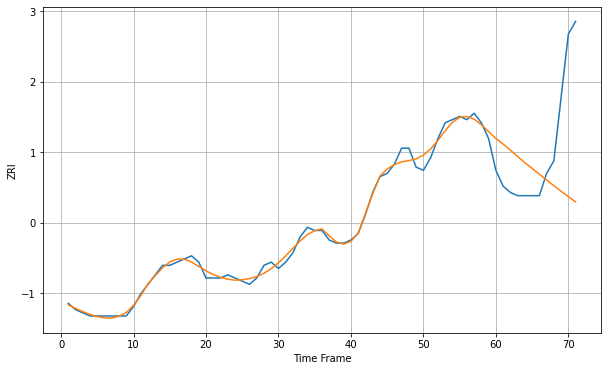

Wall time: 14.4 s
53206 1.563881364069689 25.256384294571347 [712.05131522 710.26852655 708.36063809 706.36881977 704.38339321
 702.60349078 700.78346382 698.93986054 697.13734494 695.38635426
 693.69205222 692.05570304]

Got an mse at 0.0050 in round 161 and stopped training



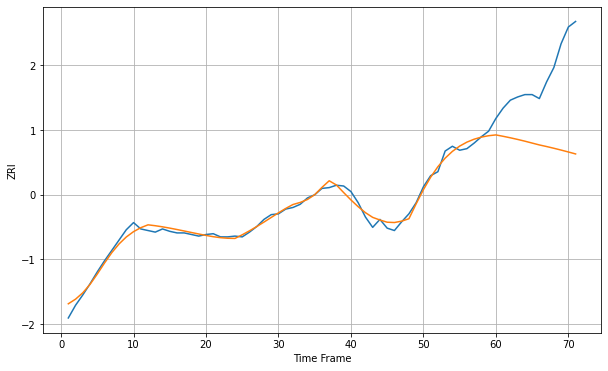

Wall time: 8.33 s
53207 5.684169994030312 93.3742426224981 [958.2829839  956.54119319 954.65478276 952.61146255 950.40484113
 948.03567757 945.68279862 943.66176653 941.49871107 939.21190535
 936.82148827 934.34806622]

Got an mse at 0.0050 in round 130 and stopped training



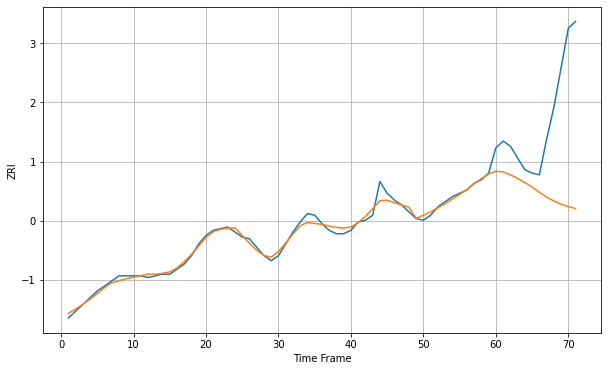

Wall time: 7.4 s
53208 2.461262339347421 54.412660505681046 [747.09182519 746.72765876 745.05967702 742.88047682 740.39069017
 737.7707441  734.58217572 731.77524669 729.45377594 727.60487561
 726.14398492 724.97166498]

Got an mse at 0.0050 in round 418 and stopped training



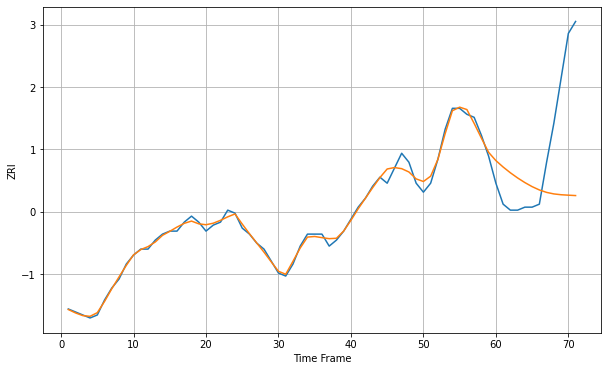

Wall time: 14 s
53209 1.4609563532323322 27.508927720735613 [706.55050661 704.40257852 702.4784304  700.75313494 699.20886111
 697.85670089 696.7454931  695.93128775 695.42077689 695.14749424
 695.00078093 694.87077357]

Got an mse at 0.0049 in round 215 and stopped training



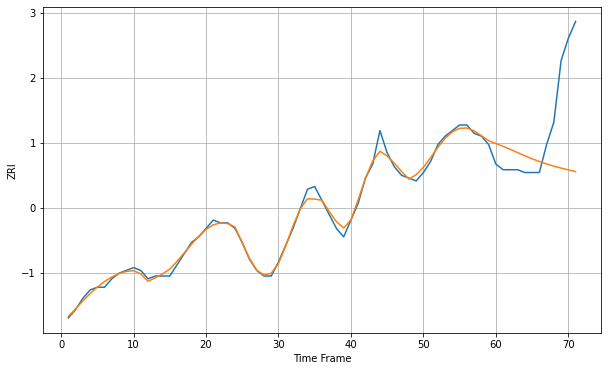

Wall time: 9.6 s
53210 1.619150154165216 24.4193939497557 [753.37256011 752.36752793 751.26509305 750.11460458 748.97899474
 747.91247618 746.94238776 746.06860183 745.27570095 744.57218714
 743.93858433 743.34418253]


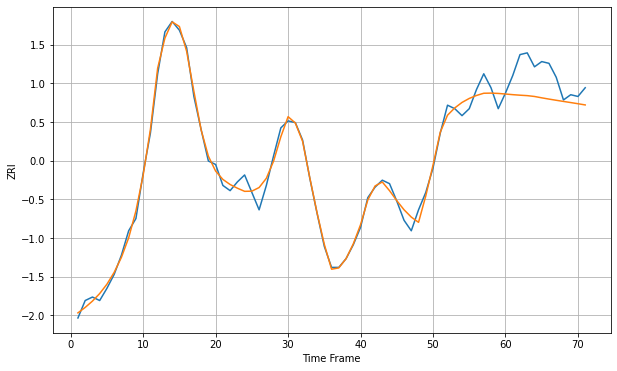

Wall time: 15.7 s
53211 4.184924408897676 15.039466976385425 [1181.40453947 1181.03287459 1180.7307994  1180.47731883 1179.9959347
 1179.21901551 1178.4952851  1177.81232387 1177.15415119 1176.50284316
 1175.83919855 1175.14206081]

Got an mse at 0.0050 in round 329 and stopped training



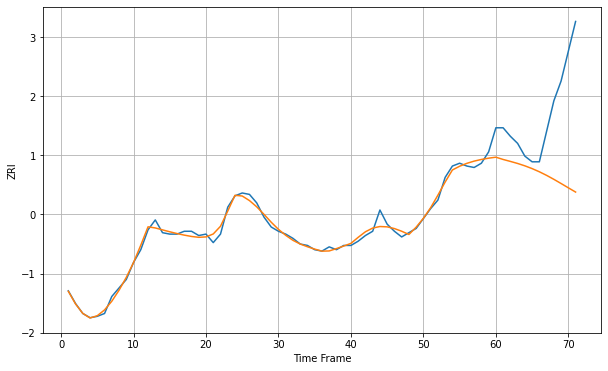

Wall time: 11.8 s
53212 2.9343048669054204 53.686742948062275 [845.26105664 843.65410737 842.27937284 840.83155416 839.1564045
 837.21074378 834.96728848 832.42963652 829.6418357  826.68361464
 823.65417328 820.66012431]

Got an mse at 0.0050 in round 272 and stopped training



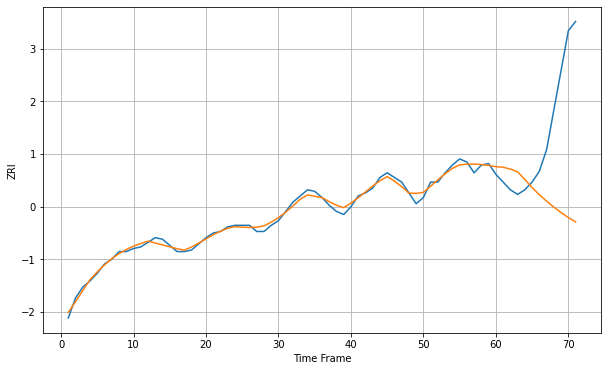

Wall time: 10.9 s
53215 2.38716390154976 61.790435719907 [757.9785921  757.58918278 756.42238192 754.63714751 749.66584283
 744.44698041 739.81236134 735.65117111 731.79891457 728.23592073
 725.03937676 722.23126753]

Got an mse at 0.0050 in round 231 and stopped training



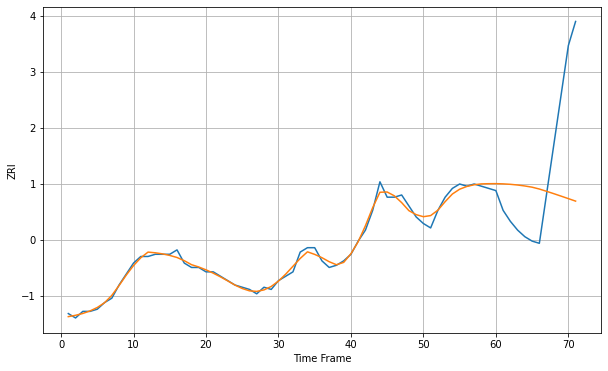

Wall time: 9.96 s
53216 1.7849262469722629 37.385771776529886 [727.16271463 727.05830938 726.85395683 726.53691412 726.10063172
 725.54532416 724.70883748 723.66837613 722.58677405 721.47482215
 720.34362105 719.20488899]

Got an mse at 0.0050 in round 403 and stopped training



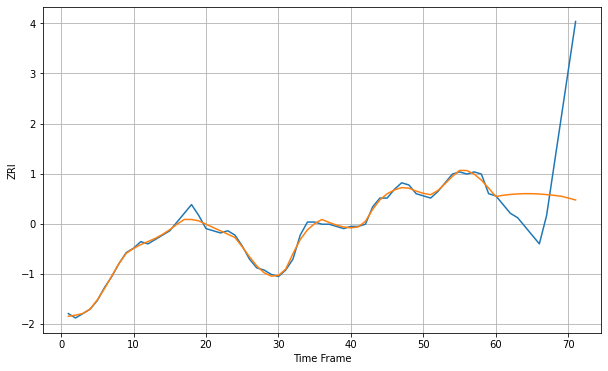

Wall time: 13.8 s
53218 1.6192579601191335 32.92324562591949 [724.70718516 725.27345343 725.65943902 725.90358608 726.01862375
 726.00044462 725.85305749 725.59112461 725.24251275 724.84658668
 724.02157513 723.1168964 ]


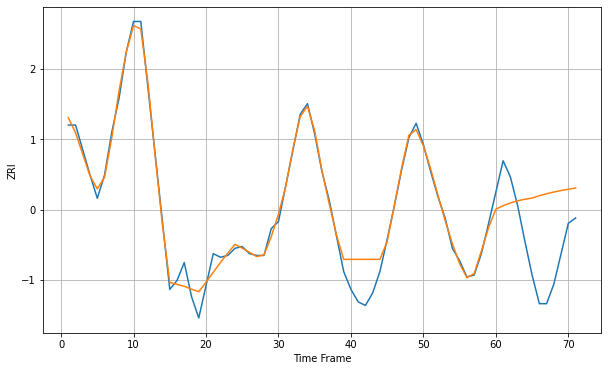

Wall time: 15.8 s
53403 6.8116410318356015 35.76205746137672 [842.90757783 844.8713869  846.41203135 847.59079162 848.46860617
 849.14193584 850.44384769 851.5568417  852.51780883 853.35603518
 854.09484629 854.75295987]

Got an mse at 0.0050 in round 73 and stopped training



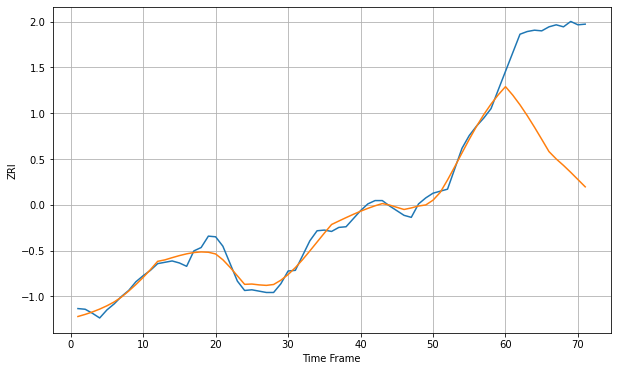

Wall time: 6.43 s
53590 9.537987729840463 172.7662994557699 [1121.82004597 1109.20769573 1094.72025542 1078.63893307 1061.3622021
 1043.35149001 1025.05656934 1014.03714469 1004.45793858  994.12196223
  983.30361882  972.48962241]


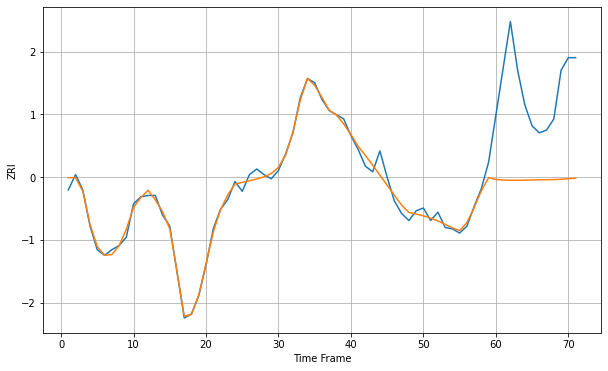

Wall time: 18.6 s
53703 4.284407625821267 69.38571250730126 [1283.49413054 1283.10332466 1282.93703644 1282.92640158 1283.00534691
 1283.11901916 1283.23193423 1283.32719863 1283.39932241 1283.6428353
 1284.04978994 1284.39984663]

Got an mse at 0.0050 in round 207 and stopped training



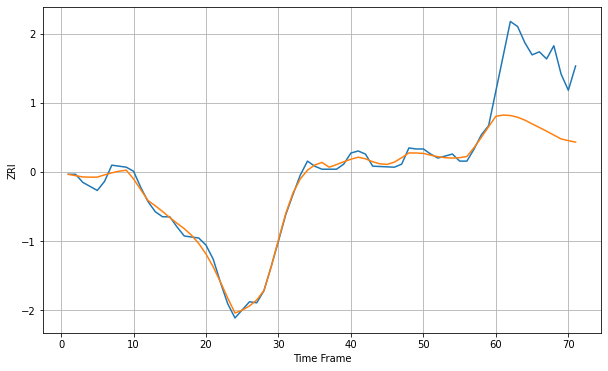

Wall time: 9.83 s
53704 4.790716767171289 71.8212002396378 [1107.35098192 1108.4805092  1108.0950305  1106.35878897 1103.50524096
 1099.81293687 1096.20327074 1092.57284077 1088.75420633 1084.95017209
 1083.21324845 1081.78659653]

Got an mse at 0.0050 in round 419 and stopped training



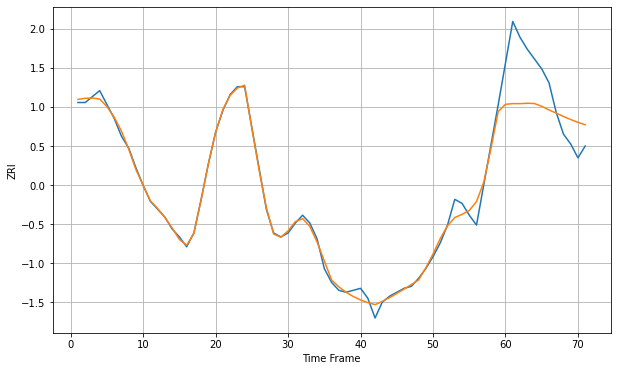

Wall time: 14.2 s
54220 2.7744421767871414 21.92554208564053 [668.10038563 668.43442542 668.40821387 668.62940871 668.47521508
 667.07516717 665.23842262 663.63014443 661.94970187 660.3725732
 658.97283936 657.74573363]


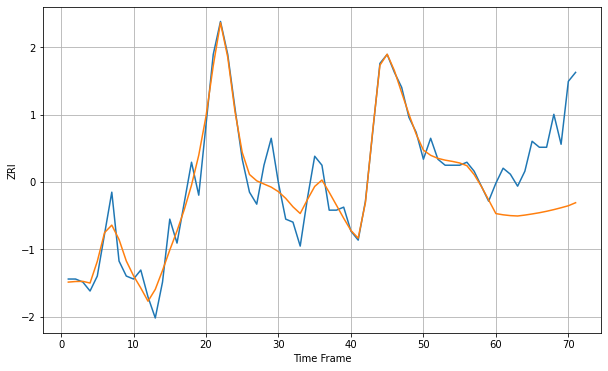

Wall time: 15.7 s
54601 5.220052036672545 24.922622636123346 [822.85157558 822.44618179 822.17566483 822.05065674 822.35348963
 822.72815949 823.13828765 823.62517786 824.18394403 824.80444457
 825.47057411 826.4802829 ]

Got an mse at 0.0050 in round 303 and stopped training



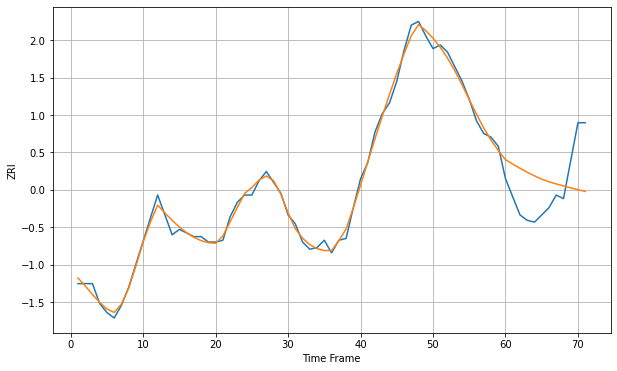

Wall time: 11.5 s
54901 2.915275675861797 22.717084950430316 [721.55425814 719.12020532 716.77673124 714.59322759 712.59526817
 710.77161213 709.33739285 708.14093088 707.02858172 705.97222776
 704.95657073 703.99130712]

Got an mse at 0.0049 in round 180 and stopped training



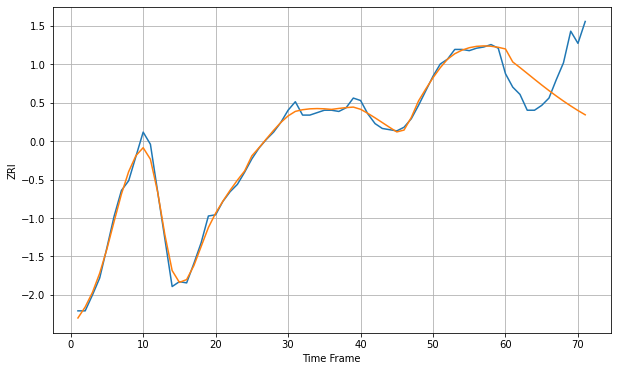

Wall time: 8.69 s
55101 4.415891308210243 37.75566785964045 [1336.3912183  1325.69947528 1321.07801625 1316.29160827 1311.47421703
 1306.7368757  1302.1503616  1297.74654488 1293.53558396 1289.52801042
 1285.74904748 1282.23690615]

Got an mse at 0.0050 in round 437 and stopped training



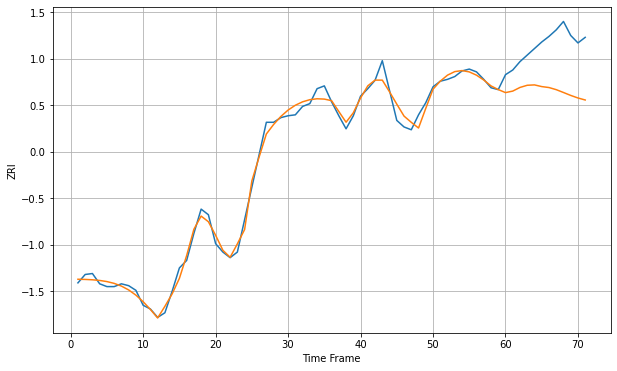

Wall time: 14.2 s
55104 6.999714778342386 51.218004272297236 [1298.7953623  1300.42400929 1304.33187125 1306.6599844  1307.05053286
 1305.25348313 1304.22413595 1301.96331474 1298.92100488 1295.78706122
 1293.04484642 1290.88365494]

Got an mse at 0.0049 in round 35 and stopped training



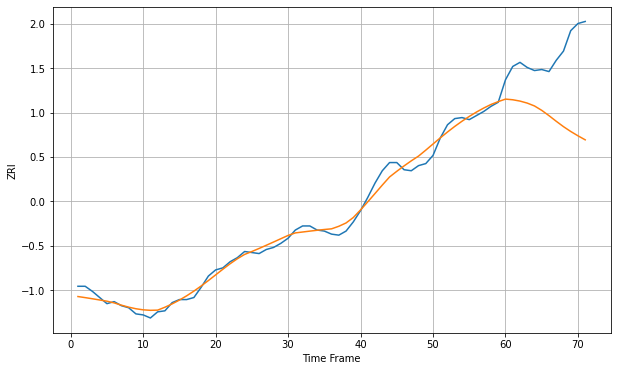

Wall time: 5.33 s
55106 5.996003878390277 66.40477624077509 [1094.06726092 1093.42197734 1092.12857917 1090.16031618 1087.36449775
 1083.06187192 1077.8955161  1072.38850612 1067.12989145 1062.41067136
 1058.17731066 1054.22678696]

Got an mse at 0.0050 in round 313 and stopped training



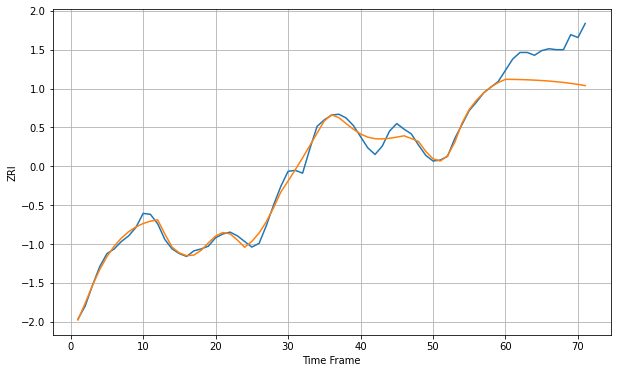

Wall time: 12.3 s
55306 5.851761886330059 37.87387571914412 [1302.31133965 1302.21194516 1302.03847422 1301.78367569 1301.43884637
 1300.99381534 1300.43715077 1299.75674215 1298.94093754 1297.98038559
 1296.87058264 1295.61480687]

Got an mse at 0.0050 in round 207 and stopped training



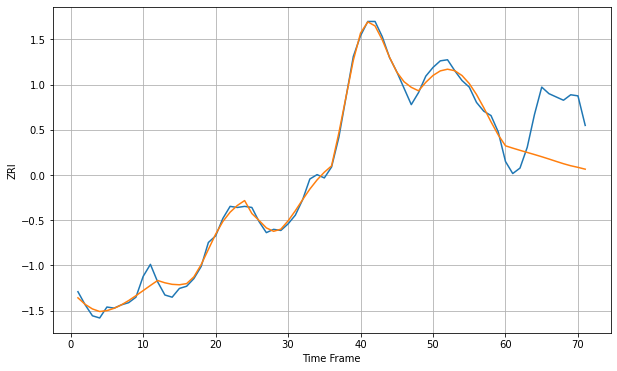

Wall time: 9.64 s
55401 5.820547860126252 47.34543695464864 [1643.35621443 1641.23684797 1639.23158565 1637.29626768 1635.36832759
 1633.37741003 1631.27785751 1629.10267596 1626.99213821 1625.13491283
 1623.66164622 1621.99239023]


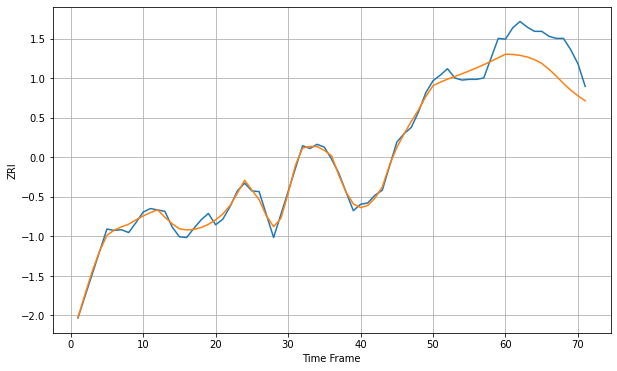

Wall time: 16.2 s
55403 8.212169970577875 45.14897431130232 [1318.61286628 1318.27617305 1316.99714945 1314.69089431 1310.96138013
 1305.63160232 1297.39683506 1287.64222773 1277.24536039 1267.78793079
 1259.64178105 1252.73190962]

Got an mse at 0.0050 in round 316 and stopped training



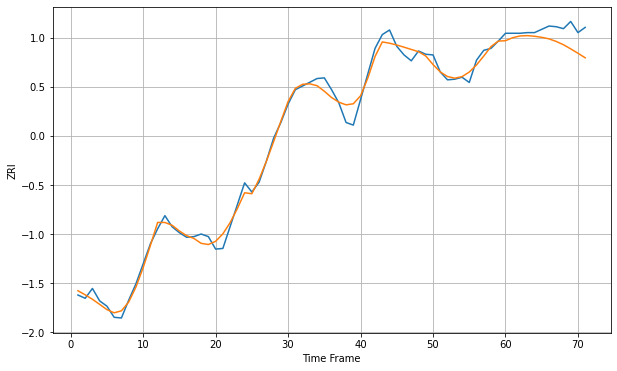

Wall time: 13.3 s
55404 10.522063158495271 23.74641861132133 [1349.6952238  1354.27234967 1356.89882743 1357.40669983 1356.4520553
 1354.80743719 1352.49301052 1348.52864871 1343.51740681 1337.19886073
 1330.52898757 1323.59254679]

Got an mse at 0.0050 in round 233 and stopped training



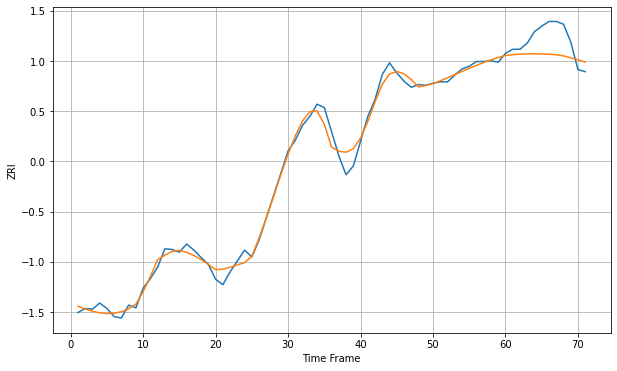

Wall time: 10.5 s
55407 10.369987081371317 30.27894784378882 [1379.83572426 1381.00773488 1381.785368   1382.20519519 1382.30465179
 1382.11359006 1381.64927871 1380.92593241 1379.30362359 1376.49790918
 1373.42899979 1370.08985185]


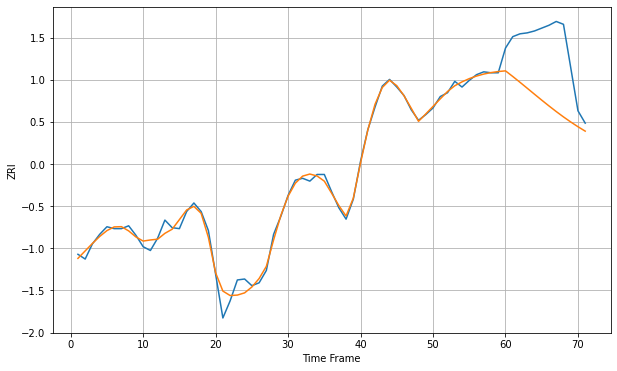

Wall time: 16 s
55408 6.2242702623141515 63.119448326296144 [1522.0262168  1516.12377823 1509.99441805 1503.73745167 1497.44719408
 1491.21150484 1485.11029097 1479.21336514 1473.57796191 1468.24671243
 1463.24679074 1458.59050292]

Got an mse at 0.0050 in round 472 and stopped training



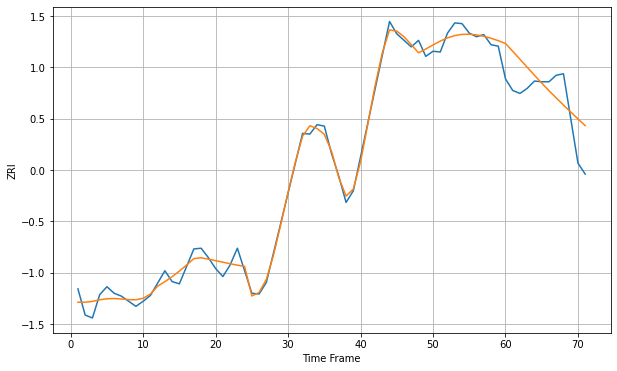

Wall time: 17.3 s
55411 9.953629698579508 40.40374285790189 [1590.69020937 1579.93808411 1568.9640805  1557.91484418 1546.94937423
 1536.21306815 1525.80499699 1515.75448823 1506.01477942 1496.46166537
 1486.9226428  1477.6093683 ]

Got an mse at 0.0050 in round 225 and stopped training



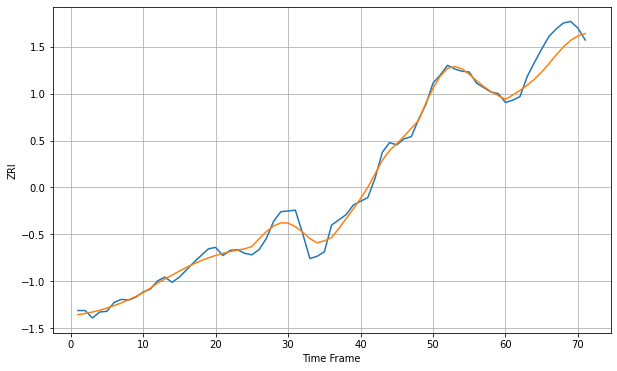

Wall time: 9.99 s
55413 8.882165700182737 22.722765745175206 [1513.20730953 1519.04006262 1525.26307375 1532.24670651 1540.41279208
 1550.08582803 1561.18001435 1572.88826585 1583.80412625 1592.59278896
 1598.58517998 1601.78774277]

Got an mse at 0.0050 in round 244 and stopped training



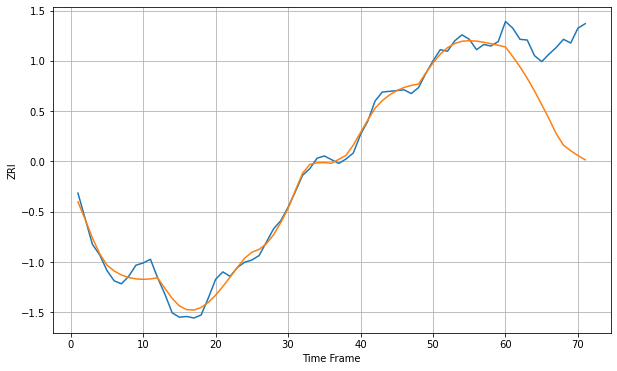

Wall time: 10.1 s
55414 9.513136440347079 107.0576108835958 [1564.63265498 1551.77218675 1537.89323502 1522.58735903 1505.53949982
 1487.07017055 1468.1372637  1448.00066335 1432.57299964 1425.02357957
 1418.51436989 1412.82507463]


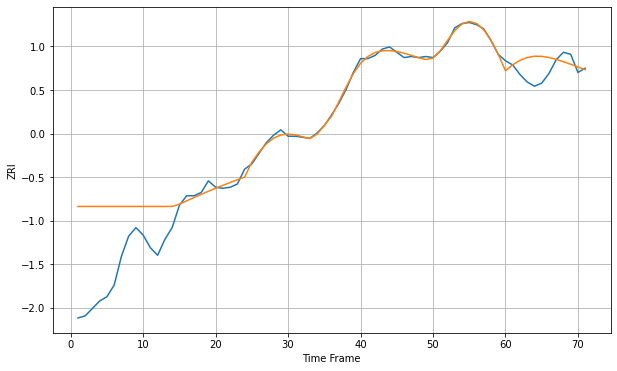

Wall time: 15.9 s
55416 32.10825457740906 14.870633106973683 [1515.56299498 1521.21116686 1525.40969539 1528.07346044 1529.25714175
 1529.15627887 1528.06361762 1526.29501847 1524.11860371 1521.71624899
 1519.18398988 1516.55862445]

Got an mse at 0.0049 in round 91 and stopped training



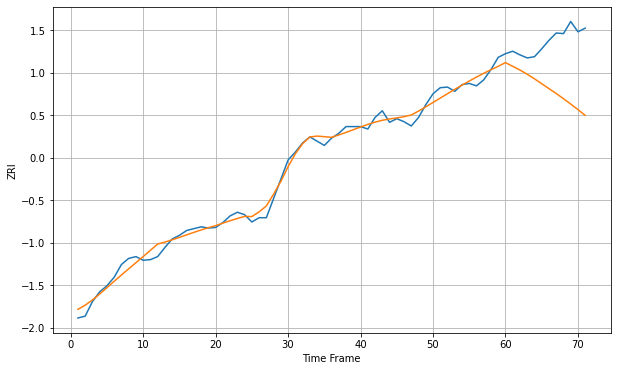

Wall time: 6.99 s
55418 9.76929057688256 86.59449727174234 [1328.26638987 1322.13817663 1315.99683886 1309.11961895 1301.60851065
 1293.5375277  1285.46345865 1277.4274295  1268.92774562 1260.07554275
 1250.97524433 1241.46226006]


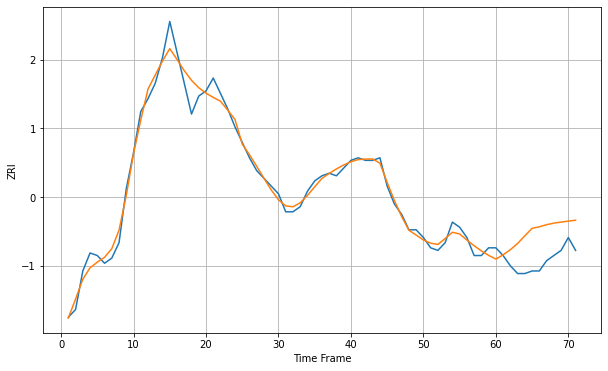

Wall time: 16.2 s
58103 3.3718702811104726 11.669118063832594 [710.61560688 712.28222613 714.26588578 716.68572595 719.67688185
 722.5804892  723.16987923 723.99649772 724.60011827 724.99701264
 725.38598902 725.72140858]


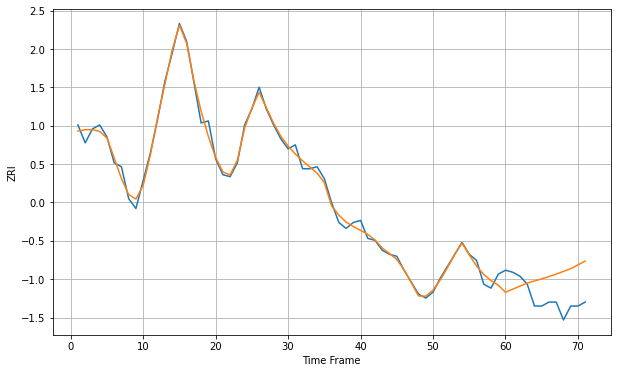

Wall time: 17.5 s
58104 2.7811196455202634 15.075302870811404 [768.92748951 770.49269764 772.00729743 773.52939373 774.5921557
 775.6701972  776.82476959 778.06354919 779.39038047 780.77916115
 782.67290426 784.60057596]


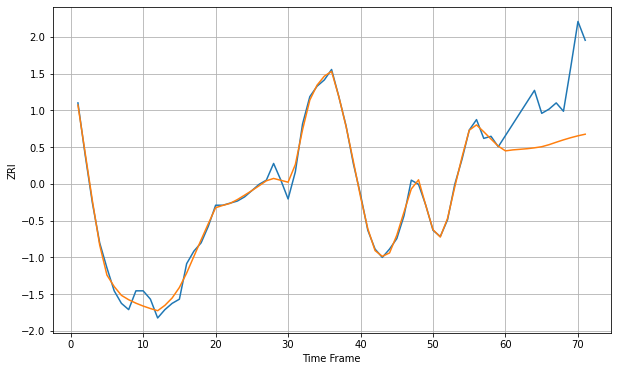

Wall time: 16.1 s
59601 2.771618266360868 27.413185799681223 [838.02108908 838.4977324  838.77388687 839.07124073 839.4896037
 840.01628993 840.9819911  842.16510223 843.29903108 844.33259608
 845.23922165 846.009288  ]

Got an mse at 0.0050 in round 138 and stopped training



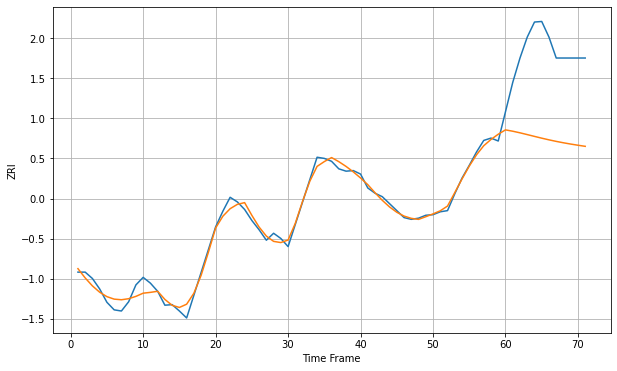

Wall time: 7.91 s
59718 9.672516084607869 150.8971848776758 [1483.15875308 1480.85311855 1478.08265199 1475.04718101 1471.92791599
 1468.87298435 1465.98644451 1463.32582625 1460.90668895 1458.71099544
 1456.69812952 1454.81710024]

Got an mse at 0.0050 in round 251 and stopped training



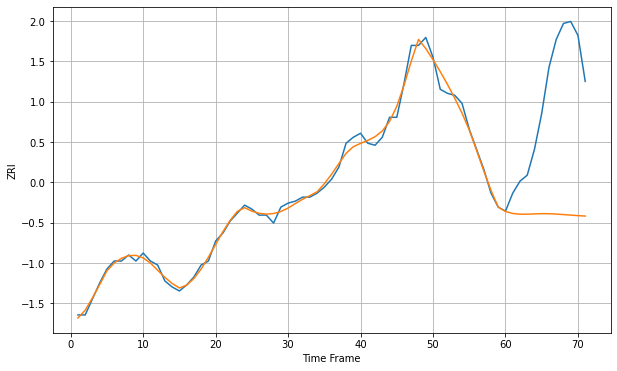

Wall time: 10.4 s
59801 2.8455519870972608 63.6641195173454 [822.80954471 821.82638849 821.44886624 821.45773622 821.6091788
 821.71712794 821.68759542 821.51874498 821.26673953 820.9952022
 820.74456388 820.53134248]

Got an mse at 0.0049 in round 107 and stopped training



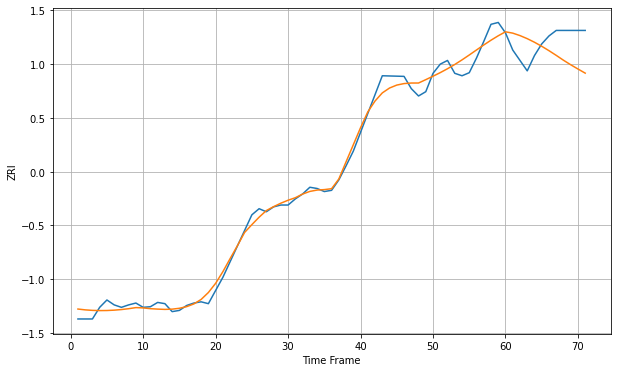

Wall time: 7.4 s
59901 12.255749714486429 43.039117706910105 [1185.75401221 1183.58236313 1179.57869479 1174.56215551 1168.69804398
 1162.12186564 1154.9464623  1147.29895568 1139.34948217 1131.96868729
 1125.02263235 1118.27488681]


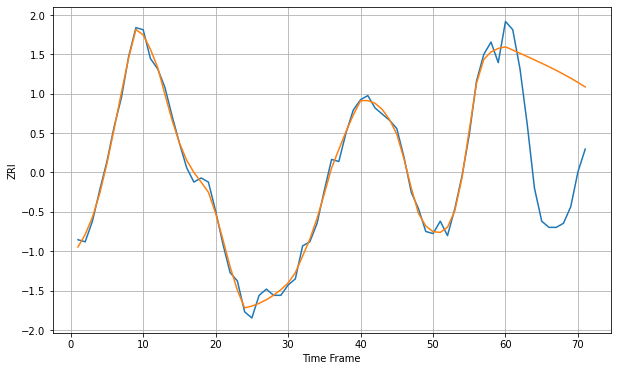

Wall time: 18.2 s
60085 3.035921199274266 54.00846428860182 [1194.66619855 1193.12185092 1191.54260324 1189.94893864 1188.33984702
 1186.70135106 1185.01427228 1183.25819983 1181.41291749 1179.46044577
 1177.38976596 1175.20336857]


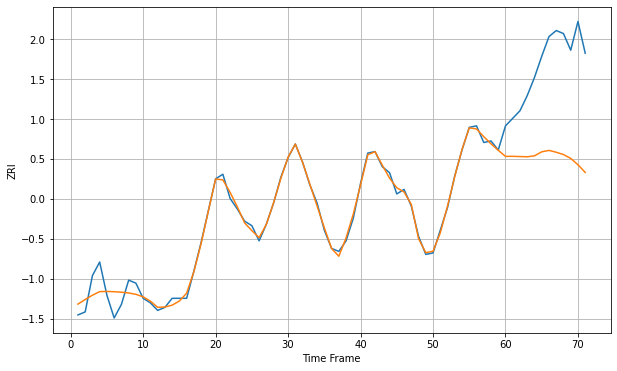

Wall time: 17.5 s
60201 4.793384814110436 63.95850080890429 [1532.8088412  1532.85448117 1532.70041493 1532.558062   1533.18502244
 1535.82629923 1536.76431462 1535.56170285 1534.01535403 1531.49901241
 1527.2776404  1522.22191868]


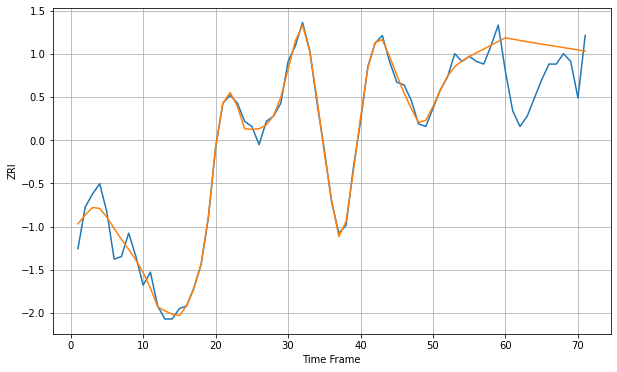

Wall time: 17.1 s
60202 3.5837115866566256 18.2184844482853 [1595.11988991 1594.58242648 1594.07639741 1593.5978936  1593.13854956
 1592.68926756 1592.24267588 1591.79415648 1591.34179394 1590.88576968
 1590.4276253  1589.96962663]


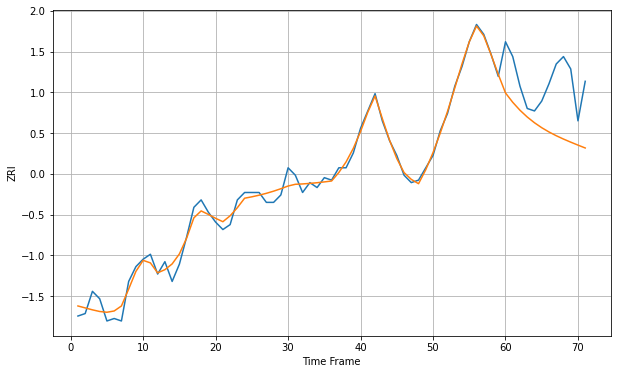

Wall time: 16.7 s
60402 2.9327569243049254 20.526857987650448 [1286.28605592 1282.49454629 1279.27973553 1276.55018765 1274.21845038
 1272.21770006 1270.49114278 1268.9804947  1267.62573156 1266.37190201
 1265.17627358 1264.0129892 ]

Got an mse at 0.0050 in round 267 and stopped training



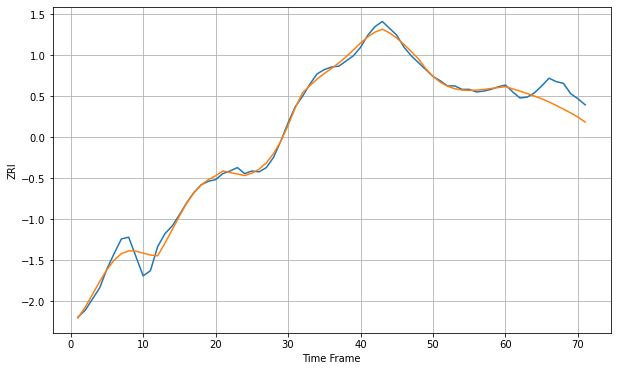

Wall time: 11.3 s
60540 6.6937228514132325 18.536592963617156 [1642.1525992  1639.59223662 1636.91620093 1634.11566517 1631.17850704
 1628.06539179 1624.43218653 1620.2764371  1615.97582223 1611.56334662
 1606.67310531 1600.9644406 ]

Got an mse at 0.0050 in round 197 and stopped training



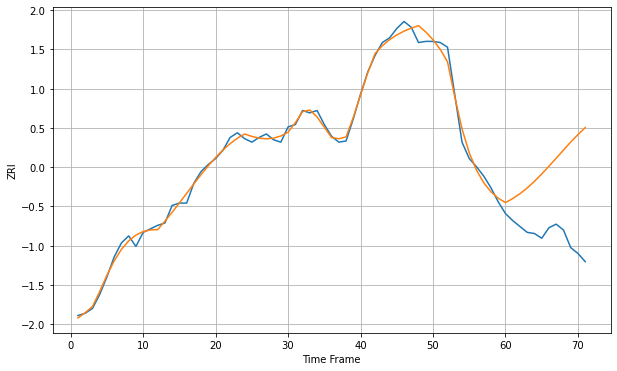

Wall time: 10.1 s
60563 4.722073723106488 64.3893015073598 [1372.47083302 1375.8618731  1380.00228714 1384.93529638 1390.59909658
 1396.84027745 1403.46967398 1410.3164998  1417.24196947 1424.12097513
 1430.43639602 1436.42838273]

Got an mse at 0.0050 in round 416 and stopped training



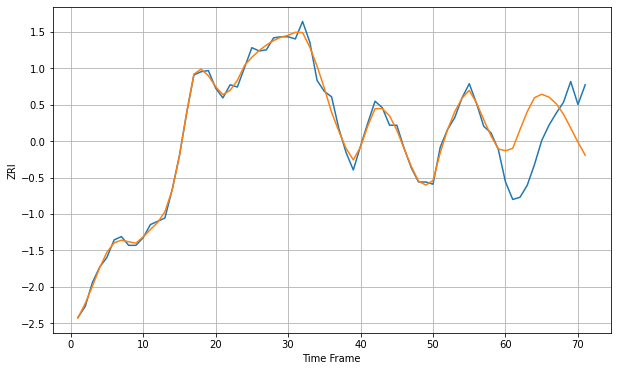

Wall time: 15.1 s
60601 4.67846012718594 45.59047832630805 [2086.5952669  2088.78865108 2105.89850926 2122.4075449  2135.22306051
 2138.31599771 2135.72663719 2129.71918887 2120.12101381 2107.43317278
 2094.45707611 2082.50551012]


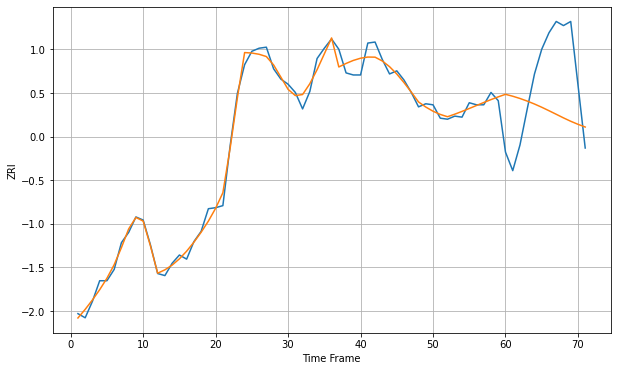

Wall time: 16.8 s
60605 7.02461152475095 63.07713786243852 [2044.18755303 2042.33891865 2040.1377778  2037.60294711 2034.76064452
 2031.63031317 2028.24957969 2024.7894768  2021.29203237 2018.00014571
 2015.0494421  2012.39698571]


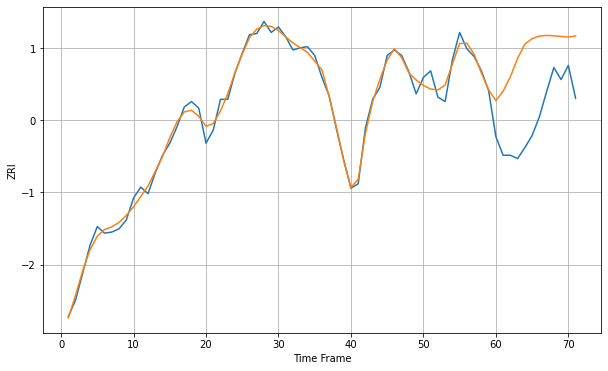

Wall time: 16.5 s
60606 6.180399099649473 63.91320730153008 [2197.79410063 2206.42652273 2219.55554532 2236.4353009  2249.3059862
 2254.3844425  2256.71286824 2257.28949663 2256.90935027 2256.36294475
 2255.76419125 2256.83697105]

Got an mse at 0.0050 in round 217 and stopped training



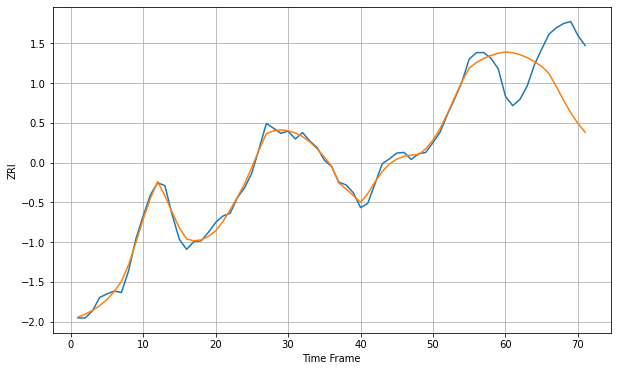

Wall time: 10.5 s
60607 7.880309566207151 83.8860076727014 [2036.94488272 2035.79968884 2033.11616289 2028.92324005 2022.97598094
 2016.59034512 2006.4776193  1988.18951454 1968.90696967 1951.07004136
 1935.8698777  1923.36026363]


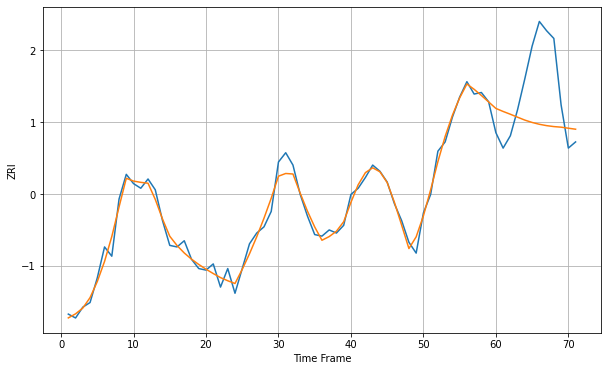

Wall time: 17 s
60608 4.954229088820384 36.62628425063813 [1523.69080731 1521.7288648  1519.91800395 1518.00221471 1516.12516416
 1514.60742124 1513.42465257 1512.5451099  1511.93348808 1511.5535251
 1510.88408375 1510.22898238]


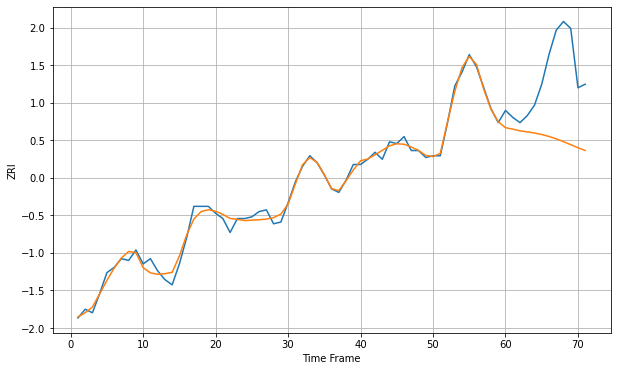

Wall time: 16.9 s
60609 3.056358615343878 40.03055172145059 [1283.10942409 1282.2641542  1281.27625473 1280.69741021 1280.04228798
 1279.18226478 1278.07754651 1276.70977611 1275.10876007 1273.36927737
 1271.62843428 1270.00876336]


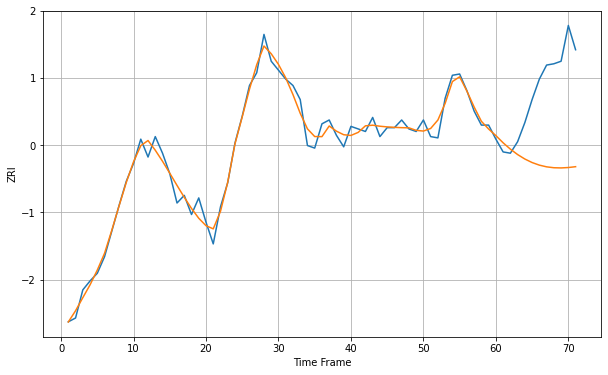

Wall time: 16.6 s
60610 6.507854178912196 63.67339719486779 [1921.7702952  1916.14569351 1911.17777277 1906.93849404 1903.44192725
 1900.68827034 1898.66032821 1897.32313084 1896.62189828 1896.47580621
 1896.78338406 1897.43863596]


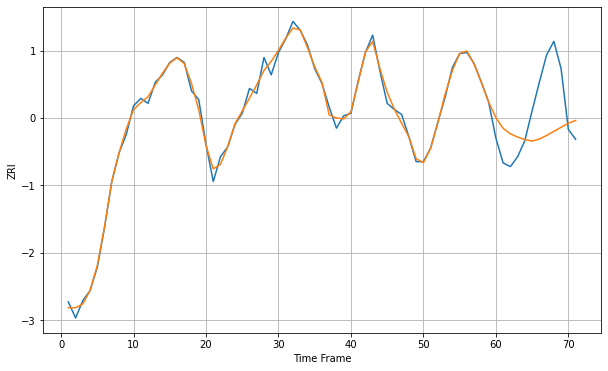

Wall time: 16.9 s
60611 4.315358454063593 37.25854528338323 [2155.4747793  2146.86547252 2142.48150148 2139.78645433 2137.79301195
 2136.62447478 2138.24179718 2141.15328965 2144.36856356 2147.71587496
 2150.99759239 2153.17271732]

Got an mse at 0.0050 in round 444 and stopped training



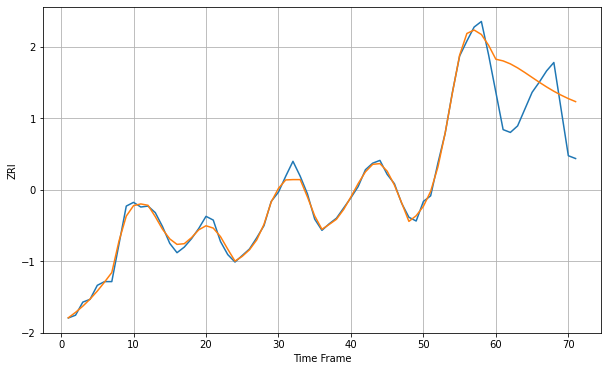

Wall time: 15.8 s
60612 5.373853641974922 47.18222952593804 [1690.48830014 1688.70332925 1685.51364566 1681.21272976 1676.23570289
 1670.98417464 1665.76141738 1660.77539317 1656.15893529 1651.98578564
 1648.28124163 1645.03162723]

Got an mse at 0.0050 in round 246 and stopped training



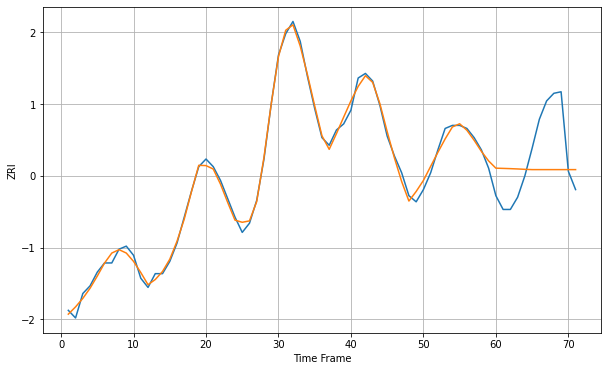

Wall time: 11.1 s
60613 3.306533946941173 29.8274479133291 [1706.01865869 1705.86643452 1705.70401007 1705.50289487 1705.25150617
 1705.06963155 1705.06963155 1705.06963155 1705.06963155 1705.06963155
 1705.06963155 1705.06963155]

Got an mse at 0.0049 in round 451 and stopped training



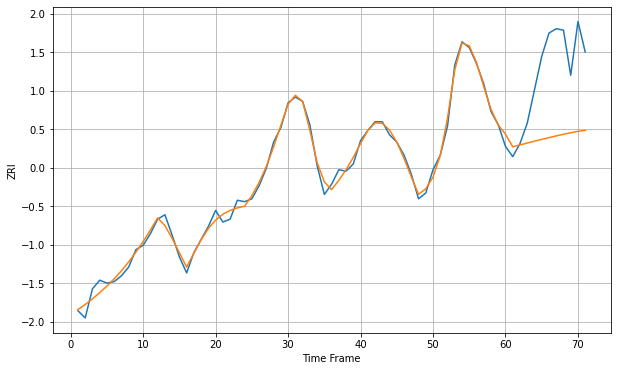

Wall time: 15.9 s
60614 3.725198774080832 50.61470593814796 [1880.4581504  1871.77451055 1873.06799535 1874.36269582 1875.64101718
 1876.88937126 1878.09783027 1879.25965787 1880.37083536 1881.42952251
 1882.40885182 1883.07524466]

Got an mse at 0.0049 in round 58 and stopped training



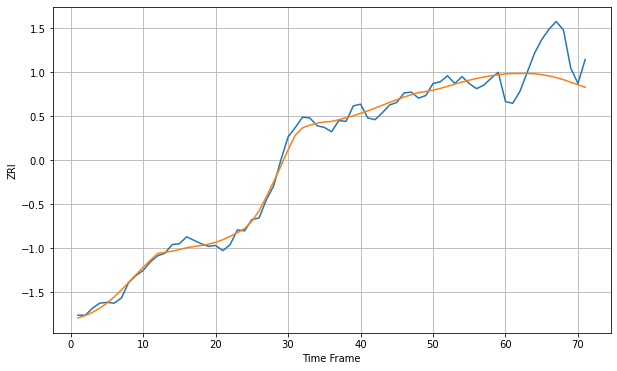

Wall time: 6.6 s
60615 7.117721409738062 37.28570675437846 [1536.1584393  1536.53522917 1536.63971554 1536.62625463 1536.30620545
 1535.332018   1533.85074735 1531.86581438 1529.41809708 1526.51112887
 1523.58208032 1520.61942617]


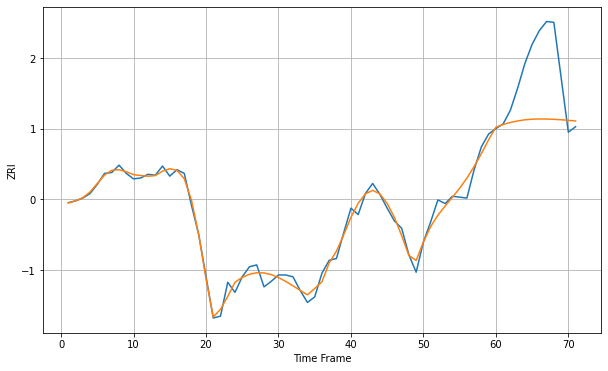

Wall time: 17.1 s
60616 7.294910606316277 62.038245346445706 [1664.39239896 1667.44484605 1669.62040725 1671.33514464 1672.51846478
 1673.20179114 1673.47186383 1673.3981866  1673.08178855 1672.59056306
 1671.96104845 1671.2159698 ]


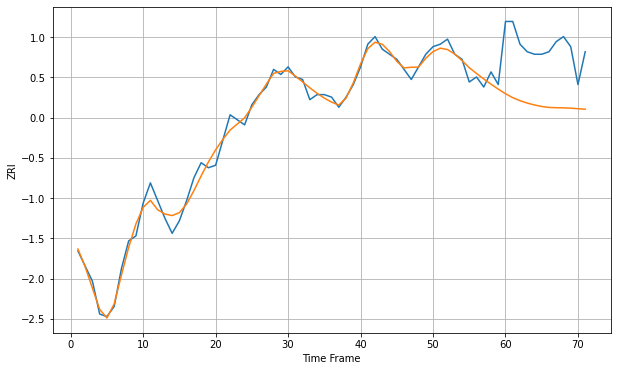

Wall time: 17 s
60617 2.901194690607428 23.55658494401298 [1136.33895914 1134.80815079 1133.59524771 1132.64450101 1131.8947685
 1131.29438269 1130.91093531 1130.81205886 1130.75425157 1130.62449042
 1130.40477429 1130.22071216]

Got an mse at 0.0049 in round 330 and stopped training



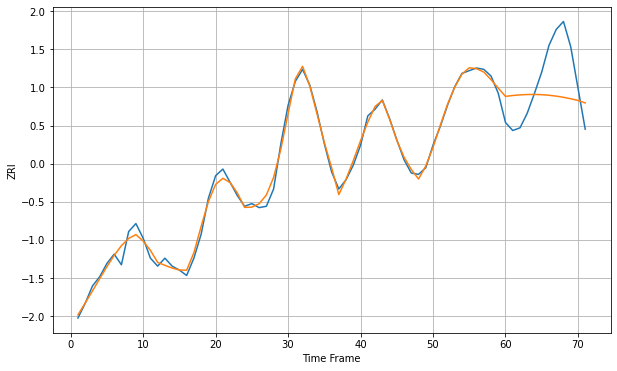

Wall time: 13.8 s
60618 4.009936678000137 30.77604816807046 [1634.65234295 1635.31526098 1635.78709826 1636.05326938 1636.10129437
 1635.92014608 1635.50304109 1634.85001852 1633.96871054 1632.87340301
 1631.5831605  1629.74012257]


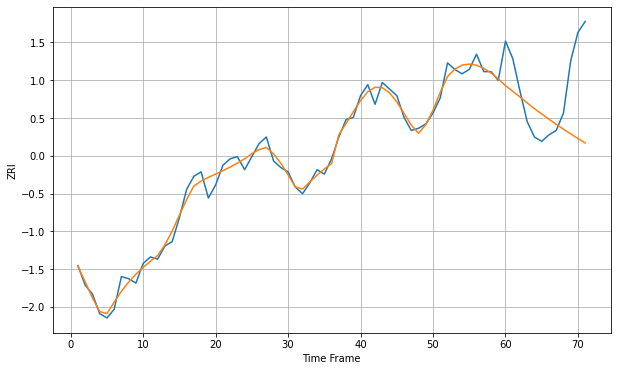

Wall time: 17.2 s
60619 3.2821111585918468 25.438463323053707 [1120.58169456 1117.96353243 1115.3862452  1112.63720713 1109.98899109
 1107.56300109 1105.16252278 1102.82441386 1100.60833435 1098.44582651
 1096.33180137 1094.26836975]

Got an mse at 0.0050 in round 209 and stopped training



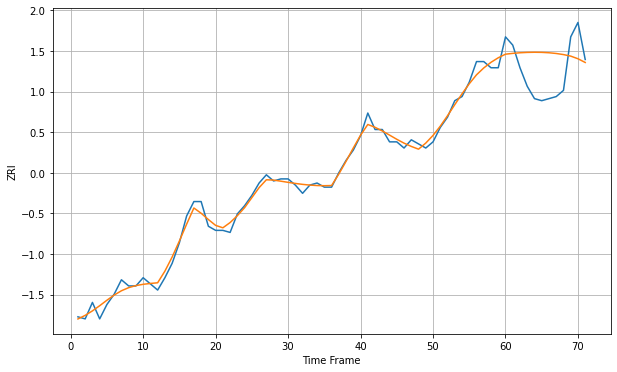

Wall time: 11.2 s
60620 2.764773510885629 16.08946652233383 [1167.5911161  1167.98949573 1168.27568442 1168.45490841 1168.5237823
 1168.47186499 1168.28253443 1167.9337719  1167.39950347 1166.65216441
 1165.37051301 1163.56779762]

Got an mse at 0.0050 in round 469 and stopped training



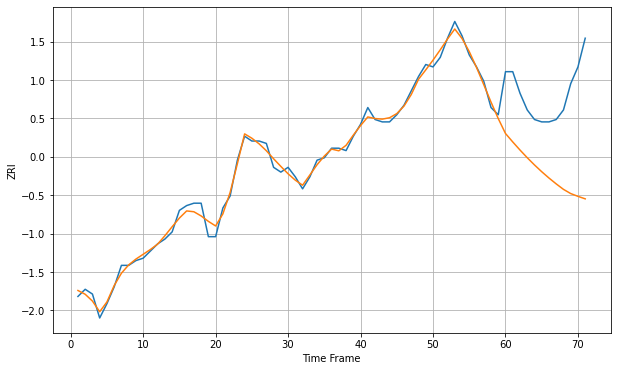

Wall time: 18.4 s
60621 2.2563143073948013 35.62453020046756 [1157.14209132 1153.61792816 1150.23662041 1147.02285721 1143.99453604
 1141.16077074 1138.52106995 1136.06621318 1133.7805646  1132.02606657
 1130.86611626 1129.81530817]


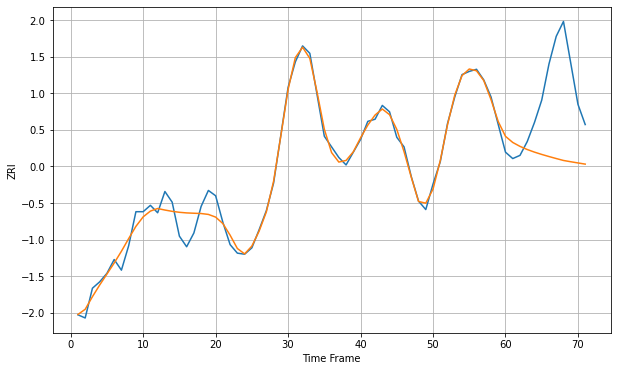

Wall time: 17.8 s
60622 8.683535425420516 67.67316036314939 [1789.91041327 1784.15361406 1780.46722771 1777.51244122 1775.05116832
 1772.89026885 1770.9046811  1769.02296965 1767.20893577 1766.00909794
 1764.88131878 1763.77317612]

Got an mse at 0.0050 in round 395 and stopped training



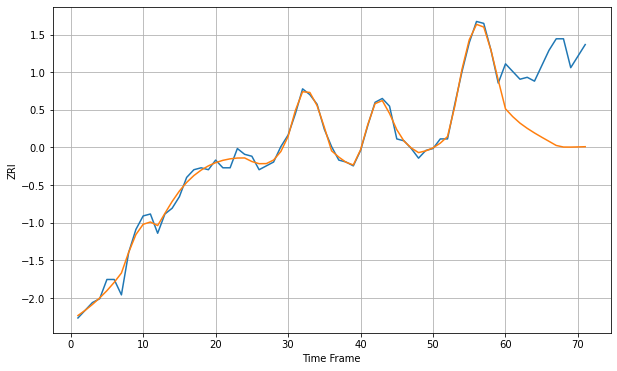

Wall time: 15.6 s
60623 2.7470189092879878 40.43640951052413 [1280.60562768 1276.57452259 1273.1997975  1270.48954154 1268.09331147
 1265.88456997 1263.75302004 1261.60288458 1260.77663479 1260.75262267
 1260.84408534 1260.9547409 ]


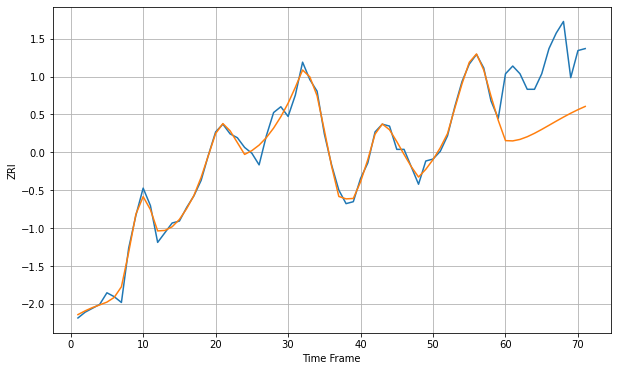

Wall time: 17.5 s
60624 3.126454232610733 34.145831549751286 [1331.51530872 1331.37233578 1332.14082705 1333.51631802 1335.28566705
 1337.29337892 1339.41877919 1341.56580369 1343.65951837 1345.64477979
 1347.48468698 1349.15812875]

Got an mse at 0.0050 in round 376 and stopped training



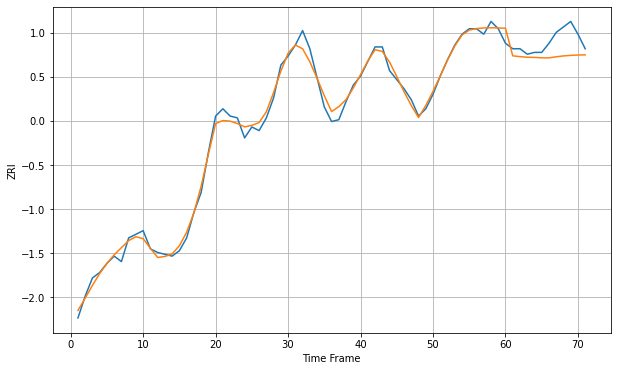

Wall time: 14.4 s
60625 3.391412495894921 9.613051609824623 [1554.25977217 1539.11125097 1538.67198719 1538.34404983 1538.24107206
 1538.00636543 1537.99701289 1538.59455271 1539.05035449 1539.36834089
 1539.55824214 1539.63280877]

Got an mse at 0.0050 in round 233 and stopped training



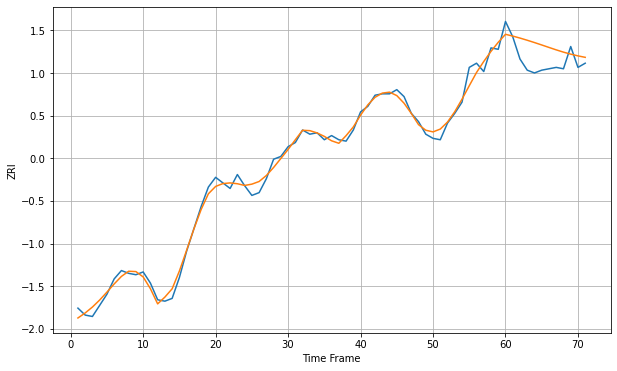

Wall time: 11.2 s
60626 4.291550586760266 13.639993780523314 [1381.7737883  1380.50462283 1379.06511294 1377.50058126 1375.84041677
 1374.10714996 1372.33550894 1370.5898762  1368.95790593 1367.51255889
 1366.27624562 1365.22227995]


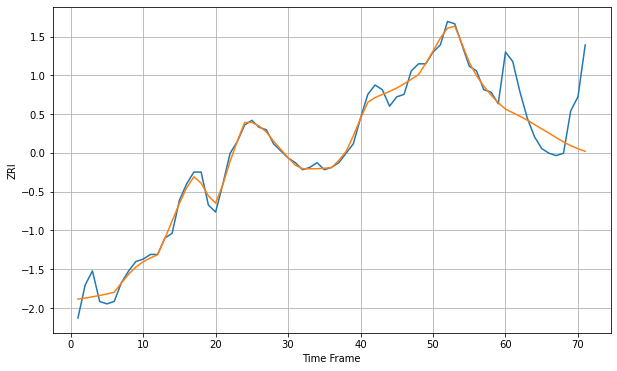

Wall time: 17.1 s
60628 3.1129223355708926 18.63286399196917 [1177.74819601 1176.24030832 1174.69365386 1173.08305419 1171.20695146
 1169.35705619 1167.53306351 1165.64463712 1163.80792636 1162.23416213
 1160.93235586 1159.82064316]


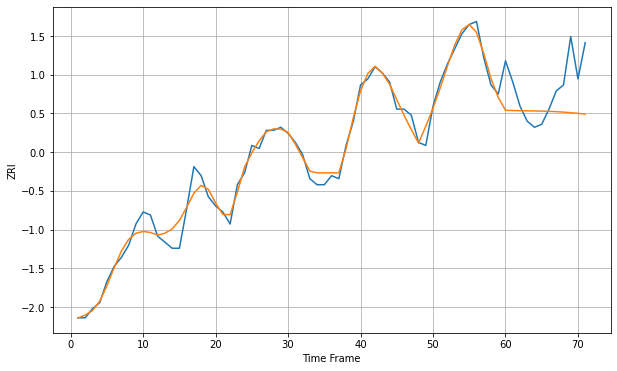

Wall time: 17.6 s
60629 2.9568553438249072 12.482180489609467 [1213.62913524 1213.54906366 1213.48732376 1213.44129166 1213.40173771
 1213.35361061 1213.28044567 1213.17014697 1213.01827622 1212.82759609
 1212.60561111 1212.36208251]


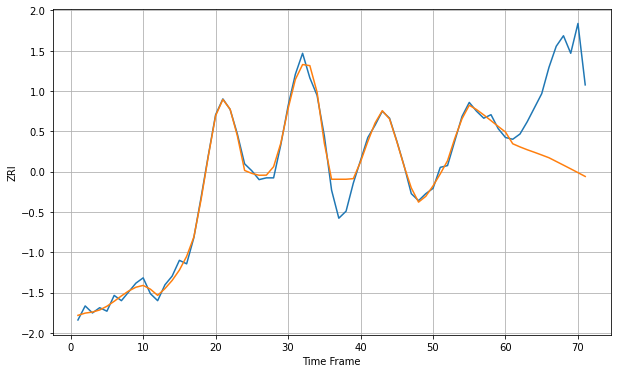

Wall time: 16.9 s
60630 4.662292890953443 49.06675327440239 [1514.10774994 1507.42710149 1505.63727695 1504.02360967 1502.55929446
 1501.02966262 1499.46050409 1497.35800728 1495.25365241 1493.13096786
 1490.98180978 1488.80678225]


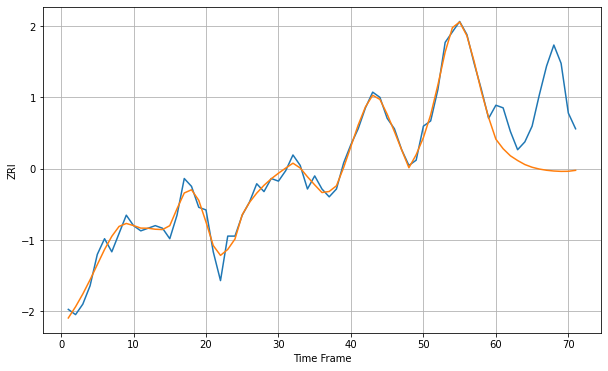

Wall time: 16.6 s
60632 2.8755428551301985 25.81757228456365 [1311.01756554 1307.38111413 1304.68277678 1302.87947084 1301.33944794
 1300.30090512 1299.61068606 1299.15374421 1298.86591169 1298.72649954
 1298.75973386 1299.12183478]


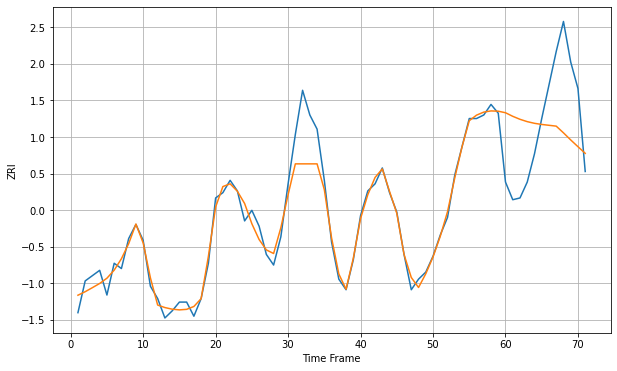

Wall time: 16.3 s
60634 8.484632745295697 37.28061997813774 [1586.2857313  1584.2605775  1582.56440456 1581.24277363 1580.29358252
 1579.64895073 1579.17234673 1578.69186108 1574.89459579 1570.87505034
 1567.04383453 1563.28887632]


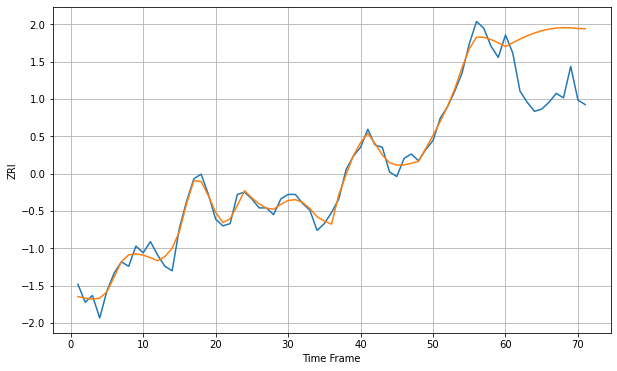

Wall time: 16.9 s
60636 3.4766992352057726 27.728238680537658 [1204.81843354 1206.54116247 1208.15713034 1209.61640093 1210.86738454
 1211.86780062 1212.59550784 1213.04891109 1213.23774957 1213.17615783
 1212.88153213 1212.76912922]

Got an mse at 0.0050 in round 354 and stopped training



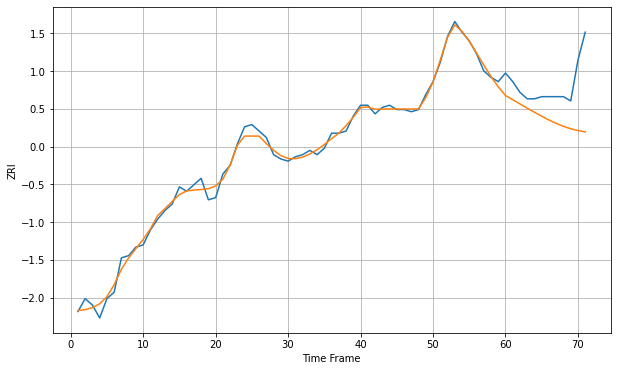

Wall time: 13.7 s
60637 2.473794476762308 18.725628866075667 [1203.51611726 1201.5962291  1199.60715201 1197.63327437 1195.73898361
 1193.89164623 1192.13182565 1190.54530424 1189.18154841 1188.07130638
 1187.22189155 1186.61897327]


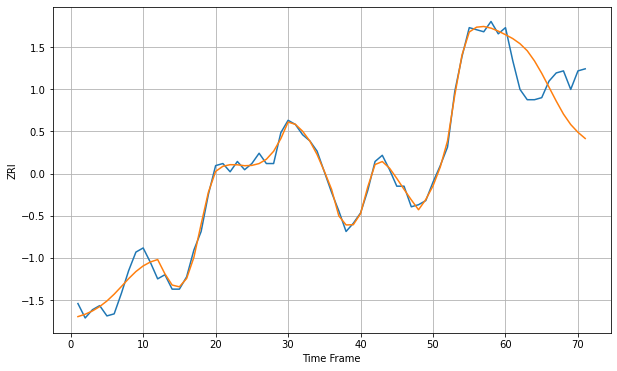

Wall time: 16.5 s
60639 3.48749520857557 19.664154238190196 [1382.5777755  1380.69065103 1378.20366437 1374.78292617 1369.83797063
 1363.82001852 1357.10740394 1350.34594281 1344.00980974 1338.94557415
 1335.16779326 1332.16612404]

Got an mse at 0.0050 in round 285 and stopped training



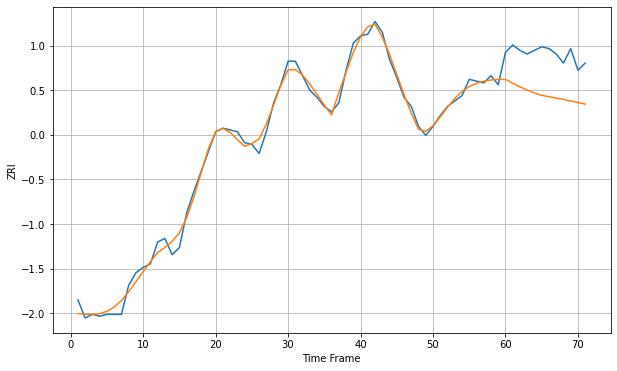

Wall time: 11.7 s
60640 3.4738366624130688 22.625581155761633 [1488.9712036  1486.80631227 1484.83459522 1483.04046055 1481.41959616
 1480.14283448 1479.38056877 1478.60758271 1477.81618666 1477.00173236
 1476.16157041 1475.29500401]


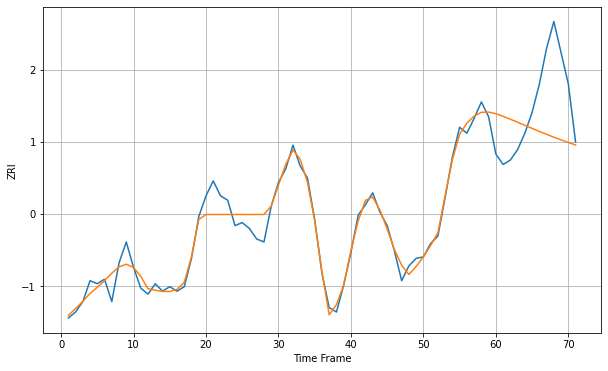

Wall time: 16.1 s
60641 7.075976325865837 39.09931043881842 [1560.11187133 1558.32285647 1556.38547258 1554.36244228 1552.30360766
 1550.24765996 1548.22380286 1546.25330172 1544.35089916 1542.52609182
 1540.78426755 1539.12770203]


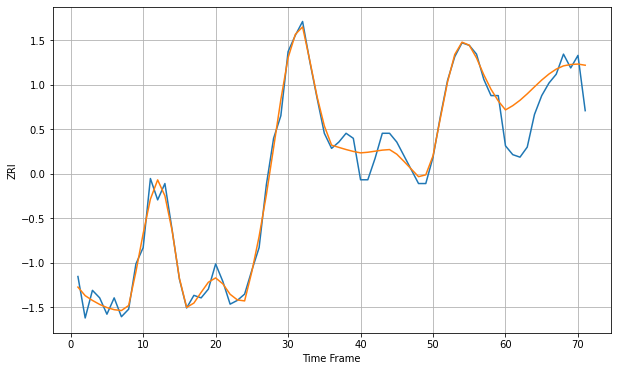

Wall time: 16.7 s
60642 8.275218271187757 26.361156210494492 [1972.61297312 1975.9716352  1980.26714106 1985.39553744 1990.96356059
 1996.39022513 2001.17473902 2005.07504756 2007.65703602 2008.74020811
 2009.08698829 2008.1711547 ]


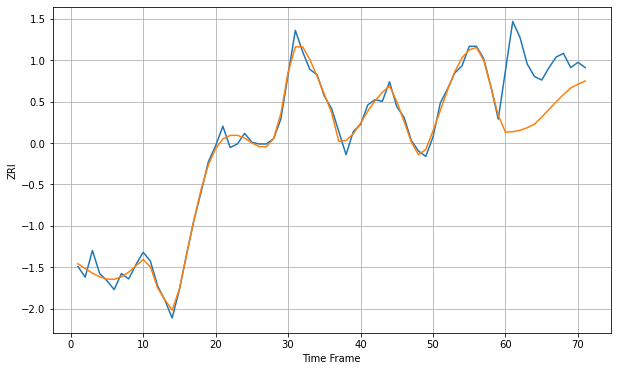

Wall time: 16.9 s
60644 3.7095988384803915 32.029935508987826 [1227.63788289 1227.89952846 1228.72056106 1230.14145263 1232.18661168
 1236.14137543 1240.46593816 1244.77148695 1248.85096098 1252.57106438
 1254.64544531 1256.47093988]

Got an mse at 0.0050 in round 255 and stopped training



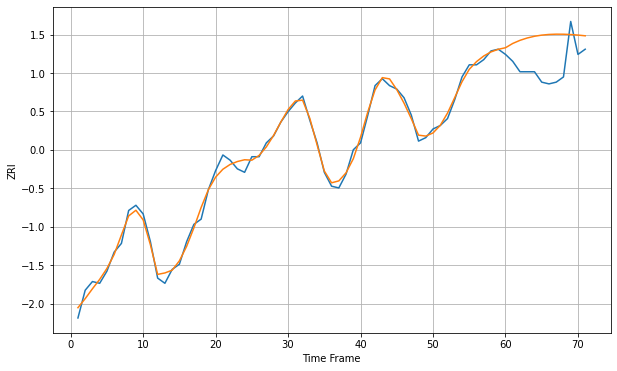

Wall time: 11.1 s
60645 3.112818549163478 19.170710662902973 [1502.84425575 1505.32251941 1507.11538816 1508.47593146 1509.46265492
 1510.1248221  1510.5124859  1510.67154224 1510.64196868 1510.45780885
 1510.14778506 1509.73596553]

Got an mse at 0.0050 in round 345 and stopped training



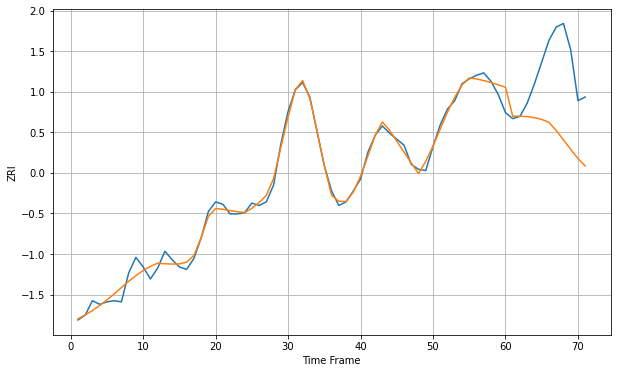

Wall time: 13 s
60647 4.745103283264586 55.793162141354976 [1632.11151396 1608.03776868 1608.07167546 1607.7080716  1606.85653102
 1605.40932755 1602.96113506 1596.16536774 1588.43722397 1580.45731704
 1573.01189334 1566.70391636]


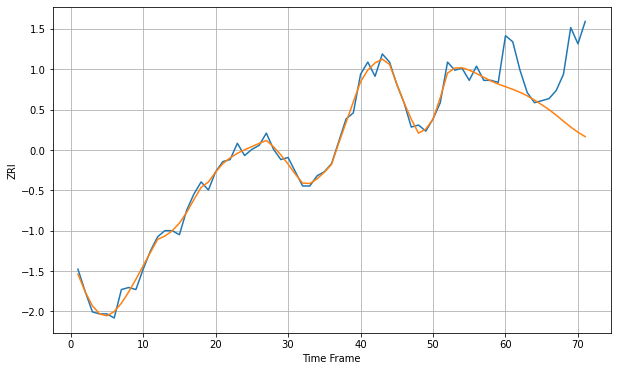

Wall time: 16.9 s
60649 2.835915055748021 28.178054825586592 [1095.87995802 1094.59452804 1093.11936869 1091.37710538 1089.28301455
 1087.00309522 1084.59828847 1081.88097719 1078.8746967  1076.02182449
 1073.45990436 1071.28038682]


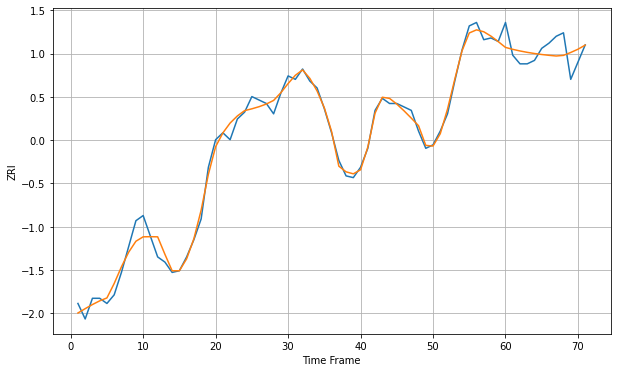

Wall time: 17.3 s
60651 4.251573594668581 9.13648586766581 [1360.52689788 1359.41389297 1358.46925536 1357.66809485 1356.98891808
 1356.41615813 1355.93935595 1355.55035564 1355.90362455 1357.59452231
 1359.47680647 1361.87107263]

Got an mse at 0.0050 in round 371 and stopped training



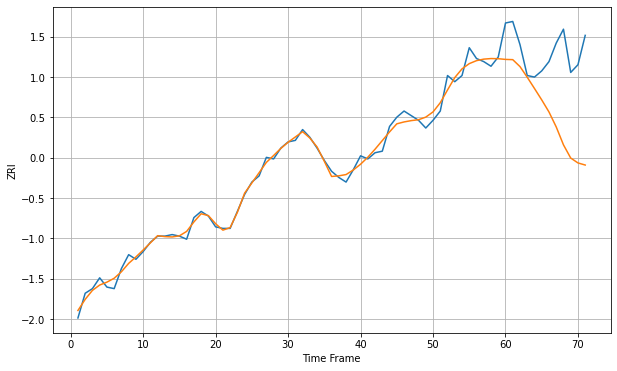

Wall time: 13.7 s
60653 3.679024410545688 46.160636379832745 [1427.43389782 1427.27638186 1422.78137136 1415.88682155 1408.59216103
 1401.20616006 1393.39727817 1383.70041927 1372.10412745 1363.55573228
 1360.39619836 1359.0282392 ]


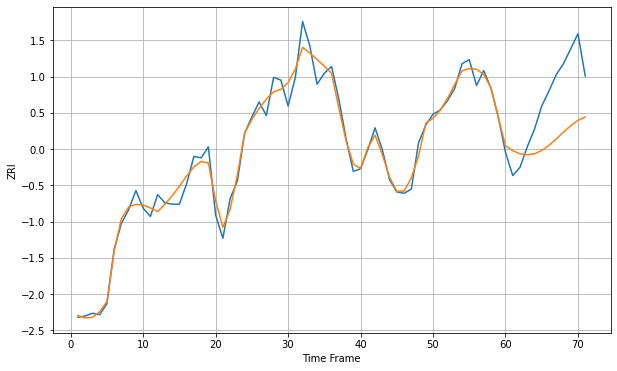

Wall time: 16.3 s
60654 7.132450108923013 36.88368072908951 [2133.87746189 2130.19959068 2127.96145919 2127.15046306 2127.93370095
 2130.39867178 2134.15416691 2138.76364196 2143.96709302 2148.54106129
 2152.48974586 2154.93755263]

Got an mse at 0.0050 in round 332 and stopped training



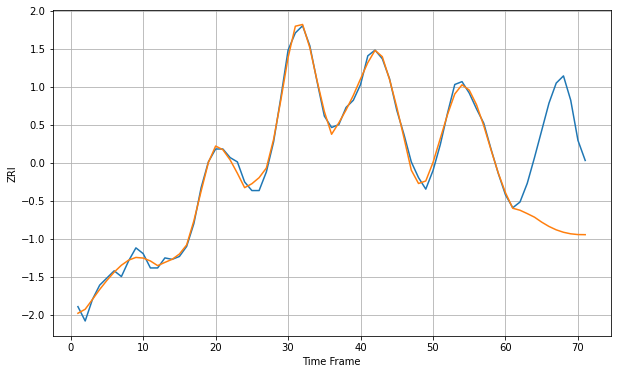

Wall time: 12.9 s
60657 3.727660204587119 65.69422614814458 [1724.43826554 1713.66013869 1712.26854408 1709.92691253 1707.42894977
 1703.94866616 1700.95578782 1698.59052826 1696.88923108 1695.81454982
 1695.28918789 1695.22127183]


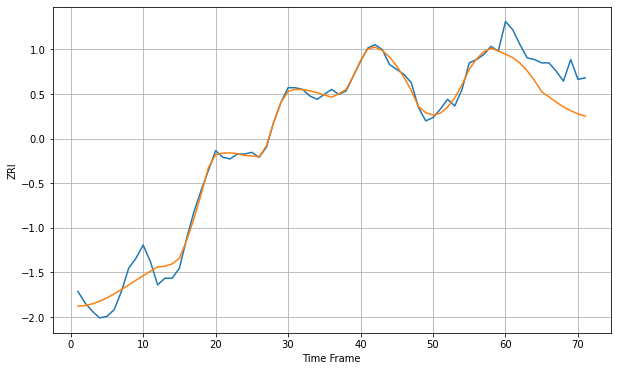

Wall time: 16.5 s
60660 5.25725895609475 18.840592761285638 [1392.21961839 1390.16818693 1386.87427209 1382.20842843 1376.31475319
 1369.56095107 1366.48739257 1363.2849545  1360.45990778 1358.10748082
 1356.23690043 1354.81494073]


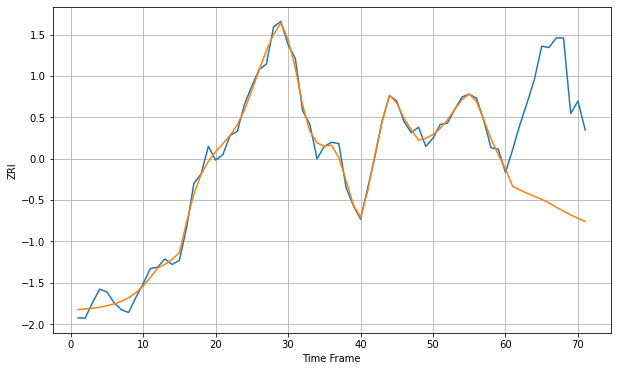

Wall time: 16.6 s
60661 5.386808576171344 85.76871851424926 [2053.37906838 2040.7428801  2038.24988814 2035.86303352 2033.59167311
 2031.44648291 2028.76383163 2025.72894809 2022.83808472 2020.12161295
 2017.60452142 2015.30434353]


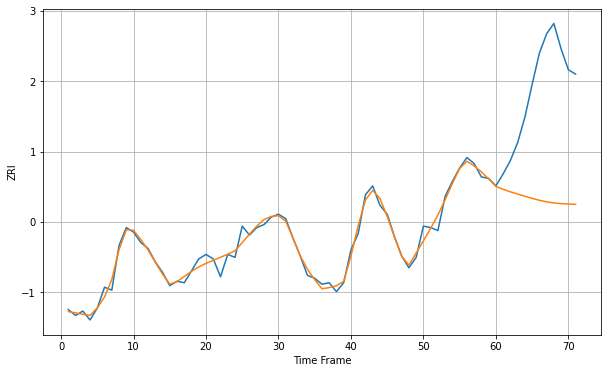

Wall time: 16.1 s
60804 3.9750207927874337 78.4729725896915 [1360.62319597 1358.69888674 1357.02402481 1355.52553322 1354.04906559
 1352.62837381 1351.32286608 1350.28289792 1349.53798556 1349.07517649
 1348.81486193 1348.60560532]

Got an mse at 0.0050 in round 183 and stopped training



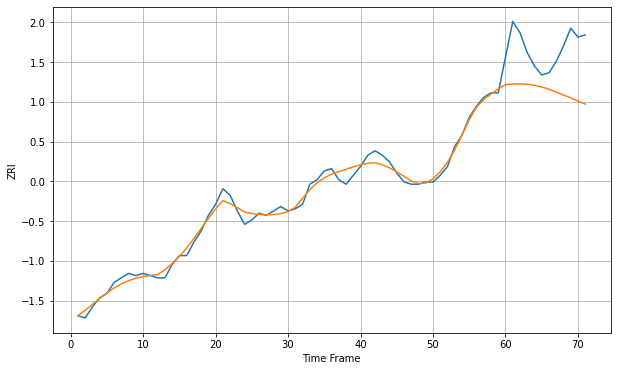

Wall time: 10 s
61104 2.5121197664717663 20.94723924580646 [637.64937723 637.94888269 638.02245382 637.84269637 637.3814297
 636.62289236 635.58695204 634.34809013 633.02410609 631.73021747
 630.25146834 628.92100716]

Got an mse at 0.0050 in round 452 and stopped training



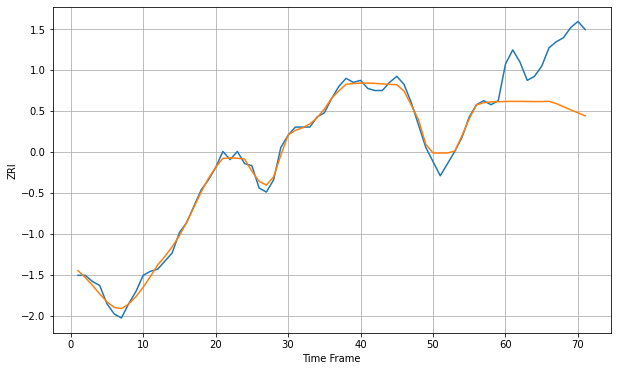

Wall time: 15.7 s
63104 2.8390285581187427 29.102485896304877 [829.59703457 829.65150077 829.6474089  829.60970634 829.56976165
 829.56978645 829.66699402 828.59437146 827.03739125 825.49478468
 823.99087839 822.53172031]

Got an mse at 0.0050 in round 237 and stopped training



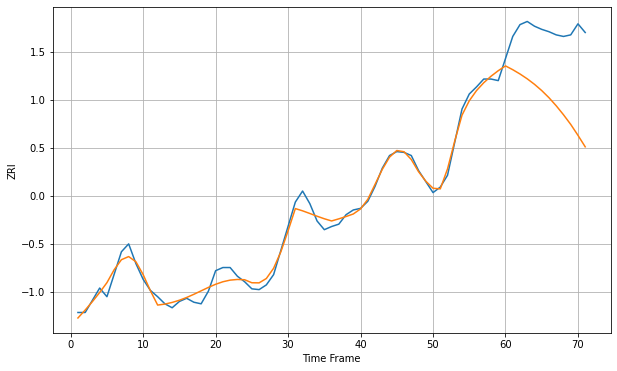

Wall time: 10.7 s
63105 8.546625903792368 91.90129633933239 [1220.65492391 1215.84521645 1210.40481866 1204.2689868  1197.30874426
 1189.37308107 1180.3211082  1170.08907342 1158.7571646  1146.47701209
 1132.63475229 1118.03568644]


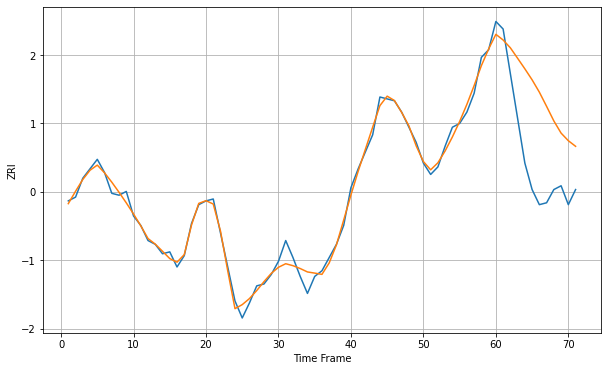

Wall time: 16.2 s
63107 3.497804010282927 37.715667629879036 [787.18660412 784.19648117 780.04173155 774.50965989 768.9177167
 763.09789304 756.56718069 749.03509528 741.32587509 734.88583033
 730.85717665 727.89516755]

Got an mse at 0.0050 in round 189 and stopped training



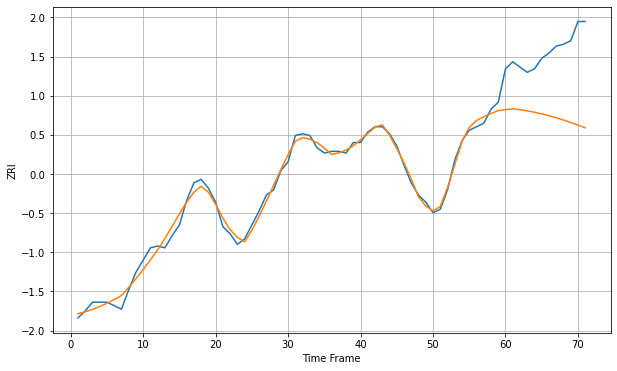

Wall time: 9.77 s
63108 3.141899163781261 38.82022624494913 [933.7795852  934.18569143 933.68521971 933.03637813 932.24822026
 931.32721267 930.27856954 929.108027   927.8234714  926.43608791
 924.96093351 923.41696982]

Got an mse at 0.0050 in round 487 and stopped training



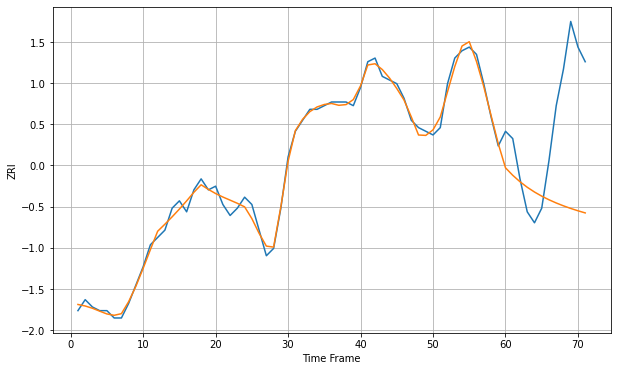

Wall time: 16.3 s
63109 1.5813721101704261 27.170867676240356 [736.02382192 733.97914211 732.21915147 730.70945764 729.40955521
 728.28114607 727.29167587 726.41504242 725.63100225 724.92415904
 724.28294856 723.69877231]

Got an mse at 0.0050 in round 401 and stopped training



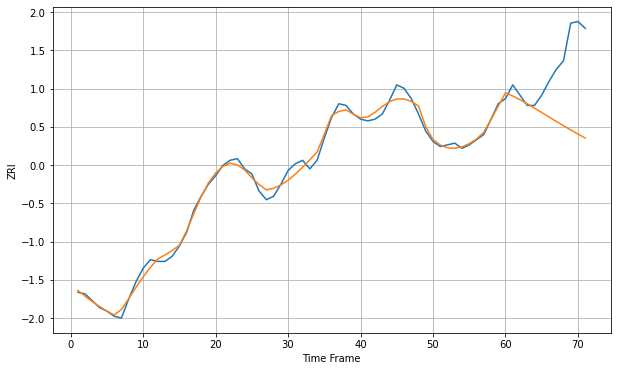

Wall time: 14.1 s
63110 3.1315631636409385 35.63330875963435 [890.38677782 888.50135639 886.33268612 883.95420821 881.44213751
 878.86510818 876.27650637 873.7119973  871.19175851 868.72505747
 866.31489235 863.96149294]

Got an mse at 0.0050 in round 261 and stopped training



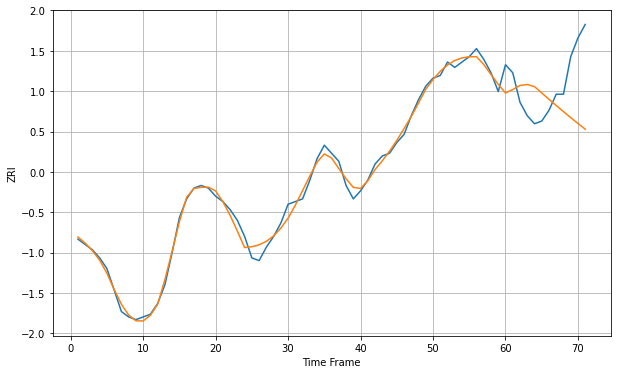

Wall time: 11.5 s
63111 2.111408190524446 17.700149098459924 [680.46954299 681.73439954 683.28347488 683.62774931 682.84732905
 680.48343717 678.11204052 675.79089121 673.51930084 671.2921158
 669.10468851 666.96829955]


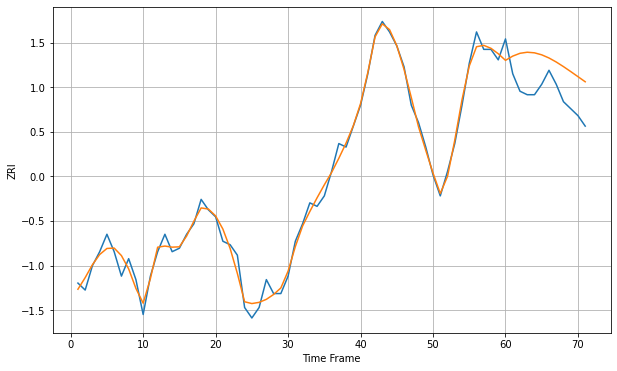

Wall time: 16.5 s
63112 2.250318757915679 9.57211102539684 [774.85798611 776.06960108 776.87408598 777.17987342 777.01056006
 776.43589294 775.53258222 774.37920142 773.05654353 771.63878759
 770.1806187  768.71094675]

Got an mse at 0.0050 in round 358 and stopped training



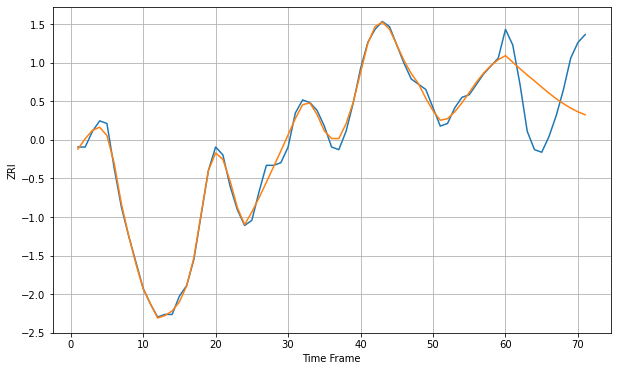

Wall time: 13.4 s
63113 2.075671006068242 18.95653495468909 [750.94623381 748.44009602 745.94214729 743.52881293 741.27079429
 738.90813939 736.58728298 734.47017553 732.56926568 730.88746665
 729.43745192 728.31822659]

Got an mse at 0.0050 in round 463 and stopped training



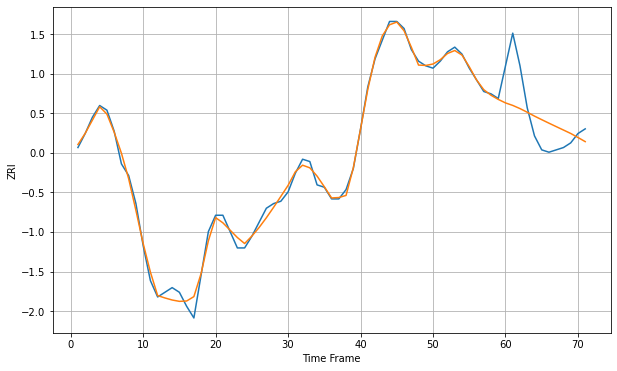

Wall time: 15.5 s
63115 2.3749490405285125 13.377887754899305 [665.11700595 664.04249454 662.68242654 661.12024019 659.46328559
 657.93474808 656.43394613 654.95898013 653.49591279 652.02922045
 650.30907539 648.53107266]

Got an mse at 0.0050 in round 307 and stopped training



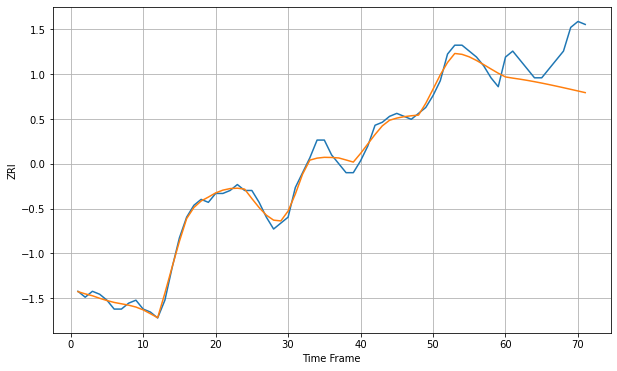

Wall time: 11.4 s
63116 2.125460686663684 12.787425927909835 [695.28935094 694.89681011 694.5366629  694.13334939 693.69191638
 693.2178947  692.71710812 692.19541345 691.65836723 691.11087601
 690.55692102 689.99942335]

Got an mse at 0.0050 in round 239 and stopped training



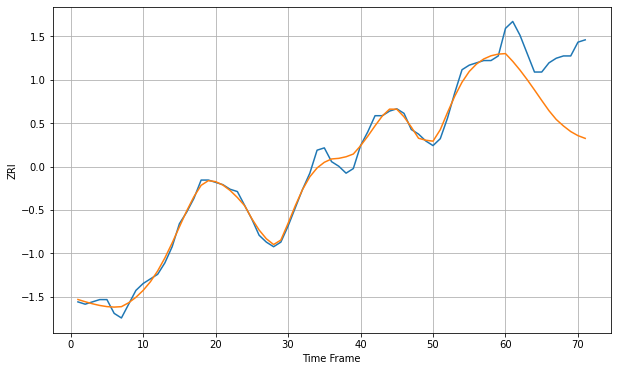

Wall time: 10.1 s
63118 2.6426458037291245 25.229754618588107 [734.02040454 730.64944662 726.8421154  722.65649396 718.19932557
 713.63804984 709.18055808 705.36822309 702.53822419 700.09830081
 698.3260543  697.13654338]

Got an mse at 0.0050 in round 266 and stopped training



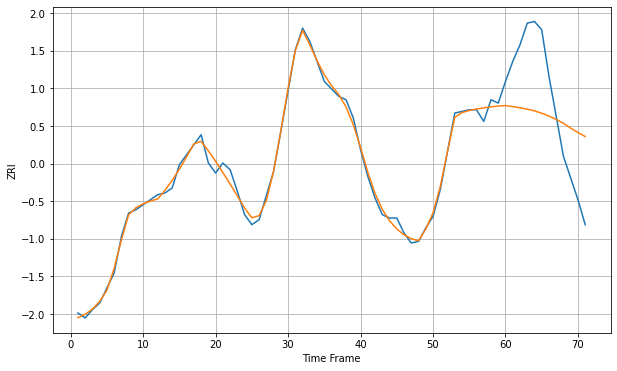

Wall time: 10.6 s
63130 3.1829847557894624 37.32354737340975 [1030.52039883 1029.88476445 1029.19853964 1028.37254723 1027.31718759
 1025.94952617 1024.22338921 1022.17890533 1019.87089304 1016.96680601
 1014.32167213 1011.94421732]

Got an mse at 0.0050 in round 326 and stopped training



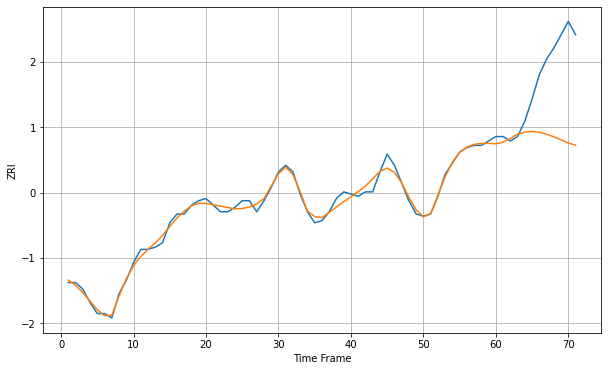

Wall time: 11.9 s
63139 2.074516763698354 30.90563781695837 [802.71240986 803.41472829 805.17200006 807.08340911 807.98110646
 808.29951487 807.91778623 807.05237404 805.88403148 804.53394537
 803.08277478 802.10384273]

Got an mse at 0.0050 in round 226 and stopped training



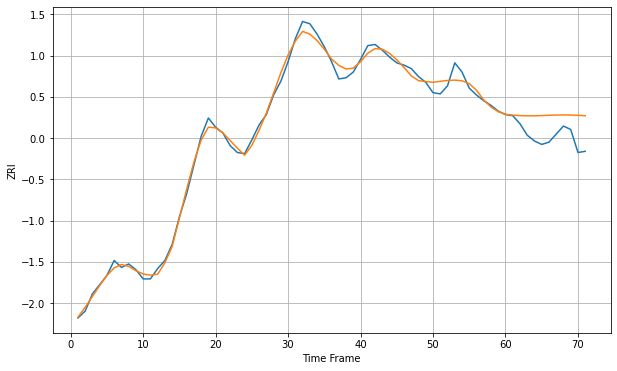

Wall time: 9.49 s
64111 5.028902804348828 19.417558335159796 [1011.28087436 1010.45431147 1010.08745826 1009.90098764 1009.91915256
 1010.10333234 1010.35739817 1010.56866613 1010.65558891 1010.58455226
 1010.35383518 1009.97177473]


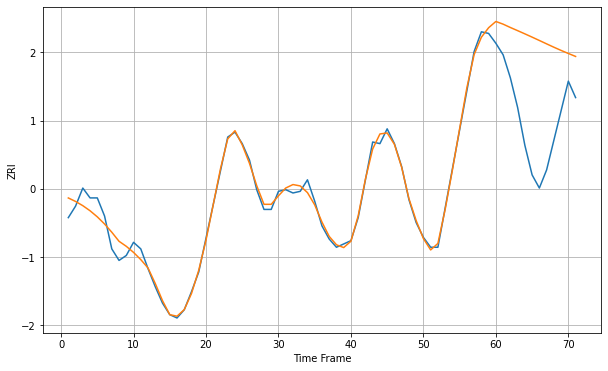

Wall time: 15.9 s
64801 4.327699317768844 53.723558870221126 [834.27952868 832.64200307 830.61190831 828.69920579 826.74787282
 824.7561833  822.72155698 820.66328661 818.6296747  816.67526702
 814.8191112  813.01813018]


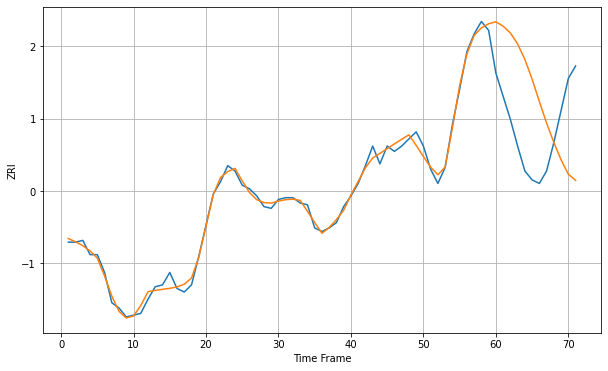

Wall time: 16.1 s
64804 3.0930274742056576 46.37014881812732 [868.8173103  866.35108031 862.55679237 856.39531647 847.70125337
 836.62737452 823.9898251  811.88725449 801.03979083 791.25313645
 783.19754694 779.72971197]


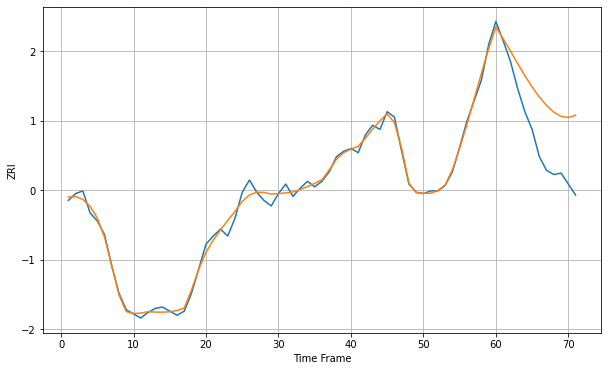

Wall time: 16.1 s
64834 3.7813843624522194 36.29859057693485 [915.98753289 907.4911677  898.43862618 889.23948696 880.32771862
 872.06812697 864.71896274 858.47790166 853.59123643 850.47766622
 849.70748075 851.39061715]


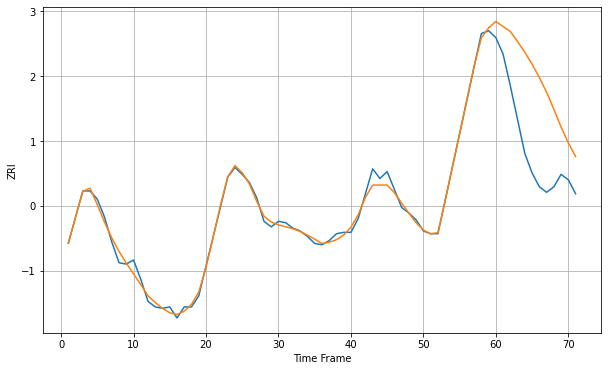

Wall time: 15.8 s
64836 3.4571004029264745 53.36174637571644 [876.71654553 873.03175415 869.45347823 862.11373982 854.33460571
 845.81114133 836.09253062 825.4886748  813.18103941 800.2711544
 788.77490713 778.87669977]

Got an mse at 0.0050 in round 186 and stopped training



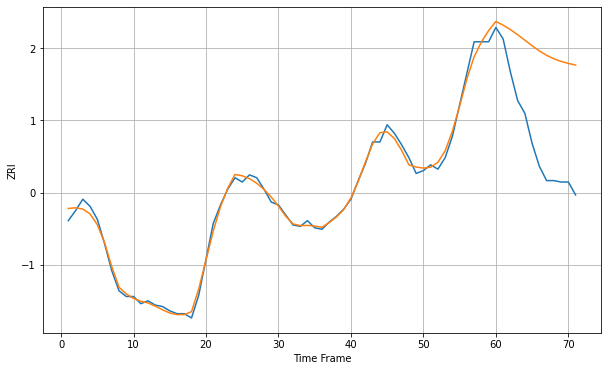

Wall time: 8.92 s
64870 3.537331898412291 67.06765200327138 [897.19631474 894.62060056 891.51621688 887.96165725 884.11152009
 880.22264427 876.61565418 873.55202196 871.12588892 869.27413033
 867.86301182 866.7590859 ]


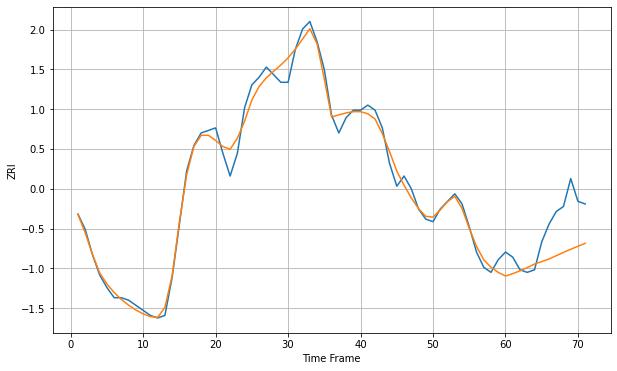

Wall time: 15.7 s
65201 3.472464641320488 14.004950517278342 [776.55847984 777.49099505 778.59637113 779.87066867 781.27881402
 782.25947598 783.26578931 784.57746133 785.86919043 787.1100099
 788.30426772 789.45995318]


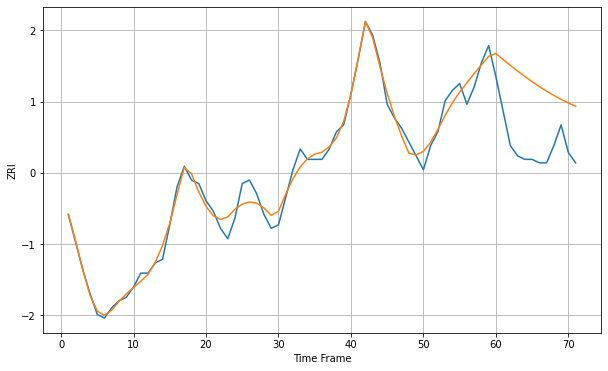

Wall time: 15.8 s
65202 2.657684389048238 18.63130638617576 [796.71795516 794.97206289 793.26712826 791.61787452 790.03682282
 788.53395867 787.11659825 785.78943336 784.55472039 783.41257152
 782.36130568 781.39782103]


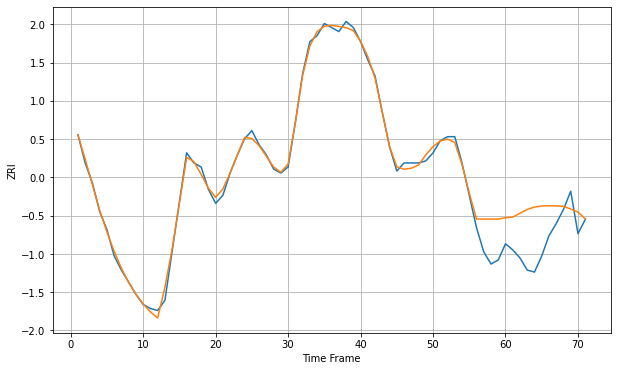

Wall time: 15.4 s
65203 4.870362285907837 18.15371802409739 [825.86298905 826.22929541 828.1011136  830.01464447 831.18052145
 831.70223515 831.82933308 831.74875424 831.53568187 830.21498819
 828.70456295 825.38274405]


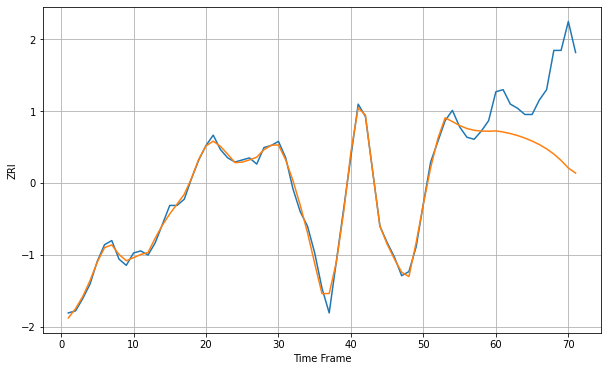

Wall time: 15.9 s
66061 2.550482708271065 37.09305694571002 [1007.05107823 1006.52491404 1005.77095876 1004.79300438 1003.59109355
 1002.15278318 1000.44058757  998.38000414  995.8612029   992.775375
  989.09664793  986.67002672]

Got an mse at 0.0050 in round 422 and stopped training



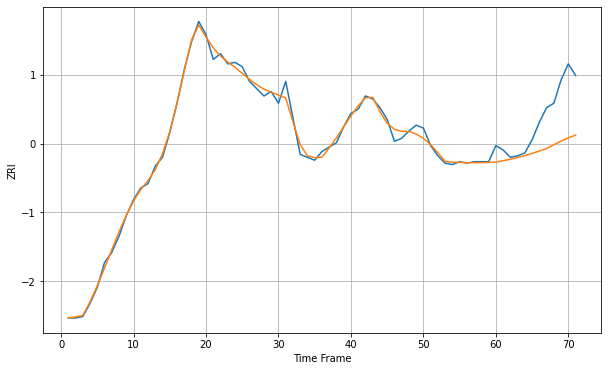

Wall time: 14.5 s
66213 3.3091263416409533 26.206816827271812 [1020.76543554 1021.6623916  1022.65865839 1023.79436322 1025.12021834
 1026.65752889 1028.32835183 1029.95115406 1032.6401759  1035.13102419
 1037.3061648  1039.17628442]

Got an mse at 0.0049 in round 44 and stopped training



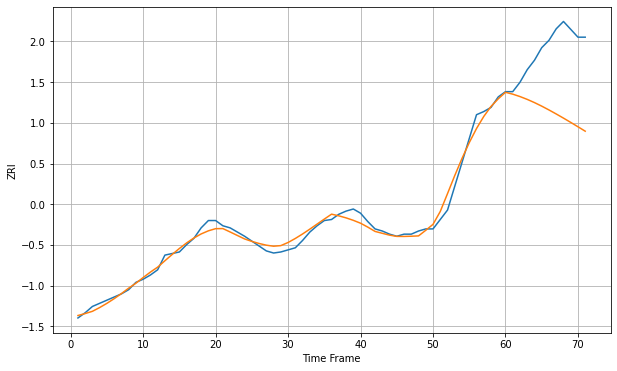

Wall time: 5.82 s
66214 5.29215158810134 63.59950095942468 [847.38848837 845.61580247 843.32500686 840.62345548 837.55969374
 834.18038724 830.53173968 826.70714798 822.7529649  818.66941139
 814.49666573 810.2701158 ]

Got an mse at 0.0048 in round 319 and stopped training



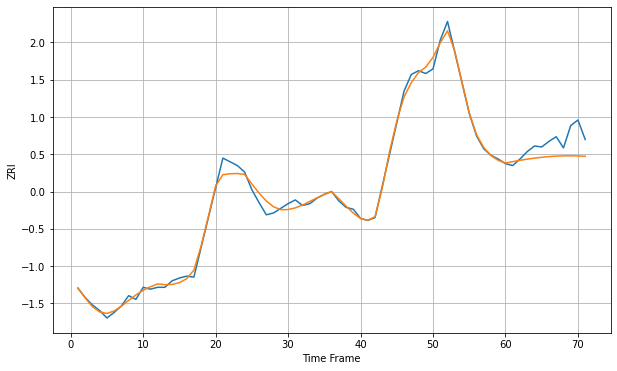

Wall time: 11.7 s
66215 5.532566261389269 18.352891500298753 [1032.69324533 1034.22445999 1035.60059253 1036.84274078 1037.94553189
 1038.88173361 1039.61566875 1040.12009013 1040.38794567 1040.4346134
 1040.29301636 1040.00657765]

Got an mse at 0.0050 in round 311 and stopped training



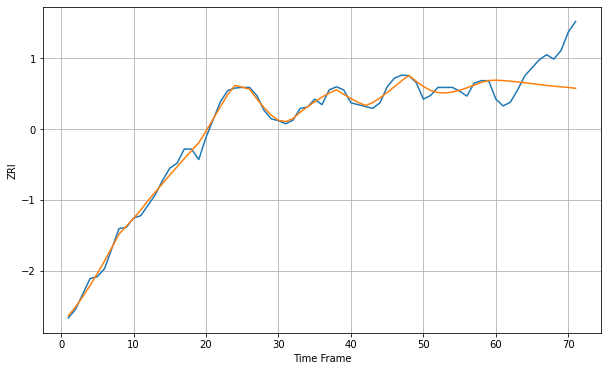

Wall time: 11.6 s
66223 8.114172594693942 53.34744488930593 [1436.75132266 1436.10684933 1435.12004027 1433.90408051 1432.5475171
 1431.11826242 1429.67533232 1428.28230736 1427.01311802 1425.94054621
 1424.88378181 1423.63699881]

Got an mse at 0.0050 in round 262 and stopped training



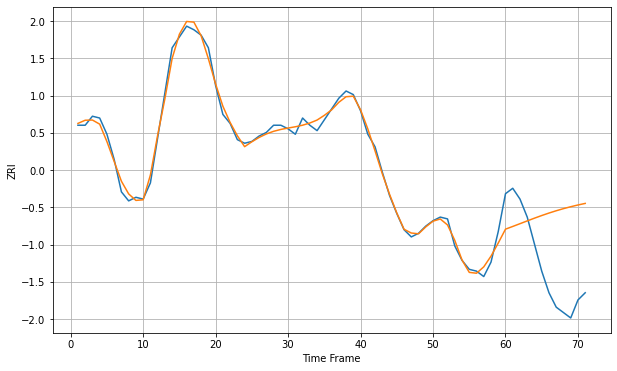

Wall time: 10.5 s
66502 2.8922449382895223 40.20055630386877 [821.30603056 822.80787199 824.34374476 825.88952754 827.41016733
 828.87095117 830.24620193 831.52155767 832.69195317 833.7583212
 834.72472831 835.59647024]


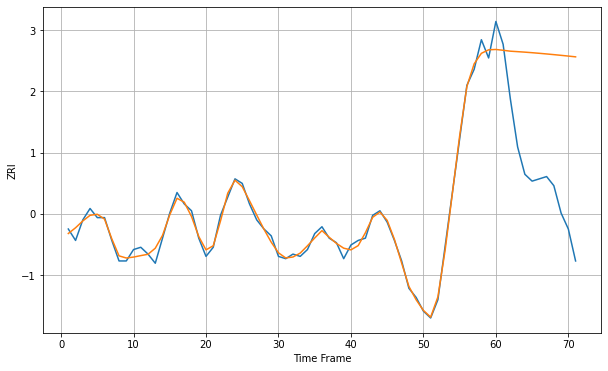

Wall time: 16 s
66614 2.214253874446122 54.87784547880836 [932.72274899 932.36943578 931.97154678 931.76309684 931.54766012
 931.30465843 931.03931337 930.75603448 930.45811974 930.14757181
 929.82505561 929.48998439]


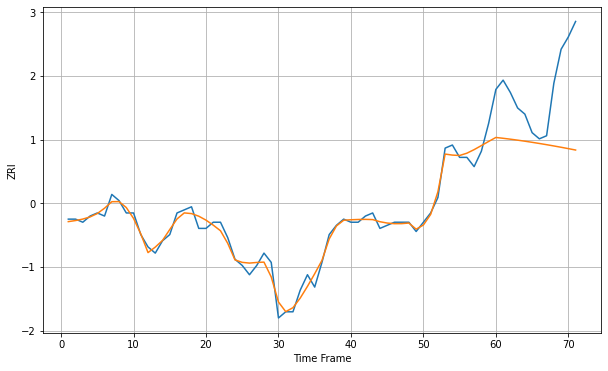

Wall time: 15.8 s
67218 2.232620925228062 21.390775797188446 [646.44448867 646.17848774 645.88682868 645.57128756 645.23367215
 644.87573541 644.49909333 644.1051506  643.69503777 643.26956525
 642.82920548 642.37412512]


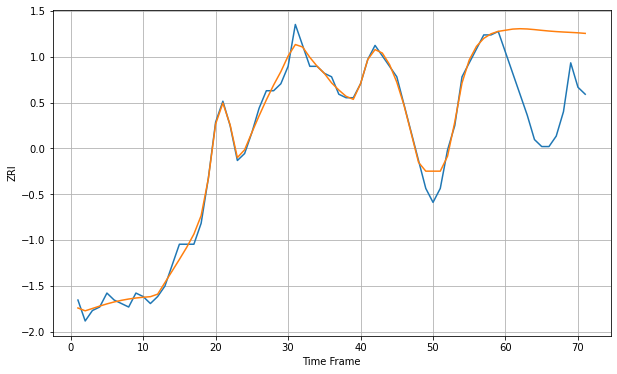

Wall time: 16 s
72205 2.252189045668299 23.107023106305604 [744.34677552 744.67633053 744.78210963 744.70687312 744.52643871
 744.31317844 744.11599845 743.95629085 743.83229505 743.72583723
 743.60803068 743.44272344]

Got an mse at 0.0050 in round 292 and stopped training



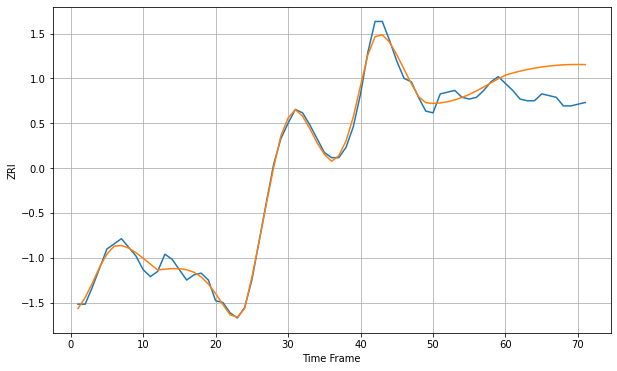

Wall time: 11.5 s
72712 3.6590434611250124 18.517889982623988 [931.87579273 933.09652962 934.17764643 935.12046037 935.92708473
 936.6000936  937.14227574 937.556371   937.84483758 938.0097255
 938.05268143 937.97505635]


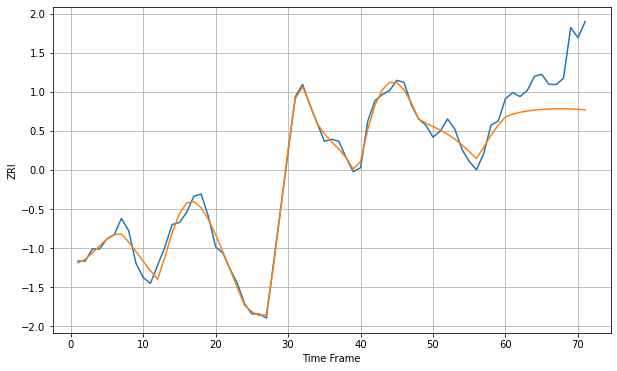

Wall time: 16.2 s
72764 3.626715630279542 22.701726575777116 [915.04359555 916.32825787 917.24884348 917.90802283 918.37527211
 918.69526203 918.89595431 918.99463807 919.00198259 918.92461541
 918.76671514 918.5309826 ]


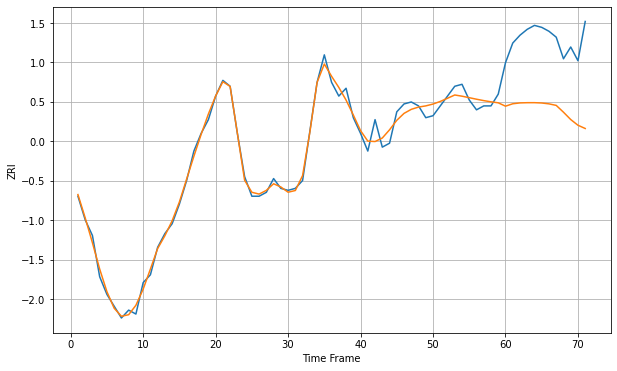

Wall time: 16 s
73071 3.4146901900095856 36.27637763547669 [848.85901991 850.08721712 850.51840977 850.63230718 850.64415181
 850.47901429 850.04205055 849.26246529 845.79295224 842.05420384
 839.15113178 837.49348389]

Got an mse at 0.0049 in round 342 and stopped training



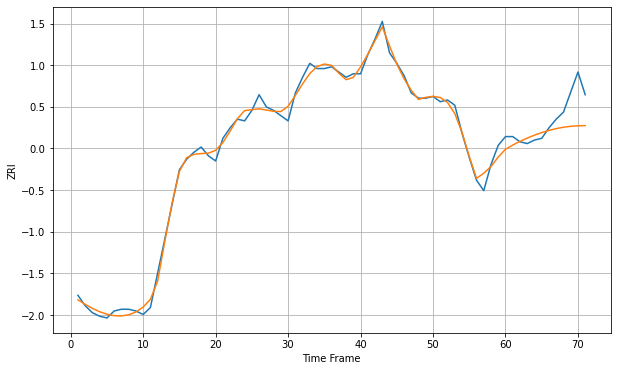

Wall time: 12.7 s
73159 3.3382990329254474 12.448310121436295 [696.75119541 699.146344   701.26835015 703.1476827  704.81478281
 706.28444534 707.54782805 708.57928571 709.35713405 709.88198097
 710.17895307 710.28741213]


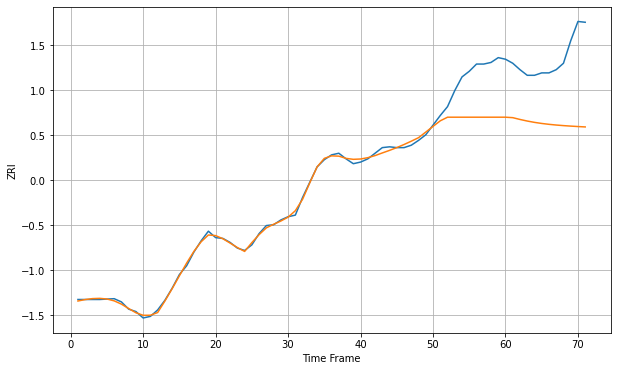

Wall time: 16.2 s
75001 21.127681524037417 83.90235637443358 [1223.85893359 1223.28723731 1221.05108266 1219.07892814 1217.423163
 1216.07350218 1214.98671872 1214.10879272 1213.3870607  1212.77558105
 1212.23688253 1211.74195078]

Got an mse at 0.0050 in round 214 and stopped training



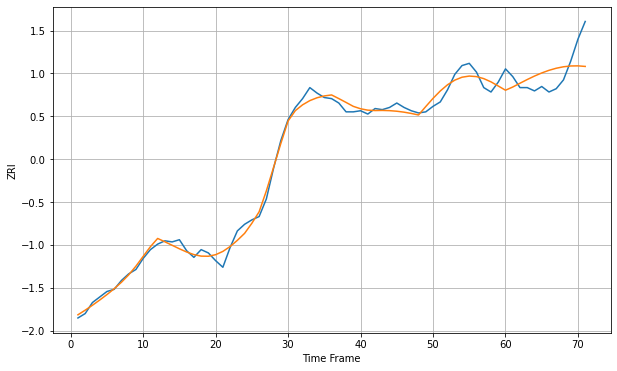

Wall time: 9.77 s
75010 5.475395162161204 18.284929289876732 [1249.62893014 1252.53240842 1255.95952614 1259.32032296 1262.46979819
 1265.2868699  1267.67632879 1269.56365748 1270.89117216 1271.6184597
 1271.72471434 1271.20946478]

Got an mse at 0.0050 in round 229 and stopped training



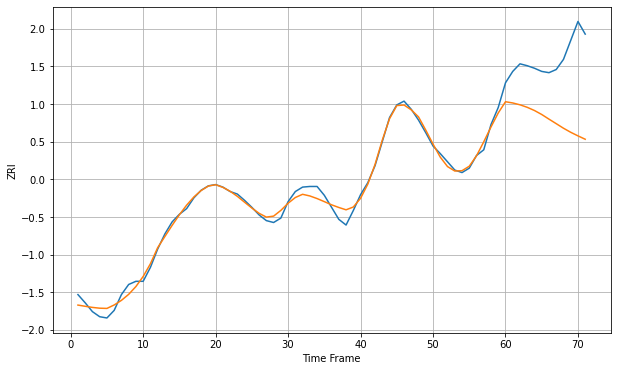

Wall time: 9.81 s
75013 8.346537602817376 102.93065554889192 [1432.0339886  1430.08859992 1427.17987603 1423.20078279 1418.12757475
 1411.85034713 1404.50109684 1397.35051845 1390.14106741 1383.70693673
 1378.0469035  1372.69377764]

Got an mse at 0.0050 in round 97 and stopped training



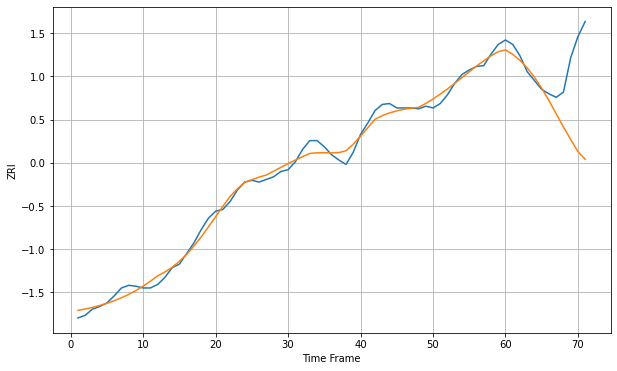

Wall time: 7.41 s
75024 6.849484630162117 66.05367618899338 [1364.7292315  1359.70066632 1352.93200272 1344.27356518 1333.72872975
 1321.294946   1307.27795902 1292.32010121 1277.33052663 1263.2833868
 1249.41214056 1240.75970693]

Got an mse at 0.0050 in round 143 and stopped training



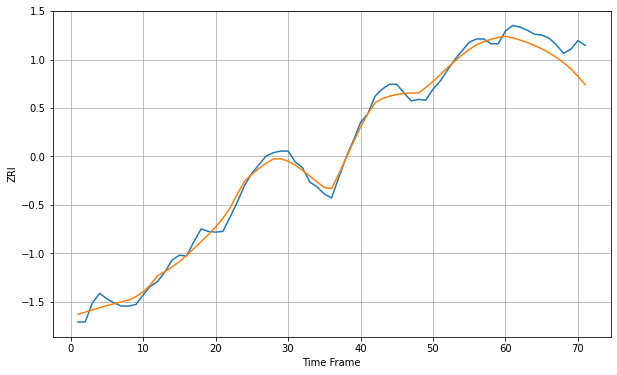

Wall time: 8.48 s
75039 8.555294838926581 24.34454883727188 [1531.47672932 1529.31212572 1526.68806394 1523.56856025 1519.90305814
 1515.62378733 1510.6460598  1504.87659498 1498.23688191 1490.64998704
 1480.86625208 1470.47044801]

Got an mse at 0.0050 in round 177 and stopped training



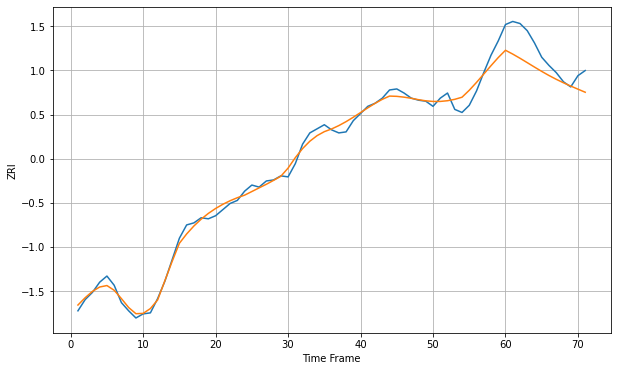

Wall time: 9.2 s
75050 6.048750494528436 21.015479982995917 [1179.83229617 1176.09687215 1172.01405324 1167.72835725 1163.39279462
 1159.15831955 1155.15130279 1151.44217089 1148.02561757 1144.83390402
 1141.77704127 1138.78123451]

Got an mse at 0.0050 in round 213 and stopped training



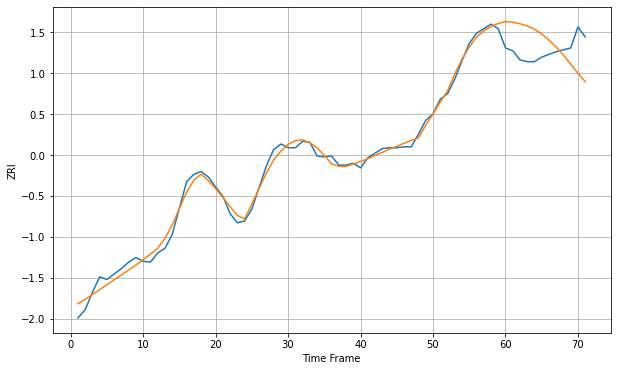

Wall time: 9.7 s
75052 6.2814005836404325 32.07039701540918 [1148.9475137  1148.10287123 1146.47186984 1143.95246182 1140.41668743
 1135.31637084 1128.56905034 1120.90657135 1112.04719167 1102.16441185
 1092.45637562 1083.09680799]

Got an mse at 0.0049 in round 254 and stopped training



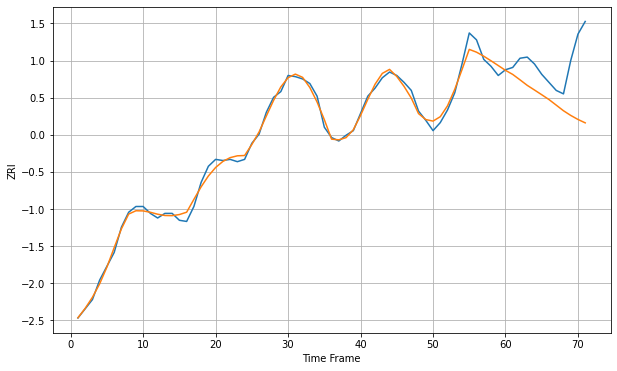

Wall time: 10.8 s
75056 4.503593230270527 38.73301163466164 [1362.47250123 1358.90904632 1354.22022174 1349.40852599 1345.35596554
 1341.24917573 1337.05242337 1332.20534646 1327.3222067  1323.25225433
 1319.73786642 1316.77852266]

Got an mse at 0.0049 in round 46 and stopped training



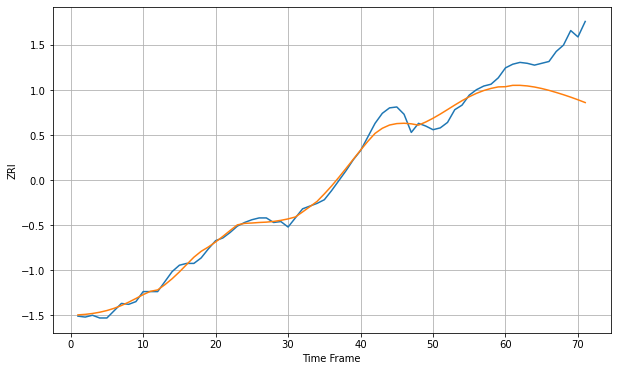

Wall time: 6.01 s
75063 6.859182338092558 48.019841530450186 [1220.27121217 1221.77291114 1221.7705206  1221.125446   1219.92968307
 1218.28144847 1216.26409384 1213.93742586 1211.4627122  1208.78418692
 1205.8986808  1202.83135723]

Got an mse at 0.0049 in round 56 and stopped training



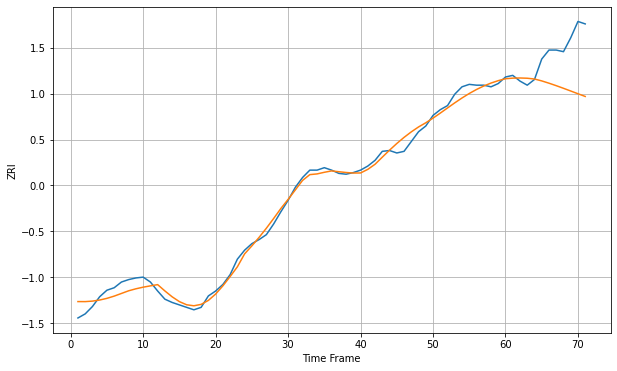

Wall time: 6.16 s
75067 7.767245388202703 46.84474580007763 [1210.88852364 1211.61425606 1211.80198466 1211.49960265 1210.54680685
 1208.23592885 1205.43465848 1202.39526899 1199.1822917  1195.86471922
 1192.51355972 1189.19725968]

Got an mse at 0.0050 in round 378 and stopped training



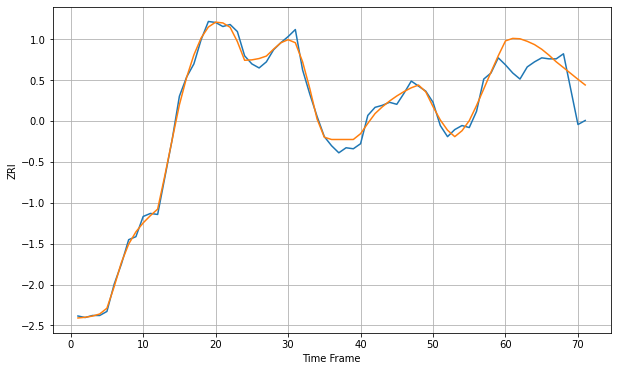

Wall time: 13.3 s
75070 5.689272648945163 25.859795927417398 [1584.80311205 1587.25166591 1586.86894126 1584.35816975 1581.12270251
 1576.49907868 1570.65042896 1564.06598024 1558.36358931 1552.55309615
 1546.74904872 1541.13874348]

Got an mse at 0.0050 in round 83 and stopped training



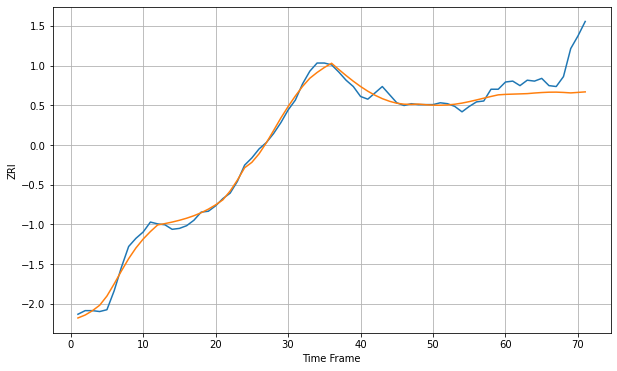

Wall time: 6.95 s
75074 6.139135062173951 34.03706497498177 [1244.3132324  1244.59424092 1244.85854096 1245.14412    1245.82354317
 1246.35793557 1246.7234589  1246.79715042 1246.46334846 1245.94434616
 1246.4970793  1247.07168965]

Got an mse at 0.0050 in round 63 and stopped training



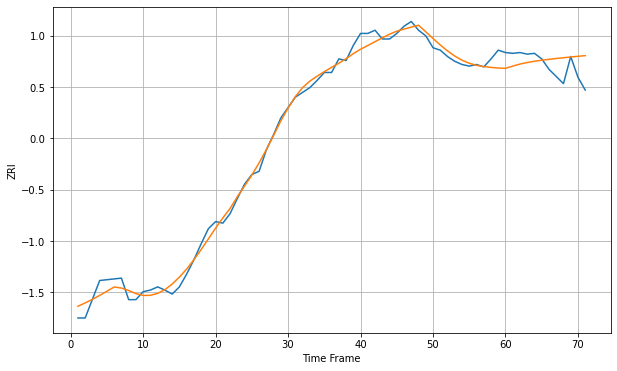

Wall time: 6.49 s
75081 9.03406064649263 21.095836252465833 [1277.19760111 1279.99113189 1282.57173385 1284.48467456 1286.0629288
 1287.39310011 1288.48670156 1289.52101622 1290.49860414 1291.42354333
 1292.30059239 1293.13457733]

Got an mse at 0.0049 in round 84 and stopped training



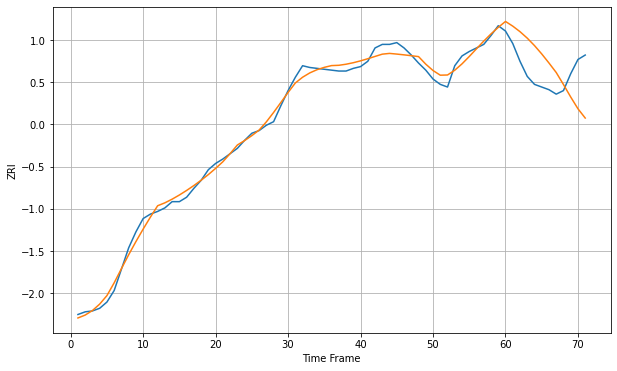

Wall time: 6.89 s
75093 6.640855474629278 37.73731258154834 [1420.79773851 1415.55307333 1409.32952024 1402.04306324 1393.66000176
 1384.24989267 1374.0265851  1363.33975176 1349.81419332 1335.75725442
 1322.53295441 1312.09652036]

Got an mse at 0.0050 in round 164 and stopped training



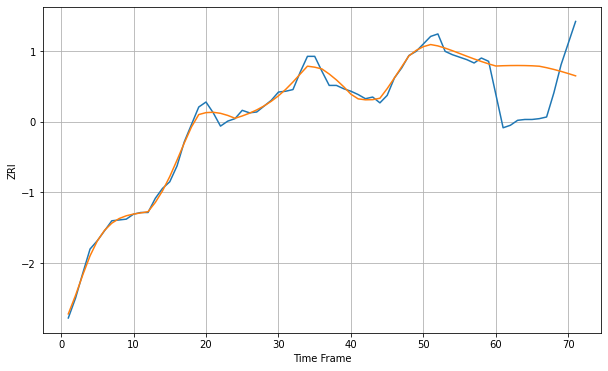

Wall time: 8.46 s
75201 5.987614347851722 56.7717798715123 [1672.36014421 1672.71148946 1672.91730434 1672.97523615 1672.88157379
 1672.63132641 1672.10538218 1670.33560734 1668.24896912 1665.87405053
 1663.27109783 1660.5302729 ]


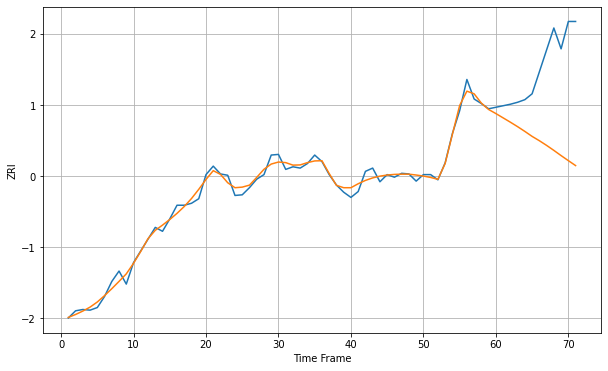

Wall time: 16.4 s
75202 8.174097543285015 128.61718160464022 [1597.66778749 1591.06120335 1584.43040781 1577.55180027 1570.27103447
 1562.64489925 1556.01237928 1548.82826957 1541.16720079 1533.16933458
 1525.43929175 1517.85676632]

Got an mse at 0.0050 in round 79 and stopped training



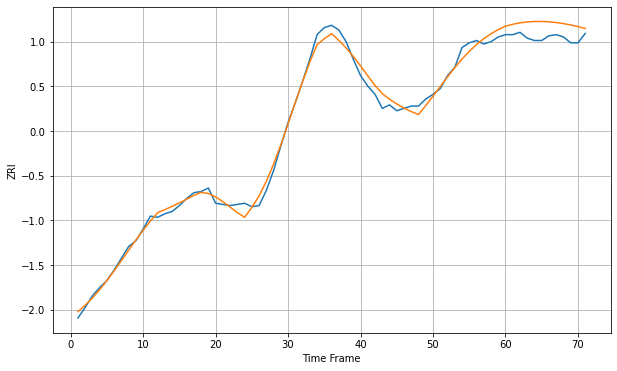

Wall time: 6.72 s
75204 5.3226420913975 12.034766219465832 [1517.21518052 1518.84367918 1520.0445059  1520.82963284 1521.22176746
 1521.25005335 1520.94523931 1520.33511459 1519.4414698  1518.27977314
 1516.8706924  1515.27746998]

Got an mse at 0.0050 in round 193 and stopped training



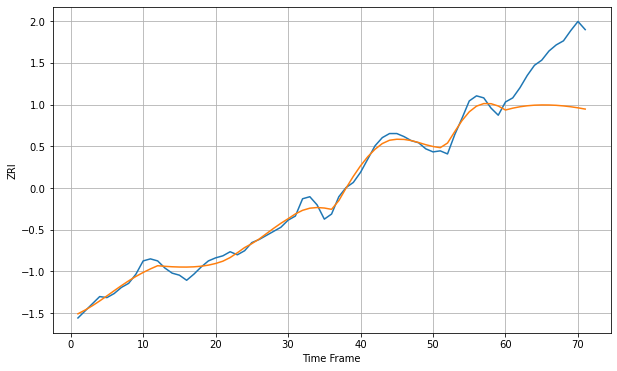

Wall time: 9.01 s
75206 5.749802657922828 53.31661575392961 [1374.09572562 1375.90946452 1377.28969983 1378.25753572 1378.8404251
 1379.06921231 1379.02698184 1378.70273681 1378.11707072 1377.29379346
 1376.25203129 1375.00643889]


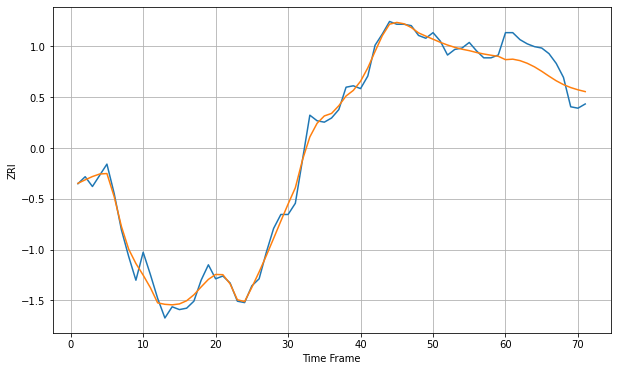

Wall time: 16.2 s
75214 5.511915628171616 14.47844992391555 [1215.69365026 1216.04952767 1215.0013587  1213.10587071 1210.54111556
 1207.36696839 1203.88775362 1200.59329385 1197.85550578 1195.74751923
 1194.13847511 1192.84968815]

Got an mse at 0.0050 in round 142 and stopped training



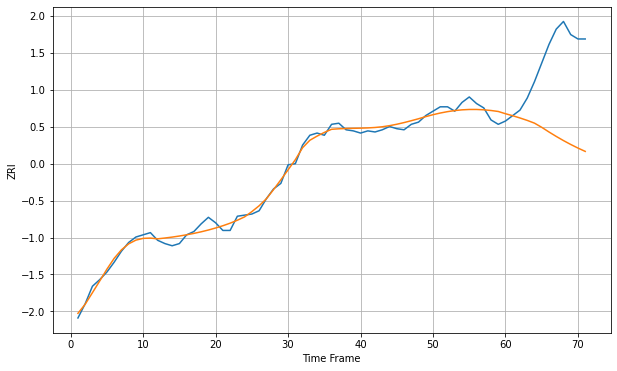

Wall time: 7.91 s
75219 4.753001586711722 72.94917342461942 [1451.67014135 1449.83726066 1447.79044153 1445.57678196 1443.06300952
 1439.24458664 1434.98729817 1430.94000647 1427.13264942 1423.581076
 1420.28878576 1417.24891823]

Got an mse at 0.0050 in round 95 and stopped training



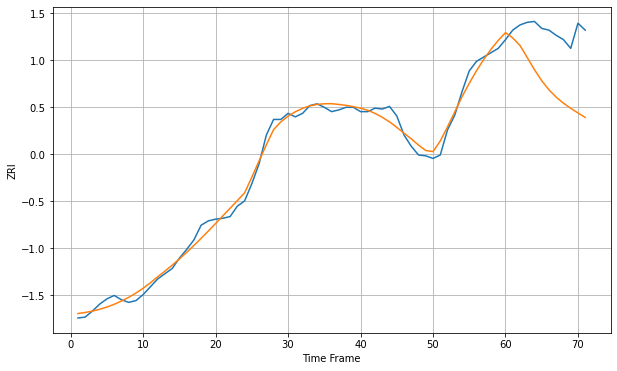

Wall time: 6.85 s
75235 7.621734085288394 64.50734114219563 [1467.11058594 1461.03078606 1452.30842661 1438.4261393  1424.32794216
 1411.64436373 1401.12562434 1392.65093367 1385.72519145 1379.81654728
 1374.47254504 1369.34923677]

Got an mse at 0.0048 in round 60 and stopped training



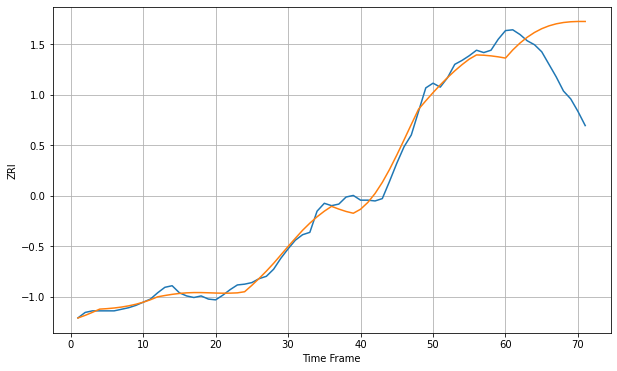

Wall time: 5.93 s
75243 8.746976178464479 69.58660531822561 [1134.98052733 1145.3069238  1154.13174717 1161.54265506 1167.61105871
 1172.41246021 1176.04152998 1178.61985519 1180.29607657 1181.23857186
 1181.62229195 1181.61330689]

Got an mse at 0.0048 in round 44 and stopped training



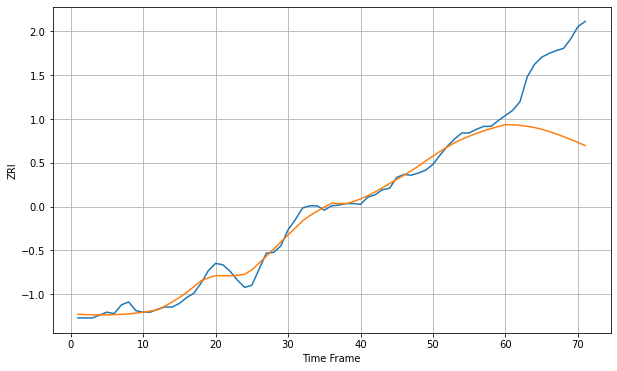

Wall time: 5.98 s
75244 8.226629952160494 106.48899401213951 [1371.3788344  1371.18928977 1370.4114395  1369.15563538 1367.42391002
 1364.98415014 1362.05015013 1358.67778844 1354.9536042  1350.97972702
 1346.85075374 1342.63411315]

Got an mse at 0.0050 in round 176 and stopped training



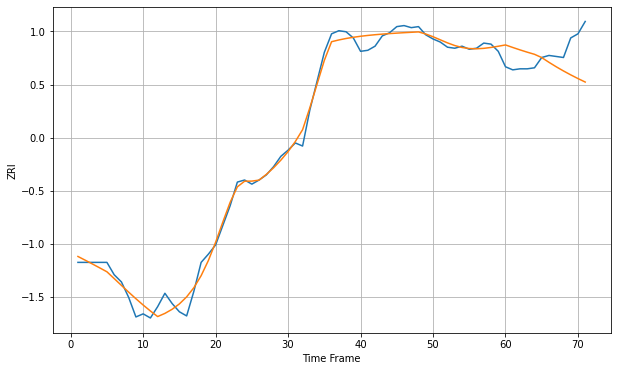

Wall time: 8.96 s
75248 7.279624522322136 26.842098723597303 [1284.19784143 1281.7530123  1279.39627461 1277.17278944 1275.10715288
 1271.92464463 1267.31608947 1262.98810883 1258.93652734 1255.13471955
 1251.55117364 1248.16152473]

Got an mse at 0.0050 in round 115 and stopped training



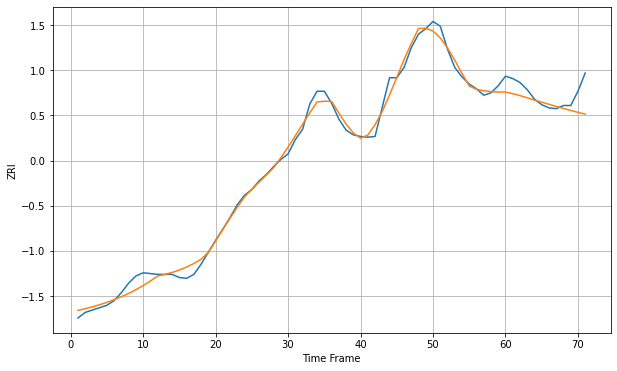

Wall time: 7.48 s
75287 8.000318192408526 19.648014788851118 [1147.96115852 1145.92420895 1143.50105636 1140.75278997 1137.74942806
 1135.17921854 1132.54770825 1129.89460584 1127.28269109 1124.7646442
 1122.38026894 1120.15568969]

Got an mse at 0.0050 in round 144 and stopped training



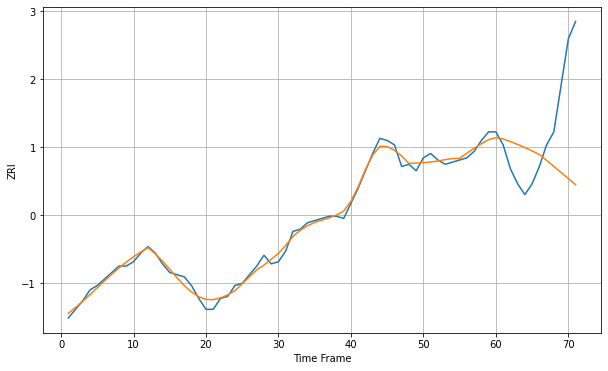

Wall time: 7.93 s
75703 2.214543484149456 32.94175291289723 [906.32515925 905.71638019 904.51679562 903.19222882 901.75064216
 900.19801525 898.51158009 895.79617084 893.03607178 890.23912336
 887.41687091 884.59018872]

Got an mse at 0.0049 in round 87 and stopped training



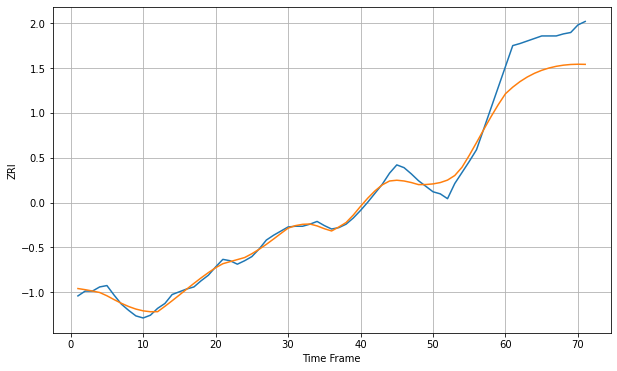

Wall time: 7.07 s
76006 9.015930425601 51.18274164927061 [1014.25483193 1023.74502965 1031.77340788 1038.43331188 1043.85374588
 1048.16728138 1051.49698816 1053.95275495 1055.63130374 1056.61738309
 1056.9852927  1056.80053203]

Got an mse at 0.0050 in round 157 and stopped training



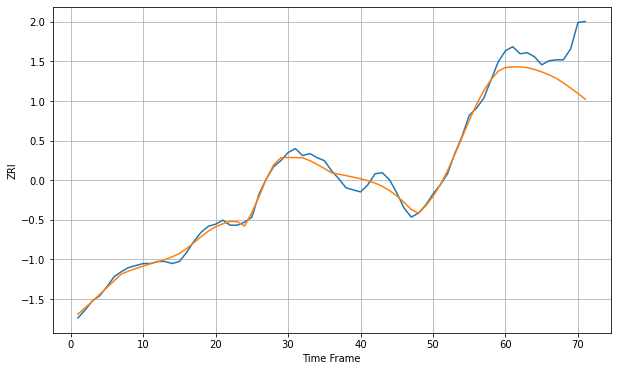

Wall time: 8.49 s
76010 5.5198069649894155 35.04893070509818 [1075.39293919 1075.91109061 1076.02277443 1075.2162501  1073.3944708
 1070.98457444 1068.17394019 1064.652822   1059.98687168 1054.95335748
 1049.60304526 1044.00042798]


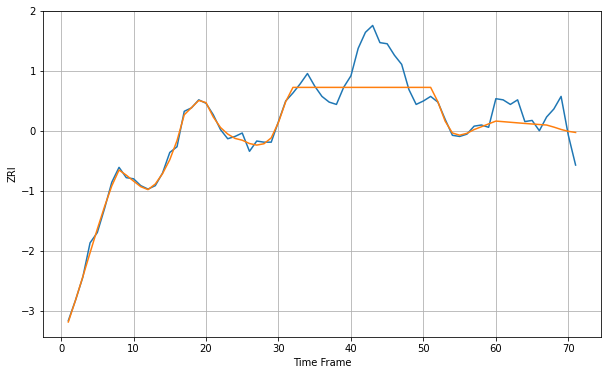

Wall time: 16.1 s
76012 14.328667442134252 16.819214912834415 [1208.43332257 1207.92584953 1207.40160295 1206.88013392 1206.37677806
 1205.89620553 1205.43239567 1204.98394018 1203.18044706 1201.11532743
 1199.46388121 1198.49998868]

Got an mse at 0.0050 in round 304 and stopped training



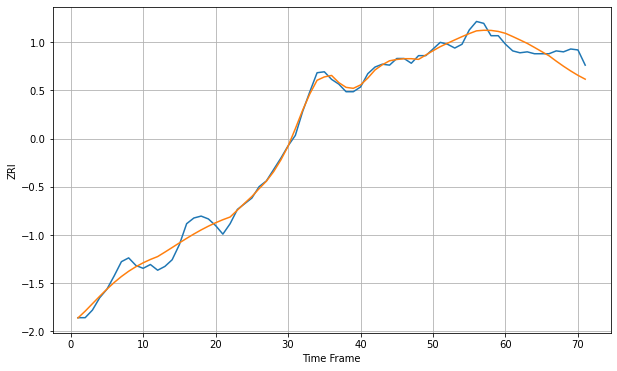

Wall time: 11.4 s
76015 7.165804894642489 14.41025732181767 [1291.49421853 1288.10330025 1284.55265525 1280.92020607 1276.64224885
 1272.25031102 1267.89750581 1262.22979498 1256.85859935 1251.85549254
 1247.25631183 1243.21356531]

Got an mse at 0.0050 in round 80 and stopped training



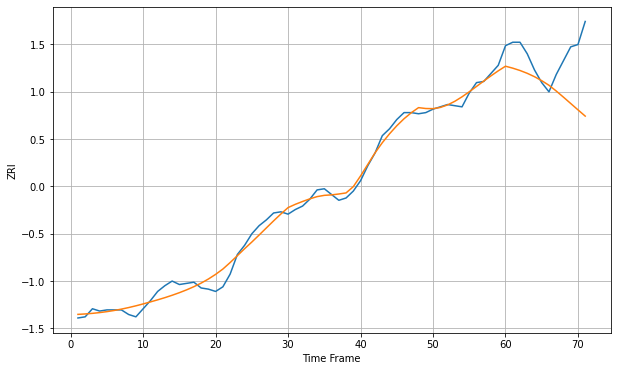

Wall time: 6.64 s
76017 5.7791912745597 35.736856040651205 [1056.2116376  1054.53064104 1052.50952997 1050.06713163 1047.13319799
 1043.6707959  1039.69448374 1034.72249402 1029.38280883 1023.8943833
 1018.39375752 1012.97005931]

Got an mse at 0.0050 in round 205 and stopped training



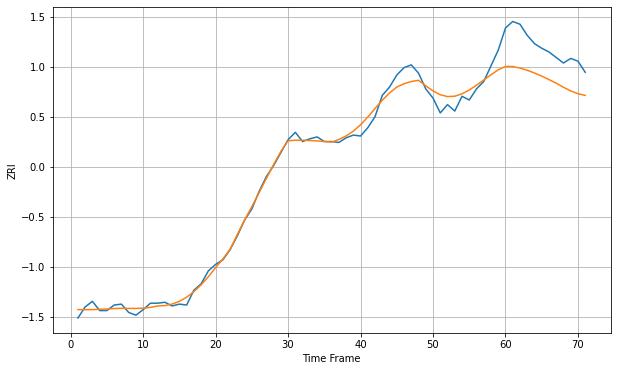

Wall time: 9.35 s
76039 7.577010439760216 35.56405166190717 [1258.33451206 1258.21656693 1256.55132982 1254.15776817 1251.21836513
 1247.83908972 1244.0875194  1240.18137088 1235.76019967 1231.83360333
 1228.80892745 1226.97252312]

Got an mse at 0.0050 in round 132 and stopped training



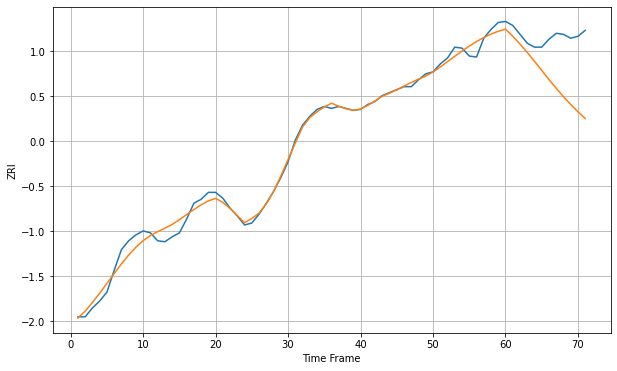

Wall time: 7.71 s
76051 6.3784873671977955 48.4578399097755 [1399.21226205 1392.02664492 1384.13474605 1375.64110666 1366.6900128
 1357.47034679 1348.21435063 1339.3049801  1330.85761773 1322.92577534
 1315.56525467 1308.7813675 ]

Got an mse at 0.0050 in round 273 and stopped training



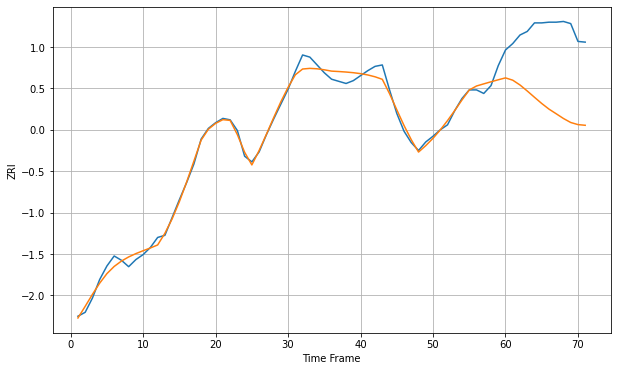

Wall time: 10.8 s
76107 8.158548769073612 106.50801621665332 [1293.84705475 1290.62278773 1283.89028465 1275.47962697 1266.63211553
 1257.93464838 1250.03725531 1243.49594393 1236.87002545 1231.27099589
 1228.31788187 1227.34907437]

Got an mse at 0.0050 in round 289 and stopped training



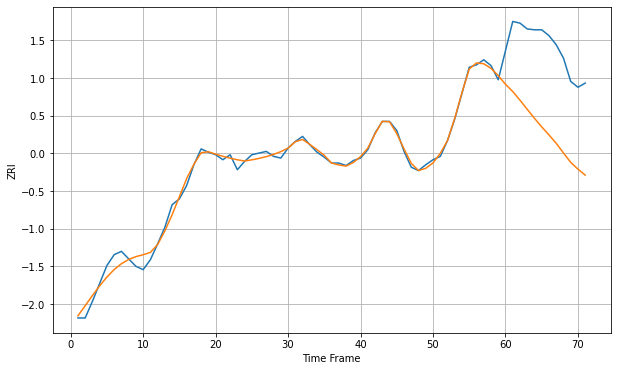

Wall time: 11.3 s
76108 6.343897888862162 101.63858070536925 [1114.53921883 1105.86752212 1095.4916437  1084.50010398 1073.69442464
 1063.44206763 1053.80457602 1043.71105972 1032.09602578 1020.84131207
 1012.65269445 1005.51529265]

Got an mse at 0.0050 in round 178 and stopped training



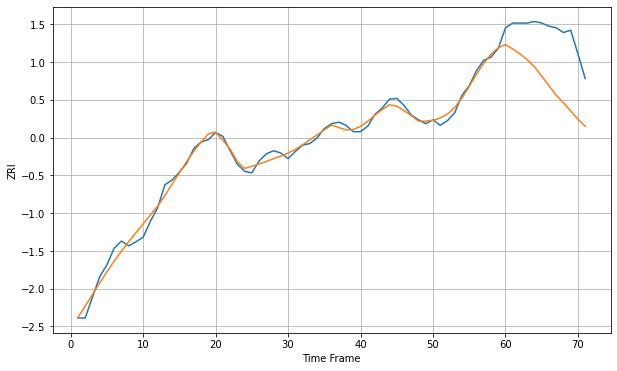

Wall time: 8.71 s
76116 6.711288808289069 67.3194119356929 [1183.67686463 1178.28703529 1171.99875464 1164.78973545 1155.87429911
 1144.15819457 1131.89717373 1119.91494014 1110.61465237 1099.96392155
 1089.93119586 1080.73521216]

Got an mse at 0.0050 in round 92 and stopped training



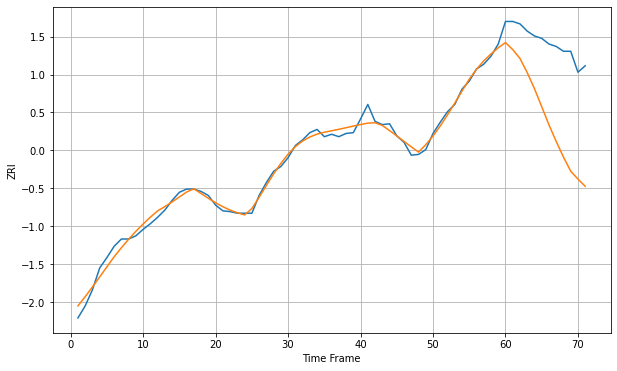

Wall time: 6.8 s
76132 6.609348161901397 100.50962228166057 [1298.76266571 1290.09540825 1279.02607525 1261.53651321 1241.50743772
 1219.20452066 1196.59951365 1176.07689613 1156.68612223 1139.17392359
 1129.38471081 1120.40314984]

Got an mse at 0.0050 in round 57 and stopped training



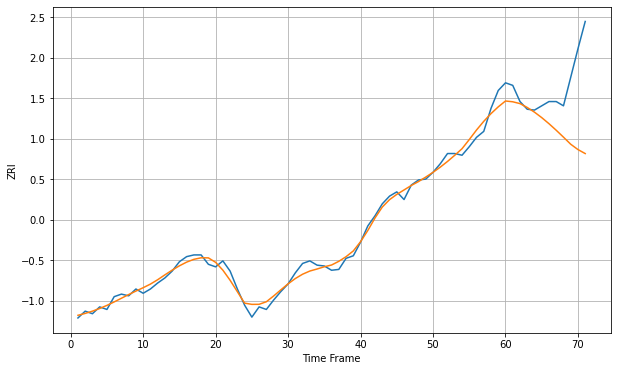

Wall time: 5.89 s
76133 6.643962152326189 63.51902879104784 [1045.65839972 1044.73276831 1042.60863767 1038.05660081 1032.53992539
 1026.1454385  1019.01226709 1011.30992366 1003.2185795   994.91340289
  988.65482744  983.96234158]

Got an mse at 0.0047 in round 38 and stopped training



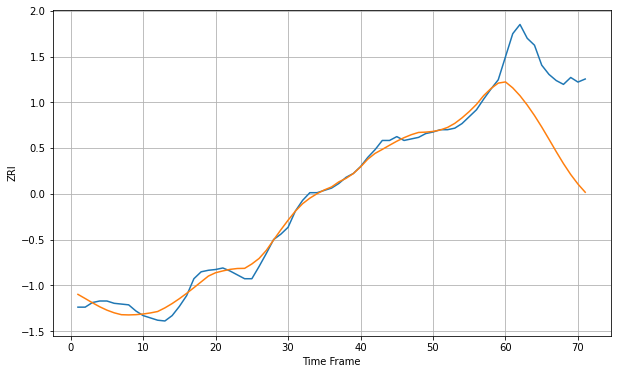

Wall time: 5.68 s
76137 8.09697528217533 99.46323346868684 [1273.19648277 1265.45409871 1255.26269787 1243.08704579 1229.45749397
 1214.50543753 1198.59701373 1182.42261606 1166.86478541 1152.6697268
 1140.22505259 1129.59200897]


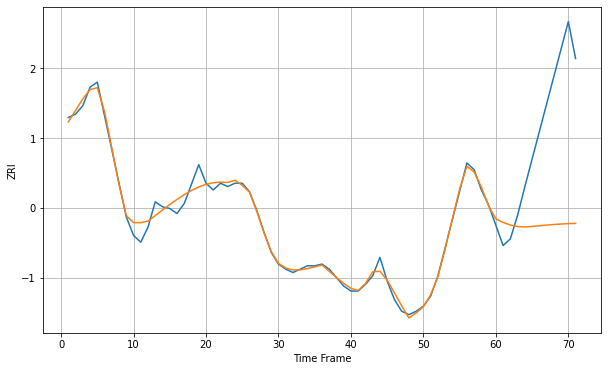

Wall time: 15.7 s
76522 3.6364483914220966 66.61394490972089 [598.8925372  596.71576841 595.21751484 594.27555671 594.03218249
 594.34452584 594.74447711 595.15126332 595.5139405  595.80560789
 596.01692432 596.15014024]


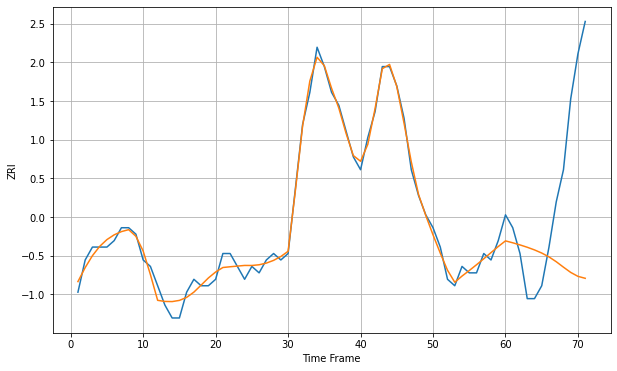

Wall time: 15.5 s
76543 1.1550660017751013 18.241684649898513 [589.96063579 589.66378492 589.33575373 588.97189219 588.55971112
 588.07367181 587.47432164 586.73043352 585.88092806 585.06679119
 584.45778064 584.15396992]

Got an mse at 0.0050 in round 181 and stopped training



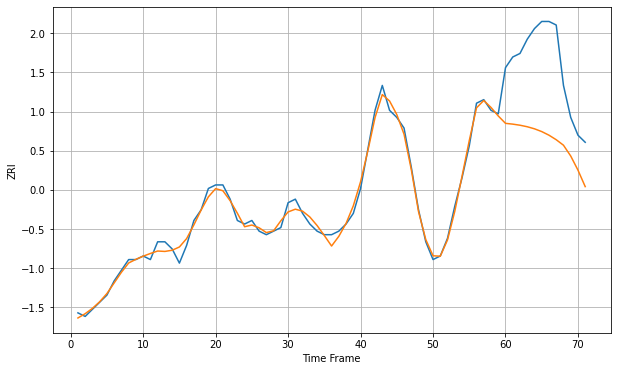

Wall time: 8.93 s
76549 1.548225191676376 22.530556415447293 [673.33239685 673.11080817 672.80314229 672.37672758 671.79357671
 671.01331215 669.99828965 668.7214573  667.17708169 664.13773158
 660.16730045 655.52821796]


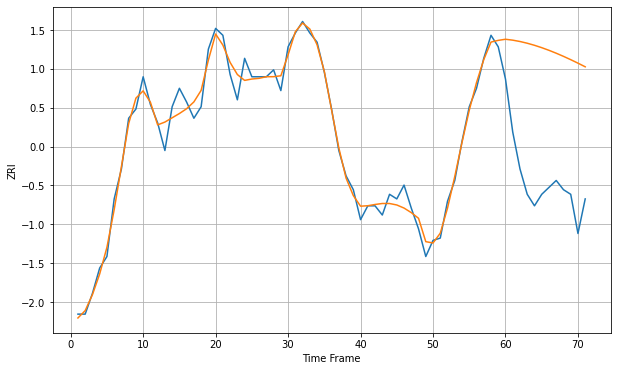

Wall time: 15.7 s
77004 4.466038472277909 57.91022473256448 [1415.280959   1414.88524325 1414.30227427 1413.5542138  1412.65849545
 1411.62936681 1410.47929465 1409.22002632 1407.8632487  1406.42093923
 1404.90554584 1403.33007395]


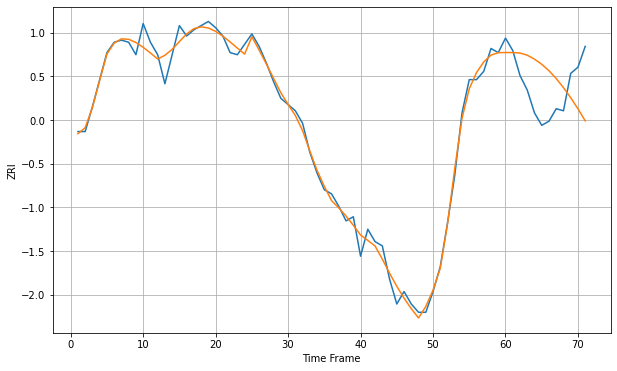

Wall time: 15.6 s
77006 4.058199199031162 19.84665654877949 [1422.03801101 1422.03238611 1421.79531166 1420.75995712 1418.84998255
 1416.38982369 1413.28864397 1409.5206755  1405.14987337 1400.2799232
 1394.96233677 1389.16876463]


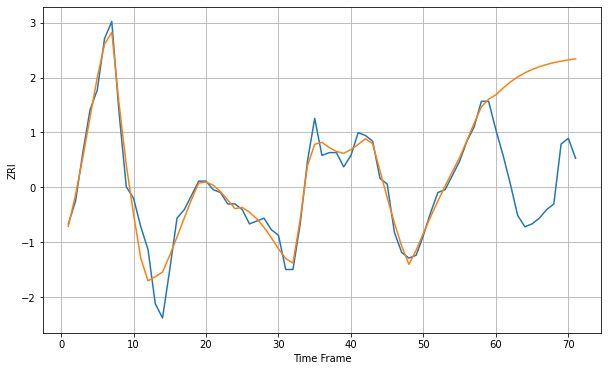

Wall time: 15.3 s
77007 4.403835216239824 41.708195149099986 [1497.26639786 1499.6536925  1501.75352399 1503.51757789 1504.96688088
 1506.1501917  1507.1170796  1507.90868539 1508.55709576 1509.08714057
 1509.51827992 1509.86605626]


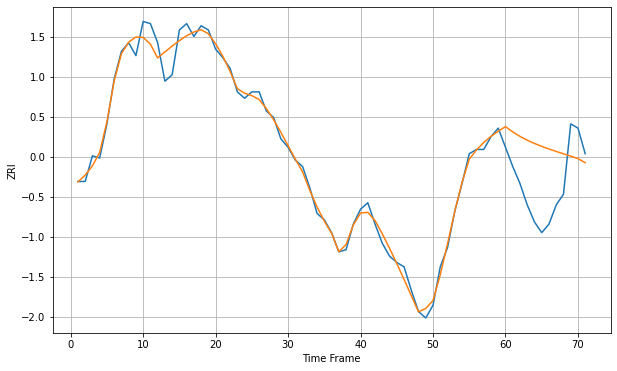

Wall time: 15.7 s
77019 4.085122729792002 24.892290511189394 [1414.6883063  1412.22243281 1410.12271088 1408.34289418 1406.8061425
 1405.44650271 1404.21229268 1403.06093544 1401.95457437 1400.8572911
 1399.7332351  1397.79387325]


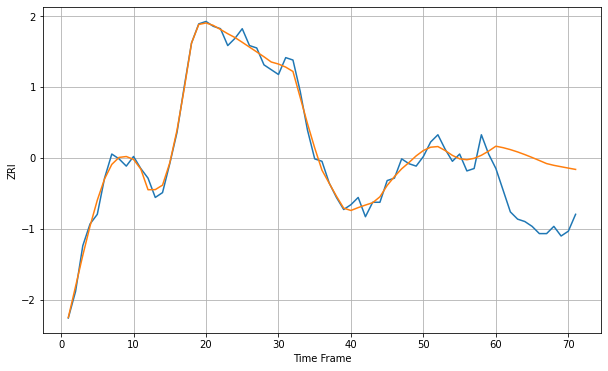

Wall time: 15.7 s
77027 3.1152931132401767 25.3177805932507 [1441.25162905 1440.64442088 1439.84168113 1438.87224422 1437.77158113
 1436.57695761 1435.3245346  1434.04770547 1433.31751752 1432.74094898
 1432.17475952 1431.62580913]

Got an mse at 0.0049 in round 336 and stopped training



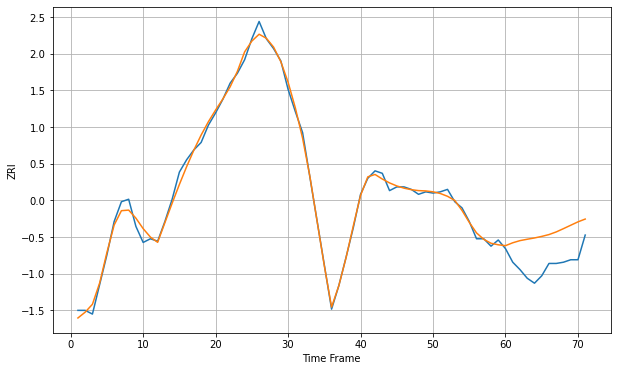

Wall time: 12.3 s
77042 4.134888186803173 25.81067704545002 [1166.4145841  1168.74174352 1170.48534118 1171.61467437 1172.64280763
 1173.90388808 1175.39558491 1177.53153294 1180.19358421 1182.9454392
 1185.68498453 1187.955236  ]

Got an mse at 0.0050 in round 243 and stopped training



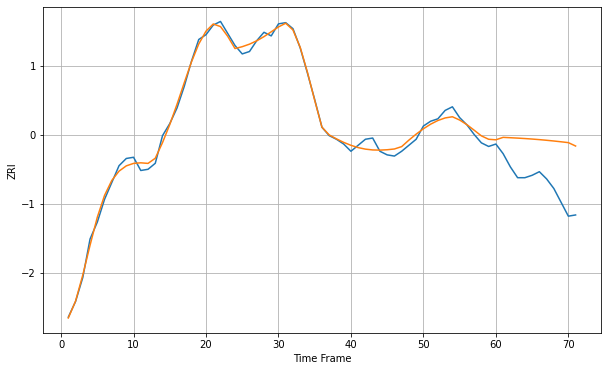

Wall time: 10.3 s
77054 4.015700004378564 37.332616894585435 [1257.53847805 1259.5657379  1259.26733709 1258.94858985 1258.58728203
 1258.16844855 1257.68574633 1257.13997251 1256.53635781 1255.8819075
 1255.18336001 1252.37239104]


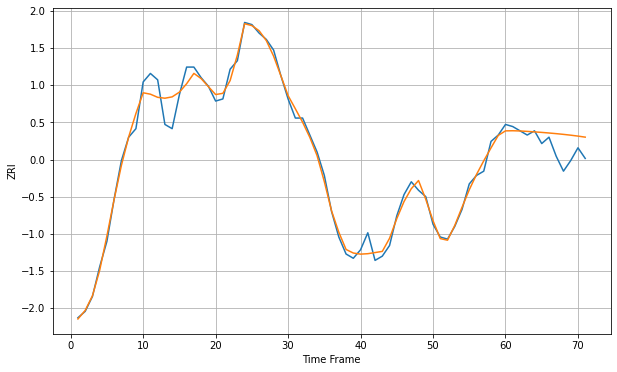

Wall time: 15.8 s
77056 4.202934200618302 7.824396507781953 [1452.9669172  1453.02782934 1452.92447477 1452.7278331  1452.50204378
 1452.24923452 1451.96973141 1451.66165812 1451.32066473 1450.93969598
 1450.5088196  1450.01558433]


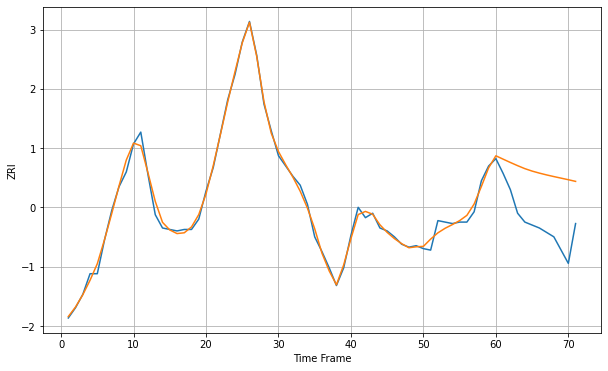

Wall time: 15.7 s
77057 3.434614647947028 35.48871934433469 [1441.94016045 1439.65928902 1437.40901839 1435.24639522 1433.22755594
 1431.57374642 1430.2026593  1428.97517497 1427.85517837 1426.78850584
 1425.72084244 1424.59558761]

Got an mse at 0.0050 in round 394 and stopped training



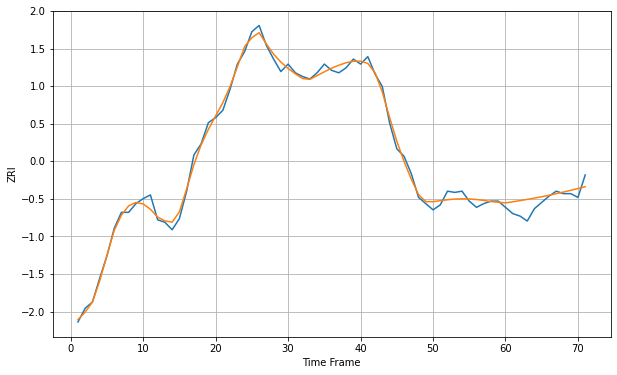

Wall time: 13.8 s
77063 4.234153464928648 8.182763878206183 [1265.56631554 1266.46498364 1267.40686134 1268.39570319 1269.43793048
 1270.54176134 1271.71551585 1272.96506586 1274.29070425 1275.6842001
 1277.12726869 1278.59264738]

Got an mse at 0.0050 in round 173 and stopped training



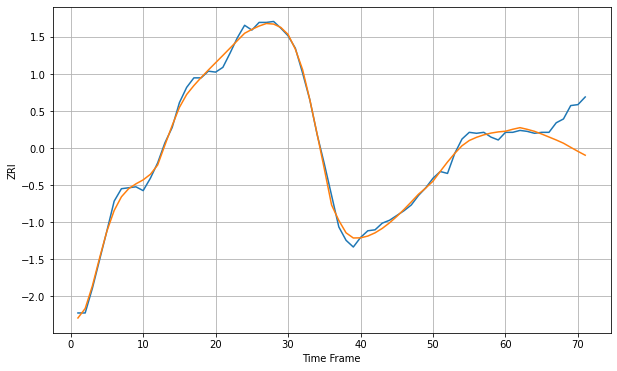

Wall time: 8.36 s
77077 5.442597691732002 27.451143047029078 [1191.15805669 1193.2021328  1194.89400825 1193.13067246 1191.05120269
 1188.20148221 1185.10535818 1181.99551279 1178.61550716 1174.3047424
 1170.07184194 1166.04838464]


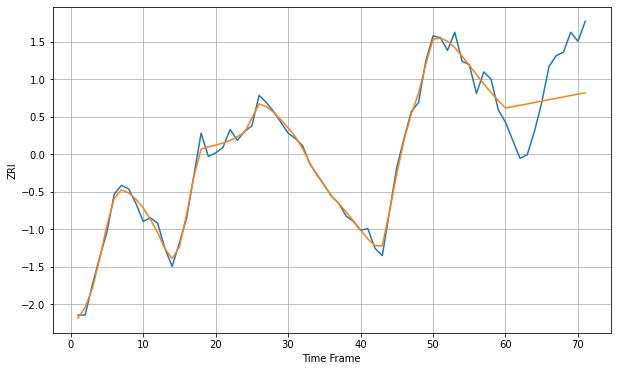

Wall time: 15.7 s
77090 3.819957677068892 25.027633667761968 [964.97739246 965.69296079 966.43674863 967.20093952 967.97891027
 968.76480417 969.5531749  970.33886127 971.11703213 971.88328149
 972.63370426 973.36494032]


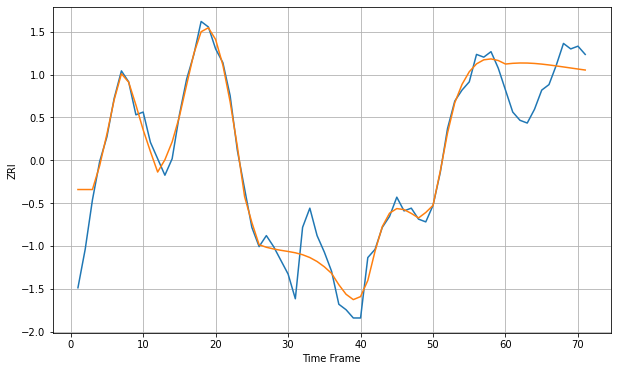

Wall time: 15.8 s
77098 7.4157899846082325 12.787280559658381 [1501.4935352  1501.7552374  1501.87456748 1501.85347277 1501.7098065
 1501.46984861 1501.16140343 1500.80957826 1500.43498259 1500.05342007
 1499.67630282 1499.31132987]

Got an mse at 0.0050 in round 303 and stopped training



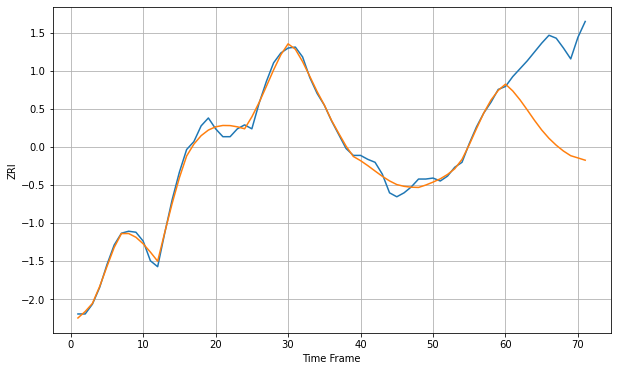

Wall time: 11.4 s
77380 5.443677864970301 88.74751006132993 [1419.34615939 1412.47511144 1403.45754788 1393.20458359 1382.62053037
 1372.77791958 1364.34375182 1357.34713737 1351.42549081 1346.6892402
 1344.44073886 1342.12476158]

Got an mse at 0.0050 in round 347 and stopped training



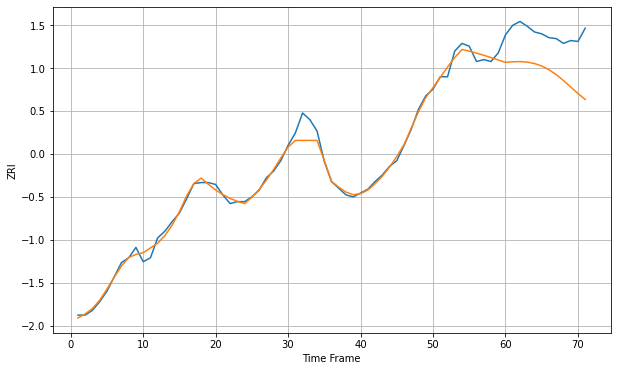

Wall time: 12.2 s
77429 6.350338972164611 43.549397253709806 [1202.08452328 1202.74919447 1202.90897119 1202.35709155 1200.87336847
 1198.25552779 1194.36979673 1189.22166711 1183.02639751 1176.22868096
 1169.41999032 1163.16744695]


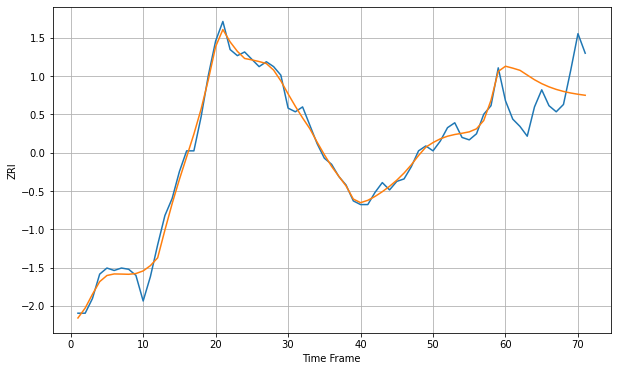

Wall time: 15.6 s
77494 6.3054606803600874 32.12015081338976 [1283.33299663 1281.77215597 1279.97001167 1276.11202945 1272.26564771
 1269.05167844 1266.43493147 1264.34294632 1262.689365   1261.38911971
 1260.36641395 1259.52942831]

Got an mse at 0.0050 in round 182 and stopped training



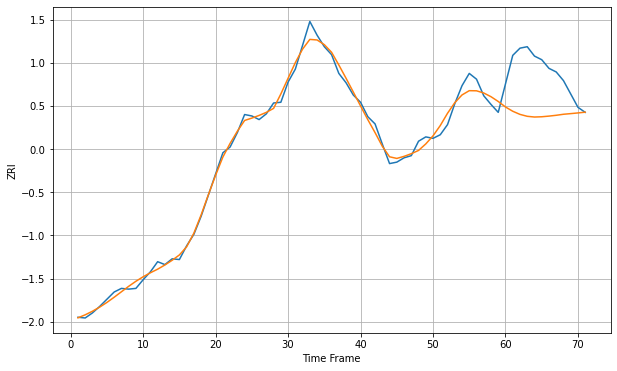

Wall time: 8.73 s
77550 8.39053895319321 63.97239263066318 [1147.45366339 1141.55236105 1137.19005329 1134.54331026 1133.5397406
 1133.90693924 1134.81450084 1135.95838707 1137.36892593 1138.2656499
 1139.21872793 1140.24918853]


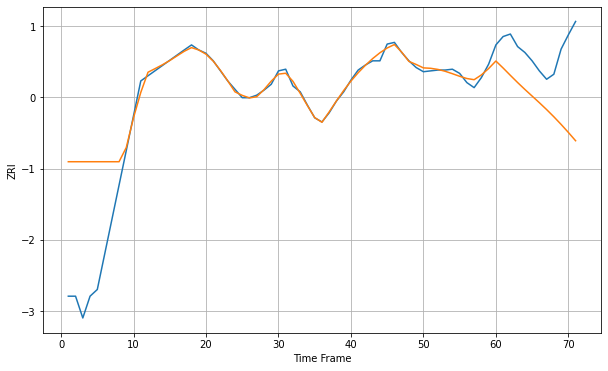

Wall time: 15.7 s
77584 51.102657995370286 68.93029174251525 [1421.77579289 1413.42066445 1404.67340738 1396.08345618 1387.87846294
 1379.9512563  1372.02093895 1363.82490111 1355.20802041 1346.11176026
 1336.54963198 1326.6144685 ]

Got an mse at 0.0050 in round 371 and stopped training



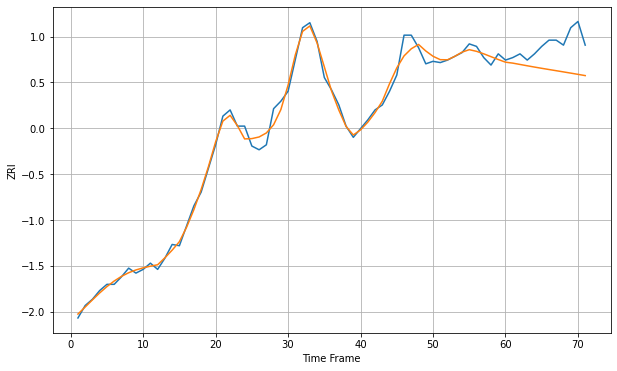

Wall time: 12.6 s
77598 5.184742448889955 22.146553755442053 [1119.31702486 1118.56424071 1117.49735629 1116.43132167 1115.39672894
 1114.39936874 1113.43010354 1112.47359455 1111.51474182 1110.54263935
 1109.55221894 1108.54399382]


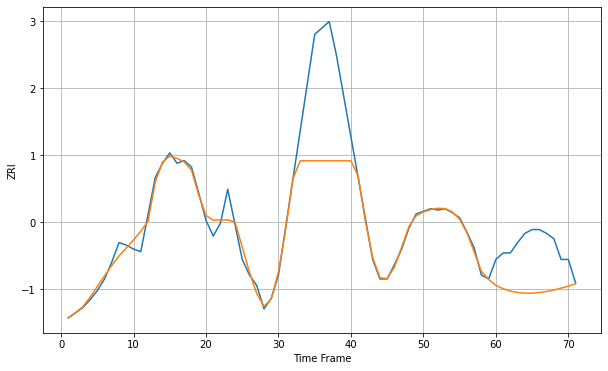

Wall time: 15.8 s
77840 28.020730153555263 35.11610098883511 [849.0578327  846.48720135 844.69128605 843.58346421 843.07562064
 843.08542867 843.53837558 844.36789482 845.51582054 846.9336531
 848.51710633 850.29237472]

Got an mse at 0.0050 in round 402 and stopped training



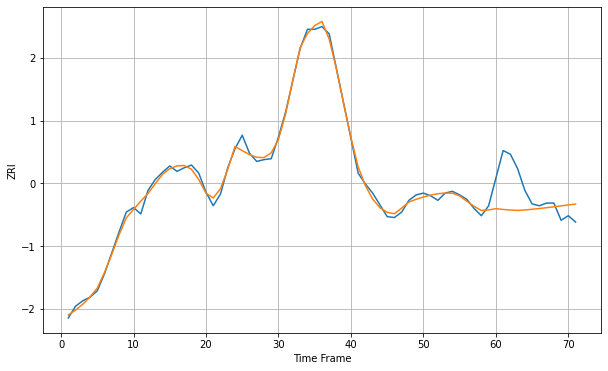

Wall time: 13.5 s
77845 4.880253602410747 32.46933968521359 [959.79990113 958.93485568 958.27738544 957.8697737  958.38359188
 959.13419621 959.9677261  960.87637631 961.85118243 962.88290492
 963.96242028 964.86317761]


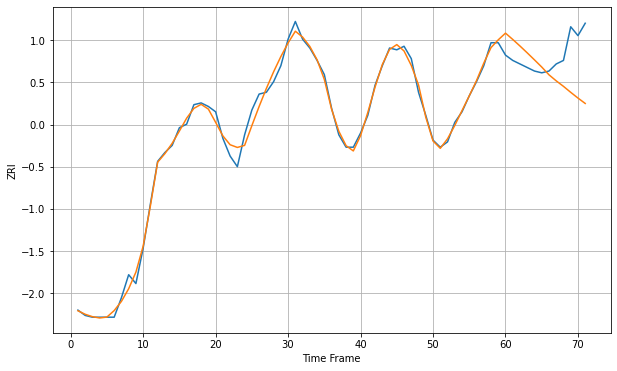

Wall time: 15.8 s
78130 3.4498504615672467 21.39094261204417 [1158.40087581 1154.85202509 1151.1318637  1147.27092816 1143.30289209
 1139.26822843 1134.88183333 1131.46391666 1128.35636718 1124.97969852
 1121.74673837 1118.70108682]


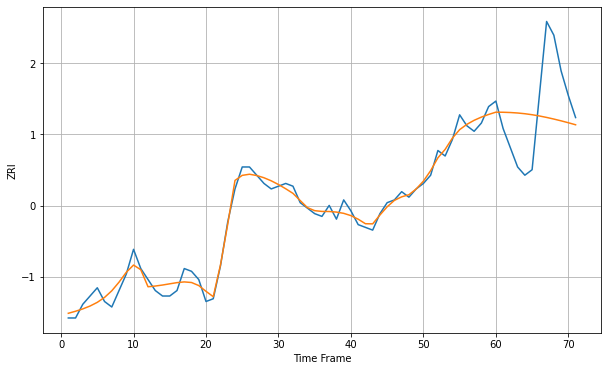

Wall time: 15.4 s
78201 2.7093157071460814 18.599796362922387 [887.96059113 887.93008944 887.8348761  887.66096599 887.39521509
 887.03234383 886.57815565 886.04622016 885.45134281 884.80462308
 884.11175937 883.37355245]

Got an mse at 0.0050 in round 402 and stopped training



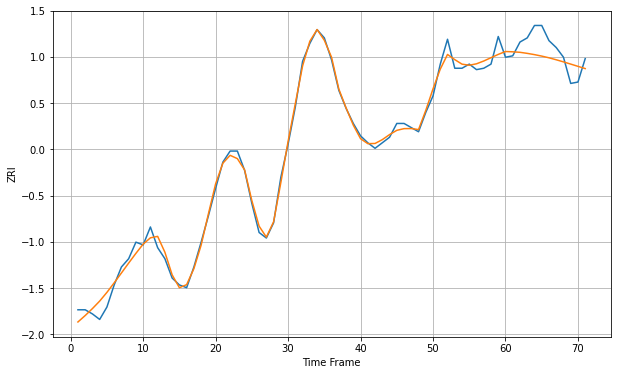

Wall time: 13.6 s
78209 4.71092556346094 12.140268897691188 [1256.12202441 1255.92030303 1255.5497979  1254.7837865  1253.86760438
 1252.80152157 1251.57691479 1250.14523333 1248.61213469 1247.01141996
 1245.38194017 1243.7633762 ]


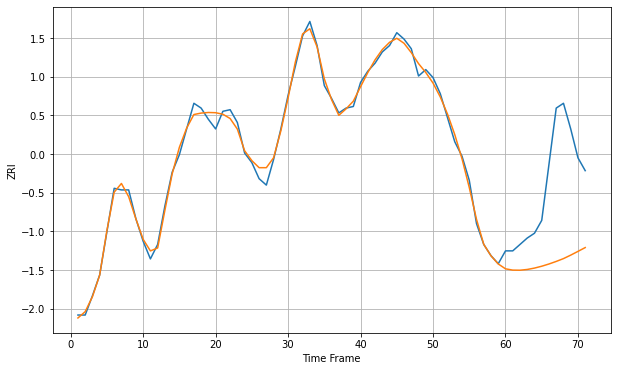

Wall time: 15.6 s
78210 3.5696206420876195 55.1216566156052 [926.81005724 926.00871038 925.94097927 926.40719349 927.2673245
 928.42777125 929.82617366 931.42013044 933.17843838 935.35115151
 937.67854001 940.05459531]

Got an mse at 0.0050 in round 426 and stopped training



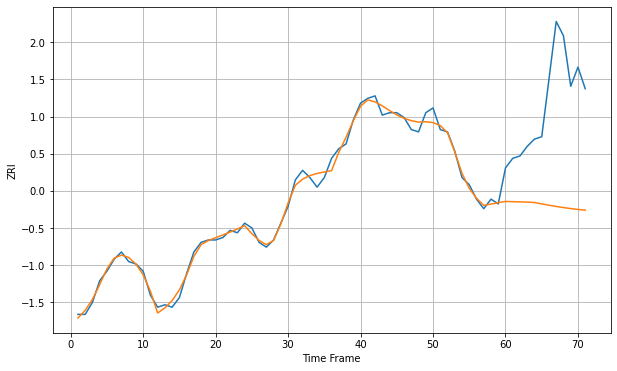

Wall time: 13.9 s
78212 2.180949512487852 45.99640437789203 [895.04075559 894.94376775 894.84984807 894.76429354 894.60473641
 894.0176036  893.46239423 892.94872114 892.48365719 892.07099894
 891.71117227 891.40181215]


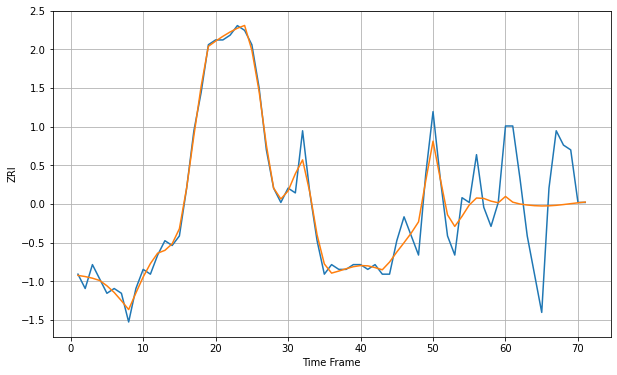

Wall time: 15.8 s
78213 2.698791559578082 12.183148127218129 [924.25853895 923.06456502 922.67391237 922.47212523 922.33035479
 922.27092081 922.29798789 922.40205896 922.56220059 922.74917608
 922.93119382 923.08084006]


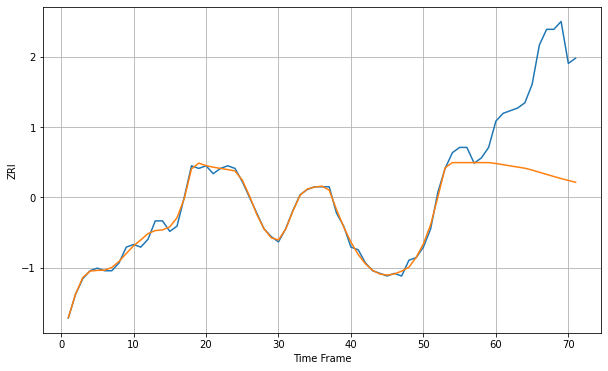

Wall time: 15.7 s
78216 1.9429672743305861 40.45152057081334 [968.8768306  968.41610407 967.95525182 967.50506977 967.07145205
 966.35736778 965.53764238 964.71846699 963.91512963 963.14102802
 962.40793962 961.72596574]

Got an mse at 0.0050 in round 314 and stopped training



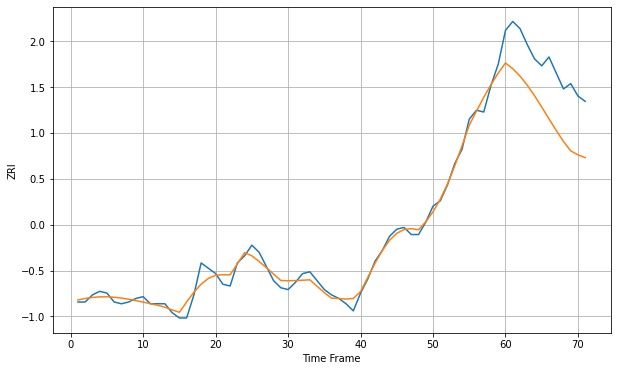

Wall time: 11.6 s
78229 3.6388808548146967 28.766509075649747 [1044.61391613 1041.40210817 1037.21639302 1032.12356988 1026.23622807
 1019.80449627 1013.15975096 1006.60734182 1000.44732137  995.11236252
  992.87826246  991.28597025]


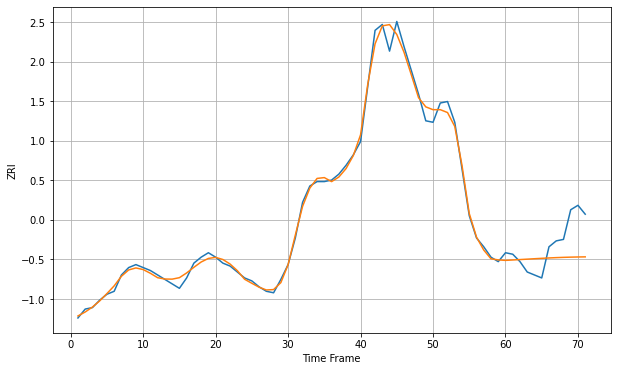

Wall time: 15.6 s
78233 4.099348958383317 17.820845058619934 [951.84228653 952.11622442 952.39423942 952.67831403 952.96191387
 953.23425317 953.48442741 953.70377846 953.88671526 954.03106016
 954.13854748 954.21485894]

Got an mse at 0.0050 in round 464 and stopped training



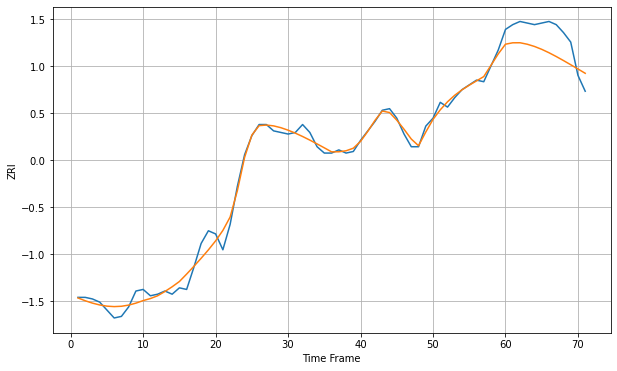

Wall time: 14.9 s
78240 4.173358943812286 14.416971185516099 [1103.67037344 1104.54300952 1104.5770341  1103.64276383 1102.23976889
 1100.42465796 1098.27829374 1095.8919711  1093.34934623 1090.71428766
 1088.02866543 1085.31682887]

Got an mse at 0.0050 in round 97 and stopped training



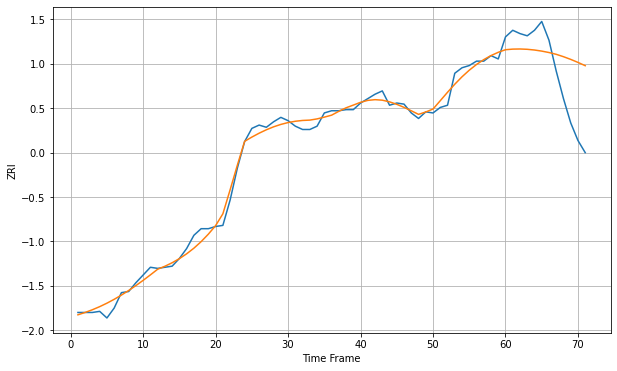

Wall time: 6.91 s
78249 5.657183540629334 38.92211107419899 [1141.36057348 1141.9134871  1142.03121734 1141.74638855 1141.09617089
 1140.11210781 1138.8146204  1137.19546568 1135.04217872 1132.59249814
 1129.86168514 1126.87625338]

Got an mse at 0.0050 in round 363 and stopped training



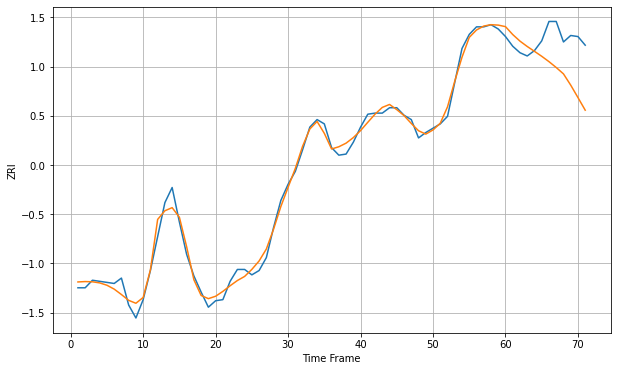

Wall time: 13.4 s
78256 6.426470946573635 33.72185733171303 [1243.19831532 1235.85401609 1229.75611682 1224.7951538  1220.28380466
 1215.68961212 1210.73221995 1205.29954508 1199.37679122 1188.95092529
 1177.41235436 1165.72756304]

Got an mse at 0.0050 in round 185 and stopped training



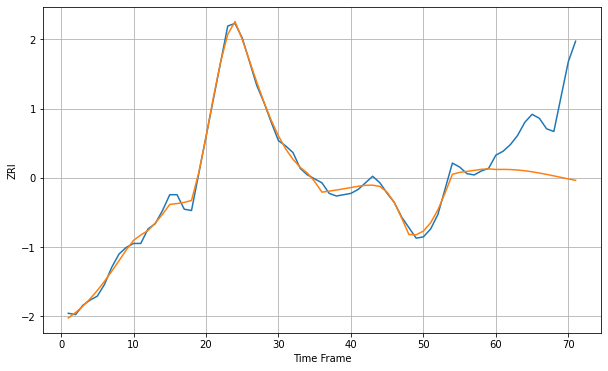

Wall time: 9.14 s
78521 3.695507126490705 51.25274318332433 [751.13365621 751.20778015 751.0853902  750.73561248 750.15975431
 749.38342332 748.44728421 747.39796926 746.28071614 745.13464786
 743.99070875 742.87163131]

Got an mse at 0.0050 in round 281 and stopped training



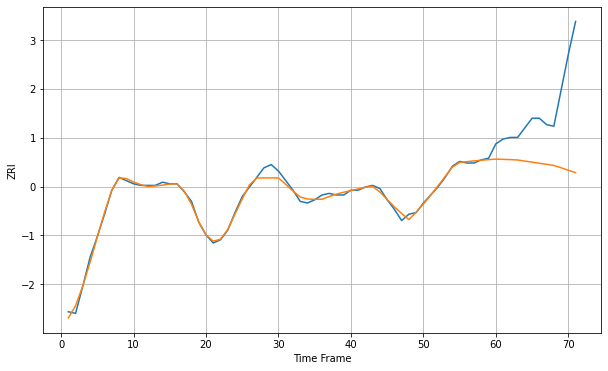

Wall time: 11.6 s
78550 2.146170455488192 41.22368811619969 [767.44514192 767.27298092 767.12370073 766.89435815 766.20363821
 765.5284     764.85411228 764.16881489 763.46742989 762.02262496
 760.45079082 758.96604028]

Got an mse at 0.0050 in round 385 and stopped training



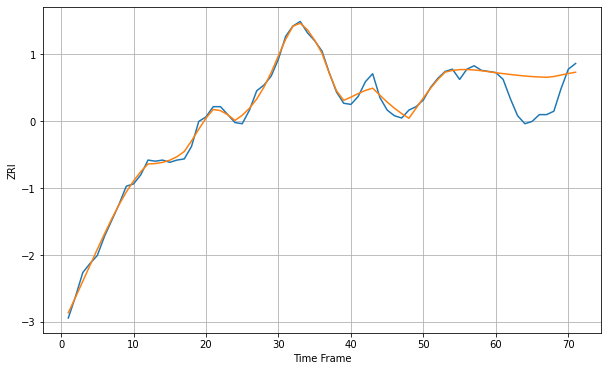

Wall time: 13.7 s
78613 4.155774827421564 26.45105477372086 [1297.85649246 1297.09804284 1296.33107105 1295.60844163 1294.98256077
 1294.48728079 1294.12624475 1293.87118047 1294.53489469 1295.88541509
 1297.16447779 1298.32433883]

Got an mse at 0.0050 in round 248 and stopped training



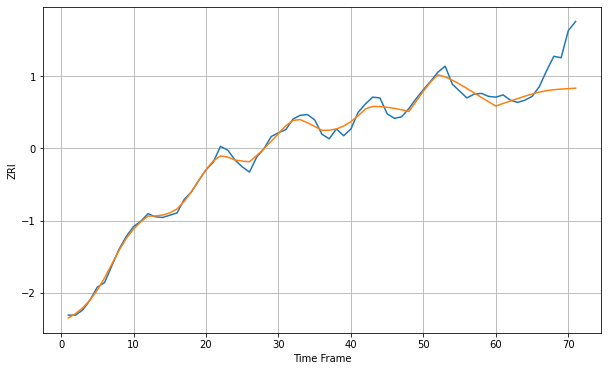

Wall time: 10.3 s
78660 6.703052977812542 39.15592966814252 [1275.18587241 1278.69611754 1281.84026148 1285.07249772 1288.24433811
 1291.17164476 1293.66012078 1295.5598678  1296.84460591 1297.66014236
 1298.26300968 1298.87480399]

Got an mse at 0.0050 in round 177 and stopped training



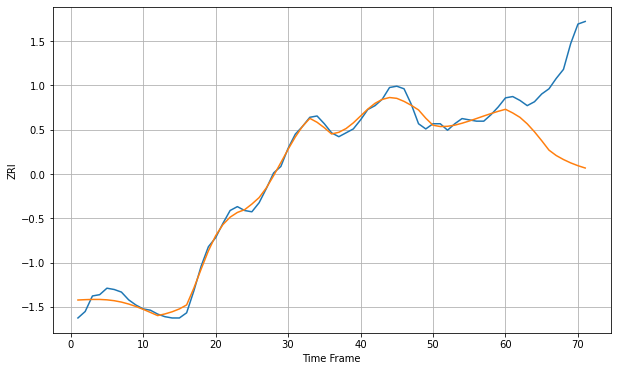

Wall time: 9.19 s
78664 4.802595595550805 62.16334483394212 [1165.16159537 1162.34057514 1158.92960498 1153.94005331 1147.77676073
 1140.89461136 1133.63335657 1129.46802169 1126.37148007 1123.76340718
 1121.61008969 1119.80973572]

Got an mse at 0.0050 in round 122 and stopped training



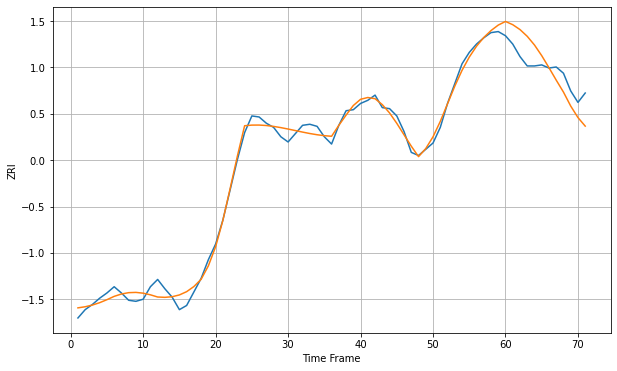

Wall time: 7.83 s
78666 6.273193640366303 19.188131819462043 [1159.71141779 1156.61470566 1151.92370195 1145.44110196 1137.0982232
 1126.86366016 1115.32316078 1103.36857737 1091.88021497 1078.48459704
 1067.43314001 1059.22908997]


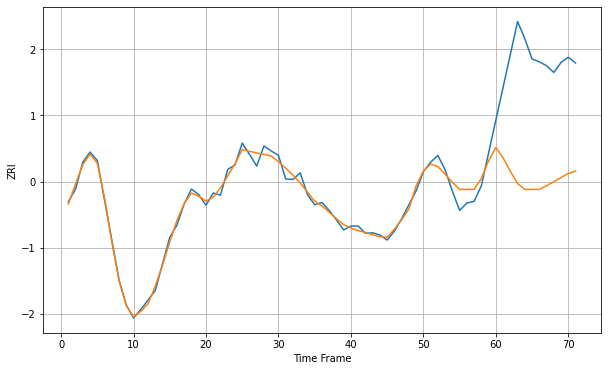

Wall time: 16.5 s
78701 10.792134419925546 210.12002653301948 [2175.37279467 2156.60482683 2132.47993074 2110.82915584 2100.35057864
 2100.35057864 2100.35057864 2106.98965264 2114.22172842 2121.66866351
 2128.82619167 2132.90690307]

Got an mse at 0.0050 in round 206 and stopped training



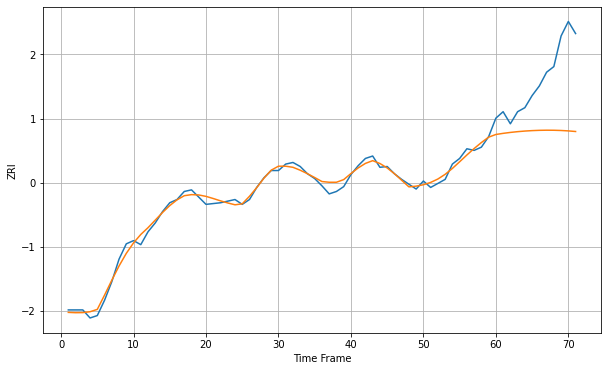

Wall time: 9.31 s
78702 5.595637146332016 74.1837152490054 [1609.73026267 1611.12755158 1612.28992015 1613.2371992  1613.9830506
 1614.53369323 1614.88763568 1615.03802161 1614.97611454 1614.69319044
 1614.18113367 1613.43453721]

Got an mse at 0.0050 in round 205 and stopped training



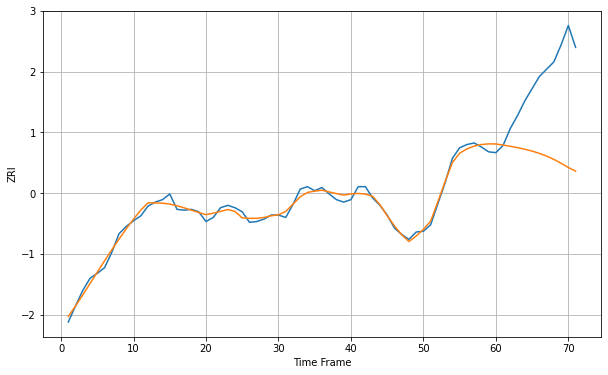

Wall time: 9.38 s
78703 5.286550607712753 100.86934912066143 [1823.70732894 1822.36639616 1820.86773773 1819.17067453 1817.21405381
 1814.90984653 1812.14104481 1808.77406885 1804.70274629 1799.93489994
 1794.6853404  1790.19303559]


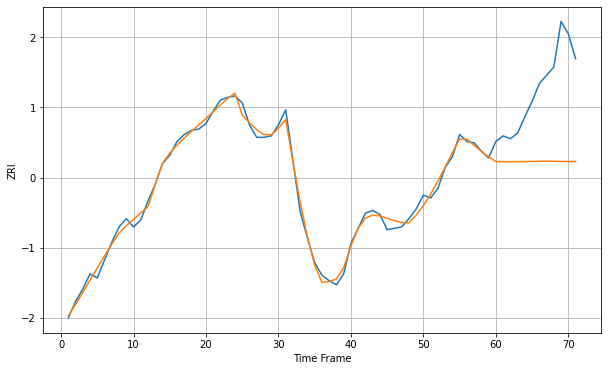

Wall time: 15.8 s
78704 3.7940434727894092 57.99655808245892 [1517.38487116 1517.35976699 1517.35884982 1517.38198276 1517.42989587
 1517.50426766 1517.60765705 1517.74324087 1517.62242018 1517.50667089
 1517.46179471 1517.49014379]

Got an mse at 0.0050 in round 220 and stopped training



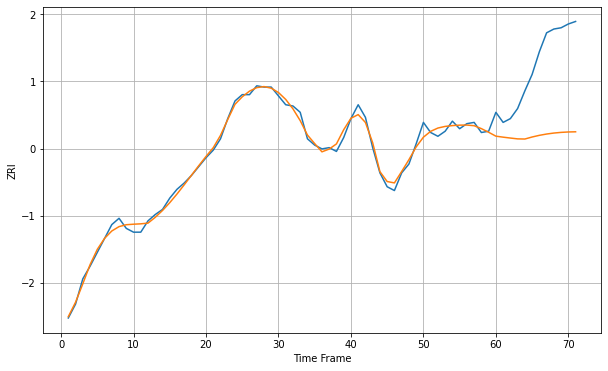

Wall time: 9.4 s
78705 3.735657587222552 61.024463500750194 [1522.0949099  1521.30367523 1520.60517109 1519.94602487 1519.82726618
 1521.43139616 1522.75099171 1523.78737809 1524.55967068 1525.09467544
 1525.41864778 1525.55314567]

Got an mse at 0.0050 in round 69 and stopped training



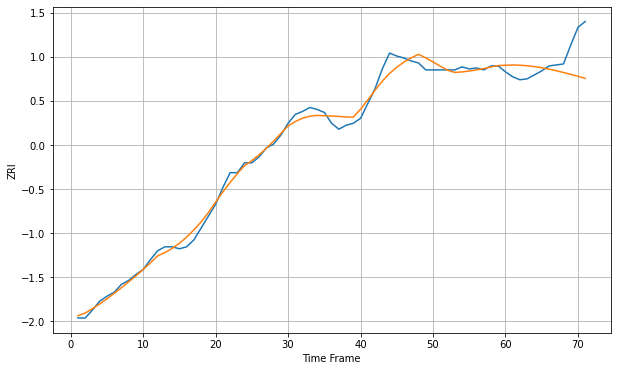

Wall time: 6.54 s
78728 6.25287200786471 24.853856179089025 [1230.71718974 1230.96680967 1230.74368221 1230.18067723 1229.32134944
 1228.17726985 1226.77527019 1225.1614263  1223.38681839 1221.48904759
 1219.49441479 1217.43764674]

Got an mse at 0.0050 in round 180 and stopped training



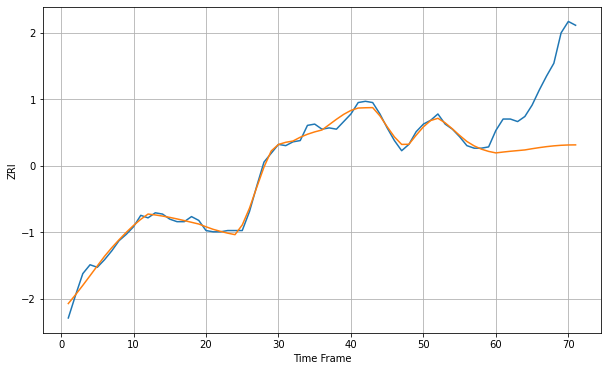

Wall time: 8.87 s
78729 3.6859134312212483 57.56160685035587 [1202.27280677 1202.95183794 1203.56381432 1204.08553396 1204.61572023
 1205.56880376 1206.44956722 1207.21813142 1207.83801364 1208.28247055
 1208.53724051 1208.60052803]

Got an mse at 0.0050 in round 307 and stopped training



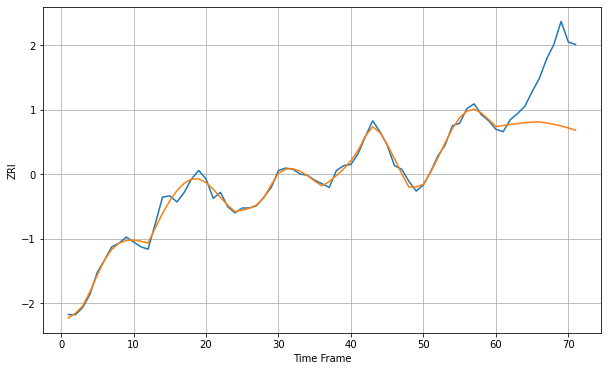

Wall time: 11.5 s
78735 3.742447351126181 47.28227866780232 [1530.21421122 1531.09648503 1531.94990433 1532.73557685 1533.41227624
 1533.94064244 1534.09236086 1533.23666451 1532.09271358 1530.68994494
 1529.07055292 1527.27746167]


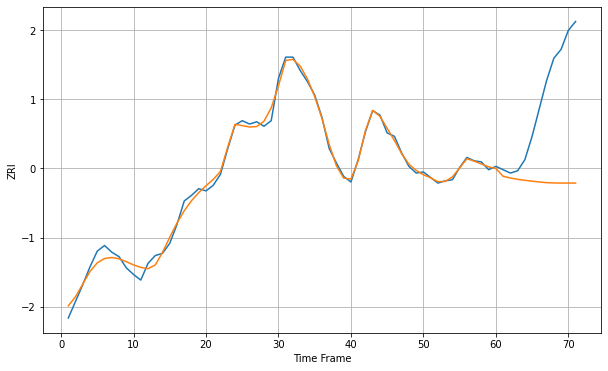

Wall time: 15.5 s
78741 4.756716600251984 82.4214685622627 [1277.12126581 1270.09040129 1268.59014729 1267.40462629 1266.51470164
 1265.72073868 1265.01246455 1264.37909437 1264.12844853 1264.04338101
 1264.01041956 1264.01675162]

Got an mse at 0.0050 in round 248 and stopped training



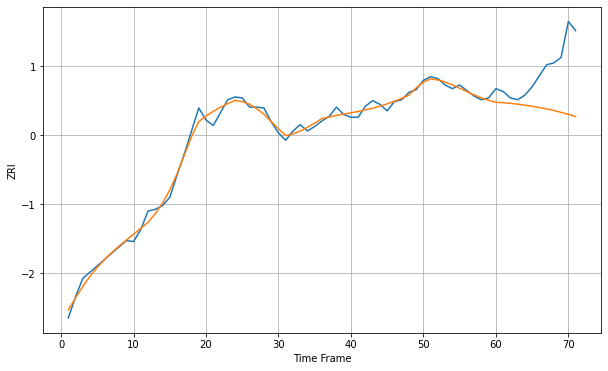

Wall time: 10.3 s
78744 5.279058249196823 49.65109425607647 [1268.20605941 1267.78932273 1267.07366691 1266.16735568 1265.13637229
 1263.9461771  1262.5729312  1261.02725971 1259.27801142 1257.31747117
 1255.14382394 1252.72990085]

Got an mse at 0.0050 in round 160 and stopped training



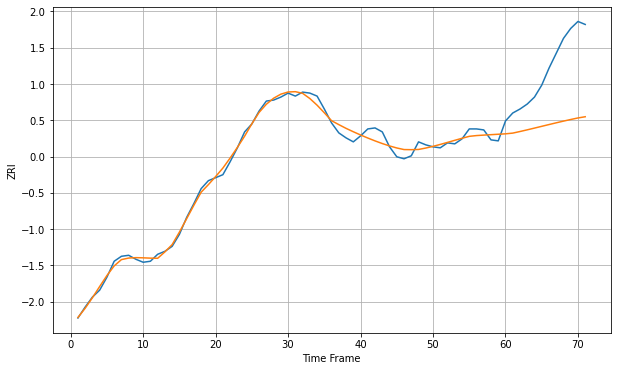

Wall time: 8.32 s
78745 5.138010033587408 61.797245865582966 [1271.07038516 1271.79398653 1273.39915222 1275.08960135 1276.83744226
 1278.61389432 1280.39062014 1282.14109278 1283.84191595 1285.47393926
 1287.02293856 1288.24467982]

Got an mse at 0.0050 in round 230 and stopped training



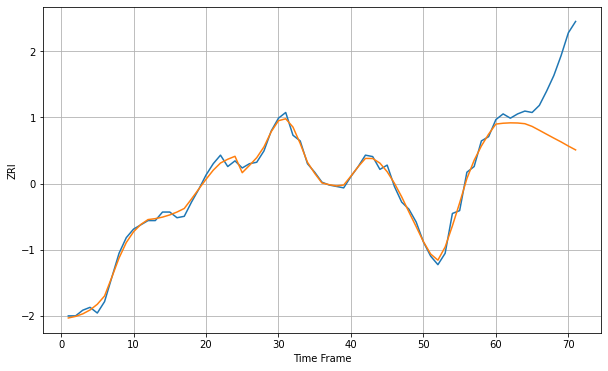

Wall time: 9.57 s
78746 3.265757829051463 42.43749659455912 [1551.85053852 1552.44849512 1552.7170893  1552.6155523  1552.11795681
 1550.21430866 1547.48834654 1544.72024612 1541.97593246 1539.30757414
 1536.41977293 1533.70027774]


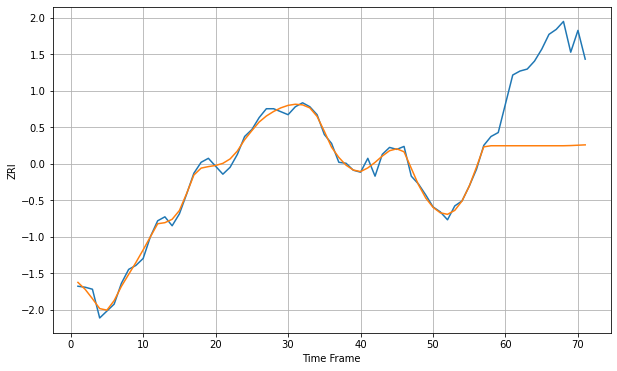

Wall time: 16.9 s
78748 5.41863750214019 94.48099828995144 [1299.66944767 1299.66944767 1299.66944767 1299.66944767 1299.66944767
 1299.66944767 1299.66944767 1299.66944767 1299.66944767 1299.86947666
 1300.21415345 1300.56237767]

Got an mse at 0.0050 in round 174 and stopped training



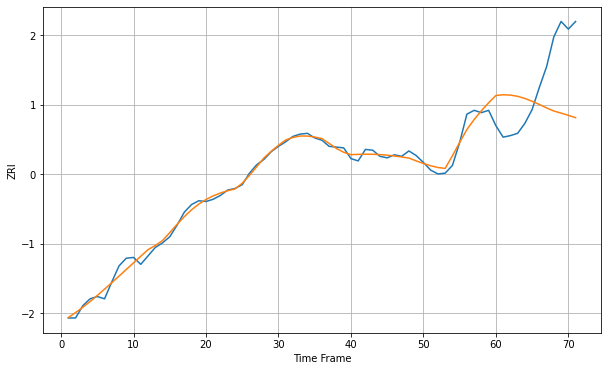

Wall time: 9.22 s
78749 6.396784506564791 74.40331946618885 [1312.36583375 1313.30652881 1312.90703084 1311.29280227 1308.525051
 1304.86343882 1300.65414768 1296.15242046 1292.11962868 1289.34593543
 1286.49844424 1283.47659994]

Got an mse at 0.0050 in round 155 and stopped training



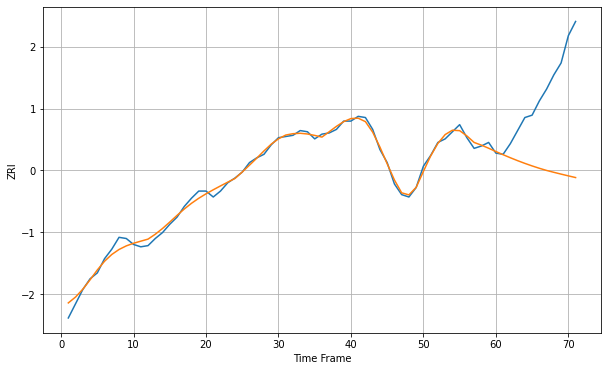

Wall time: 8.68 s
78750 3.639305415913172 70.04010986813975 [1277.3338114  1274.65990843 1272.08741931 1269.64342688 1267.34614795
 1265.20281282 1263.20974923 1261.3850527  1259.80877351 1258.29514544
 1256.82736636 1255.39068465]


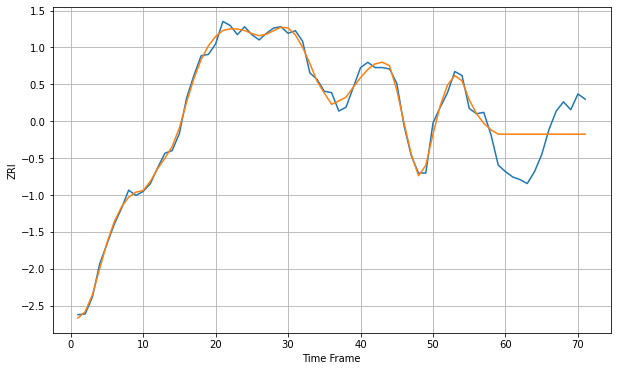

Wall time: 16.2 s
78751 5.200118672989759 26.471743583753053 [1392.48245362 1392.48245362 1392.48245362 1392.48245362 1392.48245362
 1392.48245362 1392.48245362 1392.48245362 1392.48245362 1392.48245362
 1392.48245362 1392.48245362]

Got an mse at 0.0050 in round 175 and stopped training



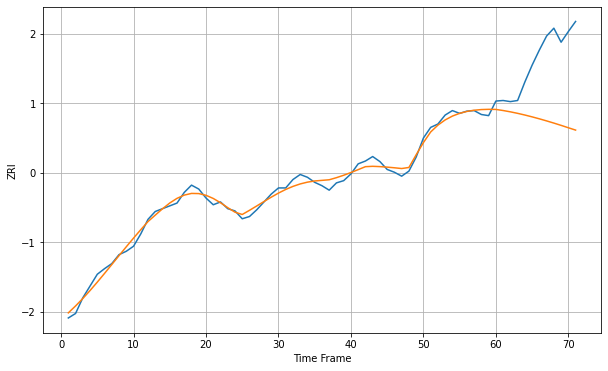

Wall time: 9.02 s
78752 8.708764933224728 118.68516432737731 [1332.06108462 1330.11308514 1327.77535082 1325.08277625 1322.07812161
 1318.80572298 1315.30330992 1311.59685182 1307.70131417 1303.6267024
 1299.38630061 1295.20458444]

Got an mse at 0.0050 in round 204 and stopped training



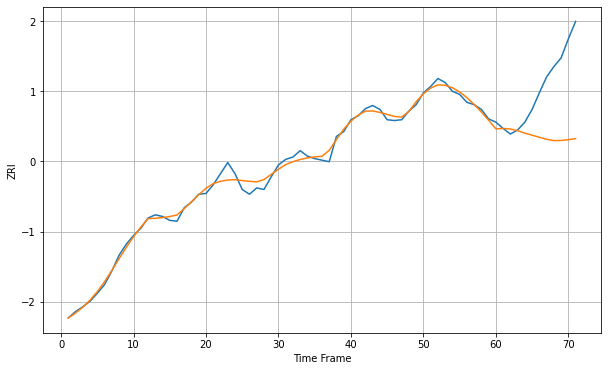

Wall time: 9.85 s
78753 6.2392623468177115 75.42299575118383 [1137.50673045 1138.04952648 1137.33820369 1135.23420907 1132.05378282
 1129.48799472 1126.84045812 1124.38718256 1122.67604947 1122.85427668
 1123.8223346  1125.23195392]

Got an mse at 0.0050 in round 235 and stopped training



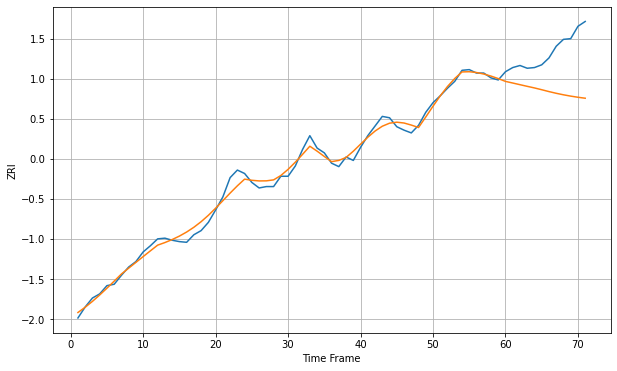

Wall time: 10.3 s
78754 8.170634569099297 63.25022369222959 [1222.87996515 1220.51136947 1218.09875786 1215.70119085 1213.37164444
 1210.77483065 1208.07030298 1205.59829674 1203.39594278 1201.47571877
 1199.8263044  1198.41717275]

Got an mse at 0.0050 in round 251 and stopped training



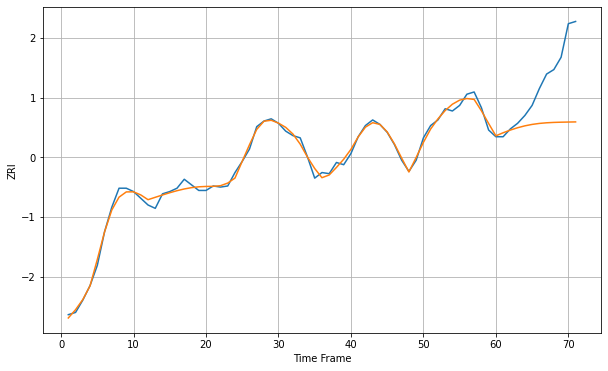

Wall time: 11 s
78757 3.7436487914892806 45.311484211447805 [1260.8275435  1263.543627   1265.96370718 1268.04022569 1269.72854039
 1271.00724202 1271.89687624 1272.46288611 1272.79811638 1272.99551509
 1273.12826293 1273.24481776]

Got an mse at 0.0049 in round 114 and stopped training



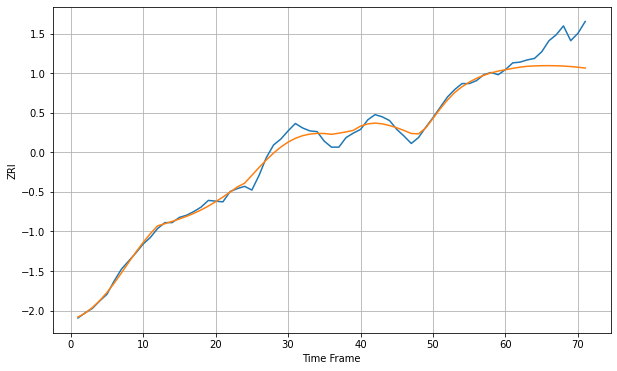

Wall time: 7.7 s
78758 7.466959507653275 33.8734172854517 [1332.72969738 1334.57472538 1336.20265879 1337.34804022 1337.86997214
 1338.17119487 1338.24451793 1338.08441302 1337.68621961 1337.04570887
 1336.15916242 1335.02404592]

Got an mse at 0.0050 in round 195 and stopped training



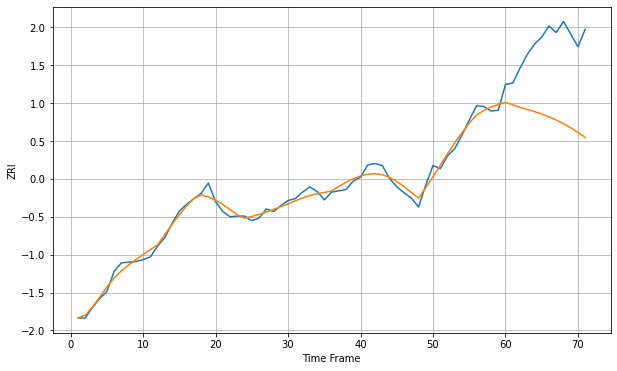

Wall time: 9.44 s
78759 8.202154364842794 117.72748154485359 [1500.25707004 1496.58852886 1492.59272319 1489.33717929 1486.08934695
 1482.35719633 1478.05944341 1473.1184382  1467.46845511 1461.0700533
 1453.93111113 1446.12888882]

Got an mse at 0.0050 in round 291 and stopped training



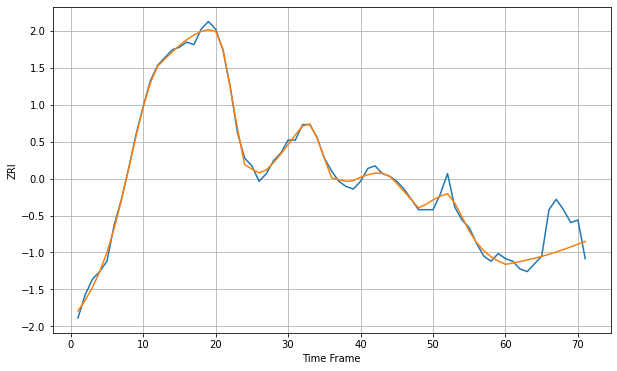

Wall time: 11.4 s
79912 2.020715186520867 10.055819494644378 [965.79277348 966.31478134 966.87829044 967.49193387 968.16431543
 968.90324732 969.71466725 970.60050305 971.55599885 972.56776662
 973.61372777 974.66547363]


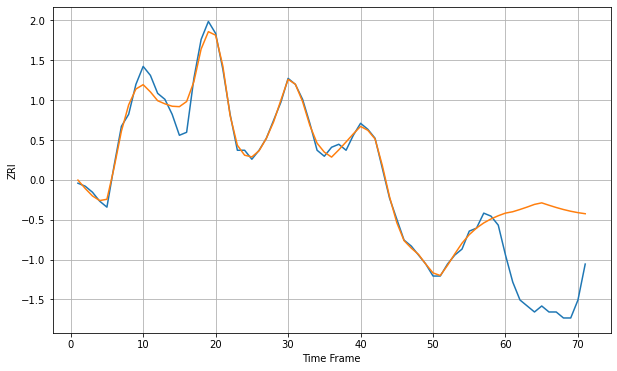

Wall time: 16.5 s
79936 2.6044200600050837 30.862987151447356 [912.01673062 912.4718267  913.22620235 914.04096298 914.92345761
 915.43647702 914.63917409 913.88470937 913.20855852 912.6336059
 912.16799786 911.80829171]

Got an mse at 0.0050 in round 165 and stopped training



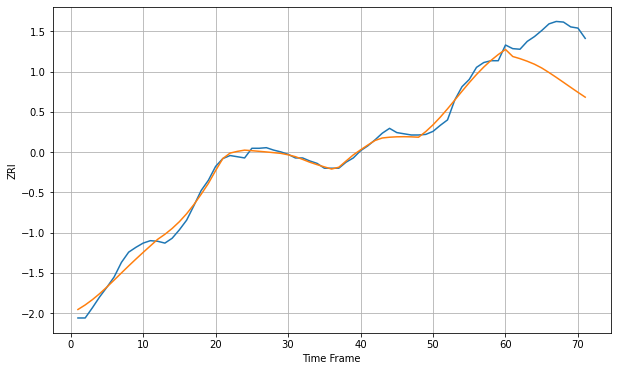

Wall time: 8.7 s
80021 9.355802566669599 72.62946306968843 [1609.65655486 1597.98578534 1594.41946666 1590.1514881  1585.19851874
 1578.97746681 1571.4679196  1563.48359699 1555.22117635 1546.88454176
 1538.65120442 1530.64941145]

Got an mse at 0.0050 in round 87 and stopped training



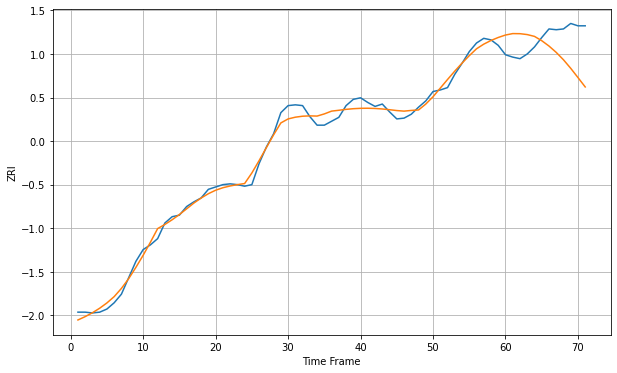

Wall time: 6.75 s
80027 7.789586537376584 40.83573696907152 [1639.21584512 1641.05546628 1640.93531431 1639.79232438 1637.47991681
 1631.99302094 1625.15485724 1617.02175503 1607.57230766 1596.66899758
 1584.85389899 1572.86173156]

Got an mse at 0.0050 in round 287 and stopped training



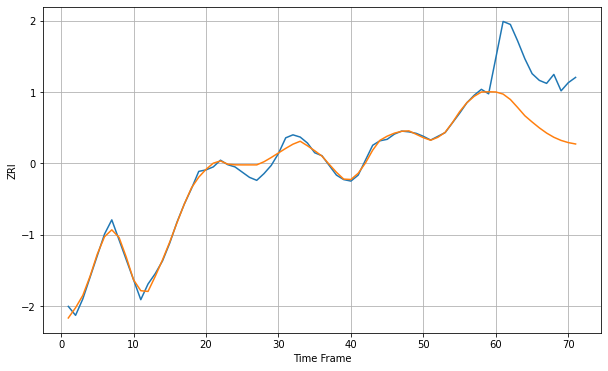

Wall time: 11.6 s
80033 6.71588593479892 78.62164733183147 [1284.47390935 1281.61186582 1274.39569819 1263.7084585  1252.57234982
 1244.23294563 1236.34676578 1229.38813918 1223.73454633 1219.5109422
 1216.59315432 1214.73772953]

Got an mse at 0.0049 in round 82 and stopped training



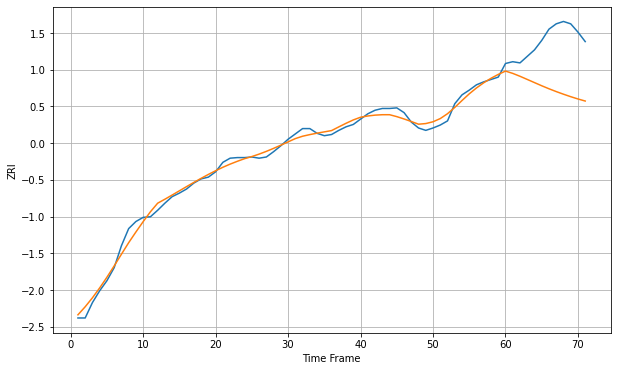

Wall time: 6.83 s
80111 8.59122447252765 85.57255657431335 [1606.14581137 1602.26361497 1597.38626755 1592.05907652 1586.70253188
 1581.35889452 1576.28027561 1571.52832136 1567.09076729 1562.89629478
 1559.04925086 1555.54878193]

Got an mse at 0.0050 in round 106 and stopped training



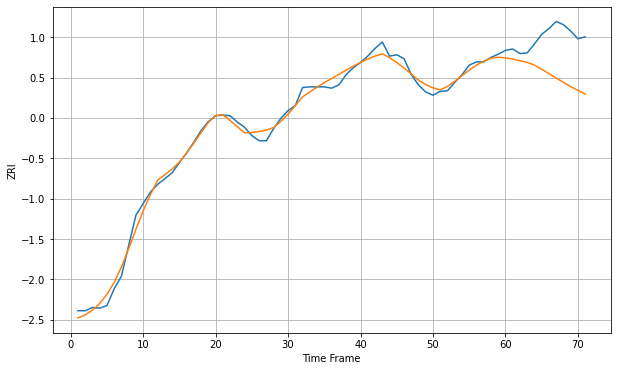

Wall time: 7.41 s
80112 8.836752286195205 62.96000567760966 [1773.30786788 1771.27163838 1768.877569   1766.10319488 1761.95970999
 1755.44878236 1748.59569252 1741.68269869 1734.94577797 1728.53229708
 1722.50186201 1716.85263835]

Got an mse at 0.0048 in round 99 and stopped training



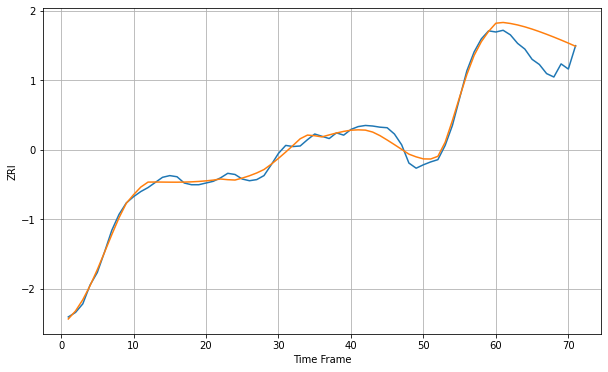

Wall time: 7.01 s
80120 8.386859073781094 43.8033308155288 [1684.39653868 1685.70973135 1683.95966846 1681.34167904 1677.99804426
 1674.07069258 1669.69568199 1664.98998452 1660.03614271 1654.87293085
 1649.49695192 1643.87440173]

Got an mse at 0.0050 in round 127 and stopped training



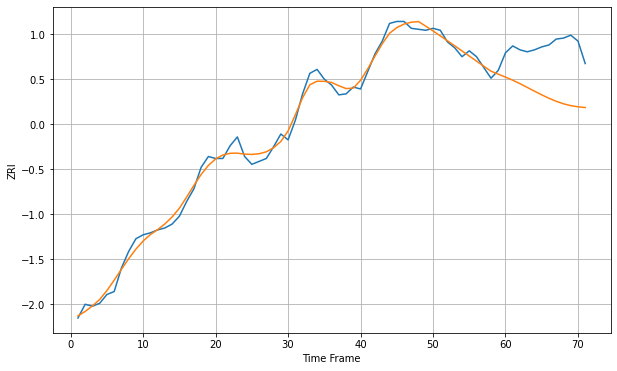

Wall time: 7.92 s
80124 6.468153979556431 51.469773262159244 [1596.15299542 1592.95265288 1589.39642714 1585.61397857 1581.76192992
 1578.01055209 1574.52357879 1571.43772091 1568.84861279 1566.97990484
 1565.79730795 1565.07404272]

Got an mse at 0.0050 in round 296 and stopped training



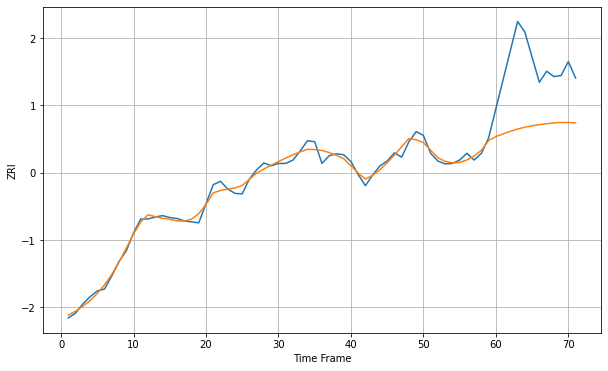

Wall time: 11.8 s
80129 9.824254634718368 133.94438259857958 [1884.58509452 1890.21423432 1895.44773861 1900.23563746 1904.01066715
 1906.90391535 1909.3249405  1911.28722668 1912.80978207 1913.91603502
 1913.80010922 1913.0479436 ]


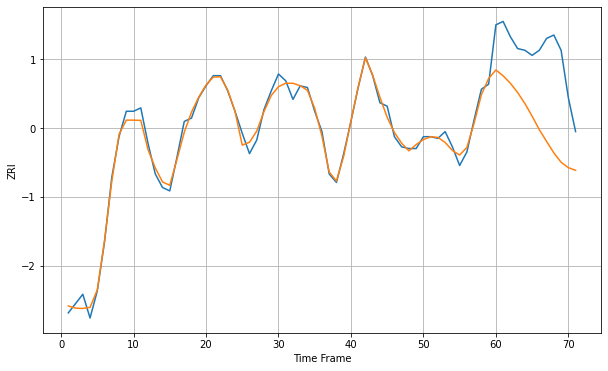

Wall time: 16.1 s
80202 3.778649703211463 43.55939252076474 [2008.34994508 2004.93571756 2000.53371908 1995.09213313 1988.59054075
 1981.13312485 1973.08323341 1966.1990407  1959.43572318 1953.90298611
 1950.72709348 1949.1372101 ]

Got an mse at 0.0049 in round 80 and stopped training



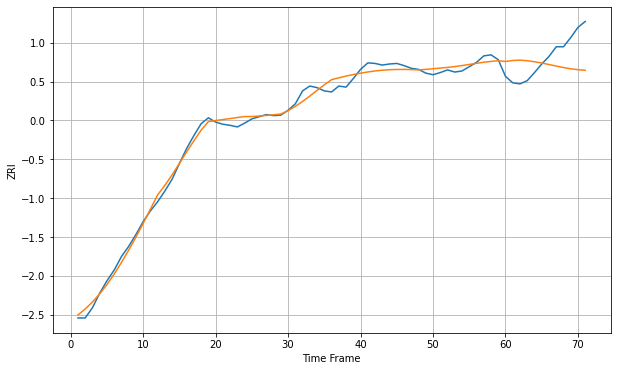

Wall time: 6.88 s
80203 10.062204100995832 47.42892835359109 [1593.63892749 1595.48600178 1596.13287168 1595.02268558 1593.19221672
 1590.7925847  1587.99276172 1585.11009032 1582.36000471 1580.04043083
 1578.42839807 1577.22251738]

Got an mse at 0.0050 in round 405 and stopped training



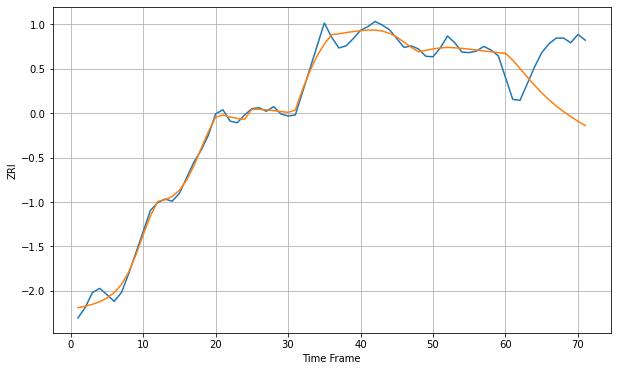

Wall time: 14.3 s
80204 12.061599319644081 109.13707560896555 [1850.54883344 1837.62155394 1821.2816281  1804.93840993 1789.18119349
 1774.51180104 1761.19346698 1749.24577798 1738.52805725 1728.8262541
 1719.90965825 1711.56153356]

Got an mse at 0.0050 in round 214 and stopped training



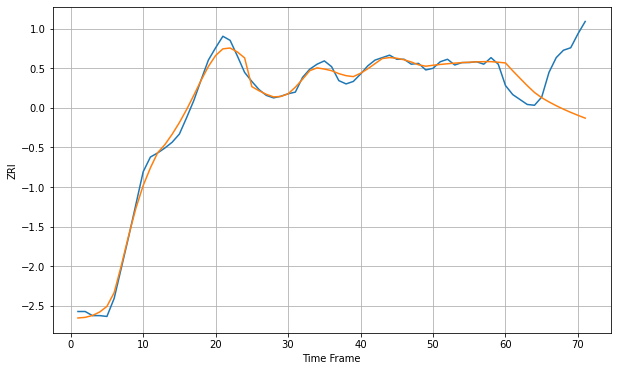

Wall time: 9.94 s
80205 6.743145652041553 59.70172194950169 [1672.52615663 1662.96536045 1653.88540716 1644.91962208 1636.60958655
 1630.19529559 1625.08689005 1620.46157251 1616.2490749  1612.37583243
 1608.76708406 1605.34979739]

Got an mse at 0.0050 in round 124 and stopped training



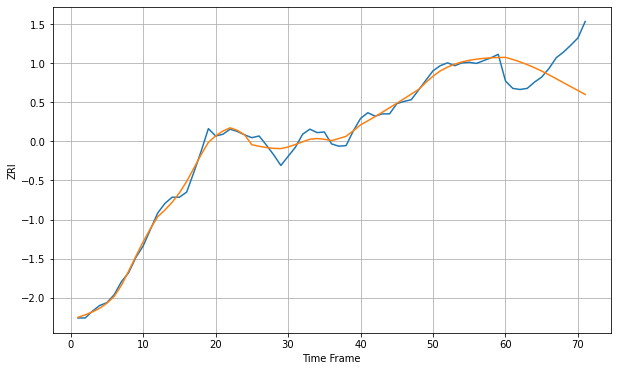

Wall time: 7.59 s
80210 9.71845155220297 60.65124243904859 [1641.64841452 1638.00926137 1633.77047683 1628.9273781  1623.4875519
 1617.47689961 1610.9485239  1603.99333825 1596.98539624 1590.07289651
 1583.27661226 1576.21605865]

Got an mse at 0.0050 in round 259 and stopped training



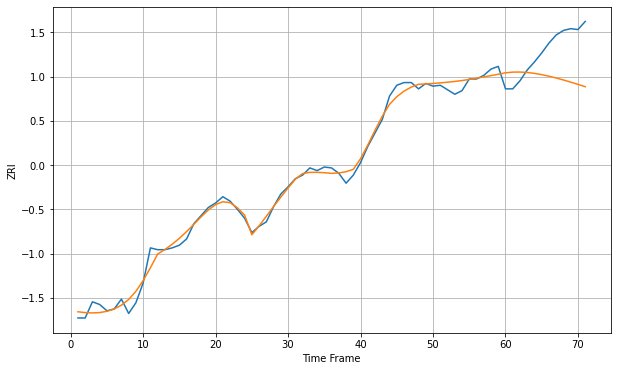

Wall time: 11 s
80211 6.944365532294018 41.589148553325685 [1711.83591488 1712.6231001  1712.71388863 1712.21286311 1711.21670985
 1709.81187649 1708.07413739 1706.06916694 1703.85354161 1701.47585289
 1698.97777018 1696.39497649]

Got an mse at 0.0049 in round 83 and stopped training



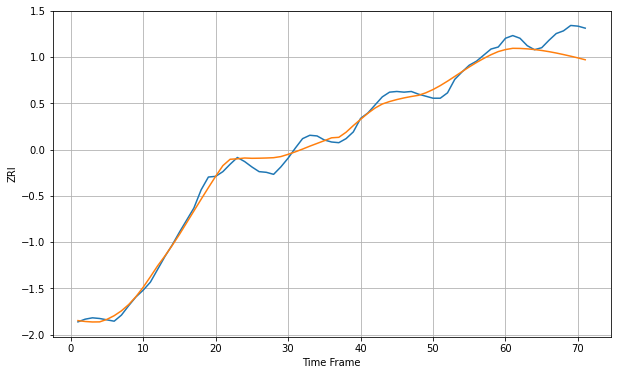

Wall time: 6.89 s
80214 9.568281451942596 28.533551015955176 [1305.22275083 1307.06993174 1306.90148036 1306.28767098 1305.26341852
 1303.86427514 1302.1289925  1300.09789763 1297.80986871 1295.38965535
 1292.83900915 1290.09559161]

Got an mse at 0.0050 in round 163 and stopped training



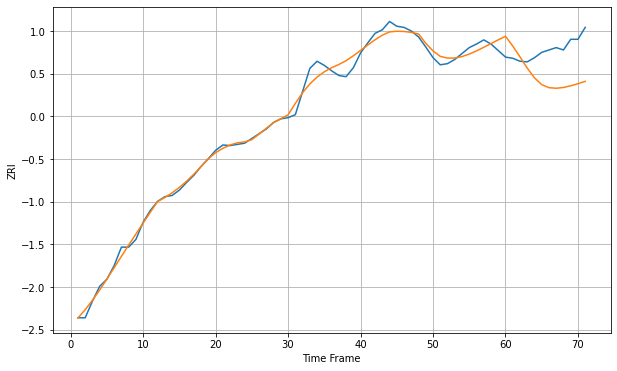

Wall time: 8.4 s
80218 10.104644226017106 56.731433027000044 [1462.06159699 1445.66177009 1427.37220061 1408.49806879 1392.03301171
 1380.65000288 1375.50745096 1374.53349842 1375.86741997 1378.65625115
 1382.19745169 1386.14258032]

Got an mse at 0.0050 in round 119 and stopped training



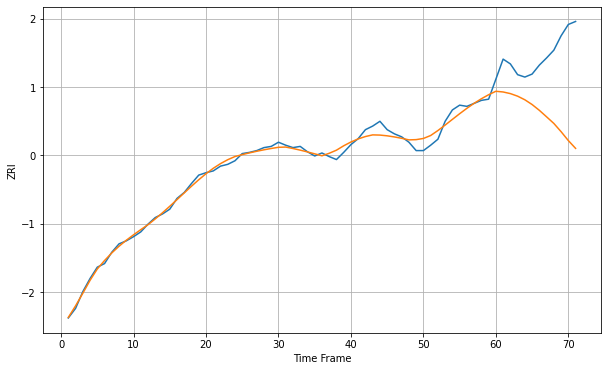

Wall time: 7.76 s
80226 8.037845769919441 111.88480046438826 [1466.23008679 1465.05367283 1462.33451132 1458.03439136 1451.97354162
 1444.03517897 1434.3338607  1423.44802827 1412.41639127 1398.6339878
 1383.75870852 1370.69505358]

Got an mse at 0.0049 in round 103 and stopped training



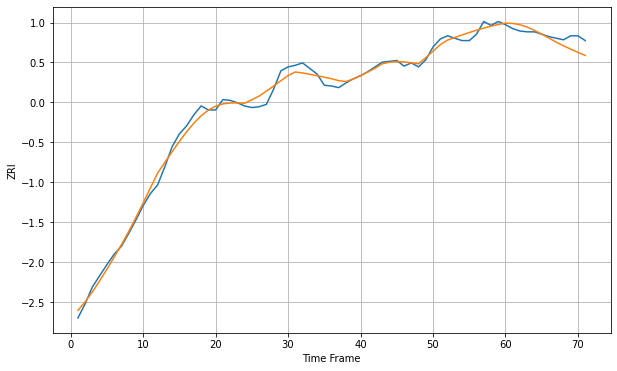

Wall time: 7.35 s
80229 6.995605614204901 10.373740271345682 [1410.93940829 1410.53076943 1408.86540205 1405.91654568 1401.84857775
 1397.08139337 1392.05730371 1387.03679916 1382.48285222 1378.2453829
 1374.1992347  1370.38915122]

Got an mse at 0.0050 in round 108 and stopped training



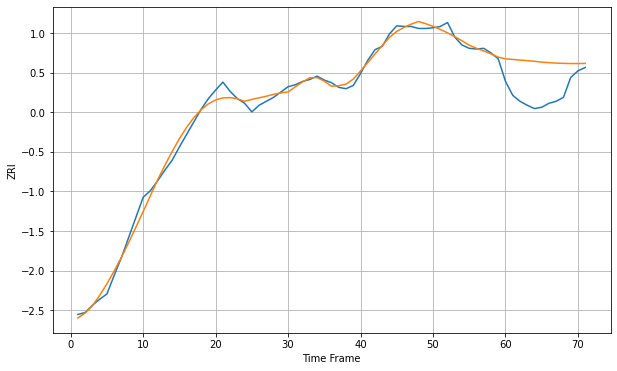

Wall time: 7.46 s
80231 8.399957034498174 52.115306405053396 [1358.10964614 1357.22750955 1356.30093241 1355.35776703 1354.42360228
 1353.17580809 1352.34768606 1351.6998254  1351.25209235 1351.01551559
 1350.99236428 1351.17698024]

Got an mse at 0.0049 in round 72 and stopped training



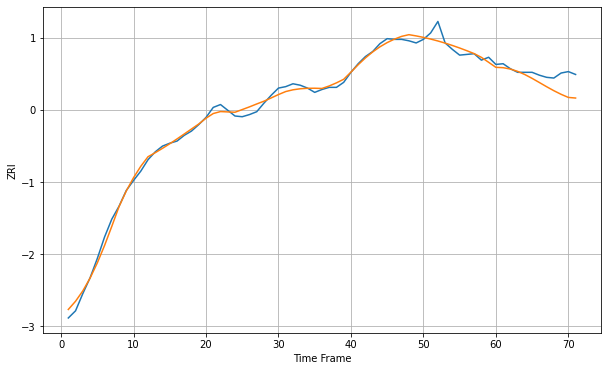

Wall time: 6.37 s
80233 7.000712585975616 18.220373550883572 [1416.96735311 1416.45840549 1414.58020243 1411.31684445 1406.86178218
 1401.54659599 1395.76464466 1389.91149591 1384.33535365 1379.29655402
 1374.94620437 1374.08629729]

Got an mse at 0.0049 in round 132 and stopped training



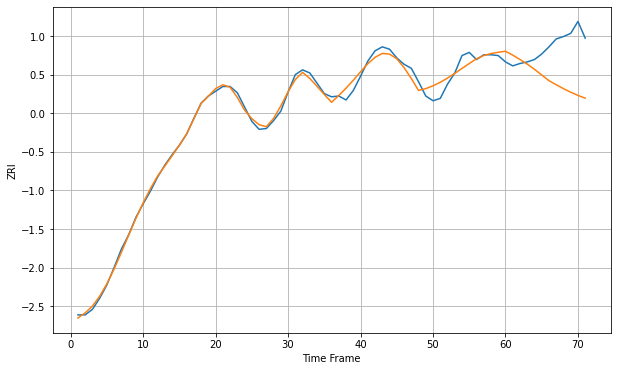

Wall time: 8.04 s
80237 6.791820749954762 50.55466731894999 [1461.42394544 1456.51362128 1451.08528318 1445.19976486 1438.68570848
 1431.45745778 1424.32439778 1419.16914182 1414.2669019  1409.75110857
 1405.75287238 1402.35449398]

Got an mse at 0.0049 in round 216 and stopped training



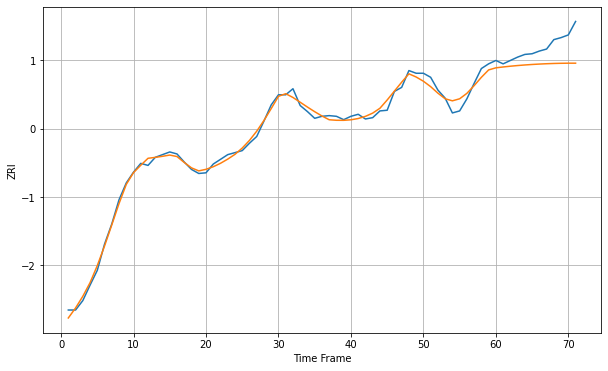

Wall time: 9.91 s
80301 7.1026397736237215 28.939386921016396 [1752.07223476 1753.3491144  1754.47756136 1755.46589104 1756.32264091
 1757.05549395 1757.67030466 1758.17027644 1758.55536136 1758.82196612
 1758.96303569 1758.96853311]

Got an mse at 0.0049 in round 88 and stopped training



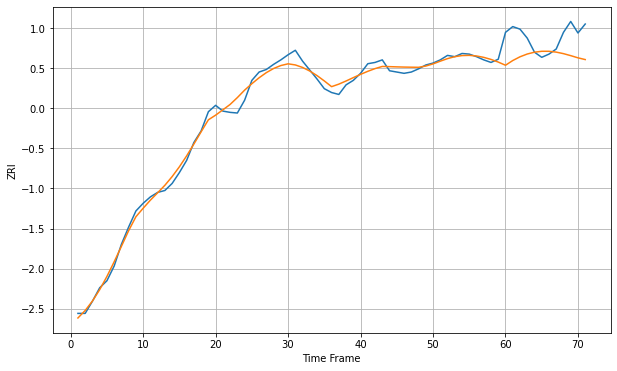

Wall time: 6.81 s
80401 8.675715931107383 37.20831978889017 [1545.60561474 1552.96516776 1558.81020886 1563.14968001 1566.01079435
 1567.42220863 1567.42594971 1566.12264448 1563.73264863 1560.61743934
 1557.20348366 1554.47706673]

Got an mse at 0.0050 in round 136 and stopped training



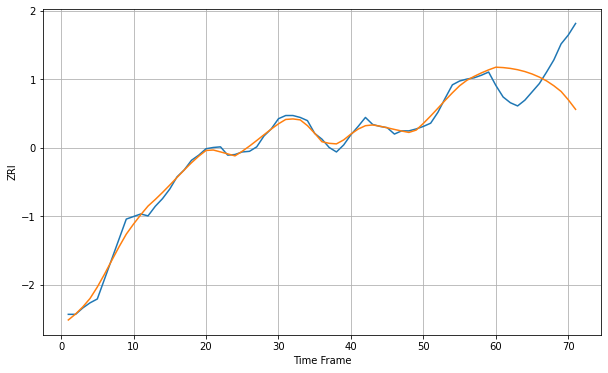

Wall time: 8.12 s
80503 7.511508165823678 62.99428011752097 [1423.59225378 1422.98118383 1421.69181911 1419.65733504 1416.78047384
 1412.95630236 1408.09356876 1402.13137965 1394.56409395 1385.66004114
 1372.50275144 1357.64802663]

Got an mse at 0.0049 in round 73 and stopped training



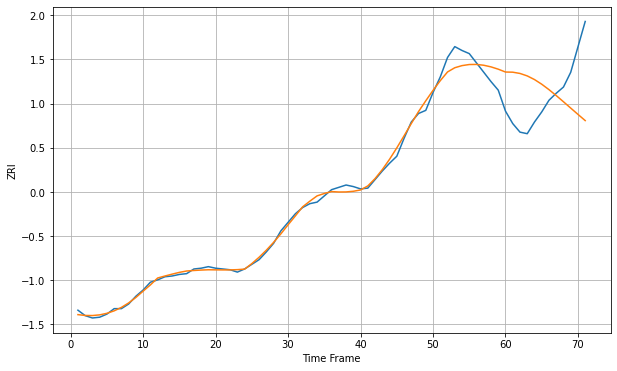

Wall time: 6.62 s
80904 7.8505096275942154 63.79537665871255 [1025.31174255 1025.10013674 1023.47958126 1020.31150013 1015.62121926
 1009.62198681 1002.64693091  995.03511429  987.06219073  978.93941277
  970.83151394  962.85651046]

Got an mse at 0.0050 in round 144 and stopped training



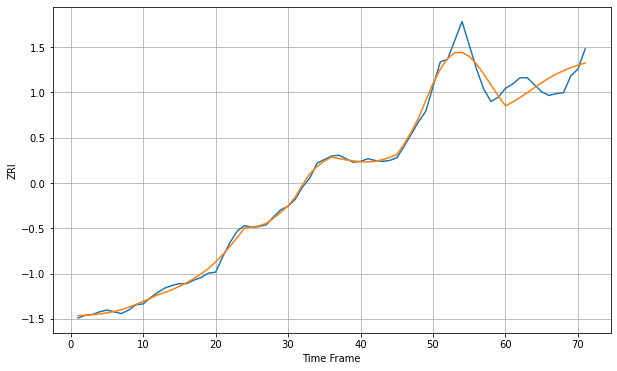

Wall time: 8.27 s
80915 7.207979956690626 17.338013565227556 [928.09342398 932.50387448 937.53397611 943.06800261 948.82840715
 954.45233486 959.62941215 964.19404364 968.12180476 971.47214085
 974.33353654 976.79206641]

Got an mse at 0.0050 in round 155 and stopped training



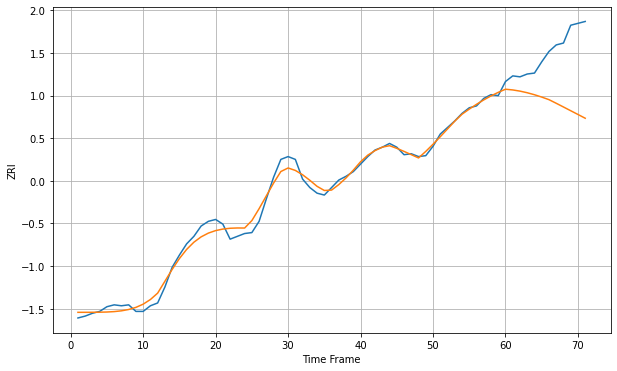

Wall time: 8.3 s
84047 6.367572798904443 59.43687117558123 [1110.78131198 1110.02391138 1108.76000208 1107.03441943 1104.90206319
 1102.42445868 1099.66021563 1095.80612103 1091.851749   1087.86027316
 1083.88098871 1079.85852655]

Got an mse at 0.0050 in round 262 and stopped training



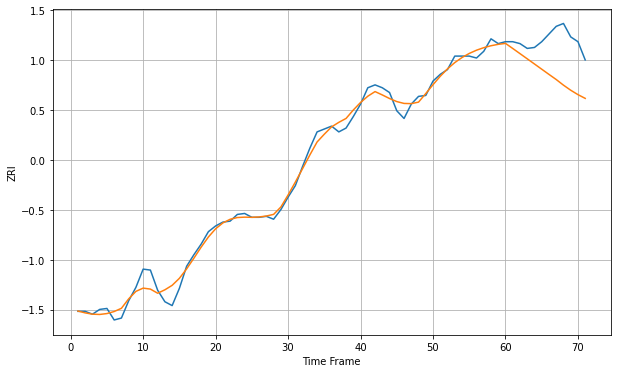

Wall time: 11 s
84095 7.325851052145026 38.85314566863598 [1335.23184002 1329.94103639 1324.55994546 1319.1651322  1313.75987632
 1308.32949502 1302.91393814 1297.56959789 1291.70531904 1286.42173365
 1281.82842925 1277.92730388]

Got an mse at 0.0049 in round 85 and stopped training



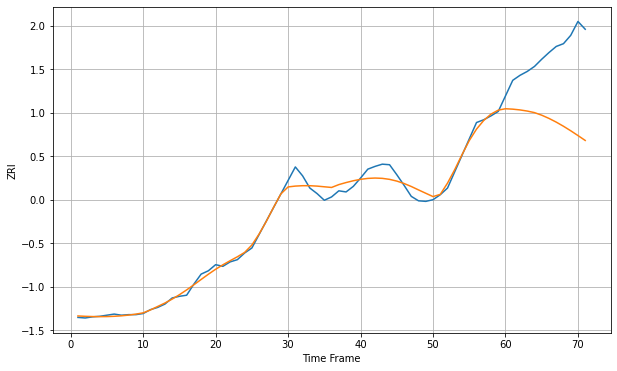

Wall time: 6.87 s
84102 10.953002817172942 127.76844957721627 [1095.81340026 1095.07165894 1093.69828848 1091.63795122 1088.84138383
 1084.19262825 1078.39397307 1071.73719705 1064.28237408 1056.1510183
 1047.54220005 1038.71328266]

Got an mse at 0.0049 in round 51 and stopped training



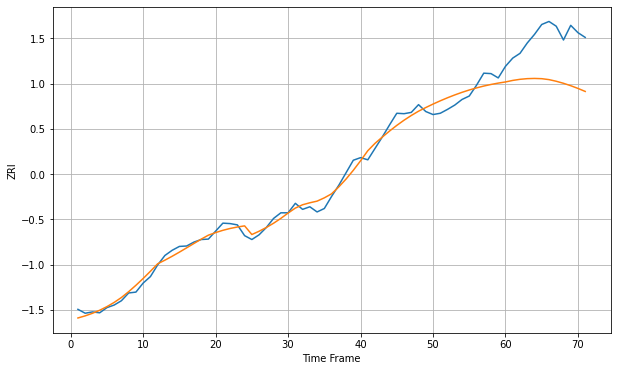

Wall time: 5.89 s
84103 14.640370330362632 107.0110632647992 [1358.64628128 1362.19717258 1364.76953631 1366.30872883 1366.79377303
 1366.23598672 1364.06453063 1360.25509387 1355.5304053  1349.96665625
 1343.63943626 1336.62433658]

Got an mse at 0.0050 in round 245 and stopped training



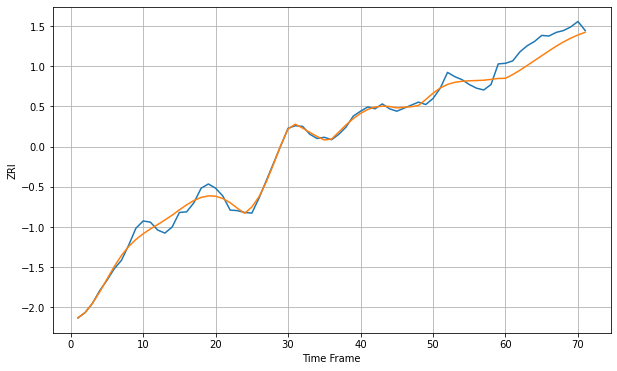

Wall time: 10.7 s
84106 9.348550623509425 25.049948724427903 [1238.30704967 1244.49862631 1251.65066096 1259.46261268 1267.53067368
 1275.49387321 1283.4662732  1291.20355969 1298.2310827  1304.43733739
 1309.75676949 1314.16889974]

Got an mse at 0.0050 in round 124 and stopped training



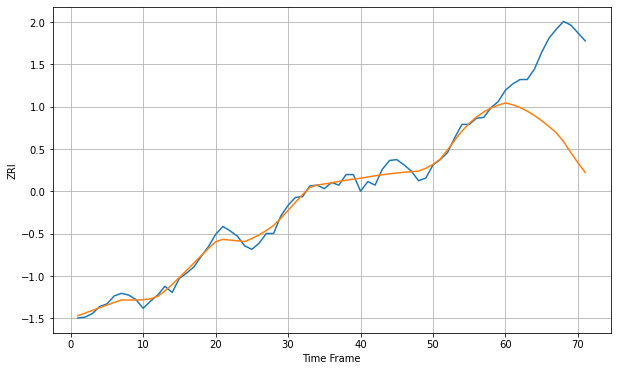

Wall time: 7.78 s
84119 6.790202191460087 99.81784168698995 [1020.37573377 1018.35795745 1015.25085571 1011.12588382 1006.07170076
 1000.19389433  993.61767891  986.50045999  976.60103881  964.19980867
  952.37457926  941.35890132]

Got an mse at 0.0050 in round 113 and stopped training



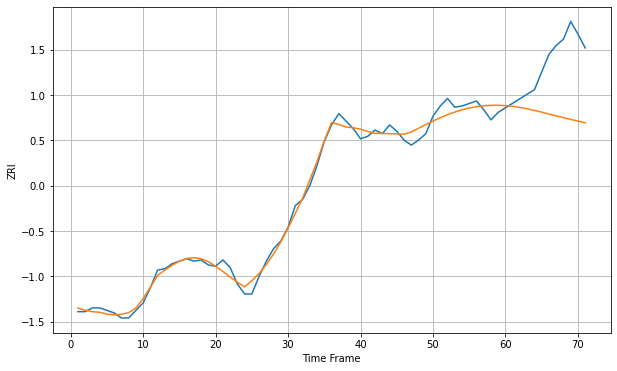

Wall time: 7.5 s
84403 5.055411883546991 45.651127022369685 [890.31595828 889.72801496 888.86457235 887.77226873 886.50605543
 885.12241443 883.6741177  882.20685312 880.75735216 879.3525736
 878.009654   876.73650073]

Got an mse at 0.0050 in round 119 and stopped training



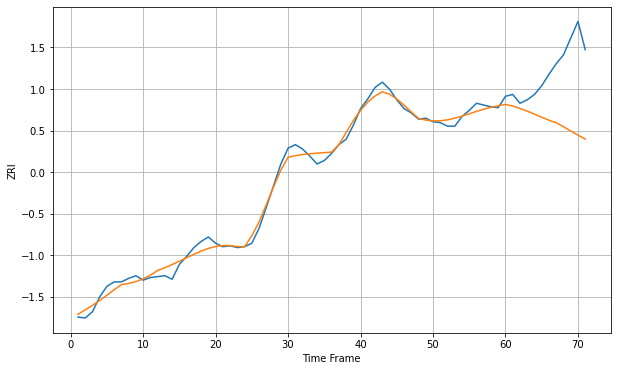

Wall time: 7.44 s
85008 6.636022419542218 67.25121105056851 [1044.65398602 1042.92521739 1040.1332979  1037.06128165 1033.73807826
 1030.15260636 1026.73197884 1023.95454973 1019.40480728 1014.51268151
 1009.78913698 1005.39235304]

Got an mse at 0.0050 in round 134 and stopped training



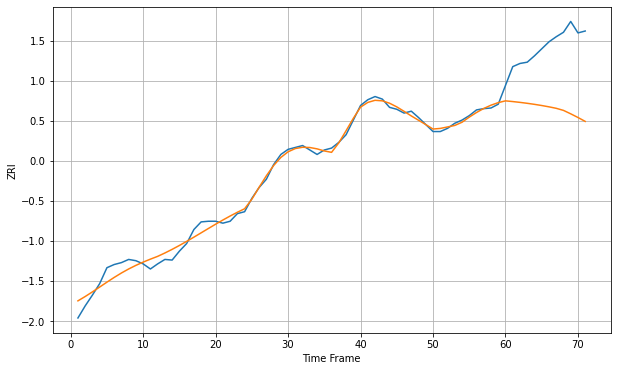

Wall time: 8.09 s
85014 8.857734969680967 100.97607096822394 [1170.22340617 1169.11788065 1167.8394389  1166.38421126 1164.74239615
 1162.89827975 1160.83092372 1158.51561984 1155.23698191 1149.85209167
 1144.08240213 1137.9245548 ]

Got an mse at 0.0050 in round 60 and stopped training



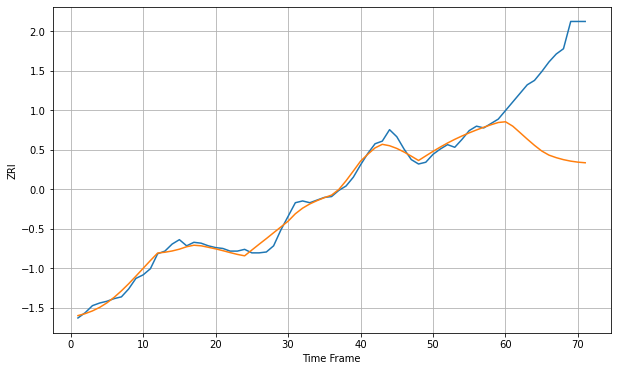

Wall time: 6.29 s
85015 6.272989575711306 107.1744663983644 [934.00212347 929.01119851 921.70768815 914.29609285 907.20632627
 900.77589011 896.09085103 893.20383726 890.93809761 889.25789225
 888.10364164 887.40492784]

Got an mse at 0.0050 in round 105 and stopped training



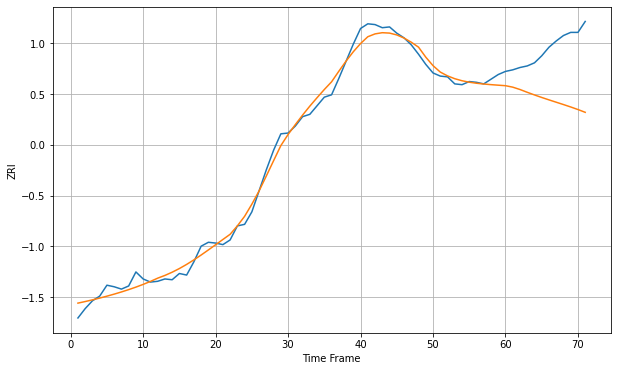

Wall time: 7.1 s
85016 9.061157825203917 69.71923198506079 [1299.68241015 1297.81249609 1294.79381684 1291.22853581 1287.82846774
 1284.59922783 1281.51225698 1278.50806889 1275.50429429 1272.40638202
 1269.12041166 1265.56883256]

Got an mse at 0.0050 in round 146 and stopped training



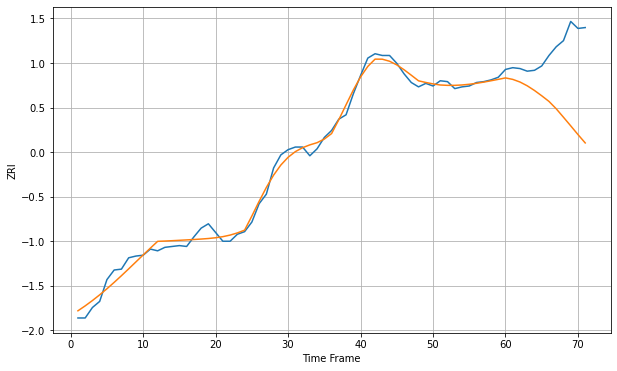

Wall time: 8.34 s
85018 7.180384537557555 73.41667536013502 [1205.27514591 1203.58711608 1200.56383997 1196.22893615 1190.85352885
 1184.77943013 1178.32370889 1169.8653743  1160.16131139 1150.31243316
 1140.31637988 1130.72494052]

Got an mse at 0.0050 in round 252 and stopped training



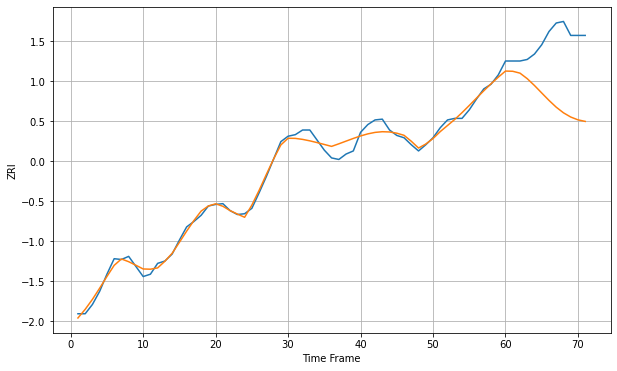

Wall time: 10.7 s
85020 7.26156265749453 79.3263523629659 [1105.03038657 1104.74697314 1102.3484127  1095.21698947 1086.37414911
 1076.75883952 1067.21904503 1058.44132098 1051.1818386  1045.74541284
 1042.11112632 1040.08959425]

Got an mse at 0.0050 in round 314 and stopped training



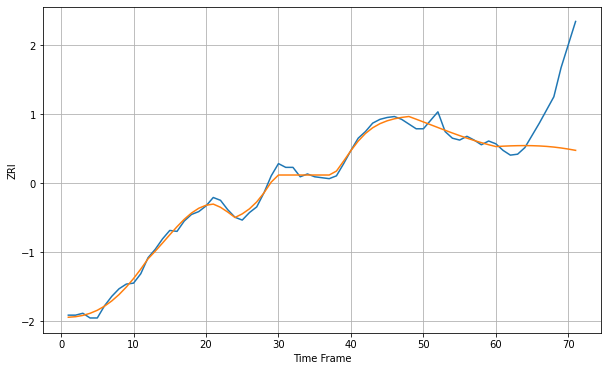

Wall time: 12 s
85027 5.176860617001291 60.31177183565323 [1021.09298919 1021.51381337 1021.83928408 1022.0484342  1022.11982271
 1022.03037933 1021.75538412 1021.27046118 1020.5564349  1019.60686746
 1018.43570947 1017.0820545 ]

Got an mse at 0.0050 in round 142 and stopped training



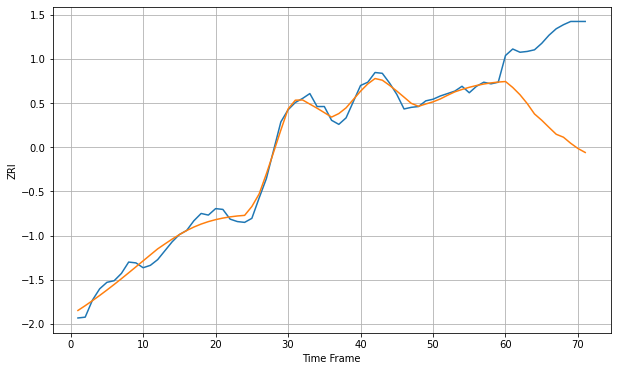

Wall time: 8.09 s
85032 7.660593344384716 111.04669765063682 [1160.87144117 1153.52532391 1144.55984862 1133.64119021 1120.85681514
 1113.06510038 1104.30356446 1095.7642996  1092.11352854 1084.62894193
 1078.21040391 1073.29059032]

Got an mse at 0.0049 in round 112 and stopped training



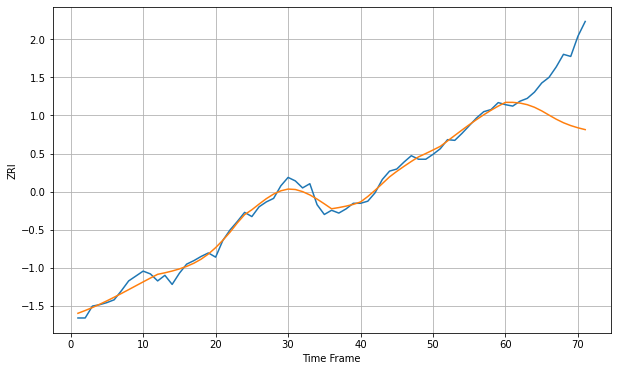

Wall time: 7.58 s
85044 7.619519416751672 76.98546175548132 [1353.32325918 1353.32371789 1352.30369021 1350.02515052 1346.2827219
 1341.13494977 1335.14398414 1329.24101846 1324.16891401 1320.13080631
 1316.94517145 1314.33168802]

Got an mse at 0.0050 in round 108 and stopped training



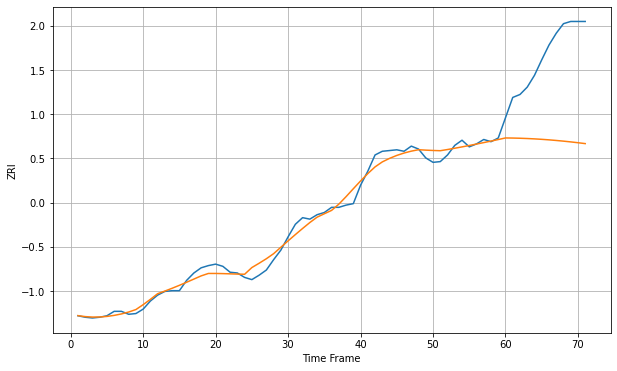

Wall time: 7.37 s
85201 8.421055884687684 120.87249989280097 [1047.0692438  1046.92699798 1046.67029914 1046.29770184 1045.80911079
 1045.20580739 1044.49041682 1043.66683099 1042.74010115 1041.71631181
 1040.60244452 1039.40623722]

Got an mse at 0.0049 in round 119 and stopped training



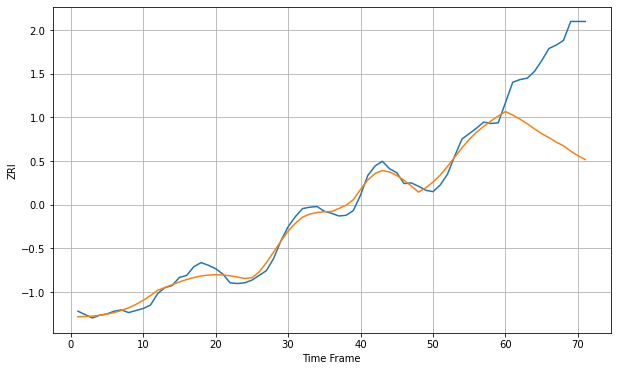

Wall time: 7.42 s
85204 9.025647395311408 132.29723066172858 [1133.58433243 1128.48343918 1122.43337855 1115.49138745 1108.00038319
 1100.91051088 1094.98823042 1088.32188209 1082.97705257 1074.94215782
 1068.24577517 1062.55443264]

Got an mse at 0.0049 in round 35 and stopped training



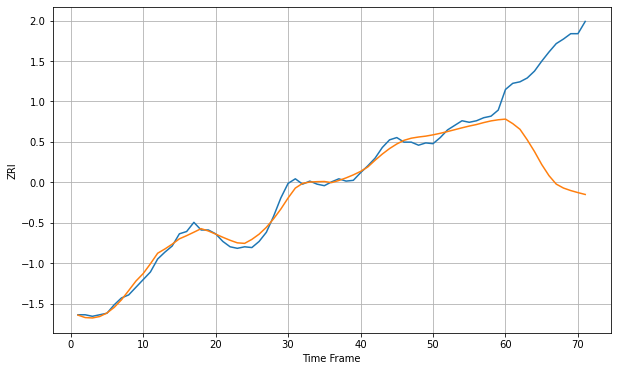

Wall time: 5.82 s
85224 7.134684090454214 152.46385780176612 [1142.16227945 1136.25333033 1128.81259228 1115.01936746 1099.70729091
 1082.69958826 1068.16959949 1057.08381767 1051.91871284 1048.62384868
 1045.93967199 1043.51633585]

Got an mse at 0.0050 in round 319 and stopped training



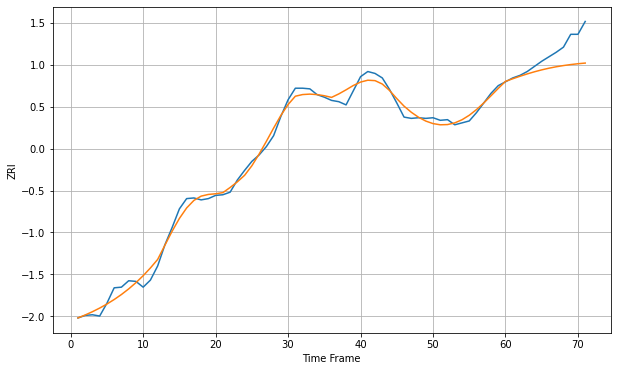

Wall time: 12.2 s
85251 9.19873939200363 29.50963409610502 [1394.70150474 1398.73493765 1402.62487934 1406.27324096 1409.60813828
 1412.58497094 1415.18513237 1417.4128173  1419.29007828 1420.85044592
 1422.13197276 1423.17101562]

Got an mse at 0.0050 in round 139 and stopped training



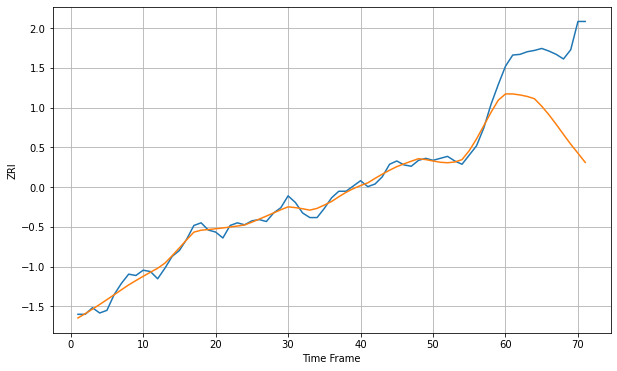

Wall time: 8.09 s
85260 8.459003715073427 118.03116155116462 [1490.87278259 1490.86909235 1489.31443198 1487.06642212 1483.56555653
 1472.20621083 1459.16640412 1444.63566148 1429.37389072 1414.49226292
 1400.76505136 1386.83445822]

Got an mse at 0.0050 in round 150 and stopped training



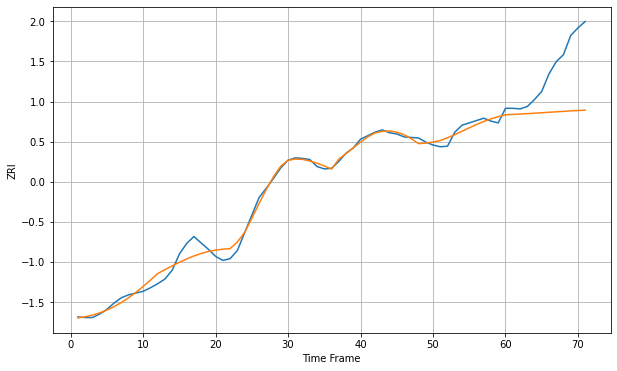

Wall time: 8.13 s
85281 9.685267497662949 83.45096993091818 [1215.83976245 1216.45472842 1217.1325743  1217.85122095 1218.59936058
 1219.37334075 1220.16850428 1220.97240108 1221.76406682 1222.51816528
 1223.2103171  1223.82091877]

Got an mse at 0.0050 in round 62 and stopped training



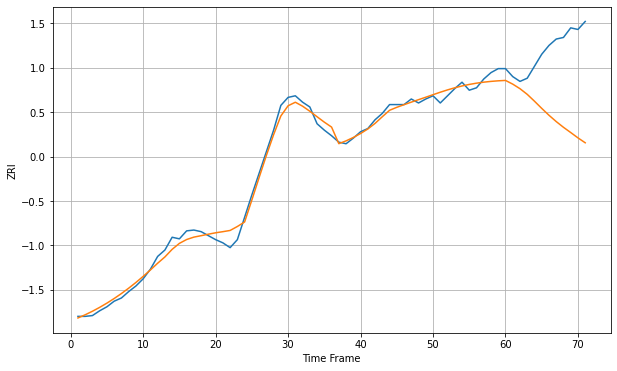

Wall time: 6.48 s
85282 7.739201270432954 89.83524949128474 [1192.23004001 1187.58326847 1181.87379572 1174.79659116 1166.21527655
 1157.23860245 1148.64226025 1140.74220786 1133.56230086 1127.02123471
 1120.34026445 1114.20184323]

Got an mse at 0.0050 in round 81 and stopped training



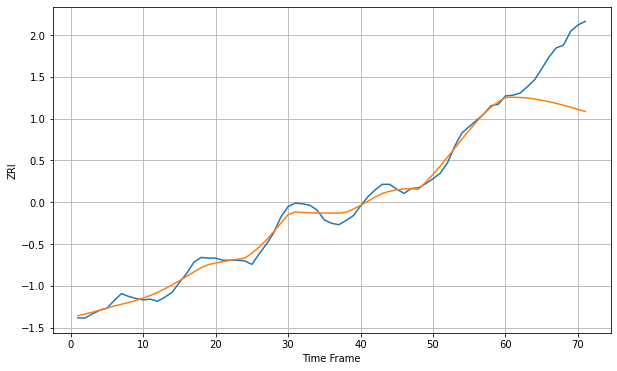

Wall time: 6.75 s
85283 8.407739784865736 73.27231762697092 [1204.92221116 1205.06996135 1204.78800689 1203.97528935 1202.60677286
 1200.85512535 1198.7480791  1196.324506   1193.63509773 1190.74047312
 1187.70688995 1184.60059338]

Got an mse at 0.0050 in round 148 and stopped training



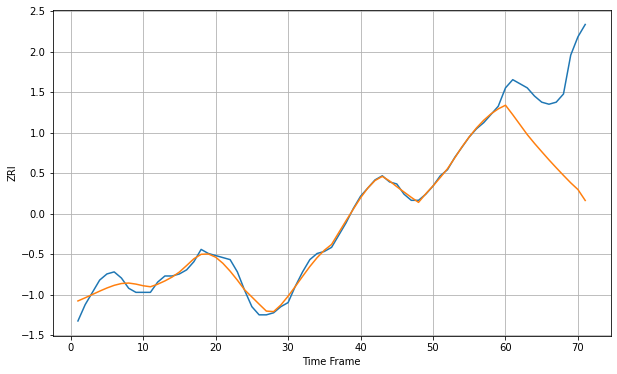

Wall time: 8.03 s
85705 2.772455124971896 43.448638606977944 [710.50542241 705.86193419 701.01331132 696.15886091 691.85123335
 687.79244409 683.78190757 679.94407877 676.19807665 672.56252312
 669.25977188 663.93407915]

Got an mse at 0.0050 in round 169 and stopped training



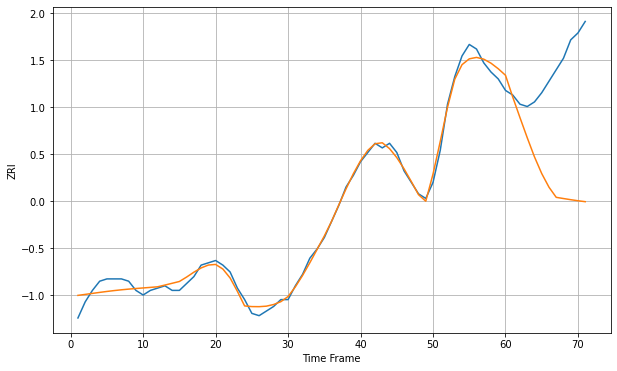

Wall time: 8.91 s
85716 2.8740751037358807 47.711157279809356 [754.59126832 745.1101208  736.14911099 727.42048983 719.07843778
 711.82536312 705.90037263 701.48644312 700.96367894 700.46011213
 700.00167912 699.59737606]

Got an mse at 0.0050 in round 156 and stopped training



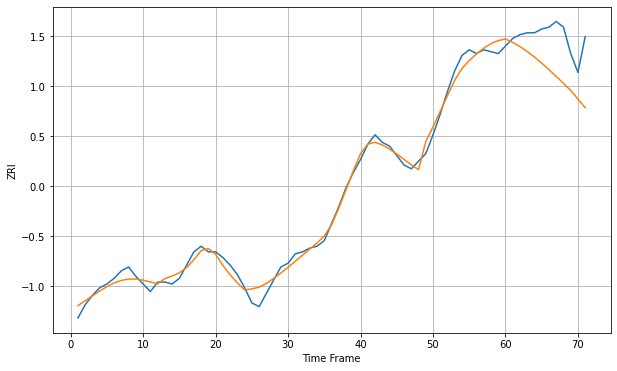

Wall time: 8.47 s
85719 3.7214050610126748 20.185066315824294 [810.74100268 808.90344733 806.68576489 804.09345346 801.156367
 797.9295221  794.48476482 790.89541824 787.22076638 783.49802261
 778.87592087 774.30769443]

Got an mse at 0.0050 in round 48 and stopped training



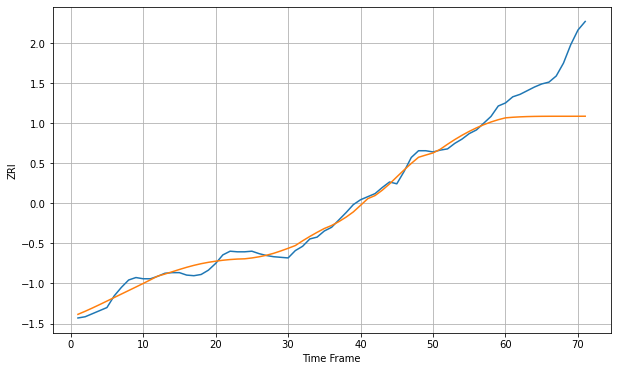

Wall time: 6.02 s
86314 9.11142155592767 82.78738744732165 [1045.68233277 1046.62449696 1047.29312292 1047.74237439 1048.02195354
 1048.17623066 1048.24454402 1048.26142589 1048.25639404 1048.25351913
 1048.27111499 1048.32176701]

Got an mse at 0.0050 in round 286 and stopped training



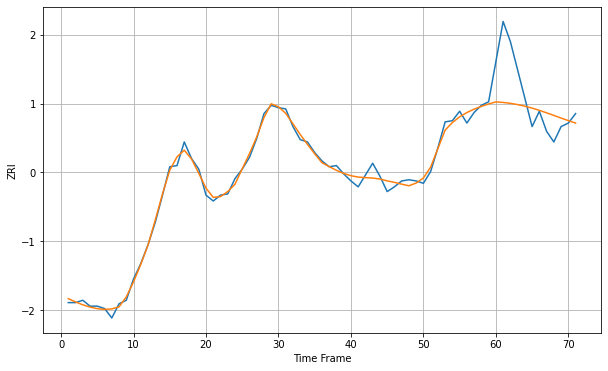

Wall time: 11.3 s
87111 4.091924876715715 29.74520794376572 [917.92075509 917.45958558 916.7037611  915.65032454 914.29856888
 912.65780031 910.7593092  908.66554915 906.46393    904.24293611
 902.06795064 899.9738684 ]

Got an mse at 0.0050 in round 481 and stopped training



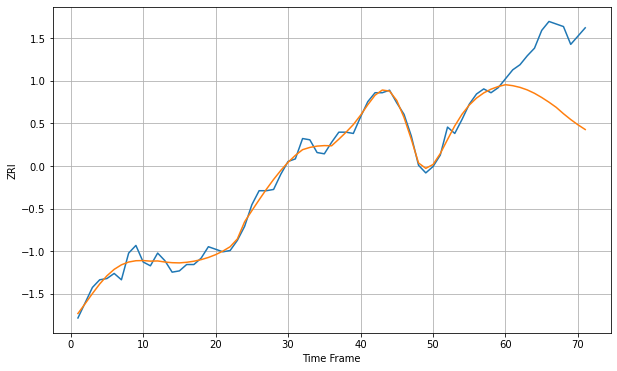

Wall time: 16.1 s
89030 4.722460147752084 52.4280146727297 [868.30472292 867.53663968 866.207118   864.22636691 861.5497662
 858.25178145 854.56612385 850.5114189  845.51492955 840.93473142
 836.8002998  833.09441795]

Got an mse at 0.0050 in round 130 and stopped training



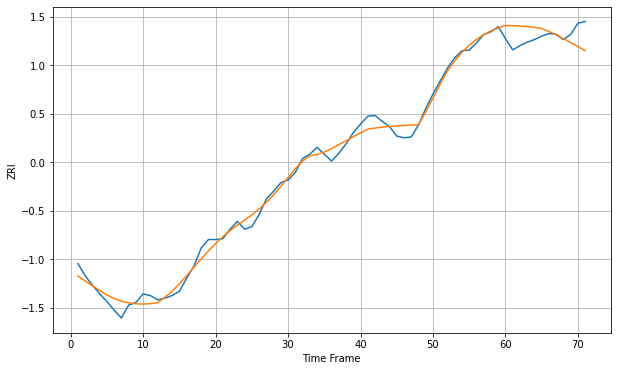

Wall time: 7.87 s
89052 7.9468487937786 18.54153660325154 [1479.34740787 1479.0935708  1478.67858889 1478.03833578 1477.10265892
 1475.80570163 1472.43684638 1468.42054276 1464.08778083 1459.52799441
 1454.83983791 1450.09284098]

Got an mse at 0.0050 in round 166 and stopped training



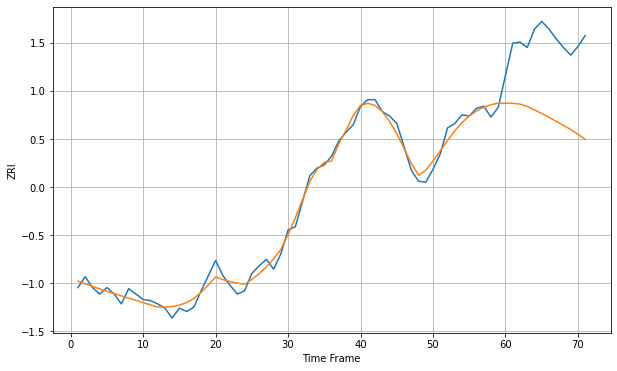

Wall time: 8.5 s
89101 6.223474106975061 71.00807967854534 [875.64955385 875.6600518  874.94544468 872.73388048 869.62996336
 866.27954705 862.72443656 859.04060517 855.33241689 851.56508636
 847.06872815 842.49332954]

Got an mse at 0.0050 in round 128 and stopped training



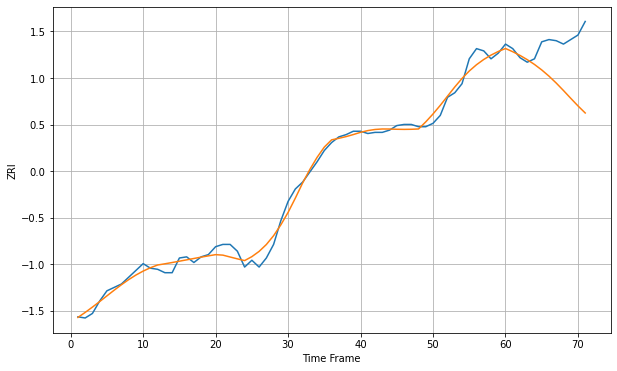

Wall time: 7.93 s
89108 5.790609075597 38.67333951391449 [1083.11036526 1080.26792844 1077.00159333 1073.26880696 1069.01133603
 1064.16551243 1058.68599746 1052.5840136  1045.97808373 1039.12993963
 1032.40462977 1026.13895595]

Got an mse at 0.0050 in round 76 and stopped training



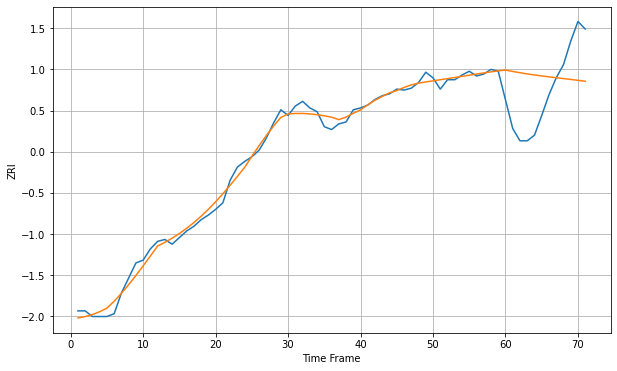

Wall time: 6.66 s
89117 6.166773233802989 50.1205302137001 [1288.26790126 1286.79690073 1285.43174458 1284.18587376 1283.05449914
 1282.01958774 1281.05561322 1280.13462307 1279.22952912 1278.31478436
 1277.3643461  1276.34819141]


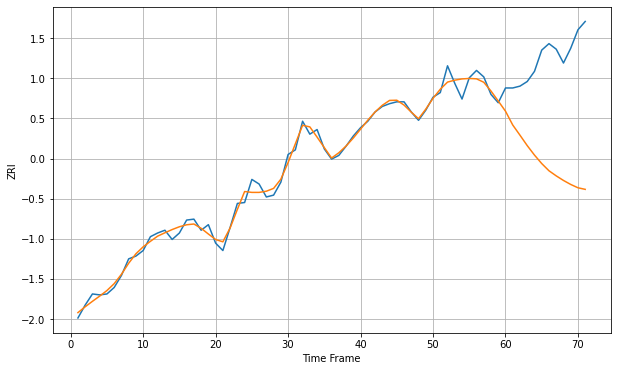

Wall time: 16.3 s
89119 6.48690535573832 119.42264630940815 [1106.86206394 1091.8950622  1080.85126733 1069.59124017 1059.3338385
 1050.16747099 1042.35962616 1036.83237861 1031.88348571 1027.551484
 1023.9596149  1022.24181579]

Got an mse at 0.0049 in round 56 and stopped training



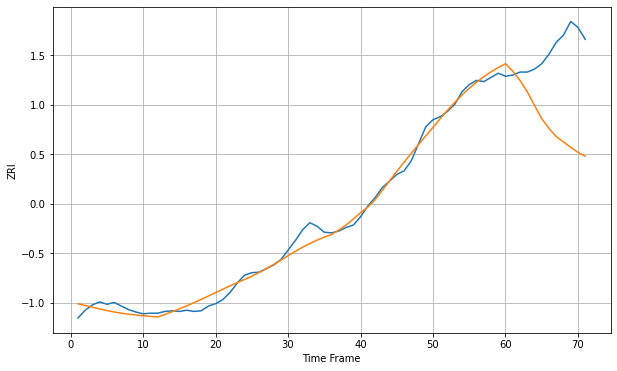

Wall time: 5.98 s
89502 11.461962669982677 133.60757106338028 [1085.08296821 1072.46289936 1056.92917645 1037.78420884 1015.00441672
  992.69812361  976.22494602  962.59384503  953.54138022  944.57643778
  936.10496333  929.6289426 ]


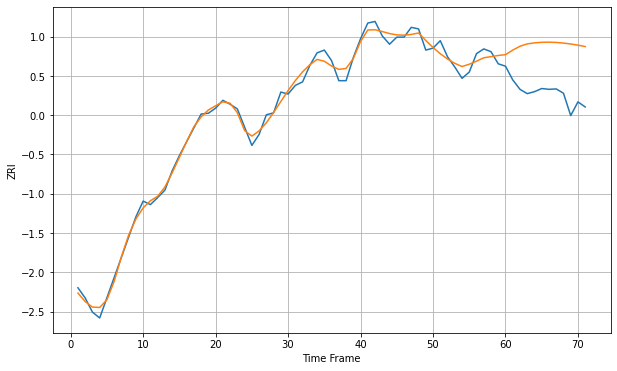

Wall time: 16.4 s
90001 15.724811583637036 124.82586794140114 [2364.31274519 2376.01207847 2385.83016825 2391.79218664 2394.43646974
 2395.88914096 2396.20991401 2395.50362405 2393.90373767 2391.55103403
 2388.57440176 2385.07838738]


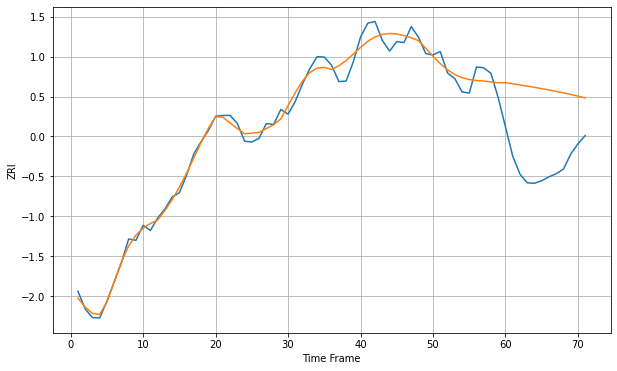

Wall time: 16.3 s
90002 19.939146922301823 177.45998680561246 [2346.29159451 2343.74202183 2341.08637857 2338.32926797 2335.46938787
 2332.49650488 2329.39018195 2326.1206736  2322.65185697 2318.94560505
 2314.96676814 2310.68794478]

Got an mse at 0.0049 in round 71 and stopped training



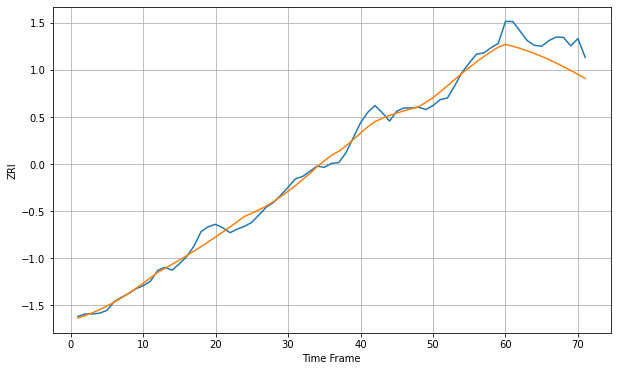

Wall time: 6.1 s
90003 16.551047909537772 55.86138268175338 [2082.45900416 2077.82452573 2072.45756151 2066.38931727 2059.64635439
 2052.25716625 2044.25704832 2035.69070814 2026.61286639 2017.0874783
 2007.18630174 1996.98743034]

Got an mse at 0.0050 in round 93 and stopped training



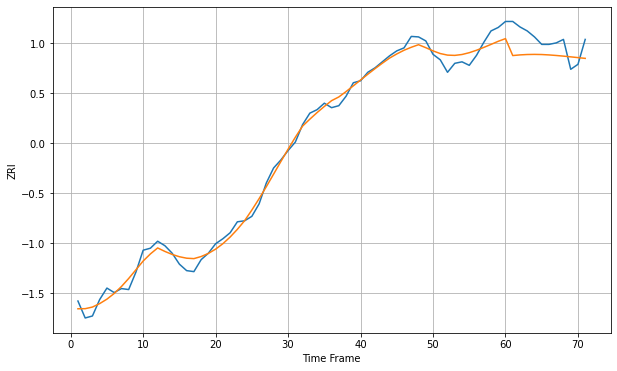

Wall time: 6.87 s
90004 14.077189515547923 38.03516270228661 [2249.58284666 2215.59039423 2216.91399517 2217.68860492 2217.9154959
 2217.64936595 2216.84876083 2215.74511774 2214.43201223 2212.98398311
 2211.46698503 2209.93378213]

Got an mse at 0.0050 in round 121 and stopped training



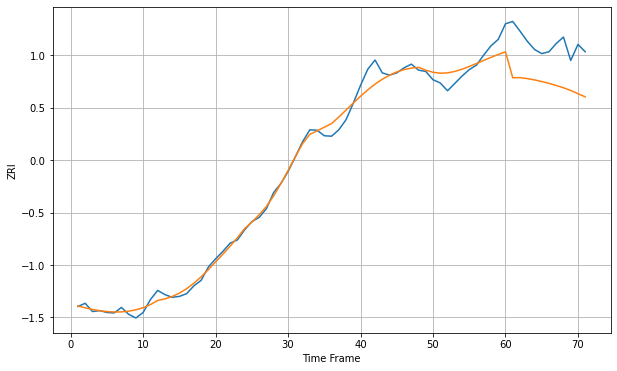

Wall time: 7.54 s
90006 16.006412152559296 88.77511450377644 [2142.83588851 2086.2992363  2086.65498322 2084.54394418 2081.68733733
 2078.18161504 2074.11072957 2069.53852311 2064.50560148 2058.60430254
 2051.71299134 2044.68146682]

Got an mse at 0.0050 in round 272 and stopped training



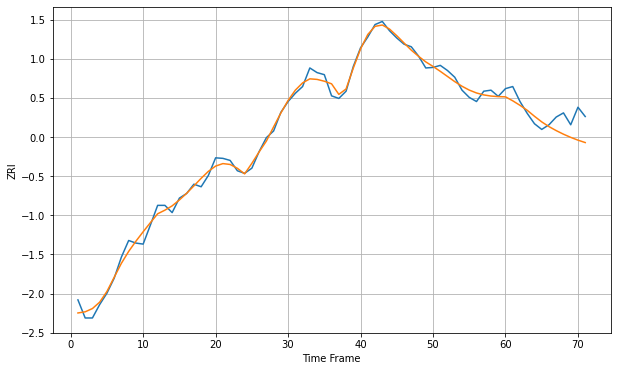

Wall time: 10.7 s
90007 10.674313560302108 30.457996444640706 [2235.07723567 2227.40110798 2218.65031267 2209.0187905  2197.43220195
 2186.59694022 2177.45243149 2169.70671664 2162.76749352 2156.62206865
 2151.24378651 2146.57918519]

Got an mse at 0.0050 in round 414 and stopped training



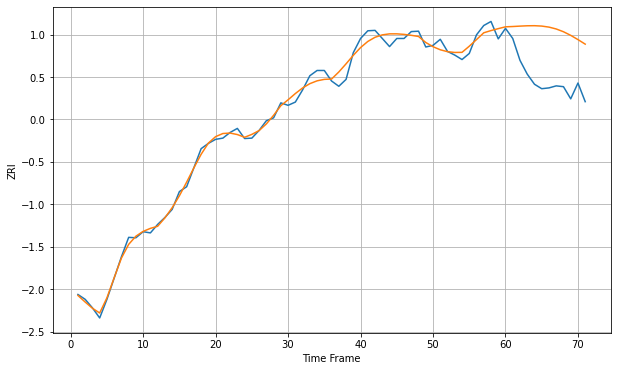

Wall time: 13.6 s
90011 14.772765572477986 123.80481234204959 [2409.76615389 2410.52412759 2411.52202074 2412.34990295 2412.54467915
 2411.60868159 2409.04918372 2404.4572261  2397.63008502 2388.70455246
 2378.21907739 2367.01965881]

Got an mse at 0.0050 in round 205 and stopped training



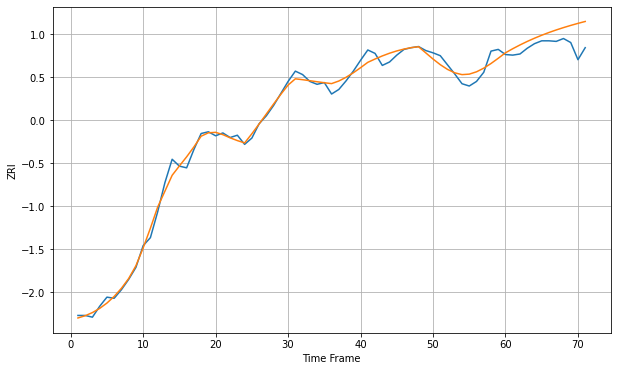

Wall time: 9.31 s
90012 10.594767448383807 26.944538811226234 [2417.08453364 2424.17571076 2430.78580877 2436.90836655 2442.55649074
 2447.75873076 2452.55369504 2456.98414411 2461.0918117  2464.91397947
 2468.48206599 2471.82177114]


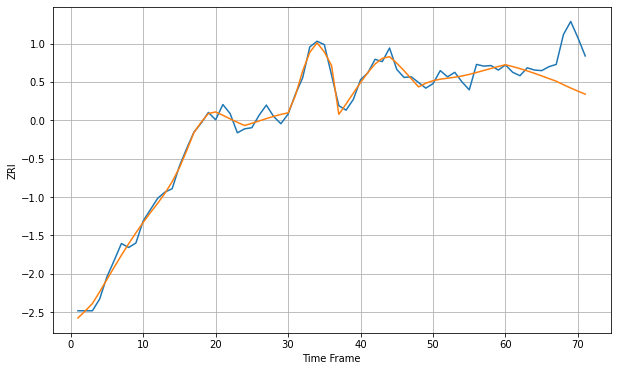

Wall time: 15.6 s
90015 11.09329087204029 55.527634069960556 [2523.43236314 2520.11163723 2516.51560269 2512.56120497 2508.23158119
 2503.61438015 2498.8849918  2494.23083968 2488.10337818 2482.17105332
 2476.63901554 2471.41680409]

Got an mse at 0.0050 in round 135 and stopped training



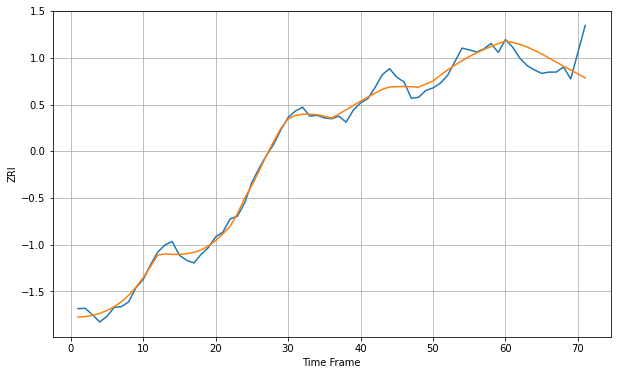

Wall time: 7.49 s
90016 15.381869154232112 47.33965697862291 [2355.53323405 2352.44132963 2347.7016125  2341.44419061 2333.87827817
 2325.29988851 2316.06417958 2306.51776834 2296.92990503 2287.5906874
 2278.49567154 2269.68713208]

Got an mse at 0.0050 in round 97 and stopped training



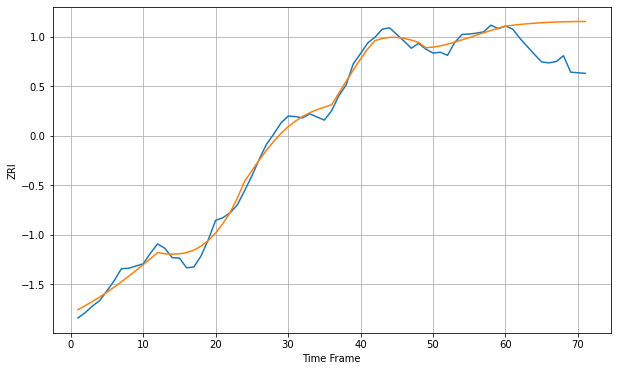

Wall time: 6.97 s
90018 15.659078696186226 80.92270772507942 [2253.68800441 2255.77739443 2257.57322947 2259.10115228 2260.38574512
 2261.45020768 2262.31617911 2263.00365866 2263.53099063 2263.91488887
 2264.17048427 2264.31138443]

Got an mse at 0.0050 in round 70 and stopped training



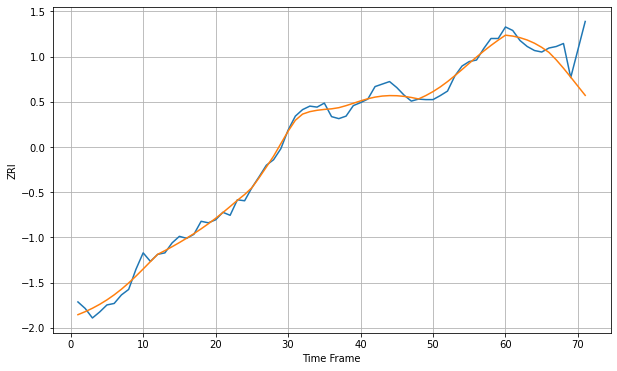

Wall time: 6.27 s
90019 12.628241440167349 51.04291684931714 [2312.62933762 2310.7840554  2307.63597611 2302.95661762 2296.55784744
 2288.31636482 2278.20911274 2263.42414262 2246.66788368 2228.85830594
 2210.59701139 2192.46544959]


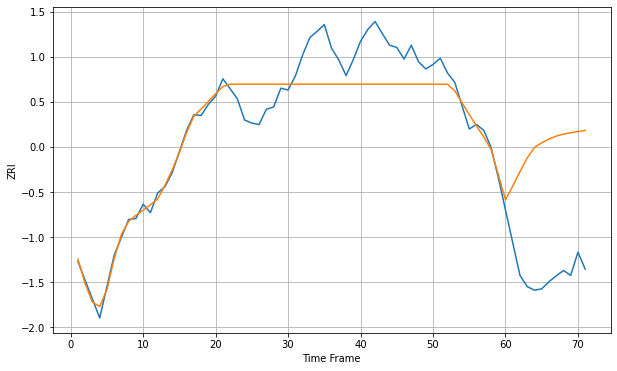

Wall time: 15.7 s
90022 55.85262793569265 277.20870276547583 [2183.63498274 2214.56005499 2246.7299725  2277.28930054 2300.7753274
 2311.21041237 2319.42662375 2326.09515803 2330.41226329 2333.50211894
 2336.22738028 2338.75573178]

Got an mse at 0.0050 in round 397 and stopped training



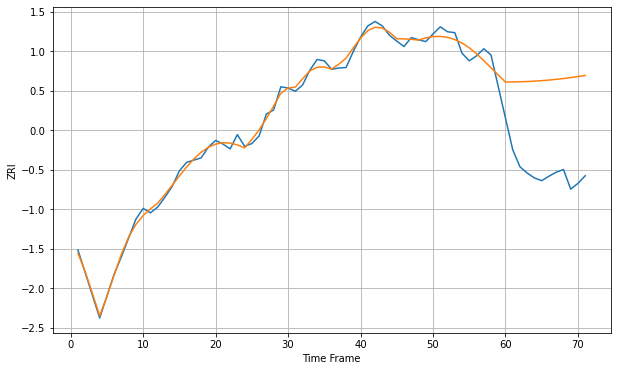

Wall time: 13.2 s
90023 12.454801682902731 205.11660330853817 [2246.50788665 2246.76059822 2247.15965936 2247.7551061  2248.60477388
 2249.64852154 2250.98507182 2252.59407439 2254.45161463 2256.53118369
 2258.80488382 2261.24452311]

Got an mse at 0.0050 in round 93 and stopped training



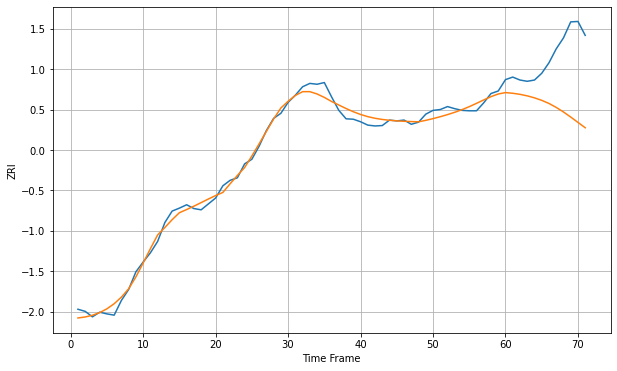

Wall time: 6.86 s
90024 13.466543827150751 137.44437660311735 [2928.19940639 2926.58561585 2924.03861475 2920.45748938 2915.74112697
 2909.78888744 2902.41797956 2893.04431281 2882.19470618 2870.15631094
 2857.44570451 2844.7380676 ]

Got an mse at 0.0050 in round 196 and stopped training



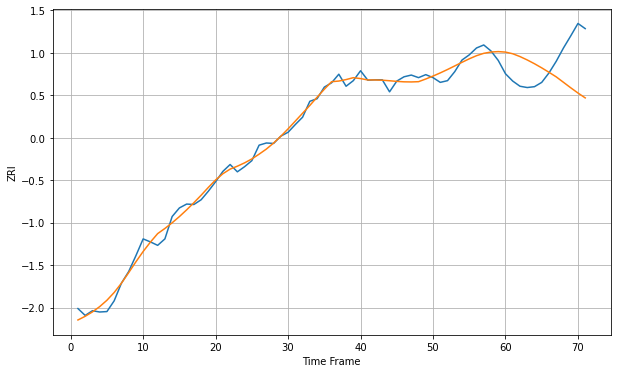

Wall time: 9.03 s
90025 13.943771015698408 88.40190516685679 [3052.41654417 3048.55132183 3042.01263293 3034.15139677 3025.35070016
 3015.72844504 3005.46741118 2994.81048745 2982.16167403 2969.43975111
 2957.26115743 2945.89167007]

Got an mse at 0.0050 in round 263 and stopped training



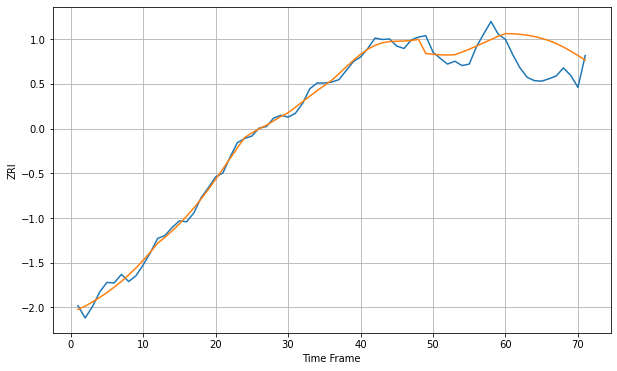

Wall time: 10.5 s
90026 13.318624550735816 65.9758478369357 [2485.39219091 2485.01175322 2483.89662148 2481.98565071 2479.19145554
 2475.40102073 2470.48758074 2464.34610087 2456.96272579 2448.5010008
 2439.19166931 2429.4007643 ]

Got an mse at 0.0050 in round 140 and stopped training



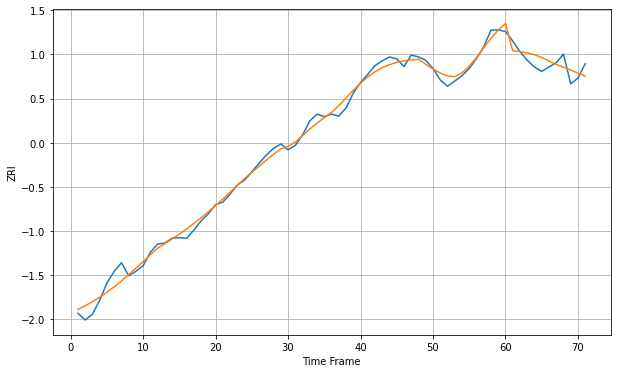

Wall time: 7.92 s
90027 12.83960960653952 20.279293231983583 [2376.62983627 2319.65704012 2318.06343387 2315.47695158 2311.5528742
 2306.00186269 2298.68760169 2291.34720688 2285.71784562 2279.62764038
 2273.38351763 2267.21204643]

Got an mse at 0.0049 in round 54 and stopped training



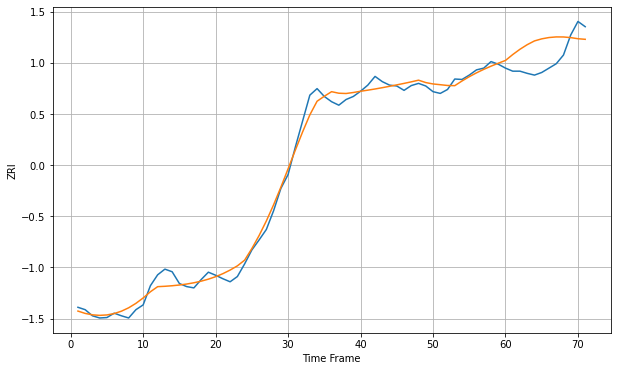

Wall time: 5.94 s
90028 16.28974174349322 52.90135762515184 [2439.6217682  2453.12958822 2465.29870672 2475.78693904 2484.39067335
 2489.1246396  2492.15494792 2493.55216906 2493.43614461 2491.99003816
 2489.41790496 2488.07146217]

Got an mse at 0.0050 in round 152 and stopped training



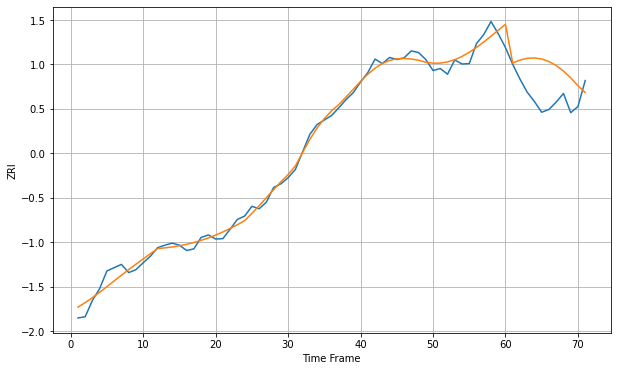

Wall time: 8.11 s
90029 15.295918380783345 79.57548462783512 [2487.97413328 2393.374621   2400.58133435 2404.82667396 2405.77368149
 2403.20665551 2397.0134133  2387.17957995 2373.8134315  2357.19246535
 2337.80291181 2321.22814247]


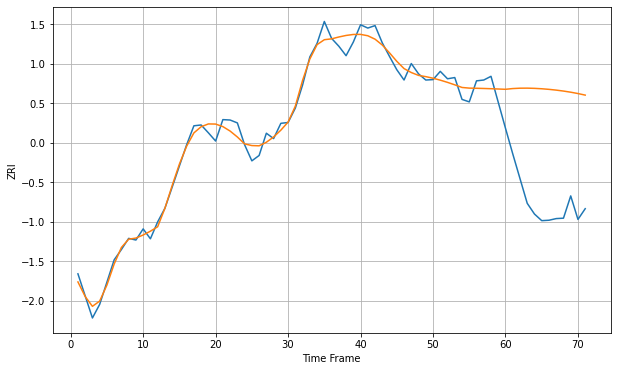

Wall time: 15.5 s
90031 20.278001601393974 270.84234868682944 [2456.51500837 2458.30262478 2459.1785135  2459.29909818 2458.80839879
 2457.81354429 2456.3775393  2454.52231516 2452.23649453 2449.48535308
 2446.22265958 2442.40499194]

Got an mse at 0.0050 in round 292 and stopped training



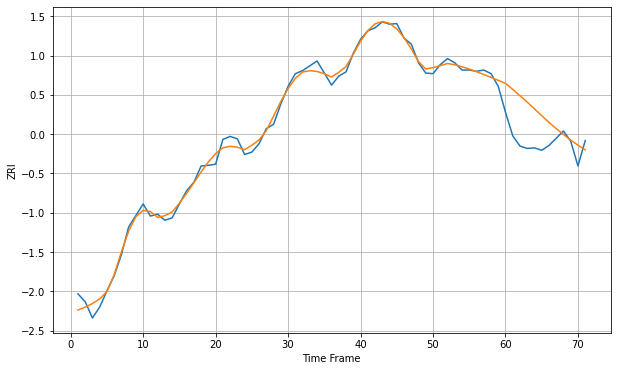

Wall time: 11.2 s
90032 9.163110352885711 51.40140148382267 [2063.98394711 2053.84578173 2043.45285405 2032.81606601 2021.58730128
 2010.33919716 1999.21405039 1988.98068839 1979.17678499 1969.9629562
 1961.47195052 1953.78976569]


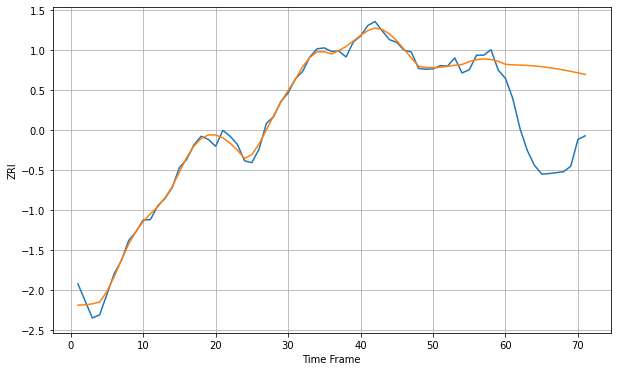

Wall time: 15.7 s
90033 13.038229210764234 183.23353995480818 [2292.9679922  2291.68594583 2291.24832954 2290.48600815 2289.30371508
 2287.68735009 2285.65062603 2283.227398   2280.46645816 2277.42810681
 2274.18122724 2270.79990903]

Got an mse at 0.0049 in round 69 and stopped training



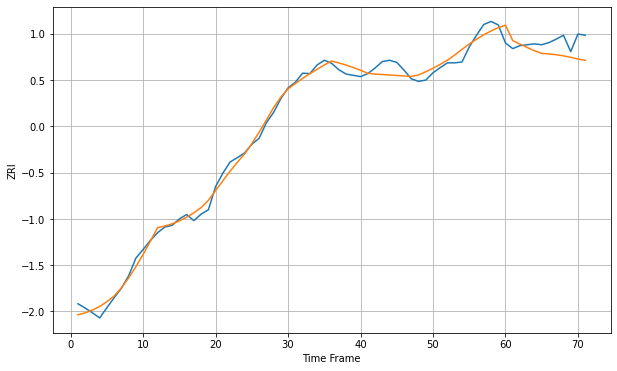

Wall time: 6.06 s
90034 14.937246017006178 34.15931735512602 [2659.45770547 2623.60515616 2615.57035234 2607.63779089 2600.00894662
 2593.96043712 2592.67208916 2590.83907808 2588.24304858 2584.79488922
 2580.85927667 2577.77049591]

Got an mse at 0.0050 in round 67 and stopped training



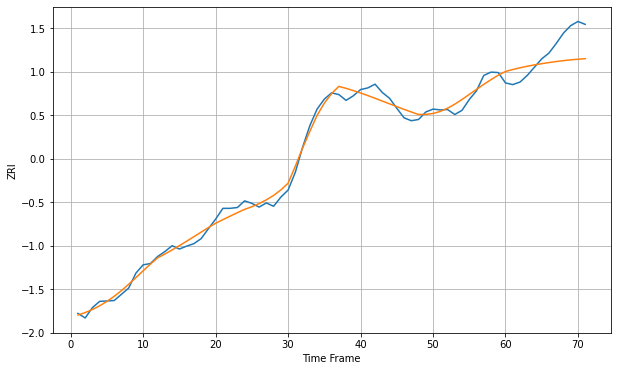

Wall time: 6.33 s
90035 14.711175841774294 52.1374096954074 [2958.53331594 2963.28226573 2967.44515601 2971.13273663 2974.42528566
 2977.38310537 2980.05597786 2982.48870782 2984.72248599 2986.58502093
 2988.05683834 2989.36067628]

Got an mse at 0.0050 in round 105 and stopped training



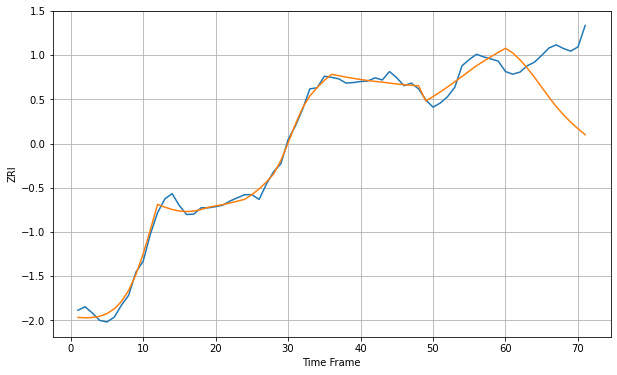

Wall time: 7.06 s
90036 11.844209823886462 105.53775357411739 [2605.46245767 2596.55962736 2583.4297833  2567.83392543 2550.06199502
 2531.01399816 2512.0266607  2494.29251781 2478.3931246  2464.33185907
 2451.84555407 2440.65363464]

Got an mse at 0.0050 in round 489 and stopped training



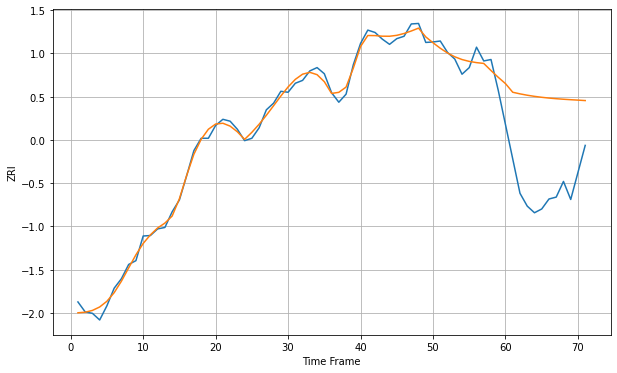

Wall time: 15.4 s
90037 12.824578017027124 190.64499224041273 [2317.15080463 2299.00196962 2295.62440362 2292.75110427 2290.35274165
 2288.37605195 2286.75349398 2285.41244706 2284.28286892 2283.3027236
 2282.42094337 2281.4820504 ]

Got an mse at 0.0050 in round 178 and stopped training



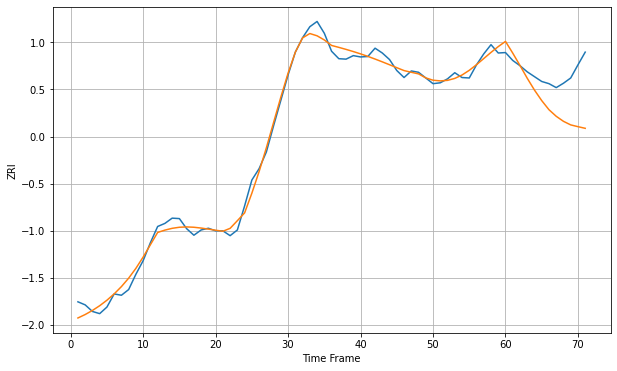

Wall time: 8.45 s
90038 15.055977289190562 82.17551210750617 [2462.47763267 2435.73821256 2407.51130202 2378.40434522 2351.30848275
 2327.31624    2306.53098893 2291.51712564 2280.02744843 2271.86761801
 2267.84827417 2264.07181523]


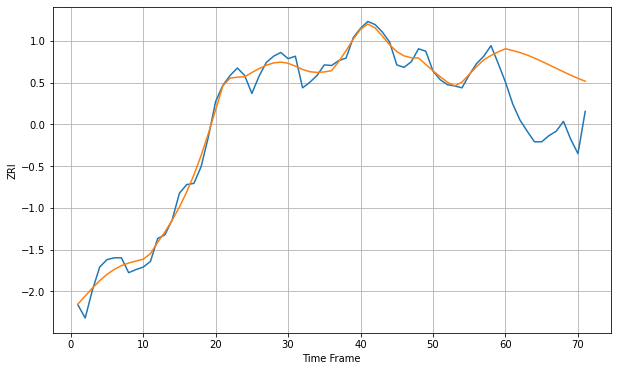

Wall time: 15.9 s
90039 13.761070111095448 103.97999814810083 [2503.05213311 2500.17185794 2496.80334468 2492.80304329 2487.91155974
 2482.64639375 2477.11788114 2471.46241533 2465.83697555 2460.40435455
 2455.30914943 2450.65142243]

Got an mse at 0.0050 in round 225 and stopped training



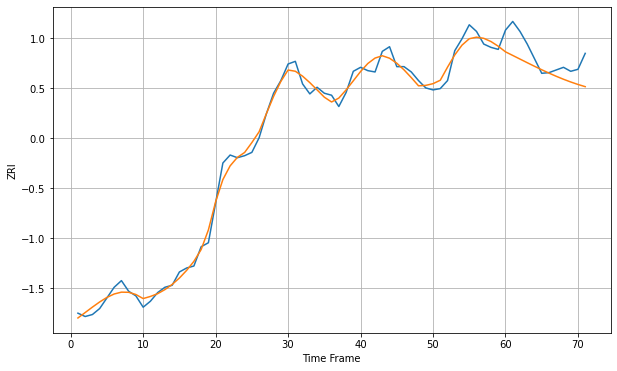

Wall time: 9.67 s
90041 10.577316786182118 28.95771374711851 [2169.28282072 2163.86950109 2158.40453027 2152.94990312 2147.56988278
 2142.32912093 2137.29026734 2132.51155755 2128.04469682 2123.93280628
 2120.20789882 2116.88764047]


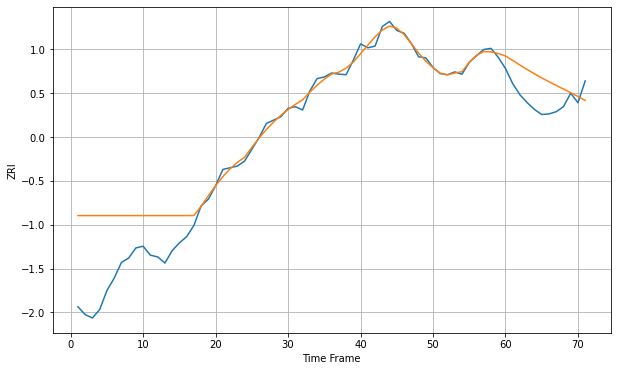

Wall time: 15.5 s
90042 57.67060900908999 45.351077332611 [2191.40496894 2183.41291646 2175.19349491 2167.14711172 2159.50112458
 2152.30666114 2145.4863527  2138.8934254  2132.43407489 2125.92187099
 2119.16322019 2112.05566891]

Got an mse at 0.0049 in round 124 and stopped training



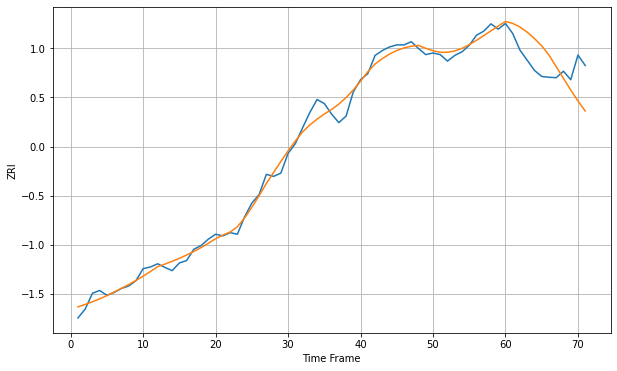

Wall time: 7.6 s
90043 17.030554746164327 65.1372314645247 [2292.95712504 2288.0395235  2279.1649993  2266.48859144 2250.69636682
 2232.64726646 2209.7700333  2181.26994737 2152.28174665 2123.61544178
 2096.34339664 2071.61189865]

Got an mse at 0.0050 in round 255 and stopped training



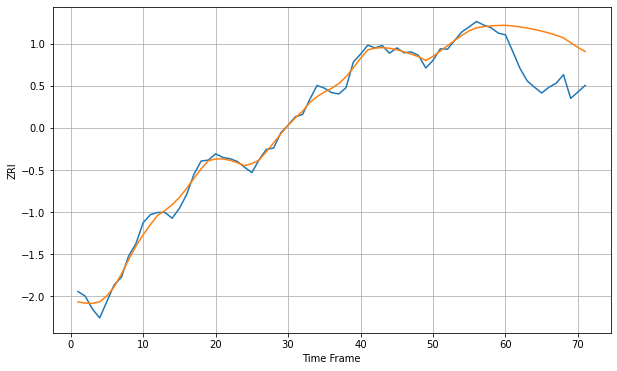

Wall time: 10.3 s
90044 13.269481011185503 102.51595336797185 [2234.39885536 2232.91162914 2230.85108667 2228.2513526  2225.11809219
 2221.41763805 2217.09318587 2212.13366351 2206.20504488 2195.41857818
 2184.89873067 2175.64939971]

Got an mse at 0.0049 in round 73 and stopped training



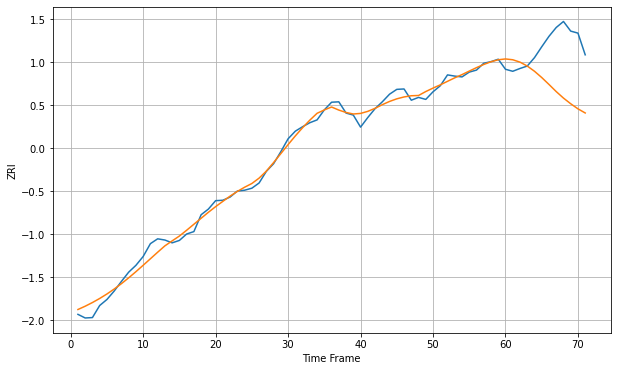

Wall time: 6.35 s
90045 14.77450129636118 120.45038827353426 [2619.71698819 2617.6935525  2611.79112539 2602.08969014 2589.05868587
 2573.44359531 2556.2178827  2538.47172151 2522.29640589 2508.16396169
 2495.51483489 2485.22642815]

Got an mse at 0.0050 in round 70 and stopped training



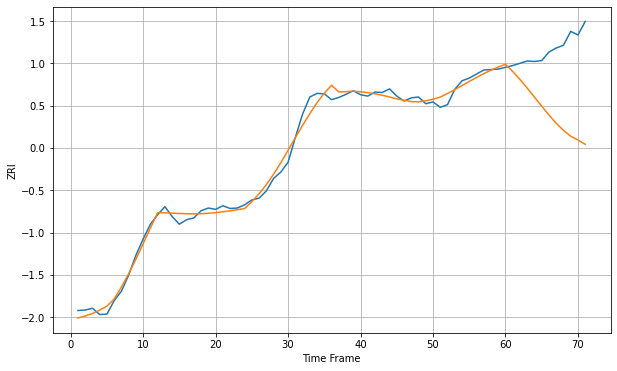

Wall time: 6.11 s
90046 13.247939329284632 155.1839418502583 [2506.70083692 2490.66471093 2472.84531687 2453.71175186 2433.73592377
 2413.5116549  2393.73718254 2375.526155   2359.76887689 2346.75207282
 2338.24456916 2328.75713194]

Got an mse at 0.0050 in round 91 and stopped training



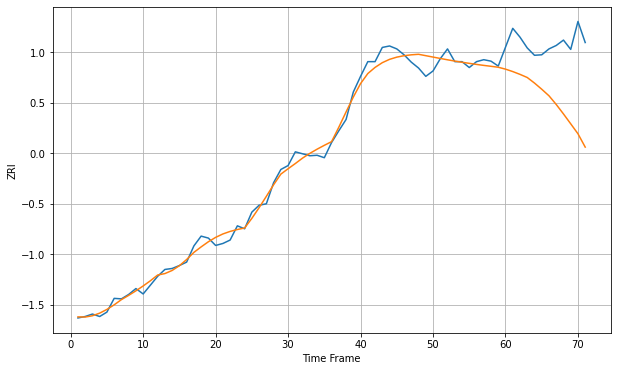

Wall time: 6.82 s
90047 14.443732737251246 127.402877813982 [2076.71964383 2071.78468139 2066.06805959 2059.6708773  2048.31255355
 2035.73054188 2022.32725313 2004.65370717 1985.29774699 1965.16021326
 1944.85442154 1917.63767929]

Got an mse at 0.0050 in round 188 and stopped training



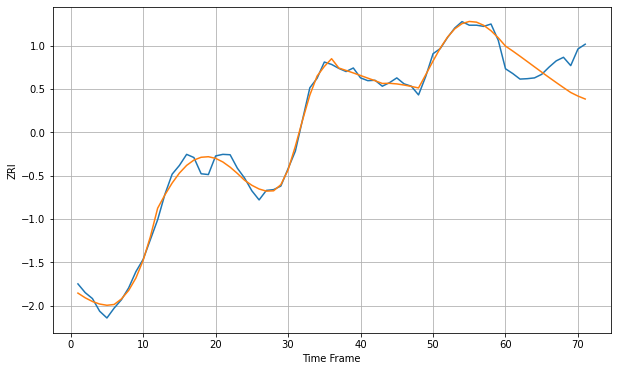

Wall time: 8.86 s
90048 15.416196714066281 70.6456611436971 [2885.254449   2872.79182264 2859.74402374 2846.36351992 2832.87857501
 2819.46688894 2806.24531773 2793.27521793 2780.57718879 2768.14805053
 2759.13957845 2751.67349172]

Got an mse at 0.0050 in round 131 and stopped training



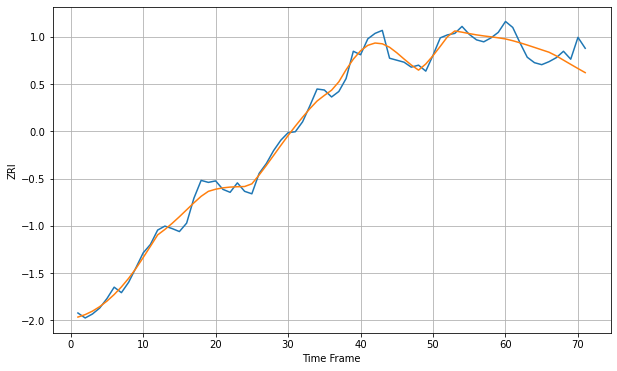

Wall time: 7.4 s
90061 13.36498824578905 31.010862879565757 [2210.80503215 2207.2360632  2203.09205743 2198.53333555 2193.74397864
 2188.89033392 2184.0894722  2176.79197797 2168.16794523 2159.64956426
 2151.24975651 2142.97879836]

Got an mse at 0.0049 in round 76 and stopped training



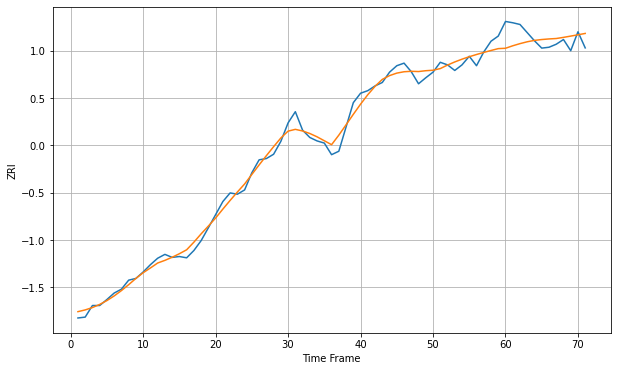

Wall time: 6.49 s
90062 15.389429482886854 32.29044781372251 [2064.61995116 2070.40105755 2075.41365465 2079.73207103 2083.00651984
 2084.94485114 2086.33358268 2087.31688429 2089.97955361 2092.94506566
 2096.00059258 2099.14074887]


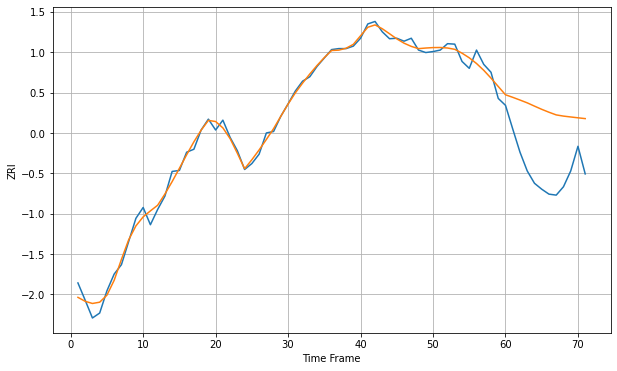

Wall time: 15.7 s
90063 12.367763638269864 125.11919171498886 [2292.40596072 2287.24352028 2281.7261255  2276.02861851 2269.38490303
 2262.90843702 2257.00334395 2251.60506404 2249.18250716 2247.42365913
 2245.72872155 2244.10226438]


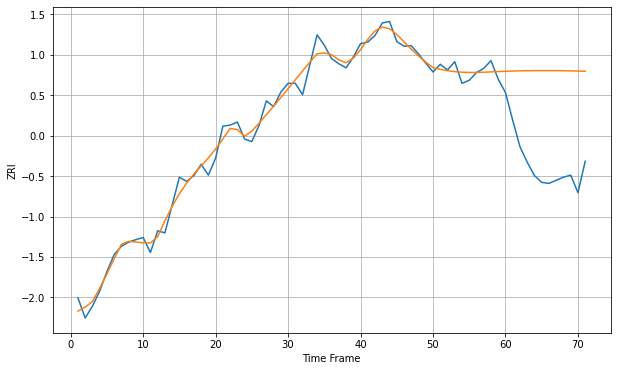

Wall time: 15.8 s
90065 15.425666894087101 185.98617949020658 [2425.4279469  2425.84518439 2426.21513825 2426.49691457 2426.66489828
 2426.70485395 2426.7101473  2426.6416051  2426.45677444 2426.17245285
 2425.81100066 2425.39721347]

Got an mse at 0.0050 in round 125 and stopped training



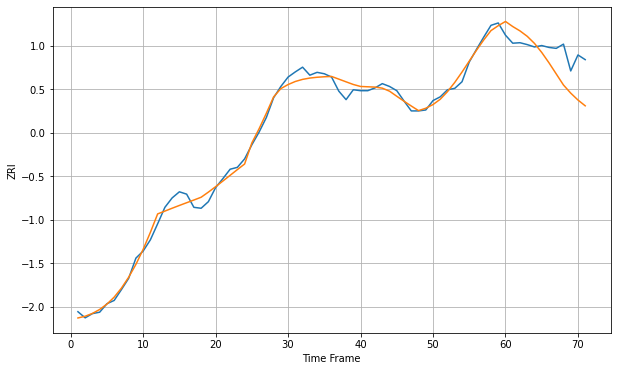

Wall time: 7.29 s
90066 12.929176026185047 54.72196121548804 [2736.20365678 2725.40416748 2716.12949781 2704.63786093 2689.5226668
 2670.30260844 2648.31873687 2624.68099972 2601.09800819 2583.85766912
 2569.16834866 2556.83820243]

Got an mse at 0.0050 in round 140 and stopped training



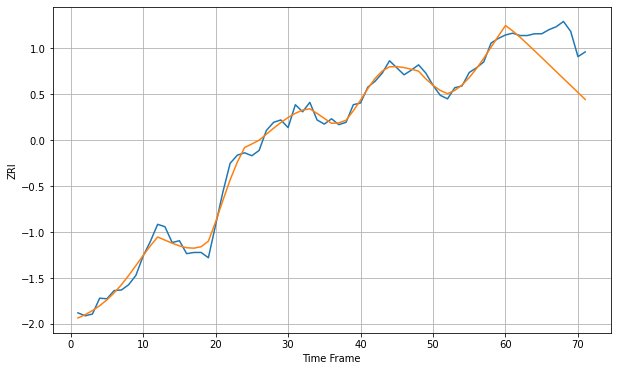

Wall time: 7.87 s
90068 11.001074873385283 58.20031470047832 [2442.03437857 2432.77700215 2422.24396949 2410.79534916 2399.11035009
 2387.30653483 2375.3982391  2363.4968761  2351.63423075 2339.78990957
 2327.9260546  2316.01792624]

Got an mse at 0.0050 in round 124 and stopped training



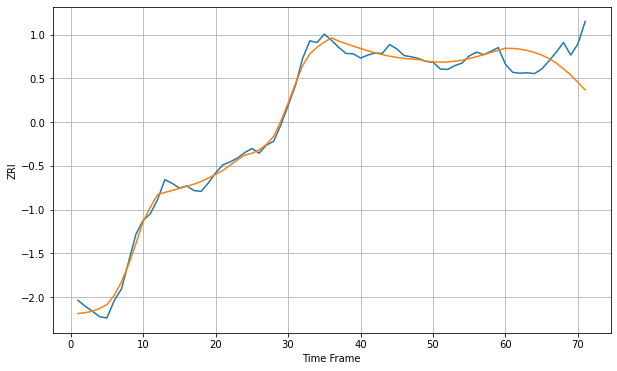

Wall time: 7.44 s
90069 14.612444919315111 68.45785481130966 [2748.34957043 2747.93500701 2746.13234197 2743.0103591  2738.39209412
 2732.07477114 2723.89393273 2713.18734069 2699.32768818 2684.85387156
 2667.00976976 2649.19909901]

Got an mse at 0.0050 in round 434 and stopped training



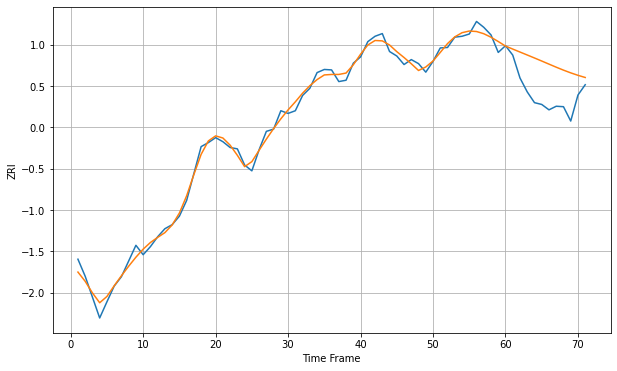

Wall time: 14 s
90220 12.973552464959905 75.23137306909288 [2186.16898167 2179.45964036 2172.83125089 2166.24085882 2159.5887813
 2152.80212004 2145.90872011 2139.0621838  2132.49572514 2126.42354868
 2120.960604   2116.11072183]


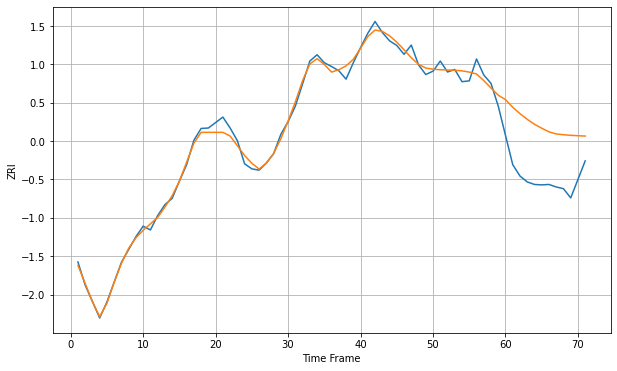

Wall time: 15.6 s
90221 13.748259929995847 126.65459365688037 [2234.38947134 2216.25773685 2201.05245433 2187.62166394 2175.9215005
 2166.50251784 2157.92773385 2152.88482852 2151.06151752 2149.70619815
 2148.71042587 2147.95559595]

Got an mse at 0.0047 in round 45 and stopped training



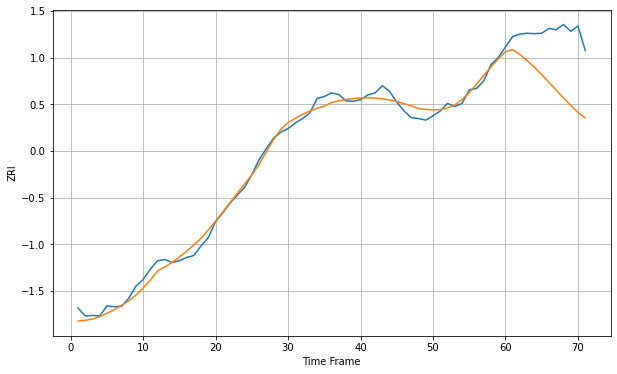

Wall time: 5.73 s
90232 15.523589606701972 132.3400827475442 [2786.14397455 2791.34302179 2778.41634589 2763.45956529 2746.68704449
 2728.46925487 2709.313676   2689.80463892 2670.51550068 2651.92520979
 2634.37100969 2620.60098506]

Got an mse at 0.0050 in round 359 and stopped training



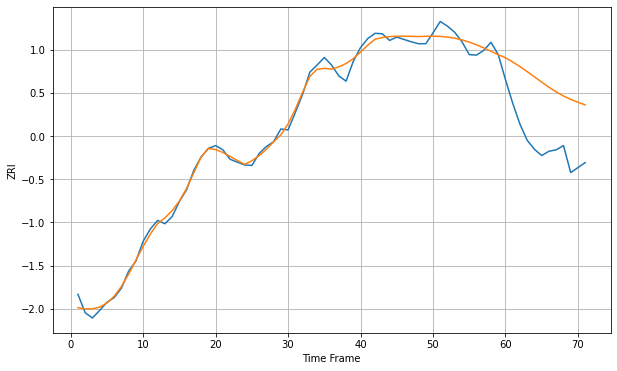

Wall time: 12.6 s
90247 12.843241680646692 127.48418086253939 [2347.32892622 2338.46049787 2328.75747217 2318.15140192 2307.09960084
 2295.90559492 2285.09414016 2275.25399398 2266.73273939 2259.53691388
 2253.45829536 2247.74680392]

Got an mse at 0.0050 in round 230 and stopped training



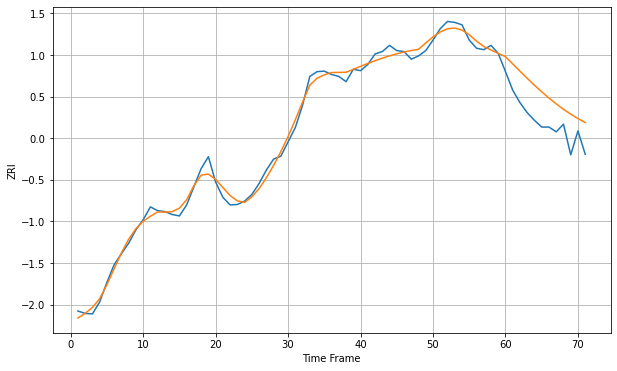

Wall time: 9.55 s
90250 12.253179469922948 61.070616602683955 [2306.33583025 2291.12974091 2275.93088289 2260.98791402 2246.51527769
 2232.68558174 2219.63188597 2207.45329784 2196.2197044  2185.9741675
 2176.73328337 2168.48701587]

Got an mse at 0.0050 in round 249 and stopped training



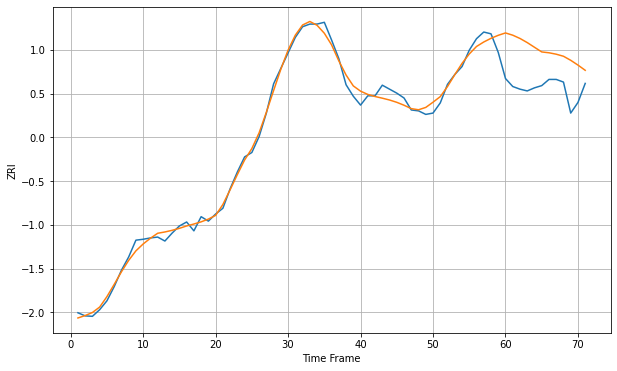

Wall time: 10.3 s
90254 13.907898156683 89.30758104765353 [2791.96862118 2786.90093779 2779.48934141 2770.18703045 2759.60975851
 2749.07148968 2747.18694013 2743.95872142 2739.32077834 2730.17495404
 2719.37637953 2707.59067029]


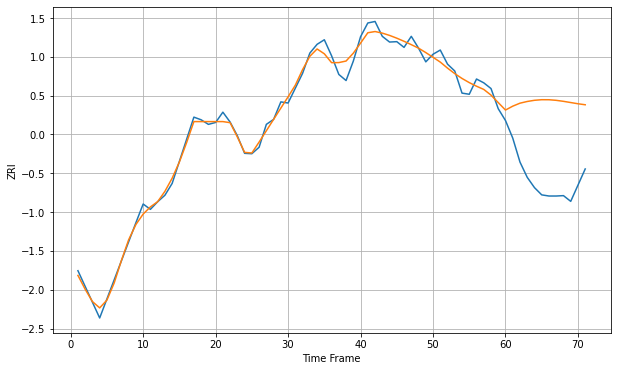

Wall time: 15.6 s
90255 17.628505790471294 207.2518475272242 [2286.57299196 2296.76707194 2304.60051919 2309.05045859 2312.17908888
 2313.70319778 2313.60736311 2312.06535312 2309.43627957 2306.24488022
 2303.0805247  2300.44004191]

Got an mse at 0.0050 in round 392 and stopped training



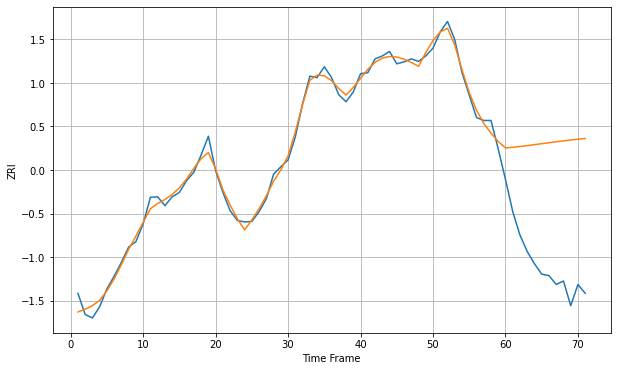

Wall time: 13.2 s
90260 12.415674771297528 252.53020483594892 [2465.2664509  2466.6135607  2468.19766003 2469.96990305 2471.87228118
 2473.84260644 2475.82065278 2477.75397167 2479.6020178  2481.337859
 2482.94754569 2484.42780318]


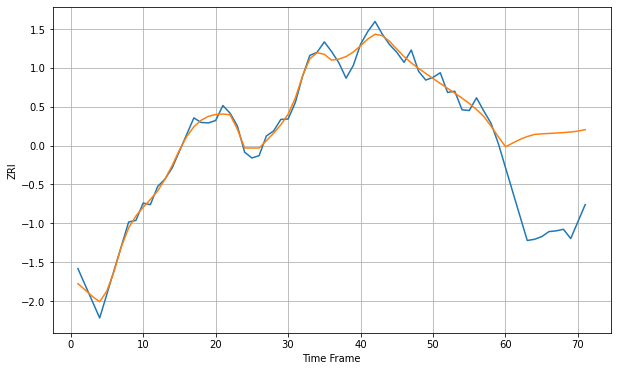

Wall time: 15.7 s
90262 18.92486650417401 230.50974610618272 [2223.18209275 2232.69897601 2242.07114027 2249.56911968 2255.09141566
 2256.52122446 2257.5912231  2258.65129443 2259.85489811 2261.22852942
 2263.7002184  2267.4073384 ]

Got an mse at 0.0050 in round 227 and stopped training



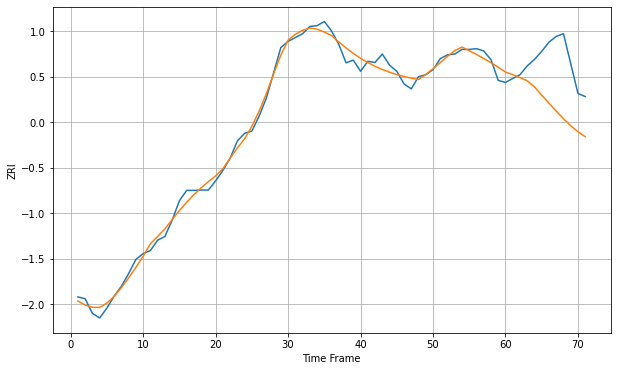

Wall time: 9.68 s
90266 16.709798673339677 122.66263488641547 [2897.97079146 2891.28932128 2883.55251611 2875.12600415 2859.21688679
 2837.69202223 2816.63954347 2795.9611804  2776.18104017 2757.74383089
 2741.95479964 2729.31602404]


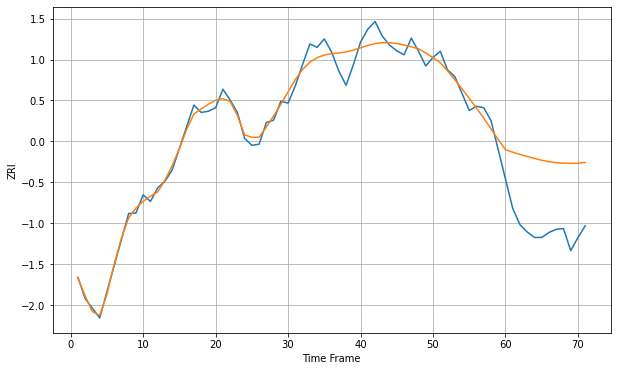

Wall time: 15.6 s
90270 23.876113230859687 179.19620251472284 [2223.87342667 2217.26845059 2211.34253028 2206.18348152 2201.27461779
 2196.38459233 2192.73754419 2190.25549427 2188.83819251 2188.37492765
 2188.75519519 2190.78553524]

Got an mse at 0.0050 in round 147 and stopped training



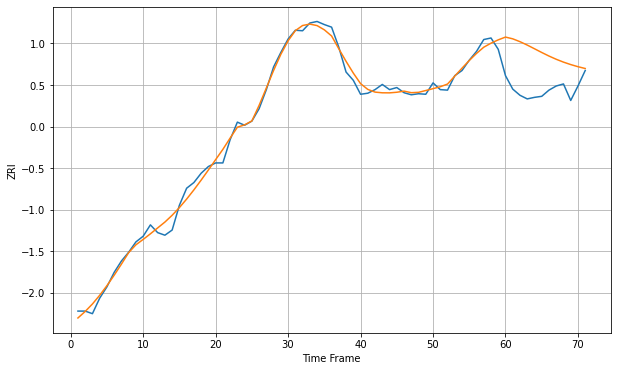

Wall time: 7.74 s
90277 11.325310102685261 75.20331842207138 [2716.76100359 2713.36435403 2707.84173621 2701.27450402 2694.13606985
 2686.91217668 2680.0273301  2673.766695   2668.2574182  2663.49834816
 2659.40851032 2655.87077494]

Got an mse at 0.0050 in round 334 and stopped training



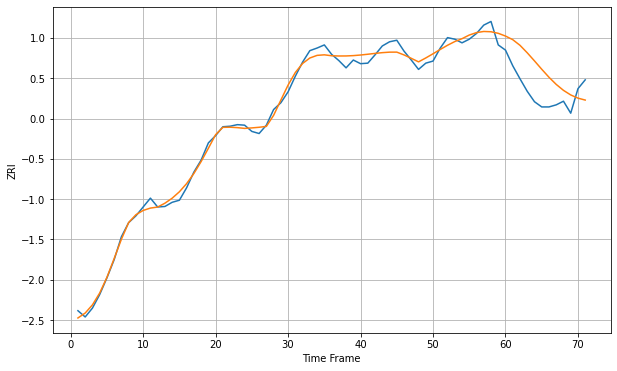

Wall time: 12.1 s
90278 10.897331254612554 52.00904009339255 [2525.00021034 2518.0683441  2507.24005123 2492.87888777 2477.32017485
 2461.31050569 2445.94312465 2432.22014444 2420.80372635 2412.01319776
 2405.88333179 2402.1666712 ]


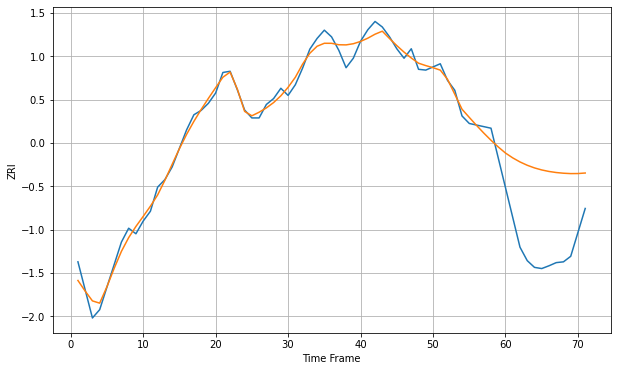

Wall time: 15.6 s
90280 19.16271731317053 202.83197928150628 [2296.1478875  2283.94246206 2273.67229776 2265.2660341  2258.58196234
 2253.42961406 2249.60152912 2246.8992643  2245.14715996 2244.19579313
 2244.33317098 2245.67725365]

Got an mse at 0.0050 in round 159 and stopped training



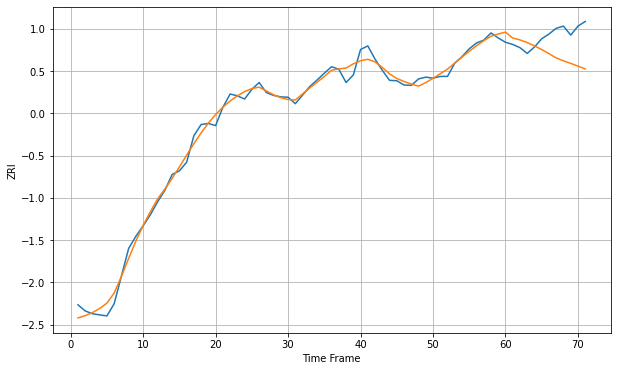

Wall time: 8.03 s
90291 16.521603708848353 69.9031548593382 [3213.33107369 3196.91303386 3191.62102881 3184.1858452  3175.07956386
 3164.71777111 3153.41714404 3141.39112599 3133.37548572 3126.22918102
 3118.69000655 3110.81010856]

Got an mse at 0.0049 in round 62 and stopped training



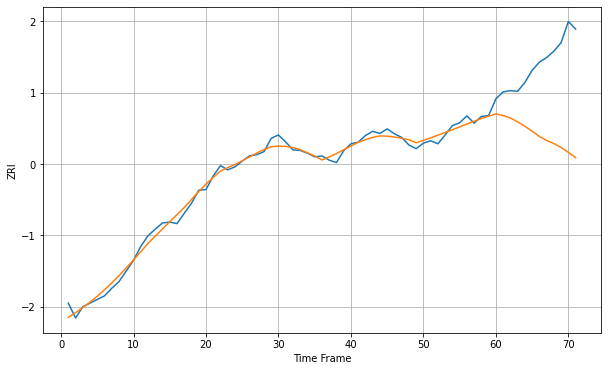

Wall time: 6.2 s
90292 16.397557220629633 258.1371058617515 [3142.31189548 3137.20399877 3128.97742926 3116.00808631 3101.59356392
 3085.66514999 3068.04601984 3055.18228097 3044.64218403 3031.53742325
 3015.89466449 2998.27424418]

Got an mse at 0.0050 in round 240 and stopped training



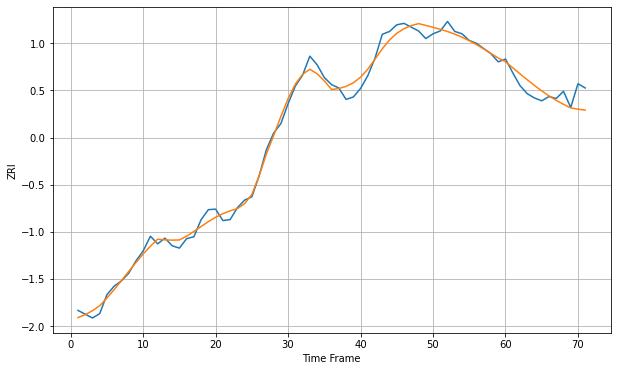

Wall time: 10 s
90301 13.949913224745258 26.712728525161847 [2171.23528879 2158.5077653  2145.78709251 2133.29388988 2121.25610628
 2109.89754477 2099.42245781 2089.98313897 2081.63832041 2074.11213822
 2071.39360809 2069.31684135]

Got an mse at 0.0050 in round 203 and stopped training



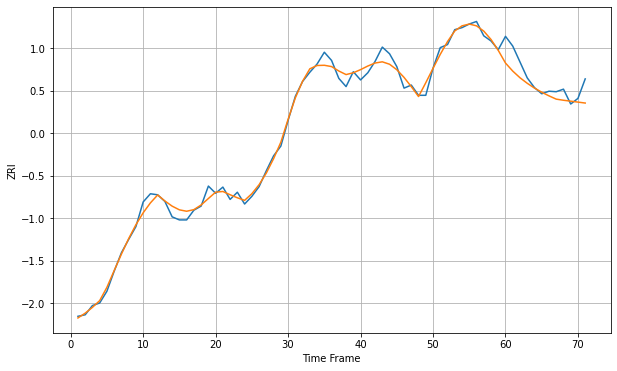

Wall time: 9.15 s
90302 11.645183274771869 27.72592249995557 [2272.89692274 2257.21502931 2244.22219669 2233.43925354 2224.06932507
 2216.02744963 2208.92706172 2202.53868326 2200.3597101  2198.56360929
 2196.76343978 2194.90316808]


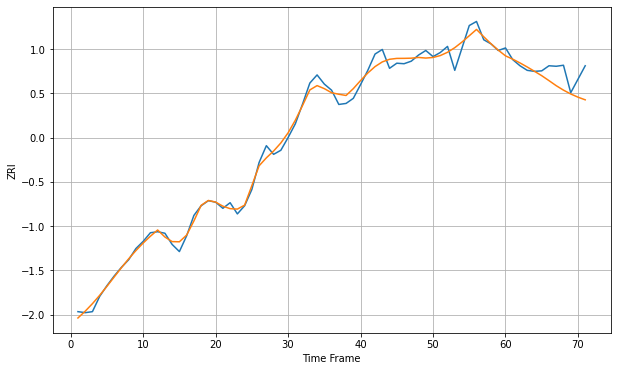

Wall time: 15.5 s
90303 12.476064672111804 30.035045722913107 [2036.48594819 2029.91912766 2022.56763116 2014.56306012 2006.11269094
 1997.48671069 1987.78952988 1977.86428766 1969.1077346  1961.61424417
 1955.32223072 1950.08270482]


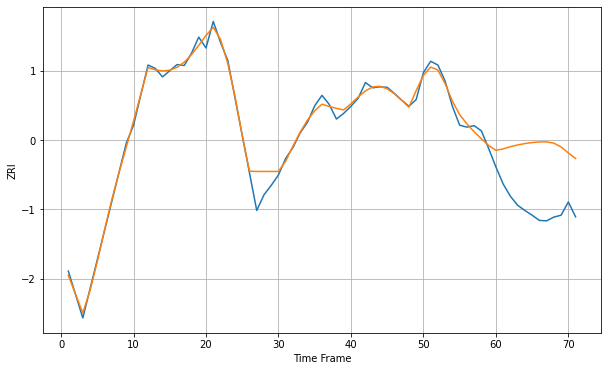

Wall time: 15.7 s
90304 16.127471012023626 130.24415972198656 [2490.06528938 2492.95166322 2497.55563278 2501.29897026 2504.22493962
 2506.3485322  2507.63704687 2507.7552896  2505.05788719 2497.12213629
 2484.48436956 2472.74641838]

Got an mse at 0.0050 in round 440 and stopped training



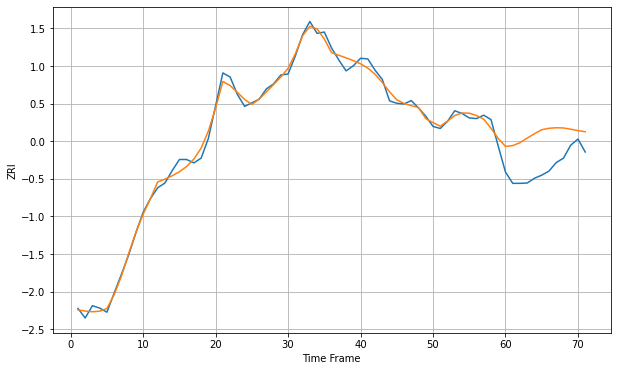

Wall time: 14.3 s
90404 15.4769304270115 101.98650589966837 [3109.34755278 3111.76313916 3120.32380449 3133.89299006 3146.65284504
 3158.35925875 3162.56208662 3164.15005016 3163.49893819 3159.94837815
 3155.7211933  3152.43595673]


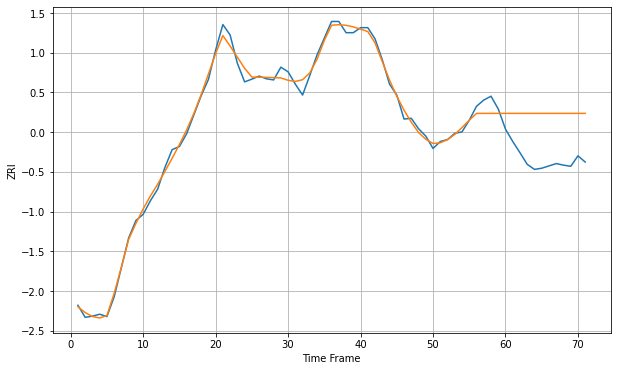

Wall time: 15.4 s
90405 15.416374450660008 120.82581269647312 [3026.66661592 3026.66661592 3026.66661592 3026.66661592 3026.66661592
 3026.66661592 3026.66661592 3026.66661592 3026.66661592 3026.66661592
 3026.66661592 3026.66661592]

Got an mse at 0.0050 in round 101 and stopped training



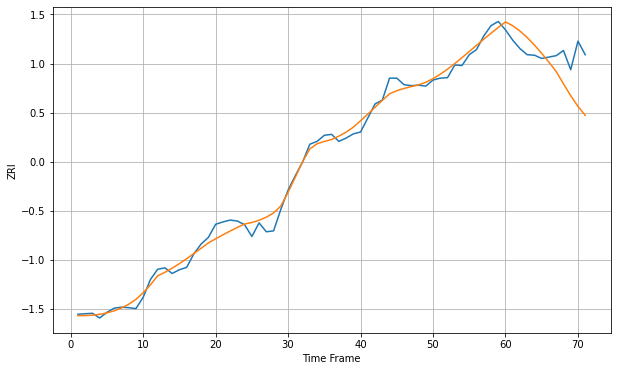

Wall time: 7.06 s
90501 14.685694042153143 64.61122650822783 [2168.09607042 2159.78084135 2148.48626411 2134.6014469  2118.59421982
 2100.89320234 2081.90284091 2062.11267349 2035.91520158 2010.5126814
 1987.7374299  1968.66214471]

Got an mse at 0.0050 in round 486 and stopped training



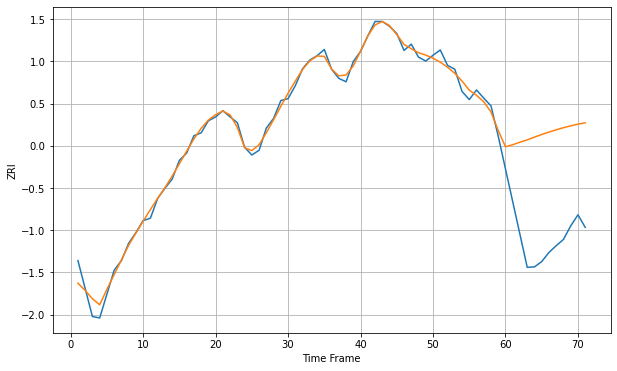

Wall time: 15.4 s
90640 12.375422186012221 216.78873983588971 [2191.08734316 2195.46030408 2200.63041556 2205.50722702 2211.17025578
 2216.54971854 2221.62179038 2226.35076525 2230.68946272 2234.58428458
 2237.98445967 2240.85273282]

Got an mse at 0.0050 in round 359 and stopped training



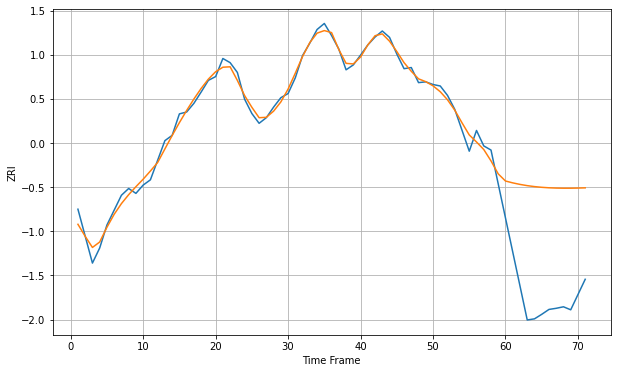

Wall time: 12.6 s
90723 16.48225403347577 292.69540779066097 [2338.8124656  2333.9044276  2329.8283855  2326.54708183 2324.00427739
 2322.12975152 2320.84569779 2320.07296866 2319.73608312 2319.76653542
 2320.1044314  2320.69876525]

Got an mse at 0.0050 in round 46 and stopped training



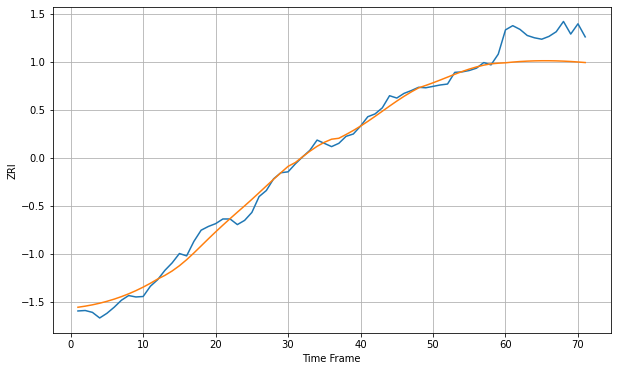

Wall time: 5.53 s
90731 14.381187620113074 64.77725452786183 [2041.50715599 2043.0102033  2044.19274991 2045.06155761 2045.6252038
 2045.89378376 2045.87866932 2045.59233677 2045.04826435 2044.26089021
 2043.24561442 2042.01882413]

Got an mse at 0.0050 in round 355 and stopped training



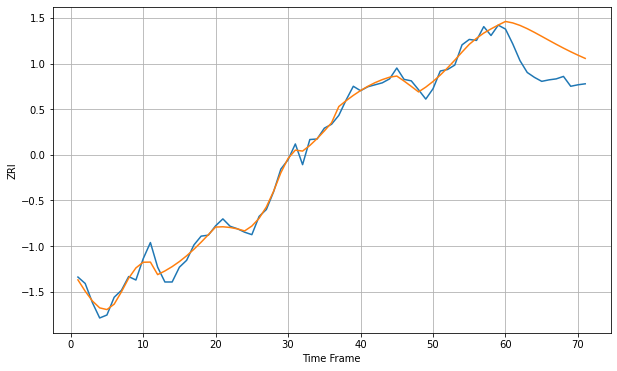

Wall time: 12.4 s
90744 13.033763357970676 69.23182390606064 [2238.46185379 2235.54122595 2230.46178635 2223.83582424 2216.27239218
 2208.26074667 2200.13988628 2192.1375108  2184.40769378 2177.04545865
 2170.09035832 2163.53080527]

Got an mse at 0.0050 in round 52 and stopped training



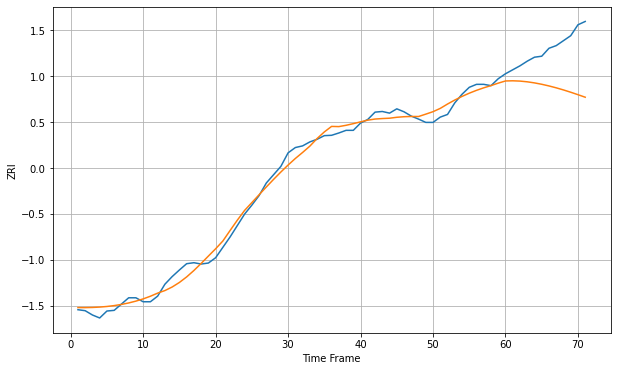

Wall time: 5.86 s
90802 19.400478627176795 128.59453503071484 [1996.19391698 1996.70863504 1995.81836774 1993.65006468 1990.38048375
 1986.17884844 1981.17510712 1975.45699015 1969.09049164 1962.15214449
 1954.75826975 1947.07701562]

Got an mse at 0.0050 in round 98 and stopped training



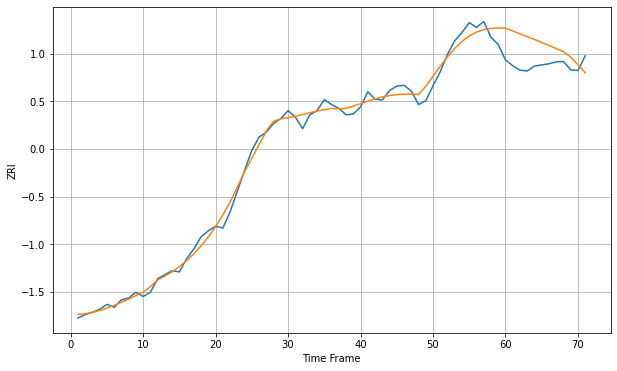

Wall time: 6.86 s
90803 17.776322712203104 64.0213722897633 [2185.37766873 2177.72955911 2170.22511227 2162.77961806 2155.27565152
 2147.57958385 2139.54313418 2131.303386   2122.73427306 2108.60422172
 2088.59418015 2067.00127659]

Got an mse at 0.0048 in round 38 and stopped training



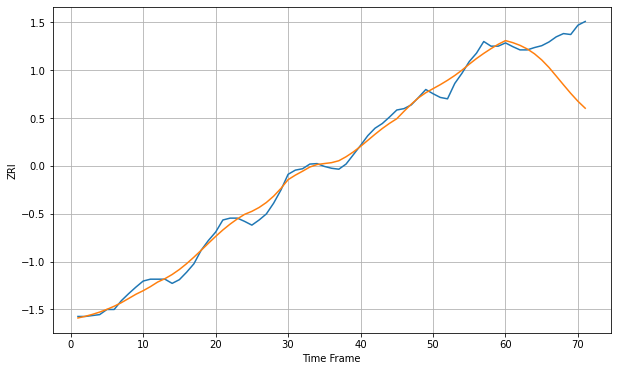

Wall time: 5.68 s
90804 14.100606655300938 91.60850747788582 [1961.94512007 1957.59351532 1951.77087488 1943.9616184  1933.64752852
 1920.45388206 1904.35523465 1885.85799816 1867.1088256  1848.74181563
 1831.70185651 1816.86284794]

Got an mse at 0.0050 in round 81 and stopped training



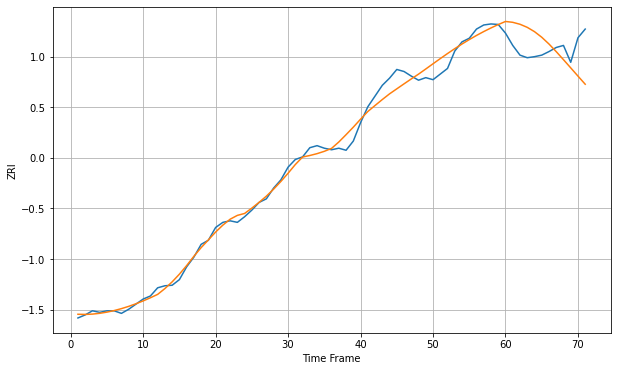

Wall time: 6.51 s
90805 13.93006829256549 51.47912169117305 [1990.87294511 1989.20519216 1985.40313757 1979.38450762 1970.96332853
 1960.02330397 1946.77778029 1931.88612414 1916.15789207 1900.12937712
 1884.04244695 1868.11480851]

Got an mse at 0.0050 in round 79 and stopped training



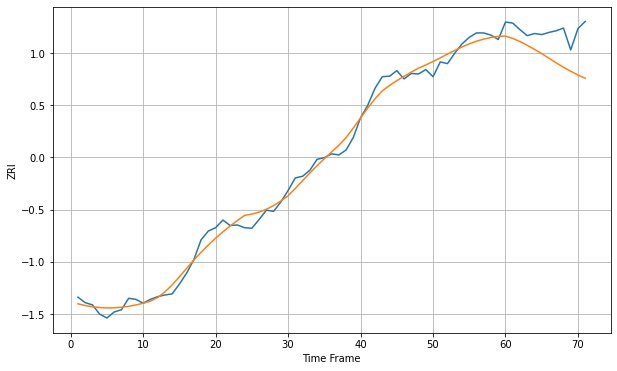

Wall time: 6.47 s
90806 13.42014827958715 53.7042408752376 [1916.25734831 1911.92983353 1906.2488326  1899.46184967 1891.9510699
 1884.17970215 1875.77600279 1867.3113433  1859.32481237 1851.93668088
 1845.19745073 1839.1110117 ]

Got an mse at 0.0049 in round 114 and stopped training



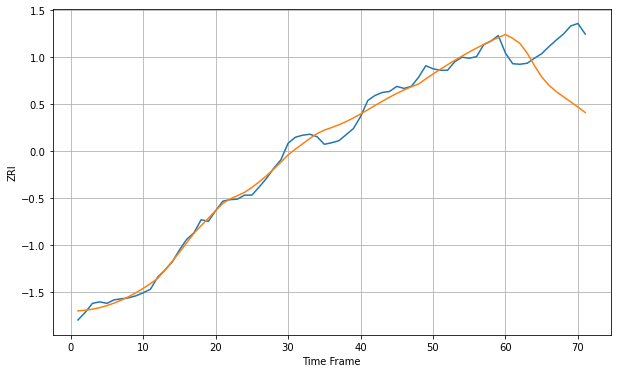

Wall time: 7.02 s
90807 13.00262071160033 97.85212698850049 [1941.09725276 1933.42150051 1923.11670716 1903.9164311  1879.13242175
 1856.71645332 1840.09502907 1827.76510181 1817.33291546 1807.26507783
 1796.88307604 1786.09172033]

Got an mse at 0.0048 in round 38 and stopped training



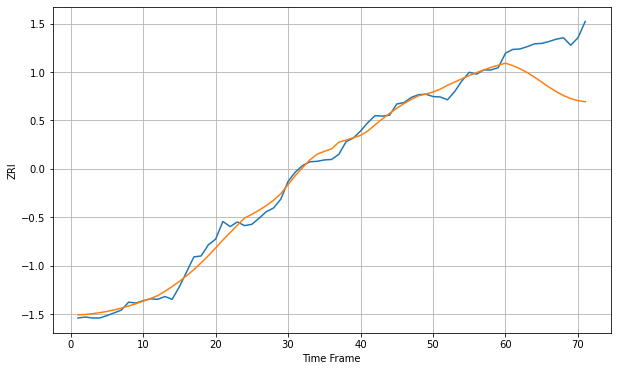

Wall time: 5.65 s
90813 14.061568028406462 98.75841892165926 [1833.44515326 1828.28526262 1821.63558432 1813.38133582 1803.63524123
 1792.91886796 1782.1636667  1772.37151201 1764.16898611 1757.66190243
 1753.15842435 1750.841059  ]

Got an mse at 0.0050 in round 52 and stopped training



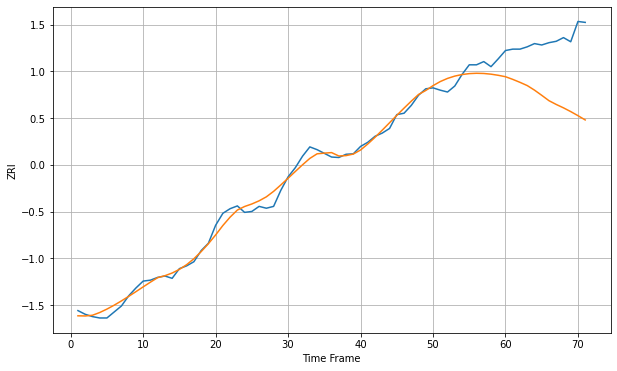

Wall time: 5.86 s
90814 14.091306813308769 131.99754559239943 [1914.18362835 1908.41891681 1901.98944488 1894.9650911  1885.10567971
 1873.83699496 1862.20008504 1854.03582466 1846.68213506 1838.54625416
 1829.7348379  1820.43534094]

Got an mse at 0.0050 in round 100 and stopped training



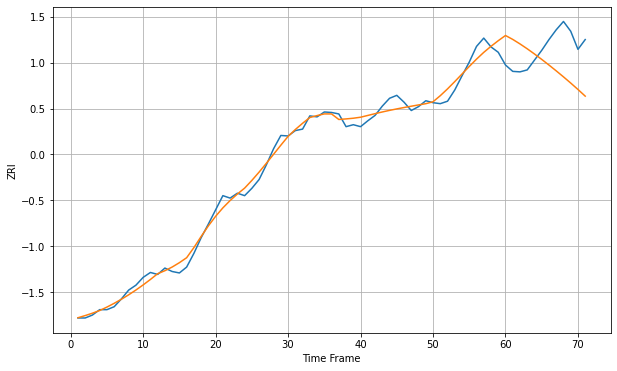

Wall time: 6.74 s
90815 13.221409098930987 74.94564768541005 [1967.31319256 1959.32246713 1950.10115968 1940.13839367 1929.54775566
 1918.44332685 1906.92087479 1895.0360164  1882.79006857 1870.13551816
 1857.00865105 1843.38991643]

Got an mse at 0.0050 in round 419 and stopped training



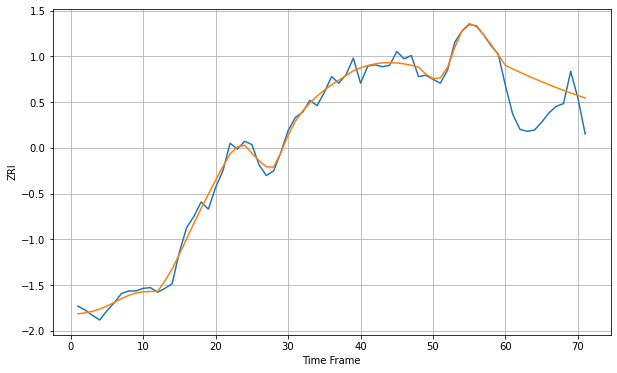

Wall time: 13.9 s
91016 9.759293958944342 55.73792648339318 [2271.02031956 2265.75916098 2260.63677547 2255.66456715 2250.8490558
 2246.19616191 2241.70931076 2237.38715315 2233.2232279  2229.20735004
 2225.32756413 2221.57168756]

Got an mse at 0.0050 in round 464 and stopped training



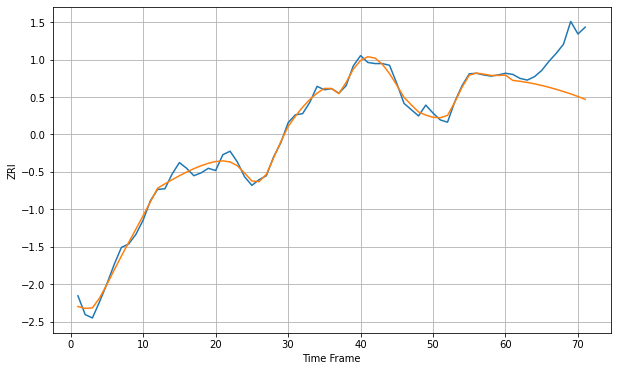

Wall time: 14.9 s
91101 9.241798926016042 69.74845206793793 [2148.78642777 2139.49068201 2137.87143931 2135.86757549 2133.40374809
 2130.5285107  2127.2948737  2123.74428678 2119.89168831 2115.71592653
 2111.16038264 2106.14815962]

Got an mse at 0.0050 in round 349 and stopped training



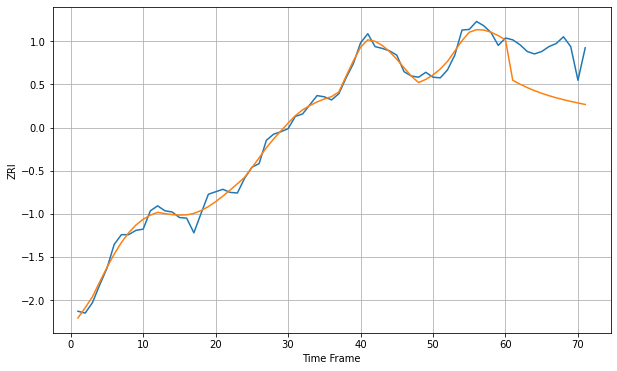

Wall time: 12.5 s
91104 9.919523434119862 72.43819850883057 [2060.90101538 1995.01994378 1988.6943136  1983.05657008 1978.07889855
 1973.69629344 1969.83063588 1966.40156352 1963.33011854 1960.54078199
 1957.96563486 1955.55193126]


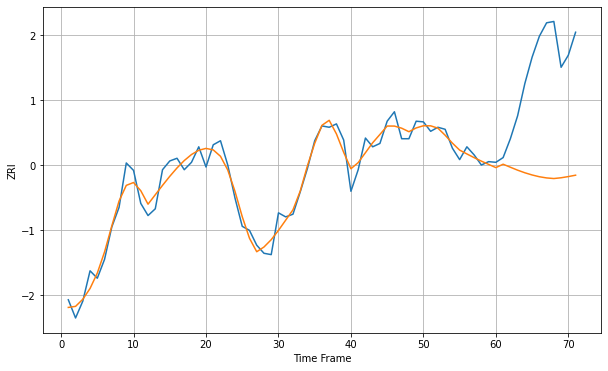

Wall time: 15.3 s
91105 14.813674051068203 161.15664803517961 [2636.13275815 2641.1505744  2636.71109421 2632.33396757 2628.46828419
 2625.21143262 2622.58388627 2620.81601643 2619.92031014 2621.0576213
 2622.82168056 2624.87219994]

Got an mse at 0.0050 in round 260 and stopped training



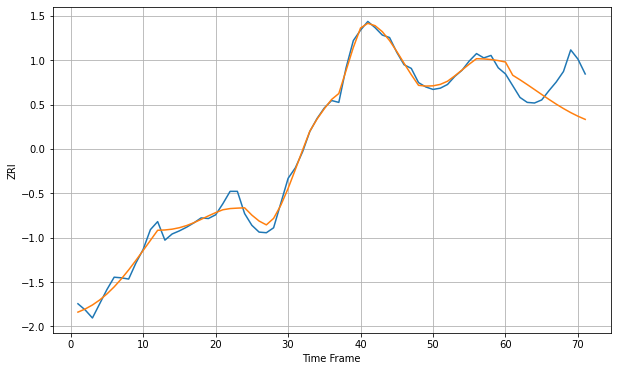

Wall time: 10.5 s
91106 10.11556942820432 51.79191428475475 [2216.31397088 2194.94586059 2187.582251   2179.83023944 2171.83718098
 2163.77700293 2155.83621808 2148.19858282 2141.03059747 2134.46858627
 2128.60778248 2123.49505005]

Got an mse at 0.0049 in round 115 and stopped training



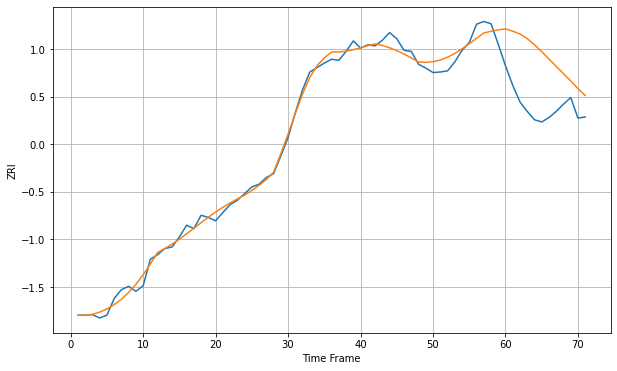

Wall time: 7.37 s
91107 11.998912684990598 94.13268210126053 [2237.77053186 2233.52413084 2228.38967072 2220.05497871 2209.0841892
 2196.62523455 2183.42713471 2170.06576317 2157.073144   2143.79258948
 2130.136069   2117.66942997]

Got an mse at 0.0050 in round 220 and stopped training



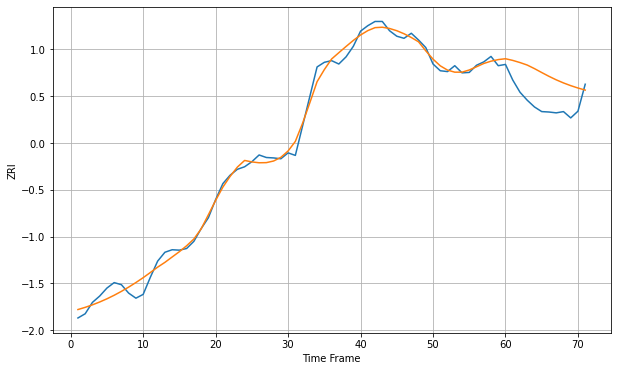

Wall time: 9.35 s
91205 15.694890103288161 69.64998921004518 [2368.50079924 2364.55248215 2359.43670409 2353.49441991 2345.00639727
 2335.73428622 2326.71161697 2318.42292037 2311.06891386 2304.6239468
 2298.99856331 2294.07425214]

Got an mse at 0.0050 in round 123 and stopped training



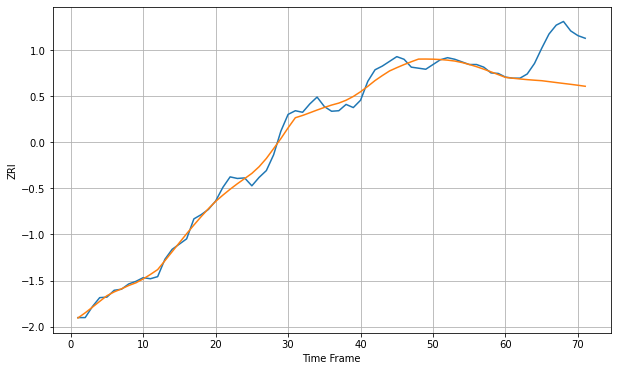

Wall time: 7.5 s
91355 12.34913606199467 74.54253889423487 [2223.50737142 2221.90949811 2220.47907574 2219.22137563 2218.14031269
 2217.17290405 2215.42898118 2213.68384998 2211.96439803 2210.28963998
 2208.48552173 2206.57138531]

Got an mse at 0.0050 in round 127 and stopped training



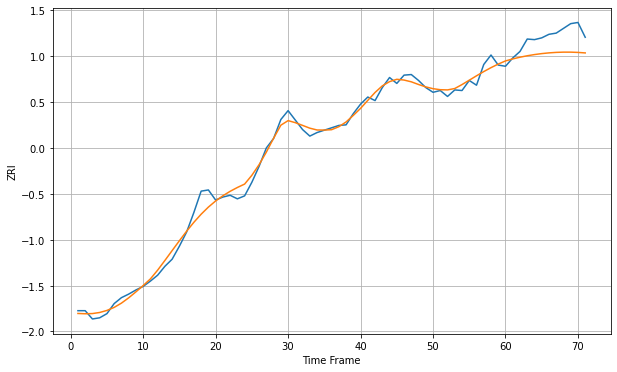

Wall time: 7.53 s
91367 10.89963726846033 31.037435001496483 [2282.99823321 2286.41471677 2289.30522351 2291.73758965 2293.75665972
 2295.38145686 2296.61225043 2297.43968166 2297.85197629 2297.83961965
 2297.39816969 2296.52992048]

Got an mse at 0.0050 in round 146 and stopped training



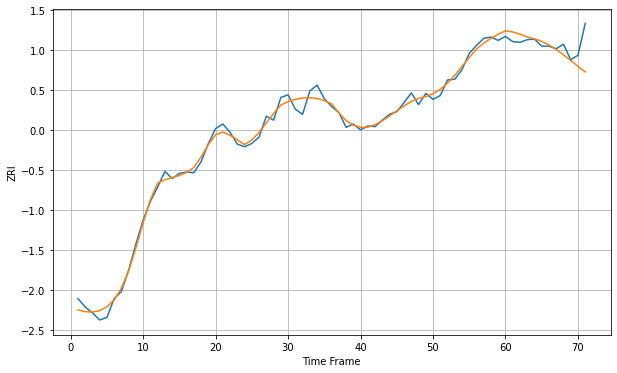

Wall time: 7.96 s
91505 8.668298328623662 23.587629828433514 [2343.78267448 2341.94763494 2338.53301002 2334.1443095  2331.29022759
 2327.3494501  2321.86490513 2314.83807459 2306.6951967  2297.94362531
 2289.01606977 2280.25139765]

Got an mse at 0.0050 in round 82 and stopped training



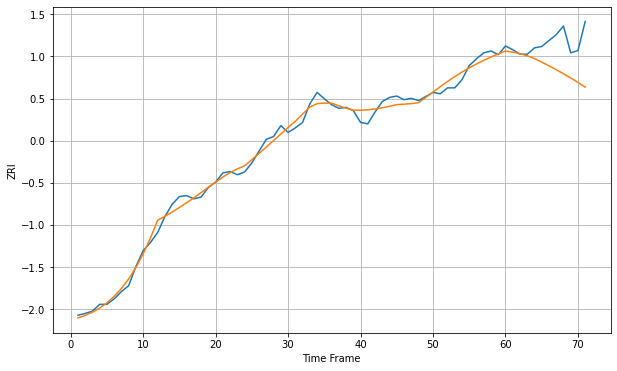

Wall time: 6.32 s
91601 13.036556686986875 65.01410657028346 [2339.9073251  2337.6531717  2334.16394379 2329.59277741 2323.57016615
 2315.66625422 2307.44044114 2298.92578523 2290.04708982 2280.72331642
 2270.92823304 2260.70284586]

Got an mse at 0.0049 in round 70 and stopped training



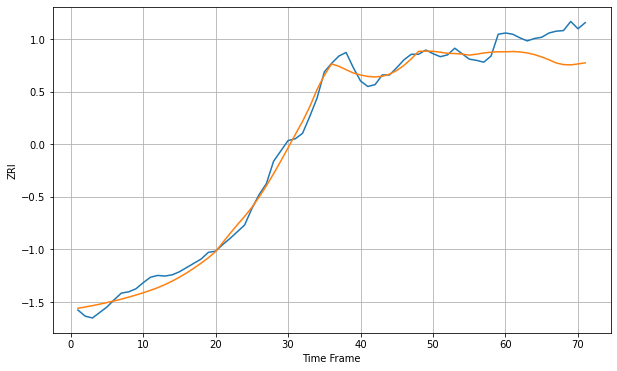

Wall time: 6.38 s
91730 11.97602372983191 45.724531796466245 [1674.08694723 1674.48996388 1673.86819435 1672.1903041  1669.43359487
 1665.59462527 1660.97821504 1655.68542064 1653.01471505 1652.53418382
 1654.09596694 1655.91185277]

Got an mse at 0.0049 in round 58 and stopped training



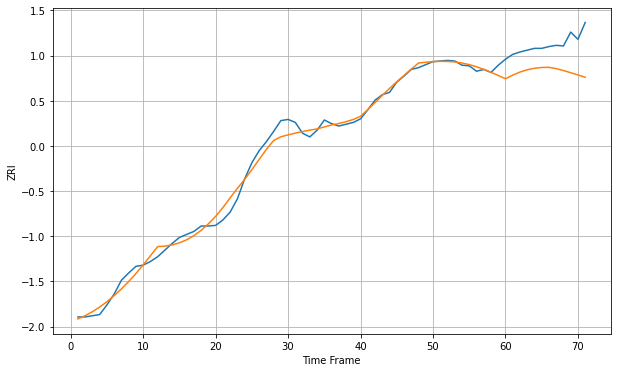

Wall time: 6.02 s
91764 10.334573949891812 47.62189869945227 [1628.50226692 1634.59087288 1639.64320054 1643.44576542 1645.94513344
 1647.2435098  1647.53014127 1645.35729371 1642.11659544 1638.56943744
 1634.81467101 1630.90756125]

Got an mse at 0.0050 in round 414 and stopped training



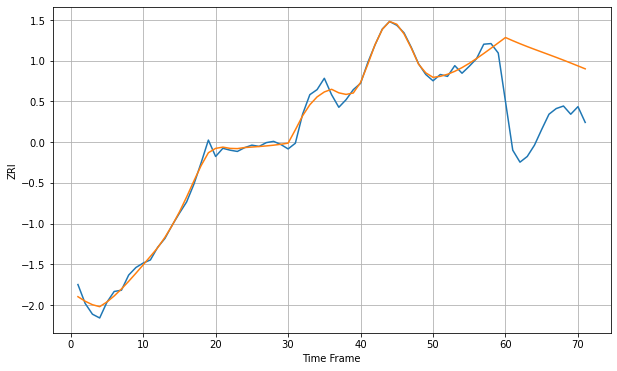

Wall time: 13.5 s
91766 9.091140360275066 123.47910475246078 [2088.61253126 2083.5740299  2078.78123225 2074.24175808 2069.89432421
 2065.64856644 2061.41539898 2057.12412783 2052.73055308 2048.22096616
 2043.61427768 2038.96180366]

Got an mse at 0.0050 in round 204 and stopped training



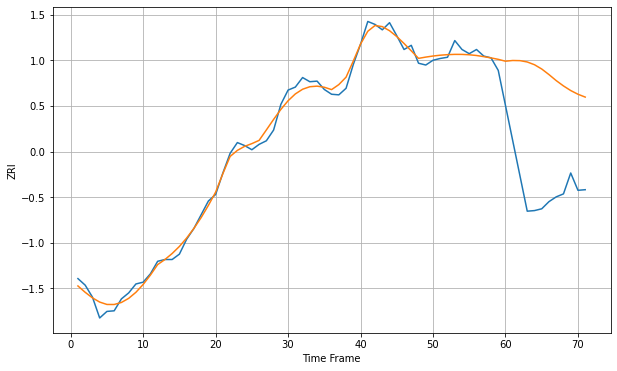

Wall time: 9.3 s
91776 10.770068209150317 187.84471858847587 [2220.36530938 2221.59244996 2221.32502133 2219.09817551 2214.48186386
 2207.30558256 2197.95753508 2187.86207662 2178.94164357 2171.20052286
 2165.01072611 2160.24923921]

Got an mse at 0.0050 in round 109 and stopped training



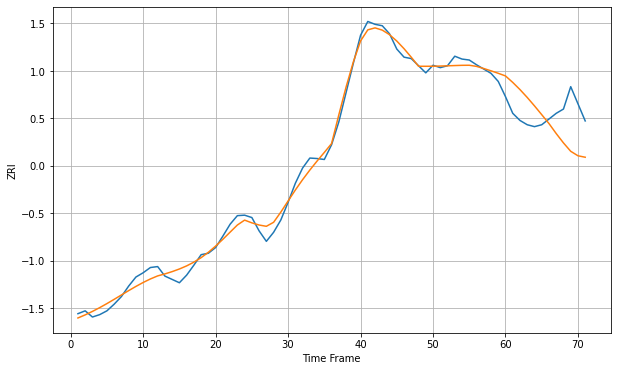

Wall time: 7.13 s
91801 14.018927739770016 70.18071638617705 [2204.54352776 2190.92357448 2175.84060052 2159.33111045 2141.62198116
 2123.14847307 2104.46876499 2083.44335305 2063.8058867  2046.21293966
 2036.80267228 2033.71832006]

Got an mse at 0.0050 in round 117 and stopped training



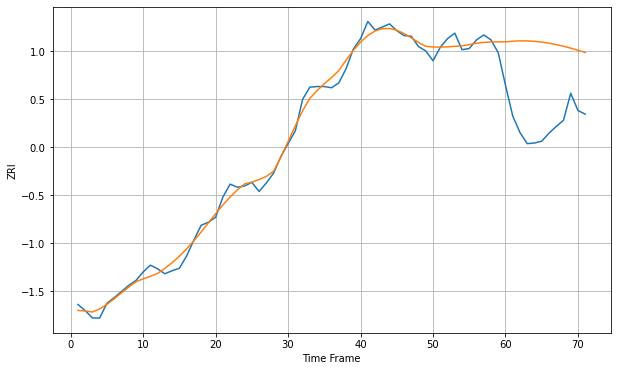

Wall time: 7.32 s
91803 11.022317712765686 129.94548673427013 [2115.71956432 2116.85187841 2117.38532268 2117.31662939 2116.65299169
 2115.41433942 2113.63413024 2111.35813867 2108.6416619  2105.54599178
 2102.13495341 2098.47204397]

Got an mse at 0.0050 in round 109 and stopped training



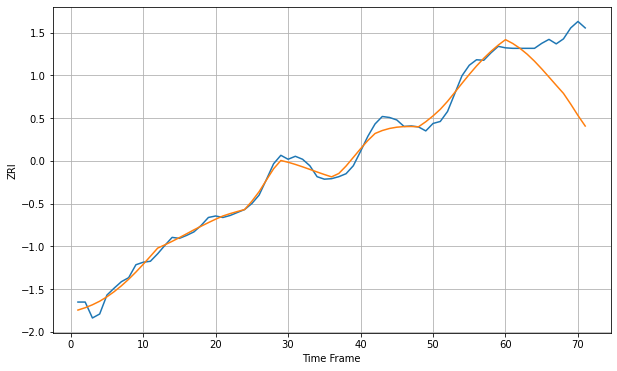

Wall time: 6.93 s
91913 12.041648171631618 102.67313575184905 [2259.45964487 2251.73927474 2241.96591322 2230.06237569 2216.16494132
 2200.69798374 2184.3181995  2167.71471948 2151.40892647 2129.8897377
 2107.06212575 2085.82242498]

Got an mse at 0.0050 in round 127 and stopped training



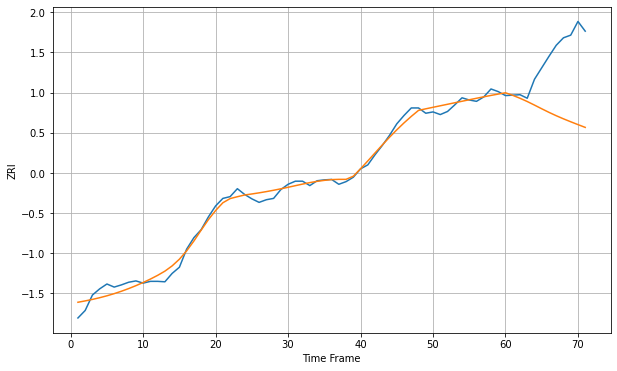

Wall time: 7.58 s
92008 12.818951366221599 137.92659270462903 [2051.3661945  2045.58093311 2038.92943417 2031.57259549 2023.47165813
 2015.1195951  2007.005279   1999.40204268 1992.33259605 1985.67020573
 1979.24966052 1972.9309579 ]

Got an mse at 0.0049 in round 58 and stopped training



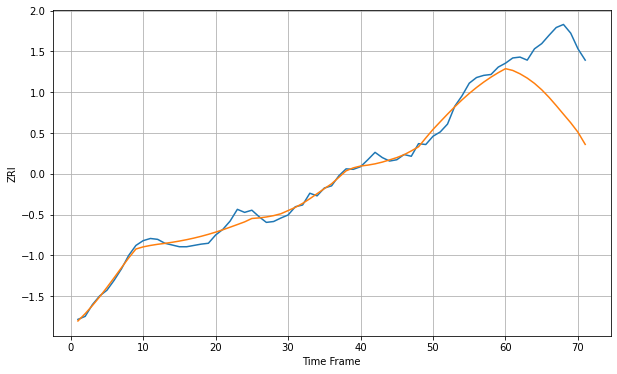

Wall time: 6.01 s
92101 12.889855278424607 139.48633057248685 [2327.37073484 2323.33157388 2315.57385093 2305.69947139 2293.55232113
 2278.84890489 2261.63203129 2242.54626031 2222.68868183 2203.01395494
 2181.27794267 2153.32675069]

Got an mse at 0.0050 in round 53 and stopped training



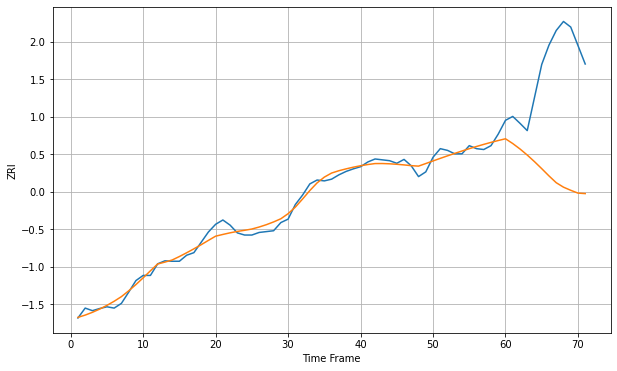

Wall time: 5.69 s
92103 12.248487722972703 260.4011755106043 [2004.00449052 1992.91455042 1980.27789124 1966.168107   1950.7870881
 1934.45522782 1917.57352383 1901.79320371 1891.40898037 1884.13565967
 1877.58330706 1876.4415241 ]

Got an mse at 0.0047 in round 36 and stopped training



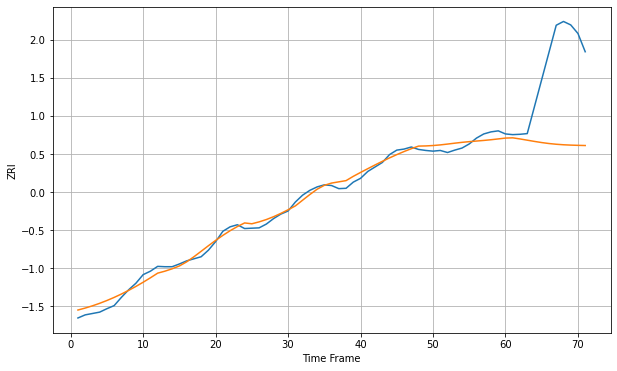

Wall time: 5.76 s
92104 14.687011750877987 235.47822332509267 [1799.95765371 1800.71348571 1797.46865612 1793.88962858 1790.26746617
 1786.93605642 1784.15703802 1782.04090203 1780.54834863 1779.54496678
 1778.8623822  1778.34071852]

Got an mse at 0.0050 in round 48 and stopped training



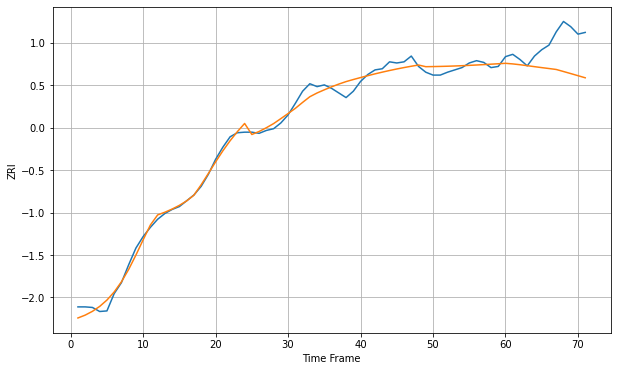

Wall time: 5.82 s
92108 10.27432332594852 52.622584381908034 [1989.42156946 1988.38124557 1986.96892111 1985.32785905 1983.61628786
 1981.95717035 1980.37840592 1978.73893134 1975.21282873 1971.62862842
 1967.99378964 1964.33120669]

Got an mse at 0.0050 in round 55 and stopped training



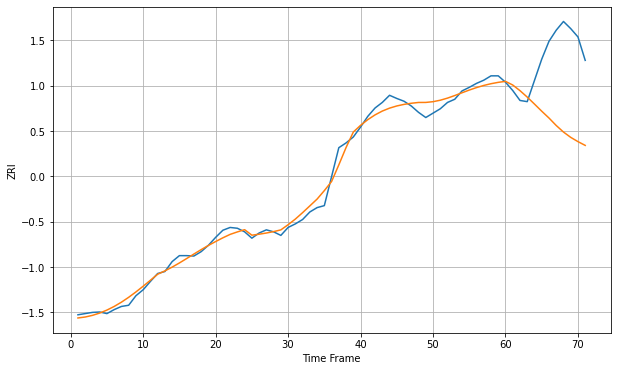

Wall time: 5.95 s
92117 15.840927781356237 179.08449733784758 [2174.08542212 2164.87086154 2150.66755752 2134.44175593 2116.83984619
 2098.88795373 2081.7238135  2062.90606205 2046.40681084 2032.99348676
 2022.24078445 2012.74363437]

Got an mse at 0.0050 in round 239 and stopped training



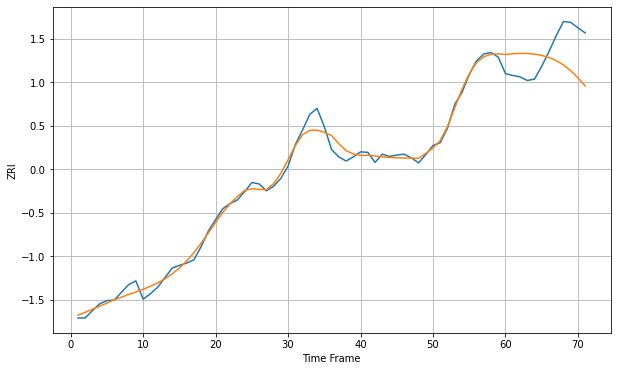

Wall time: 9.77 s
92122 13.364618212025142 72.04906342645005 [2453.88950497 2455.4584036  2456.26660388 2456.09466696 2454.70883069
 2451.85445309 2447.24030895 2440.50360856 2430.9184145  2418.44374499
 2403.00766644 2385.20441148]

Got an mse at 0.0050 in round 70 and stopped training



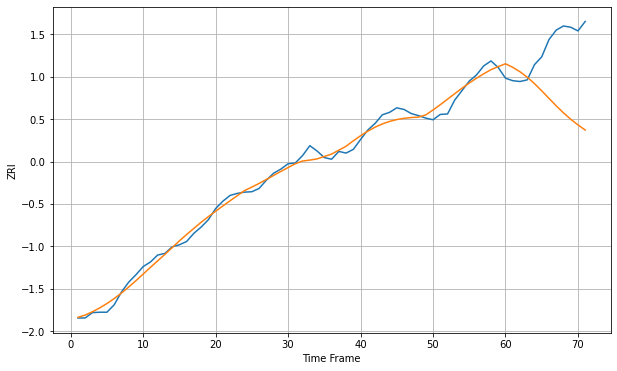

Wall time: 6.33 s
92123 14.418425567303922 153.5180405576801 [2295.07766841 2286.46612263 2275.66098597 2262.44994822 2246.85447357
 2229.36273694 2210.95401789 2192.78751819 2175.75888387 2160.31282187
 2146.45198192 2134.03058584]

Got an mse at 0.0049 in round 59 and stopped training



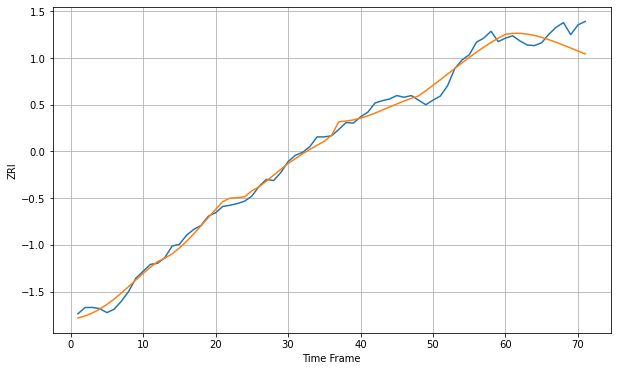

Wall time: 6.02 s
92126 11.24509641283648 27.56247311847905 [2092.61984034 2094.31999848 2094.37184078 2093.04817615 2090.59984241
 2087.25314123 2083.21334094 2078.66772662 2073.78647028 2068.72152027
 2063.60441724 2058.54412855]

Got an mse at 0.0050 in round 133 and stopped training



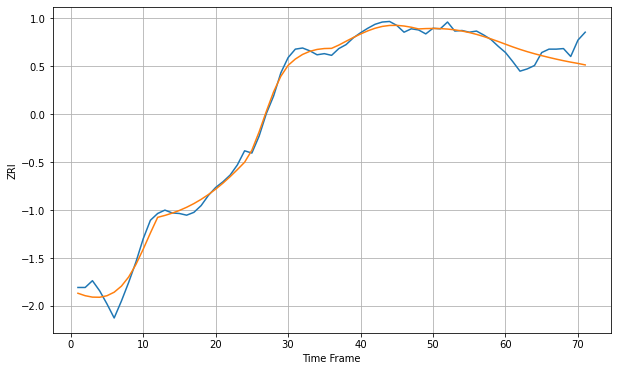

Wall time: 7.44 s
92128 11.896710058517055 28.7629797938115 [2174.73016046 2169.97762449 2165.56343911 2161.5373134  2157.86088092
 2154.46622629 2151.29583262 2148.32118929 2145.54513495 2142.99457747
 2140.7091974  2138.0662003 ]

Got an mse at 0.0050 in round 124 and stopped training



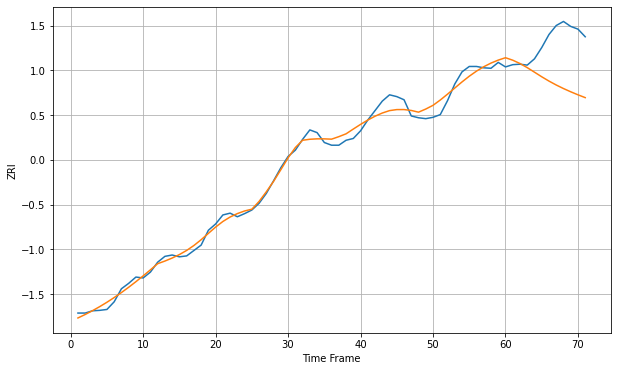

Wall time: 7.52 s
92130 13.986029165419898 98.64210590245447 [2597.43541292 2591.93678018 2584.52136086 2575.40229971 2565.27516322
 2555.07672531 2545.50645118 2536.81276721 2528.93729219 2521.72384614
 2515.02615124 2508.73362113]

Got an mse at 0.0050 in round 132 and stopped training



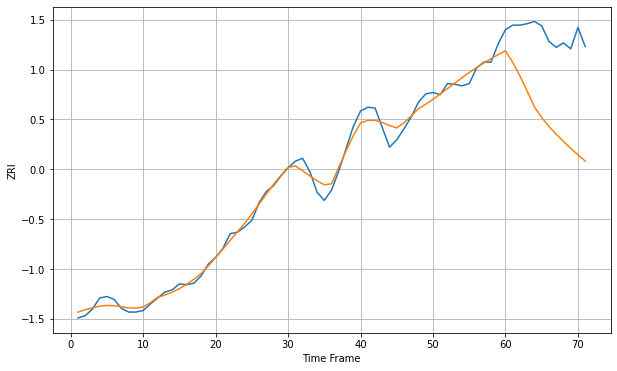

Wall time: 7.59 s
92410 9.446255789323173 116.10695014569022 [1298.2725407  1282.67852891 1264.19001819 1243.61505854 1222.3224232
 1208.06934536 1195.99180393 1185.40067905 1175.69744307 1166.43721686
 1157.66957227 1149.22512162]

Got an mse at 0.0050 in round 50 and stopped training



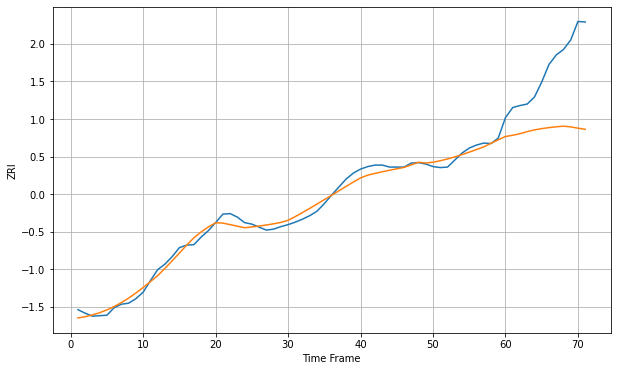

Wall time: 5.88 s
92507 10.498036766046873 130.82152628367996 [1480.12919551 1482.57972853 1485.66755722 1489.88580144 1493.25322812
 1495.87570886 1497.90182973 1499.48922223 1500.77285672 1499.24450073
 1496.76399437 1494.46620546]

Got an mse at 0.0049 in round 279 and stopped training



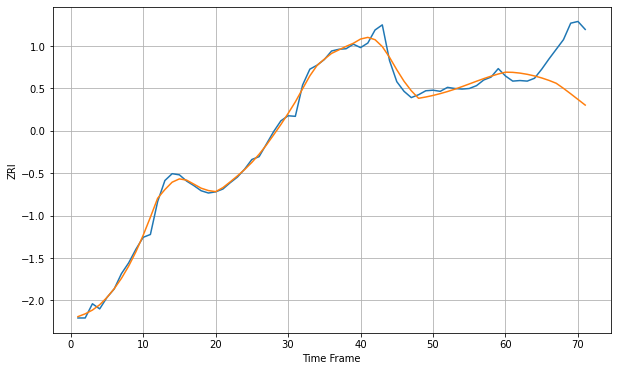

Wall time: 10.6 s
92602 10.489767303880093 73.74042010455544 [2479.74568258 2479.41594465 2478.08616028 2475.96614433 2473.11882628
 2469.56142826 2465.26244746 2460.18761325 2451.2593542  2441.66062453
 2431.73481552 2421.79423927]

Got an mse at 0.0050 in round 451 and stopped training



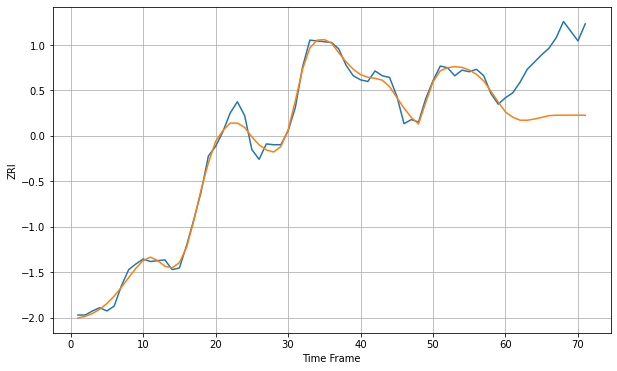

Wall time: 14.7 s
92603 7.912686692143833 81.37405057032055 [2876.33098241 2869.97046214 2866.27779999 2866.18678766 2867.7179748
 2869.69428157 2871.90289559 2872.3576439  2872.42897916 2872.45852669
 2872.43452758 2872.35745551]

Got an mse at 0.0050 in round 203 and stopped training



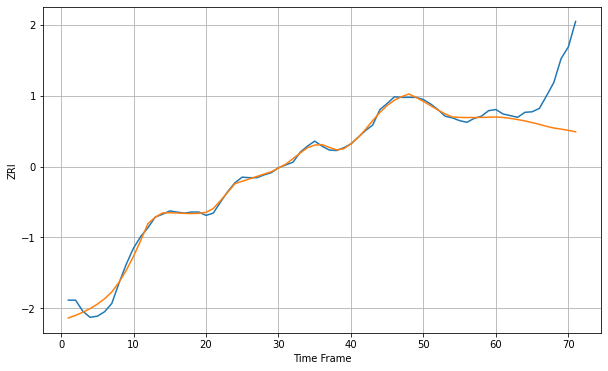

Wall time: 9.16 s
92612 8.998159806110426 86.63298836544624 [2398.58980344 2397.76391126 2396.08993398 2393.96620934 2391.42663067
 2388.51020306 2385.25704317 2381.70473475 2378.64225381 2376.72523617
 2374.45933865 2371.86704653]

Got an mse at 0.0050 in round 73 and stopped training



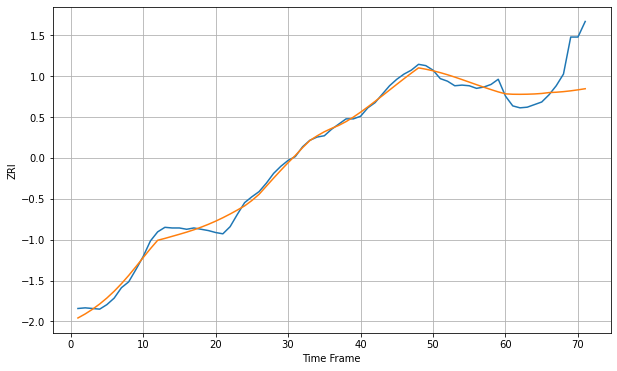

Wall time: 6.13 s
92618 8.80690978990625 47.120551383468275 [2104.54874193 2103.91824398 2103.81425366 2103.97826173 2104.37722197
 2105.12794335 2106.47613615 2107.03292566 2107.93892652 2109.17885827
 2110.71692614 2112.42600946]


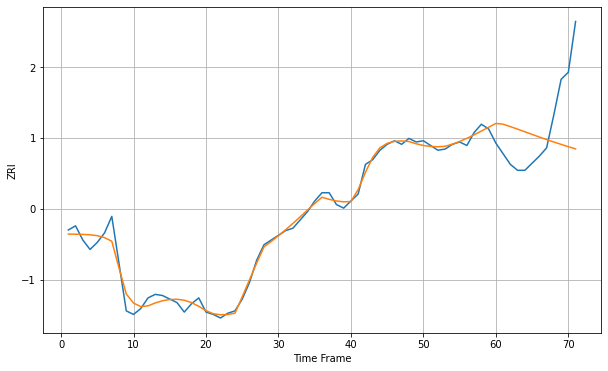

Wall time: 17 s
92620 5.307842434771971 44.98164245858582 [1933.68044567 1933.02832165 1931.00484598 1928.84438604 1926.61539573
 1924.37515458 1922.16719901 1920.01989009 1917.94727241 1915.95262594
 1913.98344729 1912.13070221]

Got an mse at 0.0050 in round 85 and stopped training



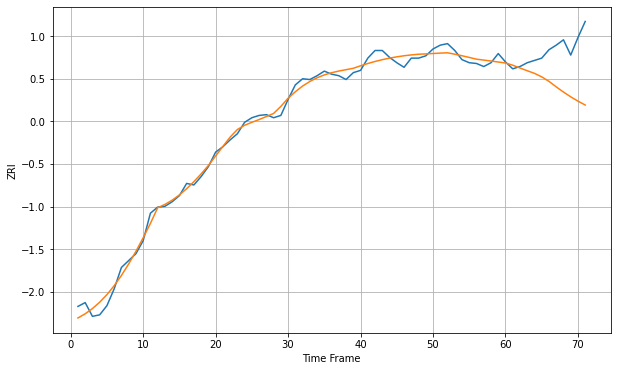

Wall time: 7.19 s
92626 7.853001787351051 51.86634979836547 [2207.61181208 2204.73316834 2201.0807396  2197.5163842  2194.05651862
 2189.49271564 2183.59809084 2176.39827763 2169.61385795 2163.35553516
 2157.70507819 2152.63995926]

Got an mse at 0.0050 in round 89 and stopped training



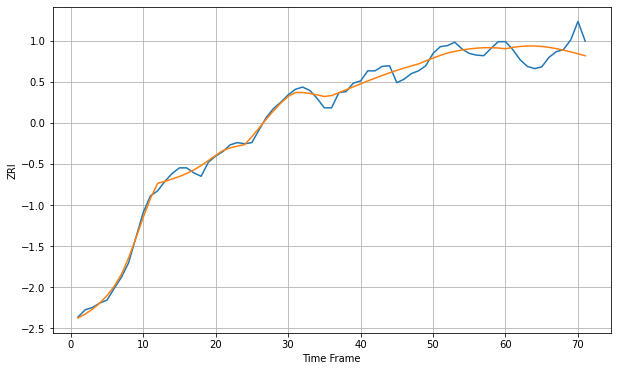

Wall time: 6.92 s
92627 10.304412641305667 28.561655352477786 [2301.34355937 2303.8014397  2305.46713687 2306.29240498 2306.26410886
 2305.41429445 2303.82132971 2301.59890349 2298.87623107 2295.77819698
 2292.41325861 2288.87091864]

Got an mse at 0.0050 in round 61 and stopped training



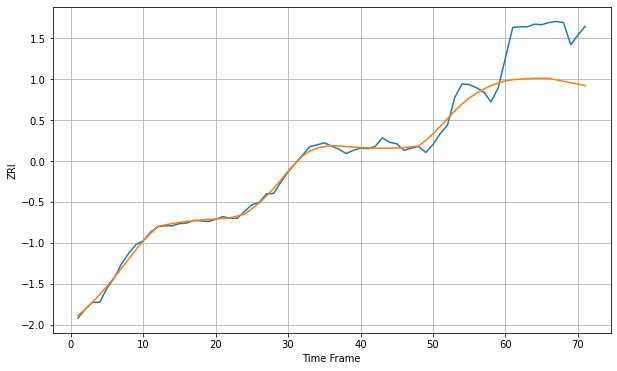

Wall time: 6.09 s
92647 10.676479606653361 95.60605322806242 [2132.06587288 2133.83603056 2135.08170081 2135.9305457  2136.48877467
 2136.83959792 2136.38455546 2133.54402805 2130.82935383 2128.21533448
 2125.66016499 2123.11951177]

Got an mse at 0.0050 in round 115 and stopped training



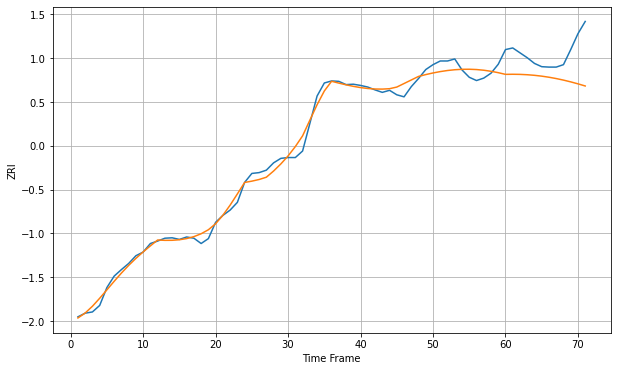

Wall time: 7.61 s
92648 15.137942018535389 72.5597360196363 [2309.16411386 2309.40179443 2309.10989904 2308.25294105 2306.80678412
 2304.75933688 2302.1103463  2298.87086217 2295.06299045 2290.72034325
 2285.8892251  2280.63014339]

Got an mse at 0.0050 in round 413 and stopped training



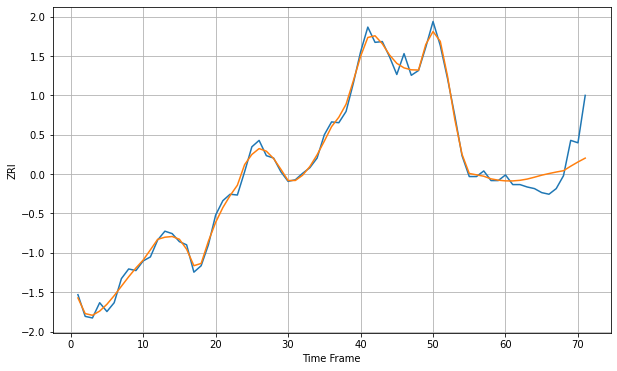

Wall time: 14.2 s
92651 6.881940275160539 28.427084167016336 [2559.60170927 2559.57173053 2560.31908742 2561.88465375 2564.19792799
 2566.71191874 2568.73416362 2570.61798719 2572.27290144 2577.90487423
 2583.12669127 2587.92416208]

Got an mse at 0.0050 in round 169 and stopped training



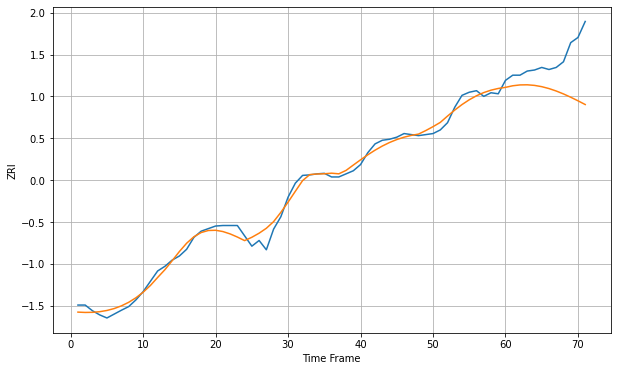

Wall time: 8.54 s
92656 11.384639637313843 72.63075392894103 [2251.47565156 2254.50059806 2256.14640857 2256.39106692 2255.2508182
 2252.78922521 2249.11487553 2244.36925181 2238.71638512 2232.33832947
 2225.43147187 2218.19864513]

Got an mse at 0.0050 in round 105 and stopped training



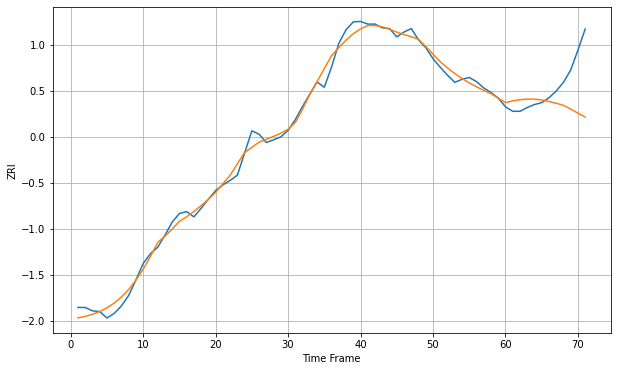

Wall time: 7.38 s
92660 17.199737545130837 91.94250617575469 [2884.0553218  2888.53424145 2891.76707836 2893.40504856 2893.19241701
 2891.04413592 2887.09306021 2882.40861033 2876.77566147 2866.71338333
 2856.0099914  2845.78644856]

Got an mse at 0.0050 in round 272 and stopped training



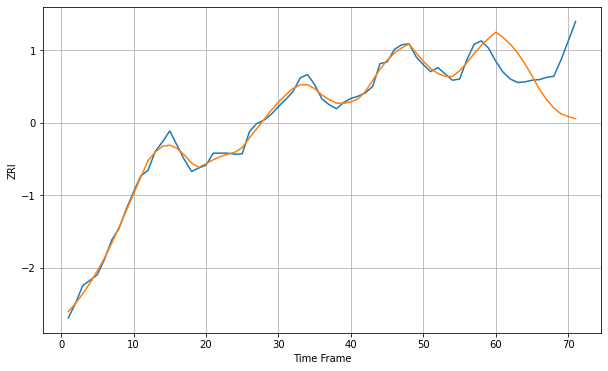

Wall time: 11.3 s
92663 8.952578511478645 78.74851991273006 [2366.14915383 2356.98554894 2344.95516208 2329.71296688 2310.90055377
 2289.38329899 2266.19645844 2248.09671092 2233.24928934 2222.85456588
 2218.12278732 2214.68974063]

Got an mse at 0.0050 in round 238 and stopped training



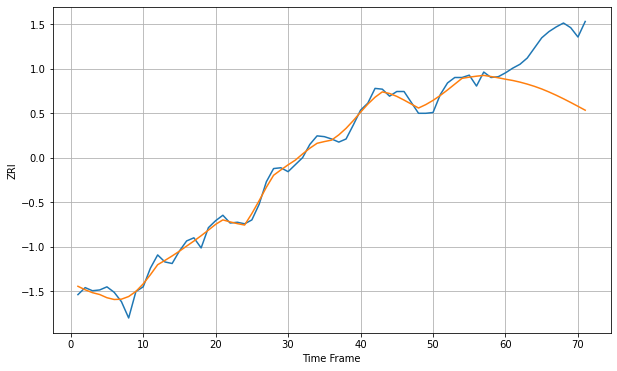

Wall time: 10.7 s
92672 8.06424860389308 71.93121572168081 [2223.79940911 2222.16644931 2220.05477142 2217.51880133 2214.60862794
 2211.26158218 2207.39710811 2203.18769469 2198.67530207 2193.91650932
 2188.9858091  2183.97432241]

Got an mse at 0.0050 in round 191 and stopped training



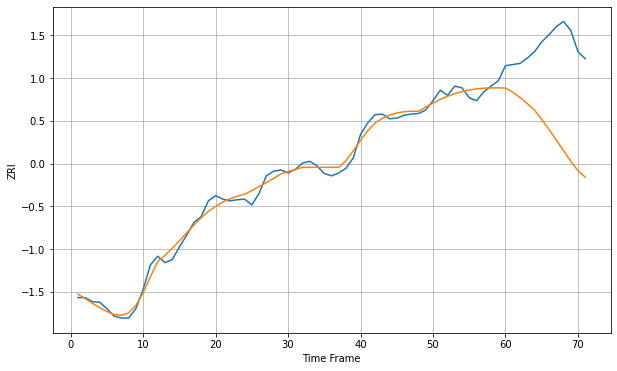

Wall time: 9.11 s
92673 10.344855525018504 154.83072956766324 [2199.69949168 2192.72183262 2183.53116594 2173.11473633 2161.79008445
 2145.86040225 2128.64851128 2110.68185501 2092.43624818 2074.26821432
 2057.72476507 2046.83795956]


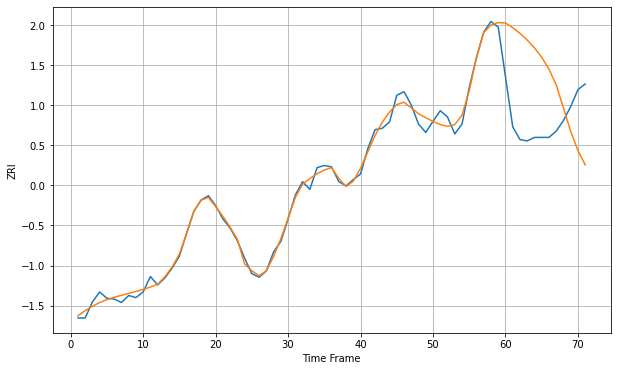

Wall time: 16.4 s
92677 8.142829646589725 105.873333857251 [2472.89487785 2466.13126308 2457.99796369 2448.45898147 2437.32774527
 2423.99201475 2407.07814795 2384.63820053 2351.95147434 2318.36236753
 2291.30841462 2270.88513462]

Got an mse at 0.0050 in round 195 and stopped training



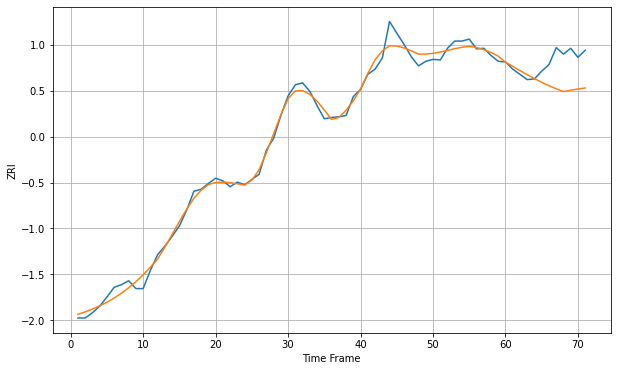

Wall time: 9.43 s
92691 9.861350047967052 39.29581474683998 [2115.7379455  2109.23092454 2102.78245584 2096.49391403 2090.47147
 2084.81705002 2079.6147704  2074.91561339 2070.66529766 2072.720013
 2074.63085804 2076.2099486 ]

Got an mse at 0.0050 in round 213 and stopped training



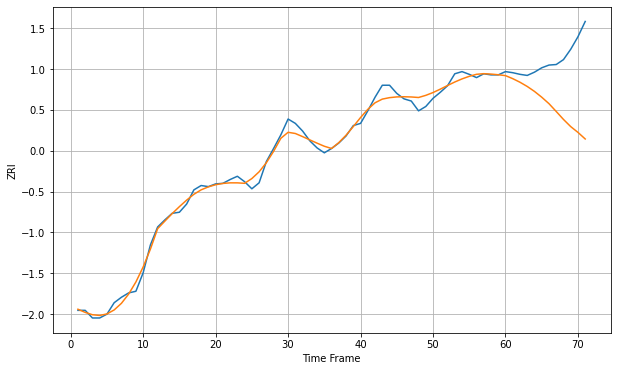

Wall time: 9.51 s
92692 10.552952989214123 102.81948600140926 [2174.63898049 2169.06619908 2162.4947349  2154.75450007 2145.64837707
 2135.04579448 2123.17466751 2108.85667876 2094.25886406 2081.08669074
 2070.4819767  2058.40461274]

Got an mse at 0.0050 in round 212 and stopped training



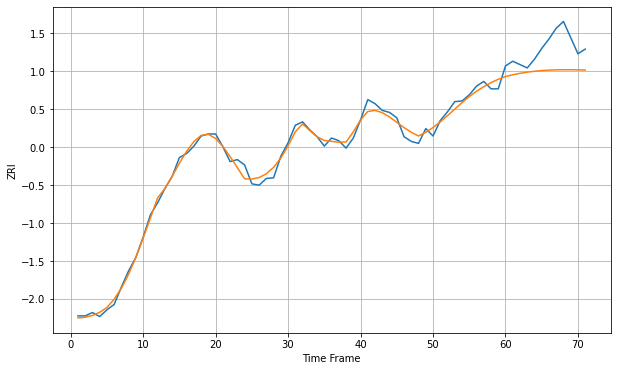

Wall time: 9.8 s
92707 7.8881251424507095 37.802787043073025 [2175.27858541 2177.85685237 2180.0104663  2181.75346462 2183.10963795
 2184.11059126 2184.79365875 2185.2000554  2185.37331549 2185.35782401
 2185.19722602 2184.9325937 ]

Got an mse at 0.0050 in round 133 and stopped training



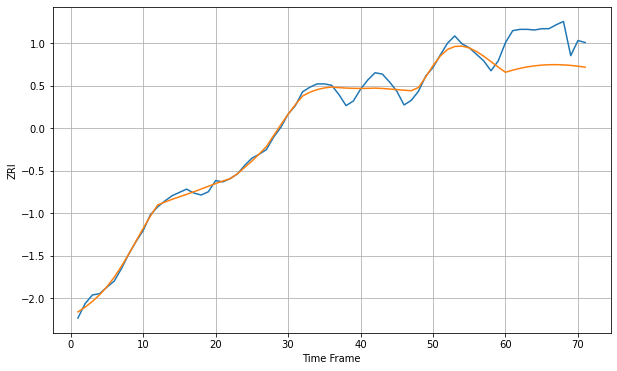

Wall time: 7.94 s
92780 9.09314545695642 52.17738314155917 [2093.74187127 2096.98316645 2099.69943941 2101.86881769 2103.4981091
 2104.60451194 2105.20585381 2105.3201486  2104.96845897 2104.17713334
 2102.97880808 2101.41262849]

Got an mse at 0.0049 in round 46 and stopped training



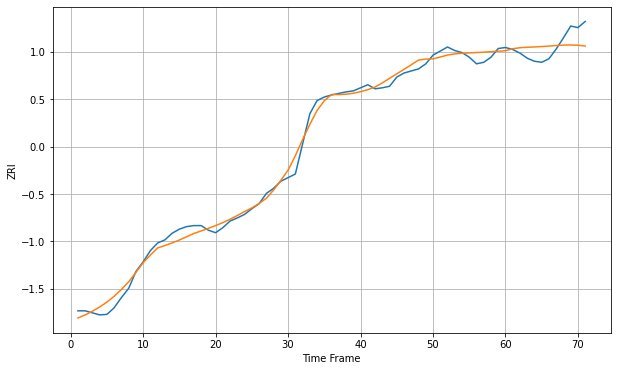

Wall time: 6 s
92782 12.71688381278051 25.99508915306549 [2392.62014152 2396.54109086 2398.54217917 2399.47669216 2400.08393702
 2400.8302007  2401.82878154 2402.89567376 2403.70317186 2403.93788602
 2403.39370116 2401.88919552]

Got an mse at 0.0048 in round 70 and stopped training



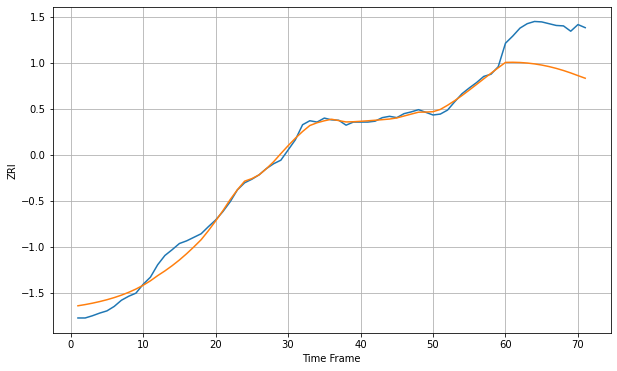

Wall time: 6.31 s
92805 14.260442451538728 92.16243398417298 [1979.63182314 1979.91387288 1979.42918024 1978.21632519 1976.28753198
 1973.63838774 1970.25995597 1966.15199712 1961.33555912 1955.86255234
 1949.81970578 1943.91578577]

Got an mse at 0.0050 in round 71 and stopped training



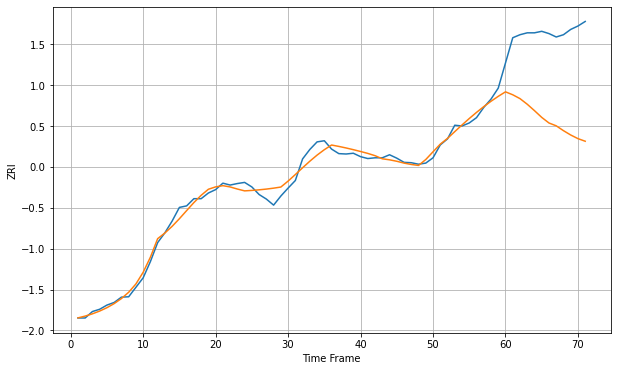

Wall time: 6.62 s
92806 15.155924463318168 228.7066542971979 [2192.16411705 2184.39702587 2174.24477196 2159.4195443  2142.46388268
 2124.66994602 2109.88735643 2102.4198114  2089.62504255 2078.17789877
 2068.59183463 2061.71196324]

Got an mse at 0.0050 in round 165 and stopped training



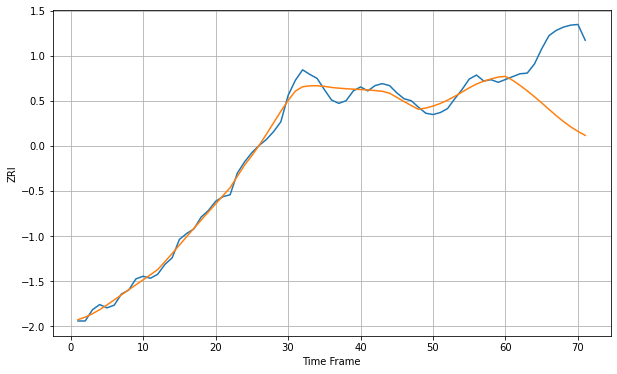

Wall time: 8.7 s
92832 9.63923141365386 104.76742579829686 [1960.06895628 1953.96684658 1946.38654557 1938.04732897 1929.06686212
 1919.66563517 1909.89989791 1900.30338025 1891.35075303 1883.30346137
 1876.29512717 1870.34850516]

Got an mse at 0.0050 in round 149 and stopped training



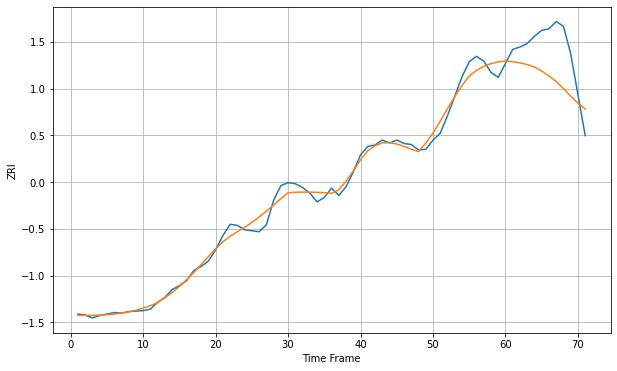

Wall time: 8.11 s
93001 13.434858386790323 73.90246291103796 [2208.24202646 2206.73283765 2204.49943104 2201.12954777 2196.07567003
 2187.86558701 2177.88799473 2166.34803927 2152.05657941 2136.62129436
 2122.37213481 2110.43077979]

Got an mse at 0.0050 in round 81 and stopped training



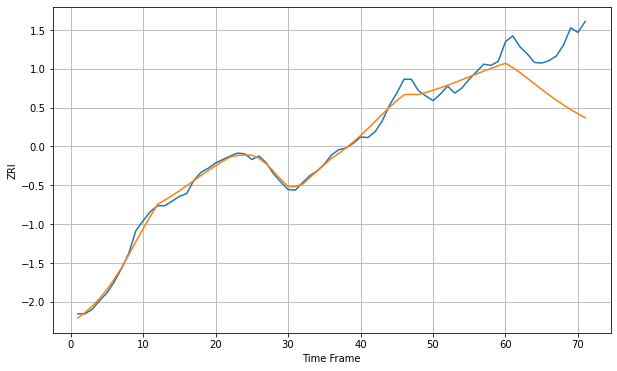

Wall time: 6.95 s
93010 9.427540539284903 90.93409151258597 [2045.66226103 2038.2005446  2029.50612873 2019.94762091 2010.10614419
 2000.38101237 1990.8803912  1981.94088333 1973.50226367 1965.54466231
 1958.11628481 1951.29387364]

Got an mse at 0.0049 in round 67 and stopped training



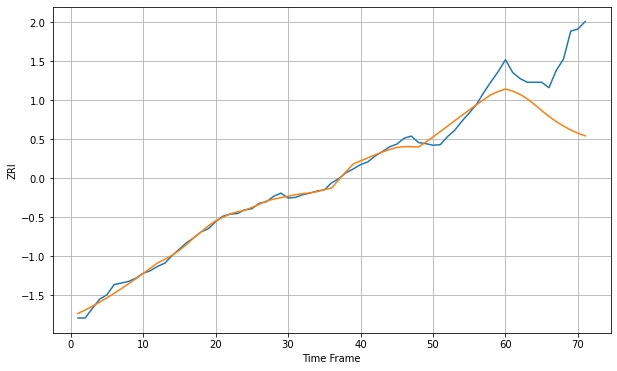

Wall time: 6.56 s
93030 10.041599511232 113.40086726195871 [1858.54360574 1854.48592493 1848.46665491 1840.19629273 1829.64659972
 1818.30838129 1807.5386081  1797.93643008 1789.55097186 1782.34085792
 1776.28882591 1771.36110409]

Got an mse at 0.0050 in round 414 and stopped training



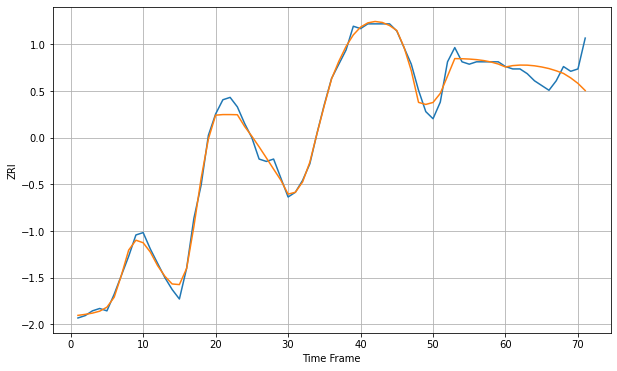

Wall time: 14.3 s
93304 2.761114136990601 7.971088425031231 [880.81634781 881.3982035  881.62114097 881.59087241 881.31531793
 880.82187393 880.15403273 879.21015274 878.10526039 876.21345853
 873.89412557 870.8881218 ]


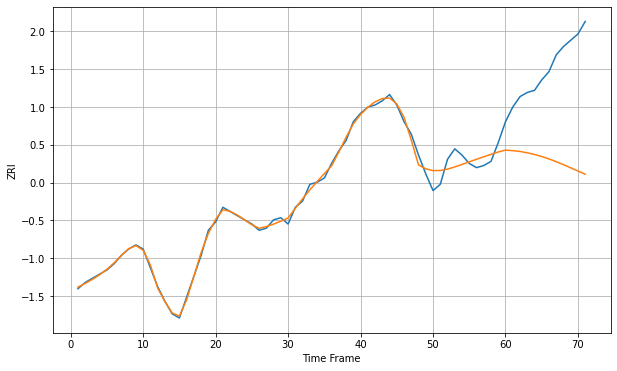

Wall time: 15.9 s
93305 2.6475340269343595 45.99909069397748 [789.39053396 789.11930721 788.74846418 788.11173136 787.30780878
 786.32475809 785.16712061 783.85595047 782.42571614 780.91773801
 779.3725211  777.82449754]

Got an mse at 0.0050 in round 375 and stopped training



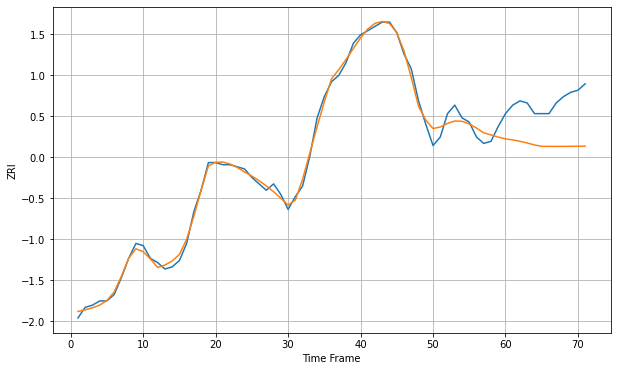

Wall time: 13.5 s
93307 2.7045652567597718 20.341825827749478 [857.12604405 856.65756795 856.01088895 855.21244825 854.28949124
 853.64784119 853.61737264 853.60654818 853.61424884 853.63918703
 853.67995419 853.73501702]

Got an mse at 0.0050 in round 411 and stopped training



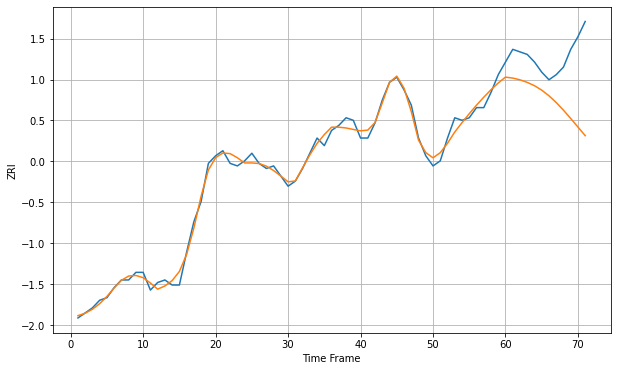

Wall time: 14.1 s
93308 2.2717162802056974 20.500509979739537 [849.03536674 848.66223198 847.97330203 846.96380596 845.65264953
 843.89361836 841.66940143 839.00729153 835.98557779 832.71693827
 829.32528266 825.93990439]

Got an mse at 0.0049 in round 267 and stopped training



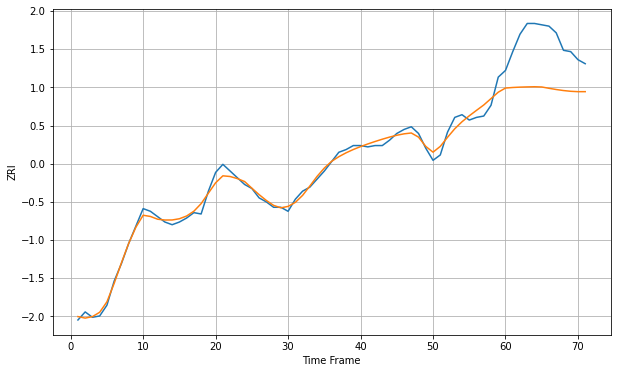

Wall time: 10.9 s
93309 3.9831159948072457 36.23235146444001 [1025.86739885 1026.28299215 1026.54907522 1026.71801184 1026.83739519
 1026.66270936 1025.68247211 1024.77587332 1024.00416299 1023.44296308
 1023.15894312 1023.17301759]

Got an mse at 0.0049 in round 39 and stopped training



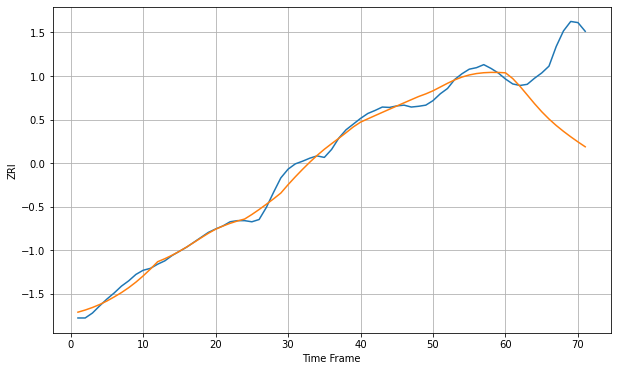

Wall time: 5.9 s
93906 15.755345334927979 190.2804698642596 [1785.41065284 1770.21916319 1749.7946595  1726.9778126  1704.070061
 1682.65871862 1663.45045877 1646.33732406 1630.84230529 1616.49518699
 1602.97046623 1590.08139914]

Got an mse at 0.0050 in round 97 and stopped training



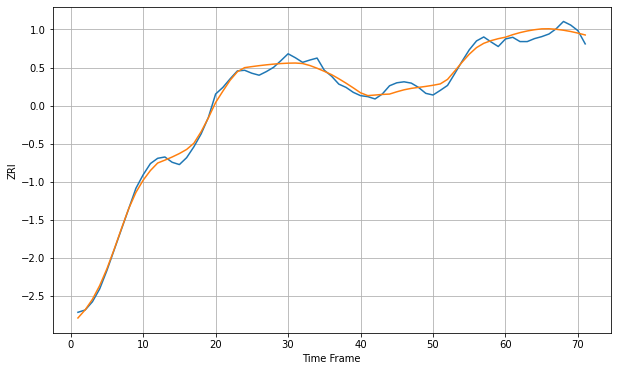

Wall time: 7.11 s
94010 16.23789030109222 20.95538444705645 [2726.35452844 2733.94812668 2740.18700659 2745.16786662 2748.9494534
 2751.57035573 2751.8873354  2750.26674064 2747.44744394 2743.53735744
 2738.67140798 2733.00003174]

Got an mse at 0.0050 in round 143 and stopped training



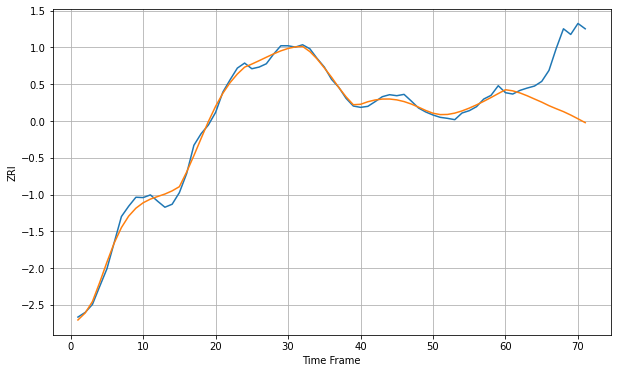

Wall time: 8.15 s
94025 15.46956434163524 166.3684708546911 [3345.96621834 3342.54270419 3336.30767248 3327.7205911  3318.09887236
 3308.66683693 3298.06090122 3288.90509461 3280.18113093 3269.9294741
 3258.68345984 3247.10330006]

Got an mse at 0.0050 in round 407 and stopped training



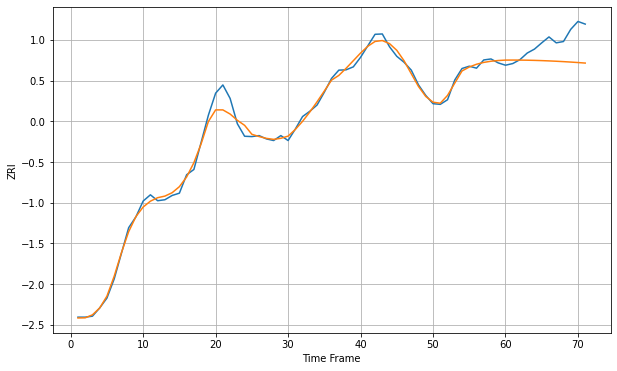

Wall time: 13.8 s
94040 17.42224034067596 68.69738467844854 [3401.53937424 3401.6481459  3401.54179406 3401.22020637 3400.69148513
 3399.97319196 3399.08773816 3398.05414191 3396.88214105 3395.57169549
 3394.11595751 3392.50478757]


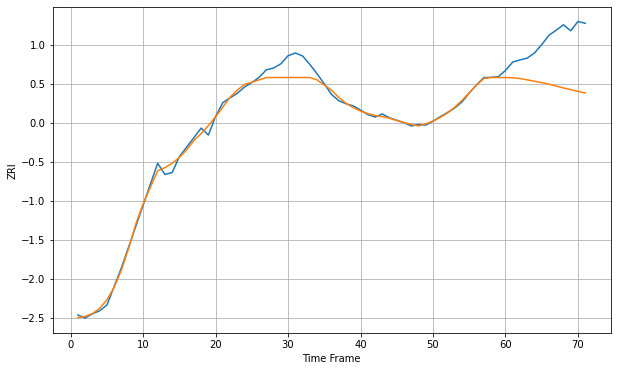

Wall time: 16.4 s
94061 21.978200604136475 155.14389668347295 [3028.26596708 3027.57211494 3025.11705108 3020.59607123 3016.00155632
 3011.39285877 3006.47122086 2999.86429331 2993.68769298 2987.88236809
 2982.4005286  2977.20560552]

Got an mse at 0.0050 in round 165 and stopped training



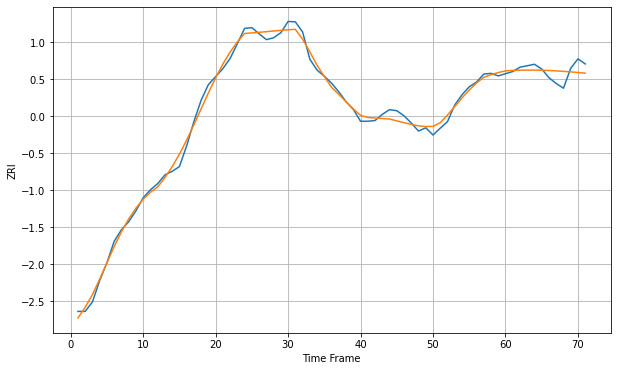

Wall time: 8.65 s
94066 14.368373743054416 23.260929023883662 [2844.86915288 2846.04065429 2846.68918737 2846.9894587  2846.94206192
 2846.55235429 2845.83647938 2844.82172768 2843.54298936 2842.03874696
 2840.34897049 2838.51472463]

Got an mse at 0.0050 in round 165 and stopped training



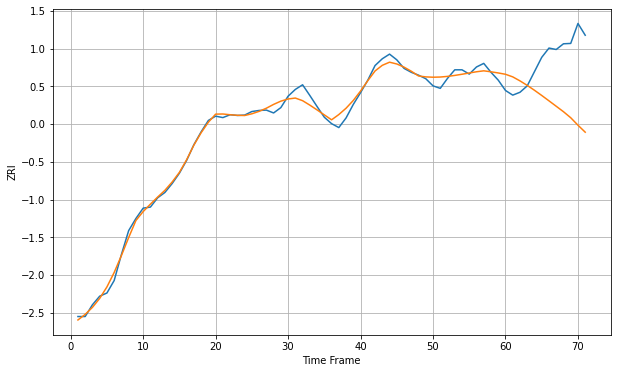

Wall time: 8.48 s
94085 14.836295045182169 158.70770720751148 [3006.48548512 2999.19854706 2987.93341756 2975.30148396 2961.58978733
 2947.04749512 2931.98641592 2916.76060328 2901.5028774  2884.57976974
 2863.66702141 2844.05874103]

Got an mse at 0.0050 in round 109 and stopped training



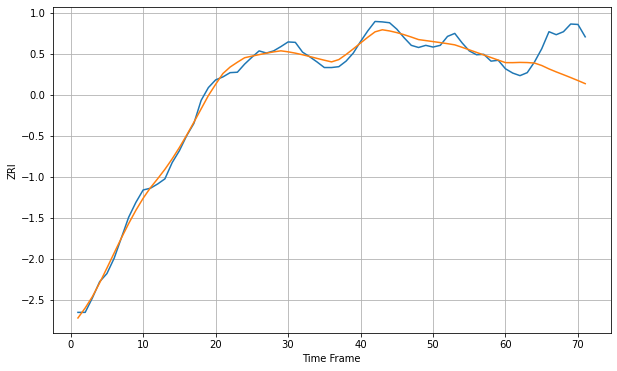

Wall time: 7.52 s
94086 13.469145383199175 78.72929002739541 [2914.49442235 2914.45479041 2915.02064594 2914.6815085  2913.51265332
 2907.76774802 2899.79408551 2892.75636904 2886.18471147 2879.4376807
 2872.45096028 2865.21864233]

Got an mse at 0.0050 in round 234 and stopped training



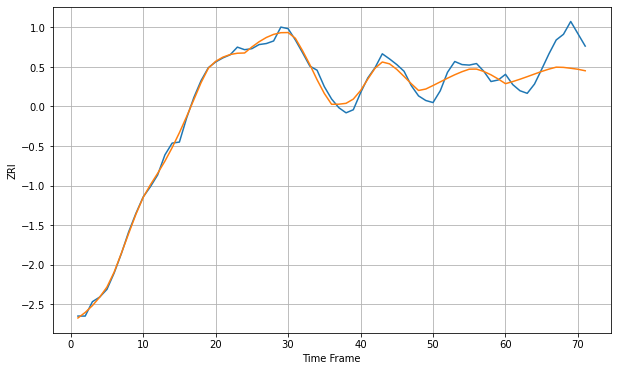

Wall time: 10.2 s
94087 10.823382439860897 46.17007372895908 [2698.80374029 2702.85360475 2707.46139749 2712.44228051 2717.57664442
 2722.64993697 2727.17864454 2730.99243803 2730.52306287 2728.82150086
 2726.87830119 2723.96004054]

Got an mse at 0.0049 in round 328 and stopped training



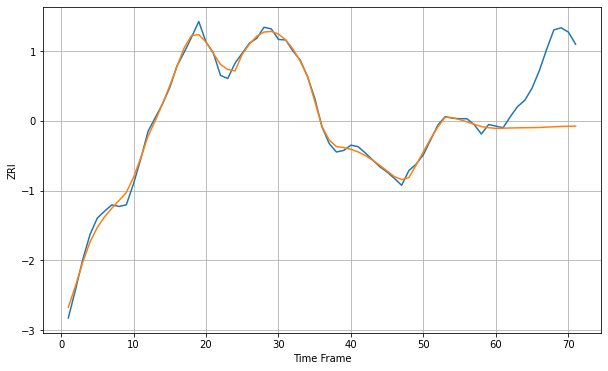

Wall time: 12.2 s
94103 9.243857877141181 118.24277114533355 [3482.66877524 3483.10246322 3483.4885278  3483.79164147 3483.99498584
 3484.09740907 3484.363112   3485.15104261 3485.80174995 3486.32518924
 3486.72726224 3487.01056121]

Got an mse at 0.0050 in round 281 and stopped training



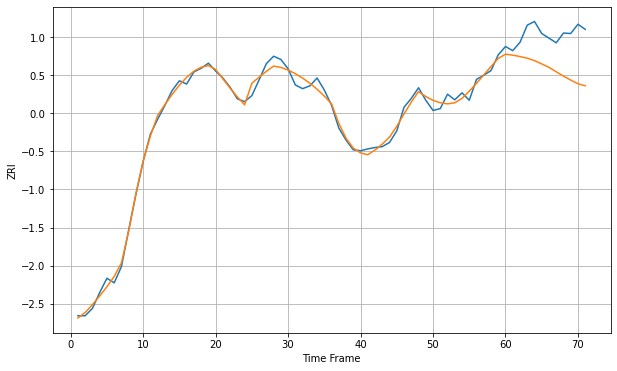

Wall time: 11 s
94105 11.563409877283268 79.43100302990682 [3990.41328195 3988.29847774 3985.35291054 3981.74074207 3976.49299664
 3969.45500784 3962.05547621 3952.46932268 3943.13452572 3934.49225477
 3926.7090564  3922.21741276]

Got an mse at 0.0050 in round 150 and stopped training



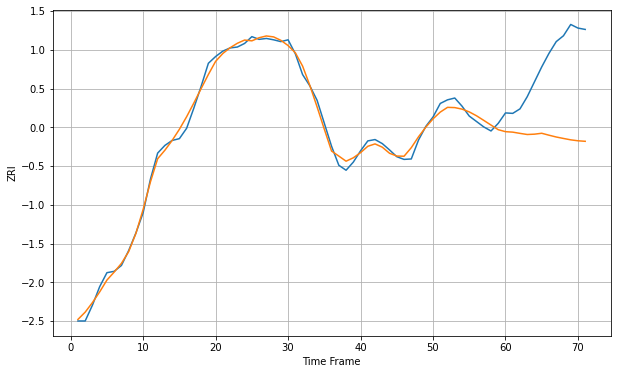

Wall time: 8.43 s
94107 12.021918515430976 174.8930123425319 [3808.47014251 3807.41294493 3804.68631439 3802.18426642 3802.92636239
 3804.91434954 3800.64077279 3796.64250699 3793.43310291 3790.35985236
 3788.26918781 3787.11488552]

Got an mse at 0.0050 in round 396 and stopped training



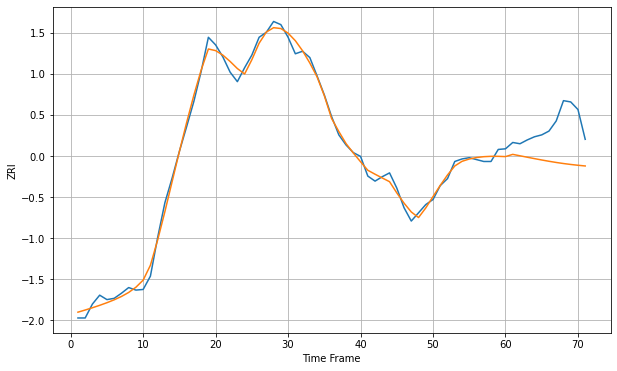

Wall time: 13.9 s
94109 9.128319713396637 57.762251782912756 [3370.70782176 3374.22329864 3371.97819605 3369.73400184 3367.5141791
 3365.3599116  3363.32164434 3361.44721933 3359.77017524 3358.30179357
 3357.02884945 3355.9168867 ]

Got an mse at 0.0050 in round 288 and stopped training



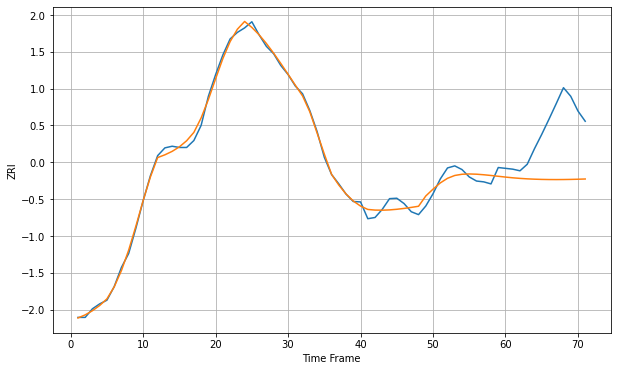

Wall time: 11.2 s
94110 12.648929836658995 133.9793218553952 [3846.67032066 3844.89546409 3843.46810335 3842.35738485 3841.53630844
 3840.98110107 3840.66985815 3840.58122219 3840.6934064  3840.98362602
 3841.42790211 3842.00118023]

Got an mse at 0.0050 in round 133 and stopped training



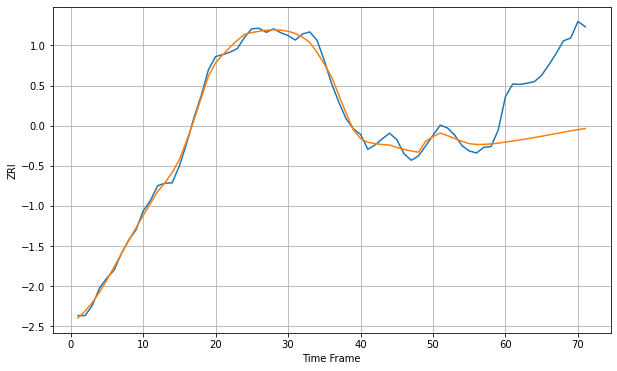

Wall time: 8.09 s
94115 14.012897525669407 187.64721992984525 [3443.02534957 3445.58515756 3448.33809694 3451.26164595 3454.34438735
 3457.56934011 3460.89901563 3464.27044673 3467.60212997 3470.80828758
 3473.81358857 3476.56330761]

Got an mse at 0.0050 in round 150 and stopped training



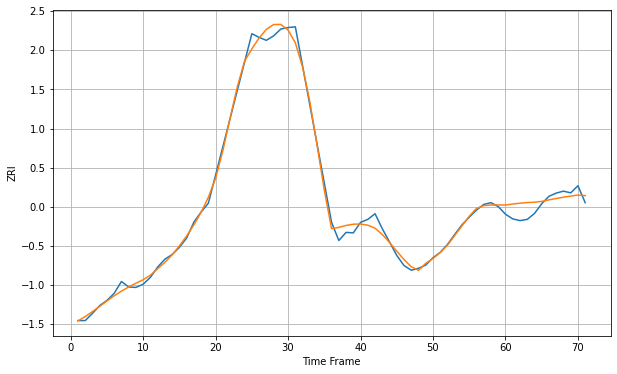

Wall time: 8.41 s
94158 22.457544215735506 41.569483843378286 [3940.50517453 3944.66459423 3947.93711165 3950.34746822 3951.96819299
 3955.26872333 3961.45047365 3967.14147178 3972.28675441 3976.89637398
 3980.96924673 3978.7876158 ]

Got an mse at 0.0049 in round 77 and stopped training



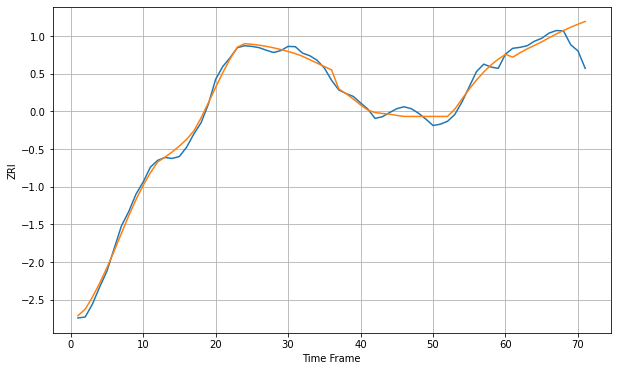

Wall time: 6.85 s
94401 16.236208127014816 52.085594835318645 [2860.30295564 2851.69288672 2865.2294607  2877.44572172 2888.00471625
 2898.99019885 2911.4966191  2923.22017524 2934.12609435 2944.21962351
 2953.53880643 2962.14087886]

Got an mse at 0.0050 in round 154 and stopped training



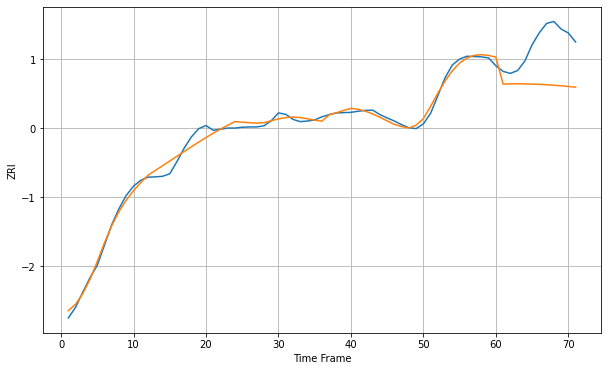

Wall time: 8.33 s
94403 17.28482882499789 149.9097623443635 [3109.80946373 3013.75468565 3014.74609464 3014.91188368 3014.38172864
 3013.66015715 3012.76068341 3011.41880407 3009.69475512 3007.64036089
 3005.30114696 3002.71792621]

Got an mse at 0.0050 in round 172 and stopped training



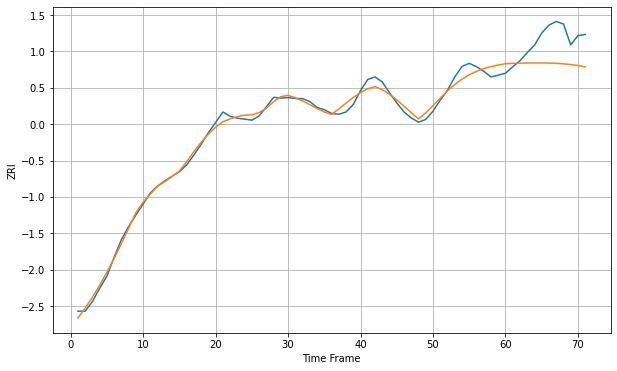

Wall time: 8.88 s
94404 18.005396164972716 94.2375551117125 [3182.54250972 3183.79074276 3184.66343732 3185.22123128 3185.47793952
 3185.40031917 3184.9139626  3183.9079518  3182.23771158 3179.73083051
 3176.2054693  3171.51436496]

Got an mse at 0.0050 in round 177 and stopped training



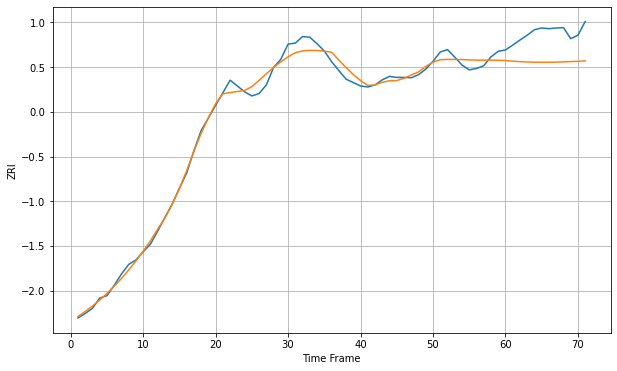

Wall time: 8.75 s
94501 18.31002591404927 84.14480022024043 [2588.17630879 2586.39473373 2584.9801054  2583.96265127 2583.34249884
 2583.09686101 2583.18822377 2583.57216521 2584.20383424 2585.04248231
 2586.05386699 2587.21077338]

Got an mse at 0.0049 in round 41 and stopped training



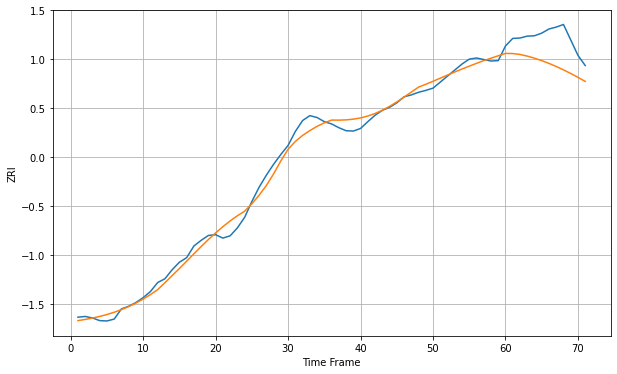

Wall time: 5.57 s
94509 17.792347572710487 72.15943288395086 [1927.21754991 1926.78600852 1924.4582174  1920.02000291 1914.51827344
 1908.03380175 1900.65039845 1892.45019774 1883.50982411 1873.89718958
 1863.66865966 1852.86644607]

Got an mse at 0.0050 in round 246 and stopped training



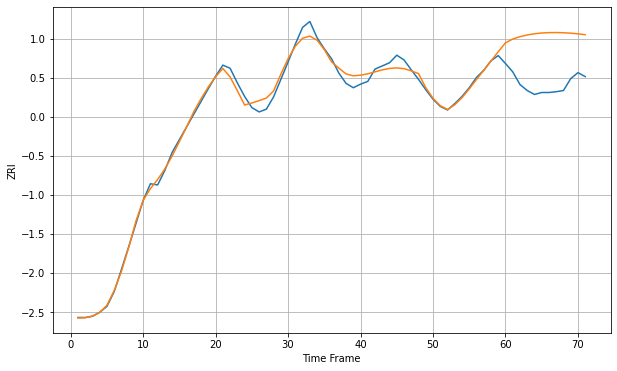

Wall time: 10.2 s
94530 13.803764213208384 125.70295645101025 [2503.24144029 2512.70760516 2518.67607122 2523.00628703 2526.00638145
 2527.9065254  2528.88029273 2529.06101675 2528.5533517  2527.44152668
 2525.79532411 2523.67437396]


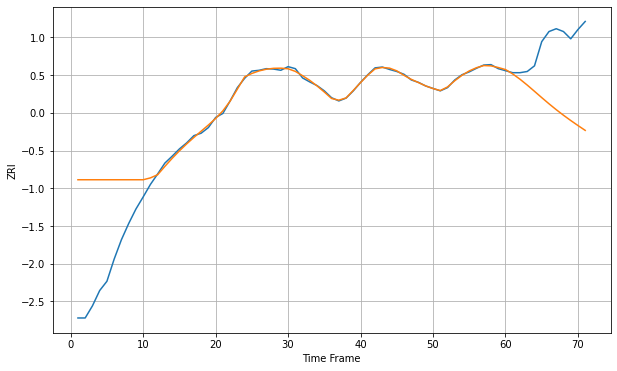

Wall time: 15.7 s
94538 96.70834549624668 160.85885382903462 [2460.80032099 2449.84847652 2436.84320895 2422.29209059 2406.86360859
 2391.23989891 2375.96742902 2361.37393863 2347.57034177 2334.50744107
 2322.04532742 2310.009189  ]

Got an mse at 0.0050 in round 144 and stopped training



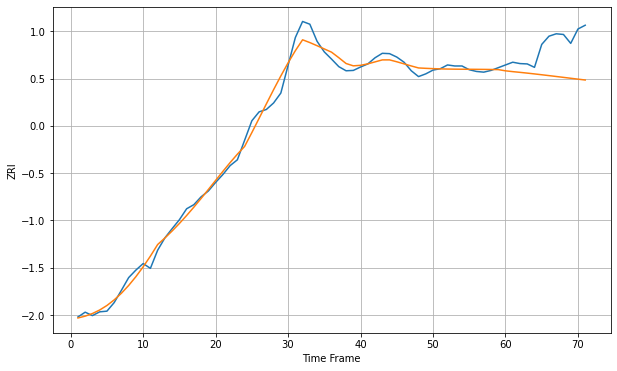

Wall time: 7.99 s
94541 19.443007578676756 96.84835122417878 [2366.85673562 2364.48150623 2362.39878287 2360.16758515 2357.81657998
 2355.37278892 2352.86136354 2350.30546216 2347.72620648 2345.14268497
 2342.57197898 2340.02919963]

Got an mse at 0.0050 in round 147 and stopped training



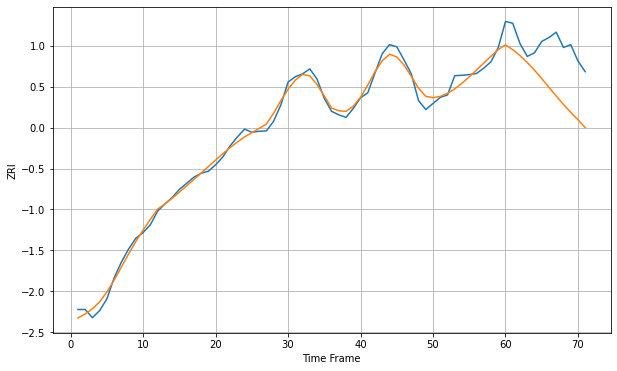

Wall time: 7.83 s
94549 16.05975078388751 125.670820789282 [2752.32496822 2738.78224434 2722.39662702 2703.16847224 2681.40007229
 2657.75696709 2633.19071859 2608.71465601 2585.14364186 2562.94711986
 2542.26607212 2520.3027179 ]

Got an mse at 0.0050 in round 38 and stopped training



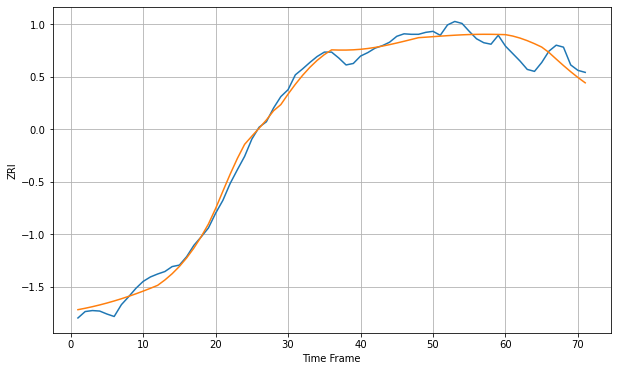

Wall time: 5.7 s
94565 14.8379483618218 34.73269232188103 [2027.32126803 2024.4961167  2020.39583149 2015.17719635 2009.02836454
 2002.15441556 1991.19224395 1977.87402852 1964.80431288 1952.28996396
 1940.57929255 1929.85446255]

Got an mse at 0.0050 in round 355 and stopped training



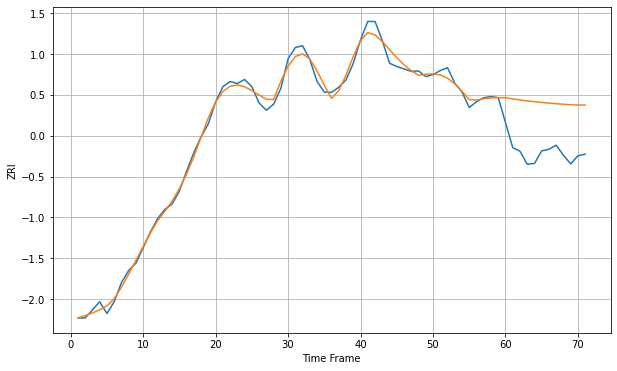

Wall time: 13.2 s
94568 14.13163750138005 124.71159728058676 [2765.97975853 2763.12475564 2760.52960179 2758.20419638 2756.14157978
 2754.31786157 2752.69633817 2751.23313927 2749.88213548 2748.59802243
 2748.06756797 2747.69508707]

Got an mse at 0.0050 in round 78 and stopped training



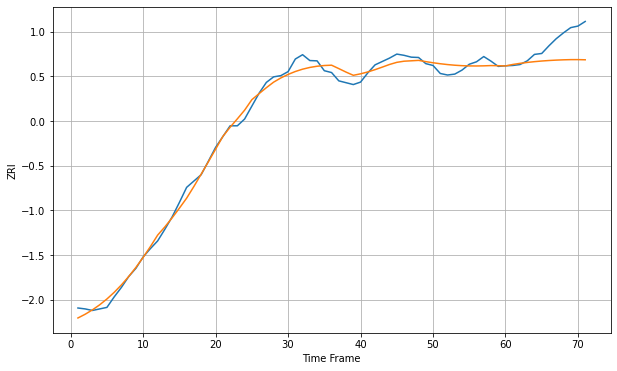

Wall time: 6.58 s
94603 20.33313627105276 67.21079372737758 [2377.43176186 2382.27659141 2385.86048313 2388.88325889 2391.40808115
 2393.48458806 2395.15161222 2396.44026924 2397.37682041 2397.98498761
 2398.02491557 2397.51215175]

Got an mse at 0.0050 in round 83 and stopped training



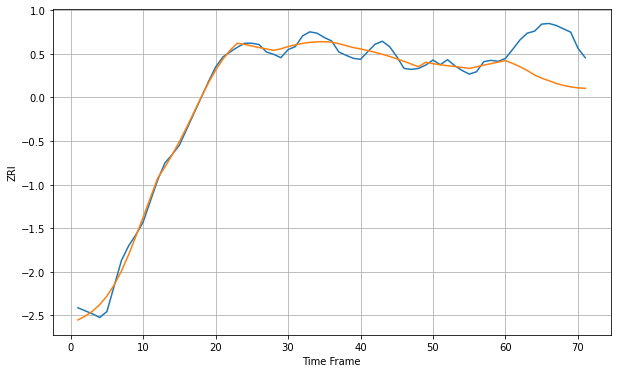

Wall time: 6.98 s
94608 18.347168735077815 129.12087407556794 [2792.16924166 2783.78157281 2774.0073889  2762.63185229 2749.53130811
 2739.81872744 2732.17331767 2724.16298655 2718.36025669 2713.87919696
 2710.7432432  2709.63603709]

Got an mse at 0.0049 in round 86 and stopped training



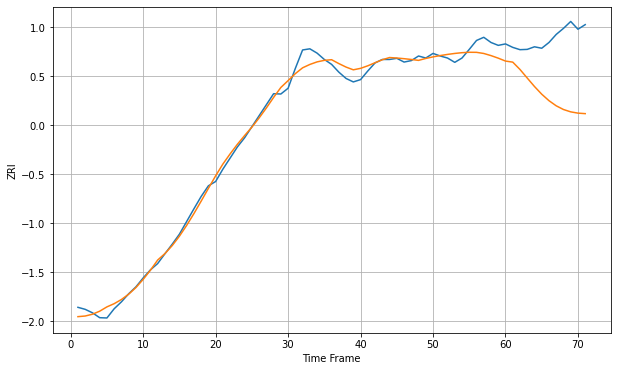

Wall time: 6.96 s
94621 23.692045751614646 209.41555820367273 [2471.4531309  2467.74606541 2442.2286007  2412.48347246 2383.04203361
 2356.36050606 2333.81802396 2315.99549385 2303.16347062 2294.99028053
 2290.56911007 2288.83043435]

Got an mse at 0.0049 in round 83 and stopped training



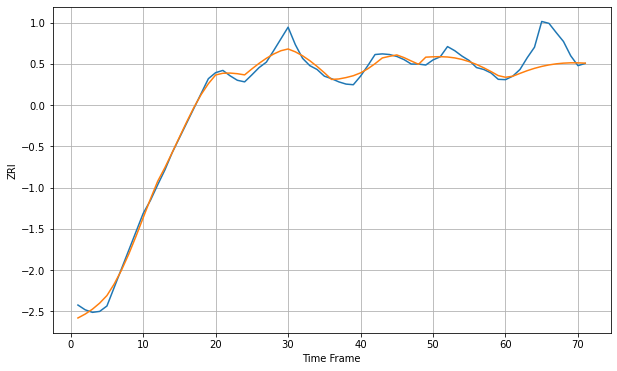

Wall time: 6.9 s
94703 18.0533242149442 69.64200955585497 [2770.45078215 2773.74601515 2782.6934091  2791.25483347 2798.58157218
 2804.61473188 2809.32844135 2812.74270268 2814.9146921  2815.92410272
 2815.86166408 2814.82262311]

Got an mse at 0.0050 in round 221 and stopped training



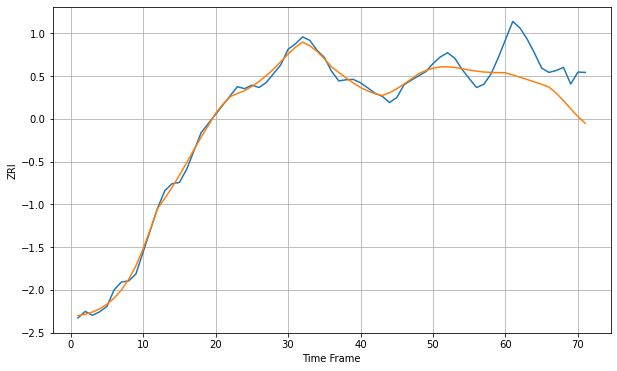

Wall time: 9.53 s
94801 15.62017556543039 94.88503659637891 [2242.16538214 2236.56093307 2230.64020804 2224.53126983 2218.36523736
 2212.23029209 2205.16612635 2189.33680778 2169.81069247 2148.8218738
 2128.65786079 2111.34975552]

Got an mse at 0.0049 in round 50 and stopped training



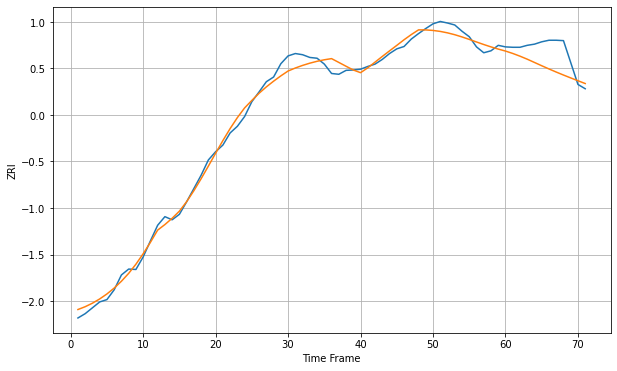

Wall time: 6.05 s
94806 16.423851589432935 49.68149843898587 [2134.33881737 2128.22738076 2121.2584987  2113.5716294  2105.19323893
 2096.80791249 2088.60171752 2080.67675563 2073.05270548 2065.68244606
 2058.47664239 2051.33071555]

Got an mse at 0.0049 in round 98 and stopped training



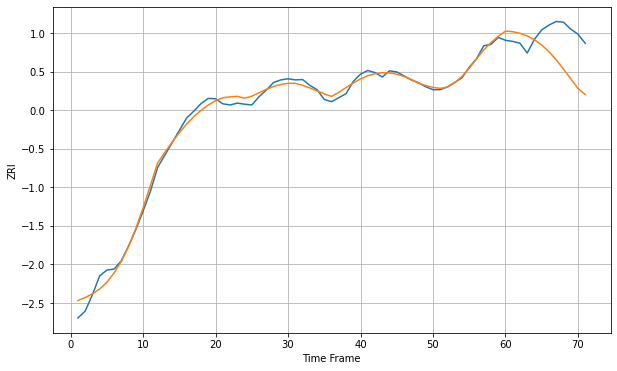

Wall time: 7.01 s
94901 14.742546876525209 91.447400453287 [2660.45270208 2658.75626759 2654.44242706 2647.14472942 2636.47269789
 2622.06592497 2603.69718276 2581.32467756 2555.78314496 2529.57817703
 2502.30728619 2485.59674573]

Got an mse at 0.0050 in round 206 and stopped training



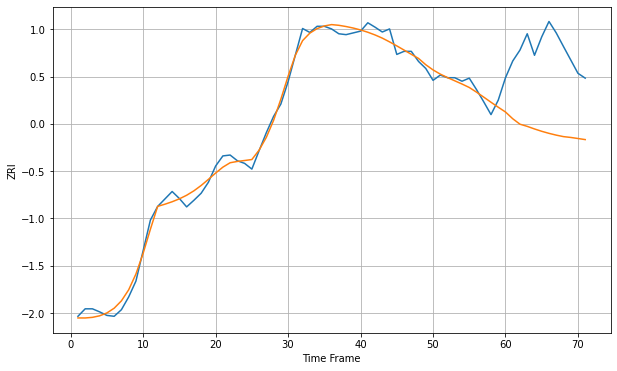

Wall time: 9.48 s
94903 15.1378146784431 183.5658119978856 [2568.93281263 2553.55956103 2541.16522209 2536.25785562 2530.37440318
 2525.0188087  2520.35990784 2516.31379836 2512.91777097 2511.04421869
 2508.63893682 2506.13466176]


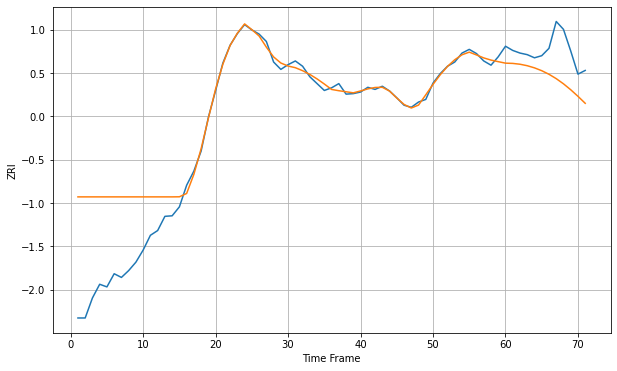

Wall time: 16.2 s
95008 71.70784593170974 57.51818224690633 [2598.84131993 2598.35785111 2596.79799625 2593.98139181 2589.91426795
 2584.5290486  2577.72996138 2569.43492508 2559.61522317 2548.35003565
 2535.87855183 2522.61687532]

Got an mse at 0.0050 in round 157 and stopped training



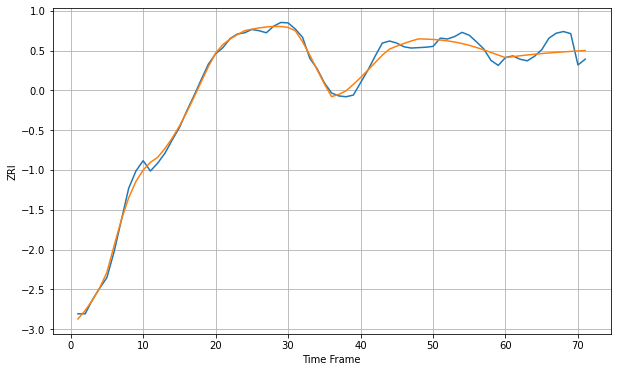

Wall time: 8.32 s
95014 13.53154932200565 28.471809493507454 [3208.6845605  3211.09693452 3213.26637284 3215.22173269 3216.99221171
 3218.60499441 3220.08365331 3221.44731583 3222.71053903 3223.88373479
 3224.97393418 3225.98569289]

Got an mse at 0.0050 in round 465 and stopped training



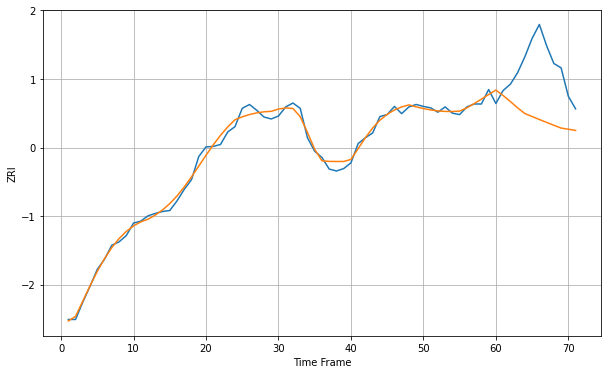

Wall time: 15 s
95050 10.037967073015245 112.00525048964919 [2703.88057944 2692.589138   2680.18180957 2666.90252456 2655.20562582
 2649.00900527 2642.86106805 2636.82353764 2630.83536124 2625.06804252
 2622.67232116 2620.16836762]

Got an mse at 0.0049 in round 76 and stopped training



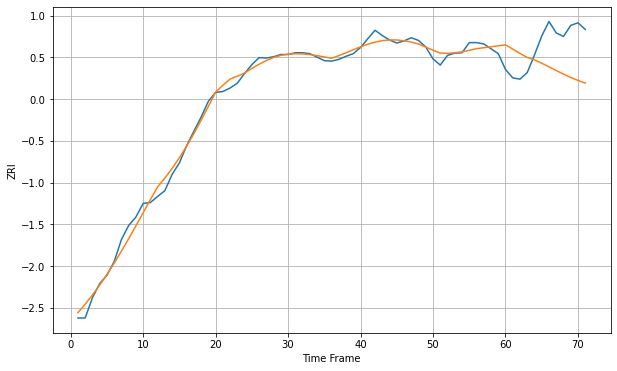

Wall time: 6.31 s
95051 13.269093671386639 85.13051542014902 [2858.95720654 2849.2286229  2839.30466325 2830.46631458 2824.88187661
 2817.23360549 2808.96877888 2800.65101622 2792.5789669  2785.02713985
 2778.20119011 2772.21390043]

Got an mse at 0.0050 in round 87 and stopped training



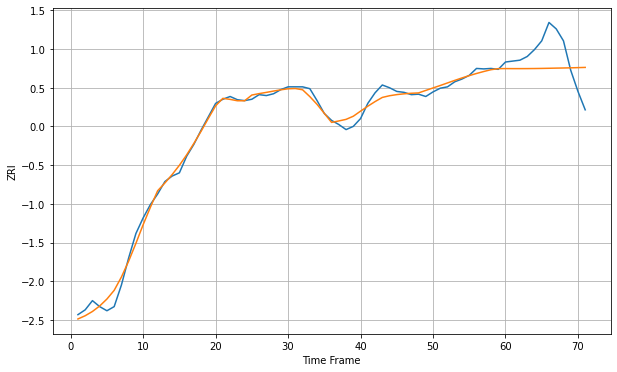

Wall time: 6.83 s
95112 11.782004679702109 56.78596923264342 [2568.68504641 2568.60951021 2568.60345172 2568.67381332 2568.8244812
 2569.05585254 2569.36444843 2569.71224652 2569.99368716 2570.35301177
 2570.77598988 2571.24731684]

Got an mse at 0.0050 in round 378 and stopped training



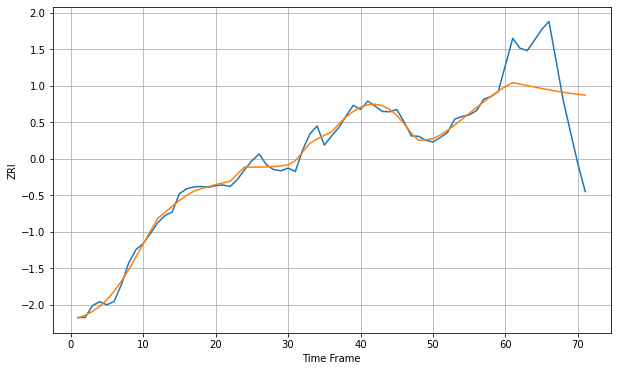

Wall time: 13.1 s
95116 13.421809543392115 134.81538032379464 [2584.03740961 2594.12835448 2590.49105733 2586.69548819 2582.8616632
 2579.09289087 2575.47644643 2572.08506578 2568.97918134 2566.20944532
 2563.7174725  2561.64612932]

Got an mse at 0.0050 in round 251 and stopped training



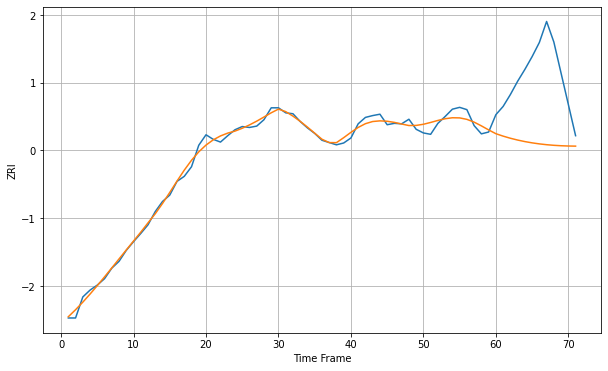

Wall time: 10.2 s
95117 10.469433251806665 157.92254714014834 [2510.35303333 2505.0286938  2500.40271144 2496.43811984 2493.08464513
 2490.29726323 2488.03619931 2486.26125762 2484.92850026 2483.99093081
 2483.40120035 2483.11405255]

Got an mse at 0.0050 in round 65 and stopped training



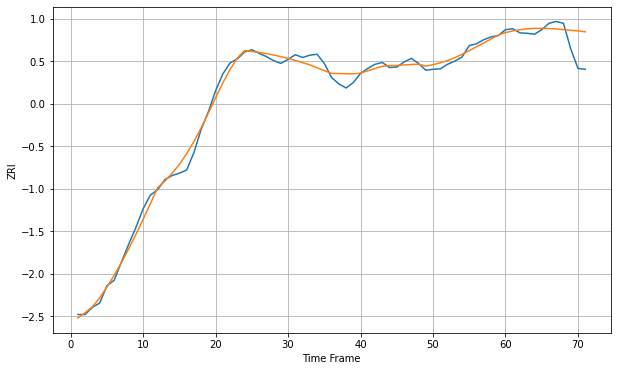

Wall time: 6.3 s
95123 13.096550406073867 36.72556121454426 [2791.51398748 2795.31081305 2798.03049517 2799.80876813 2800.76118787
 2800.98538614 2800.56708153 2799.58585784 2798.11851597 2796.75902268
 2795.22204589 2793.39630476]

Got an mse at 0.0050 in round 58 and stopped training



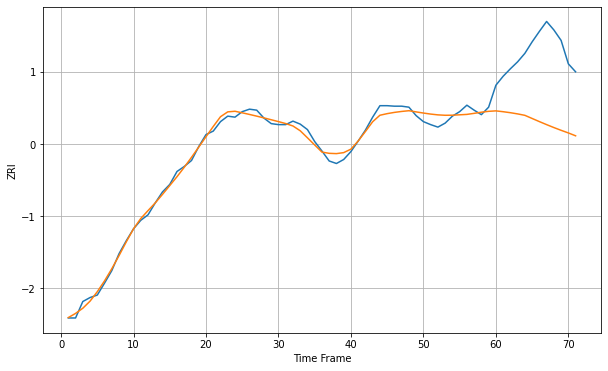

Wall time: 6.32 s
95128 10.172276672825543 143.66215279490137 [2535.58061448 2533.91820544 2531.92215471 2529.50858242 2526.65409151
 2520.36097098 2514.07927544 2507.98516416 2502.13621496 2496.57508593
 2491.33193499 2485.57056157]

Got an mse at 0.0050 in round 226 and stopped training



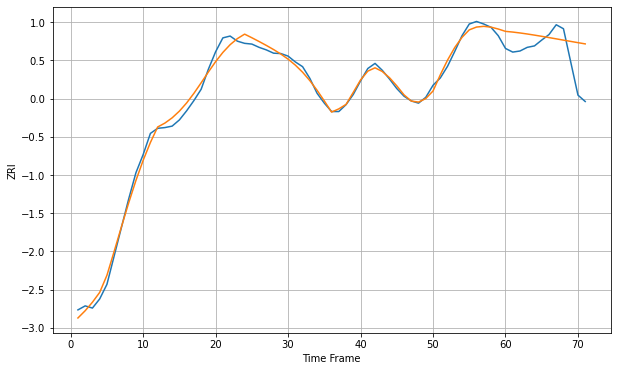

Wall time: 9.81 s
95134 14.764310571535407 71.50206736119523 [3146.84852615 3144.92966479 3142.48922845 3139.65774933 3136.54470006
 3133.23960213 3129.81435309 3126.32588595 3122.81869246 3119.32700441
 3115.87657976 3112.48612158]

Got an mse at 0.0050 in round 94 and stopped training



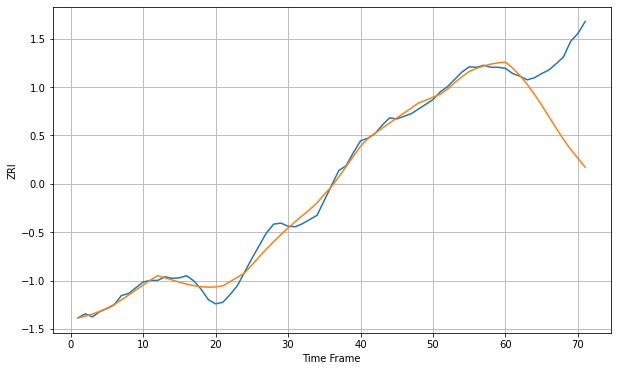

Wall time: 6.73 s
95207 13.046178828948893 139.13984880846243 [1251.97556599 1240.4440567  1226.17117794 1209.30932762 1190.15547313
 1169.16416638 1147.06117656 1124.91899069 1103.80690757 1084.4488407
 1067.33235166 1050.27496159]

Got an mse at 0.0050 in round 46 and stopped training



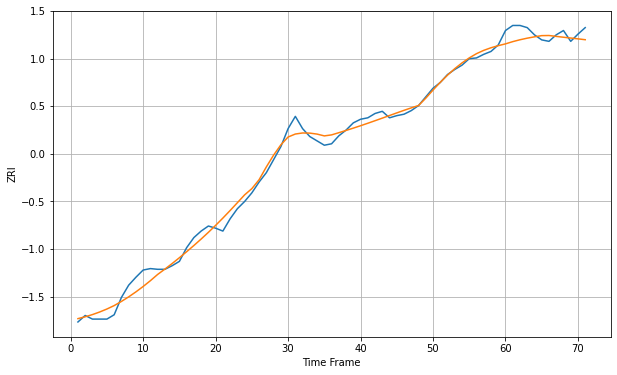

Wall time: 5.86 s
95608 9.224709801531322 12.889990127085051 [1427.48920894 1430.58808964 1433.1934555  1435.39264024 1437.26265421
 1438.91097716 1439.08849849 1437.84636731 1436.69430405 1435.58679273
 1434.46138351 1433.25717871]

Got an mse at 0.0050 in round 89 and stopped training



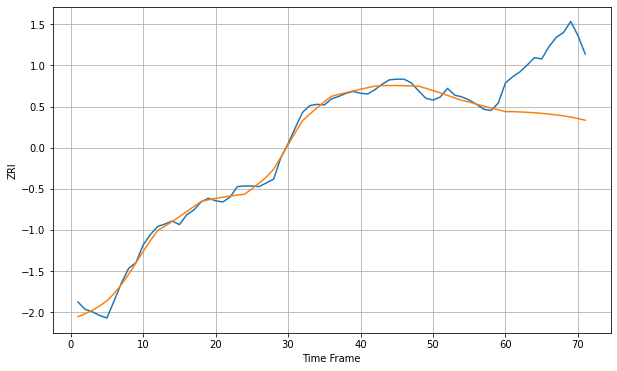

Wall time: 6.81 s
95678 9.430152218460643 104.92495752360827 [1654.07952786 1654.13292544 1653.61383933 1652.97860759 1652.21838682
 1651.32879766 1650.14032304 1648.76674101 1647.28223113 1645.34888
 1642.84680605 1640.16843459]

Got an mse at 0.0049 in round 28 and stopped training



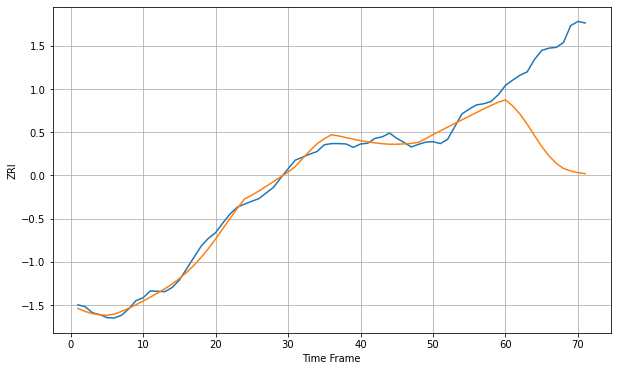

Wall time: 5.22 s
95816 15.723897609720055 274.5775179441458 [1453.37467736 1437.11672813 1415.36162102 1388.49010438 1358.51601796
 1329.34115091 1304.34789235 1284.55972401 1270.92412962 1264.081505
 1259.60378298 1257.12284411]

Got an mse at 0.0050 in round 84 and stopped training



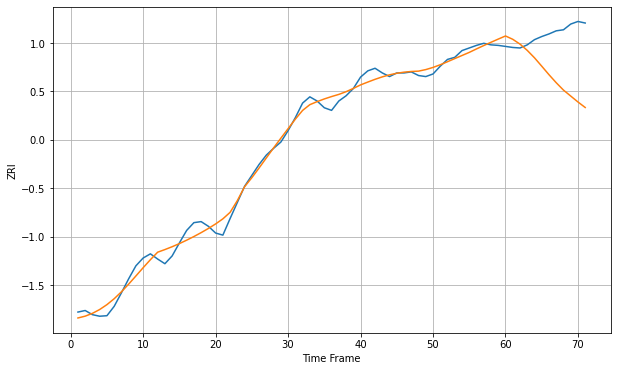

Wall time: 6.78 s
95826 13.104279037258465 93.28788339982486 [1460.08776503 1453.70907609 1444.45836104 1432.39652503 1418.10848769
 1401.9881172  1385.61938744 1370.16783688 1355.96389616 1344.5349549
 1333.09893705 1322.50644006]

Got an mse at 0.0050 in round 55 and stopped training



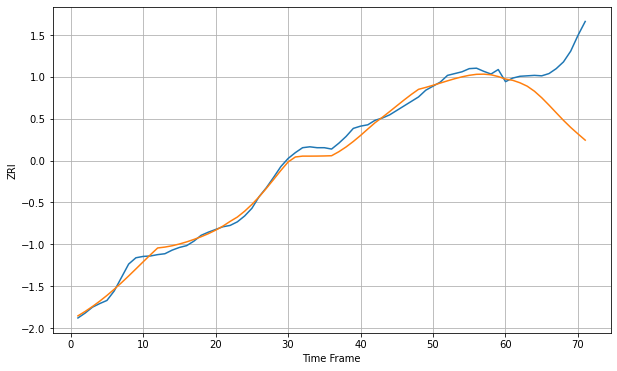

Wall time: 6.06 s
95831 12.441949999530218 123.37459586527187 [1540.82830407 1538.01536954 1532.47389146 1524.89451069 1513.64030745
 1499.20133709 1482.86561512 1465.78610365 1448.87349487 1433.11491615
 1418.71993743 1404.84513994]

Got an mse at 0.0050 in round 81 and stopped training



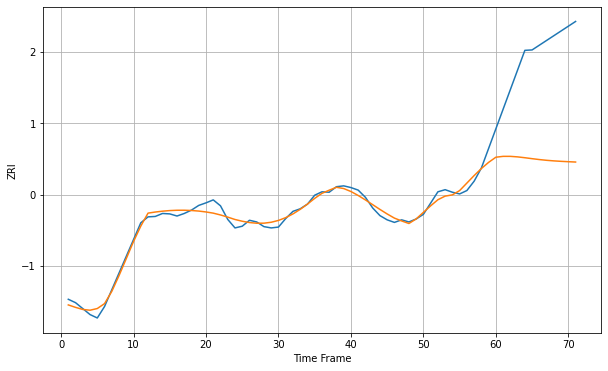

Wall time: 6.67 s
95928 11.745303090638302 251.20536588799587 [1418.43460548 1420.45853927 1420.45316626 1419.20833396 1417.22596222
 1414.99871085 1412.90805287 1411.16269773 1409.79919824 1408.73754299
 1407.8607709  1407.08139775]

Got an mse at 0.0050 in round 293 and stopped training



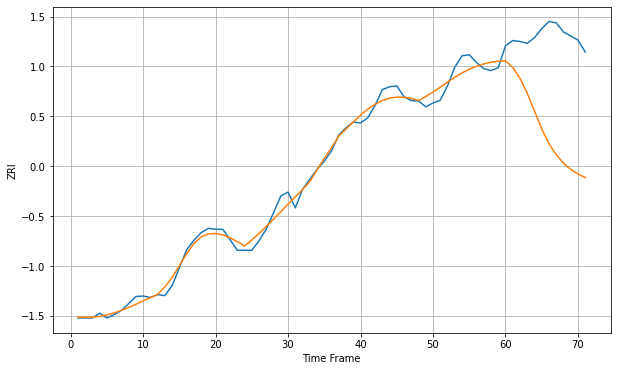

Wall time: 11.1 s
96150 14.732808302256432 210.8646577330997 [1667.49191884 1653.25973165 1630.85657372 1599.31098037 1562.12797497
 1524.37475904 1493.53509261 1470.4397329  1452.92597376 1439.78546719
 1429.95900509 1422.83783058]

Got an mse at 0.0050 in round 192 and stopped training



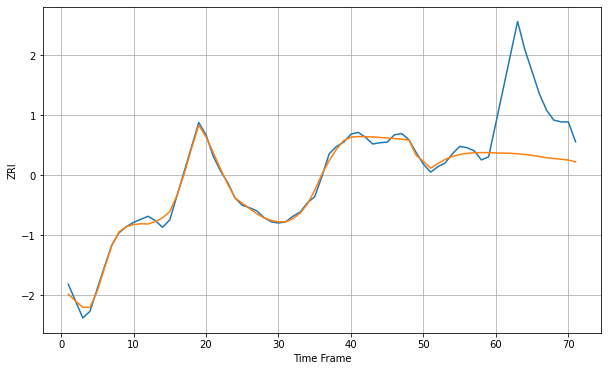

Wall time: 9.1 s
96826 6.8850091945720555 116.37796545190152 [1539.38482269 1539.17904702 1538.75327283 1537.9957061  1536.88085225
 1535.40958559 1533.60565391 1531.50799934 1530.35898563 1529.12488232
 1527.75189352 1524.85530782]

Got an mse at 0.0050 in round 78 and stopped training



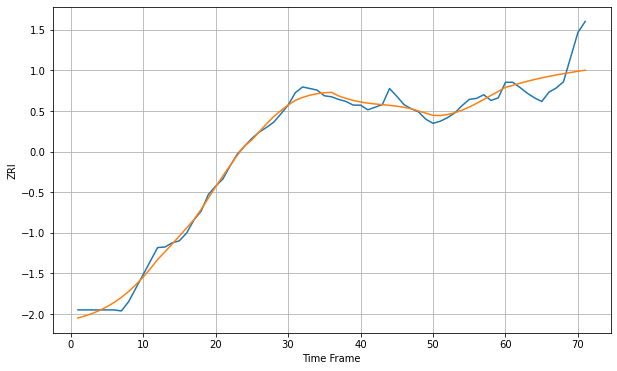

Wall time: 6.58 s
97030 11.00617470085736 41.92543691597019 [1387.39867051 1391.04094851 1395.12978643 1398.88998926 1402.33210113
 1405.47883263 1408.36256058 1411.02320334 1413.50526736 1415.85329181
 1418.10568845 1420.28799242]

Got an mse at 0.0050 in round 135 and stopped training



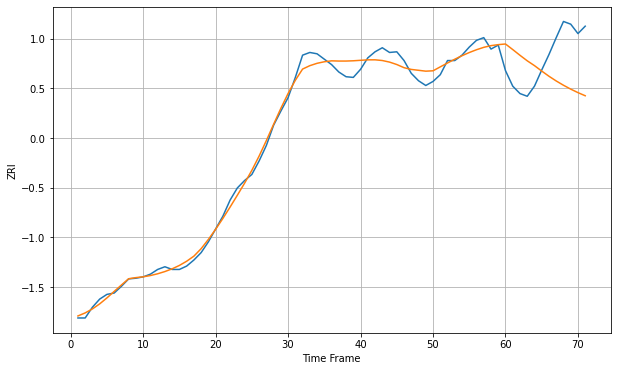

Wall time: 7.63 s
97035 10.369166172252266 66.58160039860584 [1592.55868409 1584.30210015 1575.77923913 1567.62744878 1560.4501471
 1552.40328896 1544.68558136 1537.6912789  1531.35263902 1525.60372899
 1520.40964215 1515.76169697]

Got an mse at 0.0050 in round 263 and stopped training



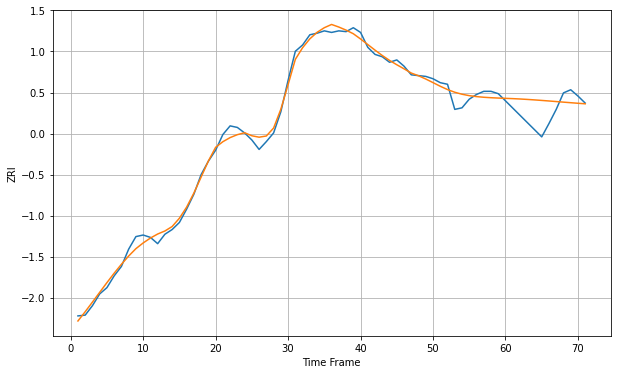

Wall time: 10.7 s
97062 7.343957479885996 23.197198662201927 [1450.04908599 1449.69504338 1449.23747027 1448.69258476 1448.0769225
 1447.40676871 1446.69800182 1445.96623548 1445.2270365  1444.49599162
 1443.78850186 1443.11932842]

Got an mse at 0.0050 in round 62 and stopped training



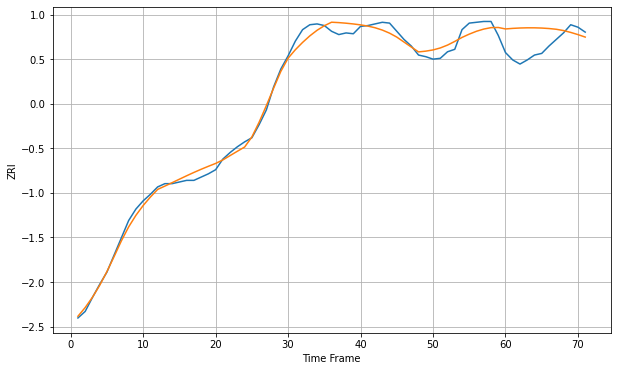

Wall time: 6.13 s
97070 7.613487184626211 26.907114686098776 [1381.8652171  1382.56335006 1383.02016862 1383.24534041 1383.22959096
 1382.9500665  1382.37702728 1381.47962446 1379.91699763 1377.63086306
 1374.96024319 1371.93603486]

Got an mse at 0.0050 in round 122 and stopped training



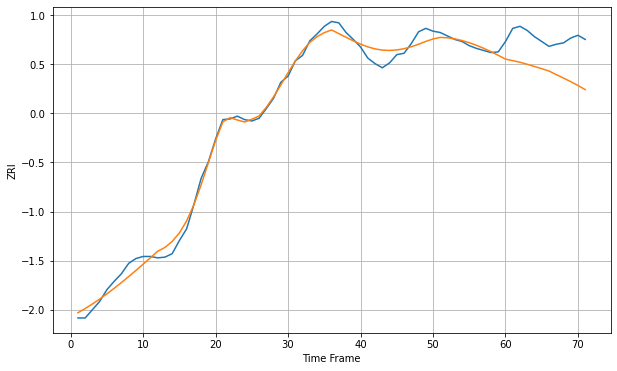

Wall time: 7.47 s
97124 9.953765747969356 51.350324275923285 [1484.55761136 1482.30090397 1479.98831765 1477.0285578  1473.89043761
 1470.66083853 1467.29530428 1462.18534354 1457.11839988 1451.93076724
 1446.40592663 1440.38035096]

Got an mse at 0.0050 in round 298 and stopped training



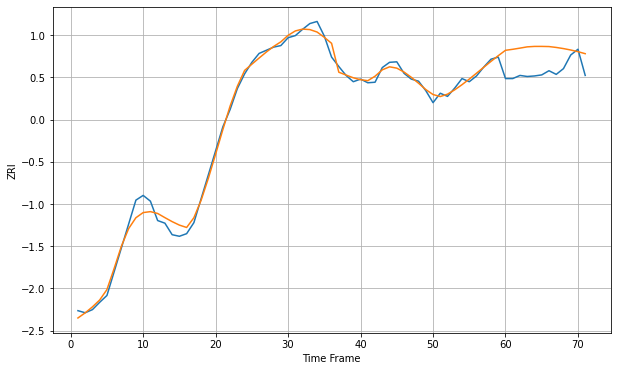

Wall time: 11.1 s
97209 11.299847452282583 46.685679739168194 [1780.97263101 1782.88615144 1785.13332429 1787.52980984 1788.37752052
 1788.3950138  1788.104835   1786.42307406 1784.22719491 1781.53383347
 1778.30393132 1774.51296684]

Got an mse at 0.0050 in round 202 and stopped training



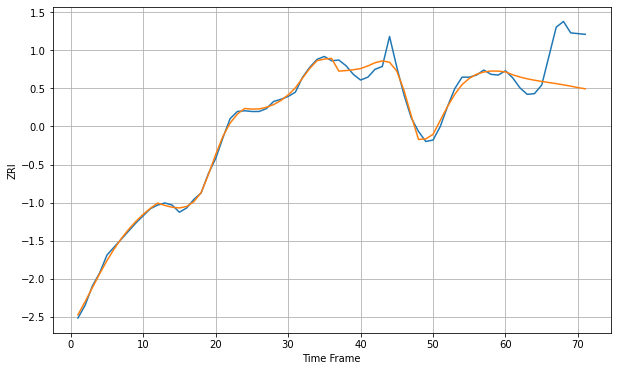

Wall time: 9.3 s
97214 7.486656926206069 52.96528943894074 [1578.41257951 1574.37363513 1571.20154239 1568.7330294  1566.76065312
 1565.08311507 1563.53134284 1561.97298965 1560.30213436 1558.42513433
 1556.42600473 1554.78384872]

Got an mse at 0.0050 in round 105 and stopped training



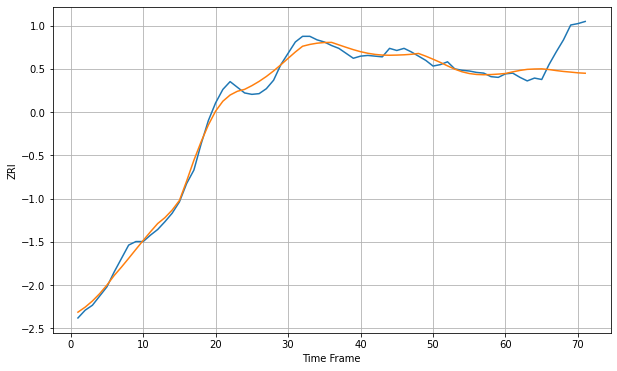

Wall time: 7.07 s
97229 8.580873671787025 38.85820775134464 [1443.5006814  1445.8141309  1447.82122627 1449.30616344 1449.81893214
 1450.02933952 1449.07120076 1447.60959571 1446.36331411 1445.43918868
 1444.41265691 1443.83038132]

Got an mse at 0.0050 in round 268 and stopped training



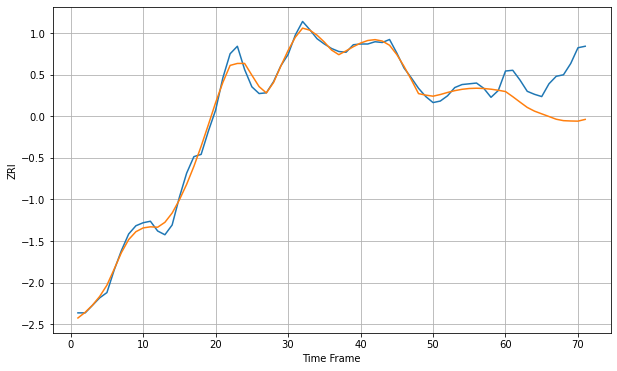

Wall time: 10.4 s
97239 7.79570484939371 56.36114077332566 [1609.6852037  1602.8876259  1595.63614766 1588.56312539 1583.60281147
 1579.99270743 1576.4429251  1572.82967725 1570.92080905 1570.48422703
 1570.27022114 1572.60846525]

Got an mse at 0.0050 in round 196 and stopped training



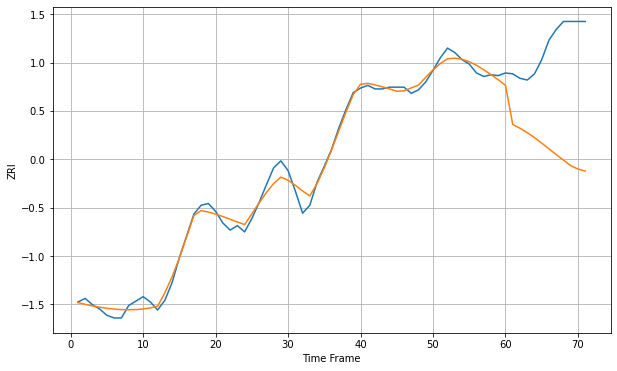

Wall time: 9.14 s
97401 7.67089679455155 117.56132000291176 [1267.02181486 1222.89606631 1218.71904566 1213.77006773 1208.12832007
 1201.96020207 1195.50618883 1189.04333598 1182.83476195 1176.52572751
 1172.78101309 1170.41996368]

Got an mse at 0.0050 in round 83 and stopped training



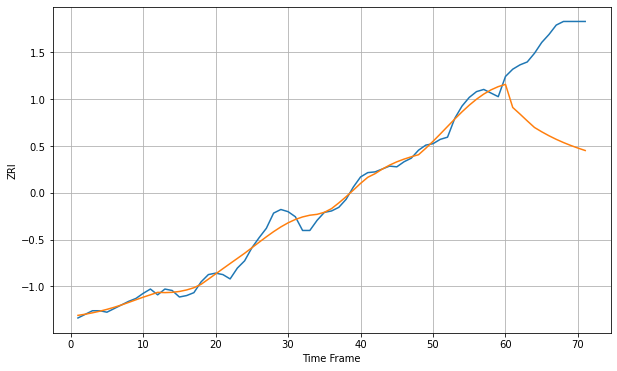

Wall time: 6.59 s
97402 9.10875512826092 130.53223584193807 [1136.00455154 1104.06895738 1094.96027539 1085.54146839 1076.41441162
 1070.43634496 1064.96492636 1060.02420376 1055.57885616 1051.56399873
 1047.90974085 1044.55732336]

Got an mse at 0.0050 in round 465 and stopped training



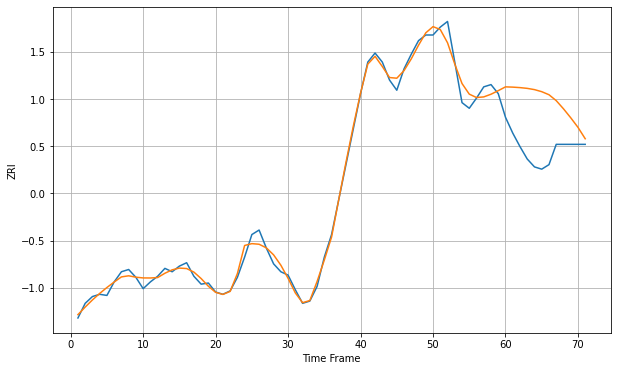

Wall time: 15 s
97477 5.878890146710946 46.21385589400515 [1096.98724181 1096.75466277 1096.32806142 1095.66008831 1094.54573576
 1092.72366074 1090.01597199 1084.7746327  1077.53927408 1069.59211443
 1061.09419049 1050.98183337]

Got an mse at 0.0050 in round 158 and stopped training



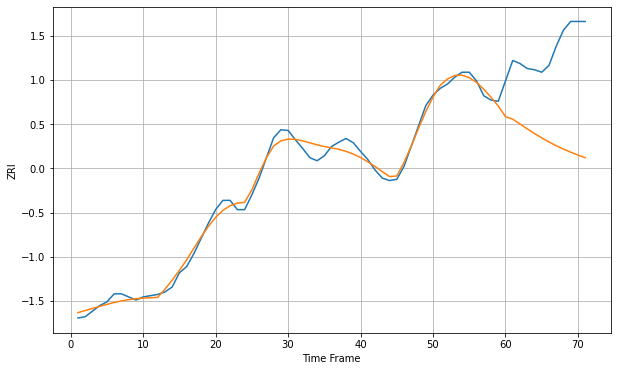

Wall time: 8.05 s
97501 10.016703752844222 150.26323300795588 [1078.21756249 1074.07732928 1066.37564157 1058.58112719 1051.0074714
 1043.88060854 1037.30395088 1031.28742958 1025.7938825  1020.77054416
 1016.1632132  1011.92325774]

Got an mse at 0.0050 in round 230 and stopped training



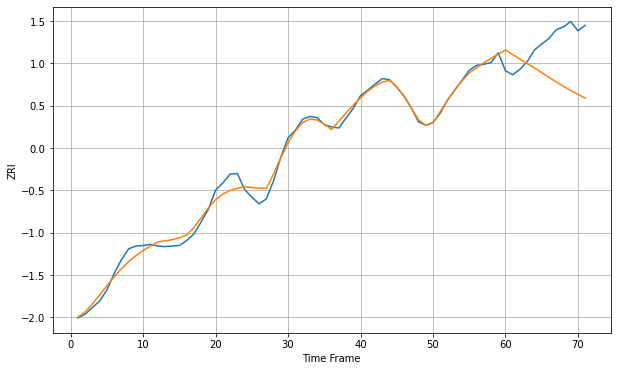

Wall time: 9.9 s
98004 10.83182602435861 81.41251293525268 [2298.01694768 2289.69298669 2281.3531388  2273.20212232 2265.41082339
 2256.8911112  2248.03445176 2239.72625388 2231.87940354 2224.39871438
 2217.20219596 2210.23111141]

Got an mse at 0.0049 in round 190 and stopped training



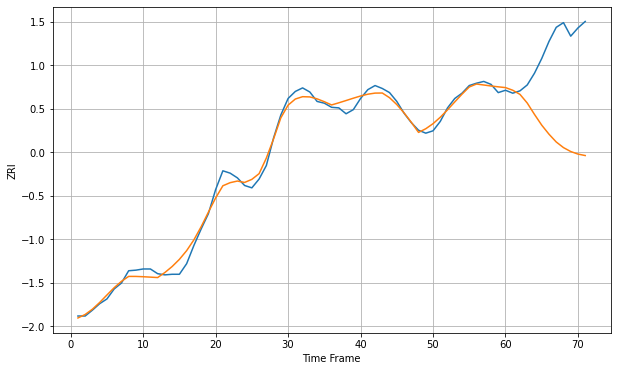

Wall time: 8.95 s
98005 10.28979449900946 148.1564605251321 [1964.50941396 1960.02042368 1952.96566487 1938.26526003 1918.90939755
 1900.63958079 1885.27072671 1872.03712569 1862.44999652 1855.78338643
 1851.43111665 1848.94984696]

Got an mse at 0.0050 in round 64 and stopped training



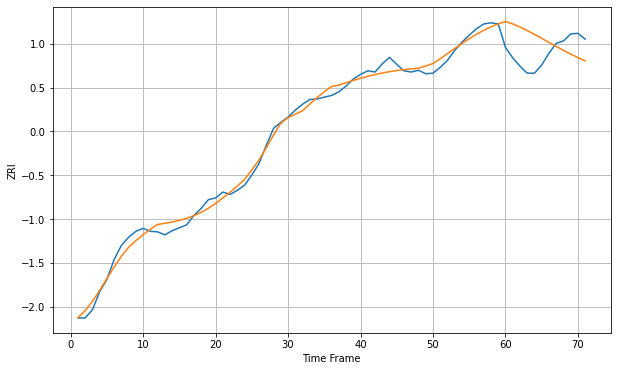

Wall time: 5.96 s
98012 10.472202476171843 46.95188804120624 [1821.30251031 1817.06397982 1811.84697594 1805.83765874 1799.27156066
 1792.39709674 1785.44376385 1778.60095247 1772.00945577 1765.64344346
 1759.58611708 1753.95329802]

Got an mse at 0.0049 in round 285 and stopped training



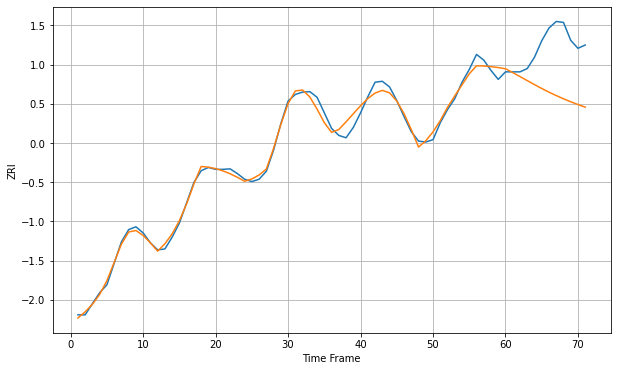

Wall time: 11 s
98029 11.595219945541947 105.18033630114442 [2127.58849891 2119.45078852 2111.00101799 2102.41594726 2093.9161102
 2085.70187514 2077.91177103 2070.61158355 2063.80760555 2057.47023955
 2051.55646341 2046.02580441]

Got an mse at 0.0050 in round 207 and stopped training



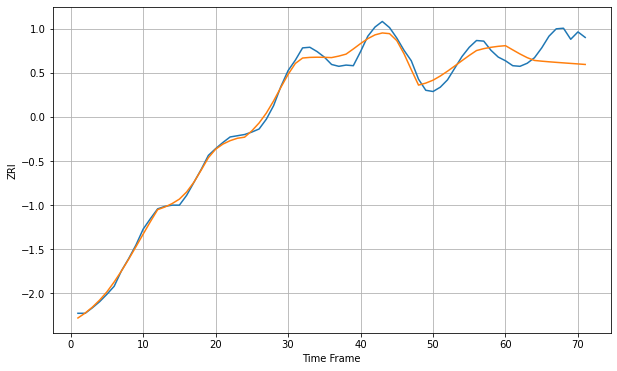

Wall time: 9.3 s
98034 10.093191308192818 36.88275676849176 [1856.57602644 1849.75724513 1843.07774612 1837.06914341 1832.55817782
 1831.36913722 1830.35790352 1829.44693286 1828.58404126 1827.73761973
 1826.88885987 1826.02637398]

Got an mse at 0.0050 in round 229 and stopped training



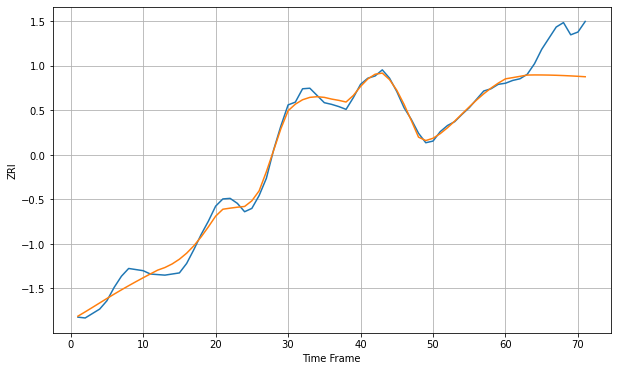

Wall time: 9.75 s
98052 11.273493048489923 61.45040044306127 [2128.86219173 2131.07050998 2133.34624815 2135.67653684 2135.87835377
 2135.82499052 2135.61011677 2135.24654231 2134.74988117 2134.1373002
 2133.42561392 2132.62949444]

Got an mse at 0.0050 in round 140 and stopped training



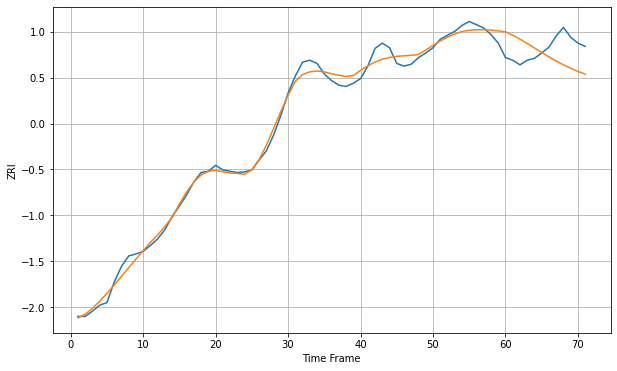

Wall time: 7.63 s
98056 9.822703029905487 36.74678556408105 [1673.20214168 1667.92889863 1661.97317785 1655.48717335 1648.6827902
 1641.80507682 1635.09459404 1628.7515625  1622.91346222 1617.65032461
 1612.97411645 1608.85503868]

Got an mse at 0.0050 in round 105 and stopped training



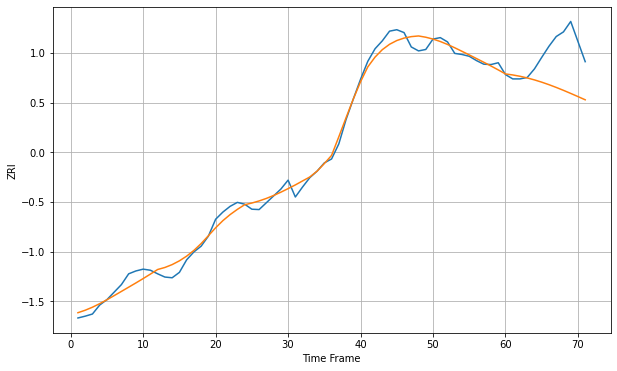

Wall time: 7.72 s
98101 19.432590279646487 107.60353543361776 [2569.83646294 2567.02702868 2563.29879023 2558.67078069 2553.18526931
 2546.90182359 2539.89672392 2532.26323345 2524.11060652 2515.56090823
 2506.74332679 2497.78642893]

Got an mse at 0.0050 in round 257 and stopped training



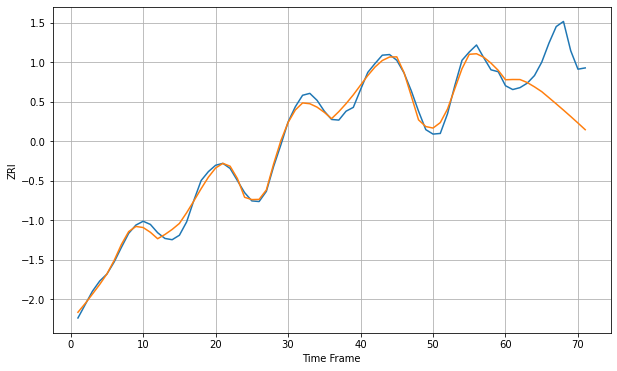

Wall time: 10.8 s
98102 8.71477964477867 77.33187358805985 [2001.40093999 2001.79039613 2001.71433626 1997.01926002 1990.23599359
 1982.7129923  1973.15472514 1963.50420776 1953.68562104 1943.64937532
 1933.38215972 1922.9252654 ]

Got an mse at 0.0050 in round 168 and stopped training



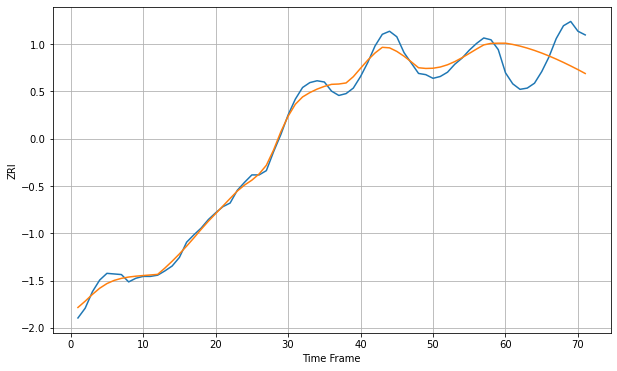

Wall time: 8.55 s
98103 10.83089388128437 55.91462952385124 [1939.44755643 1937.41868152 1934.72301499 1931.43108196 1927.60772028
 1923.30814008 1918.5789146  1913.46177884 1907.9982736  1902.23437098
 1896.22506653 1889.89664462]

Got an mse at 0.0050 in round 241 and stopped training



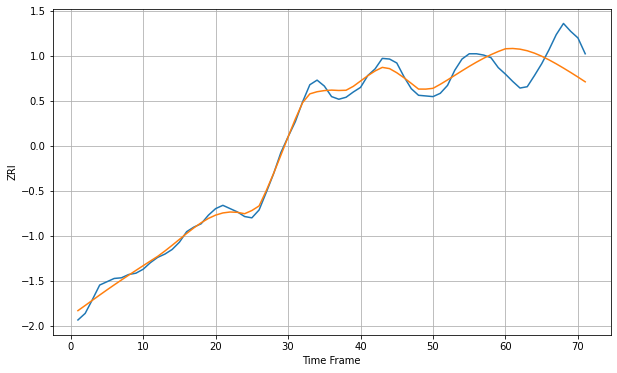

Wall time: 10.5 s
98105 9.600885475639156 48.07217294483885 [1857.61618476 1858.02973772 1856.99630532 1854.58317506 1850.93720294
 1846.26277338 1840.79104431 1834.74493872 1828.30662784 1821.59430454
 1814.65264005 1807.4587831 ]

Got an mse at 0.0049 in round 268 and stopped training



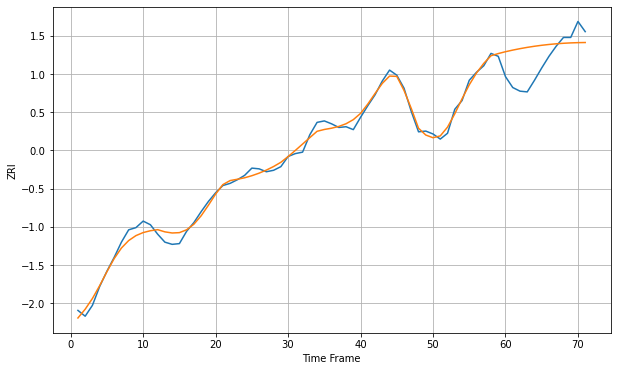

Wall time: 11.1 s
98107 7.332552432068341 36.13422104696616 [1970.34166477 1972.55715622 1974.54671289 1976.31378613 1977.86239666
 1979.19668603 1980.32070826 1981.23869048 1981.95589039 1982.48005182
 1982.82327417 1983.0038609 ]

Got an mse at 0.0050 in round 176 and stopped training



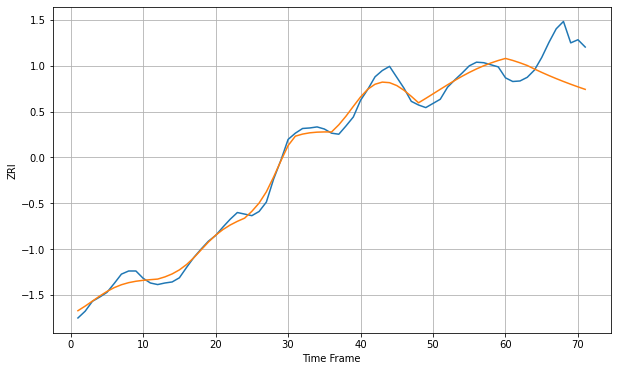

Wall time: 8.98 s
98109 12.325858598679638 66.42416964253326 [2097.19556507 2093.36369371 2088.78608286 2083.66899534 2076.89705052
 2070.43670807 2064.32848802 2058.5325427  2053.01573754 2047.75420882
 2042.73043945 2037.93259515]

Got an mse at 0.0050 in round 217 and stopped training



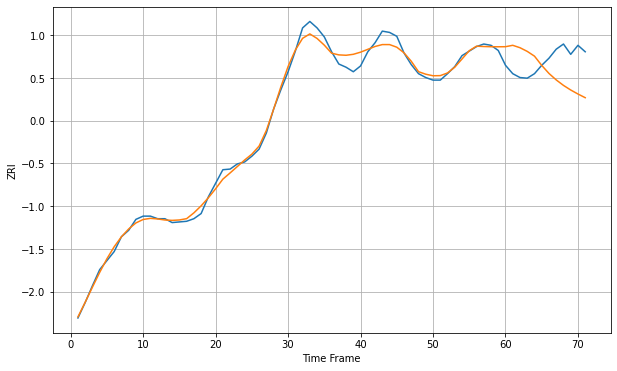

Wall time: 9.67 s
98115 9.285172578457505 48.45759614659727 [1866.85330795 1869.00977064 1865.27279571 1859.5840582  1852.18557565
 1837.84974701 1825.33926463 1815.32623719 1806.81951968 1799.67000567
 1793.44925046 1787.7418044 ]

Got an mse at 0.0050 in round 209 and stopped training



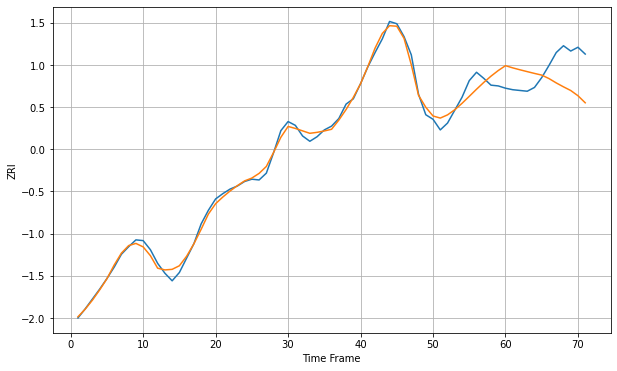

Wall time: 9.78 s
98119 7.813377251832254 40.03556755456946 [1921.70589567 1918.81496836 1916.26075001 1913.8480506  1911.48804859
 1909.26044841 1904.69654137 1898.98548711 1893.80885409 1888.95628201
 1882.07208116 1872.7728242 ]

Got an mse at 0.0050 in round 116 and stopped training



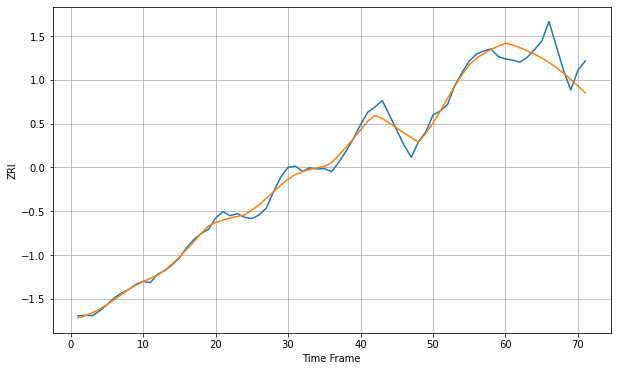

Wall time: 7.57 s
98121 15.2819772713153 48.34907268356266 [2351.02116617 2346.49438605 2339.71298944 2332.25587757 2323.87986229
 2314.31361114 2303.33085128 2290.81249586 2276.77775811 2261.39718846
 2244.99974366 2228.05018255]

Got an mse at 0.0050 in round 352 and stopped training



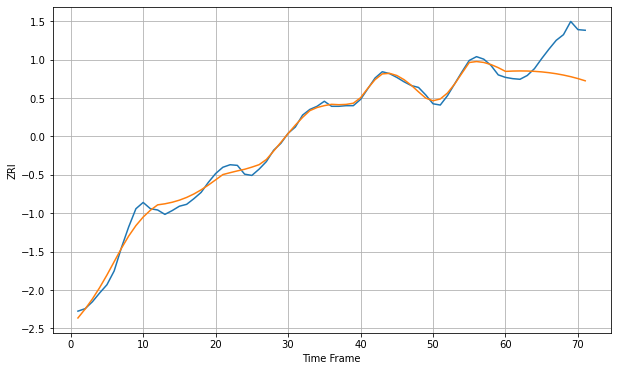

Wall time: 12.6 s
98122 8.594839978733042 49.63049787447443 [1898.54447043 1899.07161911 1899.2715111  1899.1278782  1898.62544087
 1897.74893511 1896.48207223 1894.80659407 1892.70171724 1890.14443572
 1887.11126564 1883.58188558]


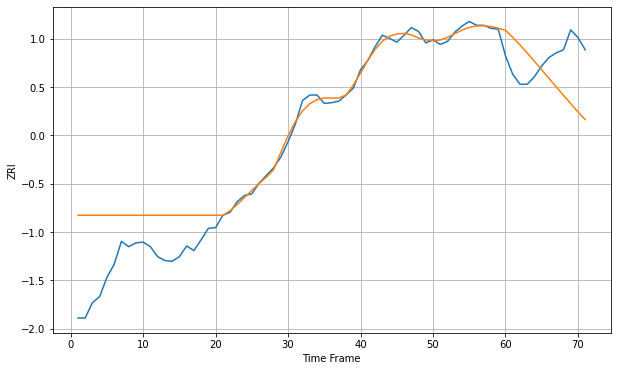

Wall time: 16.3 s
98133 40.61509482071067 58.74338576539196 [1764.38119887 1755.33320037 1745.4110552  1734.88545395 1723.97891242
 1712.87159454 1701.70284364 1690.57407597 1679.55822965 1668.71632521
 1658.11584349 1647.84277327]

Got an mse at 0.0050 in round 108 and stopped training



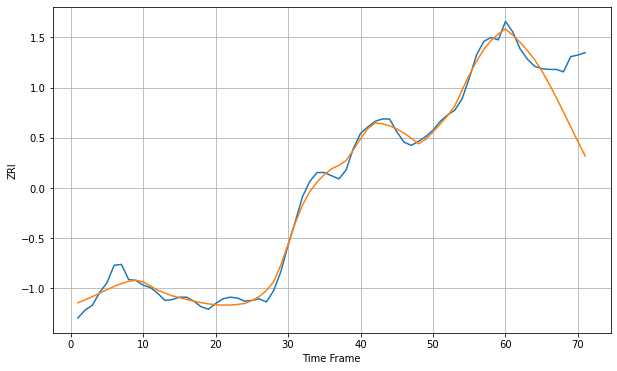

Wall time: 7.37 s
98201 8.836016871745139 58.19727091291814 [1484.63432232 1476.91153348 1467.98021474 1457.81842483 1446.41759706
 1432.3641139  1416.15119182 1398.87374219 1380.74799968 1362.13515652
 1343.56634795 1325.67743604]

Got an mse at 0.0050 in round 160 and stopped training



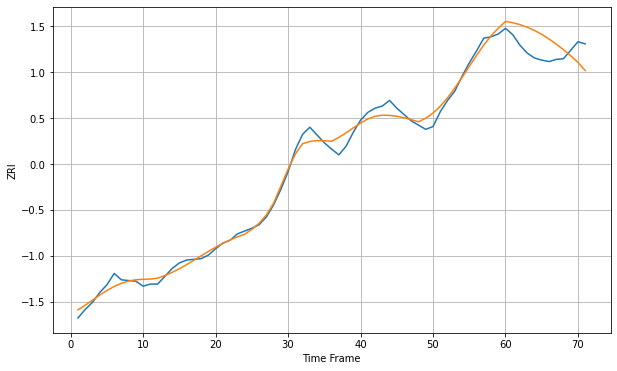

Wall time: 8.64 s
98203 9.113388698160332 28.047095410025925 [1550.7365221  1548.97026205 1546.26830981 1542.62465294 1538.02916868
 1532.48563826 1526.02908879 1518.7365581  1510.72830554 1502.15802158
 1492.76583597 1481.21210664]

Got an mse at 0.0050 in round 83 and stopped training



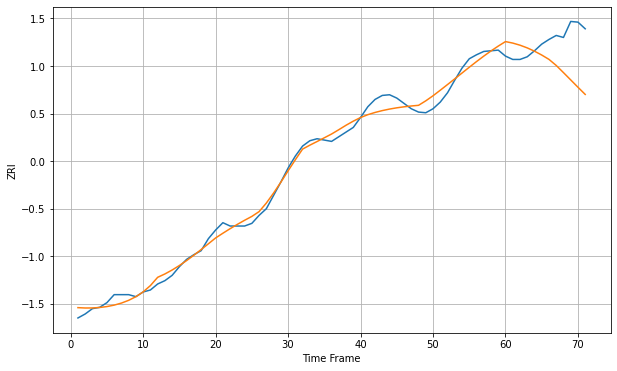

Wall time: 6.68 s
98204 10.034540216346684 53.723047070450896 [1463.80033652 1461.56031715 1458.40894273 1454.34471534 1449.39427655
 1443.6129312  1437.08316203 1427.98416265 1417.23843282 1406.26728925
 1395.28775051 1384.51010005]

Got an mse at 0.0049 in round 38 and stopped training



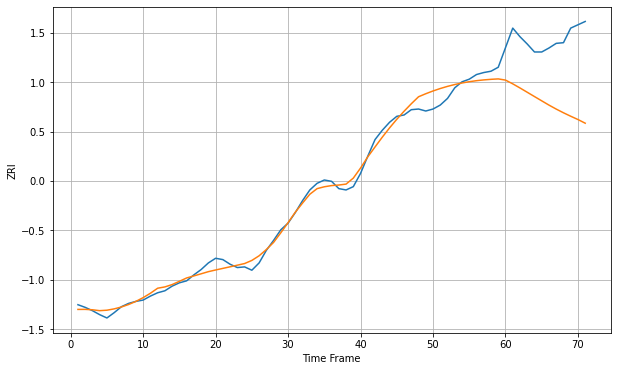

Wall time: 5.85 s
98405 10.081182815881274 100.26391714575196 [1223.61994852 1217.95326983 1211.74253782 1205.27078459 1198.78783007
 1192.32395379 1185.90936463 1179.90819174 1174.33510016 1169.13048719
 1164.16296786 1158.62250922]

Got an mse at 0.0049 in round 59 and stopped training



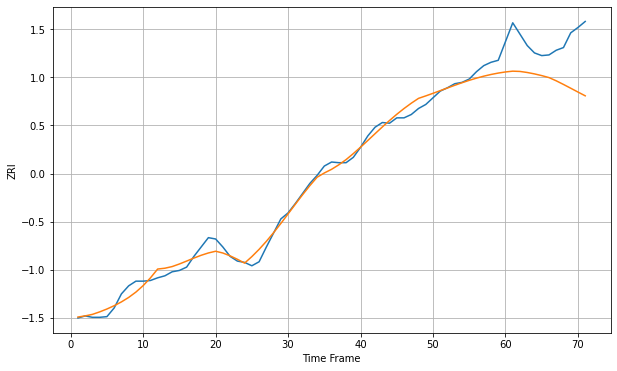

Wall time: 6.71 s
98409 9.910753950471952 63.66093260010623 [1248.57193494 1249.74797107 1249.32741374 1247.76449371 1245.64990657
 1243.11241428 1240.16469956 1235.33245513 1229.90978896 1224.26177062
 1218.54293807 1212.91797909]

Got an mse at 0.0043 in round 31 and stopped training



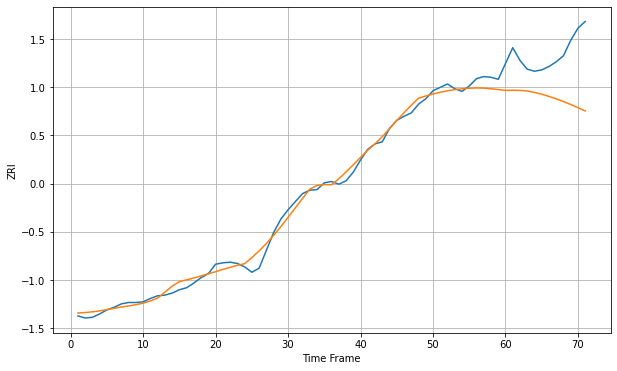

Wall time: 5.49 s
98444 8.880992972777065 71.53437946548688 [1209.51836792 1209.69569739 1209.41993453 1208.62112098 1206.47819716
 1203.76736542 1200.56259599 1196.91395369 1192.87634945 1188.50080195
 1183.82608307 1178.87343167]

Got an mse at 0.0050 in round 188 and stopped training



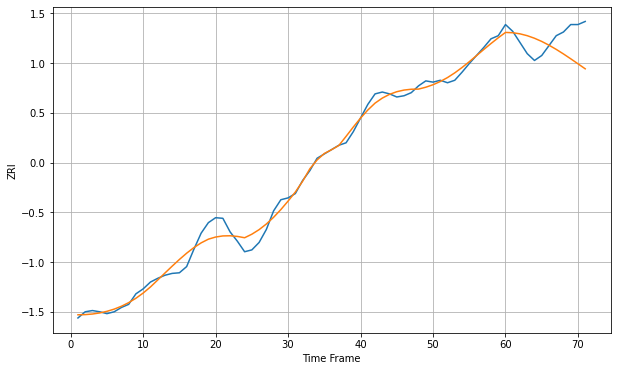

Wall time: 9.28 s
98466 11.31955716511693 38.38626561450233 [1398.29236421 1397.78368423 1396.01161953 1393.02107455 1388.88790087
 1383.72939161 1377.686554   1370.90135412 1363.51721035 1355.69565143
 1347.62570607 1339.51580751]

Got an mse at 0.0050 in round 227 and stopped training



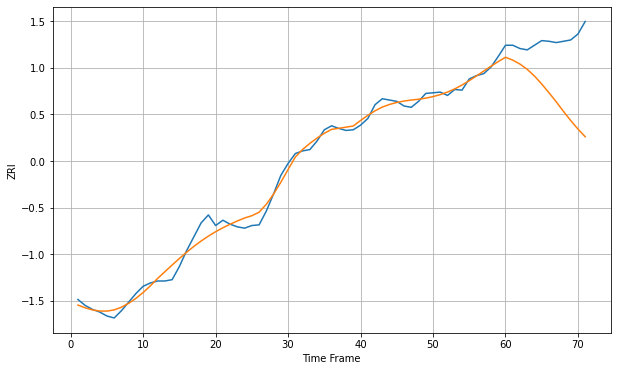

Wall time: 10.1 s
98498 9.943837973321008 91.39112195238745 [1384.81417765 1380.45462084 1374.4374982  1366.46258717 1356.34725204
 1344.23317373 1331.07467961 1317.39104991 1302.84189763 1288.9463585
 1276.06261719 1264.43511389]

Got an mse at 0.0049 in round 113 and stopped training



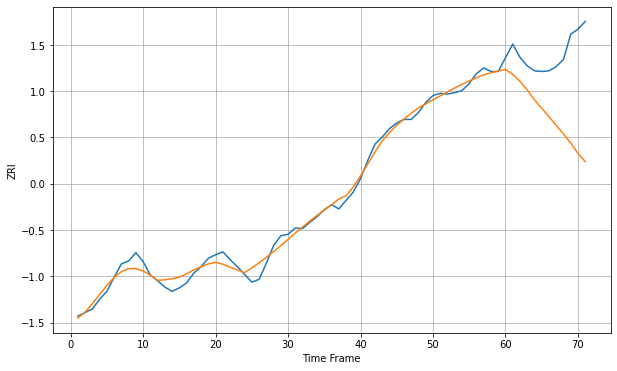

Wall time: 7.45 s
98499 9.19307099570159 102.35243464426836 [1282.9520649  1275.94522029 1265.87835368 1253.83060056 1239.78699783
 1227.68497518 1215.99072001 1203.43646783 1191.34816456 1178.50187873
 1163.73745477 1152.23390809]

Got an mse at 0.0050 in round 114 and stopped training



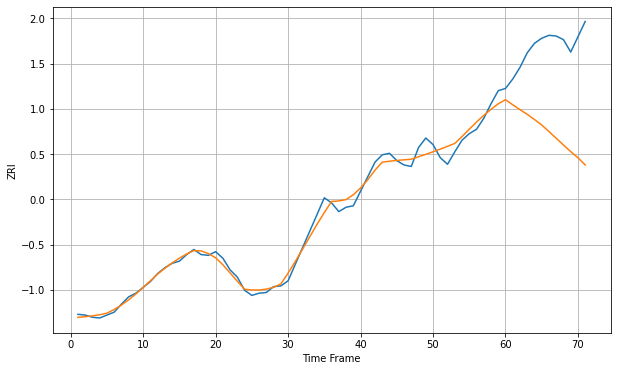

Wall time: 7.26 s
99207 8.745128807329044 122.54400153436808 [1013.54926073 1006.66133099  999.94412244  993.52054996  986.39470284
  978.89295835  969.92142208  960.63852125  951.40094521  942.43452538
  933.88502804  924.06973814]

Got an mse at 0.0050 in round 347 and stopped training



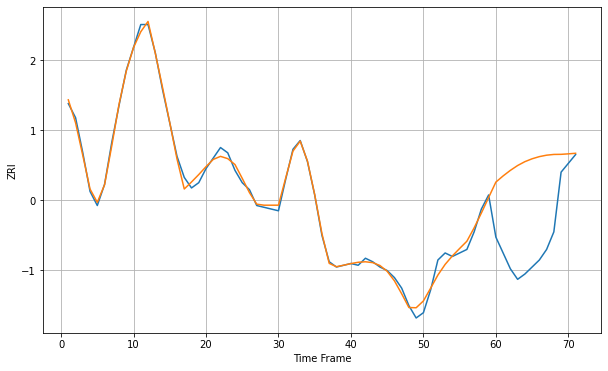

Wall time: 12.8 s
99501 2.8005414327723095 47.02316872541273 [1274.3345321  1277.84596574 1281.00821429 1283.76166541 1285.95614765
 1287.59931733 1288.82828808 1289.64884338 1290.0748873  1290.12976311
 1290.4083252  1290.73308169]

Got an mse at 0.0049 in round 412 and stopped training



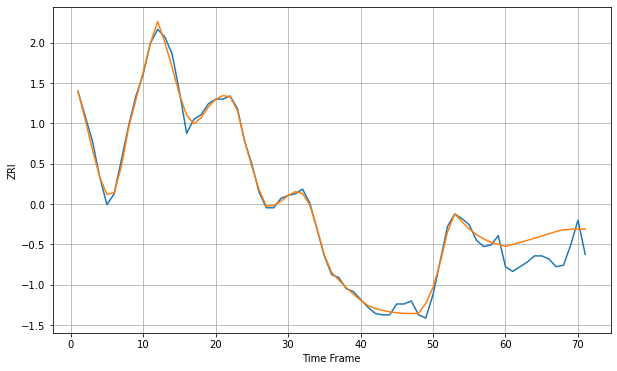

Wall time: 14.1 s
99504 3.6310736390964484 15.573424782143444 [1429.10697605 1430.38359433 1431.67114411 1432.99669743 1434.3753435
 1435.80364176 1437.25744497 1438.69428257 1439.84295745 1440.13168953
 1440.27165375 1440.27795426]

Got an mse at 0.0050 in round 395 and stopped training



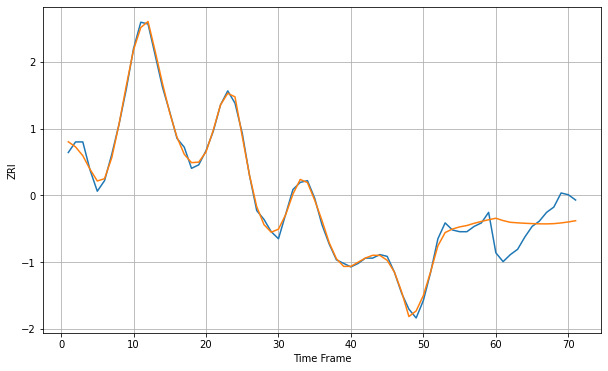

Wall time: 13.7 s
99508 2.673017719203597 14.014274643744365 [1275.65045334 1274.31389525 1273.34345454 1273.0436898  1272.80039174
 1272.60621192 1272.47550145 1272.43827731 1272.5865376  1272.98353651
 1273.53727534 1274.24201192]


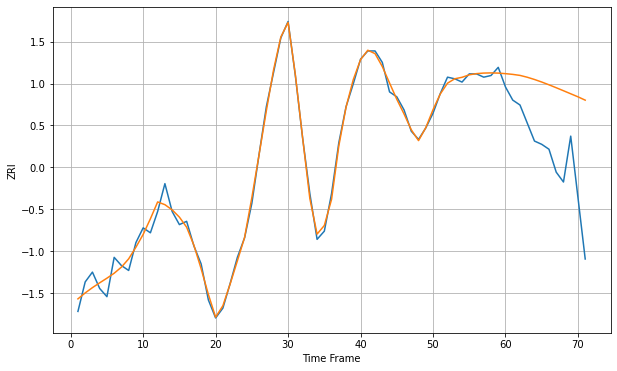

Wall time: 16.3 s
99654 4.134745895711672 46.04388800675675 [1337.14322314 1336.69503526 1336.07735085 1334.95554889 1333.5820634
 1332.02730345 1330.33387539 1328.54853109 1326.71242082 1324.85652256
 1323.00286645 1320.96183604]


In [15]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_pure, forecast = NN_test(ZONE, termination=0.005, plot=True);
        print(ZONE, M_train, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        # score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [16]:
print(len(score_dict["RMSE_pure"]),\
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

rmse = sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]);

1301 62.510721274320616


In [17]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_pure,forecast
0,1013,5.610169,30.407199,"[1099.2900068552353, 1101.3169997741268, 1103...."
1,1020,5.710061,55.961836,"[1129.5128200771462, 1131.9112065502006, 1133...."
2,1040,4.517384,39.075340,"[1098.6388283759752, 1090.0073852591747, 1093...."
3,1085,5.470372,65.813166,"[1154.418200556317, 1150.9473754770013, 1147.0..."
4,1104,5.611673,46.497224,"[1123.4465814874518, 1113.0954167180016, 1112...."


In [18]:
test.to_csv('NN_selectedfeatureonly_window_1_overfit_{:.2f}.csv'.format(rmse), index = False)